Add Robin boundary conditions.

Success!!!

Author: yanjun zhang

## ds needs define correct

## 1: Start

Source from 
book "Abali - 2017 - Computational Reality" P119

In [1]:
#### import basic
import pyvista
import ufl
import dolfinx
import time
import numpy as np
import matplotlib.pyplot as plt
from petsc4py import PETSc
from mpi4py import MPI
import sys
import os
import shutil

## import speciail library
from dolfinx.fem.petsc import LinearProblem, assemble_vector, assemble_matrix, create_vector, apply_lifting, set_bc
from dolfinx import fem, mesh, io, plot, default_scalar_type, nls, log
from dolfinx.fem import Constant, dirichletbc, Function, FunctionSpace,form,locate_dofs_topological
from dolfinx.io import XDMFFile, gmshio
from dolfinx.mesh import locate_entities,locate_entities_boundary,meshtags
from ufl import SpatialCoordinate, TestFunction, TrialFunction, dx, grad, inner, Measure, dot, FacetNormal
from dolfinx.fem.petsc import NonlinearProblem
from dolfinx.nls.petsc import NewtonSolver

## import own functions
from find_com_e import find_common_e
from rotation_co import rub_rotation


########################################### calculate how long time the simulation it is ################
start_time = time.time()

######################################### mesh-size, contact area coefficient ############################
mesh_min = 1
mesh_max = 2
c_contact = 1

########################################## Each time step rotation angular ###############################
degree_rotation = 119
v_angular_initial = 96.62 

############################################### Start time, Final time  ##################################
t = 0
Total_time = 49
t_lag = 4.2

############################################# calculate total num_steps  ##################################
total_angular = v_angular_initial * t_lag +  (v_angular_initial / 2)  * (Total_time - 4)
total_angular = total_angular / np.pi *180       # rad to degree
num_steps = round( total_angular / degree_rotation )

######################################### rubbing element radius, Contact area  ###########################
r_rub = 18.8
S_rub_circle = r_rub**2 * c_contact
S_contact = S_rub_circle * np.pi
S_total = S_contact * 18  #mm2

######################################### initial and brake pad temperature#########################
Ti = 60
Tm = 60

################################## density (kg.m^-3), capacity (J/Kg.K), conductivity (W/m.K)###############
t_u = 1e3 # m to mm
rho = 7850 /(t_u**3)
c = 462
k = 48 / t_u

######################################## mu, P_brake,  r_disc , heat_distribution  ###############
mu = 0.376
P_initial = 274000
r_disc = 0.25
heat_distribution = 0.88

# D_wheel = 920 mm
# v = D_wheel /2 /1000 * v_angular_initial *3.6   # km/h

#dt1 = degree_rotation/180*np.pi / (v_angular_initial)
#num_stops = round (t_lag / dt1)

dt1 = degree_rotation/180*np.pi / ( 96.62 +    (96.62- (96.62/49*4.2) )  ) /2
num_stops = round (t_lag / dt1)
    

P = []
for i in range(num_steps):
    #if i <= num_steps* (t_lag/ Total_time)*2:
    if i <= num_stops:
        P.append(  P_initial/ num_steps  * i  )
    else:
        P.append( P_initial) 

#################################################### time step size ##################################
dt = []
v_angular = [v_angular_initial ]

for i in range(num_steps):
    if i < num_stops:
        dt.append ( degree_rotation/180*np.pi / v_angular[i]  )
        v_angular.append (   96.62- sum(dt)* (96.62/49)  )
    else:
        if v_angular[i] < 0:
           num_steps1 = i
           break
        else:
           dt.append ( degree_rotation/180*np.pi / v_angular[i]  )
           v_angular.append ( v_angular[num_stops] -  v_angular[num_stops]/(Total_time - t_lag) * (sum(dt)-t_lag) ) 
   

################################## S_or is the original brake pad rubbing area, 200 cm2. ######################3
S_or = 200
S_new = S_total/100 #mm2 to cm2

############################################# g is the heat source,unit is w/mm2 ###############################
g = []

for i in range(num_steps1):
    g.append ( mu * P[i] * v_angular[i] * r_disc * heat_distribution *2 /(t_u**2)  * (S_or/S_new) )

###################################  h is the heat convection coefficient, unit is W/mm2 K  #################
h = 7.75e-5
# radiation is the radiation heat coefficient, unit is W/mm2 K
# stefan-Boltzmann constant theta = 5.67*10e-8 w/m2 k-4,   0.64 is the emmissivity
radiation = 5.670*(10e-8)/(t_u**2)  * 0.64


############################################  print('heat flux g is ',g) #################################
print('1: Time step dt is ',dt[0],'s')
print('2: Convection heat transfer coefficient is',h, ' W/mm2 K')
print('3: Radiation is ',radiation, ' W/mm2 K-4')

total_circle = (v_angular[0] * r_disc * (1/2) * Total_time) / (2*np.pi*r_disc)
total_degree = total_circle * 360
#print('Total circle is ', total_circle,'is equal to ', total_degree )
each_degree = total_degree / num_steps
print('4: Each rotation degree is ', each_degree, ' per time step')
print('5: The first rotation degree is ',v_angular[0] * r_disc * dt[0] *1000 )
print('6: One contact area of rubbing element is ', round(S_contact/100,1), ' cm2')
print('7: Total contact area of 18 rubbing element is', round(S_total/100,1), 'cm2')
print('8: Total numb steps is ', num_steps1)

/home/yanjun/.local/lib/python3.10/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


1: Time step dt is  0.02149598230048905 s
2: Convection heat transfer coefficient is 7.75e-05  W/mm2 K
3: Radiation is  3.6287999999999996e-13  W/mm2 K-4
4: Each rotation degree is  109.20289557614602  per time step
5: The first rotation degree is  519.235452468313
6: One contact area of rubbing element is  11.1  cm2
7: Total contact area of 18 rubbing element is 199.9 cm2
8: Total numb steps is  1002


49.475876666261804


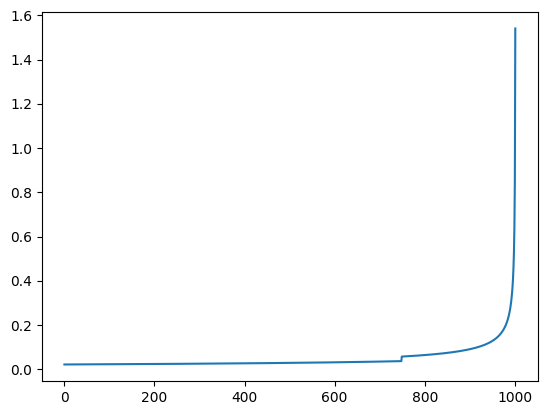

In [2]:
sum_dt = sum(dt)
print(sum_dt)
dt1 = np.linspace(0, 49, num_steps+1)
#plt.plot(dt1 , P)
#plt.plot(v_angular)
#print(dt)
#plt.plot(P)
plt.plot(dt)
#print(v_angular[num_stops] )
#print((sum(dt[:num_stops])-t_lag) )

In [3]:
import dolfinx
print(f"DOLFINx version: {dolfinx.__version__}   \
based on GIT commit:  \
{dolfinx.git_commit_hash} of https://github.com/FEniCS/dolfinx/")

DOLFINx version: 0.7.3   based on GIT commit:  ubuntu of https://github.com/FEniCS/dolfinx/


## 2: Mesh

In [4]:
######################################  mesh  ###################################3

mesh_name = f"{mesh_min}-{mesh_max}"
mesh_filename1 = "m-{}.msh".format(mesh_name)  
mesh_filename2 = "m-{}".format(mesh_name)  

if os.path.exists(mesh_filename1):
    # Run this command if the file exists
    print(f"The file '{mesh_filename1}' exists, start creat now:")
    domain, cell_markers, facet_markers = gmshio.read_from_msh(mesh_filename1, MPI.COMM_WORLD, 0, gdim=3)

else:
    # Run this command if the file does not exist
    print(f"The file '{mesh_filename1}' does not exist.")
    import sys
    sys.path.append('/home/yanjun/Documents/FEniCSx/Tutorial/Mesh/')
    from mesh_disc import mesh_brake_disc
    mesh_brake_disc(mesh_min, mesh_max,mesh_filename2)
    domain, cell_markers, facet_markers = gmshio.read_from_msh(mesh_filename1, MPI.COMM_WORLD, 0, gdim=3)


# Define variational problem, Here Lagrange changes to CG, what is CG?
V = fem.FunctionSpace(domain, ('CG', 1))

# initialization
def project(function, space):
    u = TrialFunction(space)
    v = TestFunction(space)
    a = inner(u, v) * dx
    L = inner(function, v) * dx
    problem = LinearProblem(a, L, bcs = [])
    return problem.solve()
    
# u_n is for initial condition and uh is the solver result.
# variable, need to be projected form Q onto V
Q = FunctionSpace(domain, ("DG", 0))
T_init = Function(Q)
T_init.name = "u_n"
T_init.x.array[:] = np.full_like(1, Ti, dtype=default_scalar_type)
u_n = project(T_init,V)
u_n.name = "u_n"

fdim = domain.topology.dim - 1
## bc_disc is zero, no any dirichlete boundary condition
bc_disc = mesh.locate_entities_boundary(
    domain, fdim , lambda x:  np.isclose(x[2], 50) )
bc = fem.dirichletbc(PETSc.ScalarType(Tm), fem.locate_dofs_topological(V, fdim, bc_disc), V)
np.set_printoptions(threshold=np.inf)

The file 'm-1-2.msh' does not exist.
Info    : Meshing 1D...
Info    : [  0%] Meshing curve 4 (Circle)
Info    : [ 10%] Meshing curve 5 (Line)
Info    : [ 10%] Meshing curve 6 (Circle)
Info    : [ 10%] Meshing curve 7 (Circle)
Info    : [ 10%] Meshing curve 8 (Line)
Info    : [ 10%] Meshing curve 9 (Circle)
Info    : [ 10%] Meshing curve 10 (Circle)
Info    : [ 10%] Meshing curve 11 (Line)
Info    : [ 20%] Meshing curve 12 (Circle)
Info    : [ 20%] Meshing curve 13 (Line)
Info    : [ 20%] Meshing curve 14 (Line)
Info    : [ 20%] Meshing curve 15 (Circle)
Info    : [ 20%] Meshing curve 16 (Line)
Info    : [ 20%] Meshing curve 17 (Line)
Info    : [ 20%] Meshing curve 18 (Line)
Info    : [ 30%] Meshing curve 19 (Line)
Info    : [ 30%] Meshing curve 20 (Circle)
Info    : [ 30%] Meshing curve 21 (Circle)
Info    : [ 30%] Meshing curve 22 (Circle)
Info    : [ 30%] Meshing curve 23 (Circle)
Info    : [ 30%] Meshing curve 24 (Circle)
Info    : [ 30%] Meshing curve 25 (Circle)
Info    : [ 40%] 

Info    : [ 10%] Meshing surface 5 (Cylinder, Frontal-Delaunay)
Info    : [ 10%] Meshing surface 6 (Plane, Frontal-Delaunay)
Info    : [ 10%] Meshing surface 7 (Plane, Frontal-Delaunay)
Info    : [ 10%] Meshing surface 8 (Cylinder, Frontal-Delaunay)
Info    : [ 20%] Meshing surface 9 (Plane, Frontal-Delaunay)
Info    : [ 20%] Meshing surface 10 (Plane, Frontal-Delaunay)
Info    : [ 20%] Meshing surface 11 (Plane, Frontal-Delaunay)
Info    : [ 20%] Meshing surface 12 (Plane, Frontal-Delaunay)
Info    : [ 20%] Meshing surface 13 (Cylinder, Frontal-Delaunay)
Info    : [ 30%] Meshing surface 14 (Cylinder, Frontal-Delaunay)
Info    : [ 30%] Meshing surface 15 (Cylinder, Frontal-Delaunay)
Info    : [ 30%] Meshing surface 16 (Cylinder, Frontal-Delaunay)
Info    : [ 30%] Meshing surface 17 (Cylinder, Frontal-Delaunay)
Info    : [ 40%] Meshing surface 18 (Cylinder, Frontal-Delaunay)
Info    : [ 40%] Meshing surface 19 (Cylinder, Frontal-Delaunay)
Info    : [ 40%] Meshing surface 20 (Cylinder, F

In [5]:
import meshio
mesh1= meshio.read(mesh_filename1)
total_elements = sum( len(cells.data) for cells in mesh1.cells )


## 3: Setup 


In [6]:
xdmf_name = "T-s-{}-d-{}-{}-c-{}-e-{}.xdmf".format(num_steps, degree_rotation, mesh_filename2,c_contact,total_elements)
h5_name = "T-s-{}-d-{}-{}-c-{}-e-{}.h5".format(num_steps, degree_rotation, mesh_filename2,c_contact,total_elements)
xdmf = io.XDMFFile(domain.comm, xdmf_name, "w")
xdmf.write_mesh(domain)

In [7]:
# Create boundary condition
sys.path.append('/home/yanjun/Documents/FEniCSx/Tutorial/Mesh/')
from rub_co import get_rub_coordinate
x_co, y_co = get_rub_coordinate()

boundary1= (10, lambda x: (x[0]-x_co[0])**2 + (x[1]-y_co[0])**2 <= S_rub_circle)
boundary2= (20, lambda x: (x[0]-x_co[1])**2 + (x[1]-y_co[1])**2 <= S_rub_circle) 
boundary3= (30, lambda x: (x[0]-x_co[2])**2 + (x[1]-y_co[2])**2 <= S_rub_circle)
boundary4= (40, lambda x: (x[0]-x_co[3])**2 + (x[1]-y_co[3])**2 <= S_rub_circle) 
boundary5= (50, lambda x: (x[0]-x_co[4])**2 + (x[1]-y_co[4])**2 <= S_rub_circle)
boundary6= (60, lambda x: (x[0]-x_co[5])**2 + (x[1]-y_co[5])**2 <= S_rub_circle) 
boundary7= (70, lambda x: (x[0]-x_co[6])**2 + (x[1]-y_co[6])**2 <= S_rub_circle)
boundary8= (80, lambda x: (x[0]-x_co[7])**2 + (x[1]-y_co[7])**2 <= S_rub_circle) 
boundary9= (90, lambda x: (x[0]-x_co[8])**2 + (x[1]-y_co[8])**2 <= S_rub_circle)
boundary10= (100, lambda x: (x[0]-x_co[9])**2 + (x[1]-y_co[9])**2 <= S_rub_circle) 
boundary11= (110, lambda x: (x[0]-x_co[10])**2 + (x[1]-y_co[10])**2 <= S_rub_circle)
boundary12= (120, lambda x: (x[0]-x_co[11])**2 + (x[1]-y_co[11])**2 <= S_rub_circle) 
boundary13= (130, lambda x: (x[0]-x_co[12])**2 + (x[1]-y_co[12])**2 <= S_rub_circle)
boundary14= (140, lambda x: (x[0]-x_co[13])**2 + (x[1]-y_co[13])**2 <= S_rub_circle) 
boundary15= (150, lambda x: (x[0]-x_co[14])**2 + (x[1]-y_co[14])**2 <= S_rub_circle)
boundary16= (160, lambda x: (x[0]-x_co[15])**2 + (x[1]-y_co[15])**2 <= S_rub_circle)
boundary17= (170, lambda x: (x[0]-x_co[16])**2 + (x[1]-y_co[16])**2 <= S_rub_circle) 
boundary18= (180, lambda x: (x[0]-x_co[17])**2 + (x[1]-y_co[17])**2 <= S_rub_circle)

boundaries1 = [boundary1,boundary2,boundary3,boundary4,boundary5,boundary6,boundary7,boundary8,boundary9,boundary10,
              boundary11,boundary12,boundary13,boundary14,boundary15,boundary16,boundary17,boundary18]
 
facet_indices1, facet_markers1 = [], [] 
fdim = domain.topology.dim - 1  
for (marker, locator) in boundaries1:
        facets = locate_entities(domain, fdim, locator)   
        facet_indices1.append(facets)
        facet_markers1.append(np.full_like(facets, marker))
facet_indices1 = np.hstack(facet_indices1).astype(np.int32)
facet_markers1 = np.hstack(facet_markers1).astype(np.int32)
            
A1 = facet_indices1
B = facet_markers1 
C = mesh.locate_entities_boundary(domain, fdim, lambda x: np.isclose(x[2], 20) )

common_indices1 = np.intersect1d(A1,C)
D = []
for index in common_indices1:
        rows_A1 = np.where(A1 == index)
        D.append( B[rows_A1] )
facet_markers1 = np.concatenate(D)

####################################

boundary20 = (200, lambda x:  x[2] == 20)
facet_indices2, facet_markers2 = [], [] 
fdim = domain.topology.dim - 1  
for (marker, locator) in [boundary20]:
        facets = locate_entities(domain, fdim, locator)   
        facet_indices2.append(facets)
        facet_markers2.append(np.full_like(facets, marker)) 
facet_indices2 = np.hstack(facet_indices2).astype(np.int32)
facet_markers2 = np.hstack(facet_markers2).astype(np.int32)

A1 = facet_indices2
B = facet_markers2
B1 = common_indices1
common_indices2 = np.setdiff1d(A1,B1)
D = []
for index in common_indices2:
        rows_A1 = np.where(A1 == index)
        D.append( B[rows_A1] )
facet_markers2 = np.concatenate(D) 
    
common_indices3 = [common_indices1,common_indices2]
facet_markers3 = [facet_markers1,facet_markers2]
common_indices3 = np.concatenate(common_indices3)
facet_markers3 = np.concatenate(facet_markers3)
sorted_indices3 = np.argsort(common_indices3)
      
facet_tag = meshtags(domain, fdim, common_indices3[sorted_indices3], facet_markers3[sorted_indices3])
ds = Measure('ds', domain=domain, subdomain_data=facet_tag) 


## 4: Variational equation


In [8]:
uh = fem.Function(V)
uh.name = "uh"
uh = project(T_init,V)
xdmf.write_function(uh, t)

#u = ufl.TrialFunction(V)
u = fem.Function(V)

v = ufl.TestFunction(V)
f = fem.Constant(domain, PETSc.ScalarType(0))
n_vector = FacetNormal(domain)

F = (rho*c)/dt[0]*inner(u,v)*dx + k*inner(grad(u),grad(v))*dx+  h*inner(u,v)*ds(200) + radiation*inner(u**4,v) *ds(200) \
- ( inner(f,v) *dx + (rho*c)/dt[0] * inner(u_n, v) * dx +  h * Tm * v *ds(200) +  radiation * (Tm**4)* v *ds(200) )

#a = (rho*c)/dt*inner(u,v)*dx + k*inner(grad(u),grad(v))*dx+  h*inner(u,v)*ds(200) + radiation*inner(u**4,v) *ds(200)
#L = inner(f,v) *dx + (rho*c)/dt * inner(u_n, v) * dx +  h * 25* v *ds(200) +  radiation * (25**4)* v *ds(200)


for i in list(range(1,19)):
     F +=  - k * dot( grad(u)* v, n_vector) *ds(10*i) - inner(g[0], v) *ds(10*i)

problem = NonlinearProblem(F, u, bcs=[bc])

## 7: Using petsc4py to create a linear solver
solver = NewtonSolver(MPI.COMM_WORLD, problem)
solver.convergence_criterion = "incremental"
solver.rtol = 1e-6
solver.report = True

ksp = solver.krylov_solver
opts = PETSc.Options()
option_prefix = ksp.getOptionsPrefix()
opts[f"{option_prefix}ksp_type"] = "cg"
opts[f"{option_prefix}pc_type"] = "gamg"
opts[f"{option_prefix}pc_factor_mat_solver_type"] = "mumps"
ksp.setFromOptions()

log.set_log_level(log.LogLevel.INFO)
n, converged = solver.solve(u)
assert (converged)
#print(f"Number of interations: {n:d}")


## 8:Visualization of time dependent problem using pyvista
import matplotlib as mpl
pyvista.start_xvfb()
grid = pyvista.UnstructuredGrid(*plot.vtk_mesh(V))
plotter = pyvista.Plotter()

gif_name = "T-s-{}-d-{}-{}-c-{}-e-{}.gif".format(num_steps, degree_rotation, mesh_filename2,c_contact,total_elements)

plotter.open_gif(gif_name, fps=30)
grid.point_data["Temperature"] = u.x.array
warped = grid.warp_by_scalar("Temperature", factor=0)
viridis = mpl.colormaps.get_cmap("viridis").resampled(25)
sargs = dict(title_font_size=25, label_font_size=20,  color="black",
             position_x=0.1, position_y=0.8, width=0.8, height=0.1)
renderer = plotter.add_mesh(warped, show_edges=True, lighting=False,
                            cmap=viridis, scalar_bar_args=sargs,
                            #clim=[0, max(uh.x.array)])
                            clim=[0,  200])

2024-04-23 22:48:16.249 ( 334.310s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:48:23.938 ( 341.998s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:48:29.256 ( 347.317s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0429813 (tol = 1e-10) r (rel) = 8.58713e-07(tol = 1e-06)
2024-04-23 22:48:29.256 ( 347.317s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 7 linear solver iterations.


## 5: Solution


In [9]:

total_degree = 0
for i in range(num_steps1):
    t += dt[i]
   
    boundaries1 = []
    x_co, y_co = rub_rotation (x_co, y_co, each_degree)   # update the location
    total_degree += degree_rotation  # Incrementing degree by 10 in each step
    
    sys.stdout.write('\r1: Rotation has applied for {} degree. '.format(total_degree))
    sys.stdout.write('2: Current time is ' + str(round(t,1)) + " s. ")
    sys.stdout.write('3: Completion is '  + str(round (100*(t/Total_time),1) )+ " %. ")
    sys.stdout.flush()
    
    boundary1= (10, lambda x: (x[0]-x_co[0])**2 + (x[1]-y_co[0])**2 <= S_rub_circle )
    boundary2= (20, lambda x: (x[0]-x_co[1])**2 + (x[1]-y_co[1])**2 <= S_rub_circle ) 
    boundary3= (30, lambda x: (x[0]-x_co[2])**2 + (x[1]-y_co[2])**2 <= S_rub_circle )
    boundary4= (40, lambda x: (x[0]-x_co[3])**2 + (x[1]-y_co[3])**2 <= S_rub_circle ) 
    boundary5= (50, lambda x: (x[0]-x_co[4])**2 + (x[1]-y_co[4])**2 <= S_rub_circle )
    boundary6= (60, lambda x: (x[0]-x_co[5])**2 + (x[1]-y_co[5])**2 <= S_rub_circle ) 
    boundary7= (70, lambda x: (x[0]-x_co[6])**2 + (x[1]-y_co[6])**2 <= S_rub_circle )
    boundary8= (80, lambda x: (x[0]-x_co[7])**2 + (x[1]-y_co[7])**2 <= S_rub_circle ) 
    boundary9= (90, lambda x: (x[0]-x_co[8])**2 + (x[1]-y_co[8])**2 <= S_rub_circle )
    boundary10= (100, lambda x: (x[0]-x_co[9])**2 + (x[1]-y_co[9])**2 <= S_rub_circle ) 
    boundary11= (110, lambda x: (x[0]-x_co[10])**2 + (x[1]-y_co[10])**2 <= S_rub_circle )
    boundary12= (120, lambda x: (x[0]-x_co[11])**2 + (x[1]-y_co[11])**2 <= S_rub_circle ) 
    boundary13= (130, lambda x: (x[0]-x_co[12])**2 + (x[1]-y_co[12])**2 <= S_rub_circle )
    boundary14= (140, lambda x: (x[0]-x_co[13])**2 + (x[1]-y_co[13])**2 <= S_rub_circle ) 
    boundary15= (150, lambda x: (x[0]-x_co[14])**2 + (x[1]-y_co[14])**2 <= S_rub_circle )
    boundary16= (160, lambda x: (x[0]-x_co[15])**2 + (x[1]-y_co[15])**2 <= S_rub_circle )
    boundary17= (170, lambda x: (x[0]-x_co[16])**2 + (x[1]-y_co[16])**2 <= S_rub_circle ) 
    boundary18= (180, lambda x: (x[0]-x_co[17])**2 + (x[1]-y_co[17])**2 <= S_rub_circle )
   
    boundaries1 = [boundary1,boundary2,boundary3,boundary4,boundary5,boundary6,boundary7,boundary8,boundary9,boundary10,
              boundary11,boundary12,boundary13,boundary14,boundary15,boundary16,boundary17,boundary18]
     
    facet_indices1, facet_markers1 = [], [] 
    fdim = domain.topology.dim - 1  
    for (marker, locator) in boundaries1:
        facets = locate_entities(domain, fdim, locator)   
        facet_indices1.append(facets)
        facet_markers1.append(np.full_like(facets, marker))  
    facet_indices1 = np.hstack(facet_indices1).astype(np.int32)
    facet_markers1 = np.hstack(facet_markers1).astype(np.int32)
    bc_disc = mesh.locate_entities_boundary( domain, fdim , lambda x:  np.isclose(x[2], 20) )        
    A1 = facet_indices1
    B = facet_markers1 
    C = bc_disc
    common_indices1 = np.intersect1d(A1,C)
    D = []
    for index in common_indices1:
        rows_A1 = np.where(A1 == index)
        D.append( B[rows_A1] )
    facet_markers1 = np.concatenate(D)
    ####################################
    
    boundary20 = (200, lambda x:  x[2] == 20)
    facet_indices2, facet_markers2 = [], [] 
    fdim = domain.topology.dim - 1  
    for (marker, locator) in [boundary20]:
        facets = locate_entities(domain, fdim, locator)   
        facet_indices2.append(facets)
        facet_markers2.append(np.full_like(facets, marker)) 
    facet_indices2 = np.hstack(facet_indices2).astype(np.int32)
    facet_markers2 = np.hstack(facet_markers2).astype(np.int32) 
    
    A1 = facet_indices2
    B = facet_markers2
    B1 = common_indices1
    common_indices2 = np.setdiff1d(A1,B1)
    D = []
    for index in common_indices2:
           rows_A1 = np.where(A1 == index)
           D.append( B[rows_A1] )
    facet_markers2 = np.concatenate(D) 
    
    common_indices3 = [common_indices1,common_indices2]
    facet_markers3 = [facet_markers1,facet_markers2]
    common_indices3 = np.concatenate(common_indices3)
    facet_markers3 = np.concatenate(facet_markers3)

    sorted_indices3 = np.argsort(common_indices3)
      
    facet_tag = meshtags(domain, fdim, common_indices3[sorted_indices3], facet_markers3[sorted_indices3])
    ds = Measure('ds', domain=domain, subdomain_data=facet_tag) 

    F = (rho*c)/dt[i]*inner(u,v)*dx + k*inner(grad(u),grad(v))*dx+  h*inner(u,v)*ds(200) + radiation*inner(u**4,v) *ds(200) \
    - ( inner(f,v) *dx + (rho*c)/dt[i] * inner(u_n, v) * dx +  h * 25* v *ds(200) +  radiation * (25**4)* v *ds(200) )

    for j in list(range(1,19)):
         F +=  - k * dot( grad(u)* v, n_vector) *ds(10*j) - inner(g[i], v) *ds(10*j)

    problem = NonlinearProblem(F, u, bcs=[bc])

    ## 7: Using petsc4py to create a linear solver
    solver = NewtonSolver(MPI.COMM_WORLD, problem)
    solver.convergence_criterion = "incremental"
    solver.rtol = 1e-6
    
    ksp = solver.krylov_solver
    opts = PETSc.Options()
    option_prefix = ksp.getOptionsPrefix()
    opts[f"{option_prefix}ksp_type"] = "cg"
    opts[f"{option_prefix}pc_type"] = "gamg"
    opts[f"{option_prefix}pc_factor_mat_solver_type"] = "mumps"
    ksp.setFromOptions()

    sys.stdout.write('\r1: Rotation has applied for {} degree. '.format(total_degree))
    sys.stdout.write('2: Current time is ' + str(round(t,1)) + " s. ")
    sys.stdout.write('3: Completion is '  + str(round (100*(t/Total_time),1) )+ " %. ")
    sys.stdout.flush()

    solver.solve(u)
    u.x.scatter_forward()

    # Update solution at previous time step (u_n)
    u_n.x.array[:] = u.x.array
    # Write solution to file
    xdmf.write_function(u, t)
    # Update plot
    #warped = grid.warp_by_scalar("uh", factor=0)
    plotter.update_coordinates(warped.points.copy(), render=False)
    plotter.update_scalars(u.x.array, render=False)
    plotter.write_frame()
    
plotter.close() 
xdmf.close()
print()

1: Rotation has applied for 119 degree. 2: Current time is 0.0 s. 3: Completion is 0.0 %. 

2024-04-23 22:48:32.885 ( 350.946s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:48:32.917 ( 350.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:48:32.917 ( 350.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:48:32.947 ( 351.008s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:48:32.970 ( 351.030s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:48:32.970 ( 351.030s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:48:32.991 ( 351.051s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:48:33.009 ( 351.069s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:48:33.009 ( 351.069s) [mai

1: Rotation has applied for 119 degree. 2: Current time is 0.0 s. 3: Completion is 0.0 %. 

2024-04-23 22:48:44.191 ( 362.251s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:48:51.636 ( 369.697s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:48:57.112 ( 375.172s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 6.96232e-06 (tol = 1e-10) r (rel) = 1.35805e-06(tol = 1e-06)
2024-04-23 22:48:59.352 ( 377.412s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:49:04.738 ( 382.798s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.34238e-12 (tol = 1e-10) r (rel) = 6.51954e-13(tol = 1e-06)
2024-04-23 22:49:04.738 ( 382.799s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-23 22:49:04.743 ( 382.803s) [main            ]      xdmf_fun

1: Rotation has applied for 238 degree. 2: Current time is 0.0 s. 3: Completion is 0.1 %. 

2024-04-23 22:49:06.166 ( 384.227s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:49:06.184 ( 384.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:49:06.185 ( 384.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:49:06.197 ( 384.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:49:06.216 ( 384.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:49:06.216 ( 384.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:49:06.229 ( 384.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:49:06.246 ( 384.307s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:49:06.246 ( 384.307s) [mai

1: Rotation has applied for 238 degree. 2: Current time is 0.0 s. 3: Completion is 0.1 %. 

2024-04-23 22:49:12.488 ( 390.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:49:12.488 ( 390.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:49:12.827 ( 390.888s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:49:14.465 ( 392.526s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:49:17.148 ( 395.209s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:49:24.395 ( 402.456s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:49:29.686 ( 407.746s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 8.3435e-06 (tol = 1e-10) r (rel) = 1.82175e-06(tol = 1e-06)
2024-04-23 22:49:31.850 ( 409.911s) [main            ]    

1: Rotation has applied for 357 degree. 2: Current time is 0.1 s. 3: Completion is 0.1 %. 

2024-04-23 22:49:38.348 ( 416.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:49:38.362 ( 416.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:49:38.364 ( 416.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:49:38.378 ( 416.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:49:38.395 ( 416.455s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:49:38.395 ( 416.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:49:38.407 ( 416.467s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:49:38.428 ( 416.489s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:49:38.429 ( 416.489s) [mai

1: Rotation has applied for 357 degree. 2: Current time is 0.1 s. 3: Completion is 0.1 %. 

2024-04-23 22:49:47.741 ( 425.802s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:49:47.741 ( 425.802s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:49:47.781 ( 425.842s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:49:47.781 ( 425.842s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:49:48.068 ( 426.129s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:49:49.712 ( 427.773s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:49:52.451 ( 430.517s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:49:59.616 ( 437.676s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 476 degree. 2: Current time is 0.1 s. 3: Completion is 0.2 %. 

2024-04-23 22:50:14.043 ( 452.104s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:50:14.062 ( 452.122s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:50:14.062 ( 452.122s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:50:14.077 ( 452.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:50:14.093 ( 452.153s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:50:14.093 ( 452.153s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:50:14.103 ( 452.164s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:50:14.117 ( 452.178s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:50:14.118 ( 452.179s) [mai

1: Rotation has applied for 476 degree. 2: Current time is 0.1 s. 3: Completion is 0.2 %. 

2024-04-23 22:50:25.973 ( 464.034s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:50:32.969 ( 471.029s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:50:38.208 ( 476.268s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 8.24646e-06 (tol = 1e-10) r (rel) = 1.06175e-06(tol = 1e-06)
2024-04-23 22:50:40.440 ( 478.501s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:50:45.446 ( 483.507s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.34141e-12 (tol = 1e-10) r (rel) = 4.30216e-13(tol = 1e-06)
2024-04-23 22:50:45.446 ( 483.507s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-23 22:50:45.447 ( 483.507s) [main            ]      xdmf_fun

1: Rotation has applied for 595 degree. 2: Current time is 0.1 s. 3: Completion is 0.2 %. 

2024-04-23 22:50:46.579 ( 484.640s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:50:46.598 ( 484.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:50:46.598 ( 484.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:50:46.610 ( 484.672s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:50:46.627 ( 484.688s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:50:46.627 ( 484.688s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:50:46.639 ( 484.699s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:50:46.654 ( 484.715s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:50:46.655 ( 484.716s) [mai

1: Rotation has applied for 595 degree. 2: Current time is 0.1 s. 3: Completion is 0.2 %. 

2024-04-23 22:50:56.094 ( 494.156s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:50:58.771 ( 496.832s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:51:05.961 ( 504.021s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:51:10.920 ( 508.981s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 2.21983e-05 (tol = 1e-10) r (rel) = 2.2949e-06(tol = 1e-06)
2024-04-23 22:51:13.185 ( 511.246s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:51:18.574 ( 516.634s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.27299e-10 (tol = 1e-10) r (rel) = 1.31604e-11(tol = 1e-06)
2024-04-23 22:51:18.574 ( 516.634s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solv

1: Rotation has applied for 714 degree. 2: Current time is 0.1 s. 3: Completion is 0.3 %. 

2024-04-23 22:51:19.634 ( 517.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:51:19.652 ( 517.713s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:51:19.652 ( 517.713s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:51:19.664 ( 517.724s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:51:19.685 ( 517.746s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:51:19.686 ( 517.746s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:51:19.696 ( 517.756s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:51:19.714 ( 517.774s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:51:19.714 ( 517.774s) [mai

1: Rotation has applied for 714 degree. 2: Current time is 0.1 s. 3: Completion is 0.3 %. 

2024-04-23 22:51:27.432 ( 525.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:51:27.432 ( 525.493s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:51:27.468 ( 525.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:51:27.468 ( 525.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:51:27.750 ( 525.811s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:51:29.292 ( 527.353s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:51:31.915 ( 529.976s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:51:39.032 ( 537.093s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 833 degree. 2: Current time is 0.2 s. 3: Completion is 0.3 %. 

2024-04-23 22:51:52.450 ( 550.511s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:51:52.468 ( 550.528s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:51:52.468 ( 550.528s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:51:52.480 ( 550.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:51:52.495 ( 550.555s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:51:52.495 ( 550.555s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:51:52.507 ( 550.567s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:51:52.521 ( 550.582s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:51:52.521 ( 550.582s) [mai

1: Rotation has applied for 833 degree. 2: Current time is 0.2 s. 3: Completion is 0.3 %. 

2024-04-23 22:52:02.862 ( 560.924s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:52:05.578 ( 563.639s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:52:12.455 ( 570.515s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:52:17.582 ( 575.642s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 1.50011e-05 (tol = 1e-10) r (rel) = 9.24198e-07(tol = 1e-06)
2024-04-23 22:52:17.582 ( 575.643s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 7 linear solver iterations.
2024-04-23 22:52:17.661 ( 575.722s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"


1: Rotation has applied for 952 degree. 2: Current time is 0.2 s. 3: Completion is 0.4 %. 

2024-04-23 22:52:18.701 ( 576.761s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:52:18.716 ( 576.777s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:52:18.717 ( 576.777s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:52:18.728 ( 576.789s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:52:18.743 ( 576.804s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:52:18.744 ( 576.804s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:52:18.744 ( 576.816s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:52:18.770 ( 576.831s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:52:18.771 ( 576.831s) [mai

1: Rotation has applied for 952 degree. 2: Current time is 0.2 s. 3: Completion is 0.4 %. 

2024-04-23 22:52:26.038 ( 584.106s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:52:26.046 ( 584.106s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:52:26.085 ( 584.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:52:26.085 ( 584.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:52:26.382 ( 584.443s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:52:28.067 ( 586.128s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:52:30.726 ( 588.787s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:52:37.847 ( 595.908s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 1071 degree. 2: Current time is 0.2 s. 3: Completion is 0.4 %. 

2024-04-23 22:52:51.253 ( 609.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:52:51.270 ( 609.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:52:51.270 ( 609.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:52:51.281 ( 609.341s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:52:51.296 ( 609.357s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:52:51.296 ( 609.357s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:52:51.307 ( 609.367s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:52:51.322 ( 609.383s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:52:51.322 ( 609.383s) [mai

1: Rotation has applied for 1071 degree. 2: Current time is 0.2 s. 3: Completion is 0.4 %. 

2024-04-23 22:52:58.597 ( 616.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:52:58.597 ( 616.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:52:58.634 ( 616.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:52:58.634 ( 616.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:52:58.935 ( 616.995s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:53:00.532 ( 618.592s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:53:03.214 ( 621.274s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:53:10.257 ( 628.318s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 1190 degree. 2: Current time is 0.2 s. 3: Completion is 0.4 %. 

2024-04-23 22:53:23.468 ( 641.528s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:53:23.488 ( 641.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:53:23.488 ( 641.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:53:23.502 ( 641.562s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:53:23.517 ( 641.577s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:53:23.517 ( 641.577s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:53:23.528 ( 641.588s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:53:23.541 ( 641.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:53:23.542 ( 641.602s) [mai

1: Rotation has applied for 1190 degree. 2: Current time is 0.2 s. 3: Completion is 0.4 %. 

2024-04-23 22:53:38.534 ( 656.594s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:53:45.421 ( 663.481s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:53:50.570 ( 668.631s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 7.37448e-05 (tol = 1e-10) r (rel) = 2.69539e-06(tol = 1e-06)
2024-04-23 22:53:52.618 ( 670.679s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:53:57.903 ( 675.964s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.92667e-11 (tol = 1e-10) r (rel) = 7.04204e-13(tol = 1e-06)
2024-04-23 22:53:57.903 ( 675.964s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-23 22:53:57.904 ( 675.964s) [main            ]      xdmf_fun

1: Rotation has applied for 1309 degree. 2: Current time is 0.2 s. 3: Completion is 0.5 %. 

2024-04-23 22:53:58.956 ( 677.017s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:53:58.973 ( 677.034s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:53:58.973 ( 677.034s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:53:58.984 ( 677.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:53:59.001 ( 677.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:53:59.001 ( 677.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:53:59.014 ( 677.074s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:53:59.032 ( 677.092s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:53:59.032 ( 677.092s) [mai

1: Rotation has applied for 1309 degree. 2: Current time is 0.2 s. 3: Completion is 0.5 %. 

2024-04-23 22:54:06.378 ( 684.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:54:06.378 ( 684.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:54:06.662 ( 684.722s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:54:08.178 ( 686.238s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:54:10.842 ( 688.902s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:54:17.703 ( 695.763s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:54:22.672 ( 700.733s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 3.32053e-05 (tol = 1e-10) r (rel) = 1.37611e-06(tol = 1e-06)
2024-04-23 22:54:24.800 ( 702.860s) [main            ]   

1: Rotation has applied for 1428 degree. 2: Current time is 0.3 s. 3: Completion is 0.5 %. 

2024-04-23 22:54:31.082 ( 709.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:54:31.104 ( 709.164s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:54:31.104 ( 709.164s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:54:31.115 ( 709.175s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:54:31.130 ( 709.191s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:54:31.130 ( 709.191s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:54:31.140 ( 709.201s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:54:31.155 ( 709.216s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:54:31.156 ( 709.216s) [mai

1: Rotation has applied for 1428 degree. 2: Current time is 0.3 s. 3: Completion is 0.5 %. 

2024-04-23 22:54:38.479 ( 716.539s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:54:38.479 ( 716.539s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:54:38.516 ( 716.577s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:54:38.516 ( 716.577s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:54:38.820 ( 716.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:54:40.412 ( 718.473s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:54:43.083 ( 721.143s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:54:50.181 ( 728.241s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 1547 degree. 2: Current time is 0.3 s. 3: Completion is 0.6 %. 

2024-04-23 22:55:03.229 ( 741.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:55:03.251 ( 741.311s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:55:03.251 ( 741.311s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:55:03.262 ( 741.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:55:03.278 ( 741.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:55:03.278 ( 741.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:55:03.282 ( 741.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:55:03.304 ( 741.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:55:03.304 ( 741.365s) [mai

1: Rotation has applied for 1547 degree. 2: Current time is 0.3 s. 3: Completion is 0.6 %. 

2024-04-23 22:55:13.197 ( 751.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:55:14.778 ( 752.840s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:55:17.389 ( 755.449s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:55:24.503 ( 762.563s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:55:29.563 ( 767.624s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 5.75126e-05 (tol = 1e-10) r (rel) = 1.69675e-06(tol = 1e-06)
2024-04-23 22:55:31.606 ( 769.666s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:55:36.750 ( 774.810s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.2946e-10 (tol = 1e-10) r (rel) = 1.267e

1: Rotation has applied for 1666 degree. 2: Current time is 0.3 s. 3: Completion is 0.6 %. 

2024-04-23 22:55:37.832 ( 775.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:55:37.846 ( 775.908s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:55:37.848 ( 775.909s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:55:37.861 ( 775.922s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:55:37.876 ( 775.937s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:55:37.876 ( 775.937s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:55:37.889 ( 775.949s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:55:37.903 ( 775.964s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:55:37.904 ( 775.964s) [mai

1: Rotation has applied for 1666 degree. 2: Current time is 0.3 s. 3: Completion is 0.6 %. 

2024-04-23 22:55:45.207 ( 783.268s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:55:45.207 ( 783.268s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:55:45.512 ( 783.572s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:55:47.095 ( 785.157s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:55:49.764 ( 787.825s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:55:56.634 ( 794.694s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:56:01.329 ( 799.389s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 4.13251e-05 (tol = 1e-10) r (rel) = 1.32096e-06(tol = 1e-06)
2024-04-23 22:56:03.408 ( 801.468s) [main            ]   

1: Rotation has applied for 1785 degree. 2: Current time is 0.3 s. 3: Completion is 0.7 %. 

2024-04-23 22:56:09.754 ( 807.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:56:09.770 ( 807.831s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:56:09.771 ( 807.831s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:56:09.781 ( 807.842s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:56:09.801 ( 807.861s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:56:09.801 ( 807.861s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:56:09.811 ( 807.871s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:56:09.825 ( 807.886s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:56:09.825 ( 807.886s) [mai

1: Rotation has applied for 1785 degree. 2: Current time is 0.3 s. 3: Completion is 0.7 %. 

2024-04-23 22:56:17.136 ( 815.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:56:17.136 ( 815.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:56:17.408 ( 815.468s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:56:18.918 ( 816.979s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:56:21.467 ( 819.527s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:56:28.390 ( 826.450s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:56:33.146 ( 831.206s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 7.62408e-05 (tol = 1e-10) r (rel) = 2.32389e-06(tol = 1e-06)
2024-04-23 22:56:35.189 ( 833.249s) [main            ]   

1: Rotation has applied for 1904 degree. 2: Current time is 0.3 s. 3: Completion is 0.7 %. 

2024-04-23 22:56:41.106 ( 839.167s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:56:41.124 ( 839.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:56:41.124 ( 839.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:56:41.136 ( 839.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:56:41.151 ( 839.212s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:56:41.152 ( 839.212s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:56:41.163 ( 839.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:56:41.177 ( 839.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:56:41.177 ( 839.237s) [mai

1: Rotation has applied for 1904 degree. 2: Current time is 0.3 s. 3: Completion is 0.7 %. 

2024-04-23 22:56:53.899 ( 851.959s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:57:00.955 ( 859.015s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:57:05.870 ( 863.930s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 8.82021e-05 (tol = 1e-10) r (rel) = 2.24201e-06(tol = 1e-06)
2024-04-23 22:57:07.978 ( 866.039s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:57:12.973 ( 871.033s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.36008e-10 (tol = 1e-10) r (rel) = 1.36248e-11(tol = 1e-06)
2024-04-23 22:57:12.973 ( 871.033s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 22:57:12.974 ( 871.034s) [main            ]      xdmf_func

1: Rotation has applied for 2023 degree. 2: Current time is 0.4 s. 3: Completion is 0.7 %. 

2024-04-23 22:57:14.033 ( 872.093s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:57:14.051 ( 872.111s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:57:14.051 ( 872.111s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:57:14.062 ( 872.122s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:57:14.080 ( 872.140s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:57:14.080 ( 872.140s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:57:14.091 ( 872.151s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:57:14.105 ( 872.166s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:57:14.106 ( 872.166s) [mai

1: Rotation has applied for 2023 degree. 2: Current time is 0.4 s. 3: Completion is 0.7 %. 

2024-04-23 22:57:22.267 ( 880.328s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:57:22.268 ( 880.328s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:57:22.552 ( 880.613s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:57:24.075 ( 882.135s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:57:26.700 ( 884.760s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:57:33.678 ( 891.738s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:57:38.702 ( 896.762s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 7.29693e-05 (tol = 1e-10) r (rel) = 1.74819e-06(tol = 1e-06)
2024-04-23 22:57:40.853 ( 898.914s) [main            ]   

1: Rotation has applied for 2142 degree. 2: Current time is 0.4 s. 3: Completion is 0.8 %. 

2024-04-23 22:57:47.150 ( 905.210s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:57:47.166 ( 905.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:57:47.166 ( 905.227s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:57:47.176 ( 905.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:57:47.191 ( 905.252s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:57:47.192 ( 905.252s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:57:47.202 ( 905.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:57:47.217 ( 905.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:57:47.217 ( 905.277s) [mai

1: Rotation has applied for 2142 degree. 2: Current time is 0.4 s. 3: Completion is 0.8 %. 

2024-04-23 22:57:54.672 ( 912.733s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:57:54.672 ( 912.733s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:57:54.974 ( 913.034s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:57:56.462 ( 914.522s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:57:59.118 ( 917.178s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:58:06.079 ( 924.139s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:58:10.950 ( 929.011s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 3.81937e-05 (tol = 1e-10) r (rel) = 9.4599e-07(tol = 1e-06)
2024-04-23 22:58:10.950 ( 929.011s) [main            ]    

1: Rotation has applied for 2261 degree. 2: Current time is 0.4 s. 3: Completion is 0.8 %. 

2024-04-23 22:58:11.979 ( 930.039s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:58:11.996 ( 930.056s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:58:11.996 ( 930.057s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:58:12.010 ( 930.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:58:12.025 ( 930.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:58:12.025 ( 930.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:58:12.030 ( 930.094s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:58:12.049 ( 930.110s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:58:12.049 ( 930.110s) [mai

1: Rotation has applied for 2261 degree. 2: Current time is 0.4 s. 3: Completion is 0.8 %. 

2024-04-23 22:58:19.294 ( 937.355s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:58:19.295 ( 937.355s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:58:19.329 ( 937.390s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:58:19.330 ( 937.390s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:58:19.604 ( 937.664s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:58:21.172 ( 939.233s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:58:23.750 ( 941.810s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:58:30.725 ( 948.786s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 2380 degree. 2: Current time is 0.4 s. 3: Completion is 0.9 %. 

2024-04-23 22:58:44.325 ( 962.386s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:58:44.341 ( 962.401s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:58:44.341 ( 962.402s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:58:44.352 ( 962.413s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:58:44.375 ( 962.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:58:44.375 ( 962.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:58:44.386 ( 962.446s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:58:44.405 ( 962.465s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:58:44.405 ( 962.466s) [mai

1: Rotation has applied for 2380 degree. 2: Current time is 0.4 s. 3: Completion is 0.9 %. 

2024-04-23 22:58:53.862 ( 971.927s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:58:53.867 ( 971.928s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:58:53.903 ( 971.964s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:58:53.903 ( 971.964s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:58:54.218 ( 972.279s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:58:55.874 ( 973.934s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:58:58.405 ( 976.465s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:59:04.897 ( 982.958s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 2499 degree. 2: Current time is 0.5 s. 3: Completion is 0.9 %. 

2024-04-23 22:59:17.423 ( 995.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:59:17.442 ( 995.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:59:17.442 ( 995.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:59:17.456 ( 995.516s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:59:17.470 ( 995.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:59:17.472 ( 995.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:59:17.482 ( 995.543s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:59:17.497 ( 995.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:59:17.497 ( 995.558s) [mai

1: Rotation has applied for 2499 degree. 2: Current time is 0.5 s. 3: Completion is 0.9 %. 

2024-04-23 22:59:24.964 (1003.025s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:59:24.964 (1003.025s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:59:25.008 (1003.068s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:59:25.008 (1003.068s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 22:59:25.316 (1003.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 22:59:26.942 (1005.002s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 22:59:29.621 (1007.681s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 22:59:36.512 (1014.573s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 2618 degree. 2: Current time is 0.5 s. 3: Completion is 1.0 %. 

2024-04-23 22:59:48.883 (1026.944s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:59:48.900 (1026.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:59:48.900 (1026.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:59:48.912 (1026.972s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:59:48.928 (1026.989s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:59:48.928 (1026.989s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 22:59:48.937 (1026.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:59:48.950 (1027.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 22:59:48.952 (1027.012s) [mai

1: Rotation has applied for 2618 degree. 2: Current time is 0.5 s. 3: Completion is 1.0 %. 

2024-04-23 23:00:00.647 (1038.714s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:00:07.841 (1045.902s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:00:12.722 (1050.782s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000117404 (tol = 1e-10) r (rel) = 2.38816e-06(tol = 1e-06)
2024-04-23 23:00:14.910 (1052.970s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:00:19.890 (1057.951s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.57081e-10 (tol = 1e-10) r (rel) = 1.74342e-11(tol = 1e-06)
2024-04-23 23:00:19.890 (1057.951s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:00:19.894 (1057.954s) [main            ]      xdmf_func

1: Rotation has applied for 2737 degree. 2: Current time is 0.5 s. 3: Completion is 1.0 %. 

2024-04-23 23:00:20.876 (1058.937s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:00:20.892 (1058.952s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:00:20.892 (1058.952s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:00:20.903 (1058.963s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:00:20.917 (1058.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:00:20.917 (1058.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:00:20.930 (1058.991s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:00:20.945 (1059.006s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:00:20.945 (1059.006s) [mai

1: Rotation has applied for 2737 degree. 2: Current time is 0.5 s. 3: Completion is 1.0 %. 

2024-04-23 23:00:31.281 (1069.341s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:00:31.281 (1069.341s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:00:31.568 (1069.629s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:00:33.077 (1071.139s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:00:35.693 (1073.754s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:00:42.504 (1080.564s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:00:47.235 (1085.295s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000154258 (tol = 1e-10) r (rel) = 2.33625e-06(tol = 1e-06)
2024-04-23 23:00:49.154 (1087.215s) [main            ]   

1: Rotation has applied for 2856 degree. 2: Current time is 0.5 s. 3: Completion is 1.1 %. 

2024-04-23 23:00:55.023 (1093.084s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:00:55.039 (1093.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:00:55.039 (1093.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:00:55.050 (1093.111s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:00:55.070 (1093.131s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:00:55.071 (1093.131s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:00:55.082 (1093.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:00:55.096 (1093.156s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:00:55.096 (1093.156s) [mai

1: Rotation has applied for 2856 degree. 2: Current time is 0.5 s. 3: Completion is 1.1 %. 

2024-04-23 23:01:02.814 (1100.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:01:04.431 (1102.491s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:01:07.127 (1105.192s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:01:14.228 (1112.288s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:01:19.358 (1117.419s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 7.16205e-05 (tol = 1e-10) r (rel) = 1.28048e-06(tol = 1e-06)
2024-04-23 23:01:21.541 (1119.602s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:01:26.750 (1124.810s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.05078e-10 (tol = 1e-10) r (rel) = 5.454

1: Rotation has applied for 2975 degree. 2: Current time is 0.5 s. 3: Completion is 1.1 %. 

2024-04-23 23:01:27.827 (1125.888s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:01:27.847 (1125.907s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:01:27.847 (1125.907s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:01:27.857 (1125.917s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:01:27.872 (1125.932s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:01:27.872 (1125.932s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:01:27.883 (1125.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:01:27.899 (1125.959s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:01:27.899 (1125.960s) [mai

1: Rotation has applied for 2975 degree. 2: Current time is 0.5 s. 3: Completion is 1.1 %. 

2024-04-23 23:01:35.246 (1133.306s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:01:35.246 (1133.306s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:01:35.557 (1133.618s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:01:37.217 (1135.277s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:01:39.900 (1137.961s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:01:47.081 (1145.141s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:01:52.254 (1150.315s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000135546 (tol = 1e-10) r (rel) = 2.38798e-06(tol = 1e-06)
2024-04-23 23:01:54.466 (1152.526s) [main            ]   

1: Rotation has applied for 3094 degree. 2: Current time is 0.6 s. 3: Completion is 1.1 %. 

2024-04-23 23:02:00.808 (1158.868s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:02:00.823 (1158.884s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:02:00.823 (1158.884s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:02:00.835 (1158.895s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:02:00.850 (1158.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:02:00.850 (1158.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:02:00.862 (1158.922s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:02:00.876 (1158.936s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:02:00.876 (1158.937s) [mai

1: Rotation has applied for 3094 degree. 2: Current time is 0.6 s. 3: Completion is 1.1 %. 

2024-04-23 23:02:09.613 (1167.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:02:09.613 (1167.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:02:09.647 (1167.709s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:02:09.649 (1167.709s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:02:09.948 (1168.009s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:02:11.526 (1169.590s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:02:14.121 (1172.182s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:02:21.158 (1179.219s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 3213 degree. 2: Current time is 0.6 s. 3: Completion is 1.2 %. 

2024-04-23 23:02:34.045 (1192.105s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:02:34.061 (1192.122s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:02:34.061 (1192.122s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:02:34.075 (1192.136s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:02:34.091 (1192.152s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:02:34.091 (1192.152s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:02:34.103 (1192.163s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:02:34.117 (1192.177s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:02:34.117 (1192.177s) [mai

1: Rotation has applied for 3213 degree. 2: Current time is 0.6 s. 3: Completion is 1.2 %. 

2024-04-23 23:02:42.257 (1200.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:02:42.257 (1200.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:02:42.568 (1200.628s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:02:44.170 (1202.230s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:02:46.867 (1204.927s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:02:53.869 (1211.930s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:02:59.041 (1217.102s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000100127 (tol = 1e-10) r (rel) = 1.53003e-06(tol = 1e-06)
2024-04-23 23:03:01.312 (1219.373s) [main            ]   

1: Rotation has applied for 3332 degree. 2: Current time is 0.6 s. 3: Completion is 1.2 %. 

2024-04-23 23:03:07.626 (1225.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:03:07.641 (1225.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:03:07.641 (1225.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:03:07.652 (1225.713s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:03:07.667 (1225.727s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:03:07.667 (1225.728s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:03:07.677 (1225.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:03:07.693 (1225.754s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:03:07.693 (1225.754s) [mai

1: Rotation has applied for 3332 degree. 2: Current time is 0.6 s. 3: Completion is 1.2 %. 

2024-04-23 23:03:15.258 (1233.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:03:16.816 (1234.876s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:03:19.551 (1237.611s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:03:26.530 (1244.591s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:03:31.689 (1249.749s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000151359 (tol = 1e-10) r (rel) = 2.37016e-06(tol = 1e-06)
2024-04-23 23:03:33.769 (1251.830s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:03:38.745 (1256.806s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.16697e-10 (tol = 1e-10) r (rel) = 1.278

1: Rotation has applied for 3451 degree. 2: Current time is 0.6 s. 3: Completion is 1.3 %. 

2024-04-23 23:03:39.828 (1257.889s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:03:39.845 (1257.906s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:03:39.845 (1257.906s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:03:39.858 (1257.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:03:39.872 (1257.932s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:03:39.872 (1257.932s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:03:39.877 (1257.942s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:03:39.897 (1257.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:03:39.897 (1257.957s) [mai

1: Rotation has applied for 3451 degree. 2: Current time is 0.6 s. 3: Completion is 1.3 %. 

2024-04-23 23:03:47.446 (1265.507s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:03:47.447 (1265.507s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:03:47.481 (1265.541s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:03:47.481 (1265.541s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:03:47.774 (1265.835s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:03:49.306 (1267.369s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:03:51.995 (1270.056s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:03:58.900 (1276.961s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 3570 degree. 2: Current time is 0.6 s. 3: Completion is 1.3 %. 

2024-04-23 23:04:12.069 (1290.129s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:04:12.088 (1290.149s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:04:12.089 (1290.149s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:04:12.100 (1290.160s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:04:12.113 (1290.174s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:04:12.113 (1290.174s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:04:12.125 (1290.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:04:12.138 (1290.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:04:12.140 (1290.201s) [mai

1: Rotation has applied for 3570 degree. 2: Current time is 0.6 s. 3: Completion is 1.3 %. 

2024-04-23 23:04:21.183 (1299.244s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:04:22.627 (1300.696s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:04:25.270 (1303.330s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:04:32.308 (1310.368s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:04:37.366 (1315.427s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000112498 (tol = 1e-10) r (rel) = 1.43456e-06(tol = 1e-06)
2024-04-23 23:04:39.459 (1317.520s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:04:44.565 (1322.625s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.10353e-10 (tol = 1e-10) r (rel) = 3.957

1: Rotation has applied for 3689 degree. 2: Current time is 0.7 s. 3: Completion is 1.4 %. 

2024-04-23 23:04:45.618 (1323.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:04:45.633 (1323.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:04:45.633 (1323.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:04:45.645 (1323.706s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:04:45.665 (1323.726s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:04:45.666 (1323.726s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:04:45.669 (1323.730s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:04:45.692 (1323.752s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:04:45.692 (1323.752s) [mai

1: Rotation has applied for 3689 degree. 2: Current time is 0.7 s. 3: Completion is 1.4 %. 

2024-04-23 23:04:53.346 (1331.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:04:54.741 (1332.805s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:04:57.428 (1335.488s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:05:04.333 (1342.393s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:05:09.226 (1347.287s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 7.21233e-05 (tol = 1e-10) r (rel) = 1.00282e-06(tol = 1e-06)
2024-04-23 23:05:11.489 (1349.549s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:05:16.577 (1354.637s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.96386e-10 (tol = 1e-10) r (rel) = 4.121

1: Rotation has applied for 3808 degree. 2: Current time is 0.7 s. 3: Completion is 1.4 %. 

2024-04-23 23:05:17.722 (1355.783s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:05:17.738 (1355.798s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:05:17.738 (1355.798s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:05:17.752 (1355.812s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:05:17.769 (1355.830s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:05:17.769 (1355.830s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:05:17.780 (1355.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:05:17.794 (1355.854s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:05:17.794 (1355.855s) [mai

1: Rotation has applied for 3808 degree. 2: Current time is 0.7 s. 3: Completion is 1.4 %. 

2024-04-23 23:05:29.704 (1367.764s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:05:36.766 (1374.826s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:05:41.866 (1379.926s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000126003 (tol = 1e-10) r (rel) = 1.72135e-06(tol = 1e-06)
2024-04-23 23:05:43.905 (1381.965s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:05:49.013 (1387.074s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.32357e-10 (tol = 1e-10) r (rel) = 7.27267e-12(tol = 1e-06)
2024-04-23 23:05:49.013 (1387.074s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:05:49.014 (1387.075s) [main            ]      xdmf_func

1: Rotation has applied for 3927 degree. 2: Current time is 0.7 s. 3: Completion is 1.5 %. 

2024-04-23 23:05:50.068 (1388.128s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:05:50.084 (1388.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:05:50.084 (1388.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:05:50.096 (1388.156s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:05:50.111 (1388.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:05:50.111 (1388.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:05:50.123 (1388.183s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:05:50.137 (1388.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:05:50.137 (1388.197s) [mai

1: Rotation has applied for 3927 degree. 2: Current time is 0.7 s. 3: Completion is 1.5 %. 

2024-04-23 23:06:01.119 (1399.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:06:01.119 (1399.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:06:01.397 (1399.457s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:06:02.922 (1400.982s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:06:05.593 (1403.653s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:06:12.604 (1410.664s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:06:17.864 (1415.924s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000367872 (tol = 1e-10) r (rel) = 3.72056e-06(tol = 1e-06)
2024-04-23 23:06:20.058 (1418.119s) [main            ]   

1: Rotation has applied for 4046 degree. 2: Current time is 0.7 s. 3: Completion is 1.5 %. 

2024-04-23 23:06:26.149 (1424.210s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:06:26.175 (1424.236s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:06:26.175 (1424.236s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:06:26.187 (1424.247s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:06:26.204 (1424.264s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:06:26.204 (1424.264s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:06:26.215 (1424.275s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:06:26.229 (1424.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:06:26.229 (1424.289s) [mai

1: Rotation has applied for 4046 degree. 2: Current time is 0.7 s. 3: Completion is 1.5 %. 

2024-04-23 23:06:33.546 (1431.607s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:06:33.546 (1431.607s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:06:33.830 (1431.891s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:06:35.375 (1433.436s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:06:38.034 (1436.094s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:06:45.266 (1443.326s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:06:50.156 (1448.216s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000119307 (tol = 1e-10) r (rel) = 1.47149e-06(tol = 1e-06)
2024-04-23 23:06:52.315 (1450.375s) [main            ]   

1: Rotation has applied for 4165 degree. 2: Current time is 0.8 s. 3: Completion is 1.5 %. 

2024-04-23 23:06:58.409 (1456.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:06:58.430 (1456.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:06:58.430 (1456.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:06:58.442 (1456.503s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:06:58.463 (1456.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:06:58.463 (1456.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:06:58.475 (1456.535s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:06:58.496 (1456.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:06:58.496 (1456.556s) [mai

1: Rotation has applied for 4165 degree. 2: Current time is 0.8 s. 3: Completion is 1.5 %. 

2024-04-23 23:07:06.151 (1464.211s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:07:07.689 (1465.749s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:07:10.367 (1468.427s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:07:17.336 (1475.396s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:07:22.382 (1480.443s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000203177 (tol = 1e-10) r (rel) = 2.51841e-06(tol = 1e-06)
2024-04-23 23:07:24.539 (1482.599s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:07:29.626 (1487.686s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.6922e-09 (tol = 1e-10) r (rel) = 2.0975

1: Rotation has applied for 4284 degree. 2: Current time is 0.8 s. 3: Completion is 1.6 %. 

2024-04-23 23:07:30.697 (1488.757s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:07:30.714 (1488.774s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:07:30.714 (1488.774s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:07:30.725 (1488.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:07:30.739 (1488.800s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:07:30.739 (1488.800s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:07:30.750 (1488.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:07:30.764 (1488.825s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:07:30.764 (1488.825s) [mai

1: Rotation has applied for 4284 degree. 2: Current time is 0.8 s. 3: Completion is 1.6 %. 

2024-04-23 23:07:40.193 (1498.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:07:40.193 (1498.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:07:40.235 (1498.296s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:07:40.235 (1498.296s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:07:40.526 (1498.587s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:07:42.066 (1500.127s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:07:44.658 (1502.719s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:07:51.645 (1509.706s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 4403 degree. 2: Current time is 0.8 s. 3: Completion is 1.6 %. 

2024-04-23 23:08:04.938 (1522.999s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:08:04.954 (1523.014s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:08:04.954 (1523.014s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:08:04.964 (1523.025s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:08:04.978 (1523.038s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:08:04.978 (1523.039s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:08:04.992 (1523.053s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:08:05.009 (1523.069s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:08:05.009 (1523.069s) [mai

1: Rotation has applied for 4403 degree. 2: Current time is 0.8 s. 3: Completion is 1.6 %. 

2024-04-23 23:08:12.278 (1530.339s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:08:12.278 (1530.339s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:08:12.555 (1530.616s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:08:14.049 (1532.110s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:08:16.609 (1534.670s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:08:23.656 (1541.717s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:08:28.617 (1546.677s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000155639 (tol = 1e-10) r (rel) = 1.77371e-06(tol = 1e-06)
2024-04-23 23:08:30.689 (1548.749s) [main            ]   

1: Rotation has applied for 4522 degree. 2: Current time is 0.8 s. 3: Completion is 1.7 %. 

2024-04-23 23:08:36.745 (1554.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:08:36.763 (1554.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:08:36.763 (1554.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:08:36.774 (1554.834s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:08:36.789 (1554.849s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:08:36.789 (1554.849s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:08:36.799 (1554.859s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:08:36.814 (1554.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:08:36.814 (1554.874s) [mai

1: Rotation has applied for 4522 degree. 2: Current time is 0.8 s. 3: Completion is 1.7 %. 

2024-04-23 23:08:44.645 (1562.706s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:08:46.226 (1564.287s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:08:48.840 (1566.901s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:08:55.829 (1573.890s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:09:00.720 (1578.780s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00021533 (tol = 1e-10) r (rel) = 2.45787e-06(tol = 1e-06)
2024-04-23 23:09:02.871 (1580.932s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:09:07.869 (1585.929s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.60343e-09 (tol = 1e-10) r (rel) = 1.8302

1: Rotation has applied for 4641 degree. 2: Current time is 0.8 s. 3: Completion is 1.7 %. 

2024-04-23 23:09:08.971 (1587.031s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:09:08.990 (1587.051s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:09:08.990 (1587.051s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:09:09.001 (1587.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:09:09.018 (1587.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:09:09.018 (1587.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:09:09.034 (1587.095s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:09:09.057 (1587.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:09:09.057 (1587.118s) [mai

1: Rotation has applied for 4641 degree. 2: Current time is 0.8 s. 3: Completion is 1.7 %. 

2024-04-23 23:09:21.684 (1599.744s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:09:28.783 (1606.844s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:09:33.861 (1611.921s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000241286 (tol = 1e-10) r (rel) = 2.47998e-06(tol = 1e-06)
2024-04-23 23:09:35.934 (1613.995s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:09:40.842 (1618.903s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.5769e-09 (tol = 1e-10) r (rel) = 1.62076e-11(tol = 1e-06)
2024-04-23 23:09:40.845 (1618.906s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:09:40.846 (1618.906s) [main            ]      xdmf_funct

1: Rotation has applied for 4760 degree. 2: Current time is 0.9 s. 3: Completion is 1.8 %. 

2024-04-23 23:09:41.905 (1619.966s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:09:41.922 (1619.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:09:41.922 (1619.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:09:41.934 (1619.995s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:09:41.951 (1620.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:09:41.951 (1620.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:09:41.965 (1620.025s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:09:41.981 (1620.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:09:41.981 (1620.041s) [mai

1: Rotation has applied for 4760 degree. 2: Current time is 0.9 s. 3: Completion is 1.8 %. 

2024-04-23 23:09:54.585 (1632.645s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:10:01.266 (1639.326s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:10:05.895 (1643.956s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000173652 (tol = 1e-10) r (rel) = 1.68595e-06(tol = 1e-06)
2024-04-23 23:10:07.757 (1645.818s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:10:12.510 (1650.570s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.04462e-09 (tol = 1e-10) r (rel) = 1.0142e-11(tol = 1e-06)
2024-04-23 23:10:12.510 (1650.570s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:10:12.513 (1650.573s) [main            ]      xdmf_funct

1: Rotation has applied for 4879 degree. 2: Current time is 0.9 s. 3: Completion is 1.8 %. 

2024-04-23 23:10:13.499 (1651.559s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:10:13.512 (1651.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:10:13.513 (1651.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:10:13.526 (1651.587s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:10:13.544 (1651.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:10:13.544 (1651.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:10:13.555 (1651.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:10:13.570 (1651.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:10:13.570 (1651.631s) [mai

1: Rotation has applied for 4879 degree. 2: Current time is 0.9 s. 3: Completion is 1.8 %. 

2024-04-23 23:10:20.846 (1658.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:10:20.850 (1658.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:10:20.887 (1658.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:10:20.887 (1658.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:10:21.192 (1659.253s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:10:22.812 (1660.872s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:10:25.391 (1663.451s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:10:32.230 (1670.291s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 4998 degree. 2: Current time is 0.9 s. 3: Completion is 1.9 %. 

2024-04-23 23:10:44.506 (1682.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:10:44.523 (1682.584s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:10:44.523 (1682.584s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:10:44.534 (1682.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:10:44.550 (1682.611s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:10:44.551 (1682.611s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:10:44.561 (1682.621s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:10:44.573 (1682.634s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:10:44.574 (1682.634s) [mai

1: Rotation has applied for 4998 degree. 2: Current time is 0.9 s. 3: Completion is 1.9 %. 

2024-04-23 23:10:51.514 (1689.575s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:10:51.515 (1689.575s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:10:51.786 (1689.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:10:53.137 (1691.197s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:10:55.595 (1693.657s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:11:02.289 (1700.349s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:11:07.000 (1705.060s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000119356 (tol = 1e-10) r (rel) = 1.22699e-06(tol = 1e-06)
2024-04-23 23:11:08.880 (1706.940s) [main            ]   

1: Rotation has applied for 5117 degree. 2: Current time is 0.9 s. 3: Completion is 1.9 %. 

2024-04-23 23:11:14.803 (1712.864s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:11:14.823 (1712.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:11:14.823 (1712.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:11:14.835 (1712.895s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:11:14.853 (1712.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:11:14.853 (1712.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:11:14.864 (1712.924s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:11:14.877 (1712.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:11:14.877 (1712.938s) [mai

1: Rotation has applied for 5117 degree. 2: Current time is 0.9 s. 3: Completion is 1.9 %. 

2024-04-23 23:11:29.343 (1727.403s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:11:36.413 (1734.473s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:11:41.517 (1739.577s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000546507 (tol = 1e-10) r (rel) = 4.37779e-06(tol = 1e-06)
2024-04-23 23:11:43.681 (1741.741s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:11:48.616 (1746.677s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.16209e-10 (tol = 1e-10) r (rel) = 9.30893e-13(tol = 1e-06)
2024-04-23 23:11:48.617 (1746.677s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-23 23:11:48.617 (1746.678s) [main            ]      xdmf_fun

1: Rotation has applied for 5236 degree. 2: Current time is 1.0 s. 3: Completion is 1.9 %. 

2024-04-23 23:11:49.697 (1747.757s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:11:49.716 (1747.776s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:11:49.717 (1747.777s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:11:49.727 (1747.787s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:11:49.739 (1747.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:11:49.741 (1747.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:11:49.753 (1747.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:11:49.768 (1747.828s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:11:49.768 (1747.828s) [mai

1: Rotation has applied for 5236 degree. 2: Current time is 1.0 s. 3: Completion is 1.9 %. 

2024-04-23 23:11:57.192 (1755.253s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:11:58.604 (1756.664s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:12:01.050 (1759.111s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:12:08.126 (1766.187s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:12:13.138 (1771.198s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000159246 (tol = 1e-10) r (rel) = 1.51368e-06(tol = 1e-06)
2024-04-23 23:12:15.203 (1773.264s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:12:20.212 (1778.273s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.52472e-10 (tol = 1e-10) r (rel) = 6.201

1: Rotation has applied for 5355 degree. 2: Current time is 1.0 s. 3: Completion is 2.0 %. 

2024-04-23 23:12:21.257 (1779.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:12:21.276 (1779.336s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:12:21.276 (1779.336s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:12:21.286 (1779.347s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:12:21.300 (1779.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:12:21.300 (1779.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:12:21.310 (1779.371s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:12:21.325 (1779.386s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:12:21.325 (1779.386s) [mai

1: Rotation has applied for 5355 degree. 2: Current time is 1.0 s. 3: Completion is 2.0 %. 

2024-04-23 23:12:33.171 (1791.240s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:12:40.045 (1798.105s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:12:45.168 (1803.229s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000193055 (tol = 1e-10) r (rel) = 1.84716e-06(tol = 1e-06)
2024-04-23 23:12:47.290 (1805.351s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:12:52.286 (1810.346s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.36382e-10 (tol = 1e-10) r (rel) = 8.00252e-12(tol = 1e-06)
2024-04-23 23:12:52.286 (1810.346s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:12:52.289 (1810.350s) [main            ]      xdmf_func

1: Rotation has applied for 5474 degree. 2: Current time is 1.0 s. 3: Completion is 2.0 %. 

2024-04-23 23:12:53.384 (1811.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:12:53.399 (1811.459s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:12:53.399 (1811.459s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:12:53.409 (1811.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:12:53.428 (1811.488s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:12:53.428 (1811.488s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:12:53.438 (1811.499s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:12:53.454 (1811.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:12:53.454 (1811.515s) [mai

1: Rotation has applied for 5474 degree. 2: Current time is 1.0 s. 3: Completion is 2.0 %. 

2024-04-23 23:13:03.360 (1821.421s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:13:03.360 (1821.421s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:13:03.397 (1821.457s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:13:03.397 (1821.457s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:13:03.669 (1821.729s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:13:05.229 (1823.289s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:13:07.845 (1825.906s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:13:14.842 (1832.902s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 5593 degree. 2: Current time is 1.0 s. 3: Completion is 2.1 %. 

2024-04-23 23:13:27.960 (1846.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:13:27.977 (1846.037s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:13:27.977 (1846.038s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:13:27.989 (1846.049s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:13:28.002 (1846.063s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:13:28.003 (1846.063s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:13:28.013 (1846.074s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:13:28.027 (1846.088s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:13:28.027 (1846.088s) [mai

1: Rotation has applied for 5593 degree. 2: Current time is 1.0 s. 3: Completion is 2.1 %. 

2024-04-23 23:13:39.714 (1857.774s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:13:46.828 (1864.889s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:13:51.873 (1869.934s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000192072 (tol = 1e-10) r (rel) = 1.69982e-06(tol = 1e-06)
2024-04-23 23:13:54.072 (1872.133s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:13:59.090 (1877.150s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.77315e-10 (tol = 1e-10) r (rel) = 6.87916e-12(tol = 1e-06)
2024-04-23 23:13:59.090 (1877.151s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:13:59.091 (1877.152s) [main            ]      xdmf_func

1: Rotation has applied for 5712 degree. 2: Current time is 1.0 s. 3: Completion is 2.1 %. 

2024-04-23 23:14:00.140 (1878.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:14:00.157 (1878.217s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:14:00.157 (1878.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:14:00.175 (1878.235s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:14:00.193 (1878.253s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:14:00.193 (1878.253s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:14:00.206 (1878.266s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:14:00.223 (1878.284s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:14:00.223 (1878.284s) [mai

1: Rotation has applied for 5712 degree. 2: Current time is 1.0 s. 3: Completion is 2.1 %. 

2024-04-23 23:14:11.983 (1890.050s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:14:18.846 (1896.907s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:14:23.835 (1901.896s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000154572 (tol = 1e-10) r (rel) = 1.38068e-06(tol = 1e-06)
2024-04-23 23:14:25.947 (1904.007s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:14:30.987 (1909.048s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.51111e-10 (tol = 1e-10) r (rel) = 8.49562e-12(tol = 1e-06)
2024-04-23 23:14:30.987 (1909.048s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:14:30.988 (1909.048s) [main            ]      xdmf_func

1: Rotation has applied for 5831 degree. 2: Current time is 1.1 s. 3: Completion is 2.2 %. 

2024-04-23 23:14:32.048 (1910.109s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:14:32.066 (1910.127s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:14:32.066 (1910.127s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:14:32.081 (1910.141s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:14:32.104 (1910.164s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:14:32.104 (1910.165s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:14:32.118 (1910.178s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:14:32.136 (1910.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:14:32.136 (1910.197s) [mai

1: Rotation has applied for 5831 degree. 2: Current time is 1.1 s. 3: Completion is 2.2 %. 

2024-04-23 23:14:45.155 (1923.215s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:14:52.088 (1930.148s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:14:57.318 (1935.378s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000404507 (tol = 1e-10) r (rel) = 3.24005e-06(tol = 1e-06)
2024-04-23 23:14:59.430 (1937.490s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:15:04.390 (1942.450s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.37524e-10 (tol = 1e-10) r (rel) = 1.10155e-12(tol = 1e-06)
2024-04-23 23:15:04.390 (1942.450s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-23 23:15:04.390 (1942.451s) [main            ]      xdmf_fun

1: Rotation has applied for 5950 degree. 2: Current time is 1.1 s. 3: Completion is 2.2 %. 

2024-04-23 23:15:05.473 (1943.534s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:15:05.490 (1943.550s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:15:05.490 (1943.550s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:15:05.502 (1943.562s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:15:05.516 (1943.576s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:15:05.516 (1943.576s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:15:05.527 (1943.587s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:15:05.541 (1943.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:15:05.541 (1943.602s) [mai

1: Rotation has applied for 5950 degree. 2: Current time is 1.1 s. 3: Completion is 2.2 %. 

2024-04-23 23:15:13.402 (1951.462s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:15:13.402 (1951.462s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:15:13.449 (1951.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:15:13.450 (1951.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:15:13.754 (1951.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:15:15.222 (1953.282s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:15:17.878 (1955.939s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:15:24.800 (1962.861s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 6069 degree. 2: Current time is 1.1 s. 3: Completion is 2.3 %. 

2024-04-23 23:15:37.885 (1975.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:15:37.902 (1975.962s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:15:37.902 (1975.962s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:15:37.915 (1975.975s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:15:37.934 (1975.994s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:15:37.934 (1975.994s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:15:37.948 (1976.008s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:15:37.963 (1976.023s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:15:37.963 (1976.023s) [mai

1: Rotation has applied for 6069 degree. 2: Current time is 1.1 s. 3: Completion is 2.3 %. 

2024-04-23 23:15:45.010 (1983.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:15:45.011 (1983.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:15:45.296 (1983.356s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:15:46.891 (1984.952s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:15:49.554 (1987.614s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:15:56.681 (1994.742s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:16:01.614 (1999.675s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 9.40768e-05 (tol = 1e-10) r (rel) = 7.84283e-07(tol = 1e-06)
2024-04-23 23:16:01.614 (1999.675s) [main            ]   

1: Rotation has applied for 6188 degree. 2: Current time is 1.1 s. 3: Completion is 2.3 %. 

2024-04-23 23:16:02.659 (2000.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:16:02.677 (2000.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:16:02.677 (2000.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:16:02.687 (2000.747s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:16:02.701 (2000.762s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:16:02.701 (2000.762s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:16:02.712 (2000.773s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:16:02.726 (2000.787s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:16:02.726 (2000.787s) [mai

1: Rotation has applied for 6188 degree. 2: Current time is 1.1 s. 3: Completion is 2.3 %. 

2024-04-23 23:16:14.548 (2012.609s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:16:21.559 (2019.619s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:16:26.554 (2024.614s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000171595 (tol = 1e-10) r (rel) = 1.41648e-06(tol = 1e-06)
2024-04-23 23:16:28.691 (2026.751s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:16:33.781 (2031.841s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.71624e-10 (tol = 1e-10) r (rel) = 7.19508e-12(tol = 1e-06)
2024-04-23 23:16:33.781 (2031.842s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:16:33.782 (2031.842s) [main            ]      xdmf_func

1: Rotation has applied for 6307 degree. 2: Current time is 1.2 s. 3: Completion is 2.4 %. 

2024-04-23 23:16:34.885 (2032.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:16:34.901 (2032.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:16:34.901 (2032.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:16:34.912 (2032.972s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:16:34.927 (2032.987s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:16:34.927 (2032.987s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:16:34.938 (2032.999s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:16:34.955 (2033.015s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:16:34.955 (2033.015s) [mai

1: Rotation has applied for 6307 degree. 2: Current time is 1.2 s. 3: Completion is 2.4 %. 

2024-04-23 23:16:44.488 (2042.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:16:44.488 (2042.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:16:44.776 (2042.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:16:46.358 (2044.418s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:16:48.983 (2047.044s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:16:56.020 (2054.080s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:17:01.122 (2059.182s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000538641 (tol = 1e-10) r (rel) = 3.56938e-06(tol = 1e-06)
2024-04-23 23:17:03.221 (2061.281s) [main            ]   

1: Rotation has applied for 6426 degree. 2: Current time is 1.2 s. 3: Completion is 2.4 %. 

2024-04-23 23:17:09.157 (2067.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:17:09.175 (2067.235s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:17:09.175 (2067.235s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:17:09.187 (2067.247s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:17:09.203 (2067.264s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:17:09.204 (2067.264s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:17:09.214 (2067.275s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:17:09.228 (2067.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:17:09.228 (2067.289s) [mai

1: Rotation has applied for 6426 degree. 2: Current time is 1.2 s. 3: Completion is 2.4 %. 

2024-04-23 23:17:16.972 (2075.033s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:17:18.584 (2076.645s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:17:21.192 (2079.253s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:17:28.080 (2086.140s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:17:32.904 (2090.965s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000131228 (tol = 1e-10) r (rel) = 1.01617e-06(tol = 1e-06)
2024-04-23 23:17:35.069 (2093.130s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:17:40.221 (2098.281s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.00686e-10 (tol = 1e-10) r (rel) = 6.200

1: Rotation has applied for 6545 degree. 2: Current time is 1.2 s. 3: Completion is 2.4 %. 

2024-04-23 23:17:41.311 (2099.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:17:41.328 (2099.389s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:17:41.328 (2099.389s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:17:41.340 (2099.400s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:17:41.355 (2099.415s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:17:41.355 (2099.415s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:17:41.365 (2099.426s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:17:41.381 (2099.441s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:17:41.381 (2099.441s) [mai

1: Rotation has applied for 6545 degree. 2: Current time is 1.2 s. 3: Completion is 2.4 %. 

2024-04-23 23:17:53.249 (2111.309s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:18:00.145 (2118.206s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:18:05.121 (2123.182s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000296317 (tol = 1e-10) r (rel) = 2.31244e-06(tol = 1e-06)
2024-04-23 23:18:07.346 (2125.406s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:18:12.322 (2130.383s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.02669e-09 (tol = 1e-10) r (rel) = 1.58161e-11(tol = 1e-06)
2024-04-23 23:18:12.323 (2130.383s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:18:12.324 (2130.384s) [main            ]      xdmf_func

1: Rotation has applied for 6664 degree. 2: Current time is 1.2 s. 3: Completion is 2.5 %. 

2024-04-23 23:18:13.406 (2131.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:18:13.422 (2131.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:18:13.422 (2131.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:18:13.433 (2131.493s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:18:13.446 (2131.507s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:18:13.447 (2131.508s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:18:13.459 (2131.519s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:18:13.473 (2131.533s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:18:13.473 (2131.533s) [mai

1: Rotation has applied for 6664 degree. 2: Current time is 1.2 s. 3: Completion is 2.5 %. 

2024-04-23 23:18:24.006 (2142.067s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:18:24.007 (2142.068s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:18:24.275 (2142.336s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:18:25.885 (2143.945s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:18:28.529 (2146.590s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:18:35.614 (2153.675s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:18:40.908 (2158.968s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000748676 (tol = 1e-10) r (rel) = 4.45895e-06(tol = 1e-06)
2024-04-23 23:18:43.062 (2161.122s) [main            ]   

1: Rotation has applied for 6783 degree. 2: Current time is 1.2 s. 3: Completion is 2.5 %. 

2024-04-23 23:18:49.395 (2167.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:18:49.410 (2167.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:18:49.410 (2167.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:18:49.423 (2167.484s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:18:49.444 (2167.504s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:18:49.444 (2167.504s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:18:49.456 (2167.516s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:18:49.469 (2167.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:18:49.469 (2167.530s) [mai

1: Rotation has applied for 6783 degree. 2: Current time is 1.2 s. 3: Completion is 2.5 %. 

2024-04-23 23:19:01.075 (2179.135s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:19:07.605 (2185.666s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:19:12.355 (2190.416s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00016459 (tol = 1e-10) r (rel) = 1.18634e-06(tol = 1e-06)
2024-04-23 23:19:14.261 (2192.321s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:19:18.893 (2196.953s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.13131e-09 (tol = 1e-10) r (rel) = 8.15431e-12(tol = 1e-06)
2024-04-23 23:19:18.893 (2196.953s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:19:18.894 (2196.954s) [main            ]      xdmf_funct

1: Rotation has applied for 6902 degree. 2: Current time is 1.3 s. 3: Completion is 2.6 %. 

2024-04-23 23:19:19.923 (2197.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:19:19.939 (2198.000s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:19:19.939 (2198.000s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:19:19.950 (2198.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:19:19.967 (2198.028s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:19:19.967 (2198.028s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:19:19.978 (2198.039s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:19:19.996 (2198.056s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:19:19.996 (2198.056s) [mai

1: Rotation has applied for 6902 degree. 2: Current time is 1.3 s. 3: Completion is 2.6 %. 

2024-04-23 23:19:27.438 (2205.499s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:19:27.439 (2205.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:19:27.742 (2205.803s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:19:29.369 (2207.429s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:19:32.019 (2210.079s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:19:39.162 (2217.223s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:19:44.184 (2222.245s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000190013 (tol = 1e-10) r (rel) = 1.39297e-06(tol = 1e-06)
2024-04-23 23:19:46.401 (2224.461s) [main            ]   

1: Rotation has applied for 7021 degree. 2: Current time is 1.3 s. 3: Completion is 2.6 %. 

2024-04-23 23:19:52.585 (2230.645s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:19:52.603 (2230.663s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:19:52.603 (2230.663s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:19:52.616 (2230.676s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:19:52.630 (2230.690s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:19:52.630 (2230.691s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:19:52.641 (2230.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:19:52.657 (2230.718s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:19:52.658 (2230.718s) [mai

1: Rotation has applied for 7021 degree. 2: Current time is 1.3 s. 3: Completion is 2.6 %. 

2024-04-23 23:20:01.453 (2239.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:20:01.453 (2239.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:20:01.486 (2239.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:20:01.489 (2239.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:20:01.797 (2239.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:20:03.440 (2241.501s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:20:06.112 (2244.172s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:20:13.214 (2251.275s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 7140 degree. 2: Current time is 1.3 s. 3: Completion is 2.7 %. 

2024-04-23 23:20:26.776 (2264.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:20:26.792 (2264.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:20:26.792 (2264.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:20:26.805 (2264.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:20:26.823 (2264.884s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:20:26.824 (2264.884s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:20:26.834 (2264.895s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:20:26.849 (2264.909s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:20:26.849 (2264.910s) [mai

1: Rotation has applied for 7140 degree. 2: Current time is 1.3 s. 3: Completion is 2.7 %. 

2024-04-23 23:20:34.389 (2272.450s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:20:34.389 (2272.450s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:20:34.443 (2272.503s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:20:34.443 (2272.503s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:20:34.754 (2272.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:20:36.367 (2274.428s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:20:39.018 (2277.078s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:20:46.072 (2284.132s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 7259 degree. 2: Current time is 1.3 s. 3: Completion is 2.7 %. 

2024-04-23 23:20:59.283 (2297.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:20:59.298 (2297.359s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:20:59.298 (2297.359s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:20:59.309 (2297.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:20:59.322 (2297.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:20:59.323 (2297.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:20:59.334 (2297.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:20:59.349 (2297.409s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:20:59.349 (2297.409s) [mai

1: Rotation has applied for 7259 degree. 2: Current time is 1.3 s. 3: Completion is 2.7 %. 

2024-04-23 23:21:06.600 (2304.660s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:21:06.600 (2304.660s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:21:06.634 (2304.697s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:21:06.637 (2304.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:21:06.938 (2304.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:21:08.562 (2306.622s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:21:11.177 (2309.238s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:21:18.193 (2316.253s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 7378 degree. 2: Current time is 1.4 s. 3: Completion is 2.8 %. 

2024-04-23 23:21:31.524 (2329.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:21:31.540 (2329.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:21:31.540 (2329.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:21:31.551 (2329.611s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:21:31.566 (2329.627s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:21:31.567 (2329.627s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:21:31.578 (2329.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:21:31.592 (2329.652s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:21:31.592 (2329.652s) [mai

1: Rotation has applied for 7378 degree. 2: Current time is 1.4 s. 3: Completion is 2.8 %. 

2024-04-23 23:21:39.132 (2337.193s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:21:39.132 (2337.193s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:21:39.412 (2337.473s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:21:41.015 (2339.075s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:21:43.640 (2341.700s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:21:50.495 (2348.555s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:21:55.370 (2353.430s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000235273 (tol = 1e-10) r (rel) = 1.5593e-06(tol = 1e-06)
2024-04-23 23:21:57.425 (2355.486s) [main            ]    

1: Rotation has applied for 7497 degree. 2: Current time is 1.4 s. 3: Completion is 2.8 %. 

2024-04-23 23:22:03.482 (2361.543s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:22:03.499 (2361.560s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:22:03.499 (2361.560s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:22:03.512 (2361.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:22:03.526 (2361.587s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:22:03.526 (2361.587s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:22:03.537 (2361.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:22:03.552 (2361.613s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:22:03.553 (2361.613s) [mai

1: Rotation has applied for 7497 degree. 2: Current time is 1.4 s. 3: Completion is 2.8 %. 

2024-04-23 23:22:12.178 (2370.240s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:22:12.180 (2370.241s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:22:12.500 (2370.561s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:22:14.053 (2372.114s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:22:16.707 (2374.768s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:22:23.838 (2381.898s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:22:28.969 (2387.029s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000214527 (tol = 1e-10) r (rel) = 1.26161e-06(tol = 1e-06)
2024-04-23 23:22:31.123 (2389.183s) [main            ]   

1: Rotation has applied for 7616 degree. 2: Current time is 1.4 s. 3: Completion is 2.8 %. 

2024-04-23 23:22:37.282 (2395.343s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:22:37.298 (2395.358s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:22:37.298 (2395.358s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:22:37.309 (2395.370s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:22:37.324 (2395.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:22:37.324 (2395.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:22:37.329 (2395.393s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:22:37.349 (2395.409s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:22:37.349 (2395.409s) [mai

1: Rotation has applied for 7616 degree. 2: Current time is 1.4 s. 3: Completion is 2.8 %. 

2024-04-23 23:22:44.748 (2402.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:22:44.748 (2402.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:22:45.029 (2403.089s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:22:46.587 (2404.648s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:22:49.293 (2407.353s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:22:56.266 (2414.327s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:23:01.127 (2419.188s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000210445 (tol = 1e-10) r (rel) = 1.3783e-06(tol = 1e-06)
2024-04-23 23:23:03.389 (2421.449s) [main            ]    

1: Rotation has applied for 7735 degree. 2: Current time is 1.4 s. 3: Completion is 2.9 %. 

2024-04-23 23:23:09.419 (2427.479s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:23:09.436 (2427.497s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:23:09.437 (2427.497s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:23:09.448 (2427.509s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:23:09.464 (2427.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:23:09.464 (2427.525s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:23:09.476 (2427.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:23:09.493 (2427.553s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:23:09.493 (2427.553s) [mai

1: Rotation has applied for 7735 degree. 2: Current time is 1.4 s. 3: Completion is 2.9 %. 

2024-04-23 23:23:21.299 (2439.361s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:23:28.456 (2446.516s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:23:33.346 (2451.407s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00021455 (tol = 1e-10) r (rel) = 1.40762e-06(tol = 1e-06)
2024-04-23 23:23:35.430 (2453.491s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:23:40.301 (2458.361s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.73837e-10 (tol = 1e-10) r (rel) = 6.38916e-12(tol = 1e-06)
2024-04-23 23:23:40.301 (2458.361s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:23:40.301 (2458.362s) [main            ]      xdmf_funct

1: Rotation has applied for 7854 degree. 2: Current time is 1.4 s. 3: Completion is 2.9 %. 

2024-04-23 23:23:41.335 (2459.396s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:23:41.351 (2459.411s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:23:41.351 (2459.411s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:23:41.361 (2459.422s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:23:41.376 (2459.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:23:41.377 (2459.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:23:41.387 (2459.448s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:23:41.403 (2459.463s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:23:41.403 (2459.464s) [mai

1: Rotation has applied for 7854 degree. 2: Current time is 1.4 s. 3: Completion is 2.9 %. 

2024-04-23 23:23:52.110 (2470.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:23:53.617 (2471.679s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:23:56.242 (2474.303s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:24:03.068 (2481.129s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:24:08.126 (2486.187s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000796196 (tol = 1e-10) r (rel) = 4.06357e-06(tol = 1e-06)
2024-04-23 23:24:10.246 (2488.307s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:24:15.342 (2493.403s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.54606e-10 (tol = 1e-10) r (rel) = 1.299

1: Rotation has applied for 7973 degree. 2: Current time is 1.5 s. 3: Completion is 3.0 %. 

2024-04-23 23:24:16.436 (2494.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:24:16.452 (2494.512s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:24:16.452 (2494.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:24:16.462 (2494.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:24:16.477 (2494.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:24:16.477 (2494.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:24:16.487 (2494.547s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:24:16.502 (2494.563s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:24:16.502 (2494.563s) [mai

1: Rotation has applied for 7973 degree. 2: Current time is 1.5 s. 3: Completion is 3.0 %. 

2024-04-23 23:24:23.734 (2501.799s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:24:23.741 (2501.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:24:23.776 (2501.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:24:23.776 (2501.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:24:24.060 (2502.121s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:24:25.647 (2503.708s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:24:28.200 (2506.261s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:24:35.080 (2513.141s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 8092 degree. 2: Current time is 1.5 s. 3: Completion is 3.0 %. 

2024-04-23 23:24:48.018 (2526.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:24:48.034 (2526.094s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:24:48.034 (2526.094s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:24:48.045 (2526.106s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:24:48.061 (2526.121s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:24:48.061 (2526.121s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:24:48.072 (2526.132s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:24:48.087 (2526.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:24:48.087 (2526.147s) [mai

1: Rotation has applied for 8092 degree. 2: Current time is 1.5 s. 3: Completion is 3.0 %. 

2024-04-23 23:24:55.460 (2533.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:24:55.498 (2533.559s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:24:55.498 (2533.559s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:24:55.774 (2533.835s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:24:57.308 (2535.369s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:24:59.978 (2538.038s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:25:07.045 (2545.106s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:25:12.062 (2550.123s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) 

1: Rotation has applied for 8211 degree. 2: Current time is 1.5 s. 3: Completion is 3.1 %. 

2024-04-23 23:25:20.392 (2558.452s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:25:20.410 (2558.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:25:20.410 (2558.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:25:20.423 (2558.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:25:20.437 (2558.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:25:20.437 (2558.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:25:20.448 (2558.508s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:25:20.462 (2558.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:25:20.463 (2558.523s) [mai

1: Rotation has applied for 8211 degree. 2: Current time is 1.5 s. 3: Completion is 3.1 %. 

2024-04-23 23:25:24.251 (2562.311s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:25:24.428 (2562.488s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:25:24.464 (2562.525s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:25:24.466 (2562.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:25:24.469 (2562.531s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:25:25.022 (2563.083s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:25:28.515 (2566.575s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:25:35.388 (2573.448s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 8330 degree. 2: Current time is 1.5 s. 3: Completion is 3.1 %. 

2024-04-23 23:25:48.693 (2586.754s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:25:48.709 (2586.769s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:25:48.709 (2586.769s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:25:48.720 (2586.780s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:25:48.738 (2586.798s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:25:48.738 (2586.798s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:25:48.748 (2586.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:25:48.762 (2586.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:25:48.762 (2586.823s) [mai

1: Rotation has applied for 8330 degree. 2: Current time is 1.5 s. 3: Completion is 3.1 %. 

2024-04-23 23:26:00.864 (2598.924s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:26:08.020 (2606.081s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:26:12.877 (2610.937s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000334936 (tol = 1e-10) r (rel) = 1.97213e-06(tol = 1e-06)
2024-04-23 23:26:15.017 (2613.078s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:26:20.076 (2618.136s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.92422e-09 (tol = 1e-10) r (rel) = 1.133e-11(tol = 1e-06)
2024-04-23 23:26:20.076 (2618.136s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:26:20.077 (2618.137s) [main            ]      xdmf_functi

1: Rotation has applied for 8449 degree. 2: Current time is 1.6 s. 3: Completion is 3.2 %. 

2024-04-23 23:26:21.156 (2619.216s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:26:21.173 (2619.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:26:21.173 (2619.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:26:21.184 (2619.244s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:26:21.202 (2619.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:26:21.202 (2619.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:26:21.212 (2619.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:26:21.226 (2619.287s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:26:21.227 (2619.287s) [mai

1: Rotation has applied for 8449 degree. 2: Current time is 1.6 s. 3: Completion is 3.2 %. 

2024-04-23 23:26:33.063 (2631.124s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:26:40.014 (2638.074s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:26:44.935 (2642.996s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000275437 (tol = 1e-10) r (rel) = 1.64595e-06(tol = 1e-06)
2024-04-23 23:26:47.056 (2645.117s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:26:52.057 (2650.118s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.53657e-09 (tol = 1e-10) r (rel) = 9.18214e-12(tol = 1e-06)
2024-04-23 23:26:52.057 (2650.118s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:26:52.058 (2650.118s) [main            ]      xdmf_func

1: Rotation has applied for 8568 degree. 2: Current time is 1.6 s. 3: Completion is 3.2 %. 

2024-04-23 23:26:53.085 (2651.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:26:53.102 (2651.162s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:26:53.102 (2651.162s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:26:53.113 (2651.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:26:53.127 (2651.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:26:53.127 (2651.188s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:26:53.137 (2651.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:26:53.152 (2651.212s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:26:53.152 (2651.212s) [mai

1: Rotation has applied for 8568 degree. 2: Current time is 1.6 s. 3: Completion is 3.2 %. 

2024-04-23 23:27:01.537 (2659.597s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:27:03.039 (2661.101s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:27:05.646 (2663.706s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:27:12.788 (2670.849s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:27:17.766 (2675.826s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000453563 (tol = 1e-10) r (rel) = 2.47593e-06(tol = 1e-06)
2024-04-23 23:27:19.915 (2677.975s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:27:25.093 (2683.154s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.63293e-09 (tol = 1e-10) r (rel) = 1.983

1: Rotation has applied for 8687 degree. 2: Current time is 1.6 s. 3: Completion is 3.3 %. 

2024-04-23 23:27:26.169 (2684.230s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:27:26.184 (2684.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:27:26.185 (2684.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:27:26.195 (2684.256s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:27:26.211 (2684.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:27:26.211 (2684.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:27:26.222 (2684.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:27:26.238 (2684.298s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:27:26.238 (2684.298s) [mai

1: Rotation has applied for 8687 degree. 2: Current time is 1.6 s. 3: Completion is 3.3 %. 

2024-04-23 23:27:34.478 (2692.538s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:27:34.478 (2692.539s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:27:34.514 (2692.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:27:34.514 (2692.575s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:27:34.790 (2692.851s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:27:36.341 (2694.402s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:27:38.992 (2697.053s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:27:45.967 (2704.027s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 8806 degree. 2: Current time is 1.6 s. 3: Completion is 3.3 %. 

2024-04-23 23:27:59.198 (2717.259s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:27:59.223 (2717.284s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:27:59.223 (2717.284s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:27:59.235 (2717.295s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:27:59.251 (2717.311s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:27:59.251 (2717.311s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:27:59.261 (2717.322s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:27:59.276 (2717.336s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:27:59.276 (2717.336s) [mai

1: Rotation has applied for 8806 degree. 2: Current time is 1.6 s. 3: Completion is 3.3 %. 

2024-04-23 23:28:06.640 (2724.700s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:28:06.677 (2724.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:28:06.677 (2724.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:28:06.990 (2725.051s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:28:08.618 (2726.680s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:28:11.354 (2729.414s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:28:18.355 (2736.416s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:28:23.199 (2741.260s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) 

1: Rotation has applied for 8925 degree. 2: Current time is 1.6 s. 3: Completion is 3.3 %. 

2024-04-23 23:28:31.354 (2749.415s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:28:31.370 (2749.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:28:31.371 (2749.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:28:31.381 (2749.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:28:31.397 (2749.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:28:31.397 (2749.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:28:31.410 (2749.471s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:28:31.425 (2749.486s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:28:31.425 (2749.486s) [mai

1: Rotation has applied for 8925 degree. 2: Current time is 1.6 s. 3: Completion is 3.3 %. 

2024-04-23 23:28:38.748 (2756.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:28:38.749 (2756.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:28:38.786 (2756.846s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:28:38.786 (2756.846s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:28:39.084 (2757.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:28:40.722 (2758.794s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:28:43.455 (2761.515s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:28:50.489 (2768.550s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 9044 degree. 2: Current time is 1.7 s. 3: Completion is 3.4 %. 

2024-04-23 23:29:03.774 (2781.835s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:29:03.790 (2781.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:29:03.792 (2781.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:29:03.805 (2781.866s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:29:03.823 (2781.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:29:03.823 (2781.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:29:03.833 (2781.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:29:03.847 (2781.908s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:29:03.847 (2781.908s) [mai

1: Rotation has applied for 9044 degree. 2: Current time is 1.7 s. 3: Completion is 3.4 %. 

2024-04-23 23:29:13.491 (2791.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:29:13.491 (2791.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:29:13.787 (2791.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:29:15.269 (2793.329s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:29:17.911 (2795.971s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:29:24.608 (2802.670s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:29:29.542 (2807.602s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000395601 (tol = 1e-10) r (rel) = 1.83102e-06(tol = 1e-06)
2024-04-23 23:29:31.663 (2809.723s) [main            ]   

1: Rotation has applied for 9163 degree. 2: Current time is 1.7 s. 3: Completion is 3.4 %. 

2024-04-23 23:29:37.969 (2816.030s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:29:37.983 (2816.044s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:29:37.983 (2816.044s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:29:37.994 (2816.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:29:38.009 (2816.069s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:29:38.009 (2816.070s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:29:38.022 (2816.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:29:38.036 (2816.096s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:29:38.036 (2816.097s) [mai

1: Rotation has applied for 9163 degree. 2: Current time is 1.7 s. 3: Completion is 3.4 %. 

2024-04-23 23:29:45.287 (2823.348s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:29:45.288 (2823.348s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:29:45.324 (2823.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:29:45.325 (2823.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:29:45.592 (2823.652s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:29:47.154 (2825.215s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:29:49.791 (2827.856s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:29:57.065 (2835.126s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 9282 degree. 2: Current time is 1.7 s. 3: Completion is 3.5 %. 

2024-04-23 23:30:09.859 (2847.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:30:09.875 (2847.936s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:30:09.875 (2847.936s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:30:09.886 (2847.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:30:09.901 (2847.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:30:09.901 (2847.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:30:09.912 (2847.972s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:30:09.927 (2847.987s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:30:09.927 (2847.987s) [mai

1: Rotation has applied for 9282 degree. 2: Current time is 1.7 s. 3: Completion is 3.5 %. 

2024-04-23 23:30:17.146 (2855.207s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:30:17.146 (2855.207s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:30:17.190 (2855.251s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:30:17.191 (2855.251s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:30:17.450 (2855.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:30:17.846 (2856.898s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:30:21.250 (2859.311s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:30:28.012 (2866.075s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 9401 degree. 2: Current time is 1.7 s. 3: Completion is 3.5 %. 

2024-04-23 23:30:40.210 (2878.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:30:40.225 (2878.286s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:30:40.225 (2878.286s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:30:40.237 (2878.298s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:30:40.252 (2878.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:30:40.252 (2878.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:30:40.262 (2878.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:30:40.281 (2878.342s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:30:40.282 (2878.343s) [mai

1: Rotation has applied for 9401 degree. 2: Current time is 1.7 s. 3: Completion is 3.5 %. 

2024-04-23 23:30:50.222 (2888.290s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:30:50.229 (2888.290s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:30:50.265 (2888.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:30:50.265 (2888.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:30:50.562 (2888.622s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:30:52.211 (2890.271s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:30:54.907 (2892.967s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:31:01.836 (2899.896s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 9520 degree. 2: Current time is 1.8 s. 3: Completion is 3.6 %. 

2024-04-23 23:31:14.340 (2912.400s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:31:14.358 (2912.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:31:14.358 (2912.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:31:14.369 (2912.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:31:14.385 (2912.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:31:14.385 (2912.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:31:14.397 (2912.457s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:31:14.411 (2912.471s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:31:14.411 (2912.471s) [mai

1: Rotation has applied for 9520 degree. 2: Current time is 1.8 s. 3: Completion is 3.6 %. 

2024-04-23 23:31:21.807 (2919.868s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:31:21.807 (2919.868s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:31:21.842 (2919.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:31:21.845 (2919.906s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:31:22.144 (2920.204s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:31:23.618 (2921.678s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:31:26.210 (2924.271s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:31:33.012 (2931.073s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 9639 degree. 2: Current time is 1.8 s. 3: Completion is 3.6 %. 

2024-04-23 23:31:45.338 (2943.398s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:31:45.358 (2943.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:31:45.358 (2943.419s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:31:45.369 (2943.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:31:45.386 (2943.446s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:31:45.386 (2943.447s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:31:45.398 (2943.459s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:31:45.413 (2943.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:31:45.414 (2943.474s) [mai

1: Rotation has applied for 9639 degree. 2: Current time is 1.8 s. 3: Completion is 3.6 %. 

2024-04-23 23:31:53.026 (2951.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:31:54.466 (2952.530s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:31:57.176 (2955.237s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:32:04.044 (2962.105s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:32:09.101 (2967.162s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000508527 (tol = 1e-10) r (rel) = 2.66189e-06(tol = 1e-06)
2024-04-23 23:32:11.152 (2969.212s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:32:16.174 (2974.234s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.16363e-10 (tol = 1e-10) r (rel) = 6.091

1: Rotation has applied for 9758 degree. 2: Current time is 1.8 s. 3: Completion is 3.7 %. 

2024-04-23 23:32:17.232 (2975.292s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:32:17.254 (2975.315s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:32:17.255 (2975.315s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:32:17.270 (2975.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:32:17.289 (2975.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:32:17.289 (2975.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:32:17.300 (2975.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:32:17.316 (2975.377s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:32:17.316 (2975.377s) [mai

1: Rotation has applied for 9758 degree. 2: Current time is 1.8 s. 3: Completion is 3.7 %. 

2024-04-23 23:32:30.459 (2988.519s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:32:37.601 (2995.661s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:32:42.772 (3000.832s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000886243 (tol = 1e-10) r (rel) = 4.10542e-06(tol = 1e-06)
2024-04-23 23:32:45.041 (3003.102s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:32:50.142 (3008.203s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.74519e-10 (tol = 1e-10) r (rel) = 8.0844e-13(tol = 1e-06)
2024-04-23 23:32:50.142 (3008.203s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-23 23:32:50.144 (3008.204s) [main            ]      xdmf_func

1: Rotation has applied for 9877 degree. 2: Current time is 1.8 s. 3: Completion is 3.7 %. 

2024-04-23 23:32:51.216 (3009.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:32:51.230 (3009.292s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:32:51.231 (3009.292s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:32:51.243 (3009.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:32:51.260 (3009.321s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:32:51.261 (3009.321s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:32:51.272 (3009.332s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:32:51.286 (3009.347s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:32:51.287 (3009.347s) [mai

1: Rotation has applied for 9877 degree. 2: Current time is 1.8 s. 3: Completion is 3.7 %. 

2024-04-23 23:32:59.168 (3017.228s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:32:59.168 (3017.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:32:59.467 (3017.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:33:01.122 (3019.182s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:33:03.936 (3021.996s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:33:11.033 (3029.093s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:33:16.017 (3034.077s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000406714 (tol = 1e-10) r (rel) = 1.91346e-06(tol = 1e-06)
2024-04-23 23:33:18.231 (3036.291s) [main            ]   

1: Rotation has applied for 9996 degree. 2: Current time is 1.8 s. 3: Completion is 3.8 %. 

2024-04-23 23:33:24.376 (3042.436s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:33:24.397 (3042.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:33:24.398 (3042.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:33:24.410 (3042.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:33:24.428 (3042.489s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:33:24.428 (3042.489s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:33:24.439 (3042.499s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:33:24.454 (3042.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:33:24.454 (3042.514s) [mai

1: Rotation has applied for 9996 degree. 2: Current time is 1.8 s. 3: Completion is 3.8 %. 

2024-04-23 23:33:36.454 (3054.515s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:33:43.542 (3061.602s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:33:48.551 (3066.612s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0003757 (tol = 1e-10) r (rel) = 1.87883e-06(tol = 1e-06)
2024-04-23 23:33:50.737 (3068.797s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:33:55.925 (3073.986s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.4217e-09 (tol = 1e-10) r (rel) = 7.10977e-12(tol = 1e-06)
2024-04-23 23:33:55.925 (3073.986s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:33:55.926 (3073.988s) [main            ]      xdmf_functio

1: Rotation has applied for 10115 degree. 2: Current time is 1.9 s. 3: Completion is 3.8 %. 

2024-04-23 23:33:56.997 (3075.058s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:33:57.012 (3075.073s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:33:57.012 (3075.073s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:33:57.024 (3075.084s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:33:57.038 (3075.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:33:57.038 (3075.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:33:57.050 (3075.110s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:33:57.065 (3075.125s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:33:57.065 (3075.126s) [mai

1: Rotation has applied for 10115 degree. 2: Current time is 1.9 s. 3: Completion is 3.8 %. 

2024-04-23 23:34:04.470 (3082.535s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:34:04.475 (3082.535s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:34:04.510 (3082.571s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:34:04.511 (3082.571s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:34:04.809 (3082.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:34:06.415 (3084.476s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:34:09.105 (3087.165s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:34:16.426 (3094.486s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 10234 degree. 2: Current time is 1.9 s. 3: Completion is 3.8 %. 

2024-04-23 23:34:29.653 (3107.714s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:34:29.676 (3107.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:34:29.676 (3107.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:34:29.688 (3107.749s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:34:29.705 (3107.765s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:34:29.705 (3107.765s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:34:29.717 (3107.778s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:34:29.731 (3107.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:34:29.731 (3107.791s) [mai

1: Rotation has applied for 10234 degree. 2: Current time is 1.9 s. 3: Completion is 3.8 %. 

2024-04-23 23:34:38.593 (3116.654s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:34:38.593 (3116.654s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:34:38.640 (3116.701s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:34:38.640 (3116.701s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:34:38.929 (3116.990s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:34:40.478 (3118.538s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:34:42.973 (3121.034s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:34:49.508 (3127.569s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 10353 degree. 2: Current time is 1.9 s. 3: Completion is 3.9 %. 

2024-04-23 23:35:02.708 (3140.769s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:35:02.729 (3140.789s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:35:02.729 (3140.789s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:35:02.740 (3140.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:35:02.754 (3140.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:35:02.754 (3140.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:35:02.765 (3140.826s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:35:02.780 (3140.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:35:02.780 (3140.840s) [mai

1: Rotation has applied for 10353 degree. 2: Current time is 1.9 s. 3: Completion is 3.9 %. 

2024-04-23 23:35:10.554 (3148.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:35:12.124 (3150.185s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:35:14.712 (3152.772s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:35:21.696 (3159.756s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:35:26.792 (3164.853s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000239345 (tol = 1e-10) r (rel) = 1.13798e-06(tol = 1e-06)
2024-04-23 23:35:28.919 (3166.979s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:35:33.853 (3171.914s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.27711e-09 (tol = 1e-10) r (rel) = 6.072

1: Rotation has applied for 10472 degree. 2: Current time is 1.9 s. 3: Completion is 3.9 %. 

2024-04-23 23:35:34.959 (3173.020s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:35:34.975 (3173.036s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:35:34.975 (3173.036s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:35:34.986 (3173.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:35:35.000 (3173.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:35:35.000 (3173.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:35:35.011 (3173.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:35:35.025 (3173.085s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:35:35.025 (3173.085s) [mai

1: Rotation has applied for 10472 degree. 2: Current time is 1.9 s. 3: Completion is 3.9 %. 

2024-04-23 23:35:42.724 (3180.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:35:44.403 (3182.464s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:35:47.097 (3185.157s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:35:54.301 (3192.361s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:35:59.252 (3197.312s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000577049 (tol = 1e-10) r (rel) = 2.77039e-06(tol = 1e-06)
2024-04-23 23:36:01.312 (3199.372s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:36:06.174 (3204.235s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.46216e-09 (tol = 1e-10) r (rel) = 2.622

1: Rotation has applied for 10591 degree. 2: Current time is 2.0 s. 3: Completion is 4.0 %. 

2024-04-23 23:36:07.265 (3205.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:07.284 (3205.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:07.284 (3205.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:36:07.296 (3205.356s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:07.313 (3205.374s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:07.313 (3205.374s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:36:07.326 (3205.386s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:07.341 (3205.402s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:07.341 (3205.402s) [mai

1: Rotation has applied for 10591 degree. 2: Current time is 2.0 s. 3: Completion is 4.0 %. 

2024-04-23 23:36:09.584 (3207.645s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:36:09.584 (3207.645s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:36:09.632 (3207.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:36:09.632 (3207.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:36:09.649 (3207.709s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:36:09.739 (3207.800s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:36:09.871 (3207.931s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:36:10.428 (3208.488s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 10710 degree. 2: Current time is 2.0 s. 3: Completion is 4.0 %. 

2024-04-23 23:36:11.913 (3209.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:11.935 (3210.004s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:11.943 (3210.004s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:36:11.953 (3210.014s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:11.971 (3210.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:11.972 (3210.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:36:11.982 (3210.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:11.998 (3210.059s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:11.999 (3210.060s) [mai

1: Rotation has applied for 10710 degree. 2: Current time is 2.0 s. 3: Completion is 4.0 %. 

2024-04-23 23:36:18.077 (3216.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:36:19.524 (3217.584s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:36:22.068 (3220.128s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:36:27.022 (3225.082s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:36:30.495 (3228.556s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000410801 (tol = 1e-10) r (rel) = 1.82419e-06(tol = 1e-06)
2024-04-23 23:36:32.345 (3230.405s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:36:35.928 (3233.989s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.71079e-09 (tol = 1e-10) r (rel) = 1.203

1: Rotation has applied for 10829 degree. 2: Current time is 2.0 s. 3: Completion is 4.1 %. 

2024-04-23 23:36:36.897 (3234.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:36.912 (3234.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:36.913 (3234.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:36:36.924 (3234.984s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:36.939 (3235.000s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:36.939 (3235.000s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:36:36.950 (3235.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:36.967 (3235.028s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:36:36.967 (3235.028s) [mai

1: Rotation has applied for 10829 degree. 2: Current time is 2.0 s. 3: Completion is 4.1 %. 

2024-04-23 23:36:43.044 (3241.105s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:36:43.045 (3241.105s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:36:43.083 (3241.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:36:43.083 (3241.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:36:43.354 (3241.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:36:44.886 (3242.946s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:36:47.156 (3245.216s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:36:52.672 (3250.732s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 10948 degree. 2: Current time is 2.0 s. 3: Completion is 4.1 %. 

2024-04-23 23:37:02.866 (3260.926s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:02.884 (3260.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:02.884 (3260.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:37:02.894 (3260.954s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:02.909 (3260.969s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:02.909 (3260.969s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:37:02.918 (3260.979s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:02.932 (3260.992s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:02.932 (3260.992s) [mai

1: Rotation has applied for 10948 degree. 2: Current time is 2.0 s. 3: Completion is 4.1 %. 

2024-04-23 23:37:10.027 (3268.088s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:37:10.027 (3268.088s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:37:10.069 (3268.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:37:10.069 (3268.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:37:10.369 (3268.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:37:11.916 (3269.977s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:37:14.289 (3272.349s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:37:19.849 (3277.910s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 11067 degree. 2: Current time is 2.0 s. 3: Completion is 4.2 %. 

2024-04-23 23:37:29.897 (3287.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:29.922 (3287.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:29.923 (3287.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:37:29.935 (3287.995s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:29.955 (3288.015s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:29.955 (3288.015s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:37:29.966 (3288.026s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:29.983 (3288.044s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:29.983 (3288.044s) [mai

1: Rotation has applied for 11067 degree. 2: Current time is 2.0 s. 3: Completion is 4.2 %. 

2024-04-23 23:37:36.165 (3294.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:37:36.165 (3294.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:37:36.197 (3294.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:37:36.197 (3294.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:37:36.485 (3294.546s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:37:38.004 (3296.065s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:37:40.295 (3298.355s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:37:45.720 (3303.780s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 11186 degree. 2: Current time is 2.1 s. 3: Completion is 4.2 %. 

2024-04-23 23:37:56.069 (3314.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:56.083 (3314.144s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:56.083 (3314.144s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:37:56.093 (3314.153s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:56.108 (3314.168s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:56.108 (3314.168s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:37:56.116 (3314.176s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:56.131 (3314.191s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:37:56.131 (3314.191s) [mai

1: Rotation has applied for 11186 degree. 2: Current time is 2.1 s. 3: Completion is 4.2 %. 

2024-04-23 23:38:01.974 (3320.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:38:01.975 (3320.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:38:02.234 (3320.294s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:38:03.720 (3321.781s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:38:06.171 (3324.231s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:38:08.451 (3326.512s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:38:09.067 (3327.128s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00054112 (tol = 1e-10) r (rel) = 2.43319e-06(tol = 1e-06)
2024-04-23 23:38:09.123 (3327.184s) [main            ]    

1: Rotation has applied for 11305 degree. 2: Current time is 2.1 s. 3: Completion is 4.3 %. 

2024-04-23 23:38:09.803 (3327.863s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:09.822 (3327.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:09.823 (3327.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:38:09.841 (3327.901s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:09.857 (3327.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:09.857 (3327.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:38:09.873 (3327.934s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:09.891 (3327.951s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:09.891 (3327.951s) [mai

1: Rotation has applied for 11305 degree. 2: Current time is 2.1 s. 3: Completion is 4.3 %. 

2024-04-23 23:38:15.673 (3333.733s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:38:15.673 (3333.734s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:38:15.699 (3333.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:38:15.699 (3333.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:38:15.964 (3334.024s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:38:17.329 (3335.389s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:38:19.062 (3337.123s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:38:21.247 (3339.307s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 11424 degree. 2: Current time is 2.1 s. 3: Completion is 4.3 %. 

2024-04-23 23:38:22.704 (3340.764s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:22.720 (3340.781s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:22.721 (3340.781s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:38:22.730 (3340.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:22.745 (3340.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:22.745 (3340.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:38:22.755 (3340.816s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:22.770 (3340.831s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:22.770 (3340.831s) [mai

1: Rotation has applied for 11424 degree. 2: Current time is 2.1 s. 3: Completion is 4.3 %. 

2024-04-23 23:38:32.634 (3350.694s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:38:35.020 (3353.080s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:38:35.579 (3353.640s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00027132 (tol = 1e-10) r (rel) = 1.03645e-06(tol = 1e-06)
2024-04-23 23:38:35.701 (3353.761s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:38:36.306 (3354.366s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.85657e-09 (tol = 1e-10) r (rel) = 7.09213e-12(tol = 1e-06)
2024-04-23 23:38:36.306 (3354.366s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:38:36.306 (3354.367s) [main            ]      xdmf_funct

1: Rotation has applied for 11543 degree. 2: Current time is 2.1 s. 3: Completion is 4.3 %. 

2024-04-23 23:38:36.675 (3354.736s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:36.699 (3354.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:36.699 (3354.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:38:36.703 (3354.763s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:36.719 (3354.780s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:36.719 (3354.780s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:38:36.730 (3354.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:36.746 (3354.807s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:38:36.746 (3354.807s) [mai

1: Rotation has applied for 11543 degree. 2: Current time is 2.1 s. 3: Completion is 4.3 %. 

2024-04-23 23:38:44.623 (3362.684s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:38:46.857 (3364.918s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:38:52.449 (3370.509s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:38:56.155 (3374.216s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000360022 (tol = 1e-10) r (rel) = 1.53949e-06(tol = 1e-06)
2024-04-23 23:38:58.130 (3376.190s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:39:01.824 (3379.885s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.50183e-09 (tol = 1e-10) r (rel) = 6.42198e-12(tol = 1e-06)
2024-04-23 23:39:01.824 (3379.885s) [main            ]       NewtonSolver.cpp:255   INFO| Newton sol

1: Rotation has applied for 11662 degree. 2: Current time is 2.2 s. 3: Completion is 4.4 %. 

2024-04-23 23:39:02.713 (3380.774s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:02.726 (3380.787s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:02.727 (3380.787s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:39:02.738 (3380.798s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:02.753 (3380.813s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:02.753 (3380.813s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:39:02.763 (3380.824s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:02.777 (3380.838s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:02.777 (3380.838s) [mai

1: Rotation has applied for 11662 degree. 2: Current time is 2.2 s. 3: Completion is 4.4 %. 

2024-04-23 23:39:08.882 (3386.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:39:08.882 (3386.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:39:08.921 (3386.982s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:39:08.921 (3386.982s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:39:09.202 (3387.263s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:39:10.733 (3388.793s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:39:13.174 (3391.235s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:39:15.512 (3393.572s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 11781 degree. 2: Current time is 2.2 s. 3: Completion is 4.4 %. 

2024-04-23 23:39:16.644 (3394.705s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:16.660 (3394.721s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:16.661 (3394.721s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:39:16.671 (3394.731s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:16.683 (3394.744s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:16.684 (3394.744s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:39:16.693 (3394.754s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:16.706 (3394.767s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:16.706 (3394.767s) [mai

1: Rotation has applied for 11781 degree. 2: Current time is 2.2 s. 3: Completion is 4.4 %. 

2024-04-23 23:39:28.295 (3406.355s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:39:30.701 (3408.762s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:39:31.360 (3409.420s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000631431 (tol = 1e-10) r (rel) = 2.10019e-06(tol = 1e-06)
2024-04-23 23:39:31.403 (3409.464s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:39:31.851 (3409.912s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.15783e-10 (tol = 1e-10) r (rel) = 3.85102e-13(tol = 1e-06)
2024-04-23 23:39:31.851 (3409.912s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-23 23:39:31.852 (3409.913s) [main            ]      xdmf_fun

1: Rotation has applied for 11900 degree. 2: Current time is 2.2 s. 3: Completion is 4.5 %. 

2024-04-23 23:39:32.059 (3410.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:32.077 (3410.137s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:32.077 (3410.137s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:39:32.087 (3410.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:32.098 (3410.159s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:32.099 (3410.159s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:39:32.109 (3410.169s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:32.122 (3410.182s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:32.122 (3410.183s) [mai

1: Rotation has applied for 11900 degree. 2: Current time is 2.2 s. 3: Completion is 4.5 %. 

2024-04-23 23:39:37.148 (3415.209s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:39:37.149 (3415.209s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:39:37.177 (3415.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:39:37.177 (3415.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:39:37.208 (3415.268s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:39:37.219 (3415.279s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:39:37.355 (3415.415s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:39:37.903 (3415.964s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 12019 degree. 2: Current time is 2.2 s. 3: Completion is 4.5 %. 

2024-04-23 23:39:39.298 (3417.358s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:39.316 (3417.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:39.316 (3417.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:39:39.326 (3417.387s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:39.337 (3417.398s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:39.337 (3417.398s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:39:39.347 (3417.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:39.361 (3417.421s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:39.361 (3417.422s) [mai

1: Rotation has applied for 12019 degree. 2: Current time is 2.2 s. 3: Completion is 4.5 %. 

2024-04-23 23:39:45.170 (3423.230s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:39:45.170 (3423.230s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:39:45.197 (3423.257s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:39:45.197 (3423.257s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:39:45.473 (3423.534s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:39:46.949 (3425.009s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:39:49.446 (3427.506s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:39:51.619 (3429.680s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 12138 degree. 2: Current time is 2.2 s. 3: Completion is 4.6 %. 

2024-04-23 23:39:53.588 (3431.648s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:53.602 (3431.663s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:53.603 (3431.664s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:39:53.608 (3431.669s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:53.614 (3431.675s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:53.614 (3431.675s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:39:53.620 (3431.680s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:53.626 (3431.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:39:53.626 (3431.686s) [mai

1: Rotation has applied for 12138 degree. 2: Current time is 2.2 s. 3: Completion is 4.6 %. 

2024-04-23 23:39:55.685 (3433.746s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:39:55.685 (3433.746s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:39:55.720 (3433.781s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:39:55.720 (3433.781s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:39:55.979 (3434.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:39:57.401 (3435.461s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:39:59.610 (3437.670s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:40:05.030 (3443.090s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 12257 degree. 2: Current time is 2.3 s. 3: Completion is 4.6 %. 

2024-04-23 23:40:15.028 (3453.089s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:15.046 (3453.106s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:15.046 (3453.106s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:40:15.058 (3453.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:15.074 (3453.135s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:15.074 (3453.135s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:40:15.085 (3453.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:15.099 (3453.160s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:15.099 (3453.160s) [mai

1: Rotation has applied for 12257 degree. 2: Current time is 2.3 s. 3: Completion is 4.6 %. 

2024-04-23 23:40:20.400 (3458.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:40:20.400 (3458.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:40:20.431 (3458.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:40:20.431 (3458.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:40:20.696 (3458.757s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:40:22.134 (3460.194s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:40:23.695 (3461.755s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:40:28.797 (3466.858s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 12376 degree. 2: Current time is 2.3 s. 3: Completion is 4.7 %. 

2024-04-23 23:40:38.002 (3476.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:38.021 (3476.081s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:38.021 (3476.081s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:40:38.030 (3476.090s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:38.042 (3476.103s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:38.043 (3476.103s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:40:38.054 (3476.115s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:38.073 (3476.133s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:38.073 (3476.133s) [mai

1: Rotation has applied for 12376 degree. 2: Current time is 2.3 s. 3: Completion is 4.7 %. 

2024-04-23 23:40:39.048 (3477.109s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:40:39.048 (3477.109s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:40:39.081 (3477.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:40:39.081 (3477.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:40:39.126 (3477.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:40:39.213 (3477.273s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:40:39.259 (3477.319s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:40:39.771 (3477.831s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 12495 degree. 2: Current time is 2.3 s. 3: Completion is 4.7 %. 

2024-04-23 23:40:41.447 (3479.508s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:41.465 (3479.525s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:41.465 (3479.525s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:40:41.477 (3479.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:41.491 (3479.551s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:41.491 (3479.551s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:40:41.500 (3479.560s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:41.514 (3479.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:41.514 (3479.574s) [mai

1: Rotation has applied for 12495 degree. 2: Current time is 2.3 s. 3: Completion is 4.7 %. 

2024-04-23 23:40:47.920 (3485.981s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:40:47.920 (3485.981s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:40:47.956 (3486.017s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:40:47.956 (3486.017s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:40:48.238 (3486.299s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:40:49.799 (3487.859s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:40:52.072 (3490.133s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:40:54.376 (3492.436s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 12614 degree. 2: Current time is 2.3 s. 3: Completion is 4.8 %. 

2024-04-23 23:40:55.552 (3493.613s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.61761e-09 (tol = 1e-10) r (rel) = 1.3114e-11(tol = 1e-06)
2024-04-23 23:40:55.553 (3493.613s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:40:55.554 (3493.615s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-23 23:40:55.718 (3493.779s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:55.735 (3493.795s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:55.735 (3493.795s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:40:55.748 (3493.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:40:55.766 (3493.827s) [mai

1: Rotation has applied for 12614 degree. 2: Current time is 2.3 s. 3: Completion is 4.8 %. 

2024-04-23 23:41:03.165 (3501.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:41:03.165 (3501.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:41:03.200 (3501.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:41:03.200 (3501.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:41:03.492 (3501.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:41:05.117 (3503.178s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:41:07.517 (3505.577s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:41:09.987 (3508.047s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 12733 degree. 2: Current time is 2.4 s. 3: Completion is 4.8 %. 

2024-04-23 23:41:11.528 (3509.589s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:11.540 (3509.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:11.541 (3509.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:41:11.549 (3509.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:11.554 (3509.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:11.554 (3509.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:41:11.556 (3509.617s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:11.563 (3509.623s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:11.563 (3509.623s) [mai

1: Rotation has applied for 12733 degree. 2: Current time is 2.4 s. 3: Completion is 4.8 %. 

2024-04-23 23:41:12.608 (3510.669s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:41:12.609 (3510.669s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:41:12.642 (3510.703s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:41:12.643 (3510.704s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:41:12.654 (3510.714s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:41:12.686 (3510.748s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:41:12.723 (3510.783s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:41:13.287 (3511.347s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 12852 degree. 2: Current time is 2.4 s. 3: Completion is 4.9 %. 

2024-04-23 23:41:14.512 (3512.572s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:14.530 (3512.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:14.530 (3512.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:41:14.540 (3512.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:14.554 (3512.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:14.554 (3512.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:41:14.567 (3512.628s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:14.582 (3512.643s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:14.582 (3512.643s) [mai

1: Rotation has applied for 12852 degree. 2: Current time is 2.4 s. 3: Completion is 4.9 %. 

2024-04-23 23:41:20.761 (3518.822s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:41:22.261 (3520.322s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:41:24.513 (3522.573s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:41:29.706 (3527.766s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:41:33.279 (3531.340s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0005344 (tol = 1e-10) r (rel) = 2.08872e-06(tol = 1e-06)
2024-04-23 23:41:35.310 (3533.371s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:41:39.184 (3537.245s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.04297e-09 (tol = 1e-10) r (rel) = 1.18935

1: Rotation has applied for 12971 degree. 2: Current time is 2.4 s. 3: Completion is 4.9 %. 

2024-04-23 23:41:40.237 (3538.298s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:40.252 (3538.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:40.252 (3538.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:41:40.261 (3538.322s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:40.277 (3538.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:40.277 (3538.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:41:40.286 (3538.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:40.298 (3538.358s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:41:40.298 (3538.359s) [mai

1: Rotation has applied for 12971 degree. 2: Current time is 2.4 s. 3: Completion is 4.9 %. 

2024-04-23 23:41:47.248 (3545.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:41:47.248 (3545.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:41:47.278 (3545.339s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:41:47.278 (3545.339s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:41:47.432 (3545.493s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:41:48.865 (3546.926s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:41:51.204 (3549.264s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:41:56.272 (3554.333s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 13090 degree. 2: Current time is 2.4 s. 3: Completion is 4.9 %. 

2024-04-23 23:42:05.456 (3563.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:05.472 (3563.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:05.472 (3563.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:42:05.483 (3563.544s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:05.496 (3563.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:05.496 (3563.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:42:05.507 (3563.567s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:05.521 (3563.582s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:05.521 (3563.582s) [mai

1: Rotation has applied for 13090 degree. 2: Current time is 2.4 s. 3: Completion is 4.9 %. 

2024-04-23 23:42:11.805 (3569.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:42:13.269 (3571.330s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:42:15.575 (3573.636s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:42:20.758 (3578.819s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:42:24.557 (3582.618s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000367938 (tol = 1e-10) r (rel) = 1.37494e-06(tol = 1e-06)
2024-04-23 23:42:26.473 (3584.534s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:42:30.532 (3588.593s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.08212e-09 (tol = 1e-10) r (rel) = 1.151

1: Rotation has applied for 13209 degree. 2: Current time is 2.4 s. 3: Completion is 5.0 %. 

2024-04-23 23:42:31.500 (3589.560s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:31.518 (3589.579s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:31.519 (3589.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:42:31.529 (3589.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:31.541 (3589.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:31.541 (3589.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:42:31.553 (3589.613s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:31.568 (3589.628s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:31.568 (3589.628s) [mai

1: Rotation has applied for 13209 degree. 2: Current time is 2.4 s. 3: Completion is 5.0 %. 

2024-04-23 23:42:37.790 (3595.851s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:42:37.790 (3595.851s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:42:37.832 (3595.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:42:37.832 (3595.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:42:38.128 (3596.188s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:42:39.772 (3597.833s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:42:42.250 (3600.311s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:42:48.067 (3606.128s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 13328 degree. 2: Current time is 2.5 s. 3: Completion is 5.0 %. 

2024-04-23 23:42:58.884 (3616.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:58.903 (3616.963s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:58.903 (3616.963s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:42:58.907 (3616.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:58.915 (3616.975s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:58.915 (3616.975s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:42:58.919 (3616.979s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:58.926 (3616.987s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:42:58.927 (3616.987s) [mai

1: Rotation has applied for 13328 degree. 2: Current time is 2.5 s. 3: Completion is 5.0 %. 

2024-04-23 23:42:59.922 (3617.988s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:42:59.931 (3617.992s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:42:59.931 (3617.992s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:42:59.932 (3617.992s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:42:59.966 (3618.027s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:43:01.124 (3619.184s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:43:04.146 (3622.206s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:43:08.229 (3626.290s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 13447 degree. 2: Current time is 2.5 s. 3: Completion is 5.1 %. 

2024-04-23 23:43:17.107 (3635.167s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:43:17.123 (3635.183s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:43:17.123 (3635.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:43:17.134 (3635.195s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:43:17.152 (3635.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:43:17.152 (3635.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:43:17.163 (3635.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:43:17.176 (3635.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:43:17.176 (3635.237s) [mai

1: Rotation has applied for 13447 degree. 2: Current time is 2.5 s. 3: Completion is 5.1 %. 

2024-04-23 23:43:25.843 (3643.903s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:43:30.857 (3648.917s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:43:34.209 (3652.270s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000543092 (tol = 1e-10) r (rel) = 1.946e-06(tol = 1e-06)
2024-04-23 23:43:36.029 (3654.090s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:43:39.414 (3657.475s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.8946e-09 (tol = 1e-10) r (rel) = 1.39551e-11(tol = 1e-06)
2024-04-23 23:43:39.415 (3657.475s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:43:39.418 (3657.478s) [main            ]      xdmf_functio

1: Rotation has applied for 13566 degree. 2: Current time is 2.5 s. 3: Completion is 5.1 %. 

2024-04-23 23:43:40.285 (3658.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:43:40.308 (3658.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:43:40.308 (3658.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:43:40.317 (3658.378s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:43:40.332 (3658.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:43:40.332 (3658.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:43:40.341 (3658.402s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:43:40.356 (3658.417s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:43:40.356 (3658.417s) [mai

1: Rotation has applied for 13566 degree. 2: Current time is 2.5 s. 3: Completion is 5.1 %. 

2024-04-23 23:43:45.798 (3663.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:43:45.798 (3663.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:43:45.825 (3663.886s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:43:45.825 (3663.886s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:43:46.077 (3664.137s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:43:47.485 (3665.545s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:43:49.731 (3667.791s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:43:54.425 (3672.485s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 13685 degree. 2: Current time is 2.5 s. 3: Completion is 5.2 %. 

2024-04-23 23:44:03.788 (3681.848s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:03.796 (3681.856s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:03.796 (3681.856s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:44:03.806 (3681.866s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:03.831 (3681.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:03.831 (3681.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:44:03.839 (3681.900s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:03.854 (3681.915s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:03.855 (3681.915s) [mai

1: Rotation has applied for 13685 degree. 2: Current time is 2.5 s. 3: Completion is 5.2 %. 

2024-04-23 23:44:15.192 (3693.252s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:44:20.455 (3698.516s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:44:24.046 (3702.106s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000688636 (tol = 1e-10) r (rel) = 2.19546e-06(tol = 1e-06)
2024-04-23 23:44:25.022 (3703.083s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:44:25.402 (3703.463s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.14294e-09 (tol = 1e-10) r (rel) = 1.63964e-11(tol = 1e-06)
2024-04-23 23:44:25.402 (3703.463s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:44:25.406 (3703.466s) [main            ]      xdmf_func

1: Rotation has applied for 13804 degree. 2: Current time is 2.6 s. 3: Completion is 5.2 %. 

2024-04-23 23:44:25.629 (3703.690s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:25.646 (3703.707s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:25.646 (3703.707s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:44:25.658 (3703.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:25.674 (3703.735s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:25.674 (3703.735s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:44:25.685 (3703.745s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:25.701 (3703.761s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:25.701 (3703.762s) [mai

1: Rotation has applied for 13804 degree. 2: Current time is 2.6 s. 3: Completion is 5.2 %. 

2024-04-23 23:44:31.533 (3709.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:44:31.533 (3709.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:44:31.562 (3709.623s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:44:31.562 (3709.623s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:44:31.809 (3709.870s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:44:33.288 (3711.349s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:44:35.530 (3713.591s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:44:40.784 (3718.845s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 13923 degree. 2: Current time is 2.6 s. 3: Completion is 5.3 %. 

2024-04-23 23:44:50.582 (3728.642s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:50.605 (3728.665s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:50.605 (3728.665s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:44:50.615 (3728.676s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:50.631 (3728.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:50.632 (3728.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:44:50.646 (3728.707s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:50.662 (3728.723s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:50.662 (3728.723s) [mai

1: Rotation has applied for 13923 degree. 2: Current time is 2.6 s. 3: Completion is 5.3 %. 

2024-04-23 23:44:56.599 (3734.659s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:44:56.599 (3734.659s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:44:56.610 (3734.671s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:44:56.611 (3734.671s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:44:56.656 (3734.717s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:44:56.663 (3734.723s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:44:56.742 (3734.803s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:44:57.523 (3735.584s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 14042 degree. 2: Current time is 2.6 s. 3: Completion is 5.3 %. 

2024-04-23 23:44:58.844 (3736.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:58.860 (3736.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:58.860 (3736.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:44:58.868 (3736.929s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:58.882 (3736.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:58.882 (3736.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:44:58.893 (3736.953s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:58.908 (3736.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:44:58.908 (3736.968s) [mai

1: Rotation has applied for 14042 degree. 2: Current time is 2.6 s. 3: Completion is 5.3 %. 

2024-04-23 23:45:08.261 (3746.322s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:45:10.507 (3748.568s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:45:10.942 (3749.003s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000619477 (tol = 1e-10) r (rel) = 2.18085e-06(tol = 1e-06)
2024-04-23 23:45:11.075 (3749.136s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:45:11.437 (3749.498s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.68332e-09 (tol = 1e-10) r (rel) = 1.2967e-11(tol = 1e-06)
2024-04-23 23:45:11.438 (3749.498s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:45:11.438 (3749.499s) [main            ]      xdmf_funct

1: Rotation has applied for 14161 degree. 2: Current time is 2.6 s. 3: Completion is 5.4 %. 

2024-04-23 23:45:11.628 (3749.689s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:11.638 (3749.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:11.638 (3749.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:45:11.643 (3749.703s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:11.654 (3749.714s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:11.654 (3749.715s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:45:11.657 (3749.718s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:11.666 (3749.726s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:11.666 (3749.726s) [mai

1: Rotation has applied for 14161 degree. 2: Current time is 2.6 s. 3: Completion is 5.4 %. 

2024-04-23 23:45:16.168 (3754.228s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:45:16.168 (3754.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:45:16.426 (3754.486s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:45:17.792 (3755.852s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:45:19.862 (3757.922s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:45:25.069 (3763.130s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:45:28.619 (3766.680s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000556327 (tol = 1e-10) r (rel) = 1.73058e-06(tol = 1e-06)
2024-04-23 23:45:30.550 (3768.611s) [main            ]   

1: Rotation has applied for 14280 degree. 2: Current time is 2.7 s. 3: Completion is 5.4 %. 

2024-04-23 23:45:35.097 (3773.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:35.113 (3773.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:35.113 (3773.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:45:35.124 (3773.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:35.140 (3773.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:35.140 (3773.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:45:35.150 (3773.210s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:35.164 (3773.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:35.164 (3773.224s) [mai

1: Rotation has applied for 14280 degree. 2: Current time is 2.7 s. 3: Completion is 5.4 %. 

2024-04-23 23:45:41.000 (3779.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:45:41.000 (3779.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:45:41.253 (3779.313s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:45:42.682 (3780.742s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:45:44.628 (3782.688s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:45:50.000 (3788.060s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:45:53.500 (3791.560s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000368168 (tol = 1e-10) r (rel) = 1.27136e-06(tol = 1e-06)
2024-04-23 23:45:55.565 (3793.625s) [main            ]   

1: Rotation has applied for 14399 degree. 2: Current time is 2.7 s. 3: Completion is 5.5 %. 

2024-04-23 23:45:59.854 (3797.915s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:59.863 (3797.923s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:59.863 (3797.923s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:45:59.867 (3797.927s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:59.882 (3797.942s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:59.882 (3797.942s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:45:59.893 (3797.953s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:59.907 (3797.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:45:59.908 (3797.968s) [mai

1: Rotation has applied for 14399 degree. 2: Current time is 2.7 s. 3: Completion is 5.5 %. 

2024-04-23 23:46:05.349 (3803.409s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:46:05.349 (3803.409s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:46:05.613 (3803.674s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:46:06.966 (3805.027s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:46:08.973 (3807.033s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:46:14.370 (3812.430s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:46:17.863 (3815.924s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000628208 (tol = 1e-10) r (rel) = 2.18948e-06(tol = 1e-06)
2024-04-23 23:46:19.756 (3817.817s) [main            ]   

1: Rotation has applied for 14518 degree. 2: Current time is 2.7 s. 3: Completion is 5.5 %. 

2024-04-23 23:46:24.324 (3822.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:46:24.334 (3822.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:46:24.335 (3822.396s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:46:24.341 (3822.401s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:46:24.345 (3822.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:46:24.346 (3822.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:46:24.363 (3822.423s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:46:24.382 (3822.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:46:24.385 (3822.445s) [mai

1: Rotation has applied for 14518 degree. 2: Current time is 2.7 s. 3: Completion is 5.5 %. 

2024-04-23 23:46:25.635 (3823.695s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:46:25.639 (3823.700s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:46:25.647 (3823.707s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:46:25.647 (3823.707s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:46:25.656 (3823.717s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:46:25.759 (3823.819s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:46:25.813 (3823.873s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:46:28.331 (3826.392s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 14637 degree. 2: Current time is 2.7 s. 3: Completion is 5.5 %. 

2024-04-23 23:46:36.987 (3835.048s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:46:37.002 (3835.063s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:46:37.002 (3835.063s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:46:37.014 (3835.074s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:46:37.030 (3835.090s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:46:37.030 (3835.091s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:46:37.041 (3835.101s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:46:37.056 (3835.116s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:46:37.056 (3835.116s) [mai

1: Rotation has applied for 14637 degree. 2: Current time is 2.7 s. 3: Completion is 5.5 %. 

2024-04-23 23:46:46.316 (3844.376s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:46:51.554 (3849.614s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:46:55.027 (3853.088s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000580625 (tol = 1e-10) r (rel) = 1.89482e-06(tol = 1e-06)
2024-04-23 23:46:56.886 (3854.947s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:47:00.216 (3858.276s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.51643e-09 (tol = 1e-10) r (rel) = 1.14756e-11(tol = 1e-06)
2024-04-23 23:47:00.216 (3858.276s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-23 23:47:00.217 (3858.277s) [main            ]      xdmf_func

1: Rotation has applied for 14756 degree. 2: Current time is 2.7 s. 3: Completion is 5.6 %. 

2024-04-23 23:47:01.129 (3859.190s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:47:01.145 (3859.205s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:47:01.145 (3859.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:47:01.156 (3859.216s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:47:01.167 (3859.228s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:47:01.167 (3859.228s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:47:01.178 (3859.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:47:01.186 (3859.247s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:47:01.187 (3859.247s) [mai

1: Rotation has applied for 14756 degree. 2: Current time is 2.7 s. 3: Completion is 5.6 %. 

2024-04-23 23:47:10.259 (3868.319s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:47:15.136 (3873.197s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:47:18.733 (3876.794s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000916313 (tol = 1e-10) r (rel) = 3.08758e-06(tol = 1e-06)
2024-04-23 23:47:20.549 (3878.610s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:47:23.965 (3882.026s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.25807e-10 (tol = 1e-10) r (rel) = 7.60873e-13(tol = 1e-06)
2024-04-23 23:47:23.965 (3882.026s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-23 23:47:23.966 (3882.027s) [main            ]      xdmf_fun

1: Rotation has applied for 14875 degree. 2: Current time is 2.8 s. 3: Completion is 5.6 %. 

2024-04-23 23:47:24.937 (3882.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:47:24.956 (3883.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:47:24.956 (3883.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:47:24.965 (3883.026s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:47:24.978 (3883.039s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:47:24.978 (3883.039s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:47:24.989 (3883.050s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:47:25.004 (3883.065s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:47:25.004 (3883.065s) [mai

1: Rotation has applied for 14875 degree. 2: Current time is 2.8 s. 3: Completion is 5.6 %. 

2024-04-23 23:47:31.666 (3889.727s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:47:31.667 (3889.727s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:47:31.701 (3889.762s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:47:31.701 (3889.762s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:47:31.968 (3890.028s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:47:33.450 (3891.511s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:47:35.576 (3893.637s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:47:40.815 (3898.876s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 14994 degree. 2: Current time is 2.8 s. 3: Completion is 5.7 %. 

2024-04-23 23:55:21.376 (3908.848s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:55:21.386 (3908.859s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:55:21.386 (3908.859s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:55:21.390 (3908.863s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:55:21.401 (3908.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:55:21.401 (3908.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:55:21.413 (3908.885s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:55:21.422 (3908.894s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:55:21.422 (3908.894s) [mai

1: Rotation has applied for 14994 degree. 2: Current time is 2.8 s. 3: Completion is 5.7 %. 

2024-04-23 23:55:26.820 (3914.292s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:55:26.820 (3914.292s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:55:26.858 (3914.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:55:26.858 (3914.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:55:27.121 (3914.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:55:28.509 (3915.981s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:55:30.601 (3918.074s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:55:35.680 (3923.152s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 15113 degree. 2: Current time is 2.8 s. 3: Completion is 5.7 %. 

2024-04-23 23:55:54.730 (3933.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:55:54.752 (3933.251s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:55:54.752 (3933.251s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:55:54.765 (3933.263s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:55:54.779 (3933.278s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:55:54.779 (3933.278s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:55:54.787 (3933.286s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:55:54.801 (3933.300s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:55:54.801 (3933.300s) [mai

1: Rotation has applied for 15113 degree. 2: Current time is 2.8 s. 3: Completion is 5.7 %. 

2024-04-23 23:56:00.745 (3939.243s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:56:00.745 (3939.244s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:56:00.784 (3939.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:56:00.784 (3939.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:56:01.081 (3939.579s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:56:02.569 (3941.067s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:56:04.837 (3943.335s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:56:10.361 (3948.859s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 15232 degree. 2: Current time is 2.8 s. 3: Completion is 5.8 %. 

2024-04-23 23:56:20.709 (3959.208s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:56:20.723 (3959.222s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:56:20.724 (3959.222s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:56:20.743 (3959.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:56:20.758 (3959.256s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:56:20.758 (3959.256s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:56:20.771 (3959.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:56:20.786 (3959.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:56:20.786 (3959.285s) [mai

1: Rotation has applied for 15232 degree. 2: Current time is 2.8 s. 3: Completion is 5.8 %. 

2024-04-23 23:56:22.971 (3961.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:56:24.437 (3962.936s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:56:37.814 (3965.231s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:56:42.853 (3970.270s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:56:46.181 (3973.598s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000995077 (tol = 1e-10) r (rel) = 3.04249e-06(tol = 1e-06)
2024-04-23 23:56:47.933 (3975.350s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:56:51.635 (3979.053s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.64724e-09 (tol = 1e-10) r (rel) = 2.643

1: Rotation has applied for 15351 degree. 2: Current time is 2.9 s. 3: Completion is 5.8 %. 

2024-04-23 23:56:52.464 (3979.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:56:52.479 (3979.896s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:56:52.479 (3979.896s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:56:52.490 (3979.908s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:56:52.505 (3979.923s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:56:52.505 (3979.923s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:56:52.514 (3979.932s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:56:52.530 (3979.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:56:52.530 (3979.947s) [mai

1: Rotation has applied for 15351 degree. 2: Current time is 2.9 s. 3: Completion is 5.8 %. 

2024-04-23 23:56:59.231 (3986.648s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:56:59.231 (3986.648s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:56:59.267 (3986.684s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:56:59.267 (3986.684s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:56:59.467 (3986.884s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:56:59.766 (3987.184s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:57:01.906 (3989.323s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:57:06.612 (3994.029s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 15470 degree. 2: Current time is 2.9 s. 3: Completion is 5.9 %. 

2024-04-23 23:57:27.851 (4004.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:57:27.882 (4004.316s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:57:27.882 (4004.317s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:57:27.894 (4004.329s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:57:27.911 (4004.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:57:27.911 (4004.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:57:27.920 (4004.355s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:57:27.935 (4004.370s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:57:27.935 (4004.370s) [mai

1: Rotation has applied for 15470 degree. 2: Current time is 2.9 s. 3: Completion is 5.9 %. 

2024-04-23 23:57:34.508 (4010.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:57:34.509 (4010.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:57:34.544 (4010.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:57:34.544 (4010.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:57:34.829 (4011.264s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:57:36.392 (4012.827s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:57:38.994 (4015.429s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:57:44.392 (4020.827s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 15589 degree. 2: Current time is 2.9 s. 3: Completion is 5.9 %. 

2024-04-23 23:57:59.419 (4031.129s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:57:59.436 (4031.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:57:59.436 (4031.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:57:59.455 (4031.165s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:57:59.473 (4031.182s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:57:59.473 (4031.182s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:57:59.483 (4031.193s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:57:59.500 (4031.210s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:57:59.500 (4031.210s) [mai

1: Rotation has applied for 15589 degree. 2: Current time is 2.9 s. 3: Completion is 5.9 %. 

2024-04-23 23:58:05.375 (4037.084s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:58:05.375 (4037.084s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:58:05.417 (4037.127s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:58:05.417 (4037.127s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:58:05.668 (4037.378s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:58:06.956 (4038.666s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:58:08.787 (4040.497s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:58:13.943 (4045.653s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 15708 degree. 2: Current time is 2.9 s. 3: Completion is 6.0 %. 

2024-04-23 23:58:23.574 (4055.284s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:58:23.590 (4055.300s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:58:23.590 (4055.300s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:58:23.603 (4055.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:58:23.621 (4055.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:58:23.621 (4055.331s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:58:23.638 (4055.348s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:58:23.659 (4055.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:58:23.659 (4055.369s) [mai

1: Rotation has applied for 15708 degree. 2: Current time is 2.9 s. 3: Completion is 6.0 %. 

2024-04-23 23:58:44.200 (4066.763s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:58:49.337 (4071.900s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:58:52.600 (4075.164s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00197133 (tol = 1e-10) r (rel) = 4.99771e-06(tol = 1e-06)
2024-04-23 23:58:54.378 (4076.942s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:58:57.634 (4080.198s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.04597e-10 (tol = 1e-10) r (rel) = 1.27925e-12(tol = 1e-06)
2024-04-23 23:58:57.635 (4080.198s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-23 23:58:57.646 (4080.210s) [main            ]      xdmf_func

1: Rotation has applied for 15827 degree. 2: Current time is 2.9 s. 3: Completion is 6.0 %. 

2024-04-23 23:58:58.379 (4080.942s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:58:58.395 (4080.958s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:58:58.395 (4080.959s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:58:58.405 (4080.969s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:58:58.420 (4080.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:58:58.420 (4080.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:58:58.430 (4080.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:58:58.444 (4081.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:58:58.444 (4081.008s) [mai

1: Rotation has applied for 15827 degree. 2: Current time is 2.9 s. 3: Completion is 6.0 %. 

2024-04-23 23:59:03.931 (4086.495s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:59:03.932 (4086.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:59:03.958 (4086.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:59:03.958 (4086.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-23 23:59:04.207 (4086.771s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:59:05.641 (4088.205s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:59:07.611 (4090.175s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:59:22.116 (4095.195s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 15946 degree. 2: Current time is 3.0 s. 3: Completion is 6.1 %. 

2024-04-23 23:59:31.894 (4104.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:59:31.913 (4104.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:59:31.913 (4104.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:59:31.924 (4105.004s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:59:31.939 (4105.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:59:31.939 (4105.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-23 23:59:31.949 (4105.029s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:59:31.962 (4105.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-23 23:59:31.962 (4105.042s) [mai

1: Rotation has applied for 15946 degree. 2: Current time is 3.0 s. 3: Completion is 6.1 %. 

2024-04-23 23:59:38.047 (4111.127s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-23 23:59:39.400 (4112.480s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-23 23:59:41.530 (4114.610s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:59:46.714 (4119.794s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-23 23:59:50.324 (4123.403s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000873137 (tol = 1e-10) r (rel) = 2.73778e-06(tol = 1e-06)
2024-04-23 23:59:52.081 (4125.160s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:00:03.878 (4128.637s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.27391e-10 (tol = 1e-10) r (rel) = 7.130

1: Rotation has applied for 16065 degree. 2: Current time is 3.0 s. 3: Completion is 6.1 %. 

2024-04-24 00:00:04.794 (4129.553s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:00:04.811 (4129.569s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:00:04.811 (4129.569s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:00:04.822 (4129.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:00:04.831 (4129.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:00:04.831 (4129.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:00:04.841 (4129.600s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:00:04.855 (4129.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:00:04.855 (4129.614s) [mai

1: Rotation has applied for 16065 degree. 2: Current time is 3.0 s. 3: Completion is 6.1 %. 

2024-04-24 00:00:16.761 (4141.519s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:00:22.288 (4147.046s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:00:26.062 (4150.820s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00179321 (tol = 1e-10) r (rel) = 4.58762e-06(tol = 1e-06)
2024-04-24 00:00:28.150 (4152.908s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:00:31.745 (4156.504s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.22663e-10 (tol = 1e-10) r (rel) = 1.08131e-12(tol = 1e-06)
2024-04-24 00:00:31.745 (4156.504s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 00:00:31.746 (4156.505s) [main            ]      xdmf_func

1: Rotation has applied for 16184 degree. 2: Current time is 3.0 s. 3: Completion is 6.2 %. 

2024-04-24 00:00:32.681 (4157.440s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:00:32.697 (4157.455s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:00:32.697 (4157.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:00:32.707 (4157.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:00:32.726 (4157.485s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:00:32.726 (4157.485s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:00:32.739 (4157.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:00:32.765 (4157.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:00:32.765 (4157.524s) [mai

1: Rotation has applied for 16184 degree. 2: Current time is 3.0 s. 3: Completion is 6.2 %. 

2024-04-24 00:00:46.510 (4163.795s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:00:46.510 (4163.795s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:00:46.767 (4164.052s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:00:48.244 (4165.529s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:00:50.480 (4167.765s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:00:55.866 (4173.151s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:00:59.340 (4176.625s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000723774 (tol = 1e-10) r (rel) = 2.16158e-06(tol = 1e-06)
2024-04-24 00:01:01.233 (4178.518s) [main            ]   

1: Rotation has applied for 16303 degree. 2: Current time is 3.0 s. 3: Completion is 6.2 %. 

2024-04-24 00:01:05.971 (4183.255s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:05.988 (4183.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:05.990 (4183.274s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:01:06.000 (4183.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:06.017 (4183.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:06.018 (4183.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:01:06.028 (4183.313s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:06.043 (4183.328s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:06.043 (4183.328s) [mai

1: Rotation has applied for 16303 degree. 2: Current time is 3.0 s. 3: Completion is 6.2 %. 

2024-04-24 00:01:11.854 (4189.139s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:01:11.854 (4189.139s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:01:11.890 (4189.175s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:01:11.891 (4189.175s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:01:12.157 (4189.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:01:20.188 (4190.969s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:01:22.521 (4193.302s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:01:24.859 (4195.640s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 16422 degree. 2: Current time is 3.1 s. 3: Completion is 6.2 %. 

2024-04-24 00:01:26.014 (4196.795s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:26.031 (4196.812s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:26.031 (4196.812s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:01:26.042 (4196.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:26.060 (4196.841s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:26.060 (4196.841s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:01:26.072 (4196.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:26.086 (4196.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:26.087 (4196.867s) [mai

1: Rotation has applied for 16422 degree. 2: Current time is 3.1 s. 3: Completion is 6.2 %. 

2024-04-24 00:01:33.790 (4204.570s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:01:35.319 (4206.100s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:01:38.041 (4208.822s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:01:40.587 (4211.368s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:01:40.995 (4211.776s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00114269 (tol = 1e-10) r (rel) = 3.16774e-06(tol = 1e-06)


1: Rotation has applied for 16541 degree. 2: Current time is 3.1 s. 3: Completion is 6.3 %. 

2024-04-24 00:01:41.055 (4211.836s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:01:41.513 (4212.293s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.76627e-09 (tol = 1e-10) r (rel) = 2.70739e-11(tol = 1e-06)
2024-04-24 00:01:41.513 (4212.293s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 00:01:41.518 (4212.299s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 00:01:41.704 (4212.484s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:41.714 (4212.495s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:01:41.714 (4212.495s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:01:41.72

1: Rotation has applied for 16541 degree. 2: Current time is 3.1 s. 3: Completion is 6.3 %. 

2024-04-24 00:01:47.810 (4218.591s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:01:47.811 (4218.591s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:01:48.093 (4218.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:01:49.547 (4220.328s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:01:51.689 (4222.469s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:02:29.884 (4227.668s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:02:33.388 (4231.173s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000751945 (tol = 1e-10) r (rel) = 2.08258e-06(tol = 1e-06)
2024-04-24 00:02:35.308 (4233.092s) [main            ]   

1: Rotation has applied for 16660 degree. 2: Current time is 3.1 s. 3: Completion is 6.3 %. 

2024-04-24 00:02:40.027 (4237.812s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:02:40.042 (4237.826s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:02:40.042 (4237.826s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:02:40.053 (4237.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:02:40.077 (4237.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:02:40.077 (4237.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:02:40.089 (4237.873s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:02:40.104 (4237.888s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:02:40.104 (4237.888s) [mai

1: Rotation has applied for 16660 degree. 2: Current time is 3.1 s. 3: Completion is 6.3 %. 

2024-04-24 00:02:46.080 (4243.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:02:46.080 (4243.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:02:46.111 (4243.896s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:02:46.111 (4243.896s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:02:46.375 (4244.159s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:02:47.746 (4245.530s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:02:50.137 (4247.922s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:02:55.166 (4252.950s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 16779 degree. 2: Current time is 3.1 s. 3: Completion is 6.4 %. 

2024-04-24 00:03:13.134 (4263.281s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:03:13.149 (4263.296s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:03:13.149 (4263.296s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:03:13.159 (4263.306s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:03:13.174 (4263.321s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:03:13.174 (4263.321s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:03:13.185 (4263.332s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:03:13.199 (4263.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:03:13.199 (4263.346s) [mai

1: Rotation has applied for 16779 degree. 2: Current time is 3.1 s. 3: Completion is 6.4 %. 

2024-04-24 00:03:19.222 (4269.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:03:20.631 (4270.778s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:03:22.827 (4272.974s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:03:27.976 (4278.123s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:03:31.383 (4281.530s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000786079 (tol = 1e-10) r (rel) = 2.34542e-06(tol = 1e-06)
2024-04-24 00:03:33.495 (4283.643s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:03:45.196 (4287.632s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.00454e-09 (tol = 1e-10) r (rel) = 1.791

1: Rotation has applied for 16898 degree. 2: Current time is 3.2 s. 3: Completion is 6.4 %. 

2024-04-24 00:03:46.041 (4288.477s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:03:46.062 (4288.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:03:46.062 (4288.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:03:46.074 (4288.509s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:03:46.089 (4288.525s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:03:46.089 (4288.525s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:03:46.096 (4288.531s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:03:46.109 (4288.545s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:03:46.109 (4288.545s) [mai

1: Rotation has applied for 16898 degree. 2: Current time is 3.2 s. 3: Completion is 6.4 %. 

2024-04-24 00:03:54.090 (4296.525s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:03:54.090 (4296.525s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:03:54.118 (4296.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:03:54.118 (4296.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:03:54.428 (4296.864s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:03:55.921 (4298.356s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:03:58.274 (4300.709s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:04:03.302 (4305.738s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 17017 degree. 2: Current time is 3.2 s. 3: Completion is 6.5 %. 

2024-04-24 00:04:13.782 (4316.217s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:04:13.803 (4316.239s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:04:13.804 (4316.239s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:04:13.810 (4316.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:04:13.818 (4316.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:04:13.818 (4316.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:04:13.824 (4316.259s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:04:13.831 (4316.266s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:04:13.831 (4316.267s) [mai

1: Rotation has applied for 17017 degree. 2: Current time is 3.2 s. 3: Completion is 6.5 %. 

2024-04-24 00:04:14.980 (4317.415s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:04:14.980 (4317.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:04:14.999 (4317.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:04:14.999 (4317.436s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:04:15.119 (4317.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:04:15.156 (4317.591s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:04:15.177 (4317.612s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:04:15.799 (4318.235s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 17136 degree. 2: Current time is 3.2 s. 3: Completion is 6.5 %. 

2024-04-24 00:04:48.948 (4320.091s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:04:48.962 (4320.106s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:04:48.962 (4320.106s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:04:48.970 (4320.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:04:48.990 (4320.134s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:04:48.990 (4320.134s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:04:49.001 (4320.144s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:04:49.014 (4320.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:04:49.015 (4320.158s) [mai

1: Rotation has applied for 17136 degree. 2: Current time is 3.2 s. 3: Completion is 6.5 %. 

2024-04-24 00:04:53.970 (4325.113s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:04:55.282 (4326.426s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:04:57.250 (4328.394s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:04:59.568 (4330.711s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:05:00.012 (4331.156s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000787765 (tol = 1e-10) r (rel) = 2.29565e-06(tol = 1e-06)
2024-04-24 00:05:00.177 (4331.321s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:05:00.800 (4331.944s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.61212e-09 (tol = 1e-10) r (rel) = 1.344

1: Rotation has applied for 17255 degree. 2: Current time is 3.2 s. 3: Completion is 6.6 %. 

2024-04-24 00:05:00.954 (4332.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:05:00.967 (4332.111s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:05:00.969 (4332.113s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:05:00.971 (4332.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:05:00.986 (4332.129s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:05:00.986 (4332.129s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:05:00.988 (4332.131s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:05:00.996 (4332.140s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:05:00.996 (4332.140s) [mai

1: Rotation has applied for 17255 degree. 2: Current time is 3.2 s. 3: Completion is 6.6 %. 

2024-04-24 00:05:01.879 (4333.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:05:01.892 (4333.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:05:01.908 (4333.051s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:05:01.914 (4333.057s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:05:01.949 (4333.093s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:05:01.961 (4333.105s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:05:02.016 (4333.159s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:05:02.512 (4333.655s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 17374 degree. 2: Current time is 3.2 s. 3: Completion is 6.6 %. 

2024-04-24 00:05:03.869 (4335.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:05:03.882 (4335.026s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:05:03.882 (4335.026s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:05:03.888 (4335.031s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:05:03.891 (4335.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:05:03.892 (4335.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:05:03.896 (4335.039s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:05:03.903 (4335.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:05:03.904 (4335.047s) [mai

1: Rotation has applied for 17374 degree. 2: Current time is 3.2 s. 3: Completion is 6.6 %. 

2024-04-24 00:05:10.011 (4341.155s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:05:10.012 (4341.156s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:05:10.053 (4341.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:05:10.053 (4341.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:05:10.358 (4341.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:05:11.987 (4343.131s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:05:14.376 (4345.519s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:05:19.947 (4351.090s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 17493 degree. 2: Current time is 3.3 s. 3: Completion is 6.7 %. 

2024-04-24 00:06:20.028 (4361.343s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:06:20.036 (4361.351s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:06:20.036 (4361.352s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:06:20.042 (4361.357s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:06:20.050 (4361.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:06:20.050 (4361.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:06:20.056 (4361.371s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:06:20.060 (4361.375s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:06:20.060 (4361.375s) [mai

1: Rotation has applied for 17493 degree. 2: Current time is 3.3 s. 3: Completion is 6.7 %. 

2024-04-24 00:06:25.725 (4367.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:06:25.725 (4367.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:06:25.770 (4367.085s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:06:25.770 (4367.085s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:06:26.065 (4367.380s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:06:27.646 (4368.961s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:06:29.906 (4371.221s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:06:35.400 (4376.715s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 17612 degree. 2: Current time is 3.3 s. 3: Completion is 6.7 %. 

2024-04-24 00:06:55.531 (4391.393s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:06:55.553 (4391.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:06:55.553 (4391.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:06:55.568 (4391.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:06:55.589 (4391.451s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:06:55.590 (4391.452s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:06:55.602 (4391.463s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:06:55.624 (4391.486s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:06:55.624 (4391.486s) [mai

1: Rotation has applied for 17612 degree. 2: Current time is 3.3 s. 3: Completion is 6.7 %. 

2024-04-24 00:07:06.078 (4401.940s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:07:06.078 (4401.940s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:07:06.116 (4401.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:07:06.116 (4401.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:07:06.406 (4402.268s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:07:08.104 (4403.966s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:07:10.786 (4406.648s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:07:16.775 (4412.637s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 17731 degree. 2: Current time is 3.3 s. 3: Completion is 6.8 %. 

2024-04-24 00:07:29.397 (4423.866s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:07:29.428 (4423.898s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:07:29.428 (4423.898s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:07:29.443 (4423.912s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:07:29.471 (4423.941s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:07:29.471 (4423.941s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:07:29.482 (4423.952s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:07:29.500 (4423.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:07:29.500 (4423.970s) [mai

1: Rotation has applied for 17731 degree. 2: Current time is 3.3 s. 3: Completion is 6.8 %. 

2024-04-24 00:07:36.989 (4431.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:07:38.574 (4433.043s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:07:41.202 (4435.671s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:07:46.979 (4441.448s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:07:50.830 (4445.300s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000787059 (tol = 1e-10) r (rel) = 2.09259e-06(tol = 1e-06)
2024-04-24 00:07:53.104 (4447.573s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:07:59.972 (4451.516s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.19326e-09 (tol = 1e-10) r (rel) = 1.646

1: Rotation has applied for 17850 degree. 2: Current time is 3.3 s. 3: Completion is 6.8 %. 

2024-04-24 00:08:00.867 (4452.411s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:08:00.888 (4452.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:08:00.888 (4452.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:08:00.899 (4452.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:08:00.927 (4452.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:08:00.927 (4452.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:08:00.938 (4452.481s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:08:00.953 (4452.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:08:00.953 (4452.496s) [mai

1: Rotation has applied for 17850 degree. 2: Current time is 3.3 s. 3: Completion is 6.8 %. 

2024-04-24 00:08:05.968 (4457.511s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:08:05.995 (4457.538s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:08:05.995 (4457.539s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:08:06.245 (4457.788s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:08:07.608 (4459.152s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:08:09.840 (4461.384s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:08:15.170 (4466.713s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:08:18.890 (4470.434s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) 

1: Rotation has applied for 17969 degree. 2: Current time is 3.4 s. 3: Completion is 6.9 %. 

2024-04-24 00:08:25.346 (4476.889s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:08:25.383 (4476.926s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:08:25.383 (4476.926s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:08:25.405 (4476.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:08:25.425 (4476.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:08:25.425 (4476.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:08:25.442 (4476.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:08:25.462 (4477.005s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:08:25.462 (4477.005s) [mai

1: Rotation has applied for 17969 degree. 2: Current time is 3.4 s. 3: Completion is 6.9 %. 

2024-04-24 00:08:41.200 (4483.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:08:41.200 (4483.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:08:41.237 (4483.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:08:41.237 (4483.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:08:41.529 (4484.239s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:08:43.056 (4485.766s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:08:45.543 (4488.253s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:08:51.036 (4493.746s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 18088 degree. 2: Current time is 3.4 s. 3: Completion is 6.9 %. 

2024-04-24 00:09:00.828 (4503.538s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:09:00.848 (4503.558s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:09:00.848 (4503.558s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:09:00.865 (4503.575s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:09:00.884 (4503.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:09:00.884 (4503.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:09:00.904 (4503.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:09:00.926 (4503.636s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:09:00.926 (4503.636s) [mai

1: Rotation has applied for 18088 degree. 2: Current time is 3.4 s. 3: Completion is 6.9 %. 

2024-04-24 00:09:08.305 (4511.015s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:09:09.741 (4512.451s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:09:18.606 (4514.901s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:09:23.760 (4520.055s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:09:26.478 (4522.773s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000842206 (tol = 1e-10) r (rel) = 2.02961e-06(tol = 1e-06)
2024-04-24 00:09:28.363 (4524.657s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:09:31.555 (4527.850s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.77893e-09 (tol = 1e-10) r (rel) = 1.633

1: Rotation has applied for 18207 degree. 2: Current time is 3.4 s. 3: Completion is 7.0 %. 

2024-04-24 00:09:32.489 (4528.784s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:09:32.515 (4528.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:09:32.515 (4528.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:09:32.527 (4528.822s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:09:32.551 (4528.846s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:09:32.551 (4528.846s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:09:32.563 (4528.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:09:32.582 (4528.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:09:32.582 (4528.877s) [mai

1: Rotation has applied for 18207 degree. 2: Current time is 3.4 s. 3: Completion is 7.0 %. 

2024-04-24 00:09:38.644 (4534.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:09:38.644 (4534.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:09:38.669 (4534.964s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:09:38.669 (4534.964s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:09:38.911 (4535.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:09:40.126 (4536.421s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:09:42.137 (4538.432s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:09:46.369 (4542.664s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 18326 degree. 2: Current time is 3.4 s. 3: Completion is 7.0 %. 

2024-04-24 00:10:06.838 (4551.232s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:10:06.867 (4551.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:10:06.868 (4551.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:10:06.882 (4551.276s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:10:06.899 (4551.294s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:10:06.899 (4551.294s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:10:06.917 (4551.311s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:10:06.928 (4551.322s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:10:06.928 (4551.322s) [mai

1: Rotation has applied for 18326 degree. 2: Current time is 3.4 s. 3: Completion is 7.0 %. 

2024-04-24 00:10:12.686 (4557.081s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:10:12.686 (4557.081s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:10:12.725 (4557.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:10:12.725 (4557.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:10:13.010 (4557.405s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:10:14.507 (4558.901s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:10:16.937 (4561.331s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:10:22.533 (4566.928s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 18445 degree. 2: Current time is 3.5 s. 3: Completion is 7.0 %. 

2024-04-24 00:10:33.317 (4577.712s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:10:33.348 (4577.742s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:10:33.348 (4577.743s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:10:40.130 (4577.781s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:10:40.164 (4577.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:10:40.164 (4577.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:10:40.176 (4577.827s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:10:40.194 (4577.845s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:10:40.194 (4577.845s) [mai

1: Rotation has applied for 18445 degree. 2: Current time is 3.5 s. 3: Completion is 7.0 %. 

2024-04-24 00:10:50.463 (4588.113s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:10:52.052 (4589.703s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:10:54.457 (4592.107s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:11:00.124 (4597.775s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:11:04.227 (4601.878s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00233026 (tol = 1e-10) r (rel) = 5.00898e-06(tol = 1e-06)
2024-04-24 00:11:06.223 (4603.874s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:11:09.982 (4607.632s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.9498e-10 (tol = 1e-10) r (rel) = 2.13874

1: Rotation has applied for 18564 degree. 2: Current time is 3.5 s. 3: Completion is 7.1 %. 

2024-04-24 00:11:10.968 (4608.618s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:11:10.996 (4608.647s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:11:10.998 (4608.648s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:11:11.025 (4608.676s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:11:11.043 (4608.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:11:11.043 (4608.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:11:11.055 (4608.706s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:11:11.071 (4608.721s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:11:11.071 (4608.722s) [mai

1: Rotation has applied for 18564 degree. 2: Current time is 3.5 s. 3: Completion is 7.1 %. 

2024-04-24 00:11:22.771 (4615.825s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:11:22.771 (4615.825s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:11:22.828 (4615.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:11:22.829 (4615.884s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:11:23.123 (4616.177s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:11:24.832 (4617.887s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:11:28.447 (4621.501s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:11:34.986 (4628.040s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 18683 degree. 2: Current time is 3.5 s. 3: Completion is 7.1 %. 

2024-04-24 00:11:46.100 (4639.154s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:11:46.132 (4639.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:11:46.132 (4639.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:11:46.143 (4639.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:11:46.166 (4639.221s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:11:46.166 (4639.221s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:11:46.176 (4639.231s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:11:46.195 (4639.250s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:11:46.195 (4639.250s) [mai

1: Rotation has applied for 18683 degree. 2: Current time is 3.5 s. 3: Completion is 7.1 %. 

2024-04-24 00:11:55.890 (4646.148s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:11:55.891 (4646.148s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:11:56.166 (4646.424s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:11:57.649 (4647.906s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:12:00.271 (4650.528s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:12:05.915 (4656.172s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:12:09.699 (4659.956s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000707523 (tol = 1e-10) r (rel) = 1.88262e-06(tol = 1e-06)
2024-04-24 00:12:11.804 (4662.061s) [main            ]   

1: Rotation has applied for 18802 degree. 2: Current time is 3.5 s. 3: Completion is 7.2 %. 

2024-04-24 00:12:16.593 (4666.851s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:12:16.628 (4666.885s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:12:16.628 (4666.885s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:12:16.645 (4666.903s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:12:16.660 (4666.917s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:12:16.660 (4666.917s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:12:16.671 (4666.928s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:12:16.686 (4666.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:12:16.688 (4666.946s) [mai

1: Rotation has applied for 18802 degree. 2: Current time is 3.5 s. 3: Completion is 7.2 %. 

2024-04-24 00:12:29.498 (4675.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:12:29.498 (4675.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:12:29.534 (4675.444s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:12:29.534 (4675.444s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:12:29.813 (4675.723s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:12:31.267 (4677.177s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:12:33.753 (4679.663s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:12:39.419 (4685.329s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 18921 degree. 2: Current time is 3.5 s. 3: Completion is 7.2 %. 

2024-04-24 00:12:49.965 (4695.875s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:12:49.989 (4695.899s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:12:49.989 (4695.899s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:12:50.008 (4695.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:12:50.026 (4695.936s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:12:50.026 (4695.936s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:12:50.038 (4695.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:12:50.053 (4695.963s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:12:50.054 (4695.964s) [mai

1: Rotation has applied for 18921 degree. 2: Current time is 3.5 s. 3: Completion is 7.2 %. 

2024-04-24 00:12:56.790 (4702.700s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:12:56.790 (4702.700s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:12:56.827 (4702.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:12:56.827 (4702.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:12:57.090 (4702.999s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:12:58.521 (4704.431s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:13:05.747 (4706.879s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:13:10.923 (4712.056s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 19040 degree. 2: Current time is 3.6 s. 3: Completion is 7.3 %. 

2024-04-24 00:13:21.188 (4722.321s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:13:21.226 (4722.359s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:13:21.226 (4722.359s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:13:21.239 (4722.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:13:21.253 (4722.386s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:13:21.254 (4722.386s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:13:21.256 (4722.388s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:13:21.262 (4722.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:13:21.262 (4722.395s) [mai

1: Rotation has applied for 19040 degree. 2: Current time is 3.6 s. 3: Completion is 7.3 %. 

2024-04-24 00:13:27.604 (4728.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:13:27.604 (4728.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:13:27.642 (4728.775s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:13:27.642 (4728.775s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:13:27.909 (4729.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:13:29.518 (4730.651s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:13:32.155 (4733.287s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:13:44.149 (4739.381s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 19159 degree. 2: Current time is 3.6 s. 3: Completion is 7.3 %. 

2024-04-24 00:13:54.531 (4749.763s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:13:54.582 (4749.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:13:54.582 (4749.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:13:54.597 (4749.829s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:13:54.614 (4749.846s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:13:54.614 (4749.846s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:13:54.626 (4749.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:13:54.641 (4749.873s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:13:54.641 (4749.873s) [mai

1: Rotation has applied for 19159 degree. 2: Current time is 3.6 s. 3: Completion is 7.3 %. 

2024-04-24 00:14:02.137 (4757.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:14:02.137 (4757.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:14:02.456 (4757.688s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:14:04.018 (4759.250s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:14:06.725 (4761.957s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:14:10.239 (4765.471s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:14:10.940 (4766.172s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00138233 (tol = 1e-10) r (rel) = 3.34994e-06(tol = 1e-06)
2024-04-24 00:14:11.065 (4766.297s) [main            ]    

1: Rotation has applied for 19278 degree. 2: Current time is 3.6 s. 3: Completion is 7.4 %. 

2024-04-24 00:14:11.879 (4767.111s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:14:11.900 (4767.132s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:14:11.900 (4767.132s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:14:11.922 (4767.154s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:14:11.938 (4767.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:14:11.939 (4767.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:14:11.948 (4767.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:14:11.965 (4767.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:14:11.965 (4767.197s) [mai

1: Rotation has applied for 19278 degree. 2: Current time is 3.6 s. 3: Completion is 7.4 %. 

2024-04-24 00:14:36.425 (4774.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:14:37.946 (4776.361s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:14:40.407 (4778.822s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:14:45.808 (4784.223s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:14:49.272 (4787.688s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000773494 (tol = 1e-10) r (rel) = 1.78472e-06(tol = 1e-06)
2024-04-24 00:14:51.208 (4789.623s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:14:54.902 (4793.317s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.09635e-09 (tol = 1e-10) r (rel) = 1.175

1: Rotation has applied for 19397 degree. 2: Current time is 3.6 s. 3: Completion is 7.4 %. 

2024-04-24 00:14:55.855 (4794.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:14:55.879 (4794.294s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:14:55.879 (4794.294s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:14:55.896 (4794.311s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:14:55.918 (4794.334s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:14:55.918 (4794.334s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:14:55.933 (4794.348s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:14:55.951 (4794.366s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:14:55.951 (4794.366s) [mai

1: Rotation has applied for 19397 degree. 2: Current time is 3.6 s. 3: Completion is 7.4 %. 

2024-04-24 00:15:02.199 (4800.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:15:02.199 (4800.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:15:02.235 (4800.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:15:02.235 (4800.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:15:02.461 (4800.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:15:03.926 (4802.341s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:15:12.232 (4804.822s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:15:17.232 (4809.822s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 19516 degree. 2: Current time is 3.7 s. 3: Completion is 7.5 %. 

2024-04-24 00:15:26.906 (4819.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:15:26.928 (4819.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:15:26.929 (4819.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:15:26.944 (4819.534s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:15:26.964 (4819.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:15:26.964 (4819.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:15:26.975 (4819.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:15:26.996 (4819.586s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:15:26.996 (4819.586s) [mai

1: Rotation has applied for 19516 degree. 2: Current time is 3.7 s. 3: Completion is 7.5 %. 

2024-04-24 00:15:33.507 (4826.097s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:15:33.507 (4826.097s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:15:33.785 (4826.375s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:15:35.254 (4827.844s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:15:37.711 (4830.301s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:15:43.098 (4835.688s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:15:54.115 (4839.165s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000655356 (tol = 1e-10) r (rel) = 1.67364e-06(tol = 1e-06)
2024-04-24 00:15:56.058 (4841.108s) [main            ]   

1: Rotation has applied for 19635 degree. 2: Current time is 3.7 s. 3: Completion is 7.5 %. 

2024-04-24 00:16:00.587 (4845.636s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:16:00.613 (4845.663s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:16:00.613 (4845.663s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:16:00.641 (4845.691s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:16:00.681 (4845.731s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:16:00.681 (4845.731s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:16:00.692 (4845.742s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:16:00.713 (4845.763s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:16:00.713 (4845.763s) [mai

1: Rotation has applied for 19635 degree. 2: Current time is 3.7 s. 3: Completion is 7.5 %. 

2024-04-24 00:16:08.032 (4853.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:16:08.032 (4853.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:16:08.061 (4853.111s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:16:08.061 (4853.111s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:16:08.303 (4853.352s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:16:09.667 (4854.717s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:16:12.032 (4857.082s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:16:17.618 (4862.667s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 19754 degree. 2: Current time is 3.7 s. 3: Completion is 7.6 %. 

2024-04-24 00:16:35.938 (4873.039s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:16:35.965 (4873.066s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:16:35.965 (4873.067s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:16:35.997 (4873.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:16:36.019 (4873.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:16:36.019 (4873.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:16:36.030 (4873.131s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:16:36.047 (4873.148s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:16:36.047 (4873.148s) [mai

1: Rotation has applied for 19754 degree. 2: Current time is 3.7 s. 3: Completion is 7.6 %. 

2024-04-24 00:16:43.089 (4880.190s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:16:43.089 (4880.190s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:16:43.122 (4880.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:16:43.122 (4880.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:16:43.416 (4880.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:16:44.993 (4882.094s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:16:47.702 (4884.803s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:16:52.918 (4890.019s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 19873 degree. 2: Current time is 3.7 s. 3: Completion is 7.6 %. 

2024-04-24 00:17:08.339 (4900.415s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:17:08.368 (4900.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:17:08.368 (4900.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:17:08.381 (4900.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:17:08.397 (4900.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:17:08.397 (4900.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:17:08.408 (4900.485s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:17:08.434 (4900.511s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:17:08.435 (4900.512s) [mai

1: Rotation has applied for 19873 degree. 2: Current time is 3.7 s. 3: Completion is 7.6 %. 

2024-04-24 00:17:15.942 (4908.019s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:17:17.616 (4909.693s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:17:20.234 (4912.311s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:17:26.098 (4918.174s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:17:30.148 (4922.224s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00110012 (tol = 1e-10) r (rel) = 2.75129e-06(tol = 1e-06)
2024-04-24 00:17:32.174 (4924.251s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:17:36.138 (4928.215s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.47747e-10 (tol = 1e-10) r (rel) = 8.6968

1: Rotation has applied for 19992 degree. 2: Current time is 3.8 s. 3: Completion is 7.7 %. 

2024-04-24 00:17:37.079 (4929.156s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:17:37.109 (4929.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:17:37.109 (4929.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:17:37.127 (4929.204s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:17:37.153 (4929.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:17:37.153 (4929.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:17:37.165 (4929.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:17:37.182 (4929.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:17:37.182 (4929.259s) [mai

1: Rotation has applied for 19992 degree. 2: Current time is 3.8 s. 3: Completion is 7.7 %. 

2024-04-24 00:17:50.226 (4938.544s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:17:50.226 (4938.544s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:17:50.262 (4938.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:17:50.263 (4938.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:17:50.549 (4938.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:17:52.097 (4940.415s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:17:54.645 (4942.963s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:18:00.229 (4948.547s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 20111 degree. 2: Current time is 3.8 s. 3: Completion is 7.7 %. 

2024-04-24 00:18:10.934 (4959.251s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:18:10.958 (4959.276s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:18:10.958 (4959.276s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:18:10.970 (4959.288s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:18:10.996 (4959.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:18:10.996 (4959.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:18:11.006 (4959.324s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:18:11.023 (4959.341s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:18:11.023 (4959.341s) [mai

1: Rotation has applied for 20111 degree. 2: Current time is 3.8 s. 3: Completion is 7.7 %. 

2024-04-24 00:18:22.491 (4966.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:18:22.492 (4966.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:18:22.530 (4966.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:18:22.530 (4966.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:18:22.838 (4966.807s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:18:24.402 (4968.372s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:18:26.940 (4970.910s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:18:32.467 (4976.436s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 20230 degree. 2: Current time is 3.8 s. 3: Completion is 7.8 %. 

2024-04-24 00:18:42.711 (4986.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:18:42.731 (4986.707s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:18:42.741 (4986.710s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:18:42.760 (4986.729s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:18:42.777 (4986.747s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:18:42.778 (4986.747s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:18:42.791 (4986.760s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:18:42.805 (4986.777s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:18:42.807 (4986.777s) [mai

1: Rotation has applied for 20230 degree. 2: Current time is 3.8 s. 3: Completion is 7.8 %. 

2024-04-24 00:18:58.381 (4998.178s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:19:04.011 (5003.808s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:19:07.741 (5007.539s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00102025 (tol = 1e-10) r (rel) = 2.51055e-06(tol = 1e-06)
2024-04-24 00:19:09.761 (5009.558s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:19:13.903 (5013.701s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.7843e-09 (tol = 1e-10) r (rel) = 2.16158e-11(tol = 1e-06)
2024-04-24 00:19:13.903 (5013.701s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 00:19:13.904 (5013.702s) [main            ]      xdmf_funct

1: Rotation has applied for 20349 degree. 2: Current time is 3.8 s. 3: Completion is 7.8 %. 

2024-04-24 00:19:14.960 (5014.758s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:19:14.992 (5014.790s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:19:14.992 (5014.790s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:19:15.019 (5014.817s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:19:15.036 (5014.834s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:19:15.036 (5014.834s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:19:15.047 (5014.845s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:19:15.063 (5014.860s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:19:15.063 (5014.861s) [mai

1: Rotation has applied for 20349 degree. 2: Current time is 3.8 s. 3: Completion is 7.8 %. 

2024-04-24 00:19:27.028 (5026.825s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:19:37.179 (5032.583s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:19:41.144 (5036.548s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00226859 (tol = 1e-10) r (rel) = 5.01141e-06(tol = 1e-06)
2024-04-24 00:19:43.510 (5038.914s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:19:47.437 (5042.841s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.59675e-10 (tol = 1e-10) r (rel) = 1.23634e-12(tol = 1e-06)
2024-04-24 00:19:47.437 (5042.841s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 00:19:47.438 (5042.843s) [main            ]      xdmf_func

1: Rotation has applied for 20468 degree. 2: Current time is 3.8 s. 3: Completion is 7.9 %. 

2024-04-24 00:19:48.505 (5043.909s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:19:48.542 (5043.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:19:48.543 (5043.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:19:48.553 (5043.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:19:48.578 (5043.982s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:19:48.578 (5043.982s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:19:48.590 (5043.994s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:19:48.605 (5044.009s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:19:48.605 (5044.009s) [mai

1: Rotation has applied for 20468 degree. 2: Current time is 3.8 s. 3: Completion is 7.9 %. 

2024-04-24 00:19:56.199 (5051.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:19:56.199 (5051.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:19:56.238 (5051.642s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:19:56.238 (5051.642s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:19:56.552 (5051.956s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:19:58.252 (5053.656s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:20:00.920 (5056.324s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:20:10.643 (5062.427s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 20587 degree. 2: Current time is 3.9 s. 3: Completion is 7.9 %. 

2024-04-24 00:20:21.373 (5073.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:20:21.392 (5073.176s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:20:21.392 (5073.176s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:20:21.434 (5073.219s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:20:21.467 (5073.251s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:20:21.467 (5073.251s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:20:21.479 (5073.263s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:20:21.496 (5073.280s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:20:21.496 (5073.280s) [mai

1: Rotation has applied for 20587 degree. 2: Current time is 3.9 s. 3: Completion is 7.9 %. 

2024-04-24 00:20:27.295 (5079.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:20:27.295 (5079.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:20:27.324 (5079.108s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:20:27.324 (5079.108s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:20:27.572 (5079.357s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:20:28.824 (5080.609s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:20:30.573 (5082.358s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:20:35.466 (5087.250s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 20706 degree. 2: Current time is 3.9 s. 3: Completion is 7.9 %. 

2024-04-24 00:20:52.540 (5096.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:20:52.565 (5096.635s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:20:52.565 (5096.635s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:20:52.598 (5096.668s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:20:52.614 (5096.684s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:20:52.614 (5096.684s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:20:52.623 (5096.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:20:52.637 (5096.707s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:20:52.638 (5096.707s) [mai

1: Rotation has applied for 20706 degree. 2: Current time is 3.9 s. 3: Completion is 7.9 %. 

2024-04-24 00:20:58.587 (5102.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:20:58.587 (5102.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:20:58.615 (5102.685s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:20:58.615 (5102.685s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:20:58.897 (5102.967s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:21:00.317 (5104.387s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:21:02.013 (5106.083s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:21:04.249 (5108.319s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 20825 degree. 2: Current time is 3.9 s. 3: Completion is 8.0 %. 

2024-04-24 00:21:05.187 (5109.257s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.51142e-09 (tol = 1e-10) r (rel) = 1.32403e-11(tol = 1e-06)
2024-04-24 00:21:05.188 (5109.257s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-24 00:21:05.189 (5109.258s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 00:21:05.355 (5109.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:05.372 (5109.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:05.372 (5109.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:21:05.393 (5109.462s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:05.414 (5109.484s) [ma

1: Rotation has applied for 20825 degree. 2: Current time is 3.9 s. 3: Completion is 8.0 %. 

2024-04-24 00:21:10.645 (5114.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:21:10.651 (5114.721s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:21:10.670 (5114.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:21:10.670 (5114.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:21:10.673 (5114.743s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:21:10.701 (5114.771s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:21:10.778 (5114.848s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:21:11.586 (5115.655s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 20944 degree. 2: Current time is 3.9 s. 3: Completion is 8.0 %. 

2024-04-24 00:21:12.930 (5117.000s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:12.964 (5117.033s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:12.964 (5117.034s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:21:12.974 (5117.044s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:12.981 (5117.051s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:12.981 (5117.051s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:21:12.988 (5117.057s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:12.996 (5117.066s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:12.996 (5117.066s) [mai

1: Rotation has applied for 20944 degree. 2: Current time is 3.9 s. 3: Completion is 8.0 %. 

2024-04-24 00:21:14.135 (5118.205s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:21:14.135 (5118.205s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:21:14.162 (5118.232s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:21:14.162 (5118.232s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:21:14.193 (5118.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:21:14.214 (5118.284s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:21:14.278 (5118.348s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:21:14.848 (5118.918s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 21063 degree. 2: Current time is 4.0 s. 3: Completion is 8.1 %. 

2024-04-24 00:21:16.143 (5120.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:16.175 (5120.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:16.175 (5120.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:21:16.188 (5120.257s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:16.203 (5120.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:16.203 (5120.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:21:16.213 (5120.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:16.227 (5120.297s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:21:16.227 (5120.297s) [mai

1: Rotation has applied for 21063 degree. 2: Current time is 4.0 s. 3: Completion is 8.1 %. 

2024-04-24 00:22:35.171 (5129.791s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:22:37.325 (5131.946s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:22:37.879 (5132.500s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00143261 (tol = 1e-10) r (rel) = 3.38297e-06(tol = 1e-06)
2024-04-24 00:22:37.898 (5132.519s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:22:38.297 (5132.917s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.4582e-10 (tol = 1e-10) r (rel) = 5.80478e-13(tol = 1e-06)
2024-04-24 00:22:38.297 (5132.917s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 00:22:38.298 (5132.918s) [main            ]      xdmf_funct

1: Rotation has applied for 21182 degree. 2: Current time is 4.0 s. 3: Completion is 8.1 %. 

2024-04-24 00:22:38.580 (5133.201s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:38.603 (5133.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:38.604 (5133.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:22:38.617 (5133.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:38.639 (5133.259s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:38.639 (5133.259s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:22:38.652 (5133.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:38.663 (5133.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:38.663 (5133.283s) [mai

1: Rotation has applied for 21182 degree. 2: Current time is 4.0 s. 3: Completion is 8.1 %. 

2024-04-24 00:22:39.833 (5134.454s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:22:39.833 (5134.454s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:22:39.839 (5134.459s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:22:39.839 (5134.459s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:22:39.853 (5134.473s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:22:39.881 (5134.502s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:22:40.086 (5134.707s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:22:40.861 (5135.482s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 21301 degree. 2: Current time is 4.0 s. 3: Completion is 8.2 %. 

2024-04-24 00:22:42.651 (5137.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:42.673 (5137.293s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:42.673 (5137.293s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:22:42.686 (5137.306s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:42.694 (5137.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:42.694 (5137.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:22:42.698 (5137.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:42.705 (5137.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:42.705 (5137.326s) [mai

1: Rotation has applied for 21301 degree. 2: Current time is 4.0 s. 3: Completion is 8.2 %. 

2024-04-24 00:22:43.728 (5138.349s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:22:43.729 (5138.349s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:22:43.740 (5138.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:22:43.740 (5138.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:22:43.754 (5138.375s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:22:43.867 (5138.487s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:22:44.122 (5138.742s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:22:44.645 (5139.265s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 21420 degree. 2: Current time is 4.0 s. 3: Completion is 8.2 %. 

2024-04-24 00:22:45.918 (5140.539s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:45.940 (5140.561s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:45.941 (5140.561s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:22:45.961 (5140.582s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:45.978 (5140.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:45.978 (5140.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:22:45.990 (5140.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:45.994 (5140.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:45.994 (5140.614s) [mai

1: Rotation has applied for 21420 degree. 2: Current time is 4.0 s. 3: Completion is 8.2 %. 

2024-04-24 00:22:47.292 (5141.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:22:47.292 (5141.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:22:47.298 (5141.919s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:22:47.298 (5141.919s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:22:47.326 (5141.946s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:22:47.368 (5141.989s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:22:47.548 (5142.168s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:22:48.107 (5142.727s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 21539 degree. 2: Current time is 4.1 s. 3: Completion is 8.3 %. 

2024-04-24 00:22:48.567 (5143.188s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:22:48.975 (5143.595s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.08181e-09 (tol = 1e-10) r (rel) = 1.63598e-11(tol = 1e-06)
2024-04-24 00:22:48.975 (5143.595s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 00:22:48.976 (5143.597s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 00:22:49.160 (5143.781s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:49.188 (5143.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:22:49.188 (5143.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:22:49.20

1: Rotation has applied for 21539 degree. 2: Current time is 4.1 s. 3: Completion is 8.3 %. 

2024-04-24 00:22:57.186 (5151.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:22:57.186 (5151.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:22:57.235 (5151.855s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:22:57.235 (5151.855s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:22:57.457 (5152.077s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:22:58.823 (5153.443s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:23:01.403 (5156.023s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:24:46.342 (5161.997s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 21658 degree. 2: Current time is 4.1 s. 3: Completion is 8.3 %. 

2024-04-24 00:24:57.706 (5173.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:24:57.734 (5173.389s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:24:57.734 (5173.389s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:24:57.756 (5173.411s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:24:57.768 (5173.423s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:24:57.768 (5173.423s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:24:57.772 (5173.428s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:24:57.780 (5173.441s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:24:57.788 (5173.444s) [mai

1: Rotation has applied for 21658 degree. 2: Current time is 4.1 s. 3: Completion is 8.3 %. 

2024-04-24 00:24:58.691 (5174.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:24:58.691 (5174.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:24:58.716 (5174.371s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:24:58.717 (5174.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:24:58.733 (5174.388s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:24:58.787 (5174.443s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:25:01.149 (5176.804s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:25:06.332 (5181.988s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 21777 degree. 2: Current time is 4.1 s. 3: Completion is 8.4 %. 

2024-04-24 00:25:30.381 (5192.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:25:30.409 (5192.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:25:30.409 (5192.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:25:30.425 (5192.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:25:30.443 (5192.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:25:30.443 (5192.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:25:30.454 (5192.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:25:30.470 (5192.334s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:25:30.470 (5192.334s) [mai

1: Rotation has applied for 21777 degree. 2: Current time is 4.1 s. 3: Completion is 8.4 %. 

2024-04-24 00:25:36.833 (5198.697s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:25:38.177 (5200.041s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:25:40.475 (5202.339s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:25:45.627 (5207.491s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:25:48.980 (5210.844s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0010799 (tol = 1e-10) r (rel) = 2.46615e-06(tol = 1e-06)
2024-04-24 00:25:50.814 (5212.678s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:25:54.220 (5216.084s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.50059e-09 (tol = 1e-10) r (rel) = 1.7129e

1: Rotation has applied for 21896 degree. 2: Current time is 4.1 s. 3: Completion is 8.4 %. 

2024-04-24 00:25:54.996 (5216.860s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:25:55.035 (5216.899s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:25:55.035 (5216.899s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:25:55.055 (5216.919s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:25:55.070 (5216.934s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:25:55.070 (5216.934s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:25:55.081 (5216.946s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:25:55.095 (5216.959s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:25:55.095 (5216.959s) [mai

1: Rotation has applied for 21896 degree. 2: Current time is 4.1 s. 3: Completion is 8.4 %. 

2024-04-24 00:26:09.878 (5223.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:26:09.878 (5223.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:26:09.913 (5223.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:26:09.913 (5223.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:26:10.139 (5223.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:26:11.450 (5225.230s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:26:13.750 (5227.530s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:26:18.795 (5232.574s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 22015 degree. 2: Current time is 4.2 s. 3: Completion is 8.5 %. 

2024-04-24 00:26:27.942 (5241.722s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:26:27.973 (5241.752s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:26:27.973 (5241.752s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:26:27.995 (5241.775s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:26:28.018 (5241.797s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:26:28.018 (5241.797s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:26:28.029 (5241.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:26:28.049 (5241.828s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:26:28.049 (5241.828s) [mai

1: Rotation has applied for 22015 degree. 2: Current time is 4.2 s. 3: Completion is 8.5 %. 

2024-04-24 00:26:35.448 (5249.227s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:26:35.448 (5249.228s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:26:35.481 (5249.261s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:26:35.481 (5249.261s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:26:35.757 (5249.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:26:37.128 (5250.908s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:26:39.448 (5253.228s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:26:52.085 (5258.391s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 22134 degree. 2: Current time is 4.2 s. 3: Completion is 8.5 %. 

2024-04-24 00:27:01.867 (5268.172s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:01.886 (5268.192s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:01.887 (5268.192s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:27:01.908 (5268.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:01.929 (5268.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:01.929 (5268.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:27:01.941 (5268.246s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:01.957 (5268.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:01.957 (5268.262s) [mai

1: Rotation has applied for 22134 degree. 2: Current time is 4.2 s. 3: Completion is 8.5 %. 

2024-04-24 00:27:08.331 (5274.636s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:27:09.732 (5276.038s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:27:12.104 (5278.409s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:27:14.372 (5280.677s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:27:14.804 (5281.110s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000890941 (tol = 1e-10) r (rel) = 1.96584e-06(tol = 1e-06)
2024-04-24 00:27:14.847 (5281.153s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:27:15.525 (5281.830s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.11659e-09 (tol = 1e-10) r (rel) = 1.128

1: Rotation has applied for 22253 degree. 2: Current time is 4.2 s. 3: Completion is 8.6 %. 

2024-04-24 00:27:15.716 (5282.022s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:15.742 (5282.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:15.742 (5282.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:27:15.756 (5282.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:15.764 (5282.069s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:15.764 (5282.069s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:27:15.766 (5282.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:15.773 (5282.078s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:15.773 (5282.079s) [mai

1: Rotation has applied for 22253 degree. 2: Current time is 4.2 s. 3: Completion is 8.6 %. 

2024-04-24 00:27:16.874 (5283.191s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:27:16.889 (5283.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:27:16.906 (5283.211s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:27:16.906 (5283.212s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:27:16.924 (5283.230s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:27:17.046 (5283.351s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:27:17.198 (5283.504s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:27:17.858 (5284.164s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 22372 degree. 2: Current time is 4.2 s. 3: Completion is 8.6 %. 

2024-04-24 00:27:19.160 (5285.465s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:19.184 (5285.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:19.184 (5285.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:27:19.209 (5285.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:19.227 (5285.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:19.227 (5285.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:27:19.246 (5285.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:19.266 (5285.571s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:27:19.266 (5285.571s) [mai

1: Rotation has applied for 22372 degree. 2: Current time is 4.2 s. 3: Completion is 8.6 %. 

2024-04-24 00:28:15.862 (5287.340s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:28:15.862 (5287.340s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:28:15.896 (5287.374s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:28:15.896 (5287.374s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:28:16.152 (5287.630s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:28:17.604 (5289.082s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:28:19.979 (5291.457s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:28:25.364 (5296.842s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 22491 degree. 2: Current time is 4.2 s. 3: Completion is 8.7 %. 

2024-04-24 00:28:35.402 (5306.880s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:28:35.423 (5306.902s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:28:35.424 (5306.902s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:28:35.439 (5306.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:28:35.460 (5306.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:28:35.460 (5306.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:28:35.474 (5306.952s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:28:35.495 (5306.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:28:35.495 (5306.973s) [mai

1: Rotation has applied for 22491 degree. 2: Current time is 4.2 s. 3: Completion is 8.7 %. 

2024-04-24 00:28:41.404 (5312.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:28:41.405 (5312.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:28:41.440 (5312.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:28:41.440 (5312.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:28:41.703 (5313.181s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:28:43.185 (5314.663s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:28:45.554 (5317.032s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:28:57.335 (5322.378s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 22610 degree. 2: Current time is 4.3 s. 3: Completion is 8.7 %. 

2024-04-24 00:29:07.659 (5332.701s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:29:07.688 (5332.730s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:29:07.688 (5332.730s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:29:07.705 (5332.747s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:29:07.721 (5332.763s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:29:07.721 (5332.763s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:29:07.732 (5332.774s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:29:07.748 (5332.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:29:07.749 (5332.791s) [mai

1: Rotation has applied for 22610 degree. 2: Current time is 4.3 s. 3: Completion is 8.7 %. 

2024-04-24 00:29:18.167 (5343.209s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:29:23.299 (5348.341s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:29:34.941 (5352.082s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00164827 (tol = 1e-10) r (rel) = 3.6082e-06(tol = 1e-06)
2024-04-24 00:29:36.888 (5354.029s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:29:40.669 (5357.810s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.52298e-10 (tol = 1e-10) r (rel) = 7.7121e-13(tol = 1e-06)
2024-04-24 00:29:40.669 (5357.810s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 00:29:40.683 (5357.824s) [main            ]      xdmf_functi

1: Rotation has applied for 22729 degree. 2: Current time is 4.3 s. 3: Completion is 8.8 %. 

2024-04-24 00:29:41.740 (5358.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:29:41.769 (5358.909s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:29:41.769 (5358.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:29:41.797 (5358.937s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:29:41.819 (5358.960s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:29:41.819 (5358.960s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:29:41.829 (5358.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:29:41.846 (5358.987s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:29:41.847 (5358.987s) [mai

1: Rotation has applied for 22729 degree. 2: Current time is 4.3 s. 3: Completion is 8.8 %. 

2024-04-24 00:29:54.694 (5371.835s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:30:00.486 (5377.627s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:30:04.376 (5381.517s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00138009 (tol = 1e-10) r (rel) = 2.53e-06(tol = 1e-06)
2024-04-24 00:30:06.437 (5383.577s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:30:14.858 (5387.390s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.28701e-10 (tol = 1e-10) r (rel) = 6.0258e-13(tol = 1e-06)
2024-04-24 00:30:14.858 (5387.390s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 00:30:14.859 (5387.391s) [main            ]      xdmf_function

1: Rotation has applied for 22848 degree. 2: Current time is 4.3 s. 3: Completion is 8.8 %. 

2024-04-24 00:30:15.826 (5388.358s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:30:15.859 (5388.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:30:15.859 (5388.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:30:15.876 (5388.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:30:15.894 (5388.426s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:30:15.895 (5388.427s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:30:15.900 (5388.432s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:30:15.912 (5388.444s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:30:15.912 (5388.444s) [mai

1: Rotation has applied for 22848 degree. 2: Current time is 4.3 s. 3: Completion is 8.8 %. 

2024-04-24 00:30:22.845 (5395.377s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:30:24.327 (5396.859s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:30:27.000 (5399.532s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:30:32.886 (5405.418s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:30:36.953 (5409.485s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000884015 (tol = 1e-10) r (rel) = 1.86317e-06(tol = 1e-06)
2024-04-24 00:30:38.965 (5411.497s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:30:42.858 (5415.390s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.97911e-10 (tol = 1e-10) r (rel) = 4.171

1: Rotation has applied for 22967 degree. 2: Current time is 4.3 s. 3: Completion is 8.9 %. 

2024-04-24 00:30:48.876 (5416.465s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:30:48.901 (5416.491s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:30:48.901 (5416.491s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:30:48.915 (5416.504s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:30:48.937 (5416.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:30:48.937 (5416.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:30:48.947 (5416.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:30:48.961 (5416.551s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:30:48.961 (5416.551s) [mai

1: Rotation has applied for 22967 degree. 2: Current time is 4.3 s. 3: Completion is 8.9 %. 

2024-04-24 00:30:55.775 (5423.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:30:55.776 (5423.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:30:55.814 (5423.404s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:30:55.814 (5423.404s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:30:56.125 (5423.714s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:30:57.656 (5425.245s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:31:00.266 (5427.855s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:31:06.013 (5433.602s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 23086 degree. 2: Current time is 4.4 s. 3: Completion is 8.9 %. 

2024-04-24 00:31:17.001 (5444.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:31:17.021 (5444.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:31:17.021 (5444.611s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:31:17.053 (5444.643s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:31:17.077 (5444.666s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:31:17.077 (5444.666s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:31:17.089 (5444.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:31:17.103 (5444.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:31:17.103 (5444.693s) [mai

1: Rotation has applied for 23086 degree. 2: Current time is 4.4 s. 3: Completion is 8.9 %. 

2024-04-24 00:31:30.400 (5453.398s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:31:32.938 (5455.936s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:31:38.635 (5461.633s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:31:42.381 (5465.379s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00144365 (tol = 1e-10) r (rel) = 2.83576e-06(tol = 1e-06)
2024-04-24 00:31:44.427 (5467.425s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:31:48.080 (5471.078s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.14109e-08 (tol = 1e-10) r (rel) = 2.24143e-11(tol = 1e-06)
2024-04-24 00:31:48.080 (5471.078s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solv

1: Rotation has applied for 23205 degree. 2: Current time is 4.4 s. 3: Completion is 9.0 %. 

2024-04-24 00:31:49.082 (5472.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:31:49.111 (5472.109s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:31:49.112 (5472.109s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:31:49.136 (5472.134s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:31:49.159 (5472.156s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:31:49.159 (5472.156s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:31:49.167 (5472.164s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:31:49.182 (5472.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:31:49.182 (5472.180s) [mai

1: Rotation has applied for 23205 degree. 2: Current time is 4.4 s. 3: Completion is 9.0 %. 

2024-04-24 00:31:56.345 (5479.342s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:31:56.345 (5479.343s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:31:56.382 (5479.379s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:31:56.382 (5479.380s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:31:56.677 (5479.674s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:32:02.697 (5481.218s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:32:04.815 (5483.336s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:32:10.280 (5488.801s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 23324 degree. 2: Current time is 4.4 s. 3: Completion is 9.0 %. 

2024-04-24 00:32:20.656 (5499.177s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:32:20.687 (5499.207s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:32:20.687 (5499.207s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:32:20.699 (5499.220s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:32:20.717 (5499.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:32:20.717 (5499.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:32:20.728 (5499.249s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:32:20.749 (5499.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:32:20.749 (5499.270s) [mai

1: Rotation has applied for 23324 degree. 2: Current time is 4.4 s. 3: Completion is 9.0 %. 

2024-04-24 00:32:29.267 (5507.787s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:32:43.545 (5513.448s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:32:47.333 (5517.236s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000960428 (tol = 1e-10) r (rel) = 2.01991e-06(tol = 1e-06)
2024-04-24 00:32:49.443 (5519.346s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:32:53.245 (5523.148s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.11229e-09 (tol = 1e-10) r (rel) = 1.07519e-11(tol = 1e-06)
2024-04-24 00:32:53.245 (5523.148s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-24 00:32:53.246 (5523.149s) [main            ]      xdmf_func

1: Rotation has applied for 23443 degree. 2: Current time is 4.4 s. 3: Completion is 9.0 %. 

2024-04-24 00:32:54.057 (5523.960s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:32:54.088 (5523.991s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:32:54.088 (5523.991s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:32:54.100 (5524.003s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:32:54.118 (5524.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:32:54.118 (5524.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:32:54.129 (5524.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:32:54.143 (5524.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:32:54.144 (5524.046s) [mai

1: Rotation has applied for 23443 degree. 2: Current time is 4.4 s. 3: Completion is 9.0 %. 

2024-04-24 00:32:59.717 (5529.619s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:32:59.717 (5529.619s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:32:59.746 (5529.649s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:32:59.746 (5529.649s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:32:59.983 (5529.886s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:33:01.362 (5531.265s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:33:03.529 (5533.431s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:33:08.352 (5538.255s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 23562 degree. 2: Current time is 4.5 s. 3: Completion is 9.1 %. 

2024-04-24 00:33:26.420 (5547.875s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:33:26.451 (5547.906s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:33:26.451 (5547.906s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:33:26.469 (5547.924s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:33:26.481 (5547.936s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:33:26.481 (5547.936s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:33:26.492 (5547.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:33:26.509 (5547.963s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:33:26.509 (5547.963s) [mai

1: Rotation has applied for 23562 degree. 2: Current time is 4.5 s. 3: Completion is 9.1 %. 

2024-04-24 00:33:34.549 (5556.004s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:33:35.926 (5557.381s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:33:38.524 (5559.979s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:33:44.004 (5565.459s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:33:47.759 (5569.214s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00312051 (tol = 1e-10) r (rel) = 5.50807e-06(tol = 1e-06)
2024-04-24 00:33:49.628 (5571.082s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:33:53.190 (5574.645s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.06351e-09 (tol = 1e-10) r (rel) = 1.8772

1: Rotation has applied for 23681 degree. 2: Current time is 4.5 s. 3: Completion is 9.1 %. 

2024-04-24 00:33:54.136 (5575.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:33:54.159 (5575.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:33:54.159 (5575.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:33:54.184 (5575.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:33:54.204 (5575.659s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:33:54.205 (5575.659s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:33:54.215 (5575.670s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:33:54.231 (5575.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:33:54.231 (5575.686s) [mai

1: Rotation has applied for 23681 degree. 2: Current time is 4.5 s. 3: Completion is 9.1 %. 

2024-04-24 00:34:07.193 (5581.860s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:34:07.195 (5581.861s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:34:07.226 (5581.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:34:07.226 (5581.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:34:07.535 (5582.201s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:34:09.013 (5583.680s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:34:11.364 (5586.030s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:34:16.616 (5591.283s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 23800 degree. 2: Current time is 4.5 s. 3: Completion is 9.2 %. 

2024-04-24 00:34:26.663 (5601.329s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:34:26.692 (5601.359s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:34:26.693 (5601.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:34:26.708 (5601.375s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:34:26.726 (5601.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:34:26.726 (5601.393s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:34:26.735 (5601.401s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:34:26.752 (5601.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:34:26.752 (5601.418s) [mai

1: Rotation has applied for 23800 degree. 2: Current time is 4.5 s. 3: Completion is 9.2 %. 

2024-04-24 00:34:33.028 (5607.695s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:34:33.029 (5607.695s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:34:33.063 (5607.729s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:34:33.063 (5607.729s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:34:33.340 (5608.006s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:34:34.878 (5609.545s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:34:43.543 (5611.860s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:34:48.900 (5617.217s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 23919 degree. 2: Current time is 4.5 s. 3: Completion is 9.2 %. 

2024-04-24 00:34:58.797 (5627.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:34:58.829 (5627.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:34:58.829 (5627.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:34:58.848 (5627.164s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:34:58.862 (5627.179s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:34:58.863 (5627.179s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:34:58.873 (5627.190s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:34:58.892 (5627.209s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:34:58.892 (5627.209s) [mai

1: Rotation has applied for 23919 degree. 2: Current time is 4.5 s. 3: Completion is 9.2 %. 

2024-04-24 00:35:08.479 (5636.796s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:35:09.886 (5638.203s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:35:12.428 (5640.745s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:35:24.508 (5646.517s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:35:28.053 (5650.061s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00147146 (tol = 1e-10) r (rel) = 2.37985e-06(tol = 1e-06)
2024-04-24 00:35:30.004 (5652.013s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:35:33.941 (5655.950s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.44692e-08 (tol = 1e-10) r (rel) = 2.3401

1: Rotation has applied for 24038 degree. 2: Current time is 4.6 s. 3: Completion is 9.3 %. 

2024-04-24 00:35:34.984 (5656.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:35:35.007 (5657.015s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:35:35.007 (5657.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:35:35.031 (5657.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:35:35.048 (5657.057s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:35:35.049 (5657.057s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:35:35.059 (5657.068s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:35:35.077 (5657.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:35:35.077 (5657.086s) [mai

1: Rotation has applied for 24038 degree. 2: Current time is 4.6 s. 3: Completion is 9.3 %. 

2024-04-24 00:35:41.858 (5663.866s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:35:41.858 (5663.866s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:35:42.117 (5664.125s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:35:43.669 (5665.678s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:35:45.767 (5667.775s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:35:50.846 (5672.855s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:36:00.909 (5675.717s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00128852 (tol = 1e-10) r (rel) = 2.55251e-06(tol = 1e-06)
2024-04-24 00:36:02.770 (5677.578s) [main            ]    

1: Rotation has applied for 24157 degree. 2: Current time is 4.6 s. 3: Completion is 9.3 %. 

2024-04-24 00:36:07.027 (5681.835s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:36:07.049 (5681.856s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:36:07.049 (5681.856s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:36:07.070 (5681.878s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:36:07.094 (5681.901s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:36:07.094 (5681.902s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:36:07.106 (5681.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:36:07.121 (5681.928s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:36:07.121 (5681.928s) [mai

1: Rotation has applied for 24157 degree. 2: Current time is 4.6 s. 3: Completion is 9.3 %. 

2024-04-24 00:36:13.798 (5688.605s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:36:13.798 (5688.606s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:36:13.828 (5688.635s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:36:13.828 (5688.635s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:36:14.171 (5688.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:36:15.668 (5690.476s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:36:17.984 (5692.791s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:36:23.835 (5698.642s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 24276 degree. 2: Current time is 4.6 s. 3: Completion is 9.4 %. 

2024-04-24 00:36:43.858 (5712.802s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:36:43.878 (5712.821s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:36:43.878 (5712.821s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:36:43.899 (5712.843s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:36:43.948 (5712.891s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:36:43.948 (5712.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:36:43.963 (5712.907s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:36:44.013 (5712.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:36:44.018 (5712.962s) [mai

1: Rotation has applied for 24276 degree. 2: Current time is 4.6 s. 3: Completion is 9.4 %. 

2024-04-24 00:36:55.247 (5724.191s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:36:56.740 (5725.684s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:36:58.968 (5727.911s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:37:04.392 (5733.336s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:37:08.271 (5737.215s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00292069 (tol = 1e-10) r (rel) = 5.23811e-06(tol = 1e-06)
2024-04-24 00:37:12.276 (5739.172s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:37:15.987 (5742.883s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.10142e-10 (tol = 1e-10) r (rel) = 1.6323

1: Rotation has applied for 24395 degree. 2: Current time is 4.6 s. 3: Completion is 9.4 %. 

2024-04-24 00:37:17.069 (5743.965s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:37:17.098 (5743.994s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:37:17.098 (5743.994s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:37:17.124 (5744.020s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:37:17.149 (5744.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:37:17.149 (5744.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:37:17.160 (5744.057s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:37:17.175 (5744.072s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:37:17.176 (5744.072s) [mai

1: Rotation has applied for 24395 degree. 2: Current time is 4.6 s. 3: Completion is 9.4 %. 

2024-04-24 00:37:24.857 (5751.753s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:37:24.857 (5751.754s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:37:24.896 (5751.792s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:37:24.896 (5751.792s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:37:25.259 (5752.155s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:37:26.837 (5753.733s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:37:29.355 (5756.251s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:37:34.795 (5761.691s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 24514 degree. 2: Current time is 4.6 s. 3: Completion is 9.5 %. 

2024-04-24 00:37:50.564 (5772.897s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:37:50.597 (5772.930s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:37:50.597 (5772.930s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:37:50.621 (5772.954s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:37:50.655 (5772.988s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:37:50.655 (5772.988s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:37:50.668 (5773.001s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:37:50.681 (5773.014s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:37:50.681 (5773.014s) [mai

1: Rotation has applied for 24514 degree. 2: Current time is 4.6 s. 3: Completion is 9.5 %. 

2024-04-24 00:37:57.304 (5779.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:37:57.304 (5779.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:37:57.340 (5779.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:37:57.340 (5779.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:37:57.606 (5779.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:37:59.108 (5781.442s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:38:01.592 (5783.925s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:38:07.199 (5789.533s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 24633 degree. 2: Current time is 4.7 s. 3: Completion is 9.5 %. 

2024-04-24 00:38:17.937 (5800.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:38:17.968 (5800.301s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:38:17.973 (5800.306s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:38:17.995 (5800.328s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:38:18.012 (5800.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:38:18.012 (5800.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:38:18.024 (5800.357s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:38:18.037 (5800.370s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:38:18.037 (5800.370s) [mai

1: Rotation has applied for 24633 degree. 2: Current time is 4.7 s. 3: Completion is 9.5 %. 

2024-04-24 00:38:29.900 (5807.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:38:31.421 (5808.825s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:38:33.867 (5811.271s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:38:39.199 (5816.603s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:38:42.873 (5820.277s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00141426 (tol = 1e-10) r (rel) = 2.83489e-06(tol = 1e-06)
2024-04-24 00:38:44.864 (5822.267s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:38:48.868 (5826.272s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.20691e-08 (tol = 1e-10) r (rel) = 2.4192

1: Rotation has applied for 24752 degree. 2: Current time is 4.7 s. 3: Completion is 9.6 %. 

2024-04-24 00:38:49.911 (5827.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:38:49.940 (5827.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:38:49.941 (5827.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:38:49.968 (5827.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:38:49.990 (5827.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:38:49.990 (5827.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:38:50.001 (5827.404s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:38:50.016 (5827.420s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:38:50.016 (5827.420s) [mai

1: Rotation has applied for 24752 degree. 2: Current time is 4.7 s. 3: Completion is 9.6 %. 

2024-04-24 00:39:03.100 (5836.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:39:03.100 (5836.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:39:03.408 (5836.393s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:39:05.066 (5838.051s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:39:07.811 (5840.797s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:39:13.904 (5846.890s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:39:17.715 (5850.701s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00119076 (tol = 1e-10) r (rel) = 2.10517e-06(tol = 1e-06)
2024-04-24 00:39:19.699 (5852.685s) [main            ]    

1: Rotation has applied for 24871 degree. 2: Current time is 4.7 s. 3: Completion is 9.6 %. 

2024-04-24 00:39:25.024 (5858.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:39:25.062 (5858.048s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:39:25.062 (5858.048s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:39:25.081 (5858.067s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:39:25.100 (5858.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:39:25.101 (5858.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:39:25.116 (5858.102s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:39:25.132 (5858.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:39:25.132 (5858.118s) [mai

1: Rotation has applied for 24871 degree. 2: Current time is 4.7 s. 3: Completion is 9.6 %. 

2024-04-24 00:39:32.671 (5865.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:39:34.171 (5867.157s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:39:39.653 (5869.767s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:39:45.707 (5875.821s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:39:49.895 (5880.009s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000829691 (tol = 1e-10) r (rel) = 1.63173e-06(tol = 1e-06)
2024-04-24 00:39:51.507 (5881.621s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:39:54.914 (5885.028s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.02093e-09 (tol = 1e-10) r (rel) = 1.184

1: Rotation has applied for 24990 degree. 2: Current time is 4.7 s. 3: Completion is 9.7 %. 

2024-04-24 00:39:55.664 (5885.778s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:39:55.689 (5885.803s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:39:55.689 (5885.803s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:39:55.701 (5885.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:39:55.725 (5885.839s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:39:55.725 (5885.839s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:39:55.739 (5885.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:39:55.757 (5885.871s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:39:55.757 (5885.871s) [mai

1: Rotation has applied for 24990 degree. 2: Current time is 4.7 s. 3: Completion is 9.7 %. 

2024-04-24 00:40:01.581 (5891.695s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:40:01.581 (5891.695s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:40:01.854 (5891.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:40:03.367 (5893.481s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:40:05.583 (5895.697s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:40:18.060 (5900.758s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:40:21.633 (5904.332s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00180149 (tol = 1e-10) r (rel) = 3.5974e-06(tol = 1e-06)
2024-04-24 00:40:23.586 (5906.284s) [main            ]     

1: Rotation has applied for 25109 degree. 2: Current time is 4.8 s. 3: Completion is 9.7 %. 

2024-04-24 00:40:28.398 (5911.096s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:40:28.416 (5911.115s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:40:28.416 (5911.115s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:40:28.440 (5911.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:40:28.463 (5911.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:40:28.463 (5911.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:40:28.469 (5911.167s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:40:28.484 (5911.182s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:40:28.484 (5911.182s) [mai

1: Rotation has applied for 25109 degree. 2: Current time is 4.8 s. 3: Completion is 9.7 %. 

2024-04-24 00:40:38.724 (5921.423s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:40:38.724 (5921.423s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:40:38.760 (5921.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:40:38.760 (5921.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:40:39.042 (5921.741s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:40:40.477 (5923.175s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:40:42.921 (5925.619s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:40:48.211 (5930.909s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 25228 degree. 2: Current time is 4.8 s. 3: Completion is 9.8 %. 

2024-04-24 00:41:05.097 (5941.212s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:41:05.121 (5941.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:41:05.122 (5941.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:41:05.138 (5941.253s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:41:05.152 (5941.267s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:41:05.152 (5941.267s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:41:05.166 (5941.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:41:05.180 (5941.295s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:41:05.180 (5941.296s) [mai

1: Rotation has applied for 25228 degree. 2: Current time is 4.8 s. 3: Completion is 9.8 %. 

2024-04-24 00:41:15.330 (5951.446s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:41:20.821 (5956.937s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:41:24.299 (5960.414s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00126029 (tol = 1e-10) r (rel) = 2.36052e-06(tol = 1e-06)
2024-04-24 00:41:26.305 (5962.421s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:41:37.582 (5966.165s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.04263e-08 (tol = 1e-10) r (rel) = 1.95285e-11(tol = 1e-06)
2024-04-24 00:41:37.582 (5966.165s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-24 00:41:37.583 (5966.166s) [main            ]      xdmf_funct

1: Rotation has applied for 25347 degree. 2: Current time is 4.8 s. 3: Completion is 9.8 %. 

2024-04-24 00:41:38.560 (5967.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:41:38.576 (5967.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:41:38.576 (5967.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:41:38.587 (5967.170s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:41:38.615 (5967.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:41:38.616 (5967.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:41:38.627 (5967.209s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:41:38.644 (5967.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:41:38.644 (5967.227s) [mai

1: Rotation has applied for 25347 degree. 2: Current time is 4.8 s. 3: Completion is 9.8 %. 

2024-04-24 00:41:44.986 (5973.568s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:41:44.986 (5973.568s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:41:45.302 (5973.885s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:41:46.794 (5975.376s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:41:49.276 (5977.859s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:41:54.436 (5983.018s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:41:57.782 (5986.364s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00197663 (tol = 1e-10) r (rel) = 3.8497e-06(tol = 1e-06)
2024-04-24 00:41:59.584 (5988.166s) [main            ]     

1: Rotation has applied for 25466 degree. 2: Current time is 4.8 s. 3: Completion is 9.9 %. 

2024-04-24 00:42:03.958 (5992.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:42:03.979 (5992.562s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:42:03.980 (5992.562s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:42:03.999 (5992.582s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:42:04.018 (5992.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:42:04.018 (5992.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:42:04.029 (5992.611s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:42:04.044 (5992.626s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:42:04.044 (5992.626s) [mai

1: Rotation has applied for 25466 degree. 2: Current time is 4.8 s. 3: Completion is 9.9 %. 

2024-04-24 00:42:19.622 (6000.717s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:42:21.102 (6002.197s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:42:23.660 (6004.755s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:42:29.168 (6010.263s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:42:32.735 (6013.830s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00165849 (tol = 1e-10) r (rel) = 2.75329e-06(tol = 1e-06)
2024-04-24 00:42:34.765 (6015.861s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:42:38.835 (6019.931s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.55315e-08 (tol = 1e-10) r (rel) = 2.5784

1: Rotation has applied for 25585 degree. 2: Current time is 4.9 s. 3: Completion is 9.9 %. 

2024-04-24 00:42:39.838 (6020.934s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:42:39.874 (6020.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:42:39.874 (6020.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:42:39.890 (6020.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:42:39.911 (6021.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:42:39.911 (6021.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:42:39.923 (6021.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:42:39.940 (6021.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:42:39.940 (6021.036s) [mai

1: Rotation has applied for 25585 degree. 2: Current time is 4.9 s. 3: Completion is 9.9 %. 

2024-04-24 00:42:46.615 (6027.710s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:42:46.615 (6027.711s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:42:46.851 (6027.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:42:53.398 (6029.453s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:42:55.592 (6031.647s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:43:00.712 (6036.767s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:43:04.203 (6040.259s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00106657 (tol = 1e-10) r (rel) = 2.00949e-06(tol = 1e-06)
2024-04-24 00:43:06.165 (6042.220s) [main            ]    

1: Rotation has applied for 25704 degree. 2: Current time is 4.9 s. 3: Completion is 10.0 %. 

2024-04-24 00:43:10.566 (6046.622s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:43:10.595 (6046.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:43:10.595 (6046.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:43:10.611 (6046.666s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:43:10.637 (6046.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:43:10.637 (6046.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:43:10.650 (6046.706s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:43:10.667 (6046.722s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:43:10.667 (6046.722s) [mai

1: Rotation has applied for 25704 degree. 2: Current time is 4.9 s. 3: Completion is 10.0 %. 

2024-04-24 00:43:12.269 (6048.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:43:12.269 (6048.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:43:12.289 (6048.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:43:12.289 (6048.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:43:12.318 (6048.374s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:43:12.348 (6048.403s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:43:14.802 (6050.858s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:43:20.176 (6056.231s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 25823 degree. 2: Current time is 4.9 s. 3: Completion is 10.0 %. 

2024-04-24 00:43:44.351 (6065.971s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:43:44.374 (6065.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:43:44.374 (6065.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:43:44.396 (6066.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:43:44.410 (6066.030s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:43:44.410 (6066.030s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:43:44.422 (6066.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:43:44.436 (6066.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:43:44.436 (6066.055s) [mai

1: Rotation has applied for 25823 degree. 2: Current time is 4.9 s. 3: Completion is 10.0 %. 

2024-04-24 00:43:49.792 (6071.413s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:43:49.793 (6071.413s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:43:49.812 (6071.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:43:49.812 (6071.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:43:49.825 (6071.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:43:49.848 (6071.468s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:43:49.962 (6071.581s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:43:54.293 (6075.913s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 25942 degree. 2: Current time is 4.9 s. 3: Completion is 10.1 %. 

2024-04-24 00:44:05.026 (6086.646s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:44:05.057 (6086.676s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:44:05.057 (6086.676s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:44:05.080 (6086.700s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:44:05.098 (6086.717s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:44:05.098 (6086.717s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:44:05.110 (6086.729s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:44:05.126 (6086.745s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:44:05.126 (6086.745s) [mai

1: Rotation has applied for 25942 degree. 2: Current time is 4.9 s. 3: Completion is 10.1 %. 

2024-04-24 00:44:26.245 (6094.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:44:26.245 (6094.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:44:26.282 (6094.831s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:44:26.282 (6094.831s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:44:26.621 (6095.170s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:44:28.236 (6096.785s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:44:30.892 (6099.441s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:44:35.945 (6104.494s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 26061 degree. 2: Current time is 5.0 s. 3: Completion is 10.1 %. 

2024-04-24 00:44:45.409 (6113.958s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:44:45.431 (6113.980s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:44:45.431 (6113.980s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:44:45.447 (6113.996s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:44:45.468 (6114.017s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:44:45.468 (6114.017s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:44:45.479 (6114.028s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:44:45.493 (6114.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:44:45.493 (6114.042s) [mai

1: Rotation has applied for 26061 degree. 2: Current time is 5.0 s. 3: Completion is 10.1 %. 

2024-04-24 00:44:52.952 (6121.501s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:44:55.279 (6123.828s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:45:07.460 (6129.184s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:45:11.008 (6132.732s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00137692 (tol = 1e-10) r (rel) = 2.58775e-06(tol = 1e-06)
2024-04-24 00:45:12.961 (6134.684s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:45:16.612 (6138.336s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.12136e-09 (tol = 1e-10) r (rel) = 1.71424e-11(tol = 1e-06)
2024-04-24 00:45:16.612 (6138.336s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solv

1: Rotation has applied for 26180 degree. 2: Current time is 5.0 s. 3: Completion is 10.2 %. 

2024-04-24 00:45:17.513 (6139.236s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:45:17.535 (6139.259s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:45:17.535 (6139.259s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:45:17.549 (6139.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:45:17.565 (6139.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:45:17.566 (6139.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:45:17.599 (6139.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:45:17.628 (6139.352s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:45:17.628 (6139.352s) [mai

1: Rotation has applied for 26180 degree. 2: Current time is 5.0 s. 3: Completion is 10.2 %. 

2024-04-24 00:45:23.790 (6145.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:45:23.790 (6145.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:45:23.839 (6145.562s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:45:23.839 (6145.562s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:45:24.124 (6145.848s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:45:25.574 (6147.298s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:45:28.023 (6149.747s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:45:33.561 (6155.284s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 26299 degree. 2: Current time is 5.0 s. 3: Completion is 10.2 %. 

2024-04-24 00:45:50.502 (6165.265s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:45:50.526 (6165.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:45:50.526 (6165.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:45:50.539 (6165.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:45:50.562 (6165.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:45:50.562 (6165.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:45:50.574 (6165.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:45:50.584 (6165.347s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:45:50.584 (6165.347s) [mai

1: Rotation has applied for 26299 degree. 2: Current time is 5.0 s. 3: Completion is 10.2 %. 

2024-04-24 00:45:59.247 (6174.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:45:59.247 (6174.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:45:59.279 (6174.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:45:59.279 (6174.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:45:59.575 (6174.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:46:01.031 (6175.793s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:46:03.345 (6178.107s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:46:08.445 (6183.208s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 26418 degree. 2: Current time is 5.0 s. 3: Completion is 10.3 %. 

2024-04-24 00:46:25.490 (6192.990s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:46:25.518 (6193.017s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:46:25.518 (6193.017s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:46:25.537 (6193.036s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:46:25.542 (6193.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:46:25.542 (6193.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:46:25.555 (6193.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:46:25.563 (6193.063s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:46:25.564 (6193.063s) [mai

1: Rotation has applied for 26418 degree. 2: Current time is 5.0 s. 3: Completion is 10.3 %. 

2024-04-24 00:46:31.718 (6199.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:46:31.718 (6199.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:46:31.754 (6199.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:46:31.754 (6199.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:46:32.014 (6199.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:46:33.480 (6200.980s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:46:35.973 (6203.473s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:46:41.672 (6209.172s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 26537 degree. 2: Current time is 5.1 s. 3: Completion is 10.3 %. 

2024-04-24 00:46:51.530 (6219.030s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:46:51.555 (6219.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:46:51.555 (6219.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:46:51.588 (6219.088s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:46:51.605 (6219.105s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:46:51.605 (6219.105s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:46:51.620 (6219.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:46:51.651 (6219.151s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:46:51.651 (6219.151s) [mai

1: Rotation has applied for 26537 degree. 2: Current time is 5.1 s. 3: Completion is 10.3 %. 

2024-04-24 00:47:05.811 (6225.339s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:47:07.263 (6226.791s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:47:09.600 (6229.128s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:47:15.122 (6234.650s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:47:19.098 (6238.626s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00213215 (tol = 1e-10) r (rel) = 3.99094e-06(tol = 1e-06)
2024-04-24 00:47:21.137 (6240.665s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:47:25.005 (6244.533s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.21187e-10 (tol = 1e-10) r (rel) = 1.5370

1: Rotation has applied for 26656 degree. 2: Current time is 5.1 s. 3: Completion is 10.4 %. 

2024-04-24 00:47:25.995 (6245.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:47:26.021 (6245.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:47:26.021 (6245.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:47:26.054 (6245.582s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:47:26.073 (6245.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:47:26.074 (6245.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:47:26.086 (6245.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:47:26.103 (6245.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:47:26.103 (6245.631s) [mai

1: Rotation has applied for 26656 degree. 2: Current time is 5.1 s. 3: Completion is 10.4 %. 

2024-04-24 00:47:34.506 (6254.034s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:47:34.506 (6254.034s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:47:34.845 (6254.373s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:47:42.064 (6255.930s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:47:44.714 (6258.579s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:47:50.443 (6264.308s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:47:54.592 (6268.457s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00365088 (tol = 1e-10) r (rel) = 5.65989e-06(tol = 1e-06)
2024-04-24 00:47:56.639 (6270.504s) [main            ]    

1: Rotation has applied for 26775 degree. 2: Current time is 5.1 s. 3: Completion is 10.4 %. 

2024-04-24 00:48:01.986 (6275.851s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:48:02.013 (6275.878s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:48:02.013 (6275.878s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:48:02.027 (6275.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:48:02.042 (6275.907s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:48:02.042 (6275.907s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:48:02.049 (6275.915s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:48:02.061 (6275.926s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:48:02.061 (6275.926s) [mai

1: Rotation has applied for 26775 degree. 2: Current time is 5.1 s. 3: Completion is 10.4 %. 

2024-04-24 00:48:12.805 (6286.670s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:48:22.427 (6292.441s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:48:26.133 (6296.146s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00156315 (tol = 1e-10) r (rel) = 2.80916e-06(tol = 1e-06)
2024-04-24 00:48:28.172 (6298.186s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:48:31.969 (6301.982s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.2099e-08 (tol = 1e-10) r (rel) = 2.17434e-11(tol = 1e-06)
2024-04-24 00:48:31.969 (6301.983s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-24 00:48:31.975 (6301.988s) [main            ]      xdmf_functi

1: Rotation has applied for 26894 degree. 2: Current time is 5.1 s. 3: Completion is 10.5 %. 

2024-04-24 00:48:32.918 (6302.932s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:48:32.947 (6302.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:48:32.947 (6302.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:48:32.963 (6302.977s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:48:32.985 (6302.999s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:48:32.985 (6302.999s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:48:32.996 (6303.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:48:33.014 (6303.028s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:48:33.014 (6303.028s) [mai

1: Rotation has applied for 26894 degree. 2: Current time is 5.1 s. 3: Completion is 10.5 %. 

2024-04-24 00:48:39.769 (6309.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:48:39.769 (6309.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:48:39.804 (6309.817s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:48:39.804 (6309.817s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:48:40.120 (6310.133s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:48:41.688 (6311.701s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:48:43.864 (6313.878s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:48:55.358 (6319.725s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 27013 degree. 2: Current time is 5.1 s. 3: Completion is 10.5 %. 

2024-04-24 00:49:06.066 (6330.432s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:49:06.093 (6330.459s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:49:06.093 (6330.459s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:49:06.110 (6330.476s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:49:06.130 (6330.497s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:49:06.130 (6330.497s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:49:06.145 (6330.512s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:49:06.161 (6330.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:49:06.161 (6330.527s) [mai

1: Rotation has applied for 27013 degree. 2: Current time is 5.1 s. 3: Completion is 10.5 %. 

2024-04-24 00:49:17.865 (6342.231s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:49:23.468 (6347.834s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:49:33.506 (6351.994s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00238557 (tol = 1e-10) r (rel) = 3.97854e-06(tol = 1e-06)
2024-04-24 00:49:35.585 (6354.073s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:49:39.664 (6358.152s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.54631e-10 (tol = 1e-10) r (rel) = 1.09176e-12(tol = 1e-06)
2024-04-24 00:49:39.664 (6358.152s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 00:49:39.665 (6358.153s) [main            ]      xdmf_func

1: Rotation has applied for 27132 degree. 2: Current time is 5.2 s. 3: Completion is 10.6 %. 

2024-04-24 00:49:40.648 (6359.136s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:49:40.667 (6359.155s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:49:40.667 (6359.155s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:49:40.679 (6359.169s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:49:40.701 (6359.189s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:49:40.701 (6359.189s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:49:40.712 (6359.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:49:40.729 (6359.217s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:49:40.729 (6359.217s) [mai

1: Rotation has applied for 27132 degree. 2: Current time is 5.2 s. 3: Completion is 10.6 %. 

2024-04-24 00:49:48.326 (6366.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:49:49.915 (6368.403s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:49:52.496 (6370.984s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:49:58.138 (6376.626s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:50:02.138 (6380.626s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00177696 (tol = 1e-10) r (rel) = 2.97618e-06(tol = 1e-06)
2024-04-24 00:50:04.131 (6382.619s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:50:12.104 (6386.400s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.93904e-10 (tol = 1e-10) r (rel) = 8.2722

1: Rotation has applied for 27251 degree. 2: Current time is 5.2 s. 3: Completion is 10.6 %. 

2024-04-24 00:50:13.134 (6387.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:50:13.162 (6387.457s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:50:13.162 (6387.457s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:50:13.174 (6387.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:50:13.200 (6387.495s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:50:13.200 (6387.495s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:50:13.221 (6387.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:50:13.240 (6387.535s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:50:13.240 (6387.535s) [mai

1: Rotation has applied for 27251 degree. 2: Current time is 5.2 s. 3: Completion is 10.6 %. 

2024-04-24 00:50:20.220 (6394.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:50:20.220 (6394.516s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:50:20.278 (6394.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:50:20.278 (6394.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:50:20.594 (6394.889s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:50:22.215 (6396.510s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:50:24.921 (6399.216s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:50:31.288 (6405.583s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 27370 degree. 2: Current time is 5.2 s. 3: Completion is 10.7 %. 

2024-04-24 00:50:46.854 (6416.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:50:46.890 (6416.902s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:50:46.890 (6416.902s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:50:46.906 (6416.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:50:46.925 (6416.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:50:46.925 (6416.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:50:46.936 (6416.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:50:46.951 (6416.963s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:50:46.951 (6416.963s) [mai

1: Rotation has applied for 27370 degree. 2: Current time is 5.2 s. 3: Completion is 10.7 %. 

2024-04-24 00:50:48.608 (6418.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:50:48.610 (6418.623s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:50:48.614 (6418.627s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:50:48.614 (6418.627s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:50:48.655 (6418.667s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:50:48.667 (6418.684s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:50:48.743 (6418.755s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:50:52.067 (6422.079s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 27489 degree. 2: Current time is 5.2 s. 3: Completion is 10.7 %. 

2024-04-24 00:51:01.495 (6431.507s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:51:01.516 (6431.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:51:01.517 (6431.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:51:01.536 (6431.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:51:01.552 (6431.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:51:01.552 (6431.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:51:01.563 (6431.575s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:51:01.577 (6431.589s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:51:01.577 (6431.589s) [mai

1: Rotation has applied for 27489 degree. 2: Current time is 5.2 s. 3: Completion is 10.7 %. 

2024-04-24 00:51:14.069 (6444.081s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:51:37.951 (6449.413s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:51:41.643 (6453.106s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00409415 (tol = 1e-10) r (rel) = 6.09825e-06(tol = 1e-06)
2024-04-24 00:51:43.659 (6455.121s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:51:47.297 (6458.760s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.34129e-09 (tol = 1e-10) r (rel) = 1.99786e-12(tol = 1e-06)
2024-04-24 00:51:47.297 (6458.760s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 00:51:47.298 (6458.761s) [main            ]      xdmf_func

1: Rotation has applied for 27608 degree. 2: Current time is 5.3 s. 3: Completion is 10.8 %. 

2024-04-24 00:51:48.250 (6459.713s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:51:48.277 (6459.739s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:51:48.277 (6459.739s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:51:48.296 (6459.758s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:51:48.317 (6459.779s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:51:48.317 (6459.779s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:51:48.330 (6459.793s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:51:48.347 (6459.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:51:48.347 (6459.810s) [mai

1: Rotation has applied for 27608 degree. 2: Current time is 5.3 s. 3: Completion is 10.8 %. 

2024-04-24 00:51:50.629 (6462.092s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:51:50.630 (6462.092s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:51:50.645 (6462.107s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:51:50.645 (6462.108s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:51:50.658 (6462.121s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:51:50.722 (6462.184s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:51:50.789 (6462.251s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:51:54.044 (6465.506s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 27727 degree. 2: Current time is 5.3 s. 3: Completion is 10.8 %. 

2024-04-24 00:52:03.666 (6475.128s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:52:03.695 (6475.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:52:03.695 (6475.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:52:03.717 (6475.179s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:52:03.731 (6475.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:52:03.731 (6475.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:52:03.742 (6475.205s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:52:03.757 (6475.220s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:52:03.757 (6475.220s) [mai

1: Rotation has applied for 27727 degree. 2: Current time is 5.3 s. 3: Completion is 10.8 %. 

2024-04-24 00:52:28.676 (6481.089s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:52:28.676 (6481.089s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:52:28.719 (6481.132s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:52:28.719 (6481.132s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:52:28.995 (6481.407s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:52:30.493 (6482.906s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:52:32.837 (6485.250s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:52:37.799 (6490.212s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 27846 degree. 2: Current time is 5.3 s. 3: Completion is 10.9 %. 

2024-04-24 00:52:47.848 (6500.261s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:52:47.872 (6500.284s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:52:47.872 (6500.284s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:52:47.887 (6500.300s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:52:47.911 (6500.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:52:47.911 (6500.324s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:52:47.922 (6500.335s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:52:47.937 (6500.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:52:47.938 (6500.350s) [mai

1: Rotation has applied for 27846 degree. 2: Current time is 5.3 s. 3: Completion is 10.9 %. 

2024-04-24 00:52:57.218 (6509.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:52:57.218 (6509.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:52:57.256 (6509.669s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:52:57.257 (6509.669s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:52:57.566 (6509.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:52:59.099 (6511.511s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:53:07.771 (6513.751s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:53:13.376 (6519.356s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 27965 degree. 2: Current time is 5.3 s. 3: Completion is 10.9 %. 

2024-04-24 00:53:23.848 (6529.828s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:53:23.881 (6529.861s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:53:23.881 (6529.861s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:53:23.900 (6529.880s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:53:23.926 (6529.906s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:53:23.926 (6529.906s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:53:23.938 (6529.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:53:23.954 (6529.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:53:23.954 (6529.934s) [mai

1: Rotation has applied for 27965 degree. 2: Current time is 5.3 s. 3: Completion is 10.9 %. 

2024-04-24 00:53:30.447 (6536.427s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:53:31.859 (6537.839s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:53:34.481 (6540.461s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:53:46.676 (6545.809s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:53:50.714 (6549.847s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00116921 (tol = 1e-10) r (rel) = 1.99281e-06(tol = 1e-06)
2024-04-24 00:53:52.804 (6551.936s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:53:56.726 (6555.858s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.68098e-10 (tol = 1e-10) r (rel) = 4.5694

1: Rotation has applied for 28084 degree. 2: Current time is 5.4 s. 3: Completion is 11.0 %. 

2024-04-24 00:53:57.806 (6556.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:53:57.837 (6556.969s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:53:57.837 (6556.969s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:53:57.850 (6556.982s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:53:57.867 (6556.999s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:53:57.867 (6556.999s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:53:57.878 (6557.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:53:57.894 (6557.027s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:53:57.894 (6557.027s) [mai

1: Rotation has applied for 28084 degree. 2: Current time is 5.4 s. 3: Completion is 11.0 %. 

2024-04-24 00:54:04.424 (6563.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:54:04.425 (6563.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:54:04.700 (6563.833s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:54:06.323 (6565.455s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:54:08.795 (6567.927s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:54:14.482 (6573.614s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:54:23.450 (6577.366s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00129766 (tol = 1e-10) r (rel) = 2.28294e-06(tol = 1e-06)
2024-04-24 00:54:25.506 (6579.422s) [main            ]    

1: Rotation has applied for 28203 degree. 2: Current time is 5.4 s. 3: Completion is 11.0 %. 

2024-04-24 00:54:30.580 (6584.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:54:30.611 (6584.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:54:30.611 (6584.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:54:30.628 (6584.544s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:54:30.647 (6584.563s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:54:30.647 (6584.563s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:54:30.657 (6584.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:54:30.673 (6584.589s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:54:30.673 (6584.589s) [mai

1: Rotation has applied for 28203 degree. 2: Current time is 5.4 s. 3: Completion is 11.0 %. 

2024-04-24 00:54:38.658 (6592.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:54:38.658 (6592.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:54:38.696 (6592.612s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:54:38.696 (6592.612s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:54:38.953 (6592.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:54:40.426 (6594.342s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:54:42.843 (6596.759s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:54:48.388 (6602.304s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 28322 degree. 2: Current time is 5.4 s. 3: Completion is 11.0 %. 

2024-04-24 00:55:03.827 (6613.166s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:55:03.857 (6613.196s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:55:03.857 (6613.196s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:55:03.869 (6613.209s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:55:03.889 (6613.228s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:55:03.889 (6613.228s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:55:03.900 (6613.240s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:55:03.917 (6613.256s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:55:03.917 (6613.256s) [mai

1: Rotation has applied for 28322 degree. 2: Current time is 5.4 s. 3: Completion is 11.0 %. 

2024-04-24 00:55:11.671 (6621.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:55:11.671 (6621.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:55:11.968 (6621.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:55:13.546 (6622.885s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:55:16.291 (6625.631s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:55:22.644 (6631.983s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:55:26.914 (6636.253s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0016518 (tol = 1e-10) r (rel) = 2.71836e-06(tol = 1e-06)
2024-04-24 00:55:29.069 (6638.408s) [main            ]     

1: Rotation has applied for 28441 degree. 2: Current time is 5.4 s. 3: Completion is 11.1 %. 

2024-04-24 00:55:37.538 (6643.364s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:55:37.564 (6643.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:55:37.568 (6643.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:55:37.579 (6643.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:55:37.598 (6643.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:55:37.598 (6643.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:55:37.609 (6643.436s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:55:37.623 (6643.450s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:55:37.623 (6643.450s) [mai

1: Rotation has applied for 28441 degree. 2: Current time is 5.4 s. 3: Completion is 11.1 %. 

2024-04-24 00:55:43.320 (6649.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:55:43.320 (6649.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:55:43.355 (6649.182s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:55:43.355 (6649.182s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:55:43.612 (6649.438s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:55:45.016 (6650.843s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:55:47.150 (6652.977s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:55:52.221 (6658.047s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 28560 degree. 2: Current time is 5.5 s. 3: Completion is 11.1 %. 

2024-04-24 00:56:02.398 (6668.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:56:02.430 (6668.256s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:56:02.430 (6668.257s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:56:02.462 (6668.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:56:02.491 (6668.317s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:56:02.491 (6668.317s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:56:02.511 (6668.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:56:02.539 (6668.366s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:56:02.539 (6668.366s) [mai

1: Rotation has applied for 28560 degree. 2: Current time is 5.5 s. 3: Completion is 11.1 %. 

2024-04-24 00:56:17.670 (6674.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:56:17.670 (6674.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:56:17.699 (6674.921s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:56:17.699 (6674.921s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:56:18.015 (6675.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:56:19.487 (6676.709s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:56:21.853 (6679.075s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:56:27.101 (6684.323s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 28679 degree. 2: Current time is 5.5 s. 3: Completion is 11.2 %. 

2024-04-24 00:56:37.338 (6694.560s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:56:37.363 (6694.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:56:37.363 (6694.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:56:37.387 (6694.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:56:37.399 (6694.621s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:56:37.399 (6694.621s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:56:37.410 (6694.632s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:56:37.425 (6694.647s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:56:37.426 (6694.647s) [mai

1: Rotation has applied for 28679 degree. 2: Current time is 5.5 s. 3: Completion is 11.2 %. 

2024-04-24 00:56:44.125 (6701.347s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:56:44.126 (6701.347s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:56:44.141 (6701.363s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:56:44.142 (6701.363s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:56:44.142 (6701.364s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:56:44.158 (6701.380s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:56:44.174 (6701.395s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:56:47.724 (6704.946s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 28798 degree. 2: Current time is 5.5 s. 3: Completion is 11.2 %. 

2024-04-24 00:57:11.892 (6715.033s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:57:11.916 (6715.057s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:57:11.916 (6715.057s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:57:11.941 (6715.081s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:57:11.959 (6715.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:57:11.959 (6715.100s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:57:11.968 (6715.108s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:57:11.987 (6715.127s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:57:11.987 (6715.128s) [mai

1: Rotation has applied for 28798 degree. 2: Current time is 5.5 s. 3: Completion is 11.2 %. 

2024-04-24 00:57:18.083 (6721.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:57:18.083 (6721.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:57:18.114 (6721.255s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:57:18.115 (6721.255s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:57:18.368 (6721.509s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:57:19.815 (6722.955s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:57:22.142 (6725.283s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:57:27.313 (6730.454s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 28917 degree. 2: Current time is 5.5 s. 3: Completion is 11.3 %. 

2024-04-24 00:57:45.316 (6740.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:57:45.335 (6740.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:57:45.335 (6740.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:57:45.356 (6740.660s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:57:45.374 (6740.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:57:45.374 (6740.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:57:45.396 (6740.700s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:57:45.411 (6740.715s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:57:45.411 (6740.715s) [mai

1: Rotation has applied for 28917 degree. 2: Current time is 5.5 s. 3: Completion is 11.3 %. 

2024-04-24 00:57:52.022 (6747.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:57:52.023 (6747.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:57:52.057 (6747.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:57:52.058 (6747.362s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:57:52.330 (6747.634s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:57:53.884 (6749.188s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:57:56.507 (6751.810s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:58:02.144 (6757.447s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 29036 degree. 2: Current time is 5.6 s. 3: Completion is 11.3 %. 

2024-04-24 00:58:13.174 (6768.478s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:58:13.199 (6768.503s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:58:13.199 (6768.503s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:58:13.217 (6768.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:58:13.232 (6768.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:58:13.234 (6768.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:58:13.245 (6768.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:58:13.261 (6768.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:58:13.261 (6768.564s) [mai

1: Rotation has applied for 29036 degree. 2: Current time is 5.6 s. 3: Completion is 11.3 %. 

2024-04-24 00:58:26.822 (6776.703s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:58:26.822 (6776.703s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:58:26.858 (6776.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:58:26.858 (6776.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 00:58:27.149 (6777.030s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:58:28.689 (6778.570s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:58:31.255 (6781.136s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:58:37.245 (6787.126s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 29155 degree. 2: Current time is 5.6 s. 3: Completion is 11.4 %. 

2024-04-24 00:58:48.400 (6798.281s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:58:48.420 (6798.301s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:58:48.420 (6798.301s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:58:48.448 (6798.329s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:58:48.471 (6798.352s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:58:48.471 (6798.352s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:58:48.481 (6798.362s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:58:48.498 (6798.380s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:58:48.498 (6798.380s) [mai

1: Rotation has applied for 29155 degree. 2: Current time is 5.6 s. 3: Completion is 11.4 %. 

2024-04-24 00:59:04.517 (6808.826s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:59:10.077 (6814.386s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:59:13.635 (6817.944s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00163598 (tol = 1e-10) r (rel) = 2.6808e-06(tol = 1e-06)
2024-04-24 00:59:15.613 (6819.921s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:59:19.582 (6823.891s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.5645e-08 (tol = 1e-10) r (rel) = 2.56367e-11(tol = 1e-06)
2024-04-24 00:59:19.582 (6823.891s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 00:59:19.594 (6823.902s) [main            ]      xdmf_functi

1: Rotation has applied for 29274 degree. 2: Current time is 5.6 s. 3: Completion is 11.4 %. 

2024-04-24 00:59:20.512 (6824.820s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:59:20.541 (6824.849s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:59:20.541 (6824.850s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:59:20.613 (6824.922s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:59:20.657 (6824.966s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:59:20.657 (6824.966s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:59:20.692 (6825.000s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:59:20.729 (6825.037s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:59:20.729 (6825.038s) [mai

1: Rotation has applied for 29274 degree. 2: Current time is 5.6 s. 3: Completion is 11.4 %. 

2024-04-24 00:59:27.753 (6832.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 00:59:29.220 (6833.528s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 00:59:36.730 (6836.089s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:59:42.185 (6841.543s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:59:46.093 (6845.452s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00179479 (tol = 1e-10) r (rel) = 3.0368e-06(tol = 1e-06)
2024-04-24 00:59:47.523 (6846.882s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 00:59:51.326 (6850.685s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.19936e-10 (tol = 1e-10) r (rel) = 1.04894

1: Rotation has applied for 29393 degree. 2: Current time is 5.6 s. 3: Completion is 11.5 %. 

2024-04-24 00:59:52.175 (6851.533s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:59:52.205 (6851.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:59:52.206 (6851.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:59:52.222 (6851.581s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:59:52.238 (6851.597s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:59:52.238 (6851.597s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 00:59:52.250 (6851.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:59:52.267 (6851.625s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 00:59:52.267 (6851.625s) [mai

1: Rotation has applied for 29393 degree. 2: Current time is 5.6 s. 3: Completion is 11.5 %. 

2024-04-24 01:00:00.522 (6859.880s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:00:00.523 (6859.882s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:00:00.574 (6859.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:00:00.574 (6859.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:00:00.797 (6860.156s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:00:02.102 (6861.461s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:00:04.354 (6863.713s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:00:17.611 (6868.684s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 29512 degree. 2: Current time is 5.7 s. 3: Completion is 11.5 %. 

2024-04-24 01:00:20.138 (6871.211s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:00:20.157 (6871.230s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:00:20.157 (6871.230s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:00:20.175 (6871.248s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:00:20.194 (6871.266s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:00:20.194 (6871.267s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:00:20.204 (6871.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:00:20.219 (6871.292s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:00:20.219 (6871.292s) [mai

1: Rotation has applied for 29512 degree. 2: Current time is 5.7 s. 3: Completion is 11.5 %. 

2024-04-24 01:00:27.992 (6879.065s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:00:30.045 (6881.118s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:00:35.148 (6886.221s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:00:38.611 (6889.684s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00195659 (tol = 1e-10) r (rel) = 3.1894e-06(tol = 1e-06)
2024-04-24 01:00:40.308 (6891.381s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:00:43.865 (6894.938s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.46909e-10 (tol = 1e-10) r (rel) = 8.91506e-13(tol = 1e-06)
2024-04-24 01:00:43.866 (6894.938s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solve

1: Rotation has applied for 29631 degree. 2: Current time is 5.7 s. 3: Completion is 11.6 %. 

2024-04-24 01:00:44.735 (6895.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:00:44.774 (6895.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:00:44.780 (6895.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:00:44.801 (6895.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:00:44.816 (6895.889s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:00:44.817 (6895.889s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:00:44.827 (6895.900s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:00:44.841 (6895.914s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:00:44.842 (6895.914s) [mai

1: Rotation has applied for 29631 degree. 2: Current time is 5.7 s. 3: Completion is 11.6 %. 

2024-04-24 01:01:08.618 (6902.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:01:08.618 (6902.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:01:08.639 (6902.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:01:08.639 (6902.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:01:08.901 (6902.295s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:01:10.313 (6903.706s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:01:12.666 (6906.059s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:01:17.834 (6911.228s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 29750 degree. 2: Current time is 5.7 s. 3: Completion is 11.6 %. 

2024-04-24 01:01:28.049 (6921.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:01:28.067 (6921.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:01:28.067 (6921.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:01:28.089 (6921.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:01:28.111 (6921.504s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:01:28.111 (6921.504s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:01:28.121 (6921.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:01:28.138 (6921.531s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:01:28.138 (6921.531s) [mai

1: Rotation has applied for 29750 degree. 2: Current time is 5.7 s. 3: Completion is 11.6 %. 

2024-04-24 01:01:36.335 (6929.728s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:01:45.911 (6932.316s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:01:51.251 (6937.655s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:01:54.635 (6941.040s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00271534 (tol = 1e-10) r (rel) = 4.23173e-06(tol = 1e-06)
2024-04-24 01:01:56.552 (6942.957s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:02:00.395 (6946.800s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.81384e-10 (tol = 1e-10) r (rel) = 1.3736e-12(tol = 1e-06)
2024-04-24 01:02:00.396 (6946.800s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solve

1: Rotation has applied for 29869 degree. 2: Current time is 5.7 s. 3: Completion is 11.7 %. 

2024-04-24 01:02:01.301 (6947.705s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:01.318 (6947.723s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:01.318 (6947.723s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:02:01.330 (6947.735s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:01.360 (6947.765s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:01.360 (6947.765s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:02:01.371 (6947.775s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:01.395 (6947.800s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:01.395 (6947.800s) [mai

1: Rotation has applied for 29869 degree. 2: Current time is 5.7 s. 3: Completion is 11.7 %. 

2024-04-24 01:02:08.186 (6954.591s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:02:08.187 (6954.591s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:02:08.226 (6954.630s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:02:08.230 (6954.634s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:02:08.487 (6954.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:02:09.899 (6956.304s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:02:11.934 (6958.339s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:02:16.660 (6963.064s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 29988 degree. 2: Current time is 5.8 s. 3: Completion is 11.7 %. 

2024-04-24 01:02:35.762 (6973.203s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:35.786 (6973.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:35.786 (6973.227s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:02:35.808 (6973.249s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:35.826 (6973.267s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:35.829 (6973.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:02:35.841 (6973.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:35.856 (6973.296s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:35.856 (6973.296s) [mai

1: Rotation has applied for 29988 degree. 2: Current time is 5.8 s. 3: Completion is 11.7 %. 

2024-04-24 01:02:42.042 (6979.494s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:02:42.061 (6979.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:02:42.074 (6979.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:02:42.075 (6979.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:02:42.102 (6979.543s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:02:42.119 (6979.560s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:02:42.197 (6979.638s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:02:46.100 (6983.540s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 30107 degree. 2: Current time is 5.8 s. 3: Completion is 11.8 %. 

2024-04-24 01:02:56.728 (6994.168s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:56.753 (6994.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:56.753 (6994.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:02:56.777 (6994.217s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:56.793 (6994.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:56.793 (6994.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:02:56.808 (6994.248s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:56.823 (6994.264s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:02:56.823 (6994.264s) [mai

1: Rotation has applied for 30107 degree. 2: Current time is 5.8 s. 3: Completion is 11.8 %. 

2024-04-24 01:03:16.351 (7000.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:03:16.351 (7000.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:03:16.381 (7000.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:03:16.381 (7000.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:03:16.642 (7000.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:03:18.122 (7002.294s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:03:20.474 (7004.646s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:03:25.731 (7009.903s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 30226 degree. 2: Current time is 5.8 s. 3: Completion is 11.8 %. 

2024-04-24 01:03:27.194 (7011.367s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:03:27.218 (7011.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:03:27.221 (7011.393s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:03:27.250 (7011.422s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:03:27.260 (7011.432s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:03:27.260 (7011.432s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:03:27.270 (7011.443s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:03:27.290 (7011.463s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:03:27.291 (7011.463s) [mai

1: Rotation has applied for 30226 degree. 2: Current time is 5.8 s. 3: Completion is 11.8 %. 

2024-04-24 01:03:36.887 (7021.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:03:36.887 (7021.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:03:36.907 (7021.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:03:36.907 (7021.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:03:37.212 (7021.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:03:38.860 (7023.032s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:03:41.473 (7025.645s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:04:02.268 (7031.706s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 30345 degree. 2: Current time is 5.8 s. 3: Completion is 11.9 %. 

2024-04-24 01:04:13.964 (7043.402s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:04:13.988 (7043.427s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:04:13.989 (7043.428s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:04:14.016 (7043.454s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:04:14.034 (7043.473s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:04:14.035 (7043.473s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:04:14.047 (7043.485s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:04:14.063 (7043.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:04:14.063 (7043.501s) [mai

1: Rotation has applied for 30345 degree. 2: Current time is 5.8 s. 3: Completion is 11.9 %. 

2024-04-24 01:04:25.408 (7054.847s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:04:30.392 (7059.831s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:04:38.007 (7062.658s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00163627 (tol = 1e-10) r (rel) = 2.60008e-06(tol = 1e-06)
2024-04-24 01:04:39.683 (7064.334s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:04:42.981 (7067.632s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.47353e-08 (tol = 1e-10) r (rel) = 2.34147e-11(tol = 1e-06)
2024-04-24 01:04:42.981 (7067.632s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 01:04:42.982 (7067.633s) [main            ]      xdmf_func

1: Rotation has applied for 30464 degree. 2: Current time is 5.9 s. 3: Completion is 11.9 %. 

2024-04-24 01:04:43.794 (7068.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:04:43.809 (7068.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:04:43.809 (7068.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:04:43.829 (7068.480s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:04:43.849 (7068.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:04:43.849 (7068.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:04:43.862 (7068.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:04:43.876 (7068.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:04:43.876 (7068.527s) [mai

1: Rotation has applied for 30464 degree. 2: Current time is 5.9 s. 3: Completion is 11.9 %. 

2024-04-24 01:04:49.851 (7074.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:04:49.851 (7074.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:04:49.881 (7074.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:04:49.881 (7074.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:04:50.147 (7074.798s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:04:51.596 (7076.247s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:04:53.934 (7078.585s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:04:58.961 (7083.612s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 30583 degree. 2: Current time is 5.9 s. 3: Completion is 12.0 %. 

2024-04-24 01:05:18.867 (7093.618s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:05:18.888 (7093.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:05:18.888 (7093.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:05:18.916 (7093.667s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:05:18.943 (7093.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:05:18.947 (7093.697s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:05:18.967 (7093.718s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:05:18.990 (7093.741s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:05:18.991 (7093.741s) [mai

1: Rotation has applied for 30583 degree. 2: Current time is 5.9 s. 3: Completion is 12.0 %. 

2024-04-24 01:05:27.585 (7102.336s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:05:27.585 (7102.336s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:05:27.618 (7102.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:05:27.619 (7102.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:05:27.890 (7102.641s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:05:29.453 (7104.203s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:05:31.735 (7106.486s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:05:36.998 (7111.748s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 30702 degree. 2: Current time is 5.9 s. 3: Completion is 12.0 %. 

2024-04-24 01:05:47.490 (7122.240s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:05:47.544 (7122.294s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:05:47.544 (7122.294s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:05:47.562 (7122.313s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:05:47.591 (7122.342s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:05:47.595 (7122.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:05:47.628 (7122.379s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:05:47.659 (7122.410s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:05:47.659 (7122.410s) [mai

1: Rotation has applied for 30702 degree. 2: Current time is 5.9 s. 3: Completion is 12.0 %. 

2024-04-24 01:06:04.531 (7132.887s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:06:09.701 (7138.058s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:06:13.239 (7141.596s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.002121 (tol = 1e-10) r (rel) = 3.30401e-06(tol = 1e-06)
2024-04-24 01:06:15.323 (7143.679s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:06:18.826 (7147.182s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.20031e-10 (tol = 1e-10) r (rel) = 9.65857e-13(tol = 1e-06)
2024-04-24 01:06:18.826 (7147.182s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 01:06:18.828 (7147.184s) [main            ]      xdmf_functi

1: Rotation has applied for 30821 degree. 2: Current time is 5.9 s. 3: Completion is 12.1 %. 

2024-04-24 01:06:19.751 (7148.107s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:06:19.773 (7148.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:06:19.773 (7148.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:06:19.788 (7148.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:06:19.812 (7148.169s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:06:19.812 (7148.169s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:06:19.823 (7148.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:06:19.837 (7148.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:06:19.837 (7148.194s) [mai

1: Rotation has applied for 30821 degree. 2: Current time is 5.9 s. 3: Completion is 12.1 %. 

2024-04-24 01:06:25.944 (7154.300s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:06:25.944 (7154.300s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:06:26.172 (7154.528s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:06:27.505 (7155.861s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:06:37.436 (7158.007s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:06:42.120 (7162.691s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:06:45.787 (7166.358s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00185272 (tol = 1e-10) r (rel) = 2.97974e-06(tol = 1e-06)
2024-04-24 01:06:47.685 (7168.256s) [main            ]    

1: Rotation has applied for 30940 degree. 2: Current time is 5.9 s. 3: Completion is 12.1 %. 

2024-04-24 01:06:52.389 (7172.960s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:06:52.415 (7172.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:06:52.415 (7172.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:06:52.427 (7172.999s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:06:52.445 (7173.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:06:52.445 (7173.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:06:52.456 (7173.027s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:06:52.470 (7173.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:06:52.470 (7173.041s) [mai

1: Rotation has applied for 30940 degree. 2: Current time is 5.9 s. 3: Completion is 12.1 %. 

2024-04-24 01:06:59.942 (7180.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:06:59.942 (7180.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:07:00.255 (7180.826s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:07:01.817 (7182.388s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:07:04.451 (7185.022s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:07:16.864 (7191.075s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:07:20.827 (7195.038s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00440426 (tol = 1e-10) r (rel) = 6.44437e-06(tol = 1e-06)
2024-04-24 01:07:22.872 (7197.083s) [main            ]    

1: Rotation has applied for 31059 degree. 2: Current time is 6.0 s. 3: Completion is 12.2 %. 

2024-04-24 01:07:27.953 (7202.165s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:07:27.987 (7202.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:07:27.987 (7202.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:07:27.999 (7202.210s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:07:28.022 (7202.233s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:07:28.022 (7202.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:07:28.034 (7202.246s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:07:28.051 (7202.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:07:28.051 (7202.262s) [mai

1: Rotation has applied for 31059 degree. 2: Current time is 6.0 s. 3: Completion is 12.2 %. 

2024-04-24 01:07:34.793 (7209.004s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:07:34.793 (7209.004s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:07:34.834 (7209.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:07:34.835 (7209.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:07:35.130 (7209.341s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:07:36.609 (7210.820s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:07:38.808 (7213.019s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:07:44.531 (7218.742s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 31178 degree. 2: Current time is 6.0 s. 3: Completion is 12.2 %. 

2024-04-24 01:08:01.139 (7229.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:01.169 (7229.464s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:01.170 (7229.464s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:08:01.183 (7229.477s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:01.204 (7229.499s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:01.204 (7229.499s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:08:01.215 (7229.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:01.232 (7229.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:01.232 (7229.527s) [mai

1: Rotation has applied for 31178 degree. 2: Current time is 6.0 s. 3: Completion is 12.2 %. 

2024-04-24 01:08:07.831 (7236.126s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:08:07.831 (7236.126s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:08:07.876 (7236.170s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:08:07.876 (7236.170s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:08:08.172 (7236.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:08:09.664 (7237.958s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:08:11.814 (7240.108s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:08:17.299 (7245.593s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 31297 degree. 2: Current time is 6.0 s. 3: Completion is 12.3 %. 

2024-04-24 01:08:33.685 (7256.301s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:33.704 (7256.319s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:33.704 (7256.319s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:08:33.724 (7256.340s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:33.750 (7256.366s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:33.751 (7256.366s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:08:33.761 (7256.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:33.777 (7256.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:33.777 (7256.393s) [mai

1: Rotation has applied for 31297 degree. 2: Current time is 6.0 s. 3: Completion is 12.3 %. 

2024-04-24 01:08:40.575 (7263.191s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:08:40.576 (7263.191s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:08:40.610 (7263.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:08:40.610 (7263.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:08:40.899 (7263.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:08:42.471 (7265.087s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:08:45.083 (7267.698s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:08:50.588 (7273.204s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 31416 degree. 2: Current time is 6.0 s. 3: Completion is 12.3 %. 

2024-04-24 01:08:55.389 (7278.005s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:55.424 (7278.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:55.424 (7278.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:08:55.438 (7278.054s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:55.456 (7278.072s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:55.456 (7278.072s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:08:55.466 (7278.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:55.485 (7278.101s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:08:55.485 (7278.101s) [mai

1: Rotation has applied for 31416 degree. 2: Current time is 6.0 s. 3: Completion is 12.3 %. 

2024-04-24 01:09:03.651 (7286.279s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:09:03.666 (7286.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:09:03.686 (7286.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:09:03.686 (7286.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:09:03.742 (7286.357s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:09:03.776 (7286.392s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:09:03.832 (7286.448s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:09:22.544 (7287.058s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 31535 degree. 2: Current time is 6.1 s. 3: Completion is 12.4 %. 

2024-04-24 01:09:23.288 (7287.802s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.91596e-08 (tol = 1e-10) r (rel) = 2.54421e-11(tol = 1e-06)
2024-04-24 01:09:23.288 (7287.802s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-24 01:09:23.293 (7287.807s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 01:09:23.493 (7288.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:23.520 (7288.036s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:23.522 (7288.036s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:09:23.544 (7288.058s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:23.561 (7288.075s) [ma

1: Rotation has applied for 31535 degree. 2: Current time is 6.1 s. 3: Completion is 12.4 %. 

2024-04-24 01:09:24.521 (7289.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:09:24.529 (7289.043s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:09:24.537 (7289.051s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:09:24.537 (7289.051s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:09:24.551 (7289.065s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:09:24.585 (7289.099s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:09:24.761 (7289.275s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:09:25.149 (7289.663s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 31654 degree. 2: Current time is 6.1 s. 3: Completion is 12.4 %. 

2024-04-24 01:09:26.555 (7291.069s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:26.587 (7291.101s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:26.588 (7291.102s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:09:26.600 (7291.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:26.615 (7291.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:26.616 (7291.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:09:26.627 (7291.141s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:26.643 (7291.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:26.643 (7291.157s) [mai

1: Rotation has applied for 31654 degree. 2: Current time is 6.1 s. 3: Completion is 12.4 %. 

2024-04-24 01:09:33.398 (7297.912s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:09:33.398 (7297.912s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:09:33.429 (7297.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:09:33.429 (7297.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:09:33.732 (7298.246s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:09:35.245 (7299.759s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:09:37.703 (7302.217s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:09:40.246 (7304.760s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 31773 degree. 2: Current time is 6.1 s. 3: Completion is 12.5 %. 

2024-04-24 01:09:41.648 (7306.162s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:41.676 (7306.190s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:41.676 (7306.190s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:09:41.695 (7306.209s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:41.731 (7306.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:41.731 (7306.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:09:41.735 (7306.249s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:41.739 (7306.253s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:41.739 (7306.253s) [mai

1: Rotation has applied for 31773 degree. 2: Current time is 6.1 s. 3: Completion is 12.5 %. 

2024-04-24 01:09:45.001 (7309.515s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:09:45.651 (7310.165s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:09:46.160 (7310.674s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00550914 (tol = 1e-10) r (rel) = 6.52664e-06(tol = 1e-06)
2024-04-24 01:09:46.205 (7310.719s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:09:46.678 (7311.192s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.55686e-09 (tol = 1e-10) r (rel) = 3.0291e-12(tol = 1e-06)
2024-04-24 01:09:46.678 (7311.192s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:09:46.679 (7311.193s) [main            ]      xdmf_funct

1: Rotation has applied for 31892 degree. 2: Current time is 6.1 s. 3: Completion is 12.5 %. 

2024-04-24 01:09:46.884 (7311.398s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:46.919 (7311.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:46.919 (7311.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:09:46.931 (7311.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:46.953 (7311.467s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:46.953 (7311.467s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:09:46.955 (7311.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:46.962 (7311.476s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:46.962 (7311.476s) [mai

1: Rotation has applied for 31892 degree. 2: Current time is 6.1 s. 3: Completion is 12.5 %. 

2024-04-24 01:09:47.980 (7312.494s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:09:47.982 (7312.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:09:48.006 (7312.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:09:48.007 (7312.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:09:48.019 (7312.533s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:09:48.077 (7312.591s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:09:48.142 (7312.656s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:09:48.614 (7313.128s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 32011 degree. 2: Current time is 6.2 s. 3: Completion is 12.6 %. 

2024-04-24 01:09:50.002 (7314.516s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:50.032 (7314.547s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:50.033 (7314.547s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:09:50.047 (7314.562s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:50.053 (7314.567s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:50.053 (7314.567s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:09:50.066 (7314.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:50.073 (7314.587s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:09:50.073 (7314.587s) [mai

1: Rotation has applied for 32011 degree. 2: Current time is 6.2 s. 3: Completion is 12.6 %. 

2024-04-24 01:11:50.624 (7321.015s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:11:54.737 (7325.128s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:11:57.079 (7327.470s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00173335 (tol = 1e-10) r (rel) = 2.67384e-06(tol = 1e-06)
2024-04-24 01:11:59.324 (7329.715s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:12:03.480 (7333.871s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.24322e-10 (tol = 1e-10) r (rel) = 6.54553e-13(tol = 1e-06)
2024-04-24 01:12:03.480 (7333.871s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:12:03.481 (7333.873s) [main            ]      xdmf_func

1: Rotation has applied for 32130 degree. 2: Current time is 6.2 s. 3: Completion is 12.6 %. 

2024-04-24 01:12:04.419 (7334.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:12:04.440 (7334.831s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:12:04.440 (7334.831s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:12:04.455 (7334.846s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:12:04.481 (7334.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:12:04.481 (7334.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:12:04.490 (7334.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:12:04.505 (7334.896s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:12:04.505 (7334.896s) [mai

1: Rotation has applied for 32130 degree. 2: Current time is 6.2 s. 3: Completion is 12.6 %. 

2024-04-24 01:12:11.105 (7341.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:12:11.105 (7341.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:12:11.357 (7341.748s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:12:12.787 (7343.178s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:12:15.101 (7345.491s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:12:20.389 (7350.780s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:12:34.648 (7354.588s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00468485 (tol = 1e-10) r (rel) = 6.41437e-06(tol = 1e-06)
2024-04-24 01:12:36.420 (7356.360s) [main            ]    

1: Rotation has applied for 32249 degree. 2: Current time is 6.2 s. 3: Completion is 12.7 %. 

2024-04-24 01:12:40.869 (7360.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:12:40.892 (7360.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:12:40.892 (7360.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:12:40.908 (7360.848s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:12:40.923 (7360.863s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:12:40.923 (7360.863s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:12:40.934 (7360.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:12:40.948 (7360.888s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:12:40.948 (7360.888s) [mai

1: Rotation has applied for 32249 degree. 2: Current time is 6.2 s. 3: Completion is 12.7 %. 

2024-04-24 01:12:47.103 (7367.043s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:12:47.103 (7367.043s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:12:47.392 (7367.332s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:12:48.824 (7368.764s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:12:51.255 (7371.195s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:12:56.637 (7376.577s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:13:00.388 (7380.328s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00147347 (tol = 1e-10) r (rel) = 2.18235e-06(tol = 1e-06)
2024-04-24 01:13:02.244 (7382.184s) [main            ]    

1: Rotation has applied for 32368 degree. 2: Current time is 6.2 s. 3: Completion is 12.7 %. 

2024-04-24 01:13:14.562 (7386.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:13:14.582 (7386.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:13:14.582 (7386.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:13:14.596 (7386.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:13:14.626 (7386.897s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:13:14.626 (7386.897s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:13:14.639 (7386.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:13:14.655 (7386.926s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:13:14.655 (7386.926s) [mai

1: Rotation has applied for 32368 degree. 2: Current time is 6.2 s. 3: Completion is 12.7 %. 

2024-04-24 01:13:24.686 (7396.957s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:13:29.756 (7402.027s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:13:33.430 (7405.700s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00200451 (tol = 1e-10) r (rel) = 3.0762e-06(tol = 1e-06)
2024-04-24 01:13:35.470 (7407.741s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:13:39.149 (7411.420s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.75373e-08 (tol = 1e-10) r (rel) = 2.69134e-11(tol = 1e-06)
2024-04-24 01:13:39.149 (7411.420s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 9 linear solver iterations.
2024-04-24 01:13:39.150 (7411.421s) [main            ]      xdmf_functi

1: Rotation has applied for 32487 degree. 2: Current time is 6.3 s. 3: Completion is 12.8 %. 

2024-04-24 01:13:40.115 (7412.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:13:40.143 (7412.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:13:40.143 (7412.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:13:40.154 (7412.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:13:40.174 (7412.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:13:40.174 (7412.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:13:40.184 (7412.454s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:13:40.198 (7412.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:13:40.198 (7412.469s) [mai

1: Rotation has applied for 32487 degree. 2: Current time is 6.3 s. 3: Completion is 12.8 %. 

2024-04-24 01:13:54.477 (7418.999s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:13:54.478 (7418.999s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:13:54.513 (7419.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:13:54.514 (7419.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:13:54.788 (7419.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:13:56.181 (7420.702s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:13:58.446 (7422.968s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:14:03.817 (7428.338s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 32606 degree. 2: Current time is 6.3 s. 3: Completion is 12.8 %. 

2024-04-24 01:14:13.427 (7437.949s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:14:13.449 (7437.971s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:14:13.449 (7437.971s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:14:13.467 (7437.989s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:14:13.484 (7438.006s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:14:13.484 (7438.006s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:14:13.496 (7438.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:14:13.509 (7438.030s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:14:13.509 (7438.031s) [mai

1: Rotation has applied for 32606 degree. 2: Current time is 6.3 s. 3: Completion is 12.8 %. 

2024-04-24 01:14:20.761 (7445.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:14:20.762 (7445.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:14:21.023 (7445.545s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:14:22.612 (7447.134s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:14:32.033 (7449.620s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:14:37.518 (7455.106s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:14:41.399 (7458.986s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00109503 (tol = 1e-10) r (rel) = 1.44268e-06(tol = 1e-06)
2024-04-24 01:14:43.414 (7461.002s) [main            ]    

1: Rotation has applied for 32725 degree. 2: Current time is 6.3 s. 3: Completion is 12.9 %. 

2024-04-24 01:14:48.491 (7466.078s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:14:48.514 (7466.102s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:14:48.515 (7466.102s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:14:48.540 (7466.128s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:14:48.563 (7466.151s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:14:48.564 (7466.151s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:14:48.575 (7466.163s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:14:48.594 (7466.181s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:14:48.594 (7466.181s) [mai

1: Rotation has applied for 32725 degree. 2: Current time is 6.3 s. 3: Completion is 12.9 %. 

2024-04-24 01:14:55.268 (7472.856s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:14:55.268 (7472.856s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:14:55.542 (7473.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:14:56.981 (7474.568s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:14:59.389 (7476.976s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:15:10.708 (7482.665s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:15:14.565 (7486.522s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00174583 (tol = 1e-10) r (rel) = 2.60228e-06(tol = 1e-06)
2024-04-24 01:15:16.520 (7488.477s) [main            ]    

1: Rotation has applied for 32844 degree. 2: Current time is 6.3 s. 3: Completion is 12.9 %. 

2024-04-24 01:15:21.029 (7492.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:15:21.056 (7493.013s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:15:21.056 (7493.013s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:15:21.068 (7493.025s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:15:21.095 (7493.052s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:15:21.095 (7493.052s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:15:21.105 (7493.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:15:21.122 (7493.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:15:21.122 (7493.079s) [mai

1: Rotation has applied for 32844 degree. 2: Current time is 6.3 s. 3: Completion is 12.9 %. 

2024-04-24 01:15:27.769 (7499.726s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:15:27.769 (7499.726s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:15:28.072 (7500.028s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:15:29.584 (7501.541s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:15:32.138 (7504.094s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:15:37.760 (7509.717s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:15:47.235 (7513.565s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00233201 (tol = 1e-10) r (rel) = 3.53195e-06(tol = 1e-06)
2024-04-24 01:15:49.280 (7515.610s) [main            ]    

1: Rotation has applied for 32963 degree. 2: Current time is 6.4 s. 3: Completion is 13.0 %. 

2024-04-24 01:15:53.893 (7520.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:15:53.937 (7520.266s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:15:53.937 (7520.267s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:15:53.947 (7520.276s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:15:53.968 (7520.298s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:15:53.969 (7520.299s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:15:53.990 (7520.320s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:15:54.008 (7520.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:15:54.009 (7520.338s) [mai

1: Rotation has applied for 32963 degree. 2: Current time is 6.4 s. 3: Completion is 13.0 %. 

2024-04-24 01:16:04.121 (7530.451s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:16:05.642 (7531.971s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:16:08.228 (7534.558s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:16:14.018 (7540.348s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:16:17.700 (7544.030s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00291123 (tol = 1e-10) r (rel) = 3.41593e-06(tol = 1e-06)
2024-04-24 01:16:24.594 (7545.990s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:16:28.298 (7549.694s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.01325e-09 (tol = 1e-10) r (rel) = 1.1889

1: Rotation has applied for 33082 degree. 2: Current time is 6.4 s. 3: Completion is 13.0 %. 

2024-04-24 01:16:29.289 (7550.685s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:16:29.318 (7550.714s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:16:29.318 (7550.714s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:16:29.333 (7550.729s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:16:29.353 (7550.748s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:16:29.353 (7550.749s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:16:29.363 (7550.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:16:29.380 (7550.776s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:16:29.380 (7550.776s) [mai

1: Rotation has applied for 33082 degree. 2: Current time is 6.4 s. 3: Completion is 13.0 %. 

2024-04-24 01:16:40.439 (7561.835s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:16:46.148 (7567.544s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:16:49.918 (7571.314s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0013315 (tol = 1e-10) r (rel) = 1.92064e-06(tol = 1e-06)
2024-04-24 01:16:51.916 (7573.312s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:17:01.211 (7577.300s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.25089e-08 (tol = 1e-10) r (rel) = 1.80437e-11(tol = 1e-06)
2024-04-24 01:17:01.211 (7577.300s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 01:17:01.212 (7577.301s) [main            ]      xdmf_funct

1: Rotation has applied for 33201 degree. 2: Current time is 6.4 s. 3: Completion is 13.1 %. 

2024-04-24 01:17:02.336 (7578.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:02.367 (7578.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:02.367 (7578.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:17:02.386 (7578.475s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:02.401 (7578.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:02.401 (7578.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:17:02.412 (7578.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:02.429 (7578.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:02.429 (7578.518s) [mai

1: Rotation has applied for 33201 degree. 2: Current time is 6.4 s. 3: Completion is 13.1 %. 

2024-04-24 01:17:13.858 (7589.947s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:17:19.495 (7595.584s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:17:23.346 (7599.436s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00295594 (tol = 1e-10) r (rel) = 4.40137e-06(tol = 1e-06)
2024-04-24 01:17:25.409 (7601.498s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:17:29.160 (7605.250s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.02409e-09 (tol = 1e-10) r (rel) = 1.52485e-12(tol = 1e-06)
2024-04-24 01:17:29.160 (7605.250s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 01:17:29.161 (7605.250s) [main            ]      xdmf_func

1: Rotation has applied for 33320 degree. 2: Current time is 6.4 s. 3: Completion is 13.1 %. 

2024-04-24 01:17:30.116 (7606.205s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:30.144 (7606.233s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:30.144 (7606.233s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:17:30.158 (7606.247s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:30.184 (7606.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:30.184 (7606.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:17:30.195 (7606.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:30.211 (7606.300s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:30.211 (7606.300s) [mai

1: Rotation has applied for 33320 degree. 2: Current time is 6.4 s. 3: Completion is 13.1 %. 

2024-04-24 01:17:42.733 (7614.821s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:17:42.733 (7614.821s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:17:42.769 (7614.857s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:17:42.769 (7614.857s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:17:43.039 (7615.127s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:17:44.593 (7616.681s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:17:46.992 (7619.080s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:17:49.456 (7621.544s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 33439 degree. 2: Current time is 6.5 s. 3: Completion is 13.2 %. 

2024-04-24 01:17:49.840 (7621.927s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:17:50.334 (7622.422s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.02481e-09 (tol = 1e-10) r (rel) = 2.54933e-12(tol = 1e-06)
2024-04-24 01:17:50.334 (7622.422s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:17:50.335 (7622.422s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 01:17:50.515 (7622.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:50.535 (7622.623s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:50.535 (7622.623s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:17:50.55

1: Rotation has applied for 33439 degree. 2: Current time is 6.5 s. 3: Completion is 13.2 %. 

2024-04-24 01:17:52.167 (7624.264s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:17:52.180 (7624.268s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:17:52.197 (7624.284s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:17:52.197 (7624.284s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:17:52.218 (7624.306s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:17:52.248 (7624.335s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:17:54.606 (7626.693s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:17:57.188 (7629.275s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 33558 degree. 2: Current time is 6.5 s. 3: Completion is 13.2 %. 

2024-04-24 01:17:58.767 (7630.855s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:58.798 (7630.886s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:58.798 (7630.886s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:17:58.815 (7630.904s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:58.839 (7630.926s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:58.839 (7630.926s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:17:58.844 (7630.932s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:58.863 (7630.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:17:58.863 (7630.951s) [mai

1: Rotation has applied for 33558 degree. 2: Current time is 6.5 s. 3: Completion is 13.2 %. 

2024-04-24 01:18:05.510 (7637.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:18:05.511 (7637.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:18:05.568 (7637.656s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:18:05.568 (7637.656s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:18:05.864 (7637.951s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:18:07.443 (7639.530s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:18:48.795 (7642.095s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:18:54.186 (7647.486s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 33677 degree. 2: Current time is 6.5 s. 3: Completion is 13.3 %. 

2024-04-24 01:19:04.962 (7658.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:19:04.985 (7658.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:19:04.985 (7658.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:19:04.998 (7658.298s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:19:05.024 (7658.324s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:19:05.024 (7658.324s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:19:05.035 (7658.335s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:19:05.045 (7658.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:19:05.045 (7658.345s) [mai

1: Rotation has applied for 33677 degree. 2: Current time is 6.5 s. 3: Completion is 13.3 %. 

2024-04-24 01:19:16.331 (7669.631s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:19:28.002 (7674.914s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:19:31.855 (7678.766s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00270743 (tol = 1e-10) r (rel) = 3.66687e-06(tol = 1e-06)
2024-04-24 01:19:33.446 (7680.357s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:19:37.257 (7684.169s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.95369e-10 (tol = 1e-10) r (rel) = 9.41791e-13(tol = 1e-06)
2024-04-24 01:19:37.257 (7684.169s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:19:37.258 (7684.170s) [main            ]      xdmf_func

1: Rotation has applied for 33796 degree. 2: Current time is 6.5 s. 3: Completion is 13.3 %. 

2024-04-24 01:19:38.274 (7685.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:19:38.297 (7685.209s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:19:38.298 (7685.209s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:19:38.315 (7685.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:19:38.337 (7685.248s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:19:38.337 (7685.249s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:19:38.349 (7685.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:19:38.375 (7685.286s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:19:38.375 (7685.286s) [mai

1: Rotation has applied for 33796 degree. 2: Current time is 6.5 s. 3: Completion is 13.3 %. 

2024-04-24 01:19:42.260 (7689.172s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:19:42.261 (7689.172s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:19:42.276 (7689.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:19:42.276 (7689.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:19:42.302 (7689.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:19:42.313 (7689.225s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:19:44.414 (7691.326s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:19:49.639 (7696.550s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 33915 degree. 2: Current time is 6.6 s. 3: Completion is 13.4 %. 

2024-04-24 01:20:13.181 (7707.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:20:13.218 (7707.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:20:13.218 (7707.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:20:13.233 (7707.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:20:13.249 (7707.293s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:20:13.249 (7707.293s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:20:13.260 (7707.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:20:13.274 (7707.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:20:13.274 (7707.318s) [mai

1: Rotation has applied for 33915 degree. 2: Current time is 6.6 s. 3: Completion is 13.4 %. 

2024-04-24 01:20:20.252 (7714.296s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:20:21.775 (7715.819s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:20:24.420 (7718.464s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:20:30.210 (7724.254s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:20:34.024 (7728.068s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00189747 (tol = 1e-10) r (rel) = 2.73656e-06(tol = 1e-06)
2024-04-24 01:20:36.051 (7730.094s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:20:39.964 (7734.008s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.47101e-08 (tol = 1e-10) r (rel) = 2.1215

1: Rotation has applied for 34034 degree. 2: Current time is 6.6 s. 3: Completion is 13.4 %. 

2024-04-24 01:20:40.921 (7734.965s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:20:40.948 (7734.992s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:20:40.948 (7734.992s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:20:40.968 (7735.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:20:40.991 (7735.038s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:20:40.994 (7735.038s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:20:41.006 (7735.050s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:20:41.028 (7735.072s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:20:41.028 (7735.072s) [mai

1: Rotation has applied for 34034 degree. 2: Current time is 6.6 s. 3: Completion is 13.4 %. 

2024-04-24 01:20:51.740 (7741.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:20:51.741 (7741.351s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:20:52.010 (7741.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:20:53.665 (7743.275s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:20:56.263 (7745.873s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:21:02.453 (7752.063s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:21:06.391 (7756.001s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00218398 (tol = 1e-10) r (rel) = 3.19357e-06(tol = 1e-06)
2024-04-24 01:21:08.520 (7758.130s) [main            ]    

1: Rotation has applied for 34153 degree. 2: Current time is 6.6 s. 3: Completion is 13.5 %. 

2024-04-24 01:21:13.490 (7763.100s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:21:13.507 (7763.117s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:21:13.507 (7763.117s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:21:13.528 (7763.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:21:13.563 (7763.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:21:13.564 (7763.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:21:13.577 (7763.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:21:13.591 (7763.201s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:21:13.592 (7763.202s) [mai

1: Rotation has applied for 34153 degree. 2: Current time is 6.6 s. 3: Completion is 13.5 %. 

2024-04-24 01:21:26.649 (7772.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:21:26.649 (7772.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:21:26.684 (7772.359s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:21:26.684 (7772.359s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:21:26.987 (7772.661s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:21:28.626 (7774.301s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:21:31.408 (7777.082s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:21:36.906 (7782.581s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 34272 degree. 2: Current time is 6.6 s. 3: Completion is 13.5 %. 

2024-04-24 01:21:46.335 (7792.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:21:46.361 (7792.036s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:21:46.361 (7792.036s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:21:46.375 (7792.050s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:21:46.392 (7792.066s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:21:46.392 (7792.066s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:21:46.401 (7792.076s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:21:46.416 (7792.090s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:21:46.416 (7792.090s) [mai

1: Rotation has applied for 34272 degree. 2: Current time is 6.6 s. 3: Completion is 13.5 %. 

2024-04-24 01:21:52.198 (7797.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:21:52.198 (7797.873s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:21:52.228 (7797.903s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:21:52.228 (7797.903s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:21:52.461 (7798.135s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:21:53.852 (7799.527s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:21:56.005 (7801.679s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:22:08.093 (7806.569s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 34391 degree. 2: Current time is 6.7 s. 3: Completion is 13.6 %. 

2024-04-24 01:22:17.777 (7816.252s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:22:17.802 (7816.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:22:17.802 (7816.278s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:22:17.817 (7816.293s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:22:17.842 (7816.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:22:17.842 (7816.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:22:17.853 (7816.329s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:22:17.867 (7816.343s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:22:17.867 (7816.343s) [mai

1: Rotation has applied for 34391 degree. 2: Current time is 6.7 s. 3: Completion is 13.6 %. 

2024-04-24 01:22:24.143 (7822.618s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:22:24.143 (7822.619s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:22:24.403 (7822.879s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:22:25.913 (7824.389s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:22:28.304 (7826.779s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:22:30.693 (7829.169s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:22:31.048 (7829.524s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00321528 (tol = 1e-10) r (rel) = 4.64678e-06(tol = 1e-06)
2024-04-24 01:22:31.083 (7829.559s) [main            ]    

1: Rotation has applied for 34510 degree. 2: Current time is 6.7 s. 3: Completion is 13.7 %. 

2024-04-24 01:22:31.538 (7830.014s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.28255e-09 (tol = 1e-10) r (rel) = 1.85356e-12(tol = 1e-06)
2024-04-24 01:22:31.538 (7830.014s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:22:31.539 (7830.016s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 01:22:31.719 (7830.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:22:31.738 (7830.214s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:22:31.738 (7830.214s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:22:31.757 (7830.233s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:22:31.775 (7830.251s) [m

1: Rotation has applied for 34510 degree. 2: Current time is 6.7 s. 3: Completion is 13.7 %. 

2024-04-24 01:23:03.043 (7838.895s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:23:03.044 (7838.895s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:23:03.077 (7838.929s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:23:03.077 (7838.929s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:23:03.344 (7839.196s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:23:04.889 (7840.741s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:23:07.295 (7843.147s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:23:09.616 (7845.468s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 34629 degree. 2: Current time is 6.7 s. 3: Completion is 13.7 %. 

2024-04-24 01:23:11.047 (7846.899s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:23:11.087 (7846.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:23:11.087 (7846.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:23:11.113 (7846.965s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:23:11.130 (7846.982s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:23:11.130 (7846.982s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:23:11.144 (7846.996s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:23:11.159 (7847.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:23:11.159 (7847.011s) [mai

1: Rotation has applied for 34629 degree. 2: Current time is 6.7 s. 3: Completion is 13.7 %. 

2024-04-24 01:23:17.658 (7853.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:23:17.659 (7853.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:23:17.695 (7853.546s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:23:17.695 (7853.546s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:23:17.991 (7853.842s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:23:19.563 (7855.415s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:23:22.202 (7858.054s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:23:27.798 (7863.650s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 34748 degree. 2: Current time is 6.7 s. 3: Completion is 13.8 %. 

2024-04-24 01:23:57.447 (7874.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:23:57.475 (7874.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:23:57.475 (7874.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:23:57.494 (7874.486s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:23:57.509 (7874.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:23:57.509 (7874.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:23:57.520 (7874.511s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:23:57.535 (7874.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:23:57.535 (7874.527s) [mai

1: Rotation has applied for 34748 degree. 2: Current time is 6.7 s. 3: Completion is 13.8 %. 

2024-04-24 01:24:04.086 (7881.077s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:24:04.086 (7881.077s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:24:04.360 (7881.351s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:24:05.855 (7882.847s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:24:08.376 (7885.367s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:24:16.295 (7893.286s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:24:20.031 (7897.022s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0032701 (tol = 1e-10) r (rel) = 4.67287e-06(tol = 1e-06)
2024-04-24 01:24:21.987 (7898.978s) [main            ]     

1: Rotation has applied for 34867 degree. 2: Current time is 6.8 s. 3: Completion is 13.8 %. 

2024-04-24 01:24:30.189 (7904.009s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:24:30.219 (7904.039s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:24:30.219 (7904.039s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:24:30.232 (7904.051s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:24:30.258 (7904.078s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:24:30.258 (7904.078s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:24:30.269 (7904.089s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:24:30.286 (7904.106s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:24:30.286 (7904.106s) [mai

1: Rotation has applied for 34867 degree. 2: Current time is 6.8 s. 3: Completion is 13.8 %. 

2024-04-24 01:24:41.264 (7915.084s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:24:46.317 (7920.137s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:24:50.390 (7924.210s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00567717 (tol = 1e-10) r (rel) = 7.14255e-06(tol = 1e-06)
2024-04-24 01:24:52.445 (7926.265s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:24:56.771 (7930.590s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.47591e-09 (tol = 1e-10) r (rel) = 3.11499e-12(tol = 1e-06)
2024-04-24 01:24:56.771 (7930.591s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:24:56.775 (7930.595s) [main            ]      xdmf_func

1: Rotation has applied for 34986 degree. 2: Current time is 6.8 s. 3: Completion is 13.9 %. 

2024-04-24 01:24:57.833 (7931.653s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:24:57.854 (7931.674s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:24:57.855 (7931.675s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:24:57.887 (7931.707s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:24:57.924 (7931.744s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:24:57.924 (7931.744s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:25:04.701 (7931.758s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:04.726 (7931.784s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:04.727 (7931.784s) [mai

1: Rotation has applied for 34986 degree. 2: Current time is 6.8 s. 3: Completion is 13.9 %. 

2024-04-24 01:25:12.177 (7939.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:25:12.177 (7939.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:25:12.480 (7939.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:25:14.120 (7941.177s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:25:16.818 (7943.876s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:25:22.733 (7949.790s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:25:26.789 (7953.846s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00287646 (tol = 1e-10) r (rel) = 3.77366e-06(tol = 1e-06)
2024-04-24 01:25:28.735 (7955.792s) [main            ]    

1: Rotation has applied for 35105 degree. 2: Current time is 6.8 s. 3: Completion is 13.9 %. 

2024-04-24 01:25:33.147 (7960.204s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:33.170 (7960.227s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:33.170 (7960.227s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:25:33.193 (7960.250s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:33.211 (7960.269s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:33.212 (7960.269s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:25:33.226 (7960.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:33.240 (7960.297s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:33.240 (7960.298s) [mai

1: Rotation has applied for 35105 degree. 2: Current time is 6.8 s. 3: Completion is 13.9 %. 

2024-04-24 01:25:42.881 (7965.399s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:25:42.888 (7965.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:25:42.890 (7965.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:25:42.890 (7965.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:25:42.915 (7965.434s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:25:42.926 (7965.444s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:25:43.133 (7965.651s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:25:43.625 (7966.144s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 35224 degree. 2: Current time is 6.8 s. 3: Completion is 14.0 %. 

2024-04-24 01:25:44.862 (7967.380s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:44.890 (7967.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:44.890 (7967.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:25:44.902 (7967.420s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:44.909 (7967.427s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:44.909 (7967.427s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:25:44.914 (7967.432s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:44.920 (7967.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:44.920 (7967.439s) [mai

1: Rotation has applied for 35224 degree. 2: Current time is 6.8 s. 3: Completion is 14.0 %. 

2024-04-24 01:25:46.245 (7968.763s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:25:46.245 (7968.764s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:25:46.263 (7968.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:25:46.263 (7968.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:25:46.289 (7968.807s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:25:46.345 (7968.863s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:25:46.413 (7968.931s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:25:47.041 (7969.559s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 35343 degree. 2: Current time is 6.9 s. 3: Completion is 14.0 %. 

2024-04-24 01:25:48.599 (7971.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:48.626 (7971.144s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:48.626 (7971.144s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:25:48.650 (7971.168s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:48.658 (7971.176s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:48.658 (7971.176s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:25:48.659 (7971.177s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:48.664 (7971.183s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:25:48.664 (7971.183s) [mai

1: Rotation has applied for 35343 degree. 2: Current time is 6.9 s. 3: Completion is 14.0 %. 

2024-04-24 01:25:56.076 (7978.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:25:56.076 (7978.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:25:56.112 (7978.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:25:56.112 (7978.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:25:56.396 (7978.915s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:25:57.933 (7980.452s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:26:00.528 (7983.047s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:26:06.335 (7988.853s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 35462 degree. 2: Current time is 6.9 s. 3: Completion is 14.1 %. 

2024-04-24 01:27:08.076 (7999.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:08.119 (7999.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:08.119 (7999.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:27:08.136 (8000.002s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:08.151 (8000.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:08.152 (8000.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:27:08.163 (8000.029s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:08.180 (8000.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:08.180 (8000.046s) [mai

1: Rotation has applied for 35462 degree. 2: Current time is 6.9 s. 3: Completion is 14.1 %. 

2024-04-24 01:27:15.078 (8006.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:27:15.078 (8006.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:27:15.120 (8006.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:27:15.120 (8006.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:27:15.391 (8007.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:27:16.949 (8008.815s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:27:18.425 (8010.292s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:27:19.108 (8010.975s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 35581 degree. 2: Current time is 6.9 s. 3: Completion is 14.1 %. 

2024-04-24 01:27:20.678 (8012.544s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:20.714 (8012.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:20.714 (8012.581s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:27:20.726 (8012.593s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:20.732 (8012.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:20.732 (8012.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:27:20.735 (8012.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:20.743 (8012.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:20.743 (8012.609s) [mai

1: Rotation has applied for 35581 degree. 2: Current time is 6.9 s. 3: Completion is 14.1 %. 

2024-04-24 01:27:21.815 (8013.682s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:27:21.815 (8013.682s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:27:21.850 (8013.717s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:27:21.850 (8013.717s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:27:22.098 (8013.965s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:27:23.524 (8015.390s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:27:25.820 (8017.687s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:27:28.266 (8020.132s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 35700 degree. 2: Current time is 6.9 s. 3: Completion is 14.2 %. 

2024-04-24 01:27:29.710 (8021.576s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:29.738 (8021.605s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:29.739 (8021.605s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:27:29.760 (8021.626s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:29.787 (8021.653s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:29.787 (8021.653s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:27:29.798 (8021.665s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:29.815 (8021.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:27:29.815 (8021.681s) [mai

1: Rotation has applied for 35700 degree. 2: Current time is 6.9 s. 3: Completion is 14.2 %. 

2024-04-24 01:28:22.685 (8033.764s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:28:22.685 (8033.764s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:28:22.723 (8033.802s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:28:22.723 (8033.802s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:28:23.004 (8034.083s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:28:24.498 (8035.577s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:28:26.904 (8037.983s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:28:29.301 (8040.379s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 35819 degree. 2: Current time is 7.0 s. 3: Completion is 14.2 %. 

2024-04-24 01:28:29.731 (8040.810s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00453561 (tol = 1e-10) r (rel) = 4.50238e-06(tol = 1e-06)
2024-04-24 01:28:29.769 (8040.848s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:28:30.244 (8041.322s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.46398e-09 (tol = 1e-10) r (rel) = 1.45325e-12(tol = 1e-06)
2024-04-24 01:28:30.244 (8041.323s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:28:30.247 (8041.326s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 01:28:30.413 (8041.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:28:30.440 (8041.518s) [main            ]topologycomputation.cpp:776 

1: Rotation has applied for 35819 degree. 2: Current time is 7.0 s. 3: Completion is 14.2 %. 

2024-04-24 01:28:32.016 (8043.095s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:28:32.017 (8043.095s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:28:32.047 (8043.126s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:28:32.047 (8043.126s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:28:32.106 (8043.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:28:32.194 (8043.273s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:28:34.713 (8045.792s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:28:37.389 (8048.468s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 35938 degree. 2: Current time is 7.0 s. 3: Completion is 14.3 %. 

2024-04-24 01:28:37.757 (8048.835s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:28:38.143 (8049.221s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.48582e-10 (tol = 1e-10) r (rel) = 9.79676e-13(tol = 1e-06)
2024-04-24 01:28:38.143 (8049.221s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 01:28:38.144 (8049.222s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 01:28:38.336 (8049.415s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:28:38.367 (8049.446s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:28:38.367 (8049.446s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:28:38.38

1: Rotation has applied for 35938 degree. 2: Current time is 7.0 s. 3: Completion is 14.3 %. 

2024-04-24 01:28:49.119 (8060.198s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:29:33.383 (8065.601s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:29:36.915 (8069.133s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00360537 (tol = 1e-10) r (rel) = 4.93247e-06(tol = 1e-06)
2024-04-24 01:29:38.941 (8071.158s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:29:42.752 (8074.969s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.31278e-09 (tol = 1e-10) r (rel) = 1.79599e-12(tol = 1e-06)
2024-04-24 01:29:42.752 (8074.969s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 01:29:42.753 (8074.971s) [main            ]      xdmf_func

1: Rotation has applied for 36057 degree. 2: Current time is 7.0 s. 3: Completion is 14.3 %. 

2024-04-24 01:29:43.733 (8075.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:29:43.766 (8075.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:29:43.766 (8075.984s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:29:43.781 (8075.999s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:29:43.804 (8076.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:29:43.804 (8076.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:29:43.825 (8076.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:29:43.837 (8076.054s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:29:43.837 (8076.054s) [mai

1: Rotation has applied for 36057 degree. 2: Current time is 7.0 s. 3: Completion is 14.3 %. 

2024-04-24 01:29:45.166 (8077.383s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:29:45.166 (8077.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:29:45.186 (8077.403s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:29:45.186 (8077.403s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:29:45.249 (8077.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:29:45.318 (8077.535s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:29:45.382 (8077.599s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:29:45.938 (8078.156s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 36176 degree. 2: Current time is 7.0 s. 3: Completion is 14.4 %. 

2024-04-24 01:29:47.447 (8079.664s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:29:47.472 (8079.689s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:29:47.472 (8079.689s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:29:47.485 (8079.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:29:47.514 (8079.732s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:29:47.514 (8079.732s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:29:47.525 (8079.743s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:29:47.544 (8079.762s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:29:47.544 (8079.762s) [mai

1: Rotation has applied for 36176 degree. 2: Current time is 7.0 s. 3: Completion is 14.4 %. 

2024-04-24 01:29:58.530 (8090.747s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:30:35.079 (8094.600s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:30:35.480 (8095.001s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00183862 (tol = 1e-10) r (rel) = 2.44556e-06(tol = 1e-06)
2024-04-24 01:30:35.547 (8095.068s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:30:36.100 (8095.620s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.3918e-08 (tol = 1e-10) r (rel) = 1.85124e-11(tol = 1e-06)
2024-04-24 01:30:36.100 (8095.621s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 01:30:36.101 (8095.621s) [main            ]      xdmf_funct

1: Rotation has applied for 36295 degree. 2: Current time is 7.1 s. 3: Completion is 14.4 %. 

2024-04-24 01:30:36.300 (8095.820s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:36.326 (8095.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:36.326 (8095.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:30:36.352 (8095.873s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:36.372 (8095.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:36.372 (8095.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:30:36.385 (8095.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:36.413 (8095.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:36.413 (8095.933s) [mai

1: Rotation has applied for 36295 degree. 2: Current time is 7.1 s. 3: Completion is 14.4 %. 

2024-04-24 01:30:38.822 (8098.342s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:30:39.069 (8098.589s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:30:39.627 (8099.147s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:30:40.114 (8099.634s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00360553 (tol = 1e-10) r (rel) = 4.92793e-06(tol = 1e-06)
2024-04-24 01:30:40.143 (8099.663s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:30:40.882 (8100.402s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.2621e-09 (tol = 1e-10) r (rel) = 1.72501e-12(tol = 1e-06)
2024-04-24 01:30:40.882 (8100.402s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solve

1: Rotation has applied for 36414 degree. 2: Current time is 7.1 s. 3: Completion is 14.5 %. 

2024-04-24 01:30:41.085 (8100.605s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:41.108 (8100.629s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:41.108 (8100.629s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:30:41.127 (8100.648s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:41.146 (8100.667s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:41.146 (8100.667s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:30:41.156 (8100.676s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:41.171 (8100.691s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:41.171 (8100.691s) [mai

1: Rotation has applied for 36414 degree. 2: Current time is 7.1 s. 3: Completion is 14.5 %. 

2024-04-24 01:30:47.668 (8107.188s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:30:48.825 (8108.346s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:30:51.108 (8110.628s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:30:53.432 (8112.952s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:30:53.972 (8113.492s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00396285 (tol = 1e-10) r (rel) = 5.10491e-06(tol = 1e-06)
2024-04-24 01:30:54.060 (8113.580s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:30:54.673 (8114.194s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.44466e-09 (tol = 1e-10) r (rel) = 1.861e

1: Rotation has applied for 36533 degree. 2: Current time is 7.1 s. 3: Completion is 14.5 %. 

2024-04-24 01:30:54.886 (8114.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:54.912 (8114.432s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:54.912 (8114.432s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:30:54.942 (8114.462s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:54.970 (8114.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:54.970 (8114.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:30:54.981 (8114.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:54.997 (8114.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:30:54.997 (8114.517s) [mai

1: Rotation has applied for 36533 degree. 2: Current time is 7.1 s. 3: Completion is 14.5 %. 

2024-04-24 01:31:02.967 (8122.487s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:31:04.573 (8124.093s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:32:03.780 (8126.804s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:32:09.562 (8132.586s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:32:13.258 (8136.283s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00186215 (tol = 1e-10) r (rel) = 2.24154e-06(tol = 1e-06)
2024-04-24 01:32:15.267 (8138.291s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:32:18.955 (8141.979s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.40333e-08 (tol = 1e-10) r (rel) = 1.6892

1: Rotation has applied for 36652 degree. 2: Current time is 7.1 s. 3: Completion is 14.6 %. 

2024-04-24 01:32:19.945 (8142.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:32:19.973 (8142.997s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:32:19.973 (8142.997s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:32:19.994 (8143.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:32:20.008 (8143.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:32:20.008 (8143.033s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:32:20.019 (8143.044s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:32:20.034 (8143.059s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:32:20.035 (8143.060s) [mai

1: Rotation has applied for 36652 degree. 2: Current time is 7.1 s. 3: Completion is 14.6 %. 

2024-04-24 01:32:26.654 (8149.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:32:26.654 (8149.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:32:26.691 (8149.716s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:32:26.691 (8149.716s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:32:26.949 (8149.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:32:28.451 (8151.475s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:32:30.897 (8153.922s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:32:41.968 (8159.308s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 36771 degree. 2: Current time is 7.2 s. 3: Completion is 14.6 %. 

2024-04-24 01:32:51.866 (8169.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:32:51.886 (8169.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:32:51.887 (8169.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:32:51.906 (8169.246s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:32:51.932 (8169.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:32:51.932 (8169.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:32:51.938 (8169.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:32:51.943 (8169.290s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:32:51.951 (8169.291s) [mai

1: Rotation has applied for 36771 degree. 2: Current time is 7.2 s. 3: Completion is 14.6 %. 

2024-04-24 01:32:53.599 (8170.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:32:53.599 (8170.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:32:53.643 (8170.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:32:53.643 (8170.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:32:53.953 (8171.293s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:32:55.490 (8172.830s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:32:58.065 (8175.404s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:33:03.743 (8181.083s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 36890 degree. 2: Current time is 7.2 s. 3: Completion is 14.7 %. 

2024-04-24 01:33:25.823 (8192.555s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:33:25.858 (8192.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:33:25.858 (8192.591s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:33:25.872 (8192.605s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:33:25.893 (8192.626s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:33:25.893 (8192.626s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:33:25.905 (8192.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:33:25.922 (8192.654s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:33:25.922 (8192.654s) [mai

1: Rotation has applied for 36890 degree. 2: Current time is 7.2 s. 3: Completion is 14.7 %. 

2024-04-24 01:33:35.599 (8202.331s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:33:35.599 (8202.332s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:33:35.634 (8202.367s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:33:35.635 (8202.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:33:35.966 (8202.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:33:37.651 (8204.383s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:33:40.410 (8207.142s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:33:46.524 (8213.256s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 37009 degree. 2: Current time is 7.2 s. 3: Completion is 14.7 %. 

2024-04-24 01:34:01.535 (8224.842s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:01.570 (8224.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:01.570 (8224.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:34:01.594 (8224.901s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:01.611 (8224.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:01.611 (8224.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:34:01.622 (8224.929s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:01.637 (8224.944s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:01.637 (8224.945s) [mai

1: Rotation has applied for 37009 degree. 2: Current time is 7.2 s. 3: Completion is 14.7 %. 

2024-04-24 01:34:08.514 (8231.821s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:34:08.514 (8231.821s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:34:08.846 (8232.154s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:34:10.499 (8233.806s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:34:13.146 (8236.454s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:34:18.238 (8241.546s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:34:21.521 (8244.828s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00257105 (tol = 1e-10) r (rel) = 3.31874e-06(tol = 1e-06)
2024-04-24 01:34:23.248 (8246.556s) [main            ]    

1: Rotation has applied for 37128 degree. 2: Current time is 7.2 s. 3: Completion is 14.8 %. 

2024-04-24 01:34:25.357 (8248.665s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:25.387 (8248.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:25.387 (8248.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:34:25.406 (8248.714s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:25.421 (8248.728s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:25.421 (8248.728s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:34:25.432 (8248.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:25.451 (8248.758s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:25.451 (8248.758s) [mai

1: Rotation has applied for 37128 degree. 2: Current time is 7.2 s. 3: Completion is 14.8 %. 

2024-04-24 01:34:41.046 (8254.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:34:41.046 (8254.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:34:41.083 (8254.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:34:41.083 (8254.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:34:41.343 (8254.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:34:42.822 (8256.396s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:34:45.250 (8258.824s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:34:50.361 (8263.935s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 37247 degree. 2: Current time is 7.3 s. 3: Completion is 14.8 %. 

2024-04-24 01:34:59.752 (8273.327s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:59.779 (8273.354s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:59.779 (8273.354s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:34:59.802 (8273.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:59.817 (8273.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:59.817 (8273.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:34:59.829 (8273.403s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:59.844 (8273.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:34:59.844 (8273.418s) [mai

1: Rotation has applied for 37247 degree. 2: Current time is 7.3 s. 3: Completion is 14.8 %. 

2024-04-24 01:35:11.620 (8285.194s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:35:24.109 (8290.149s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:35:27.606 (8293.646s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00617512 (tol = 1e-10) r (rel) = 6.89331e-06(tol = 1e-06)
2024-04-24 01:35:29.241 (8295.281s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:35:32.687 (8298.726s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.12644e-09 (tol = 1e-10) r (rel) = 3.49006e-12(tol = 1e-06)
2024-04-24 01:35:32.687 (8298.727s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:35:32.688 (8298.728s) [main            ]      xdmf_func

1: Rotation has applied for 37366 degree. 2: Current time is 7.3 s. 3: Completion is 14.9 %. 

2024-04-24 01:35:33.490 (8299.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:35:33.514 (8299.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:35:33.515 (8299.555s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:35:33.534 (8299.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:35:33.562 (8299.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:35:33.562 (8299.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:35:33.575 (8299.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:35:33.592 (8299.632s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:35:33.592 (8299.632s) [mai

1: Rotation has applied for 37366 degree. 2: Current time is 7.3 s. 3: Completion is 14.9 %. 

2024-04-24 01:35:43.823 (8309.863s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:35:48.938 (8314.978s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:35:52.541 (8318.581s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00292265 (tol = 1e-10) r (rel) = 3.76325e-06(tol = 1e-06)
2024-04-24 01:36:04.011 (8320.436s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:36:07.869 (8324.294s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.78138e-10 (tol = 1e-10) r (rel) = 8.7318e-13(tol = 1e-06)
2024-04-24 01:36:07.869 (8324.294s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 01:36:07.875 (8324.299s) [main            ]      xdmf_funct

1: Rotation has applied for 37485 degree. 2: Current time is 7.3 s. 3: Completion is 14.9 %. 

2024-04-24 01:36:08.920 (8325.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:36:08.952 (8325.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:36:08.952 (8325.377s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:36:08.964 (8325.389s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:36:08.987 (8325.412s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:36:08.987 (8325.412s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:36:08.998 (8325.422s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:36:09.013 (8325.438s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:36:09.013 (8325.438s) [mai

1: Rotation has applied for 37485 degree. 2: Current time is 7.3 s. 3: Completion is 14.9 %. 

2024-04-24 01:36:14.752 (8331.176s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:36:14.752 (8331.176s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:36:14.782 (8331.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:36:14.782 (8331.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:36:15.066 (8331.491s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:36:16.485 (8332.910s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:36:18.919 (8335.344s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:36:24.212 (8340.636s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 37604 degree. 2: Current time is 7.3 s. 3: Completion is 15.0 %. 

2024-04-24 01:36:41.656 (8351.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:36:41.687 (8351.257s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:36:41.687 (8351.257s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:36:41.703 (8351.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:36:41.743 (8351.313s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:36:41.743 (8351.313s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:36:41.757 (8351.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:36:41.773 (8351.342s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:36:41.773 (8351.343s) [mai

1: Rotation has applied for 37604 degree. 2: Current time is 7.3 s. 3: Completion is 15.0 %. 

2024-04-24 01:36:49.158 (8358.727s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:36:49.158 (8358.728s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:36:49.195 (8358.764s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:36:49.195 (8358.764s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:36:49.442 (8359.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:36:50.933 (8360.503s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:36:53.086 (8362.655s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:36:59.106 (8368.676s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 37723 degree. 2: Current time is 7.4 s. 3: Completion is 15.0 %. 

2024-04-24 01:37:10.190 (8379.760s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:37:10.231 (8379.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:37:10.231 (8379.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:37:10.246 (8379.816s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:37:10.268 (8379.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:37:10.268 (8379.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:37:10.278 (8379.848s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:37:10.294 (8379.863s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:37:10.294 (8379.863s) [mai

1: Rotation has applied for 37723 degree. 2: Current time is 7.4 s. 3: Completion is 15.0 %. 

2024-04-24 01:37:22.249 (8387.333s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:37:22.249 (8387.333s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:37:22.278 (8387.363s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:37:22.279 (8387.363s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:37:22.557 (8387.642s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:37:24.086 (8389.171s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:37:26.684 (8391.769s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:37:32.192 (8397.277s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 37842 degree. 2: Current time is 7.4 s. 3: Completion is 15.1 %. 

2024-04-24 01:37:42.654 (8407.739s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:37:42.677 (8407.762s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:37:42.677 (8407.762s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:37:42.702 (8407.787s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:37:42.727 (8407.812s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:37:42.727 (8407.812s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:37:42.739 (8407.824s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:37:42.757 (8407.842s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:37:42.757 (8407.842s) [mai

1: Rotation has applied for 37842 degree. 2: Current time is 7.4 s. 3: Completion is 15.1 %. 

2024-04-24 01:37:49.845 (8414.929s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:37:56.510 (8416.473s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:37:58.992 (8418.955s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:38:04.658 (8424.621s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:38:08.465 (8428.428s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0016319 (tol = 1e-10) r (rel) = 2.11803e-06(tol = 1e-06)
2024-04-24 01:38:10.243 (8430.206s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:38:14.156 (8434.119s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.27277e-10 (tol = 1e-10) r (rel) = 5.54558

1: Rotation has applied for 37961 degree. 2: Current time is 7.4 s. 3: Completion is 15.1 %. 

2024-04-24 01:38:15.059 (8435.022s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:38:15.078 (8435.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:38:15.078 (8435.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:38:15.106 (8435.069s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:38:15.152 (8435.115s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:38:15.152 (8435.115s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:38:15.176 (8435.139s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:38:15.202 (8435.165s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:38:15.202 (8435.165s) [mai

1: Rotation has applied for 37961 degree. 2: Current time is 7.4 s. 3: Completion is 15.1 %. 

2024-04-24 01:38:20.593 (8440.556s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:38:26.220 (8446.183s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:38:42.940 (8452.170s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00320339 (tol = 1e-10) r (rel) = 4.20557e-06(tol = 1e-06)
2024-04-24 01:38:45.565 (8454.796s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:38:51.606 (8460.837s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.05879e-09 (tol = 1e-10) r (rel) = 1.39004e-12(tol = 1e-06)
2024-04-24 01:38:51.607 (8460.837s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 01:38:51.607 (8460.838s) [main            ]      xdmf_func

1: Rotation has applied for 38080 degree. 2: Current time is 7.4 s. 3: Completion is 15.2 %. 

2024-04-24 01:38:52.914 (8462.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:38:52.933 (8462.164s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:38:52.933 (8462.164s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:38:52.948 (8462.178s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:38:52.972 (8462.202s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:38:52.972 (8462.202s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:38:52.986 (8462.216s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:38:53.007 (8462.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:38:53.007 (8462.237s) [mai

1: Rotation has applied for 38080 degree. 2: Current time is 7.4 s. 3: Completion is 15.2 %. 

2024-04-24 01:39:02.651 (8471.882s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:39:03.992 (8473.223s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:39:06.467 (8475.698s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:39:13.313 (8481.176s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:39:16.977 (8484.840s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0070297 (tol = 1e-10) r (rel) = 7.65244e-06(tol = 1e-06)
2024-04-24 01:39:19.158 (8487.021s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:39:23.117 (8490.980s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.48339e-09 (tol = 1e-10) r (rel) = 3.79197

1: Rotation has applied for 38199 degree. 2: Current time is 7.5 s. 3: Completion is 15.2 %. 

2024-04-24 01:39:24.153 (8492.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:39:24.189 (8492.052s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:39:24.189 (8492.052s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:39:24.213 (8492.076s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:39:24.231 (8492.095s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:39:24.231 (8492.095s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:39:24.237 (8492.100s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:39:24.255 (8492.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:39:24.255 (8492.118s) [mai

1: Rotation has applied for 38199 degree. 2: Current time is 7.5 s. 3: Completion is 15.2 %. 

2024-04-24 01:39:35.099 (8502.962s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:39:40.964 (8508.827s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:39:50.001 (8513.080s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00195974 (tol = 1e-10) r (rel) = 2.48558e-06(tol = 1e-06)
2024-04-24 01:39:52.034 (8515.114s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:39:56.309 (8519.389s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.58956e-10 (tol = 1e-10) r (rel) = 8.35766e-13(tol = 1e-06)
2024-04-24 01:39:56.309 (8519.389s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:39:56.310 (8519.390s) [main            ]      xdmf_func

1: Rotation has applied for 38318 degree. 2: Current time is 7.5 s. 3: Completion is 15.3 %. 

2024-04-24 01:39:57.349 (8520.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:39:57.370 (8520.450s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:39:57.370 (8520.450s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:39:57.405 (8520.485s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:39:57.431 (8520.511s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:39:57.432 (8520.511s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:39:57.444 (8520.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:39:57.460 (8520.539s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:39:57.460 (8520.539s) [mai

1: Rotation has applied for 38318 degree. 2: Current time is 7.5 s. 3: Completion is 15.3 %. 

2024-04-24 01:40:03.558 (8526.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:40:04.937 (8528.016s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:40:07.122 (8530.202s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:40:11.756 (8534.836s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:40:15.195 (8538.275s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00397523 (tol = 1e-10) r (rel) = 5.17955e-06(tol = 1e-06)
2024-04-24 01:40:16.841 (8539.921s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:40:20.266 (8543.346s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.58164e-09 (tol = 1e-10) r (rel) = 3.3637

1: Rotation has applied for 38437 degree. 2: Current time is 7.5 s. 3: Completion is 15.3 %. 

2024-04-24 01:40:21.218 (8544.297s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:40:21.238 (8544.317s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:40:21.238 (8544.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:40:21.262 (8544.342s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:40:21.288 (8544.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:40:21.288 (8544.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:40:21.303 (8544.382s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:40:21.315 (8544.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:40:21.315 (8544.394s) [mai

1: Rotation has applied for 38437 degree. 2: Current time is 7.5 s. 3: Completion is 15.3 %. 

2024-04-24 01:40:38.735 (8553.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:40:40.064 (8554.471s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:40:41.996 (8556.404s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:40:46.836 (8561.244s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:40:50.296 (8564.704s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00514787 (tol = 1e-10) r (rel) = 5.34202e-06(tol = 1e-06)
2024-04-24 01:40:52.062 (8566.469s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:40:55.444 (8569.852s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.75144e-09 (tol = 1e-10) r (rel) = 3.8929

1: Rotation has applied for 38556 degree. 2: Current time is 7.5 s. 3: Completion is 15.4 %. 

2024-04-24 01:40:56.129 (8570.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:40:56.158 (8570.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:40:56.159 (8570.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:40:56.181 (8570.589s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:40:56.197 (8570.605s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:40:56.197 (8570.605s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:40:56.207 (8570.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:40:56.222 (8570.630s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:40:56.222 (8570.630s) [mai

1: Rotation has applied for 38556 degree. 2: Current time is 7.5 s. 3: Completion is 15.4 %. 

2024-04-24 01:41:02.201 (8576.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:41:02.201 (8576.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:41:02.235 (8576.643s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:41:02.236 (8576.643s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:41:11.655 (8576.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:41:13.036 (8578.294s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:41:14.981 (8580.239s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:41:19.772 (8585.031s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 38675 degree. 2: Current time is 7.6 s. 3: Completion is 15.4 %. 

2024-04-24 01:41:29.799 (8595.057s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:41:29.826 (8595.085s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:41:29.826 (8595.085s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:41:29.843 (8595.102s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:41:29.860 (8595.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:41:29.860 (8595.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:41:29.872 (8595.131s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:41:29.890 (8595.148s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:41:29.890 (8595.148s) [mai

1: Rotation has applied for 38675 degree. 2: Current time is 7.6 s. 3: Completion is 15.4 %. 

2024-04-24 01:41:39.709 (8604.967s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:41:54.201 (8610.292s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:41:56.329 (8612.420s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00340729 (tol = 1e-10) r (rel) = 4.35146e-06(tol = 1e-06)
2024-04-24 01:41:56.376 (8612.468s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:41:56.942 (8613.034s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.69157e-09 (tol = 1e-10) r (rel) = 2.16031e-12(tol = 1e-06)
2024-04-24 01:41:56.942 (8613.034s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:41:56.943 (8613.035s) [main            ]      xdmf_func

1: Rotation has applied for 38794 degree. 2: Current time is 7.6 s. 3: Completion is 15.5 %. 

2024-04-24 01:41:57.205 (8613.296s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:41:57.242 (8613.334s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:41:57.243 (8613.334s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:41:57.265 (8613.356s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:41:57.281 (8613.373s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:41:57.281 (8613.373s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:41:57.294 (8613.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:41:57.310 (8613.402s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:41:57.311 (8613.402s) [mai

1: Rotation has applied for 38794 degree. 2: Current time is 7.6 s. 3: Completion is 15.5 %. 

2024-04-24 01:42:04.841 (8620.932s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:42:04.841 (8620.932s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:42:05.154 (8621.246s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:42:06.715 (8622.807s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:42:09.389 (8625.480s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:42:15.236 (8631.328s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:42:19.151 (8635.247s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00546167 (tol = 1e-10) r (rel) = 6.16454e-06(tol = 1e-06)
2024-04-24 01:42:21.114 (8637.206s) [main            ]    

1: Rotation has applied for 38913 degree. 2: Current time is 7.6 s. 3: Completion is 15.6 %. 

2024-04-24 01:42:40.321 (8642.522s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:42:40.354 (8642.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:42:40.354 (8642.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:42:40.371 (8642.572s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:42:40.403 (8642.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:42:40.403 (8642.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:42:40.415 (8642.616s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:42:40.429 (8642.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:42:40.430 (8642.631s) [mai

1: Rotation has applied for 38913 degree. 2: Current time is 7.6 s. 3: Completion is 15.6 %. 

2024-04-24 01:42:47.254 (8649.455s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:42:47.254 (8649.455s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:42:47.300 (8649.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:42:47.300 (8649.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:42:47.558 (8649.760s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:42:48.881 (8651.082s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:42:51.482 (8653.683s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:42:56.956 (8659.157s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 39032 degree. 2: Current time is 7.6 s. 3: Completion is 15.6 %. 

2024-04-24 01:43:07.450 (8669.652s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:43:07.476 (8669.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:43:07.476 (8669.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:43:07.490 (8669.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:43:07.523 (8669.725s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:43:07.523 (8669.725s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:43:07.536 (8669.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:43:07.555 (8669.756s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:43:07.555 (8669.756s) [mai

1: Rotation has applied for 39032 degree. 2: Current time is 7.6 s. 3: Completion is 15.6 %. 

2024-04-24 01:43:23.652 (8680.633s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:43:29.348 (8686.329s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:43:32.935 (8689.916s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00410104 (tol = 1e-10) r (rel) = 5.20774e-06(tol = 1e-06)
2024-04-24 01:43:34.785 (8691.766s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:43:38.723 (8695.704s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.48382e-09 (tol = 1e-10) r (rel) = 1.88424e-12(tol = 1e-06)
2024-04-24 01:43:38.723 (8695.704s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:43:38.723 (8695.705s) [main            ]      xdmf_func

1: Rotation has applied for 39151 degree. 2: Current time is 7.7 s. 3: Completion is 15.7 %. 

2024-04-24 01:43:39.743 (8696.724s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:43:39.769 (8696.750s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:43:39.769 (8696.750s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:43:39.784 (8696.765s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:43:39.804 (8696.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:43:39.804 (8696.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:43:39.814 (8696.796s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:43:39.829 (8696.811s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:43:39.830 (8696.811s) [mai

1: Rotation has applied for 39151 degree. 2: Current time is 7.7 s. 3: Completion is 15.7 %. 

2024-04-24 01:43:46.697 (8703.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:43:46.697 (8703.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:43:46.989 (8703.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:43:48.508 (8705.490s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:43:56.106 (8708.238s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:43:58.622 (8710.754s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:43:59.347 (8711.479s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00321416 (tol = 1e-10) r (rel) = 3.99132e-06(tol = 1e-06)
2024-04-24 01:43:59.506 (8711.638s) [main            ]    

1: Rotation has applied for 39270 degree. 2: Current time is 7.7 s. 3: Completion is 15.7 %. 

2024-04-24 01:44:01.993 (8714.125s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:44:02.013 (8714.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:44:02.014 (8714.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:44:02.026 (8714.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:44:02.051 (8714.183s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:44:02.051 (8714.183s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:44:02.063 (8714.195s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:44:02.075 (8714.207s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:44:02.075 (8714.207s) [mai

1: Rotation has applied for 39270 degree. 2: Current time is 7.7 s. 3: Completion is 15.7 %. 

2024-04-24 01:44:05.013 (8717.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:44:05.013 (8717.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:44:05.031 (8717.163s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:44:05.031 (8717.163s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:44:05.037 (8717.169s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:44:05.055 (8717.191s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:44:07.388 (8719.520s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:44:12.642 (8724.774s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 39389 degree. 2: Current time is 7.7 s. 3: Completion is 15.8 %. 

2024-04-24 01:44:22.983 (8735.115s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:44:23.029 (8735.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:44:23.029 (8735.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:44:23.049 (8735.181s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:44:23.064 (8735.196s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:44:23.064 (8735.196s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:44:23.074 (8735.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:44:23.092 (8735.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:44:23.092 (8735.224s) [mai

1: Rotation has applied for 39389 degree. 2: Current time is 7.7 s. 3: Completion is 15.8 %. 

2024-04-24 01:44:59.298 (8745.444s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:45:03.621 (8749.768s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:45:05.353 (8751.500s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00189304 (tol = 1e-10) r (rel) = 2.35062e-06(tol = 1e-06)
2024-04-24 01:45:06.926 (8753.072s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:45:10.487 (8756.634s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.9893e-10 (tol = 1e-10) r (rel) = 6.19529e-13(tol = 1e-06)
2024-04-24 01:45:10.488 (8756.634s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:45:10.488 (8756.635s) [main            ]      xdmf_funct

1: Rotation has applied for 39508 degree. 2: Current time is 7.7 s. 3: Completion is 15.8 %. 

2024-04-24 01:45:11.293 (8757.440s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:11.315 (8757.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:11.315 (8757.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:45:11.348 (8757.494s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:11.367 (8757.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:11.367 (8757.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:45:11.377 (8757.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:11.391 (8757.538s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:11.391 (8757.538s) [mai

1: Rotation has applied for 39508 degree. 2: Current time is 7.7 s. 3: Completion is 15.8 %. 

2024-04-24 01:45:17.216 (8763.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:45:17.228 (8763.375s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:45:17.236 (8763.383s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:45:17.237 (8763.386s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:45:17.263 (8763.409s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:45:17.281 (8763.427s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:45:17.530 (8763.677s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:45:18.323 (8764.469s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 39627 degree. 2: Current time is 7.8 s. 3: Completion is 15.9 %. 

2024-04-24 01:45:19.978 (8766.125s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:20.002 (8766.149s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:20.002 (8766.149s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:45:20.015 (8766.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:20.039 (8766.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:20.040 (8766.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:45:20.046 (8766.192s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:20.052 (8766.205s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:20.060 (8766.207s) [mai

1: Rotation has applied for 39627 degree. 2: Current time is 7.8 s. 3: Completion is 15.9 %. 

2024-04-24 01:45:21.091 (8767.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:45:21.091 (8767.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:45:21.109 (8767.255s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:45:21.109 (8767.255s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:45:21.130 (8767.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:45:21.304 (8767.451s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:45:21.413 (8767.560s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:45:22.245 (8768.391s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 39746 degree. 2: Current time is 7.8 s. 3: Completion is 15.9 %. 

2024-04-24 01:45:23.543 (8769.689s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:23.568 (8769.715s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:23.568 (8769.715s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:45:23.587 (8769.734s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:23.604 (8769.750s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:23.604 (8769.750s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:45:23.612 (8769.758s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:23.625 (8769.772s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:45:23.625 (8769.772s) [mai

1: Rotation has applied for 39746 degree. 2: Current time is 7.8 s. 3: Completion is 15.9 %. 

2024-04-24 01:46:24.216 (8771.112s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:46:24.216 (8771.112s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:46:24.251 (8771.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:46:24.251 (8771.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:46:24.278 (8771.175s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:46:24.295 (8771.191s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:46:26.612 (8773.508s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:46:28.983 (8775.879s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 39865 degree. 2: Current time is 7.8 s. 3: Completion is 16.0 %. 

2024-04-24 01:46:30.228 (8777.125s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:46:30.265 (8777.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:46:30.265 (8777.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:46:30.286 (8777.182s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:46:30.302 (8777.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:46:30.302 (8777.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:46:30.314 (8777.210s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:46:30.332 (8777.228s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:46:30.332 (8777.228s) [mai

1: Rotation has applied for 39865 degree. 2: Current time is 7.8 s. 3: Completion is 16.0 %. 

2024-04-24 01:46:31.596 (8778.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:46:31.596 (8778.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:46:31.611 (8778.507s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:46:31.611 (8778.508s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:46:31.624 (8778.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:46:31.639 (8778.535s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:46:31.703 (8778.599s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:46:32.339 (8779.235s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 39984 degree. 2: Current time is 7.8 s. 3: Completion is 16.0 %. 

2024-04-24 01:46:33.649 (8780.546s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:46:33.677 (8780.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:46:33.678 (8780.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:46:33.690 (8780.587s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:46:33.718 (8780.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:46:33.718 (8780.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:46:33.729 (8780.625s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:46:33.742 (8780.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:46:33.742 (8780.639s) [mai

1: Rotation has applied for 39984 degree. 2: Current time is 7.8 s. 3: Completion is 16.0 %. 

2024-04-24 01:46:44.929 (8791.825s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:46:50.416 (8797.312s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:46:54.160 (8801.056s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00735981 (tol = 1e-10) r (rel) = 7.58819e-06(tol = 1e-06)
2024-04-24 01:47:50.092 (8802.911s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:47:53.720 (8806.539s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.14482e-09 (tol = 1e-10) r (rel) = 3.2424e-12(tol = 1e-06)
2024-04-24 01:47:53.720 (8806.539s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 01:47:53.722 (8806.540s) [main            ]      xdmf_funct

1: Rotation has applied for 40103 degree. 2: Current time is 7.9 s. 3: Completion is 16.1 %. 

2024-04-24 01:47:54.719 (8807.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:47:54.748 (8807.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:47:54.748 (8807.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:47:54.766 (8807.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:47:54.784 (8807.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:47:54.784 (8807.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:47:54.795 (8807.613s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:47:54.810 (8807.628s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:47:54.810 (8807.628s) [mai

1: Rotation has applied for 40103 degree. 2: Current time is 7.9 s. 3: Completion is 16.1 %. 

2024-04-24 01:48:00.805 (8813.624s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:48:00.805 (8813.624s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:48:00.841 (8813.660s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:48:00.841 (8813.660s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:48:01.130 (8813.949s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:48:02.539 (8815.357s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:48:04.885 (8817.704s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:48:10.032 (8822.851s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 40222 degree. 2: Current time is 7.9 s. 3: Completion is 16.1 %. 

2024-04-24 01:48:20.092 (8832.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:20.124 (8832.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:20.124 (8832.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:48:20.136 (8832.954s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:20.159 (8832.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:20.159 (8832.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:48:20.175 (8832.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:20.189 (8833.008s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:20.189 (8833.008s) [mai

1: Rotation has applied for 40222 degree. 2: Current time is 7.9 s. 3: Completion is 16.1 %. 

2024-04-24 01:48:34.203 (8839.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:48:34.203 (8839.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:48:34.496 (8839.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:48:35.992 (8841.127s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:48:38.418 (8843.553s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:48:43.758 (8848.893s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:48:45.961 (8851.096s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00440821 (tol = 1e-10) r (rel) = 5.44432e-06(tol = 1e-06)
2024-04-24 01:48:46.182 (8851.317s) [main            ]    

1: Rotation has applied for 40341 degree. 2: Current time is 7.9 s. 3: Completion is 16.2 %. 

2024-04-24 01:48:46.803 (8851.937s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:46.823 (8851.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:46.823 (8851.958s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:48:46.847 (8851.982s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:46.881 (8852.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:46.881 (8852.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:48:46.897 (8852.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:46.904 (8852.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:46.907 (8852.041s) [mai

1: Rotation has applied for 40341 degree. 2: Current time is 7.9 s. 3: Completion is 16.2 %. 

2024-04-24 01:48:48.093 (8853.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:48:48.094 (8853.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:48:48.098 (8853.233s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:48:48.098 (8853.233s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:48:48.152 (8853.287s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:48:48.209 (8853.344s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:48:48.341 (8853.475s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:48:48.980 (8854.115s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 40460 degree. 2: Current time is 8.0 s. 3: Completion is 16.2 %. 

2024-04-24 01:48:50.538 (8855.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:50.561 (8855.696s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:50.561 (8855.696s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:48:50.584 (8855.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:50.603 (8855.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:50.603 (8855.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:48:50.605 (8855.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:50.619 (8855.753s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:48:50.619 (8855.753s) [mai

1: Rotation has applied for 40460 degree. 2: Current time is 8.0 s. 3: Completion is 16.2 %. 

2024-04-24 01:48:58.128 (8863.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:48:58.128 (8863.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:48:58.430 (8863.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:48:59.954 (8865.089s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:49:41.693 (8867.665s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:49:47.607 (8873.580s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:49:51.746 (8877.719s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00313274 (tol = 1e-10) r (rel) = 3.47766e-06(tol = 1e-06)
2024-04-24 01:49:53.729 (8879.701s) [main            ]    

1: Rotation has applied for 40579 degree. 2: Current time is 8.0 s. 3: Completion is 16.3 %. 

2024-04-24 01:49:58.812 (8884.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:49:58.841 (8884.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:49:58.842 (8884.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:49:58.870 (8884.843s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:49:58.896 (8884.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:49:58.896 (8884.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:49:58.913 (8884.886s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:49:58.941 (8884.914s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:49:58.941 (8884.914s) [mai

1: Rotation has applied for 40579 degree. 2: Current time is 8.0 s. 3: Completion is 16.3 %. 

2024-04-24 01:50:04.951 (8890.923s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:50:04.951 (8890.923s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:50:04.989 (8890.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:50:04.989 (8890.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:50:05.326 (8891.298s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:50:07.000 (8892.972s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:50:07.390 (8893.362s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:50:08.015 (8893.988s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 40698 degree. 2: Current time is 8.0 s. 3: Completion is 16.3 %. 

2024-04-24 01:50:09.449 (8895.421s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:50:09.468 (8895.440s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:50:09.468 (8895.440s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:50:09.485 (8895.457s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:50:09.502 (8895.475s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:50:09.503 (8895.475s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:50:09.505 (8895.478s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:50:09.511 (8895.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:50:09.511 (8895.484s) [mai

1: Rotation has applied for 40698 degree. 2: Current time is 8.0 s. 3: Completion is 16.3 %. 

2024-04-24 01:50:10.631 (8896.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:50:10.639 (8896.611s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:50:10.666 (8896.643s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:50:10.671 (8896.643s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:50:10.690 (8896.663s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:50:10.751 (8896.723s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:50:10.914 (8896.886s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:50:11.691 (8897.663s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 40817 degree. 2: Current time is 8.0 s. 3: Completion is 16.4 %. 

2024-04-24 01:51:02.241 (8899.925s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:02.263 (8899.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:02.264 (8899.949s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:51:02.290 (8899.974s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:02.313 (8899.997s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:02.313 (8899.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:51:02.322 (8900.006s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:02.329 (8900.014s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:02.330 (8900.014s) [mai

1: Rotation has applied for 40817 degree. 2: Current time is 8.0 s. 3: Completion is 16.4 %. 

2024-04-24 01:51:03.599 (8901.286s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:03.616 (8901.300s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:51:03.635 (8901.322s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:03.638 (8901.322s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:51:03.667 (8901.351s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:03.810 (8901.494s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:51:04.004 (8901.688s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:51:04.650 (8902.334s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 40936 degree. 2: Current time is 8.1 s. 3: Completion is 16.4 %. 

2024-04-24 01:51:05.656 (8903.340s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.06437e-09 (tol = 1e-10) r (rel) = 4.03144e-12(tol = 1e-06)
2024-04-24 01:51:05.656 (8903.340s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:51:05.657 (8903.341s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 01:51:05.846 (8903.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:05.870 (8903.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:05.870 (8903.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:51:05.884 (8903.568s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:05.903 (8903.587s) [m

1: Rotation has applied for 40936 degree. 2: Current time is 8.1 s. 3: Completion is 16.4 %. 

2024-04-24 01:51:06.989 (8904.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:06.989 (8904.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:51:07.014 (8904.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:07.014 (8904.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:51:07.018 (8904.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:07.070 (8904.754s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:51:07.305 (8904.989s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:51:07.763 (8905.447s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 41055 degree. 2: Current time is 8.1 s. 3: Completion is 16.5 %. 

2024-04-24 01:51:09.304 (8906.988s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:09.335 (8907.019s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:09.335 (8907.019s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:51:09.353 (8907.037s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:09.358 (8907.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:09.358 (8907.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:51:09.361 (8907.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:09.367 (8907.051s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:09.367 (8907.051s) [mai

1: Rotation has applied for 41055 degree. 2: Current time is 8.1 s. 3: Completion is 16.5 %. 

2024-04-24 01:51:10.573 (8908.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:10.574 (8908.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:51:10.599 (8908.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:10.599 (8908.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:51:10.629 (8908.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:10.663 (8908.347s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:51:10.880 (8908.564s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:51:11.495 (8909.179s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 41174 degree. 2: Current time is 8.1 s. 3: Completion is 16.5 %. 

2024-04-24 01:51:12.879 (8910.563s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:12.907 (8910.591s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:12.907 (8910.591s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:51:12.932 (8910.616s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:12.946 (8910.630s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:12.946 (8910.630s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:51:12.955 (8910.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:12.969 (8910.654s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:12.970 (8910.654s) [mai

1: Rotation has applied for 41174 degree. 2: Current time is 8.1 s. 3: Completion is 16.5 %. 

2024-04-24 01:51:14.910 (8912.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:14.910 (8912.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:51:14.925 (8912.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:14.925 (8912.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:51:14.945 (8912.629s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:14.959 (8912.644s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:51:15.024 (8912.708s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:51:15.659 (8913.344s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 41293 degree. 2: Current time is 8.1 s. 3: Completion is 16.6 %. 

2024-04-24 01:51:16.896 (8914.580s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.81131e-09 (tol = 1e-10) r (rel) = 3.72963e-12(tol = 1e-06)
2024-04-24 01:51:16.896 (8914.580s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:51:16.897 (8914.581s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 01:51:17.094 (8914.778s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:17.112 (8914.796s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:17.112 (8914.796s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:51:17.131 (8914.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:17.159 (8914.843s) [m

1: Rotation has applied for 41293 degree. 2: Current time is 8.1 s. 3: Completion is 16.6 %. 

2024-04-24 01:51:23.808 (8921.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:23.808 (8921.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:51:23.842 (8921.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:23.842 (8921.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:51:24.145 (8921.829s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:51:25.812 (8923.497s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:51:28.448 (8926.132s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:51:30.873 (8928.557s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 41412 degree. 2: Current time is 8.2 s. 3: Completion is 16.6 %. 

2024-04-24 01:51:32.171 (8929.855s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.54502e-10 (tol = 1e-10) r (rel) = 9.92687e-13(tol = 1e-06)
2024-04-24 01:51:32.182 (8929.866s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:51:32.185 (8929.869s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 01:51:32.357 (8930.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:32.377 (8930.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:32.377 (8930.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:51:32.405 (8930.089s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:51:32.417 (8930.101s) [m

1: Rotation has applied for 41412 degree. 2: Current time is 8.2 s. 3: Completion is 16.6 %. 

2024-04-24 01:53:45.378 (8933.447s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:53:46.156 (8934.225s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:53:46.659 (8934.728s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00263014 (tol = 1e-10) r (rel) = 3.15752e-06(tol = 1e-06)
2024-04-24 01:53:46.703 (8934.772s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:53:47.295 (8935.364s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.39185e-10 (tol = 1e-10) r (rel) = 1.1275e-12(tol = 1e-06)
2024-04-24 01:53:47.295 (8935.364s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:53:47.296 (8935.365s) [main            ]      xdmf_funct

1: Rotation has applied for 41531 degree. 2: Current time is 8.2 s. 3: Completion is 16.7 %. 

2024-04-24 01:53:47.627 (8935.696s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:47.648 (8935.718s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:47.649 (8935.718s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:53:47.661 (8935.730s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:47.679 (8935.748s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:47.679 (8935.748s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:53:47.685 (8935.754s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:47.697 (8935.766s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:47.697 (8935.766s) [mai

1: Rotation has applied for 41531 degree. 2: Current time is 8.2 s. 3: Completion is 16.7 %. 

2024-04-24 01:53:48.921 (8936.990s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:53:48.921 (8936.990s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:53:48.934 (8937.008s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:53:48.939 (8937.008s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:53:48.953 (8937.022s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:53:48.987 (8937.056s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:53:51.233 (8939.302s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:53:53.711 (8941.780s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 41650 degree. 2: Current time is 8.2 s. 3: Completion is 16.8 %. 

2024-04-24 01:53:54.832 (8942.901s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.7072e-09 (tol = 1e-10) r (rel) = 7.35626e-12(tol = 1e-06)
2024-04-24 01:53:54.832 (8942.902s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:53:54.833 (8942.902s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 01:53:55.032 (8943.101s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:55.051 (8943.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:55.051 (8943.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:53:55.069 (8943.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:55.093 (8943.162s) [ma

1: Rotation has applied for 41650 degree. 2: Current time is 8.2 s. 3: Completion is 16.8 %. 

2024-04-24 01:53:56.154 (8944.231s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:53:56.165 (8944.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:53:56.183 (8944.252s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:53:56.183 (8944.252s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:53:56.206 (8944.275s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:53:56.229 (8944.298s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:53:56.402 (8944.472s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:53:57.135 (8945.204s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 41769 degree. 2: Current time is 8.2 s. 3: Completion is 16.8 %. 

2024-04-24 01:53:58.608 (8946.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:58.629 (8946.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:58.629 (8946.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:53:58.650 (8946.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:58.675 (8946.744s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:58.675 (8946.744s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:53:58.680 (8946.749s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:58.694 (8946.763s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:53:58.694 (8946.764s) [mai

1: Rotation has applied for 41769 degree. 2: Current time is 8.2 s. 3: Completion is 16.8 %. 

2024-04-24 01:53:59.695 (8947.764s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:53:59.695 (8947.765s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:53:59.698 (8947.767s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:53:59.698 (8947.768s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:53:59.716 (8947.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:53:59.731 (8947.801s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:53:59.854 (8947.923s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:54:00.484 (8948.553s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 41888 degree. 2: Current time is 8.3 s. 3: Completion is 16.9 %. 

2024-04-24 01:54:02.076 (8950.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:54:02.105 (8950.174s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:54:02.105 (8950.174s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:54:02.115 (8950.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:54:02.128 (8950.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:54:02.128 (8950.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:54:02.130 (8950.199s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:54:02.137 (8950.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:54:02.137 (8950.206s) [mai

1: Rotation has applied for 41888 degree. 2: Current time is 8.3 s. 3: Completion is 16.9 %. 

2024-04-24 01:54:03.239 (8951.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:54:03.239 (8951.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:54:03.259 (8951.328s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:54:03.259 (8951.328s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:54:03.277 (8951.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:54:03.288 (8951.357s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:54:03.403 (8951.472s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:54:04.203 (8952.272s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 42007 degree. 2: Current time is 8.3 s. 3: Completion is 16.9 %. 

2024-04-24 01:54:05.539 (8953.608s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:54:05.573 (8953.642s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:54:05.573 (8953.642s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:54:05.590 (8953.659s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:54:05.608 (8953.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:54:05.608 (8953.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:54:05.619 (8953.688s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:54:05.643 (8953.712s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:54:05.643 (8953.712s) [mai

1: Rotation has applied for 42007 degree. 2: Current time is 8.3 s. 3: Completion is 16.9 %. 

2024-04-24 01:54:07.240 (8955.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:54:07.240 (8955.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:54:07.280 (8955.349s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:54:07.280 (8955.349s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:54:07.575 (8955.644s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:54:09.291 (8957.360s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:54:12.226 (8960.295s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:56:26.751 (8966.771s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 42126 degree. 2: Current time is 8.3 s. 3: Completion is 17.0 %. 

2024-04-24 01:56:37.738 (8977.758s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:56:37.766 (8977.786s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:56:37.766 (8977.786s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:56:37.780 (8977.800s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:56:37.796 (8977.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:56:37.796 (8977.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:56:37.805 (8977.825s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:56:37.820 (8977.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:56:37.820 (8977.840s) [mai

1: Rotation has applied for 42126 degree. 2: Current time is 8.3 s. 3: Completion is 17.0 %. 

2024-04-24 01:56:43.420 (8983.440s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:56:43.420 (8983.440s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:56:43.691 (8983.711s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:56:45.029 (8985.049s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:56:47.310 (8987.330s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:56:52.579 (8992.599s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:57:03.708 (8996.295s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00176624 (tol = 1e-10) r (rel) = 2.03313e-06(tol = 1e-06)
2024-04-24 01:57:05.585 (8998.172s) [main            ]    

1: Rotation has applied for 42245 degree. 2: Current time is 8.3 s. 3: Completion is 17.0 %. 

2024-04-24 01:57:10.254 (9002.841s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:57:10.279 (9002.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:57:10.279 (9002.866s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:57:10.298 (9002.885s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:57:10.322 (9002.909s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:57:10.322 (9002.909s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:57:10.334 (9002.921s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:57:10.349 (9002.936s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:57:10.349 (9002.936s) [mai

1: Rotation has applied for 42245 degree. 2: Current time is 8.3 s. 3: Completion is 17.0 %. 

2024-04-24 01:57:16.207 (9008.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:57:16.207 (9008.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:57:16.237 (9008.824s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:57:16.237 (9008.824s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:57:16.488 (9009.075s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:57:17.844 (9010.431s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:57:20.107 (9012.694s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:57:25.442 (9018.028s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 42364 degree. 2: Current time is 8.4 s. 3: Completion is 17.1 %. 

2024-04-24 01:57:43.478 (9028.349s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:57:43.510 (9028.381s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:57:43.510 (9028.381s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:57:43.525 (9028.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:57:43.559 (9028.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:57:43.559 (9028.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:57:43.570 (9028.440s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:57:43.585 (9028.455s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:57:43.585 (9028.456s) [mai

1: Rotation has applied for 42364 degree. 2: Current time is 8.4 s. 3: Completion is 17.1 %. 

2024-04-24 01:57:56.988 (9041.859s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:58:02.266 (9047.136s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:58:05.986 (9050.857s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00916776 (tol = 1e-10) r (rel) = 8.34991e-06(tol = 1e-06)
2024-04-24 01:58:07.954 (9052.825s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:58:11.909 (9056.780s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.09919e-09 (tol = 1e-10) r (rel) = 4.6443e-12(tol = 1e-06)
2024-04-24 01:58:11.909 (9056.780s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:58:11.910 (9056.781s) [main            ]      xdmf_funct

1: Rotation has applied for 42483 degree. 2: Current time is 8.4 s. 3: Completion is 17.1 %. 

2024-04-24 01:58:12.867 (9057.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:58:12.898 (9057.769s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:58:12.898 (9057.769s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:58:12.927 (9057.797s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:58:12.944 (9057.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:58:12.944 (9057.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:58:12.953 (9057.824s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:58:12.967 (9057.838s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:58:12.967 (9057.838s) [mai

1: Rotation has applied for 42483 degree. 2: Current time is 8.4 s. 3: Completion is 17.1 %. 

2024-04-24 01:58:29.781 (9068.187s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:58:35.170 (9073.576s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:58:38.843 (9077.249s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00239242 (tol = 1e-10) r (rel) = 2.67835e-06(tol = 1e-06)
2024-04-24 01:58:40.659 (9079.065s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:58:44.358 (9082.764s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.17491e-10 (tol = 1e-10) r (rel) = 1.02715e-12(tol = 1e-06)
2024-04-24 01:58:44.358 (9082.764s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:58:44.359 (9082.764s) [main            ]      xdmf_func

1: Rotation has applied for 42602 degree. 2: Current time is 8.4 s. 3: Completion is 17.2 %. 

2024-04-24 01:58:45.268 (9083.674s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:58:45.291 (9083.697s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:58:45.292 (9083.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:58:45.304 (9083.710s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:58:45.331 (9083.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:58:45.331 (9083.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:58:45.344 (9083.750s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:58:45.348 (9083.754s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:58:45.349 (9083.755s) [mai

1: Rotation has applied for 42602 degree. 2: Current time is 8.4 s. 3: Completion is 17.2 %. 

2024-04-24 01:58:51.497 (9089.903s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:58:51.497 (9089.903s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:58:51.527 (9089.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:58:51.527 (9089.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:58:51.828 (9090.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:58:53.236 (9091.642s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 01:59:02.026 (9094.071s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:59:07.269 (9099.313s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 42721 degree. 2: Current time is 8.4 s. 3: Completion is 17.2 %. 

2024-04-24 01:59:17.941 (9109.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:59:17.973 (9110.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:59:17.973 (9110.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:59:17.989 (9110.034s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:59:18.005 (9110.050s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:59:18.005 (9110.050s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:59:18.016 (9110.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:59:18.031 (9110.076s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:59:18.032 (9110.076s) [mai

1: Rotation has applied for 42721 degree. 2: Current time is 8.4 s. 3: Completion is 17.2 %. 

2024-04-24 01:59:30.487 (9122.531s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:59:41.189 (9128.179s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:59:45.077 (9132.070s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00823386 (tol = 1e-10) r (rel) = 8.49997e-06(tol = 1e-06)
2024-04-24 01:59:47.219 (9134.209s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 01:59:51.322 (9138.312s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.26594e-09 (tol = 1e-10) r (rel) = 4.40381e-12(tol = 1e-06)
2024-04-24 01:59:51.322 (9138.312s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 01:59:51.323 (9138.313s) [main            ]      xdmf_func

1: Rotation has applied for 42840 degree. 2: Current time is 8.5 s. 3: Completion is 17.3 %. 

2024-04-24 01:59:52.449 (9139.440s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:59:52.478 (9139.468s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:59:52.478 (9139.468s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:59:52.491 (9139.482s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:59:52.510 (9139.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:59:52.510 (9139.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 01:59:52.531 (9139.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:59:52.551 (9139.542s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 01:59:52.551 (9139.542s) [mai

1: Rotation has applied for 42840 degree. 2: Current time is 8.5 s. 3: Completion is 17.3 %. 

2024-04-24 01:59:59.681 (9146.672s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 01:59:59.681 (9146.672s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 01:59:59.952 (9146.942s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:00:01.517 (9148.508s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:00:04.014 (9151.005s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:00:09.707 (9156.697s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:00:18.873 (9160.899s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00300058 (tol = 1e-10) r (rel) = 3.33657e-06(tol = 1e-06)
2024-04-24 02:00:20.966 (9162.988s) [main            ]    

1: Rotation has applied for 42959 degree. 2: Current time is 8.5 s. 3: Completion is 17.3 %. 

2024-04-24 02:00:26.013 (9168.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:00:26.043 (9168.065s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:00:26.043 (9168.065s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:00:26.062 (9168.084s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:00:26.177 (9168.199s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:00:26.181 (9168.203s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:00:26.204 (9168.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:00:26.223 (9168.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:00:26.223 (9168.245s) [mai

1: Rotation has applied for 42959 degree. 2: Current time is 8.5 s. 3: Completion is 17.3 %. 

2024-04-24 02:00:36.679 (9178.701s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:00:42.324 (9184.346s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:00:46.215 (9188.237s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00477594 (tol = 1e-10) r (rel) = 5.51595e-06(tol = 1e-06)
2024-04-24 02:00:53.504 (9190.158s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:00:57.470 (9194.124s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.92047e-09 (tol = 1e-10) r (rel) = 3.37298e-12(tol = 1e-06)
2024-04-24 02:00:57.470 (9194.124s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:00:57.471 (9194.125s) [main            ]      xdmf_func

1: Rotation has applied for 43078 degree. 2: Current time is 8.5 s. 3: Completion is 17.4 %. 

2024-04-24 02:00:58.546 (9195.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:00:58.564 (9195.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:00:58.564 (9195.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:00:58.579 (9195.233s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:00:58.614 (9195.269s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:00:58.614 (9195.269s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:00:58.626 (9195.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:00:58.644 (9195.298s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:00:58.644 (9195.298s) [mai

1: Rotation has applied for 43078 degree. 2: Current time is 8.5 s. 3: Completion is 17.4 %. 

2024-04-24 02:01:07.606 (9204.261s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:01:10.152 (9206.807s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:01:16.019 (9212.673s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:01:19.798 (9216.452s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00335142 (tol = 1e-10) r (rel) = 3.7213e-06(tol = 1e-06)
2024-04-24 02:01:21.758 (9218.413s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:01:30.391 (9222.252s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.27399e-09 (tol = 1e-10) r (rel) = 1.41459e-12(tol = 1e-06)
2024-04-24 02:01:30.391 (9222.253s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solve

1: Rotation has applied for 43197 degree. 2: Current time is 8.5 s. 3: Completion is 17.4 %. 

2024-04-24 02:01:31.465 (9223.327s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:01:31.482 (9223.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:01:31.482 (9223.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:01:31.498 (9223.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:01:31.523 (9223.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:01:31.523 (9223.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:01:31.541 (9223.403s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:01:31.555 (9223.417s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:01:31.555 (9223.417s) [mai

1: Rotation has applied for 43197 degree. 2: Current time is 8.5 s. 3: Completion is 17.4 %. 

2024-04-24 02:01:39.675 (9231.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:01:39.675 (9231.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:01:39.947 (9231.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:01:41.523 (9233.384s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:01:44.065 (9235.926s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:01:49.723 (9241.585s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:01:53.675 (9245.536s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00207277 (tol = 1e-10) r (rel) = 2.07762e-06(tol = 1e-06)
2024-04-24 02:01:55.591 (9247.453s) [main            ]    

1: Rotation has applied for 43316 degree. 2: Current time is 8.6 s. 3: Completion is 17.5 %. 

2024-04-24 02:02:00.439 (9252.301s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:02:00.461 (9252.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:02:00.461 (9252.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:02:00.479 (9252.341s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:02:00.504 (9252.366s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:02:00.504 (9252.366s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:02:00.521 (9252.383s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:02:00.536 (9252.398s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:02:00.536 (9252.398s) [mai

1: Rotation has applied for 43316 degree. 2: Current time is 8.6 s. 3: Completion is 17.5 %. 

2024-04-24 02:02:16.066 (9264.055s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:02:21.749 (9269.738s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:02:25.763 (9273.752s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00313465 (tol = 1e-10) r (rel) = 3.53213e-06(tol = 1e-06)
2024-04-24 02:02:27.818 (9275.807s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:02:31.692 (9279.681s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.1251e-10 (tol = 1e-10) r (rel) = 8.02858e-13(tol = 1e-06)
2024-04-24 02:02:31.692 (9279.681s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:02:31.693 (9279.682s) [main            ]      xdmf_funct

1: Rotation has applied for 43435 degree. 2: Current time is 8.6 s. 3: Completion is 17.5 %. 

2024-04-24 02:02:32.711 (9280.700s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:02:32.737 (9280.725s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:02:32.737 (9280.726s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:02:32.752 (9280.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:02:32.781 (9280.770s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:02:32.781 (9280.770s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:02:32.792 (9280.781s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:02:32.808 (9280.797s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:02:32.808 (9280.797s) [mai

1: Rotation has applied for 43435 degree. 2: Current time is 8.6 s. 3: Completion is 17.5 %. 

2024-04-24 02:02:44.436 (9287.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:02:45.944 (9289.501s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:02:48.398 (9291.955s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:02:54.241 (9297.799s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:02:58.624 (9302.181s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00296777 (tol = 1e-10) r (rel) = 3.40659e-06(tol = 1e-06)
2024-04-24 02:03:00.740 (9304.297s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:03:04.800 (9308.357s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.18714e-10 (tol = 1e-10) r (rel) = 9.3977

1: Rotation has applied for 43554 degree. 2: Current time is 8.6 s. 3: Completion is 17.6 %. 

2024-04-24 02:03:05.812 (9309.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:05.837 (9309.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:05.837 (9309.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:03:05.869 (9309.427s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:05.899 (9309.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:05.899 (9309.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:03:05.910 (9309.467s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:05.926 (9309.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:05.926 (9309.484s) [mai

1: Rotation has applied for 43554 degree. 2: Current time is 8.6 s. 3: Completion is 17.6 %. 

2024-04-24 02:03:21.079 (9320.389s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:03:23.874 (9323.184s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:03:29.595 (9328.904s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:03:33.300 (9332.609s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00847544 (tol = 1e-10) r (rel) = 7.66581e-06(tol = 1e-06)
2024-04-24 02:03:34.998 (9334.308s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:03:38.255 (9337.565s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.52641e-09 (tol = 1e-10) r (rel) = 7.71191e-12(tol = 1e-06)
2024-04-24 02:03:38.256 (9337.565s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solv

1: Rotation has applied for 43673 degree. 2: Current time is 8.7 s. 3: Completion is 17.7 %. 

2024-04-24 02:03:39.164 (9338.473s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:39.186 (9338.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:39.187 (9338.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:03:39.208 (9338.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:39.233 (9338.543s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:39.234 (9338.543s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:03:39.245 (9338.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:39.265 (9338.575s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:39.266 (9338.575s) [mai

1: Rotation has applied for 43673 degree. 2: Current time is 8.7 s. 3: Completion is 17.7 %. 

2024-04-24 02:03:40.610 (9339.922s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:03:40.615 (9339.925s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:03:40.626 (9339.935s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:03:40.626 (9339.935s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:03:40.632 (9339.941s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:03:40.658 (9339.967s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:03:40.794 (9340.103s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:03:42.519 (9341.829s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 43792 degree. 2: Current time is 8.7 s. 3: Completion is 17.7 %. 

2024-04-24 02:03:44.121 (9343.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:44.146 (9343.455s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:44.146 (9343.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:03:44.164 (9343.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:44.192 (9343.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:44.192 (9343.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:03:44.203 (9343.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:44.217 (9343.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:03:44.218 (9343.527s) [mai

1: Rotation has applied for 43792 degree. 2: Current time is 8.7 s. 3: Completion is 17.7 %. 

2024-04-24 02:03:50.572 (9349.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:03:50.572 (9349.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:03:50.839 (9350.148s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:04:22.302 (9351.600s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:04:24.634 (9353.932s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:04:30.150 (9359.447s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:04:34.134 (9363.432s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00326325 (tol = 1e-10) r (rel) = 3.68879e-06(tol = 1e-06)
2024-04-24 02:04:36.289 (9365.586s) [main            ]    

1: Rotation has applied for 43911 degree. 2: Current time is 8.7 s. 3: Completion is 17.8 %. 

2024-04-24 02:04:41.162 (9370.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:04:41.221 (9370.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:04:41.221 (9370.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:04:41.242 (9370.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:04:41.260 (9370.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:04:41.260 (9370.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:04:41.270 (9370.568s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:04:41.287 (9370.584s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:04:41.287 (9370.584s) [mai

1: Rotation has applied for 43911 degree. 2: Current time is 8.7 s. 3: Completion is 17.8 %. 

2024-04-24 02:04:58.730 (9383.061s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:05:04.226 (9388.557s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:05:08.374 (9392.704s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0086069 (tol = 1e-10) r (rel) = 8.22435e-06(tol = 1e-06)
2024-04-24 02:05:10.392 (9394.723s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:05:14.351 (9398.682s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.89778e-09 (tol = 1e-10) r (rel) = 4.68009e-12(tol = 1e-06)
2024-04-24 02:05:14.351 (9398.682s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:05:14.356 (9398.687s) [main            ]      xdmf_funct

1: Rotation has applied for 44030 degree. 2: Current time is 8.7 s. 3: Completion is 17.8 %. 

2024-04-24 02:05:15.309 (9399.640s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:15.342 (9399.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:15.342 (9399.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:05:15.362 (9399.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:15.378 (9399.708s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:15.378 (9399.709s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:05:15.390 (9399.721s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:15.404 (9399.735s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:15.405 (9399.735s) [mai

1: Rotation has applied for 44030 degree. 2: Current time is 8.7 s. 3: Completion is 17.8 %. 

2024-04-24 02:05:17.589 (9401.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:05:17.589 (9401.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:05:17.867 (9402.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:05:19.399 (9403.730s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:05:21.713 (9406.044s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:05:27.335 (9411.666s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:05:41.953 (9415.701s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0040759 (tol = 1e-10) r (rel) = 4.45557e-06(tol = 1e-06)
2024-04-24 02:05:43.991 (9417.740s) [main            ]     

1: Rotation has applied for 44149 degree. 2: Current time is 8.8 s. 3: Completion is 17.9 %. 

2024-04-24 02:05:48.860 (9422.608s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:48.888 (9422.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:48.888 (9422.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:05:48.909 (9422.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:48.935 (9422.684s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:48.935 (9422.684s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:05:48.948 (9422.697s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:48.963 (9422.712s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:48.963 (9422.712s) [mai

1: Rotation has applied for 44149 degree. 2: Current time is 8.8 s. 3: Completion is 17.9 %. 

2024-04-24 02:05:55.730 (9429.479s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:05:55.731 (9429.479s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:05:55.755 (9429.504s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:05:55.755 (9429.504s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:05:56.047 (9429.796s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:05:57.163 (9430.911s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:05:57.227 (9430.976s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:05:58.077 (9431.826s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 44268 degree. 2: Current time is 8.8 s. 3: Completion is 17.9 %. 

2024-04-24 02:05:59.372 (9433.121s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:59.413 (9433.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:59.413 (9433.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:05:59.440 (9433.189s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:59.467 (9433.215s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:59.467 (9433.215s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:05:59.482 (9433.231s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:59.495 (9433.244s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:05:59.495 (9433.244s) [mai

1: Rotation has applied for 44268 degree. 2: Current time is 8.8 s. 3: Completion is 17.9 %. 

2024-04-24 02:06:10.248 (9443.997s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:06:39.311 (9449.412s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:06:42.971 (9453.072s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00496713 (tol = 1e-10) r (rel) = 5.16979e-06(tol = 1e-06)
2024-04-24 02:06:44.987 (9455.088s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:06:48.720 (9458.821s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.51916e-09 (tol = 1e-10) r (rel) = 2.62194e-12(tol = 1e-06)
2024-04-24 02:06:48.720 (9458.821s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:06:48.721 (9458.822s) [main            ]      xdmf_func

1: Rotation has applied for 44387 degree. 2: Current time is 8.8 s. 3: Completion is 18.0 %. 

2024-04-24 02:06:49.771 (9459.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:06:49.793 (9459.894s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:06:49.793 (9459.894s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:06:49.817 (9459.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:06:49.839 (9459.940s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:06:49.839 (9459.940s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:06:49.851 (9459.952s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:06:49.872 (9459.972s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:06:49.872 (9459.973s) [mai

1: Rotation has applied for 44387 degree. 2: Current time is 8.8 s. 3: Completion is 18.0 %. 

2024-04-24 02:07:00.922 (9471.022s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:07:06.338 (9476.439s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:07:17.583 (9479.886s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00432935 (tol = 1e-10) r (rel) = 4.30823e-06(tol = 1e-06)
2024-04-24 02:07:19.408 (9481.711s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:07:22.860 (9485.163s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.57318e-09 (tol = 1e-10) r (rel) = 1.5655e-12(tol = 1e-06)
2024-04-24 02:07:22.860 (9485.163s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:07:22.861 (9485.164s) [main            ]      xdmf_funct

1: Rotation has applied for 44506 degree. 2: Current time is 8.8 s. 3: Completion is 18.0 %. 

2024-04-24 02:07:23.798 (9486.101s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:07:23.828 (9486.131s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:07:23.828 (9486.131s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:07:23.846 (9486.149s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:07:23.863 (9486.166s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:07:23.863 (9486.166s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:07:23.877 (9486.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:07:23.891 (9486.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:07:23.891 (9486.194s) [mai

1: Rotation has applied for 44506 degree. 2: Current time is 8.8 s. 3: Completion is 18.0 %. 

2024-04-24 02:07:30.233 (9492.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:07:30.233 (9492.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:07:30.540 (9492.843s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:07:31.899 (9494.202s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:07:34.415 (9496.718s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:07:39.698 (9502.001s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:07:43.283 (9505.586s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00341997 (tol = 1e-10) r (rel) = 3.7746e-06(tol = 1e-06)
2024-04-24 02:07:45.236 (9507.539s) [main            ]     

1: Rotation has applied for 44625 degree. 2: Current time is 8.9 s. 3: Completion is 18.1 %. 

2024-04-24 02:07:57.281 (9512.113s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:07:57.297 (9512.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:07:57.297 (9512.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:07:57.325 (9512.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:07:57.344 (9512.177s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:07:57.344 (9512.177s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:07:57.374 (9512.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:07:57.390 (9512.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:07:57.390 (9512.223s) [mai

1: Rotation has applied for 44625 degree. 2: Current time is 8.9 s. 3: Completion is 18.1 %. 

2024-04-24 02:08:08.071 (9522.903s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:08:13.275 (9528.108s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:08:16.554 (9531.386s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00294276 (tol = 1e-10) r (rel) = 3.28262e-06(tol = 1e-06)
2024-04-24 02:08:18.503 (9533.336s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:08:22.010 (9536.843s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.74296e-08 (tol = 1e-10) r (rel) = 3.05974e-11(tol = 1e-06)
2024-04-24 02:08:22.010 (9536.843s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 10 linear solver iterations.
2024-04-24 02:08:22.012 (9536.844s) [main            ]      xdmf_func

1: Rotation has applied for 44744 degree. 2: Current time is 8.9 s. 3: Completion is 18.1 %. 

2024-04-24 02:08:22.991 (9537.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:08:23.018 (9537.850s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:08:23.018 (9537.851s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:08:23.043 (9537.876s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:08:23.068 (9537.900s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:08:23.068 (9537.900s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:08:23.080 (9537.912s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:08:23.089 (9537.922s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:08:23.090 (9537.922s) [mai

1: Rotation has applied for 44744 degree. 2: Current time is 8.9 s. 3: Completion is 18.1 %. 

2024-04-24 02:08:38.300 (9546.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:08:38.300 (9546.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:08:38.537 (9546.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:08:39.620 (9547.364s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:08:41.841 (9549.586s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:08:46.477 (9554.222s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:08:49.325 (9557.070s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00444939 (tol = 1e-10) r (rel) = 4.15609e-06(tol = 1e-06)
2024-04-24 02:08:50.906 (9558.651s) [main            ]    

1: Rotation has applied for 44863 degree. 2: Current time is 8.9 s. 3: Completion is 18.2 %. 

2024-04-24 02:08:54.600 (9562.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:08:54.660 (9562.405s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:08:54.660 (9562.405s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:08:54.698 (9562.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:08:54.729 (9562.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:08:54.729 (9562.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:08:54.743 (9562.488s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:08:54.757 (9562.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:08:54.757 (9562.502s) [mai

1: Rotation has applied for 44863 degree. 2: Current time is 8.9 s. 3: Completion is 18.2 %. 

2024-04-24 02:09:01.563 (9569.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:09:01.564 (9569.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:09:01.603 (9569.348s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:09:01.603 (9569.348s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:09:01.901 (9569.646s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:09:03.428 (9571.173s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:09:06.025 (9573.770s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:09:19.995 (9579.602s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 44982 degree. 2: Current time is 8.9 s. 3: Completion is 18.2 %. 

2024-04-24 02:09:30.529 (9590.136s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:09:30.551 (9590.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:09:30.551 (9590.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:09:30.568 (9590.175s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:09:30.587 (9590.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:09:30.587 (9590.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:09:30.606 (9590.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:09:30.620 (9590.227s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:09:30.620 (9590.227s) [mai

1: Rotation has applied for 44982 degree. 2: Current time is 8.9 s. 3: Completion is 18.2 %. 

2024-04-24 02:09:37.292 (9596.899s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:09:37.292 (9596.899s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:09:37.322 (9596.929s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:09:37.322 (9596.929s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:09:37.593 (9597.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:09:38.972 (9598.579s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:09:41.428 (9601.035s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:09:47.190 (9606.797s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 45101 degree. 2: Current time is 9.0 s. 3: Completion is 18.3 %. 

2024-04-24 02:10:03.456 (9617.770s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:10:03.477 (9617.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:10:03.477 (9617.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:10:03.497 (9617.811s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:10:03.521 (9617.835s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:10:03.521 (9617.835s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:10:03.532 (9617.846s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:10:03.548 (9617.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:10:03.548 (9617.862s) [mai

1: Rotation has applied for 45101 degree. 2: Current time is 9.0 s. 3: Completion is 18.3 %. 

2024-04-24 02:10:04.650 (9618.964s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:10:04.651 (9618.964s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:10:04.669 (9618.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:10:04.669 (9618.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:10:04.675 (9618.989s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:10:04.685 (9619.000s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:10:04.829 (9619.143s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:10:08.060 (9622.374s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 45220 degree. 2: Current time is 9.0 s. 3: Completion is 18.3 %. 

2024-04-24 02:10:18.003 (9632.317s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:10:18.031 (9632.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:10:18.031 (9632.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:10:18.058 (9632.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:10:18.079 (9632.393s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:10:18.079 (9632.393s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:10:18.090 (9632.404s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:10:18.104 (9632.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:10:18.104 (9632.418s) [mai

1: Rotation has applied for 45220 degree. 2: Current time is 9.0 s. 3: Completion is 18.3 %. 

2024-04-24 02:10:50.920 (9642.959s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:10:56.002 (9648.041s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:10:59.428 (9651.467s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00384236 (tol = 1e-10) r (rel) = 4.06033e-06(tol = 1e-06)
2024-04-24 02:11:01.198 (9653.237s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:11:04.780 (9656.819s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.2843e-09 (tol = 1e-10) r (rel) = 1.35716e-12(tol = 1e-06)
2024-04-24 02:11:04.780 (9656.819s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:11:04.783 (9656.822s) [main            ]      xdmf_funct

1: Rotation has applied for 45339 degree. 2: Current time is 9.0 s. 3: Completion is 18.4 %. 

2024-04-24 02:11:05.749 (9657.788s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:11:05.777 (9657.816s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:11:05.777 (9657.816s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:11:05.795 (9657.834s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:11:05.824 (9657.863s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:11:05.824 (9657.863s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:11:05.838 (9657.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:11:05.852 (9657.891s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:11:05.852 (9657.891s) [mai

1: Rotation has applied for 45339 degree. 2: Current time is 9.0 s. 3: Completion is 18.4 %. 

2024-04-24 02:11:07.192 (9659.231s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:11:07.193 (9659.232s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:11:07.196 (9659.235s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:11:07.197 (9659.236s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:11:07.234 (9659.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:11:07.255 (9659.294s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:11:09.620 (9661.659s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:11:14.983 (9667.022s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 45458 degree. 2: Current time is 9.0 s. 3: Completion is 18.5 %. 

2024-04-24 02:11:40.633 (9677.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:11:40.676 (9677.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:11:40.677 (9677.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:11:40.689 (9677.578s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:11:40.709 (9677.599s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:11:40.709 (9677.599s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:11:40.713 (9677.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:11:40.720 (9677.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:11:40.720 (9677.610s) [mai

1: Rotation has applied for 45458 degree. 2: Current time is 9.0 s. 3: Completion is 18.5 %. 

2024-04-24 02:11:45.490 (9682.379s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:11:50.833 (9687.722s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:11:54.730 (9691.620s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00966754 (tol = 1e-10) r (rel) = 9.46499e-06(tol = 1e-06)
2024-04-24 02:11:56.632 (9693.522s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:12:00.517 (9697.406s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.47838e-09 (tol = 1e-10) r (rel) = 6.34265e-12(tol = 1e-06)
2024-04-24 02:12:00.517 (9697.406s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:12:00.522 (9697.411s) [main            ]      xdmf_func

1: Rotation has applied for 45577 degree. 2: Current time is 9.1 s. 3: Completion is 18.5 %. 

2024-04-24 02:12:01.585 (9698.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:12:01.603 (9698.493s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:12:01.604 (9698.494s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:12:01.628 (9698.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:12:01.658 (9698.547s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:12:01.658 (9698.547s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:12:01.659 (9698.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:12:01.665 (9698.555s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:12:01.666 (9698.556s) [mai

1: Rotation has applied for 45577 degree. 2: Current time is 9.1 s. 3: Completion is 18.5 %. 

2024-04-24 02:12:08.156 (9705.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:12:08.156 (9705.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:12:08.193 (9705.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:12:08.193 (9705.083s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:12:08.479 (9705.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:12:23.763 (9706.926s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:12:26.388 (9709.550s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:12:31.971 (9715.133s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 45696 degree. 2: Current time is 9.1 s. 3: Completion is 18.6 %. 

2024-04-24 02:12:42.878 (9726.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:12:42.912 (9726.074s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:12:42.912 (9726.074s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:12:42.930 (9726.093s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:12:42.948 (9726.112s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:12:42.949 (9726.112s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:12:42.963 (9726.126s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:12:42.980 (9726.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:12:42.981 (9726.143s) [mai

1: Rotation has applied for 45696 degree. 2: Current time is 9.1 s. 3: Completion is 18.6 %. 

2024-04-24 02:12:48.788 (9731.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:12:48.788 (9731.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:12:49.067 (9732.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:12:50.576 (9733.739s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:12:52.847 (9736.009s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:13:03.720 (9741.086s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:13:07.322 (9744.688s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00411047 (tol = 1e-10) r (rel) = 4.44569e-06(tol = 1e-06)
2024-04-24 02:13:09.315 (9746.681s) [main            ]    

1: Rotation has applied for 45815 degree. 2: Current time is 9.1 s. 3: Completion is 18.6 %. 

2024-04-24 02:13:14.304 (9751.670s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:13:14.345 (9751.711s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:13:14.345 (9751.711s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:13:14.365 (9751.731s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:13:14.371 (9751.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:13:14.371 (9751.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:13:14.375 (9751.741s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:13:14.388 (9751.754s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:13:14.388 (9751.754s) [mai

1: Rotation has applied for 45815 degree. 2: Current time is 9.1 s. 3: Completion is 18.6 %. 

2024-04-24 02:13:20.554 (9757.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:13:20.554 (9757.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:13:20.584 (9757.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:13:20.584 (9757.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:13:20.879 (9758.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:13:22.389 (9759.755s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:13:24.924 (9762.290s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:13:30.622 (9767.988s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 45934 degree. 2: Current time is 9.1 s. 3: Completion is 18.7 %. 

2024-04-24 02:13:47.617 (9778.772s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:13:47.651 (9778.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:13:47.651 (9778.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:13:47.670 (9778.825s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:13:47.686 (9778.841s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:13:47.686 (9778.841s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:13:47.699 (9778.854s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:13:47.712 (9778.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:13:47.713 (9778.868s) [mai

1: Rotation has applied for 45934 degree. 2: Current time is 9.1 s. 3: Completion is 18.7 %. 

2024-04-24 02:14:00.103 (9791.258s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:14:05.777 (9796.932s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:14:09.657 (9800.812s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00366507 (tol = 1e-10) r (rel) = 3.43489e-06(tol = 1e-06)
2024-04-24 02:14:17.237 (9802.788s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:14:21.199 (9806.750s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.16273e-09 (tol = 1e-10) r (rel) = 1.0897e-12(tol = 1e-06)
2024-04-24 02:14:21.199 (9806.750s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:14:21.200 (9806.752s) [main            ]      xdmf_funct

1: Rotation has applied for 46053 degree. 2: Current time is 9.2 s. 3: Completion is 18.7 %. 

2024-04-24 02:14:22.198 (9807.750s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:14:22.223 (9807.774s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:14:22.223 (9807.775s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:14:22.238 (9807.790s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:14:22.271 (9807.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:14:22.272 (9807.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:14:22.284 (9807.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:14:22.299 (9807.851s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:14:22.300 (9807.851s) [mai

1: Rotation has applied for 46053 degree. 2: Current time is 9.2 s. 3: Completion is 18.7 %. 

2024-04-24 02:14:29.299 (9814.850s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:14:29.299 (9814.850s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:14:29.335 (9814.887s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:14:29.336 (9814.888s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:14:29.460 (9815.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:14:30.973 (9816.525s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:14:33.359 (9818.911s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:14:38.694 (9824.246s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 46172 degree. 2: Current time is 9.2 s. 3: Completion is 18.8 %. 

2024-04-24 02:14:55.447 (9835.676s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:14:55.468 (9835.697s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:14:55.468 (9835.697s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:14:55.492 (9835.720s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:14:55.525 (9835.753s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:14:55.525 (9835.754s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:14:55.538 (9835.767s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:14:55.553 (9835.781s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:14:55.553 (9835.781s) [mai

1: Rotation has applied for 46172 degree. 2: Current time is 9.2 s. 3: Completion is 18.8 %. 

2024-04-24 02:15:02.562 (9842.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:15:02.563 (9842.792s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:15:02.590 (9842.819s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:15:02.591 (9842.819s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:15:02.855 (9843.084s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:15:04.410 (9844.638s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:15:07.018 (9847.246s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:15:13.015 (9853.244s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 46291 degree. 2: Current time is 9.2 s. 3: Completion is 18.8 %. 

2024-04-24 02:15:23.482 (9863.710s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:15:23.504 (9863.733s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:15:23.504 (9863.733s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:15:23.519 (9863.747s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:15:23.546 (9863.774s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:15:23.549 (9863.777s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:15:23.561 (9863.790s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:15:23.576 (9863.805s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:15:23.576 (9863.805s) [mai

1: Rotation has applied for 46291 degree. 2: Current time is 9.2 s. 3: Completion is 18.8 %. 

2024-04-24 02:15:38.998 (9874.611s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:15:38.998 (9874.611s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:15:39.036 (9874.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:15:39.036 (9874.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:15:39.253 (9874.866s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:15:40.565 (9876.179s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:15:43.023 (9878.637s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:15:48.013 (9883.626s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 46410 degree. 2: Current time is 9.3 s. 3: Completion is 18.9 %. 

2024-04-24 02:15:57.837 (9893.451s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:15:57.861 (9893.475s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:15:57.861 (9893.475s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:15:57.879 (9893.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:15:57.902 (9893.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:15:57.902 (9893.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:15:57.913 (9893.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:15:57.931 (9893.544s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:15:57.931 (9893.544s) [mai

1: Rotation has applied for 46410 degree. 2: Current time is 9.3 s. 3: Completion is 18.9 %. 

2024-04-24 02:16:12.906 (9899.623s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:16:12.906 (9899.623s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:16:12.940 (9899.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:16:12.941 (9899.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:16:13.206 (9899.923s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:16:14.648 (9901.365s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:16:16.752 (9903.469s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:16:21.633 (9908.351s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 46529 degree. 2: Current time is 9.3 s. 3: Completion is 18.9 %. 

2024-04-24 02:16:31.890 (9918.607s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:16:31.915 (9918.632s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:16:31.915 (9918.632s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:16:31.934 (9918.651s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:16:31.951 (9918.668s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:16:31.952 (9918.669s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:16:31.964 (9918.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:16:31.977 (9918.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:16:31.977 (9918.695s) [mai

1: Rotation has applied for 46529 degree. 2: Current time is 9.3 s. 3: Completion is 18.9 %. 

2024-04-24 02:16:38.390 (9925.107s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:16:38.390 (9925.107s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:16:38.645 (9925.362s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:16:40.020 (9926.737s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:16:41.954 (9928.671s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:16:54.527 (9933.581s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:16:57.962 (9937.017s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00603174 (tol = 1e-10) r (rel) = 6.38149e-06(tol = 1e-06)
2024-04-24 02:16:59.350 (9938.405s) [main            ]    

1: Rotation has applied for 46648 degree. 2: Current time is 9.3 s. 3: Completion is 19.0 %. 

2024-04-24 02:17:03.777 (9942.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:17:03.805 (9942.860s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:17:03.806 (9942.861s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:17:03.819 (9942.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:17:03.839 (9942.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:17:03.839 (9942.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:17:03.851 (9942.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:17:03.865 (9942.919s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:17:03.865 (9942.919s) [mai

1: Rotation has applied for 46648 degree. 2: Current time is 9.3 s. 3: Completion is 19.0 %. 

2024-04-24 02:17:11.469 (9950.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:17:11.469 (9950.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:17:11.506 (9950.561s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:17:11.506 (9950.561s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:17:11.767 (9950.821s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:17:13.251 (9952.305s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:17:15.345 (9954.399s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:17:20.487 (9959.542s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system

1: Rotation has applied for 46767 degree. 2: Current time is 9.3 s. 3: Completion is 19.1 %. 

2024-04-24 02:17:40.585 (9969.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:17:40.612 (9969.997s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:17:40.612 (9969.997s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:17:40.626 (9970.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:17:40.646 (9970.031s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:17:40.646 (9970.031s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:17:40.665 (9970.050s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:17:40.679 (9970.064s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:17:40.680 (9970.064s) [mai

1: Rotation has applied for 46767 degree. 2: Current time is 9.3 s. 3: Completion is 19.1 %. 

2024-04-24 02:17:51.579 (9980.964s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:17:57.263 (9986.648s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:18:01.302 (9990.686s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00328802 (tol = 1e-10) r (rel) = 3.38307e-06(tol = 1e-06)
2024-04-24 02:18:03.028 (9992.413s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:18:12.672 (9996.534s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.19615e-09 (tol = 1e-10) r (rel) = 1.23073e-12(tol = 1e-06)
2024-04-24 02:18:12.672 (9996.534s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:18:12.672 (9996.534s) [main            ]      xdmf_func

1: Rotation has applied for 46886 degree. 2: Current time is 9.4 s. 3: Completion is 19.1 %. 

2024-04-24 02:18:13.585 (9997.447s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:18:13.612 (9997.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:18:13.612 (9997.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:18:13.639 (9997.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:18:13.669 (9997.531s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:18:13.669 (9997.531s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:18:13.683 (9997.545s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:18:13.699 (9997.561s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:18:13.699 (9997.561s) [mai

1: Rotation has applied for 46886 degree. 2: Current time is 9.4 s. 3: Completion is 19.1 %. 

2024-04-24 02:18:20.666 (10004.528s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:18:20.666 (10004.528s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:18:20.703 (10004.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:18:20.703 (10004.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:18:21.007 (10004.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:18:22.612 (10006.474s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:18:25.145 (10009.007s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:18:30.846 (10014.708s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 47005 degree. 2: Current time is 9.4 s. 3: Completion is 19.2 %. 

2024-04-24 02:18:42.007 (10025.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:18:42.030 (10025.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:18:42.030 (10025.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:18:42.050 (10025.912s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:18:42.077 (10025.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:18:42.077 (10025.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:18:42.091 (10025.953s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:18:42.106 (10025.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:18:42.106 (10025.9

1: Rotation has applied for 47005 degree. 2: Current time is 9.4 s. 3: Completion is 19.2 %. 

2024-04-24 02:18:53.638 (10028.844s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:18:53.638 (10028.844s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:18:53.676 (10028.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:18:53.676 (10028.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:18:53.976 (10029.182s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:18:55.541 (10030.746s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:18:57.794 (10032.999s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:19:03.503 (10038.709s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 47124 degree. 2: Current time is 9.4 s. 3: Completion is 19.2 %. 

2024-04-24 02:19:14.497 (10049.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:19:14.520 (10049.725s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:19:14.520 (10049.725s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:19:14.533 (10049.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:19:14.556 (10049.762s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:19:14.556 (10049.762s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:19:14.569 (10049.775s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:19:14.587 (10049.792s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:19:14.587 (10049.7

1: Rotation has applied for 47124 degree. 2: Current time is 9.4 s. 3: Completion is 19.2 %. 

2024-04-24 02:19:21.942 (10057.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:19:21.942 (10057.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:19:21.973 (10057.179s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:19:21.974 (10057.179s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:19:22.228 (10057.434s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:19:23.798 (10059.004s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:19:31.269 (10061.666s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:19:36.943 (10067.340s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 47243 degree. 2: Current time is 9.4 s. 3: Completion is 19.3 %. 

2024-04-24 02:19:47.420 (10077.817s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:19:47.451 (10077.849s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:19:47.456 (10077.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:19:47.470 (10077.868s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:19:47.495 (10077.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:19:47.495 (10077.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:19:47.507 (10077.904s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:19:47.521 (10077.919s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:19:47.522 (10077.9

1: Rotation has applied for 47243 degree. 2: Current time is 9.4 s. 3: Completion is 19.3 %. 

2024-04-24 02:19:54.524 (10084.921s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:19:56.049 (10086.446s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:19:58.612 (10089.010s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:20:10.098 (10094.545s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:20:13.958 (10098.404s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00411945 (tol = 1e-10) r (rel) = 4.26913e-06(tol = 1e-06)
2024-04-24 02:20:15.951 (10100.398s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:20:19.967 (10104.414s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.16641e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 47362 degree. 2: Current time is 9.5 s. 3: Completion is 19.3 %. 

2024-04-24 02:20:20.918 (10105.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:20:20.938 (10105.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:20:20.938 (10105.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:20:20.957 (10105.404s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:20:20.995 (10105.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:20:20.995 (10105.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:20:21.007 (10105.453s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:20:21.022 (10105.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:20:21.022 (10105.4

1: Rotation has applied for 47362 degree. 2: Current time is 9.5 s. 3: Completion is 19.3 %. 

2024-04-24 02:20:28.162 (10112.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:20:29.783 (10114.230s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:20:32.491 (10116.938s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:20:38.824 (10123.270s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:20:46.373 (10127.512s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00499098 (tol = 1e-10) r (rel) = 5.26187e-06(tol = 1e-06)
2024-04-24 02:20:48.521 (10129.661s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:20:52.726 (10133.866s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.35033e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 47481 degree. 2: Current time is 9.5 s. 3: Completion is 19.4 %. 

2024-04-24 02:20:53.857 (10134.996s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:20:53.878 (10135.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:20:53.879 (10135.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:20:53.907 (10135.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:20:53.938 (10135.078s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:20:53.938 (10135.078s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:20:53.950 (10135.090s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:20:53.965 (10135.105s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:20:53.965 (10135.1

1: Rotation has applied for 47481 degree. 2: Current time is 9.5 s. 3: Completion is 19.4 %. 

2024-04-24 02:21:09.655 (10150.794s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:21:15.726 (10156.866s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:21:22.532 (10161.154s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0069899 (tol = 1e-10) r (rel) = 5.76973e-06(tol = 1e-06)
2024-04-24 02:21:24.841 (10163.464s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:21:28.907 (10167.530s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.32257e-09 (tol = 1e-10) r (rel) = 5.21888e-12(tol = 1e-06)
2024-04-24 02:21:28.908 (10167.530s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:21:28.908 (10167.530s) [main            ]      xdm

1: Rotation has applied for 47600 degree. 2: Current time is 9.5 s. 3: Completion is 19.4 %. 

2024-04-24 02:21:29.821 (10168.444s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:21:29.847 (10168.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:21:29.847 (10168.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:21:29.860 (10168.482s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:21:29.884 (10168.506s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:21:29.884 (10168.506s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:21:29.894 (10168.516s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:21:29.910 (10168.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:21:29.910 (10168.5

1: Rotation has applied for 47600 degree. 2: Current time is 9.5 s. 3: Completion is 19.4 %. 

2024-04-24 02:21:35.807 (10174.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:21:35.807 (10174.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:21:35.826 (10174.449s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:21:35.826 (10174.449s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:21:36.080 (10174.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:21:37.351 (10175.973s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:21:39.505 (10178.127s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:21:44.482 (10183.104s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 47719 degree. 2: Current time is 9.5 s. 3: Completion is 19.5 %. 

2024-04-24 02:22:01.953 (10193.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:22:01.978 (10193.107s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:22:01.978 (10193.107s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:22:01.993 (10193.122s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:22:02.013 (10193.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:22:02.014 (10193.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:22:02.028 (10193.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:22:02.044 (10193.172s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:22:02.044 (10193.1

1: Rotation has applied for 47719 degree. 2: Current time is 9.5 s. 3: Completion is 19.5 %. 

2024-04-24 02:22:08.023 (10199.151s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:22:08.057 (10199.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:22:08.057 (10199.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:22:08.320 (10199.448s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:22:09.776 (10200.904s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:22:12.063 (10203.192s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:22:17.358 (10208.487s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:22:20.784 (10211.913s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: 

1: Rotation has applied for 47838 degree. 2: Current time is 9.6 s. 3: Completion is 19.5 %. 

2024-04-24 02:22:27.176 (10218.305s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:22:27.211 (10218.340s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:22:27.212 (10218.340s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:22:27.233 (10218.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:22:27.256 (10218.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:22:27.256 (10218.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:22:27.267 (10218.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:22:27.281 (10218.410s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:22:27.281 (10218.4

1: Rotation has applied for 47838 degree. 2: Current time is 9.6 s. 3: Completion is 19.5 %. 

2024-04-24 02:22:43.415 (10226.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:22:43.415 (10226.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:22:43.451 (10226.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:22:43.451 (10226.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:22:43.729 (10226.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:22:45.089 (10228.047s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:22:47.393 (10230.351s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:22:52.777 (10235.734s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 47957 degree. 2: Current time is 9.6 s. 3: Completion is 19.6 %. 

2024-04-24 02:23:02.904 (10245.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:23:02.930 (10245.887s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:23:02.930 (10245.889s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:23:02.946 (10245.903s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:23:02.963 (10245.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:23:02.963 (10245.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:23:02.972 (10245.930s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:23:02.986 (10245.944s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:23:02.986 (10245.9

1: Rotation has applied for 47957 degree. 2: Current time is 9.6 s. 3: Completion is 19.6 %. 

2024-04-24 02:23:09.425 (10252.382s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:23:09.425 (10252.382s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:23:09.714 (10252.671s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:23:17.712 (10254.268s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:23:20.069 (10256.625s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:23:25.407 (10261.963s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:23:29.242 (10265.798s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00374562 (tol = 1e-10) r (rel) = 3.76222e-06(tol = 1e-06)
2024-04-24 02:23:31.181 (10267.737s) [main         

1: Rotation has applied for 48076 degree. 2: Current time is 9.6 s. 3: Completion is 19.6 %. 

2024-04-24 02:23:35.872 (10272.428s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:23:35.900 (10272.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:23:35.900 (10272.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:23:35.928 (10272.484s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:23:35.945 (10272.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:23:35.945 (10272.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:23:35.956 (10272.512s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:23:35.972 (10272.528s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:23:35.972 (10272.5

1: Rotation has applied for 48076 degree. 2: Current time is 9.6 s. 3: Completion is 19.6 %. 

2024-04-24 02:23:41.837 (10278.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:23:41.838 (10278.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:23:42.122 (10278.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:23:43.493 (10280.049s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:23:45.875 (10282.431s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:23:58.451 (10287.615s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:24:01.984 (10291.148s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00673156 (tol = 1e-10) r (rel) = 6.96882e-06(tol = 1e-06)
2024-04-24 02:24:03.866 (10293.030s) [main         

1: Rotation has applied for 48195 degree. 2: Current time is 9.7 s. 3: Completion is 19.7 %. 

2024-04-24 02:24:08.826 (10297.990s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:24:08.843 (10298.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:24:08.843 (10298.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:24:08.860 (10298.024s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:24:08.882 (10298.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:24:08.882 (10298.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:24:08.896 (10298.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:24:08.921 (10298.085s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:24:08.921 (10298.0

1: Rotation has applied for 48195 degree. 2: Current time is 9.7 s. 3: Completion is 19.7 %. 

2024-04-24 02:24:16.401 (10305.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:24:16.401 (10305.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:24:16.440 (10305.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:24:16.440 (10305.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:24:16.714 (10305.878s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:24:18.256 (10307.419s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:24:20.822 (10309.986s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:24:26.704 (10315.867s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 48314 degree. 2: Current time is 9.7 s. 3: Completion is 19.8 %. 

2024-04-24 02:24:42.461 (10326.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:24:42.490 (10326.706s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:24:42.490 (10326.706s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:24:42.510 (10326.726s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:24:42.545 (10326.761s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:24:42.545 (10326.761s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:24:42.557 (10326.773s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:24:42.573 (10326.789s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:24:42.573 (10326.7

1: Rotation has applied for 48314 degree. 2: Current time is 9.7 s. 3: Completion is 19.8 %. 

2024-04-24 02:24:54.220 (10338.436s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:24:59.647 (10343.863s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:25:03.365 (10347.581s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00621704 (tol = 1e-10) r (rel) = 5.79162e-06(tol = 1e-06)
2024-04-24 02:25:05.429 (10349.645s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:25:15.028 (10353.572s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.52446e-09 (tol = 1e-10) r (rel) = 3.28329e-12(tol = 1e-06)
2024-04-24 02:25:15.028 (10353.572s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:25:15.030 (10353.574s) [main            ]      xd

1: Rotation has applied for 48433 degree. 2: Current time is 9.7 s. 3: Completion is 19.8 %. 

2024-04-24 02:25:16.065 (10354.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:25:16.092 (10354.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:25:16.093 (10354.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:25:16.106 (10354.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:25:16.134 (10354.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:25:16.134 (10354.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:25:16.139 (10354.684s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:25:16.154 (10354.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:25:16.155 (10354.6

1: Rotation has applied for 48433 degree. 2: Current time is 9.7 s. 3: Completion is 19.8 %. 

2024-04-24 02:25:27.056 (10365.600s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:25:32.948 (10371.492s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:25:37.021 (10375.565s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00283281 (tol = 1e-10) r (rel) = 2.87272e-06(tol = 1e-06)
2024-04-24 02:25:39.066 (10377.610s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:25:42.955 (10381.499s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.6373e-10 (tol = 1e-10) r (rel) = 9.77308e-13(tol = 1e-06)
2024-04-24 02:25:42.956 (10381.500s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:25:42.957 (10381.501s) [main            ]      xdm

1: Rotation has applied for 48552 degree. 2: Current time is 9.7 s. 3: Completion is 19.9 %. 

2024-04-24 02:25:43.997 (10382.541s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:25:44.029 (10382.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:25:44.029 (10382.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:25:44.042 (10382.586s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:25:44.060 (10382.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:25:44.060 (10382.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:25:44.077 (10382.621s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:25:44.096 (10382.640s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:25:44.096 (10382.6

1: Rotation has applied for 48552 degree. 2: Current time is 9.7 s. 3: Completion is 19.9 %. 

2024-04-24 02:25:56.120 (10389.122s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:25:56.120 (10389.123s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:25:56.155 (10389.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:25:56.155 (10389.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:25:56.462 (10389.465s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:25:57.883 (10390.885s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:26:00.397 (10393.399s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:26:05.126 (10398.128s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 48671 degree. 2: Current time is 9.8 s. 3: Completion is 19.9 %. 

2024-04-24 02:26:16.004 (10409.006s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:26:16.037 (10409.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:26:16.037 (10409.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:26:16.052 (10409.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:26:16.075 (10409.078s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:26:16.075 (10409.078s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:26:16.087 (10409.089s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:26:16.110 (10409.113s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:26:16.110 (10409.1

1: Rotation has applied for 48671 degree. 2: Current time is 9.8 s. 3: Completion is 19.9 %. 

2024-04-24 02:26:34.936 (10422.331s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:26:40.522 (10427.918s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:26:44.357 (10431.753s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0117889 (tol = 1e-10) r (rel) = 1.01381e-05(tol = 1e-06)
2024-04-24 02:26:46.321 (10433.717s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:26:50.257 (10437.653s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.75022e-09 (tol = 1e-10) r (rel) = 7.52495e-12(tol = 1e-06)
2024-04-24 02:26:50.258 (10437.653s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:26:50.258 (10437.654s) [main            ]      xdm

1: Rotation has applied for 48790 degree. 2: Current time is 9.8 s. 3: Completion is 20.0 %. 

2024-04-24 02:26:51.183 (10438.578s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:26:51.214 (10438.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:26:51.215 (10438.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:26:51.234 (10438.629s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:26:51.249 (10438.644s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:26:51.249 (10438.644s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:26:51.260 (10438.656s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:26:51.279 (10438.674s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:26:51.279 (10438.6

1: Rotation has applied for 48790 degree. 2: Current time is 9.8 s. 3: Completion is 20.0 %. 

2024-04-24 02:26:57.587 (10444.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:26:57.588 (10444.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:26:57.854 (10445.249s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:26:59.473 (10446.868s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:27:07.298 (10449.553s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:27:13.240 (10455.495s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:27:17.014 (10459.269s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00342226 (tol = 1e-10) r (rel) = 3.40736e-06(tol = 1e-06)
2024-04-24 02:27:19.054 (10461.309s) [main         

1: Rotation has applied for 48909 degree. 2: Current time is 9.8 s. 3: Completion is 20.0 %. 

2024-04-24 02:27:24.199 (10466.454s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:27:24.225 (10466.480s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:27:24.225 (10466.480s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:27:24.243 (10466.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:27:24.262 (10466.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:27:24.263 (10466.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:27:24.274 (10466.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:27:24.289 (10466.544s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:27:24.289 (10466.5

1: Rotation has applied for 48909 degree. 2: Current time is 9.8 s. 3: Completion is 20.0 %. 

2024-04-24 02:27:31.089 (10473.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:27:31.089 (10473.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:27:31.433 (10473.688s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:27:32.876 (10475.131s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:27:35.567 (10477.822s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:27:45.065 (10483.704s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:27:47.677 (10486.316s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00720755 (tol = 1e-10) r (rel) = 7.37769e-06(tol = 1e-06)
2024-04-24 02:27:47.878 (10486.517s) [main         

1: Rotation has applied for 49028 degree. 2: Current time is 9.8 s. 3: Completion is 20.1 %. 

2024-04-24 02:27:48.492 (10487.131s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:27:48.516 (10487.155s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:27:48.516 (10487.155s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:27:48.539 (10487.178s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:27:48.561 (10487.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:27:48.561 (10487.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:27:48.572 (10487.211s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:27:48.587 (10487.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:27:48.587 (10487.2

1: Rotation has applied for 49028 degree. 2: Current time is 9.8 s. 3: Completion is 20.1 %. 

2024-04-24 02:27:57.211 (10495.850s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:27:58.765 (10497.404s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:28:01.106 (10499.745s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:28:03.305 (10501.943s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:28:04.193 (10502.832s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00840277 (tol = 1e-10) r (rel) = 6.79925e-06(tol = 1e-06)
2024-04-24 02:28:04.274 (10502.912s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:28:04.808 (10503.447s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.17887e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 49147 degree. 2: Current time is 9.9 s. 3: Completion is 20.1 %. 

2024-04-24 02:28:05.137 (10503.776s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:28:05.164 (10503.803s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:28:05.164 (10503.803s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:28:05.179 (10503.818s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:28:05.201 (10503.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:28:05.201 (10503.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:28:05.215 (10503.854s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:28:05.231 (10503.870s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:28:05.231 (10503.8

1: Rotation has applied for 49147 degree. 2: Current time is 9.9 s. 3: Completion is 20.1 %. 

2024-04-24 02:28:11.330 (10509.969s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:28:11.330 (10509.969s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:28:11.365 (10510.004s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:28:11.365 (10510.004s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:28:11.649 (10510.288s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:28:13.055 (10511.694s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:28:44.437 (10514.031s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:28:49.774 (10519.367s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 49266 degree. 2: Current time is 9.9 s. 3: Completion is 20.2 %. 

2024-04-24 02:29:00.666 (10530.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:29:00.688 (10530.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:29:00.689 (10530.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:29:00.713 (10530.306s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:29:00.737 (10530.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:29:00.737 (10530.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:29:00.756 (10530.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:29:00.771 (10530.364s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:29:00.771 (10530.3

1: Rotation has applied for 49266 degree. 2: Current time is 9.9 s. 3: Completion is 20.2 %. 

2024-04-24 02:29:07.341 (10536.935s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:29:07.341 (10536.935s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:29:07.378 (10536.972s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:29:07.378 (10536.972s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:29:07.721 (10537.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:29:09.329 (10538.923s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:29:11.880 (10541.474s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:29:22.672 (10547.170s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 49385 degree. 2: Current time is 9.9 s. 3: Completion is 20.3 %. 

2024-04-24 02:29:33.238 (10557.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:29:33.275 (10557.773s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:29:33.275 (10557.773s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:29:33.292 (10557.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:29:33.317 (10557.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:29:33.317 (10557.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:29:33.334 (10557.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:29:33.349 (10557.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:29:33.349 (10557.8

1: Rotation has applied for 49385 degree. 2: Current time is 9.9 s. 3: Completion is 20.3 %. 

2024-04-24 02:29:45.985 (10570.483s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:29:51.501 (10575.999s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:30:01.030 (10580.020s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00605363 (tol = 1e-10) r (rel) = 5.36467e-06(tol = 1e-06)
2024-04-24 02:30:03.189 (10582.179s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:30:07.203 (10586.193s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.89958e-09 (tol = 1e-10) r (rel) = 2.56958e-12(tol = 1e-06)
2024-04-24 02:30:07.204 (10586.193s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:30:07.205 (10586.194s) [main            ]      xd

1: Rotation has applied for 49504 degree. 2: Current time is 10.0 s. 3: Completion is 20.3 %. 

2024-04-24 02:30:08.265 (10587.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:30:08.284 (10587.274s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:30:08.284 (10587.274s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:30:08.302 (10587.292s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:30:08.335 (10587.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:30:08.335 (10587.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:30:08.346 (10587.336s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:30:08.360 (10587.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:30:08.360 (10587.3

1: Rotation has applied for 49504 degree. 2: Current time is 10.0 s. 3: Completion is 20.3 %. 

2024-04-24 02:30:15.199 (10594.189s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:30:15.199 (10594.189s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:30:15.235 (10594.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:30:15.235 (10594.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:30:15.533 (10594.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:30:17.140 (10596.130s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:30:19.699 (10598.688s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:30:25.507 (10604.497s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 49623 degree. 2: Current time is 10.0 s. 3: Completion is 20.4 %. 

2024-04-24 02:30:42.126 (10615.558s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:30:42.166 (10615.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:30:42.166 (10615.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:30:42.182 (10615.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:30:42.201 (10615.633s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:30:42.201 (10615.633s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:30:42.215 (10615.647s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:30:42.230 (10615.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:30:42.230 (10615.6

1: Rotation has applied for 49623 degree. 2: Current time is 10.0 s. 3: Completion is 20.4 %. 

2024-04-24 02:30:49.136 (10622.568s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:30:49.136 (10622.568s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:30:49.172 (10622.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:30:49.172 (10622.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:30:49.473 (10622.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:30:50.987 (10624.418s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:30:53.495 (10626.927s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:30:59.156 (10632.588s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 49742 degree. 2: Current time is 10.0 s. 3: Completion is 20.4 %. 

2024-04-24 02:31:14.215 (10643.493s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:31:14.248 (10643.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:31:14.248 (10643.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:31:14.262 (10643.541s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:31:14.281 (10643.560s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:31:14.281 (10643.560s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:31:14.291 (10643.570s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:31:14.309 (10643.588s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:31:14.310 (10643.5

1: Rotation has applied for 49742 degree. 2: Current time is 10.0 s. 3: Completion is 20.4 %. 

2024-04-24 02:31:20.923 (10650.202s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:31:20.924 (10650.202s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:31:20.966 (10650.244s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:31:20.966 (10650.244s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:31:21.273 (10650.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:31:22.872 (10652.151s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:31:25.533 (10654.812s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:31:31.317 (10660.595s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 49861 degree. 2: Current time is 10.0 s. 3: Completion is 20.5 %. 

2024-04-24 02:31:42.427 (10671.705s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:31:42.455 (10671.733s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:31:42.455 (10671.733s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:31:42.470 (10671.748s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:31:42.488 (10671.767s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:31:42.488 (10671.768s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:31:42.507 (10671.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:31:42.522 (10671.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:31:42.522 (10671.8

1: Rotation has applied for 49861 degree. 2: Current time is 10.0 s. 3: Completion is 20.5 %. 

2024-04-24 02:31:59.210 (10683.689s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:32:05.185 (10689.664s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:32:09.089 (10693.568s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00477589 (tol = 1e-10) r (rel) = 4.21255e-06(tol = 1e-06)
2024-04-24 02:32:11.250 (10695.729s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:32:15.645 (10700.124s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.51981e-09 (tol = 1e-10) r (rel) = 1.34054e-12(tol = 1e-06)
2024-04-24 02:32:15.645 (10700.124s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:32:15.646 (10700.125s) [main            ]      xd

1: Rotation has applied for 49980 degree. 2: Current time is 10.1 s. 3: Completion is 20.5 %. 

2024-04-24 02:32:16.688 (10701.167s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:32:16.731 (10701.210s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:32:16.738 (10701.217s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:32:16.752 (10701.232s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:32:16.771 (10701.250s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:32:16.771 (10701.250s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:32:16.782 (10701.261s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:32:16.800 (10701.279s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:32:16.800 (10701.2

1: Rotation has applied for 49980 degree. 2: Current time is 10.1 s. 3: Completion is 20.5 %. 

2024-04-24 02:32:28.019 (10708.401s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:32:28.057 (10708.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:32:28.057 (10708.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:32:28.370 (10708.752s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:32:29.981 (10710.363s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:32:32.830 (10713.211s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:32:39.035 (10719.417s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:32:43.100 (10723.482s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: 

1: Rotation has applied for 50099 degree. 2: Current time is 10.1 s. 3: Completion is 20.6 %. 

2024-04-24 02:32:50.818 (10731.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:32:50.844 (10731.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:32:50.844 (10731.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:32:50.857 (10731.239s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:32:50.886 (10731.268s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:32:50.886 (10731.268s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:32:50.896 (10731.278s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:32:50.925 (10731.307s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:32:50.925 (10731.3

1: Rotation has applied for 50099 degree. 2: Current time is 10.1 s. 3: Completion is 20.6 %. 

2024-04-24 02:33:05.344 (10743.243s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:33:11.294 (10749.194s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:33:15.071 (10752.970s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00584561 (tol = 1e-10) r (rel) = 5.8297e-06(tol = 1e-06)
2024-04-24 02:33:16.726 (10754.625s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:33:20.252 (10758.151s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.5859e-09 (tol = 1e-10) r (rel) = 2.57886e-12(tol = 1e-06)
2024-04-24 02:33:20.252 (10758.151s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:33:20.256 (10758.156s) [main            ]      xdmf

1: Rotation has applied for 50218 degree. 2: Current time is 10.1 s. 3: Completion is 20.6 %. 

2024-04-24 02:33:21.203 (10759.103s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:33:21.226 (10759.125s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:33:21.234 (10759.133s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:33:21.249 (10759.148s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:33:21.269 (10759.168s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:33:21.269 (10759.168s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:33:21.281 (10759.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:33:21.299 (10759.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:33:21.299 (10759.1

1: Rotation has applied for 50218 degree. 2: Current time is 10.1 s. 3: Completion is 20.6 %. 

2024-04-24 02:33:30.252 (10768.151s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:33:30.252 (10768.151s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:33:30.280 (10768.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:33:30.281 (10768.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:33:30.571 (10768.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:33:38.052 (10770.058s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:33:40.561 (10772.567s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:33:46.122 (10778.128s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 50337 degree. 2: Current time is 10.1 s. 3: Completion is 20.7 %. 

2024-04-24 02:33:56.386 (10788.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:33:56.408 (10788.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:33:56.408 (10788.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:33:56.426 (10788.432s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:33:56.442 (10788.449s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:33:56.443 (10788.449s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:33:56.457 (10788.463s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:33:56.474 (10788.480s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:33:56.474 (10788.4

1: Rotation has applied for 50337 degree. 2: Current time is 10.1 s. 3: Completion is 20.7 %. 

2024-04-24 02:34:02.908 (10794.914s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:34:02.909 (10794.915s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:34:02.942 (10794.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:34:02.942 (10794.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:34:03.204 (10795.210s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:34:04.717 (10796.723s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:34:07.142 (10799.148s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:34:19.198 (10804.601s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 50456 degree. 2: Current time is 10.2 s. 3: Completion is 20.7 %. 

2024-04-24 02:34:29.450 (10814.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:34:29.474 (10814.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:34:29.474 (10814.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:34:29.488 (10814.890s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:34:29.507 (10814.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:34:29.508 (10814.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:34:29.521 (10814.924s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:34:29.539 (10814.942s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:34:29.540 (10814.9

1: Rotation has applied for 50456 degree. 2: Current time is 10.2 s. 3: Completion is 20.7 %. 

2024-04-24 02:34:39.382 (10824.785s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:34:44.669 (10830.072s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:34:48.392 (10833.795s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00792284 (tol = 1e-10) r (rel) = 7.79542e-06(tol = 1e-06)
2024-04-24 02:34:58.256 (10835.752s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:35:01.941 (10839.438s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.89691e-09 (tol = 1e-10) r (rel) = 6.78599e-12(tol = 1e-06)
2024-04-24 02:35:01.942 (10839.438s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:35:01.946 (10839.442s) [main            ]      xd

1: Rotation has applied for 50575 degree. 2: Current time is 10.2 s. 3: Completion is 20.8 %. 

2024-04-24 02:35:02.884 (10840.381s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:35:02.909 (10840.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:35:02.909 (10840.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:35:02.933 (10840.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:35:02.951 (10840.447s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:35:02.951 (10840.448s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:35:02.962 (10840.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:35:02.978 (10840.475s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:35:02.978 (10840.4

1: Rotation has applied for 50575 degree. 2: Current time is 10.2 s. 3: Completion is 20.8 %. 

2024-04-24 02:35:10.872 (10848.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:35:10.872 (10848.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:35:10.906 (10848.403s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:35:10.906 (10848.403s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:35:11.161 (10848.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:35:12.644 (10850.141s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:35:14.987 (10852.484s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:35:20.192 (10857.689s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 50694 degree. 2: Current time is 10.2 s. 3: Completion is 20.9 %. 

2024-04-24 02:35:38.199 (10867.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:35:38.222 (10867.533s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:35:38.222 (10867.533s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:35:38.241 (10867.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:35:38.266 (10867.577s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:35:38.267 (10867.577s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:35:38.278 (10867.589s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:35:38.290 (10867.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:35:38.290 (10867.6

1: Rotation has applied for 50694 degree. 2: Current time is 10.2 s. 3: Completion is 20.9 %. 

2024-04-24 02:35:44.534 (10873.845s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:35:44.534 (10873.845s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:35:44.787 (10874.097s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:35:46.178 (10875.489s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:35:48.197 (10877.508s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:35:53.571 (10882.882s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:35:57.504 (10886.814s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00640761 (tol = 1e-10) r (rel) = 6.09079e-06(tol = 1e-06)
2024-04-24 02:35:59.119 (10888.430s) [main         

1: Rotation has applied for 50813 degree. 2: Current time is 10.2 s. 3: Completion is 20.9 %. 

2024-04-24 02:36:04.157 (10893.468s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:36:04.194 (10893.505s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:36:04.194 (10893.505s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:36:04.218 (10893.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:36:04.238 (10893.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:36:04.238 (10893.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:36:04.249 (10893.560s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:36:04.264 (10893.575s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:36:04.265 (10893.5

1: Rotation has applied for 50813 degree. 2: Current time is 10.2 s. 3: Completion is 20.9 %. 

2024-04-24 02:36:17.616 (10900.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:36:17.616 (10900.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:36:17.683 (10900.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:36:17.684 (10900.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:36:17.974 (10900.854s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:36:19.388 (10902.268s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:36:21.805 (10904.686s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:36:27.364 (10910.244s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 50932 degree. 2: Current time is 10.3 s. 3: Completion is 21.0 %. 

2024-04-24 02:36:37.852 (10920.732s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:36:37.878 (10920.758s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:36:37.882 (10920.762s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:36:37.898 (10920.778s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:36:37.920 (10920.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:36:37.920 (10920.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:36:37.931 (10920.812s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:36:37.948 (10920.828s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:36:37.948 (10920.8

1: Rotation has applied for 50932 degree. 2: Current time is 10.3 s. 3: Completion is 21.0 %. 

2024-04-24 02:36:45.147 (10928.027s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:36:45.147 (10928.028s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:36:45.184 (10928.065s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:36:45.184 (10928.065s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:36:45.486 (10928.366s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:36:47.030 (10929.911s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:36:54.280 (10932.478s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:37:00.074 (10938.272s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 51051 degree. 2: Current time is 10.3 s. 3: Completion is 21.0 %. 

2024-04-24 02:37:10.351 (10948.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:37:10.376 (10948.575s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:37:10.376 (10948.575s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:37:10.398 (10948.596s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:37:10.429 (10948.627s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:37:10.429 (10948.628s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:37:10.441 (10948.640s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:37:10.458 (10948.656s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:37:10.458 (10948.6

1: Rotation has applied for 51051 degree. 2: Current time is 10.3 s. 3: Completion is 21.0 %. 

2024-04-24 02:37:18.085 (10956.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:37:18.085 (10956.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:37:18.115 (10956.313s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:37:18.115 (10956.313s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:37:18.389 (10956.587s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:37:19.786 (10957.984s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:37:22.060 (10960.258s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:37:33.918 (10965.214s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 51170 degree. 2: Current time is 10.3 s. 3: Completion is 21.1 %. 

2024-04-24 02:37:44.410 (10975.705s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:37:44.441 (10975.736s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:37:44.441 (10975.736s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:37:44.459 (10975.754s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:37:44.477 (10975.772s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:37:44.477 (10975.772s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:37:44.492 (10975.787s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:37:44.508 (10975.804s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:37:44.509 (10975.8

1: Rotation has applied for 51170 degree. 2: Current time is 10.3 s. 3: Completion is 21.1 %. 

2024-04-24 02:37:55.941 (10987.236s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:38:01.767 (10993.063s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:38:09.995 (10997.073s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00530807 (tol = 1e-10) r (rel) = 5.10391e-06(tol = 1e-06)
2024-04-24 02:38:12.063 (10999.141s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:38:16.118 (11003.196s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.91031e-09 (tol = 1e-10) r (rel) = 1.83683e-12(tol = 1e-06)
2024-04-24 02:38:16.119 (11003.196s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:38:16.120 (11003.198s) [main            ]      xd

1: Rotation has applied for 51289 degree. 2: Current time is 10.4 s. 3: Completion is 21.1 %. 

2024-04-24 02:38:17.125 (11004.202s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:38:17.152 (11004.230s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:38:17.152 (11004.230s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:38:17.167 (11004.244s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:38:17.185 (11004.263s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:38:17.186 (11004.263s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:38:17.196 (11004.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:38:17.211 (11004.288s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:38:17.211 (11004.2

1: Rotation has applied for 51289 degree. 2: Current time is 10.4 s. 3: Completion is 21.1 %. 

2024-04-24 02:38:24.237 (11011.315s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:38:24.237 (11011.315s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:38:24.268 (11011.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:38:24.268 (11011.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:38:24.568 (11011.646s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:38:26.169 (11013.247s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:38:28.730 (11015.807s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:38:34.458 (11021.536s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 51408 degree. 2: Current time is 10.4 s. 3: Completion is 21.2 %. 

2024-04-24 02:38:50.164 (11032.341s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:38:50.190 (11032.367s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:38:50.190 (11032.367s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:38:50.214 (11032.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:38:50.246 (11032.422s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:38:50.246 (11032.423s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:38:50.259 (11032.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:38:50.273 (11032.449s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:38:50.273 (11032.4

1: Rotation has applied for 51408 degree. 2: Current time is 10.4 s. 3: Completion is 21.2 %. 

2024-04-24 02:39:00.136 (11042.313s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:39:00.137 (11042.313s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:39:00.180 (11042.357s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:39:00.180 (11042.357s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:39:00.474 (11042.651s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:39:02.066 (11044.243s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:39:04.852 (11047.028s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:39:10.991 (11053.167s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 51527 degree. 2: Current time is 10.4 s. 3: Completion is 21.2 %. 

2024-04-24 02:39:16.347 (11058.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:39:16.375 (11058.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:39:16.375 (11058.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:39:16.402 (11058.578s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:39:16.430 (11058.606s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:39:16.430 (11058.606s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:39:16.442 (11058.619s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:39:16.458 (11058.634s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:39:16.458 (11058.6

1: Rotation has applied for 51527 degree. 2: Current time is 10.4 s. 3: Completion is 21.2 %. 

2024-04-24 02:39:26.394 (11065.803s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:39:26.395 (11065.804s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:39:26.438 (11065.846s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:39:26.438 (11065.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:39:26.733 (11066.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:39:28.340 (11067.749s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:39:30.989 (11070.397s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:39:36.783 (11076.192s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 51646 degree. 2: Current time is 10.4 s. 3: Completion is 21.3 %. 

2024-04-24 02:39:47.361 (11086.770s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:39:47.381 (11086.790s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:39:47.382 (11086.790s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:39:47.402 (11086.811s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:39:47.430 (11086.838s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:39:47.430 (11086.838s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:39:47.440 (11086.849s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:39:47.454 (11086.863s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:39:47.455 (11086.8

1: Rotation has applied for 51646 degree. 2: Current time is 10.4 s. 3: Completion is 21.3 %. 

2024-04-24 02:39:58.652 (11092.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:39:58.653 (11092.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:39:58.819 (11092.769s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:39:59.951 (11093.901s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:40:02.044 (11095.995s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:40:07.469 (11101.419s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:40:11.073 (11105.024s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0066272 (tol = 1e-10) r (rel) = 6.39529e-06(tol = 1e-06)
2024-04-24 02:40:12.613 (11106.564s) [main          

1: Rotation has applied for 51765 degree. 2: Current time is 10.5 s. 3: Completion is 21.4 %. 

2024-04-24 02:40:17.051 (11111.002s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:40:17.083 (11111.033s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:40:17.083 (11111.033s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:40:17.106 (11111.056s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:40:17.122 (11111.072s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:40:17.122 (11111.072s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:40:17.131 (11111.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:40:17.140 (11111.091s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:40:17.141 (11111.0

1: Rotation has applied for 51765 degree. 2: Current time is 10.5 s. 3: Completion is 21.4 %. 

2024-04-24 02:40:29.357 (11123.307s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:40:43.336 (11128.834s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:40:47.310 (11132.809s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000582142 (tol = 1e-10) r (rel) = 4.60048e-07(tol = 1e-06)
2024-04-24 02:40:47.315 (11132.813s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 02:40:47.316 (11132.815s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"


1: Rotation has applied for 51884 degree. 2: Current time is 10.5 s. 3: Completion is 21.4 %. 

2024-04-24 02:40:48.299 (11133.797s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:40:48.337 (11133.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:40:48.338 (11133.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:40:48.359 (11133.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:40:48.393 (11133.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:40:48.394 (11133.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:40:48.409 (11133.908s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:40:48.429 (11133.927s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:40:48.429 (11133.9

1: Rotation has applied for 51884 degree. 2: Current time is 10.5 s. 3: Completion is 21.4 %. 

2024-04-24 02:40:58.907 (11144.406s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:41:04.317 (11149.816s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:41:07.821 (11153.320s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00645738 (tol = 1e-10) r (rel) = 5.97976e-06(tol = 1e-06)
2024-04-24 02:41:09.587 (11155.085s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:41:20.300 (11158.770s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.75851e-09 (tol = 1e-10) r (rel) = 2.55447e-12(tol = 1e-06)
2024-04-24 02:41:20.300 (11158.770s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:41:20.310 (11158.780s) [main            ]      xd

1: Rotation has applied for 52003 degree. 2: Current time is 10.5 s. 3: Completion is 21.5 %. 

2024-04-24 02:41:21.319 (11159.789s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:21.338 (11159.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:21.338 (11159.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:41:21.354 (11159.824s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:21.379 (11159.849s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:21.379 (11159.849s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:41:21.391 (11159.861s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:21.397 (11159.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:21.397 (11159.8

1: Rotation has applied for 52003 degree. 2: Current time is 10.5 s. 3: Completion is 21.5 %. 

2024-04-24 02:41:22.571 (11161.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:41:22.571 (11161.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:41:22.575 (11161.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:41:22.575 (11161.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:41:22.583 (11161.053s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:41:22.602 (11161.072s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:41:22.810 (11161.279s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:41:23.502 (11161.972s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 52122 degree. 2: Current time is 10.5 s. 3: Completion is 21.5 %. 

2024-04-24 02:41:25.020 (11163.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:25.056 (11163.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:25.062 (11163.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:41:25.076 (11163.546s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:25.101 (11163.571s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:25.101 (11163.571s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:41:25.112 (11163.582s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:25.127 (11163.597s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:25.127 (11163.5

1: Rotation has applied for 52122 degree. 2: Current time is 10.5 s. 3: Completion is 21.5 %. 

2024-04-24 02:41:31.849 (11170.319s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:41:31.854 (11170.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:41:31.869 (11170.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:41:31.869 (11170.339s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:41:31.914 (11170.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:41:31.926 (11170.395s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:41:31.982 (11170.452s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:41:32.655 (11171.125s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 52241 degree. 2: Current time is 10.6 s. 3: Completion is 21.6 %. 

2024-04-24 02:41:34.171 (11172.641s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:34.201 (11172.671s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:34.201 (11172.671s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:41:34.218 (11172.688s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:34.233 (11172.703s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:34.233 (11172.703s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:41:34.244 (11172.714s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:34.256 (11172.726s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:41:34.256 (11172.7

1: Rotation has applied for 52241 degree. 2: Current time is 10.6 s. 3: Completion is 21.6 %. 

2024-04-24 02:41:40.971 (11179.441s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:41:40.971 (11179.441s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:41:40.999 (11179.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:41:40.999 (11179.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:41:41.276 (11179.746s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:41:42.866 (11181.336s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:41:45.250 (11183.720s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:41:50.234 (11188.704s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 52360 degree. 2: Current time is 10.6 s. 3: Completion is 21.6 %. 

2024-04-24 02:42:53.066 (11198.770s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:42:53.108 (11198.812s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:42:53.108 (11198.812s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:42:53.122 (11198.826s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:42:53.155 (11198.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:42:53.155 (11198.859s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:42:53.168 (11198.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:42:53.183 (11198.887s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:42:53.184 (11198.8

1: Rotation has applied for 52360 degree. 2: Current time is 10.6 s. 3: Completion is 21.6 %. 

2024-04-24 02:43:01.485 (11207.188s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:43:03.583 (11209.286s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:43:08.733 (11214.436s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:43:12.398 (11218.101s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00278966 (tol = 1e-10) r (rel) = 2.63169e-06(tol = 1e-06)
2024-04-24 02:43:14.224 (11219.928s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:43:25.413 (11223.444s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.34545e-09 (tol = 1e-10) r (rel) = 1.26926e-12(tol = 1e-06)
2024-04-24 02:43:25.413 (11223.444s) [main            ]       NewtonSolver.cpp:255   INFO| Newt

1: Rotation has applied for 52479 degree. 2: Current time is 10.6 s. 3: Completion is 21.7 %. 

2024-04-24 02:43:26.337 (11224.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:43:26.363 (11224.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:43:26.363 (11224.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:43:26.389 (11224.421s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:43:26.403 (11224.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:43:26.404 (11224.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:43:26.408 (11224.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:43:26.416 (11224.447s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:43:26.416 (11224.4

1: Rotation has applied for 52479 degree. 2: Current time is 10.6 s. 3: Completion is 21.7 %. 

2024-04-24 02:43:27.688 (11225.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:43:27.688 (11225.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:43:27.699 (11225.735s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:43:27.703 (11225.735s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:43:27.757 (11225.788s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:43:27.820 (11225.851s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:43:27.830 (11225.861s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:43:28.544 (11226.575s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 52598 degree. 2: Current time is 10.7 s. 3: Completion is 21.8 %. 

2024-04-24 02:43:30.064 (11228.095s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:43:30.111 (11228.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:43:30.111 (11228.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:43:30.124 (11228.155s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:43:30.147 (11228.178s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:43:30.147 (11228.178s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:43:30.158 (11228.192s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:43:30.175 (11228.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:43:30.175 (11228.2

1: Rotation has applied for 52598 degree. 2: Current time is 10.7 s. 3: Completion is 21.8 %. 

2024-04-24 02:43:38.571 (11236.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:43:38.572 (11236.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:43:38.606 (11236.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:43:38.606 (11236.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:43:38.899 (11236.931s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:43:40.482 (11238.513s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:43:43.032 (11241.064s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:43:48.737 (11246.768s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 52717 degree. 2: Current time is 10.7 s. 3: Completion is 21.8 %. 

2024-04-24 02:44:31.697 (11254.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:44:31.714 (11254.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:44:31.714 (11254.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:44:31.732 (11254.176s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:44:31.760 (11254.205s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:44:31.761 (11254.205s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:44:31.772 (11254.216s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:44:31.788 (11254.232s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:44:31.788 (11254.2

1: Rotation has applied for 52717 degree. 2: Current time is 10.7 s. 3: Completion is 21.8 %. 

2024-04-24 02:44:42.171 (11264.615s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:44:47.807 (11270.251s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:44:51.997 (11274.441s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0033678 (tol = 1e-10) r (rel) = 3.10548e-06(tol = 1e-06)
2024-04-24 02:44:54.022 (11276.466s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:44:58.262 (11280.706s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.49436e-09 (tol = 1e-10) r (rel) = 1.37797e-12(tol = 1e-06)
2024-04-24 02:44:58.262 (11280.706s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:44:58.267 (11280.711s) [main            ]      xdm

1: Rotation has applied for 52836 degree. 2: Current time is 10.7 s. 3: Completion is 21.9 %. 

2024-04-24 02:44:59.276 (11281.720s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:44:59.296 (11281.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:44:59.296 (11281.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:44:59.322 (11281.766s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:44:59.350 (11281.795s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:44:59.351 (11281.795s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:44:59.362 (11281.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:44:59.378 (11281.822s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:44:59.378 (11281.8

1: Rotation has applied for 52836 degree. 2: Current time is 10.7 s. 3: Completion is 21.9 %. 

2024-04-24 02:45:13.406 (11291.014s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:45:15.888 (11293.496s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:45:21.867 (11299.475s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:45:25.475 (11303.082s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00759235 (tol = 1e-10) r (rel) = 7.18532e-06(tol = 1e-06)
2024-04-24 02:45:26.891 (11304.499s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:45:30.301 (11307.909s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.40813e-09 (tol = 1e-10) r (rel) = 7.95737e-12(tol = 1e-06)
2024-04-24 02:45:30.301 (11307.909s) [main            ]       NewtonSolver.cpp:255   INFO| Newt

1: Rotation has applied for 52955 degree. 2: Current time is 10.7 s. 3: Completion is 21.9 %. 

2024-04-24 02:45:30.975 (11308.583s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:45:30.998 (11308.606s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:45:30.998 (11308.606s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:45:31.021 (11308.629s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:45:31.039 (11308.647s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:45:31.039 (11308.647s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:45:31.053 (11308.661s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:45:31.066 (11308.674s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:45:31.066 (11308.6

1: Rotation has applied for 52955 degree. 2: Current time is 10.7 s. 3: Completion is 21.9 %. 

2024-04-24 02:45:50.781 (11321.323s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:45:56.100 (11326.642s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:45:59.849 (11330.391s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000674595 (tol = 1e-10) r (rel) = 5.01966e-07(tol = 1e-06)
2024-04-24 02:45:59.849 (11330.391s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 02:45:59.852 (11330.394s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"


1: Rotation has applied for 53074 degree. 2: Current time is 10.8 s. 3: Completion is 22.0 %. 

2024-04-24 02:46:00.672 (11331.215s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:00.710 (11331.252s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:00.710 (11331.252s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:46:00.722 (11331.264s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:00.746 (11331.288s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:00.746 (11331.288s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:46:00.759 (11331.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:00.774 (11331.316s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:00.774 (11331.3

1: Rotation has applied for 53074 degree. 2: Current time is 10.8 s. 3: Completion is 22.0 %. 

2024-04-24 02:46:10.999 (11341.541s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:46:16.135 (11346.677s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:46:27.719 (11350.406s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00444316 (tol = 1e-10) r (rel) = 3.99111e-06(tol = 1e-06)
2024-04-24 02:46:29.617 (11352.304s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:46:33.183 (11355.870s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.55269e-09 (tol = 1e-10) r (rel) = 2.29297e-12(tol = 1e-06)
2024-04-24 02:46:33.183 (11355.870s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:46:33.183 (11355.875s) [main            ]      xd

1: Rotation has applied for 53193 degree. 2: Current time is 10.8 s. 3: Completion is 22.0 %. 

2024-04-24 02:46:34.114 (11356.802s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:34.144 (11356.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:34.145 (11356.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:46:34.161 (11356.848s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:34.183 (11356.870s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:34.183 (11356.870s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:46:34.198 (11356.885s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:34.215 (11356.903s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:34.215 (11356.9

1: Rotation has applied for 53193 degree. 2: Current time is 10.8 s. 3: Completion is 22.0 %. 

2024-04-24 02:46:40.824 (11363.512s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:46:40.824 (11363.512s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:46:40.861 (11363.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:46:40.861 (11363.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:46:41.160 (11363.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:46:42.586 (11365.274s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:46:44.567 (11367.255s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:46:49.417 (11372.104s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 53312 degree. 2: Current time is 10.8 s. 3: Completion is 22.1 %. 

2024-04-24 02:46:59.717 (11382.404s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:59.751 (11382.438s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:59.751 (11382.438s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:46:59.765 (11382.452s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:59.788 (11382.475s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:46:59.788 (11382.476s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:46:59.799 (11382.487s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:47:08.014 (11382.505s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:47:08.014 (11382.5

1: Rotation has applied for 53312 degree. 2: Current time is 10.8 s. 3: Completion is 22.1 %. 

2024-04-24 02:47:16.753 (11391.245s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:47:18.701 (11393.193s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:47:24.180 (11398.672s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:47:27.945 (11402.437s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000624045 (tol = 1e-10) r (rel) = 5.16615e-07(tol = 1e-06)
2024-04-24 02:47:27.945 (11402.437s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 02:47:27.947 (11402.438s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"


1: Rotation has applied for 53431 degree. 2: Current time is 10.9 s. 3: Completion is 22.1 %. 

2024-04-24 02:47:28.818 (11403.310s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:47:28.846 (11403.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:47:28.846 (11403.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:47:28.865 (11403.357s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:47:28.888 (11403.380s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:47:28.888 (11403.380s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:47:28.904 (11403.396s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:47:28.911 (11403.402s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:47:28.911 (11403.4

1: Rotation has applied for 53431 degree. 2: Current time is 10.9 s. 3: Completion is 22.1 %. 

2024-04-24 02:47:35.365 (11409.856s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:47:36.693 (11411.185s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:47:39.054 (11413.546s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:47:51.681 (11419.039s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:47:55.473 (11422.831s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00633996 (tol = 1e-10) r (rel) = 5.63252e-06(tol = 1e-06)
2024-04-24 02:47:57.494 (11424.852s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:48:01.454 (11428.812s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.70382e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 53550 degree. 2: Current time is 10.9 s. 3: Completion is 22.2 %. 

2024-04-24 02:48:02.433 (11429.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:48:02.455 (11429.812s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:48:02.455 (11429.813s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:48:02.479 (11429.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:48:02.501 (11429.859s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:48:02.502 (11429.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:48:02.520 (11429.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:48:02.536 (11429.894s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:48:02.537 (11429.8

1: Rotation has applied for 53550 degree. 2: Current time is 10.9 s. 3: Completion is 22.2 %. 

2024-04-24 02:48:09.333 (11436.690s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:48:09.333 (11436.690s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:48:09.368 (11436.725s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:48:09.368 (11436.725s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:48:09.636 (11436.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:48:11.057 (11438.414s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:48:13.579 (11440.937s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:48:19.161 (11446.518s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 53669 degree. 2: Current time is 10.9 s. 3: Completion is 22.3 %. 

2024-04-24 02:48:35.777 (11457.632s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:48:35.801 (11457.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:48:35.802 (11457.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:48:35.817 (11457.672s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:48:35.836 (11457.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:48:35.836 (11457.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:48:35.847 (11457.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:48:35.862 (11457.718s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:48:35.862 (11457.7

1: Rotation has applied for 53669 degree. 2: Current time is 10.9 s. 3: Completion is 22.3 %. 

2024-04-24 02:48:42.754 (11464.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:48:42.754 (11464.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:48:42.790 (11464.646s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:48:42.790 (11464.647s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:48:43.097 (11464.953s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:48:44.646 (11466.501s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:48:47.271 (11469.126s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:48:52.940 (11474.796s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 53788 degree. 2: Current time is 10.9 s. 3: Completion is 22.3 %. 

2024-04-24 02:49:09.021 (11485.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:49:09.039 (11485.668s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:49:09.039 (11485.668s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:49:09.051 (11485.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:49:09.084 (11485.713s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:49:09.084 (11485.713s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:49:09.095 (11485.724s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:49:09.102 (11485.731s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:49:09.102 (11485.7

1: Rotation has applied for 53788 degree. 2: Current time is 10.9 s. 3: Completion is 22.3 %. 

2024-04-24 02:49:17.211 (11493.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:49:18.786 (11495.415s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:49:21.379 (11498.008s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:49:27.098 (11503.727s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:49:30.940 (11507.569s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0053404 (tol = 1e-10) r (rel) = 4.33782e-06(tol = 1e-06)
2024-04-24 02:49:32.896 (11509.525s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:49:41.027 (11513.328s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.43288e-09 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 53907 degree. 2: Current time is 11.0 s. 3: Completion is 22.4 %. 

2024-04-24 02:49:42.024 (11514.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:49:42.048 (11514.349s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:49:42.048 (11514.349s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:49:42.060 (11514.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:49:42.077 (11514.377s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:49:42.077 (11514.378s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:49:42.106 (11514.407s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:49:42.122 (11514.423s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:49:42.123 (11514.4

1: Rotation has applied for 53907 degree. 2: Current time is 11.0 s. 3: Completion is 22.4 %. 

2024-04-24 02:49:48.964 (11521.265s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:49:48.964 (11521.265s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:49:49.001 (11521.301s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:49:49.001 (11521.301s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:49:49.293 (11521.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:49:50.870 (11523.170s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:49:53.411 (11525.712s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:49:59.138 (11531.439s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 54026 degree. 2: Current time is 11.0 s. 3: Completion is 22.4 %. 

2024-04-24 02:50:10.308 (11542.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:50:10.338 (11542.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:50:10.338 (11542.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:50:10.355 (11542.656s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:50:10.375 (11542.675s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:50:10.375 (11542.676s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:50:10.385 (11542.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:50:10.401 (11542.701s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:50:10.401 (11542.7

1: Rotation has applied for 54026 degree. 2: Current time is 11.0 s. 3: Completion is 22.4 %. 

2024-04-24 02:50:21.602 (11549.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:50:21.602 (11549.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:50:21.900 (11549.477s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:50:23.536 (11551.113s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:50:26.151 (11553.729s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:50:31.726 (11559.304s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:50:35.823 (11563.401s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00501064 (tol = 1e-10) r (rel) = 4.64483e-06(tol = 1e-06)
2024-04-24 02:50:37.832 (11565.410s) [main         

1: Rotation has applied for 54145 degree. 2: Current time is 11.0 s. 3: Completion is 22.5 %. 

2024-04-24 02:50:42.819 (11570.397s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:50:42.853 (11570.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:50:42.853 (11570.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:50:42.872 (11570.450s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:50:42.900 (11570.477s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:50:42.900 (11570.478s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:50:42.914 (11570.491s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:50:42.926 (11570.504s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:50:42.927 (11570.5

1: Rotation has applied for 54145 degree. 2: Current time is 11.0 s. 3: Completion is 22.5 %. 

2024-04-24 02:50:56.965 (11579.930s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:50:56.965 (11579.930s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:50:57.252 (11580.217s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:50:58.745 (11581.709s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:51:01.300 (11584.264s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:51:07.213 (11590.177s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:51:11.169 (11594.134s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0007219 (tol = 1e-10) r (rel) = 5.32976e-07(tol = 1e-06)
2024-04-24 02:51:11.169 (11594.134s) [main          

1: Rotation has applied for 54264 degree. 2: Current time is 11.0 s. 3: Completion is 22.5 %. 

2024-04-24 02:51:12.294 (11595.259s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:51:12.309 (11595.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:51:12.309 (11595.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:51:12.338 (11595.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:51:12.360 (11595.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:51:12.361 (11595.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:51:12.373 (11595.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:51:12.394 (11595.358s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:51:12.394 (11595.3

1: Rotation has applied for 54264 degree. 2: Current time is 11.0 s. 3: Completion is 22.5 %. 

2024-04-24 02:51:18.894 (11601.859s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:51:18.895 (11601.859s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:51:19.192 (11602.156s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:51:20.814 (11603.778s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:51:23.465 (11606.430s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:51:32.821 (11612.082s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:51:36.793 (11616.053s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00475059 (tol = 1e-10) r (rel) = 4.2064e-06(tol = 1e-06)
2024-04-24 02:51:38.821 (11618.082s) [main          

1: Rotation has applied for 54383 degree. 2: Current time is 11.1 s. 3: Completion is 22.6 %. 

2024-04-24 02:51:43.765 (11623.025s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:51:43.809 (11623.070s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:51:43.816 (11623.076s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:51:43.832 (11623.093s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:51:43.856 (11623.117s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:51:43.857 (11623.117s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:51:43.868 (11623.129s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:51:43.884 (11623.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:51:43.884 (11623.1

1: Rotation has applied for 54383 degree. 2: Current time is 11.1 s. 3: Completion is 22.6 %. 

2024-04-24 02:51:50.065 (11629.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:51:51.146 (11630.407s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:51:53.399 (11632.659s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:51:57.952 (11637.212s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:52:01.132 (11640.393s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00586645 (tol = 1e-10) r (rel) = 5.37632e-06(tol = 1e-06)
2024-04-24 02:52:11.813 (11642.248s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:52:15.128 (11645.563s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.63976e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 54502 degree. 2: Current time is 11.1 s. 3: Completion is 22.7 %. 

2024-04-24 02:52:16.091 (11646.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:16.109 (11646.544s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:16.109 (11646.544s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:52:16.118 (11646.553s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:16.147 (11646.582s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:16.147 (11646.582s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:52:16.159 (11646.593s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:16.189 (11646.624s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:16.189 (11646.6

1: Rotation has applied for 54502 degree. 2: Current time is 11.1 s. 3: Completion is 22.7 %. 

2024-04-24 02:52:23.970 (11654.404s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:52:23.970 (11654.404s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:52:24.228 (11654.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:52:25.577 (11656.012s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:52:27.964 (11658.398s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:52:33.340 (11663.775s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:52:36.970 (11667.405s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000675411 (tol = 1e-10) r (rel) = 5.18961e-07(tol = 1e-06)
2024-04-24 02:52:36.970 (11667.405s) [main        

1: Rotation has applied for 54621 degree. 2: Current time is 11.1 s. 3: Completion is 22.7 %. 

2024-04-24 02:52:37.905 (11668.340s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:37.925 (11668.359s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:37.925 (11668.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:52:37.941 (11668.375s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:37.959 (11668.393s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:37.959 (11668.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:52:37.989 (11668.424s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:38.018 (11668.453s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:38.019 (11668.4

1: Rotation has applied for 54621 degree. 2: Current time is 11.1 s. 3: Completion is 22.7 %. 

2024-04-24 02:52:38.929 (11669.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:52:38.930 (11669.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:52:38.939 (11669.374s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:52:38.940 (11669.374s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:52:38.964 (11669.399s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:52:39.033 (11669.468s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:52:41.431 (11671.865s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:52:58.175 (11674.015s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 54740 degree. 2: Current time is 11.2 s. 3: Completion is 22.8 %. 

2024-04-24 02:52:59.672 (11675.512s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:59.702 (11675.543s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:59.703 (11675.543s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:52:59.716 (11675.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:59.740 (11675.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:59.740 (11675.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:52:59.751 (11675.591s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:59.766 (11675.607s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:52:59.766 (11675.6

1: Rotation has applied for 54740 degree. 2: Current time is 11.2 s. 3: Completion is 22.8 %. 

2024-04-24 02:53:06.542 (11682.382s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:53:06.542 (11682.382s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:53:06.569 (11682.410s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:53:06.569 (11682.410s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:53:06.847 (11682.687s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:53:08.301 (11684.142s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:53:10.447 (11686.287s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:53:15.796 (11691.637s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 54859 degree. 2: Current time is 11.2 s. 3: Completion is 22.8 %. 

2024-04-24 02:53:25.746 (11701.586s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:53:25.777 (11701.618s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:53:25.778 (11701.618s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:53:25.791 (11701.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:53:25.813 (11701.654s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:53:25.814 (11701.654s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:53:25.833 (11701.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:53:25.851 (11701.691s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:53:25.851 (11701.6

1: Rotation has applied for 54859 degree. 2: Current time is 11.2 s. 3: Completion is 22.8 %. 

2024-04-24 02:53:54.073 (11709.160s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:53:54.073 (11709.160s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:53:54.108 (11709.195s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:53:54.108 (11709.195s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:53:54.419 (11709.506s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:53:55.968 (11711.056s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:53:58.200 (11713.287s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:54:03.983 (11719.070s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 54978 degree. 2: Current time is 11.2 s. 3: Completion is 22.9 %. 

2024-04-24 02:54:15.016 (11730.104s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:54:15.047 (11730.135s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:54:15.047 (11730.135s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:54:15.063 (11730.150s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:54:15.084 (11730.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:54:15.084 (11730.172s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:54:15.093 (11730.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:54:15.109 (11730.196s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:54:15.109 (11730.1

1: Rotation has applied for 54978 degree. 2: Current time is 11.2 s. 3: Completion is 22.9 %. 

2024-04-24 02:54:31.705 (11742.339s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:54:37.514 (11748.149s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:54:41.471 (11752.106s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00557245 (tol = 1e-10) r (rel) = 4.4919e-06(tol = 1e-06)
2024-04-24 02:54:43.541 (11754.176s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:54:47.714 (11758.349s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.80132e-09 (tol = 1e-10) r (rel) = 2.25812e-12(tol = 1e-06)
2024-04-24 02:54:47.714 (11758.349s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:54:47.715 (11758.350s) [main            ]      xdm

1: Rotation has applied for 55097 degree. 2: Current time is 11.2 s. 3: Completion is 22.9 %. 

2024-04-24 02:54:48.767 (11759.401s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:54:48.802 (11759.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:54:48.802 (11759.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:54:48.813 (11759.448s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:54:48.817 (11759.451s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:54:48.817 (11759.451s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:54:48.823 (11759.457s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:54:48.831 (11759.465s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:54:48.831 (11759.4

1: Rotation has applied for 55097 degree. 2: Current time is 11.2 s. 3: Completion is 22.9 %. 

2024-04-24 02:54:54.840 (11765.474s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:55:10.222 (11771.128s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:55:14.002 (11774.908s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00615567 (tol = 1e-10) r (rel) = 5.49244e-06(tol = 1e-06)
2024-04-24 02:55:16.050 (11776.956s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:55:20.034 (11780.941s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.3081e-09 (tol = 1e-10) r (rel) = 2.05942e-12(tol = 1e-06)
2024-04-24 02:55:20.035 (11780.941s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:55:20.035 (11780.942s) [main            ]      xdm

1: Rotation has applied for 55216 degree. 2: Current time is 11.3 s. 3: Completion is 23.0 %. 

2024-04-24 02:55:21.082 (11781.988s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:21.104 (11782.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:21.104 (11782.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:55:21.130 (11782.037s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:21.150 (11782.056s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:21.150 (11782.056s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:55:21.166 (11782.072s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:21.173 (11782.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:21.173 (11782.0

1: Rotation has applied for 55216 degree. 2: Current time is 11.3 s. 3: Completion is 23.0 %. 

2024-04-24 02:55:27.859 (11788.766s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:55:27.859 (11788.766s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:55:28.139 (11789.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:55:29.761 (11790.668s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:55:32.058 (11792.964s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:55:37.771 (11798.677s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:55:46.193 (11802.598s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00535439 (tol = 1e-10) r (rel) = 4.84403e-06(tol = 1e-06)
2024-04-24 02:55:47.136 (11803.541s) [main         

1: Rotation has applied for 55335 degree. 2: Current time is 11.3 s. 3: Completion is 23.1 %. 

2024-04-24 02:55:47.835 (11804.240s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.07666e-09 (tol = 1e-10) r (rel) = 1.87872e-12(tol = 1e-06)
2024-04-24 02:55:47.835 (11804.240s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 02:55:47.836 (11804.241s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 02:55:48.014 (11804.420s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:48.027 (11804.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:48.027 (11804.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:55:48.047 (11804.453s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:48.074 (11804.

1: Rotation has applied for 55335 degree. 2: Current time is 11.3 s. 3: Completion is 23.1 %. 

2024-04-24 02:55:49.114 (11805.520s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:55:49.115 (11805.520s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:55:49.149 (11805.555s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:55:49.150 (11805.555s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:55:49.201 (11805.607s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:55:49.230 (11805.635s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:55:49.311 (11805.717s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:55:49.926 (11806.332s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 55454 degree. 2: Current time is 11.3 s. 3: Completion is 23.1 %. 

2024-04-24 02:55:51.239 (11807.645s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:51.273 (11807.679s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:51.274 (11807.679s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:55:51.287 (11807.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:51.309 (11807.714s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:51.309 (11807.715s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:55:51.320 (11807.725s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:51.334 (11807.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:55:51.335 (11807.7

1: Rotation has applied for 55454 degree. 2: Current time is 11.3 s. 3: Completion is 23.1 %. 

2024-04-24 02:55:57.382 (11813.788s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:55:57.382 (11813.788s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:55:57.414 (11813.820s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:55:57.414 (11813.820s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:55:57.701 (11814.106s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:55:59.181 (11815.586s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:56:01.752 (11818.157s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:56:07.463 (11823.868s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 55573 degree. 2: Current time is 11.4 s. 3: Completion is 23.2 %. 

2024-04-24 02:56:16.592 (11832.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:56:16.627 (11833.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:56:16.627 (11833.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:56:16.641 (11833.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:56:16.667 (11833.072s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:56:16.667 (11833.072s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:56:16.684 (11833.089s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:56:16.699 (11833.104s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:56:16.699 (11833.1

1: Rotation has applied for 55573 degree. 2: Current time is 11.4 s. 3: Completion is 23.2 %. 

2024-04-24 02:57:04.871 (11839.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:57:04.871 (11839.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:57:05.159 (11840.160s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:57:06.566 (11841.568s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:57:08.738 (11843.740s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:57:13.993 (11848.995s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:57:17.655 (11852.657s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0101738 (tol = 1e-10) r (rel) = 9.13477e-06(tol = 1e-06)
2024-04-24 02:57:19.628 (11854.630s) [main          

1: Rotation has applied for 55692 degree. 2: Current time is 11.4 s. 3: Completion is 23.2 %. 

2024-04-24 02:57:23.955 (11858.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:57:23.976 (11858.977s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:57:23.976 (11858.977s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:57:24.005 (11859.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:57:24.038 (11859.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:57:24.039 (11859.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:57:24.052 (11859.054s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:57:24.078 (11859.080s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:57:24.080 (11859.0

1: Rotation has applied for 55692 degree. 2: Current time is 11.4 s. 3: Completion is 23.2 %. 

2024-04-24 02:57:39.898 (11868.333s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:57:39.898 (11868.333s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:57:39.930 (11868.364s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:57:39.930 (11868.364s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:57:40.227 (11868.661s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:57:41.784 (11870.218s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:57:43.944 (11872.378s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:57:46.435 (11874.869s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 55811 degree. 2: Current time is 11.4 s. 3: Completion is 23.3 %. 

2024-04-24 02:57:48.052 (11876.486s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:57:48.077 (11876.511s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:57:48.083 (11876.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:57:48.098 (11876.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:57:48.122 (11876.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:57:48.123 (11876.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:57:48.134 (11876.568s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:57:48.146 (11876.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:57:48.146 (11876.5

1: Rotation has applied for 55811 degree. 2: Current time is 11.4 s. 3: Completion is 23.3 %. 

2024-04-24 02:57:54.293 (11882.727s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:57:54.293 (11882.727s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:57:54.321 (11882.755s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:57:54.321 (11882.755s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:57:54.582 (11883.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:57:56.022 (11884.456s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:57:58.381 (11886.815s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:58:03.732 (11892.167s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 55930 degree. 2: Current time is 11.4 s. 3: Completion is 23.3 %. 

2024-04-24 02:58:33.945 (11902.232s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:58:33.965 (11902.253s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:58:33.967 (11902.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:58:33.994 (11902.281s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:58:34.024 (11902.311s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:58:34.025 (11902.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:58:34.037 (11902.324s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:58:34.049 (11902.336s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:58:34.049 (11902.3

1: Rotation has applied for 55930 degree. 2: Current time is 11.4 s. 3: Completion is 23.3 %. 

2024-04-24 02:58:40.090 (11908.378s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:58:40.402 (11908.689s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:58:41.872 (11910.159s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:58:44.395 (11912.683s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:58:49.274 (11917.561s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:58:53.003 (11921.290s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00987472 (tol = 1e-10) r (rel) = 8.82303e-06(tol = 1e-06)
2024-04-24 02:58:54.795 (11923.083s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:58:58.450 (11926.737s

1: Rotation has applied for 56049 degree. 2: Current time is 11.5 s. 3: Completion is 23.4 %. 

2024-04-24 02:58:59.425 (11927.712s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:58:59.454 (11927.742s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:58:59.454 (11927.742s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:58:59.473 (11927.760s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:58:59.495 (11927.783s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:58:59.495 (11927.784s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:58:59.509 (11927.796s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:58:59.524 (11927.812s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:58:59.524 (11927.8

1: Rotation has applied for 56049 degree. 2: Current time is 11.5 s. 3: Completion is 23.4 %. 

2024-04-24 02:59:15.227 (11935.752s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:59:16.645 (11937.170s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:59:18.834 (11939.360s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:59:24.039 (11944.564s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:59:27.524 (11948.050s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000756464 (tol = 1e-10) r (rel) = 6.08331e-07(tol = 1e-06)
2024-04-24 02:59:27.525 (11948.050s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 02:59:27.525 (11948.051s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/G

1: Rotation has applied for 56168 degree. 2: Current time is 11.5 s. 3: Completion is 23.4 %. 

2024-04-24 02:59:28.513 (11949.038s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:59:28.536 (11949.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:59:28.537 (11949.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:59:28.552 (11949.077s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:59:28.570 (11949.095s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:59:28.570 (11949.095s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 02:59:28.588 (11949.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:59:28.607 (11949.132s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 02:59:28.607 (11949.1

1: Rotation has applied for 56168 degree. 2: Current time is 11.5 s. 3: Completion is 23.4 %. 

2024-04-24 02:59:34.903 (11955.428s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:59:34.903 (11955.428s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 02:59:35.208 (11955.733s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 02:59:36.592 (11957.117s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 02:59:39.151 (11959.676s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:59:51.874 (11965.118s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 02:59:55.546 (11968.790s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00818868 (tol = 1e-10) r (rel) = 6.72657e-06(tol = 1e-06)
2024-04-24 02:59:57.501 (11970.745s) [main         

1: Rotation has applied for 56287 degree. 2: Current time is 11.5 s. 3: Completion is 23.5 %. 

2024-04-24 03:00:02.104 (11975.348s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:00:02.124 (11975.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:00:02.124 (11975.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:00:02.159 (11975.402s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:00:02.180 (11975.423s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:00:02.180 (11975.423s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:00:02.198 (11975.441s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:00:02.215 (11975.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:00:02.215 (11975.4

1: Rotation has applied for 56287 degree. 2: Current time is 11.5 s. 3: Completion is 23.5 %. 

2024-04-24 03:00:09.202 (11982.446s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:00:10.533 (11983.777s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:00:12.986 (11986.230s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:00:18.585 (11991.829s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:00:28.885 (11995.584s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00726612 (tol = 1e-10) r (rel) = 6.39774e-06(tol = 1e-06)
2024-04-24 03:00:30.795 (11997.493s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:00:34.612 (12001.311s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.09839e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 56406 degree. 2: Current time is 11.5 s. 3: Completion is 23.6 %. 

2024-04-24 03:00:35.531 (12002.230s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:00:35.558 (12002.257s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:00:35.558 (12002.257s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:00:35.575 (12002.274s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:00:35.595 (12002.294s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:00:35.595 (12002.294s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:00:35.605 (12002.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:00:35.621 (12002.320s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:00:35.621 (12002.3

1: Rotation has applied for 56406 degree. 2: Current time is 11.5 s. 3: Completion is 23.6 %. 

2024-04-24 03:00:42.525 (12009.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:00:42.525 (12009.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:00:42.573 (12009.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:00:42.573 (12009.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:00:42.896 (12009.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:00:44.421 (12011.120s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:00:46.957 (12013.656s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:00:52.694 (12019.393s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 56525 degree. 2: Current time is 11.6 s. 3: Completion is 23.6 %. 

2024-04-24 03:01:08.335 (12030.547s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:01:08.361 (12030.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:01:08.362 (12030.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:01:08.378 (12030.591s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:01:08.407 (12030.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:01:08.407 (12030.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:01:08.419 (12030.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:01:08.433 (12030.645s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:01:08.433 (12030.6

1: Rotation has applied for 56525 degree. 2: Current time is 11.6 s. 3: Completion is 23.6 %. 

2024-04-24 03:01:10.494 (12032.706s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:01:10.532 (12032.744s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:01:10.532 (12032.744s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:01:10.822 (12033.034s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:01:12.361 (12034.574s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:01:14.895 (12037.108s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:01:20.732 (12042.945s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:01:24.548 (12046.761s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: 

1: Rotation has applied for 56644 degree. 2: Current time is 11.6 s. 3: Completion is 23.7 %. 

2024-04-24 03:01:31.425 (12053.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:01:31.454 (12053.674s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:01:31.469 (12053.682s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:01:31.486 (12053.699s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:01:31.509 (12053.722s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:01:31.509 (12053.722s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:01:31.527 (12053.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:01:31.542 (12053.755s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:01:31.542 (12053.7

1: Rotation has applied for 56644 degree. 2: Current time is 11.6 s. 3: Completion is 23.7 %. 

2024-04-24 03:01:49.551 (12060.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:01:49.551 (12060.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:01:49.821 (12060.783s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:01:51.342 (12062.304s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:01:53.990 (12064.952s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:01:59.623 (12070.585s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:02:03.434 (12074.396s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00496829 (tol = 1e-10) r (rel) = 4.27856e-06(tol = 1e-06)
2024-04-24 03:02:05.381 (12076.343s) [main         

1: Rotation has applied for 56763 degree. 2: Current time is 11.6 s. 3: Completion is 23.7 %. 

2024-04-24 03:02:10.199 (12081.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:02:10.224 (12081.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:02:10.224 (12081.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:02:10.236 (12081.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:02:10.263 (12081.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:02:10.263 (12081.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:02:10.276 (12081.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:02:10.293 (12081.255s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:02:10.293 (12081.2

1: Rotation has applied for 56763 degree. 2: Current time is 11.6 s. 3: Completion is 23.7 %. 

2024-04-24 03:02:17.031 (12087.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:02:17.031 (12087.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:02:17.062 (12088.024s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:02:17.063 (12088.024s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:02:17.367 (12088.329s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:02:18.957 (12089.919s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:02:25.555 (12092.473s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:02:31.354 (12098.272s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 56882 degree. 2: Current time is 11.7 s. 3: Completion is 23.8 %. 

2024-04-24 03:02:41.847 (12108.765s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:02:41.875 (12108.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:02:41.876 (12108.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:02:41.877 (12108.795s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:02:41.890 (12108.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:02:41.890 (12108.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:02:41.907 (12108.826s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:02:41.933 (12108.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:02:41.933 (12108.8

1: Rotation has applied for 56882 degree. 2: Current time is 11.7 s. 3: Completion is 23.8 %. 

2024-04-24 03:02:53.736 (12120.655s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:02:55.254 (12122.172s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:03:02.659 (12124.647s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:03:08.350 (12130.339s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:03:12.365 (12134.354s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0121817 (tol = 1e-10) r (rel) = 7.67269e-06(tol = 1e-06)
2024-04-24 03:03:14.245 (12136.233s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:03:18.362 (12140.351s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.81021e-08 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 57001 degree. 2: Current time is 11.7 s. 3: Completion is 23.9 %. 

2024-04-24 03:03:19.446 (12141.434s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:19.474 (12141.462s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:19.474 (12141.462s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:03:19.489 (12141.477s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:19.509 (12141.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:19.509 (12141.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:03:19.521 (12141.509s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:19.537 (12141.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:19.537 (12141.5

1: Rotation has applied for 57001 degree. 2: Current time is 11.7 s. 3: Completion is 23.9 %. 

2024-04-24 03:03:26.789 (12148.778s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:03:26.789 (12148.778s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:03:26.830 (12148.818s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:03:26.830 (12148.818s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:03:27.108 (12149.096s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:03:28.744 (12150.732s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:03:31.181 (12153.169s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:03:41.359 (12158.768s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 57120 degree. 2: Current time is 11.7 s. 3: Completion is 23.9 %. 

2024-04-24 03:03:52.600 (12170.009s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:52.633 (12170.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:52.633 (12170.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:03:52.644 (12170.053s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:52.662 (12170.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:52.662 (12170.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:03:52.673 (12170.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:52.686 (12170.096s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:52.687 (12170.0

1: Rotation has applied for 57120 degree. 2: Current time is 11.7 s. 3: Completion is 23.9 %. 

2024-04-24 03:03:54.186 (12171.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:03:54.193 (12171.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:03:54.198 (12171.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:03:54.201 (12171.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:03:54.228 (12171.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:03:54.294 (12171.703s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:03:54.482 (12171.891s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:03:55.048 (12172.457s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 57239 degree. 2: Current time is 11.7 s. 3: Completion is 24.0 %. 

2024-04-24 03:03:55.620 (12173.029s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:03:56.060 (12173.470s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.08111e-08 (tol = 1e-10) r (rel) = 9.3795e-12(tol = 1e-06)
2024-04-24 03:03:56.061 (12173.470s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:03:56.061 (12173.471s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 03:03:56.225 (12173.634s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:56.257 (12173.666s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:03:56.257 (12173.666s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:03

1: Rotation has applied for 57239 degree. 2: Current time is 11.7 s. 3: Completion is 24.0 %. 

2024-04-24 03:04:03.266 (12180.675s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:04:03.266 (12180.675s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:04:03.298 (12180.707s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:04:03.298 (12180.707s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:04:03.552 (12180.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:04:04.995 (12182.404s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:04:07.413 (12184.823s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:04:44.986 (12190.362s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 57358 degree. 2: Current time is 11.8 s. 3: Completion is 24.0 %. 

2024-04-24 03:04:49.660 (12195.036s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:04:49.683 (12195.058s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:04:49.683 (12195.059s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:04:49.701 (12195.076s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:04:49.727 (12195.103s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:04:49.727 (12195.103s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:04:49.733 (12195.108s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:04:49.742 (12195.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:04:49.742 (12195.1

1: Rotation has applied for 57358 degree. 2: Current time is 11.8 s. 3: Completion is 24.0 %. 

2024-04-24 03:04:50.787 (12196.169s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:04:50.796 (12196.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:04:50.815 (12196.191s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:04:50.816 (12196.191s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:04:50.871 (12196.247s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:04:50.880 (12196.255s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:04:50.944 (12196.319s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:04:54.373 (12199.748s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 57477 degree. 2: Current time is 11.8 s. 3: Completion is 24.1 %. 

2024-04-24 03:05:04.997 (12210.373s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:05.018 (12210.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:05.019 (12210.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:05:05.040 (12210.415s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:05.055 (12210.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:05.055 (12210.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:05:05.072 (12210.447s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:05.078 (12210.454s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:05.078 (12210.4

1: Rotation has applied for 57477 degree. 2: Current time is 11.8 s. 3: Completion is 24.1 %. 

2024-04-24 03:05:06.372 (12211.748s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:05:06.372 (12211.748s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:05:06.383 (12211.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:05:06.384 (12211.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:05:06.401 (12211.777s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:05:06.440 (12211.815s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:05:06.560 (12211.936s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:05:07.176 (12212.551s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 57596 degree. 2: Current time is 11.8 s. 3: Completion is 24.1 %. 

2024-04-24 03:05:08.250 (12213.625s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.37083e-08 (tol = 1e-10) r (rel) = 1.19442e-11(tol = 1e-06)
2024-04-24 03:05:08.250 (12213.626s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:05:08.254 (12213.631s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 03:05:08.395 (12213.770s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:08.415 (12213.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:08.415 (12213.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:05:08.430 (12213.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:08.442 (12213.

1: Rotation has applied for 57596 degree. 2: Current time is 11.8 s. 3: Completion is 24.1 %. 

2024-04-24 03:05:09.895 (12215.271s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:05:09.895 (12215.271s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:05:09.908 (12215.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:05:09.908 (12215.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:05:09.917 (12215.293s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:05:09.928 (12215.303s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:05:10.143 (12215.518s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:05:10.548 (12215.924s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 57715 degree. 2: Current time is 11.9 s. 3: Completion is 24.2 %. 

2024-04-24 03:05:12.257 (12217.633s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:12.282 (12217.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:12.282 (12217.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:05:12.294 (12217.670s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:12.311 (12217.687s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:12.311 (12217.687s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:05:12.322 (12217.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:12.327 (12217.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:05:12.327 (12217.7

1: Rotation has applied for 57715 degree. 2: Current time is 11.9 s. 3: Completion is 24.2 %. 

2024-04-24 03:05:13.279 (12218.655s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:05:13.279 (12218.655s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:05:13.289 (12218.664s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:05:13.289 (12218.664s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:05:13.297 (12218.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:05:13.323 (12218.699s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:05:13.388 (12218.764s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:05:14.192 (12219.568s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 57834 degree. 2: Current time is 11.9 s. 3: Completion is 24.3 %. 

2024-04-24 03:05:15.608 (12220.984s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:06:52.149 (12221.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:06:52.149 (12221.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:06:52.163 (12221.030s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:06:52.191 (12221.058s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:06:52.191 (12221.058s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:06:52.204 (12221.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:06:52.214 (12221.081s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:06:52.214 (12221.0

1: Rotation has applied for 57834 degree. 2: Current time is 11.9 s. 3: Completion is 24.3 %. 

2024-04-24 03:06:58.370 (12227.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:06:58.371 (12227.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:06:58.403 (12227.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:06:58.403 (12227.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:06:58.653 (12227.520s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:07:00.049 (12228.916s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:07:02.556 (12231.423s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:07:07.832 (12236.699s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 57953 degree. 2: Current time is 11.9 s. 3: Completion is 24.3 %. 

2024-04-24 03:07:18.321 (12247.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:07:18.362 (12247.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:07:18.362 (12247.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:07:18.373 (12247.240s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:07:18.392 (12247.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:07:18.393 (12247.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:07:18.403 (12247.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:07:18.420 (12247.287s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:07:18.420 (12247.2

1: Rotation has applied for 57953 degree. 2: Current time is 11.9 s. 3: Completion is 24.3 %. 

2024-04-24 03:07:31.538 (12253.732s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:07:31.538 (12253.732s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:07:31.565 (12253.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:07:31.565 (12253.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:07:31.823 (12254.017s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:07:33.283 (12255.477s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:07:35.657 (12257.851s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:07:40.931 (12263.125s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 58072 degree. 2: Current time is 11.9 s. 3: Completion is 24.4 %. 

2024-04-24 03:07:50.939 (12273.133s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:07:50.956 (12273.151s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:07:50.957 (12273.151s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:07:50.969 (12273.163s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:07:50.993 (12273.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:07:50.993 (12273.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:07:51.004 (12273.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:07:51.026 (12273.220s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:07:51.026 (12273.2

1: Rotation has applied for 58072 degree. 2: Current time is 11.9 s. 3: Completion is 24.4 %. 

2024-04-24 03:08:10.676 (12285.676s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:08:15.833 (12290.833s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:08:19.464 (12294.464s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00942075 (tol = 1e-10) r (rel) = 6.38081e-06(tol = 1e-06)
2024-04-24 03:08:21.363 (12296.363s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:08:24.964 (12299.964s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.86299e-09 (tol = 1e-10) r (rel) = 5.32571e-12(tol = 1e-06)
2024-04-24 03:08:24.964 (12299.964s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:08:24.965 (12299.965s) [main            ]      xd

1: Rotation has applied for 58191 degree. 2: Current time is 12.0 s. 3: Completion is 24.4 %. 

2024-04-24 03:08:25.954 (12300.954s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:08:25.972 (12300.972s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:08:25.972 (12300.972s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:08:25.984 (12300.984s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:08:26.013 (12301.013s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:08:26.013 (12301.013s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:08:26.026 (12301.026s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:08:26.043 (12301.043s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:08:26.043 (12301.0

1: Rotation has applied for 58191 degree. 2: Current time is 12.0 s. 3: Completion is 24.4 %. 

2024-04-24 03:08:32.133 (12307.133s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:08:32.133 (12307.133s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:08:32.168 (12307.168s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:08:32.168 (12307.168s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:08:32.454 (12307.454s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:08:33.914 (12308.914s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:08:36.355 (12311.355s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:08:41.587 (12316.587s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 58310 degree. 2: Current time is 12.0 s. 3: Completion is 24.5 %. 

2024-04-24 03:08:59.476 (12326.805s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:08:59.502 (12326.831s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:08:59.503 (12326.831s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:08:59.527 (12326.856s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:08:59.545 (12326.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:08:59.546 (12326.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:08:59.563 (12326.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:08:59.579 (12326.907s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:08:59.579 (12326.9

1: Rotation has applied for 58310 degree. 2: Current time is 12.0 s. 3: Completion is 24.5 %. 

2024-04-24 03:09:10.155 (12337.483s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:09:15.829 (12343.158s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:09:19.681 (12347.010s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0117294 (tol = 1e-10) r (rel) = 1.00507e-05(tol = 1e-06)
2024-04-24 03:09:21.697 (12349.026s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:09:32.106 (12353.106s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.21169e-08 (tol = 1e-10) r (rel) = 1.03828e-11(tol = 1e-06)
2024-04-24 03:09:32.106 (12353.106s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:09:32.107 (12353.107s) [main            ]      xdm

1: Rotation has applied for 58429 degree. 2: Current time is 12.0 s. 3: Completion is 24.5 %. 

2024-04-24 03:09:33.138 (12354.137s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:09:33.162 (12354.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:09:33.162 (12354.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:09:33.177 (12354.177s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:09:33.202 (12354.202s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:09:33.202 (12354.202s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:09:33.225 (12354.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:09:33.239 (12354.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:09:33.239 (12354.2

1: Rotation has applied for 58429 degree. 2: Current time is 12.0 s. 3: Completion is 24.5 %. 

2024-04-24 03:09:42.079 (12363.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:09:42.079 (12363.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:09:42.115 (12363.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:09:42.115 (12363.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:09:42.418 (12363.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:09:43.985 (12364.985s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:09:46.540 (12367.540s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:09:52.293 (12373.293s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 58548 degree. 2: Current time is 12.1 s. 3: Completion is 24.6 %. 

2024-04-24 03:10:08.404 (12383.831s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:10:08.428 (12383.854s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:10:08.428 (12383.854s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:10:08.443 (12383.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:10:08.472 (12383.899s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:10:08.472 (12383.899s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:10:08.485 (12383.911s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:10:08.501 (12383.927s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:10:08.501 (12383.9

1: Rotation has applied for 58548 degree. 2: Current time is 12.1 s. 3: Completion is 24.6 %. 

2024-04-24 03:10:16.073 (12391.499s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:10:16.073 (12391.499s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:10:16.415 (12391.842s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:10:18.031 (12393.458s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:10:20.595 (12396.021s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:10:26.299 (12401.726s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:10:30.180 (12405.607s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00584219 (tol = 1e-10) r (rel) = 4.82739e-06(tol = 1e-06)
2024-04-24 03:10:32.250 (12407.676s) [main         

1: Rotation has applied for 58667 degree. 2: Current time is 12.1 s. 3: Completion is 24.7 %. 

2024-04-24 03:10:37.097 (12412.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:10:37.118 (12412.545s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:10:37.118 (12412.545s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:10:37.139 (12412.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:10:37.160 (12412.586s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:10:37.160 (12412.586s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:10:37.186 (12412.612s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:10:37.208 (12412.635s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:10:37.209 (12412.6

1: Rotation has applied for 58667 degree. 2: Current time is 12.1 s. 3: Completion is 24.7 %. 

2024-04-24 03:10:47.331 (12418.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:10:47.331 (12418.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:10:47.371 (12418.654s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:10:47.371 (12418.654s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:10:47.650 (12418.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:10:49.225 (12420.508s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:10:51.373 (12422.656s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:10:56.258 (12427.541s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 58786 degree. 2: Current time is 12.1 s. 3: Completion is 24.7 %. 

2024-04-24 03:11:07.216 (12438.499s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:11:07.247 (12438.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:11:07.247 (12438.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:11:07.261 (12438.544s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:11:07.286 (12438.569s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:11:07.286 (12438.569s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:11:07.297 (12438.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:11:07.314 (12438.597s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:11:07.314 (12438.5

1: Rotation has applied for 58786 degree. 2: Current time is 12.1 s. 3: Completion is 24.7 %. 

2024-04-24 03:11:15.214 (12446.497s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:11:22.886 (12448.024s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:11:25.489 (12450.627s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:11:31.496 (12456.633s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:11:35.471 (12460.608s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0110198 (tol = 1e-10) r (rel) = 8.51793e-06(tol = 1e-06)
2024-04-24 03:11:37.630 (12462.768s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:11:41.307 (12466.444s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.80001e-09 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 58905 degree. 2: Current time is 12.1 s. 3: Completion is 24.8 %. 

2024-04-24 03:11:42.336 (12467.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:11:42.363 (12467.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:11:42.363 (12467.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:11:42.382 (12467.519s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:11:42.402 (12467.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:11:42.402 (12467.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:11:42.415 (12467.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:11:42.432 (12467.570s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:11:42.432 (12467.5

1: Rotation has applied for 58905 degree. 2: Current time is 12.1 s. 3: Completion is 24.8 %. 

2024-04-24 03:11:49.522 (12474.659s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:11:49.522 (12474.659s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:11:49.561 (12474.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:11:49.561 (12474.699s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:11:49.888 (12475.026s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:11:51.483 (12476.620s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:11:58.577 (12479.124s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:12:04.114 (12484.661s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 59024 degree. 2: Current time is 12.2 s. 3: Completion is 24.8 %. 

2024-04-24 03:12:15.105 (12495.653s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:12:15.127 (12495.675s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:12:15.130 (12495.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:12:15.147 (12495.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:12:15.168 (12495.716s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:12:15.168 (12495.716s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:12:15.179 (12495.727s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:12:15.197 (12495.745s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:12:15.197 (12495.7

1: Rotation has applied for 59024 degree. 2: Current time is 12.2 s. 3: Completion is 24.8 %. 

2024-04-24 03:12:22.529 (12503.076s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:12:22.529 (12503.076s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:12:22.831 (12503.378s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:12:24.272 (12504.819s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:12:26.915 (12507.462s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:12:37.412 (12513.462s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:12:41.382 (12517.433s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00500826 (tol = 1e-10) r (rel) = 4.18195e-06(tol = 1e-06)
2024-04-24 03:12:43.076 (12519.127s) [main         

1: Rotation has applied for 59143 degree. 2: Current time is 12.2 s. 3: Completion is 24.9 %. 

2024-04-24 03:12:47.272 (12523.322s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:12:47.294 (12523.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:12:47.294 (12523.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:12:47.310 (12523.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:12:47.340 (12523.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:12:47.340 (12523.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:12:47.351 (12523.402s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:12:47.371 (12523.421s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:12:47.371 (12523.4

1: Rotation has applied for 59143 degree. 2: Current time is 12.2 s. 3: Completion is 24.9 %. 

2024-04-24 03:12:57.292 (12533.342s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:13:02.331 (12538.381s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:13:05.912 (12541.963s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00982239 (tol = 1e-10) r (rel) = 8.33527e-06(tol = 1e-06)
2024-04-24 03:13:15.950 (12543.932s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:13:19.571 (12547.553s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.07038e-09 (tol = 1e-10) r (rel) = 7.69712e-12(tol = 1e-06)
2024-04-24 03:13:19.571 (12547.553s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:13:19.572 (12547.555s) [main            ]      xd

1: Rotation has applied for 59262 degree. 2: Current time is 12.2 s. 3: Completion is 25.0 %. 

2024-04-24 03:13:20.350 (12548.333s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:13:20.372 (12548.354s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:13:20.372 (12548.354s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:13:20.387 (12548.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:13:20.413 (12548.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:13:20.413 (12548.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:13:20.424 (12548.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:13:20.440 (12548.422s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:13:20.440 (12548.4

1: Rotation has applied for 59262 degree. 2: Current time is 12.2 s. 3: Completion is 25.0 %. 

2024-04-24 03:13:28.441 (12556.423s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:13:28.441 (12556.423s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:13:28.475 (12556.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:13:28.475 (12556.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:13:28.743 (12556.725s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:13:30.187 (12558.169s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:13:32.335 (12560.317s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:13:37.510 (12565.492s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 59381 degree. 2: Current time is 12.3 s. 3: Completion is 25.0 %. 

2024-04-24 03:13:41.973 (12569.955s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:13:41.996 (12569.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:13:41.996 (12569.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:13:42.013 (12569.995s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:13:42.037 (12570.019s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:13:42.043 (12570.025s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:13:42.055 (12570.038s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:13:42.072 (12570.054s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:13:42.072 (12570.0

1: Rotation has applied for 59381 degree. 2: Current time is 12.3 s. 3: Completion is 25.0 %. 

2024-04-24 03:14:00.490 (12576.903s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:14:05.732 (12582.145s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:14:09.454 (12585.867s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00622879 (tol = 1e-10) r (rel) = 5.10549e-06(tol = 1e-06)
2024-04-24 03:14:11.289 (12587.702s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:14:15.013 (12591.426s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.55636e-09 (tol = 1e-10) r (rel) = 3.73466e-12(tol = 1e-06)
2024-04-24 03:14:15.013 (12591.426s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:14:15.014 (12591.427s) [main            ]      xd

1: Rotation has applied for 59500 degree. 2: Current time is 12.3 s. 3: Completion is 25.1 %. 

2024-04-24 03:14:15.965 (12592.379s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:14:15.987 (12592.400s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:14:15.987 (12592.400s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:14:16.001 (12592.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:14:16.034 (12592.447s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:14:16.034 (12592.447s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:14:16.050 (12592.463s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:14:16.066 (12592.479s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:14:16.066 (12592.4

1: Rotation has applied for 59500 degree. 2: Current time is 12.3 s. 3: Completion is 25.1 %. 

2024-04-24 03:14:24.980 (12601.393s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:14:30.259 (12606.672s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:14:42.925 (12610.188s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00076424 (tol = 1e-10) r (rel) = 6.43785e-07(tol = 1e-06)
2024-04-24 03:14:42.925 (12610.188s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 03:14:42.926 (12610.189s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"


1: Rotation has applied for 59619 degree. 2: Current time is 12.3 s. 3: Completion is 25.1 %. 

2024-04-24 03:14:43.830 (12611.093s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:14:43.857 (12611.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:14:43.857 (12611.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:14:43.877 (12611.141s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:14:43.893 (12611.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:14:43.893 (12611.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:14:43.914 (12611.178s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:14:43.926 (12611.190s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:14:43.927 (12611.1

1: Rotation has applied for 59619 degree. 2: Current time is 12.3 s. 3: Completion is 25.1 %. 

2024-04-24 03:14:57.764 (12625.027s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:15:02.797 (12630.060s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:15:06.619 (12633.883s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0133142 (tol = 1e-10) r (rel) = 8.74181e-06(tol = 1e-06)
2024-04-24 03:15:08.533 (12635.797s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:15:12.249 (12639.512s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.28545e-08 (tol = 1e-10) r (rel) = 8.43998e-12(tol = 1e-06)
2024-04-24 03:15:12.249 (12639.513s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:15:12.251 (12639.515s) [main            ]      xdm

1: Rotation has applied for 59738 degree. 2: Current time is 12.3 s. 3: Completion is 25.2 %. 

2024-04-24 03:15:20.444 (12640.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:15:20.477 (12640.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:15:20.478 (12640.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:15:20.492 (12640.578s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:15:20.515 (12640.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:15:20.515 (12640.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:15:20.529 (12640.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:15:20.547 (12640.633s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:15:20.547 (12640.6

1: Rotation has applied for 59738 degree. 2: Current time is 12.3 s. 3: Completion is 25.2 %. 

2024-04-24 03:15:29.011 (12649.097s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:15:31.744 (12651.830s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:15:37.482 (12657.568s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:15:41.325 (12661.411s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0100884 (tol = 1e-10) r (rel) = 8.09092e-06(tol = 1e-06)
2024-04-24 03:15:43.439 (12663.525s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:15:47.214 (12667.300s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.79703e-09 (tol = 1e-10) r (rel) = 7.85723e-12(tol = 1e-06)
2024-04-24 03:15:47.214 (12667.300s) [main            ]       NewtonSolver.cpp:255   INFO| Newto

1: Rotation has applied for 59857 degree. 2: Current time is 12.4 s. 3: Completion is 25.2 %. 

2024-04-24 03:15:48.222 (12668.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:15:48.252 (12668.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:15:48.253 (12668.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:15:48.264 (12668.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:15:48.288 (12668.374s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:15:48.288 (12668.374s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:15:48.304 (12668.389s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:15:48.320 (12668.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:15:48.320 (12668.4

1: Rotation has applied for 59857 degree. 2: Current time is 12.4 s. 3: Completion is 25.2 %. 

2024-04-24 03:15:59.814 (12675.269s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:15:59.815 (12675.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:15:59.850 (12675.305s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:15:59.850 (12675.305s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:16:00.138 (12675.593s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:16:01.585 (12677.040s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:16:04.134 (12679.589s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:16:09.783 (12685.238s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 59976 degree. 2: Current time is 12.4 s. 3: Completion is 25.3 %. 

2024-04-24 03:16:20.446 (12695.901s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:16:20.483 (12695.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:16:20.483 (12695.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:16:20.498 (12695.953s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:16:20.519 (12695.974s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:16:20.519 (12695.974s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:16:20.530 (12695.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:16:20.545 (12696.000s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:16:20.545 (12696.0

1: Rotation has applied for 59976 degree. 2: Current time is 12.4 s. 3: Completion is 25.3 %. 

2024-04-24 03:16:28.850 (12704.305s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:16:28.850 (12704.305s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:16:29.144 (12704.599s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:16:35.366 (12706.136s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:16:37.560 (12708.330s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:16:43.094 (12713.864s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:16:46.822 (12717.592s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0108083 (tol = 1e-10) r (rel) = 7.90528e-06(tol = 1e-06)
2024-04-24 03:16:48.818 (12719.588s) [main          

1: Rotation has applied for 60095 degree. 2: Current time is 12.4 s. 3: Completion is 25.4 %. 

2024-04-24 03:16:53.472 (12724.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:16:53.489 (12724.259s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:16:53.489 (12724.259s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:16:53.506 (12724.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:16:53.531 (12724.301s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:16:53.531 (12724.301s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:16:53.546 (12724.316s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:16:53.561 (12724.331s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:16:53.562 (12724.3

1: Rotation has applied for 60095 degree. 2: Current time is 12.4 s. 3: Completion is 25.4 %. 

2024-04-24 03:17:00.481 (12731.251s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:17:00.481 (12731.252s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:17:00.520 (12731.290s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:17:00.520 (12731.290s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:17:00.855 (12731.625s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:17:02.338 (12733.108s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:17:04.973 (12735.743s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:17:15.768 (12741.334s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 60214 degree. 2: Current time is 12.5 s. 3: Completion is 25.4 %. 

2024-04-24 03:17:26.174 (12751.741s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:17:26.210 (12751.776s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:17:26.210 (12751.777s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:17:26.226 (12751.793s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:17:26.244 (12751.811s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:17:26.245 (12751.811s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:17:26.261 (12751.827s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:17:26.275 (12751.842s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:17:26.275 (12751.8

1: Rotation has applied for 60214 degree. 2: Current time is 12.5 s. 3: Completion is 25.4 %. 

2024-04-24 03:17:33.028 (12758.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:17:33.028 (12758.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:17:33.066 (12758.632s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:17:33.066 (12758.632s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:17:33.342 (12758.908s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:17:34.859 (12760.426s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:17:37.403 (12762.970s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:17:43.186 (12768.752s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 60333 degree. 2: Current time is 12.5 s. 3: Completion is 25.5 %. 

2024-04-24 03:18:00.385 (12780.240s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:00.406 (12780.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:00.406 (12780.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:18:00.420 (12780.274s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:00.450 (12780.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:00.450 (12780.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:18:00.461 (12780.315s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:00.488 (12780.342s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:00.488 (12780.3

1: Rotation has applied for 60333 degree. 2: Current time is 12.5 s. 3: Completion is 25.5 %. 

2024-04-24 03:18:10.948 (12790.802s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:18:15.924 (12795.778s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:18:19.184 (12799.038s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0108642 (tol = 1e-10) r (rel) = 8.92715e-06(tol = 1e-06)
2024-04-24 03:18:20.808 (12800.662s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:18:31.449 (12803.922s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.06622e-08 (tol = 1e-10) r (rel) = 8.76116e-12(tol = 1e-06)
2024-04-24 03:18:31.449 (12803.922s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:18:31.450 (12803.923s) [main            ]      xdm

1: Rotation has applied for 60452 degree. 2: Current time is 12.5 s. 3: Completion is 25.5 %. 

2024-04-24 03:18:32.301 (12804.773s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:32.330 (12804.803s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:32.330 (12804.803s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:18:32.351 (12804.824s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:32.367 (12804.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:32.367 (12804.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:18:32.379 (12804.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:32.395 (12804.868s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:32.396 (12804.8

1: Rotation has applied for 60452 degree. 2: Current time is 12.5 s. 3: Completion is 25.5 %. 

2024-04-24 03:18:39.034 (12811.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:18:39.046 (12811.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:18:39.047 (12811.520s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:18:39.047 (12811.520s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:18:39.075 (12811.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:18:39.107 (12811.579s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:18:41.163 (12813.636s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:18:46.460 (12818.933s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 60571 degree. 2: Current time is 12.5 s. 3: Completion is 25.6 %. 

2024-04-24 03:18:52.158 (12824.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:52.181 (12824.653s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:52.181 (12824.654s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:18:52.200 (12824.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:52.219 (12824.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:52.219 (12824.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:18:52.237 (12824.710s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:52.251 (12824.724s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:18:52.251 (12824.7

1: Rotation has applied for 60571 degree. 2: Current time is 12.5 s. 3: Completion is 25.6 %. 

2024-04-24 03:18:58.364 (12830.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:18:58.364 (12830.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:18:58.392 (12830.864s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:18:58.392 (12830.864s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:18:58.662 (12831.135s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:19:00.031 (12832.504s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:19:18.576 (12834.583s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:19:23.437 (12839.444s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 60690 degree. 2: Current time is 12.6 s. 3: Completion is 25.7 %. 

2024-04-24 03:19:33.067 (12849.074s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:19:33.091 (12849.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:19:33.091 (12849.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:19:33.111 (12849.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:19:33.134 (12849.141s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:19:33.134 (12849.141s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:19:33.146 (12849.153s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:19:33.160 (12849.167s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:19:33.160 (12849.1

1: Rotation has applied for 60690 degree. 2: Current time is 12.6 s. 3: Completion is 25.7 %. 

2024-04-24 03:19:34.282 (12850.290s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:19:34.283 (12850.290s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:19:34.295 (12850.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:19:34.295 (12850.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:19:34.302 (12850.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:19:34.331 (12850.338s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:19:34.537 (12850.544s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:19:38.186 (12854.193s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 60809 degree. 2: Current time is 12.6 s. 3: Completion is 25.7 %. 

2024-04-24 03:19:48.935 (12864.942s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:19:48.963 (12864.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:19:48.963 (12864.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:19:48.979 (12864.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:19:49.003 (12865.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:19:49.003 (12865.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:19:49.005 (12865.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:19:49.022 (12865.029s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:19:49.022 (12865.0

1: Rotation has applied for 60809 degree. 2: Current time is 12.6 s. 3: Completion is 25.7 %. 

2024-04-24 03:20:20.585 (12866.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:20:20.605 (12866.315s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:20:20.611 (12866.320s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:20:20.611 (12866.320s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:20:20.692 (12866.402s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:20:20.731 (12866.440s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:20:20.803 (12866.513s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:20:24.880 (12870.590s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 60928 degree. 2: Current time is 12.6 s. 3: Completion is 25.8 %. 

2024-04-24 03:20:29.852 (12875.562s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:20:29.881 (12875.591s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:20:29.882 (12875.591s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:20:29.899 (12875.608s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:20:29.926 (12875.635s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:20:29.926 (12875.635s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:20:29.937 (12875.646s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:20:29.952 (12875.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:20:29.953 (12875.6

1: Rotation has applied for 60928 degree. 2: Current time is 12.6 s. 3: Completion is 25.8 %. 

2024-04-24 03:20:36.611 (12882.321s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:20:36.611 (12882.321s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:20:36.647 (12882.357s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:20:36.647 (12882.357s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:20:36.949 (12882.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:20:38.598 (12884.308s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:20:41.295 (12887.004s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:20:47.336 (12893.045s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 61047 degree. 2: Current time is 12.7 s. 3: Completion is 25.8 %. 

2024-04-24 03:21:08.959 (12904.553s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:21:08.989 (12904.582s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:21:08.989 (12904.582s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:21:09.004 (12904.597s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:21:09.026 (12904.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:21:09.026 (12904.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:21:09.037 (12904.630s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:21:09.051 (12904.644s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:21:09.051 (12904.6

1: Rotation has applied for 61047 degree. 2: Current time is 12.7 s. 3: Completion is 25.8 %. 

2024-04-24 03:21:15.030 (12910.623s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:21:16.414 (12912.008s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:21:18.586 (12914.179s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:21:24.057 (12919.651s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:21:27.664 (12923.257s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.000885097 (tol = 1e-10) r (rel) = 7.2281e-07(tol = 1e-06)
2024-04-24 03:21:27.664 (12923.257s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 03:21:27.665 (12923.258s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Gr

1: Rotation has applied for 61166 degree. 2: Current time is 12.7 s. 3: Completion is 25.9 %. 

2024-04-24 03:21:28.651 (12924.244s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:21:28.677 (12924.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:21:28.680 (12924.274s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:21:28.696 (12924.290s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:21:28.718 (12924.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:21:28.719 (12924.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:21:28.730 (12924.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:21:28.744 (12924.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:21:28.744 (12924.3

1: Rotation has applied for 61166 degree. 2: Current time is 12.7 s. 3: Completion is 25.9 %. 

2024-04-24 03:21:44.468 (12932.167s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:21:45.940 (12933.640s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:21:48.389 (12936.089s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:21:53.888 (12941.588s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:21:57.350 (12945.049s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0132163 (tol = 1e-10) r (rel) = 9.16133e-06(tol = 1e-06)
2024-04-24 03:21:59.196 (12946.896s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:22:02.953 (12950.653s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.2787e-08 (tol = 1e-10) r (rel) = 1

1: Rotation has applied for 61285 degree. 2: Current time is 12.7 s. 3: Completion is 26.0 %. 

2024-04-24 03:22:03.914 (12951.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:22:03.947 (12951.647s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:22:03.947 (12951.647s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:22:03.962 (12951.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:22:03.981 (12951.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:22:03.981 (12951.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:22:04.009 (12951.709s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:22:04.029 (12951.729s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:22:04.029 (12951.7

1: Rotation has applied for 61285 degree. 2: Current time is 12.7 s. 3: Completion is 26.0 %. 

2024-04-24 03:22:10.227 (12957.927s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:22:10.227 (12957.927s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:22:10.490 (12958.190s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:22:11.908 (12959.608s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:22:13.607 (12961.307s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:22:25.442 (12965.961s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:22:29.036 (12969.554s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0106308 (tol = 1e-10) r (rel) = 8.39879e-06(tol = 1e-06)
2024-04-24 03:22:30.857 (12971.375s) [main          

1: Rotation has applied for 61404 degree. 2: Current time is 12.7 s. 3: Completion is 26.0 %. 

2024-04-24 03:22:35.188 (12975.706s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:22:35.228 (12975.746s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:22:35.228 (12975.746s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:22:35.248 (12975.766s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:22:35.274 (12975.792s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:22:35.274 (12975.792s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:22:35.290 (12975.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:22:35.305 (12975.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:22:35.305 (12975.8

1: Rotation has applied for 61404 degree. 2: Current time is 12.7 s. 3: Completion is 26.0 %. 

2024-04-24 03:22:41.480 (12981.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:22:41.480 (12981.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:22:41.501 (12982.020s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:22:41.501 (12982.020s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:22:41.760 (12982.278s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:22:43.148 (12983.666s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:22:45.696 (12986.215s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:22:50.790 (12991.308s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 61523 degree. 2: Current time is 12.8 s. 3: Completion is 26.1 %. 

2024-04-24 03:23:05.069 (12995.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:05.091 (12995.491s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:05.093 (12995.494s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:23:05.109 (12995.509s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:05.128 (12995.528s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:05.128 (12995.528s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:23:05.140 (12995.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:05.154 (12995.555s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:05.154 (12995.5

1: Rotation has applied for 61523 degree. 2: Current time is 12.8 s. 3: Completion is 26.1 %. 

2024-04-24 03:23:11.885 (13002.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:23:11.885 (13002.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:23:11.922 (13002.322s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:23:11.922 (13002.322s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:23:12.206 (13002.607s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:23:13.681 (13004.081s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:23:15.986 (13006.386s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:23:18.480 (13008.881s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 61642 degree. 2: Current time is 12.8 s. 3: Completion is 26.1 %. 

2024-04-24 03:23:19.340 (13009.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:19.356 (13009.756s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:19.356 (13009.757s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:23:19.376 (13009.776s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:19.397 (13009.797s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:19.397 (13009.797s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:23:19.412 (13009.813s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:19.436 (13009.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:19.436 (13009.8

1: Rotation has applied for 61642 degree. 2: Current time is 12.8 s. 3: Completion is 26.1 %. 

2024-04-24 03:23:25.960 (13016.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:23:25.960 (13016.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:23:25.971 (13016.371s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:23:25.971 (13016.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:23:26.012 (13016.412s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:23:26.040 (13016.441s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:23:26.116 (13016.516s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:23:26.863 (13017.264s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 61761 degree. 2: Current time is 12.8 s. 3: Completion is 26.2 %. 

2024-04-24 03:23:28.585 (13018.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:28.608 (13019.008s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:28.608 (13019.008s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:23:28.624 (13019.024s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:28.641 (13019.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:28.641 (13019.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:23:28.652 (13019.052s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:28.662 (13019.063s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:23:28.662 (13019.0

1: Rotation has applied for 61761 degree. 2: Current time is 12.8 s. 3: Completion is 26.2 %. 

2024-04-24 03:23:33.508 (13023.909s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:23:35.824 (13026.224s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:23:36.314 (13026.714s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00953619 (tol = 1e-10) r (rel) = 7.63015e-06(tol = 1e-06)
2024-04-24 03:23:36.350 (13026.750s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:24:29.947 (13027.375s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.75432e-09 (tol = 1e-10) r (rel) = 5.40431e-12(tol = 1e-06)
2024-04-24 03:24:29.947 (13027.375s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:24:29.948 (13027.377s) [main            ]      xd

1: Rotation has applied for 61880 degree. 2: Current time is 12.9 s. 3: Completion is 26.3 %. 

2024-04-24 03:24:30.161 (13027.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:24:30.187 (13027.616s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:24:30.188 (13027.616s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:24:30.209 (13027.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:24:30.232 (13027.660s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:24:30.232 (13027.660s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:24:30.250 (13027.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:24:30.267 (13027.696s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:24:30.267 (13027.6

1: Rotation has applied for 61880 degree. 2: Current time is 12.9 s. 3: Completion is 26.3 %. 

2024-04-24 03:24:36.570 (13033.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:24:36.570 (13033.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:24:36.604 (13034.033s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:24:36.604 (13034.033s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:24:36.898 (13034.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:24:38.365 (13035.793s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:24:40.720 (13038.148s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:24:45.920 (13043.348s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 61999 degree. 2: Current time is 12.9 s. 3: Completion is 26.3 %. 

2024-04-24 03:24:55.779 (13053.207s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:24:55.798 (13053.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:24:55.798 (13053.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:24:55.822 (13053.250s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:24:55.846 (13053.275s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:24:55.847 (13053.275s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:24:55.867 (13053.295s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:24:55.881 (13053.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:24:55.881 (13053.3

1: Rotation has applied for 61999 degree. 2: Current time is 12.9 s. 3: Completion is 26.3 %. 

2024-04-24 03:25:12.920 (13061.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:25:12.920 (13061.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:25:12.955 (13061.619s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:25:12.955 (13061.619s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:25:13.222 (13061.887s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:25:14.698 (13063.362s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:25:16.959 (13065.623s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:25:22.328 (13070.992s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 62118 degree. 2: Current time is 12.9 s. 3: Completion is 26.4 %. 

2024-04-24 03:25:26.902 (13075.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:25:26.936 (13075.600s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:25:26.936 (13075.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:25:26.951 (13075.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:25:26.983 (13075.647s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:25:26.983 (13075.647s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:25:26.994 (13075.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:25:27.008 (13075.672s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:25:27.008 (13075.6

1: Rotation has applied for 62118 degree. 2: Current time is 12.9 s. 3: Completion is 26.4 %. 

2024-04-24 03:25:36.546 (13085.211s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:25:41.335 (13090.000s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:25:53.223 (13092.962s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0098573 (tol = 1e-10) r (rel) = 7.66099e-06(tol = 1e-06)
2024-04-24 03:25:55.202 (13094.941s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:25:59.051 (13098.790s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.79242e-09 (tol = 1e-10) r (rel) = 7.61056e-12(tol = 1e-06)
2024-04-24 03:25:59.051 (13098.790s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:25:59.052 (13098.791s) [main            ]      xdm

1: Rotation has applied for 62237 degree. 2: Current time is 13.0 s. 3: Completion is 26.4 %. 

2024-04-24 03:26:00.047 (13099.786s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:00.069 (13099.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:00.076 (13099.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:26:00.094 (13099.834s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:00.113 (13099.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:00.113 (13099.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:26:00.126 (13099.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:00.146 (13099.885s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:00.146 (13099.8

1: Rotation has applied for 62237 degree. 2: Current time is 13.0 s. 3: Completion is 26.4 %. 

2024-04-24 03:26:06.838 (13106.577s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:26:06.838 (13106.577s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:26:06.865 (13106.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:26:06.865 (13106.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:26:07.158 (13106.897s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:26:08.729 (13108.468s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:26:11.196 (13110.935s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:26:16.891 (13116.630s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 62356 degree. 2: Current time is 13.0 s. 3: Completion is 26.5 %. 

2024-04-24 03:26:21.851 (13121.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:21.878 (13121.617s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:21.878 (13121.617s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:26:21.895 (13121.634s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:21.923 (13121.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:21.923 (13121.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:26:21.936 (13121.675s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:21.951 (13121.691s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:21.952 (13121.6

1: Rotation has applied for 62356 degree. 2: Current time is 13.0 s. 3: Completion is 26.5 %. 

2024-04-24 03:26:36.838 (13130.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:26:36.839 (13130.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:26:36.875 (13130.796s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:26:36.876 (13130.796s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:26:37.174 (13131.095s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:26:38.686 (13132.607s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:26:41.212 (13135.133s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:26:46.896 (13140.816s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 62475 degree. 2: Current time is 13.0 s. 3: Completion is 26.5 %. 

2024-04-24 03:26:51.869 (13145.790s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:51.897 (13145.817s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:51.897 (13145.817s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:26:51.917 (13145.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:51.945 (13145.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:51.945 (13145.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:26:51.957 (13145.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:51.975 (13145.895s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:26:51.975 (13145.8

1: Rotation has applied for 62475 degree. 2: Current time is 13.0 s. 3: Completion is 26.5 %. 

2024-04-24 03:26:53.291 (13147.212s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:26:53.292 (13147.212s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:26:53.302 (13147.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:26:53.303 (13147.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:26:53.312 (13147.233s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:26:53.339 (13147.259s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:26:55.925 (13149.845s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:27:01.473 (13155.394s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 62594 degree. 2: Current time is 13.0 s. 3: Completion is 26.6 %. 

2024-04-24 03:27:23.919 (13166.131s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:27:23.948 (13166.160s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:27:23.949 (13166.160s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:27:23.966 (13166.177s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:27:23.983 (13166.195s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:27:23.984 (13166.195s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:27:23.995 (13166.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:27:24.009 (13166.220s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:27:24.009 (13166.2

1: Rotation has applied for 62594 degree. 2: Current time is 13.0 s. 3: Completion is 26.6 %. 

2024-04-24 03:27:30.622 (13172.834s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:27:30.623 (13172.834s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:27:30.656 (13172.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:27:30.656 (13172.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:27:30.959 (13173.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:27:32.467 (13174.679s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:27:34.970 (13177.181s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:27:40.920 (13183.131s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 62713 degree. 2: Current time is 13.1 s. 3: Completion is 26.7 %. 

2024-04-24 03:27:46.153 (13188.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:27:46.181 (13188.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:27:46.181 (13188.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:27:46.195 (13188.407s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:27:46.217 (13188.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:27:46.218 (13188.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:27:46.233 (13188.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:27:46.251 (13188.462s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:27:46.251 (13188.4

1: Rotation has applied for 62713 degree. 2: Current time is 13.1 s. 3: Completion is 26.7 %. 

2024-04-24 03:27:58.836 (13195.489s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:27:58.837 (13195.489s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:27:58.871 (13195.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:27:58.871 (13195.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:27:59.248 (13195.901s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:28:00.798 (13197.450s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:28:03.156 (13199.809s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:28:09.196 (13205.849s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 62832 degree. 2: Current time is 13.1 s. 3: Completion is 26.7 %. 

2024-04-24 03:28:13.708 (13210.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:28:13.723 (13210.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:28:13.723 (13210.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:28:13.737 (13210.389s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:28:13.762 (13210.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:28:13.762 (13210.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:28:13.783 (13210.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:28:13.797 (13210.450s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:28:13.797 (13210.4

1: Rotation has applied for 62832 degree. 2: Current time is 13.1 s. 3: Completion is 26.7 %. 

2024-04-24 03:28:19.632 (13216.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:28:20.938 (13217.591s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:28:23.303 (13219.955s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:28:35.443 (13225.350s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:28:38.971 (13228.879s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0113053 (tol = 1e-10) r (rel) = 8.28669e-06(tol = 1e-06)
2024-04-24 03:28:40.931 (13230.839s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:28:44.528 (13234.436s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.30298e-08 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 62951 degree. 2: Current time is 13.1 s. 3: Completion is 26.8 %. 

2024-04-24 03:28:45.473 (13235.380s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:28:45.495 (13235.402s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:28:45.495 (13235.409s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:28:45.516 (13235.424s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:28:45.532 (13235.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:28:45.532 (13235.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:28:45.546 (13235.453s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:28:45.570 (13235.477s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:28:45.570 (13235.4

1: Rotation has applied for 62951 degree. 2: Current time is 13.1 s. 3: Completion is 26.8 %. 

2024-04-24 03:28:51.926 (13241.833s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:28:51.926 (13241.833s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:28:51.966 (13241.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:28:51.966 (13241.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:28:52.231 (13242.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:28:53.737 (13243.644s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:28:56.166 (13246.073s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:29:01.529 (13251.436s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 63070 degree. 2: Current time is 13.2 s. 3: Completion is 26.8 %. 

2024-04-24 03:29:19.128 (13261.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:29:19.155 (13261.904s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:29:19.155 (13261.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:29:19.170 (13261.919s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:29:19.188 (13261.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:29:19.188 (13261.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:29:19.202 (13261.952s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:29:19.219 (13261.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:29:19.219 (13261.9

1: Rotation has applied for 63070 degree. 2: Current time is 13.2 s. 3: Completion is 26.8 %. 

2024-04-24 03:29:25.647 (13268.396s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:29:25.647 (13268.397s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:29:25.684 (13268.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:29:25.684 (13268.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:29:25.928 (13268.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:29:27.398 (13270.147s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:29:29.755 (13272.504s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:29:35.047 (13277.796s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 63189 degree. 2: Current time is 13.2 s. 3: Completion is 26.9 %. 

2024-04-24 03:29:52.049 (13288.052s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:29:52.078 (13288.081s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:29:52.078 (13288.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:29:52.093 (13288.097s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:29:52.118 (13288.121s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:29:52.118 (13288.121s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:29:52.132 (13288.136s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:29:52.146 (13288.150s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:29:52.146 (13288.1

1: Rotation has applied for 63189 degree. 2: Current time is 13.2 s. 3: Completion is 26.9 %. 

2024-04-24 03:30:00.525 (13296.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:30:00.525 (13296.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:30:00.789 (13296.793s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:30:02.320 (13298.324s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:30:04.931 (13300.935s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:30:10.521 (13306.525s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:30:14.191 (13310.195s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00108514 (tol = 1e-10) r (rel) = 7.11689e-07(tol = 1e-06)
2024-04-24 03:30:14.191 (13310.195s) [main         

1: Rotation has applied for 63308 degree. 2: Current time is 13.2 s. 3: Completion is 27.0 %. 

2024-04-24 03:30:15.193 (13311.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:15.213 (13311.217s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:15.213 (13311.217s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:30:15.227 (13311.231s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:15.257 (13311.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:15.257 (13311.261s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:30:15.272 (13311.276s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:15.286 (13311.290s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:15.286 (13311.2

1: Rotation has applied for 63308 degree. 2: Current time is 13.2 s. 3: Completion is 27.0 %. 

2024-04-24 03:30:31.697 (13321.226s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:30:34.111 (13323.641s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:30:34.811 (13324.340s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00724201 (tol = 1e-10) r (rel) = 5.57214e-06(tol = 1e-06)
2024-04-24 03:30:34.850 (13324.379s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:30:35.578 (13325.107s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.38908e-09 (tol = 1e-10) r (rel) = 4.91588e-12(tol = 1e-06)
2024-04-24 03:30:35.578 (13325.107s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:30:35.579 (13325.108s) [main            ]      xd

1: Rotation has applied for 63427 degree. 2: Current time is 13.2 s. 3: Completion is 27.0 %. 

2024-04-24 03:30:35.772 (13325.301s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:35.798 (13325.327s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:35.798 (13325.327s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:30:35.808 (13325.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:35.832 (13325.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:35.832 (13325.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:30:35.835 (13325.364s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:35.843 (13325.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:35.843 (13325.3

1: Rotation has applied for 63427 degree. 2: Current time is 13.2 s. 3: Completion is 27.0 %. 

2024-04-24 03:30:42.008 (13331.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:30:42.008 (13331.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:30:42.264 (13331.793s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:30:43.714 (13333.243s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:30:46.263 (13335.792s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:30:48.466 (13337.995s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:30:48.936 (13338.465s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0122693 (tol = 1e-10) r (rel) = 9.71217e-06(tol = 1e-06)
2024-04-24 03:30:49.011 (13338.540s) [main          

1: Rotation has applied for 63546 degree. 2: Current time is 13.3 s. 3: Completion is 27.1 %. 

2024-04-24 03:30:49.575 (13339.104s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.11572e-08 (tol = 1e-10) r (rel) = 8.83182e-12(tol = 1e-06)
2024-04-24 03:30:49.575 (13339.104s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:30:49.576 (13339.105s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 03:30:49.772 (13339.301s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:49.797 (13339.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:49.797 (13339.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:30:49.823 (13339.352s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:49.853 (13339.

1: Rotation has applied for 63546 degree. 2: Current time is 13.3 s. 3: Completion is 27.1 %. 

2024-04-24 03:30:50.822 (13340.351s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:30:50.822 (13340.352s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:30:50.834 (13340.363s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:30:50.834 (13340.363s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:30:50.867 (13340.397s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:30:50.900 (13340.430s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:30:50.978 (13340.507s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:30:51.583 (13341.112s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 63665 degree. 2: Current time is 13.3 s. 3: Completion is 27.1 %. 

2024-04-24 03:30:52.021 (13341.550s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00124485 (tol = 1e-10) r (rel) = 7.85878e-07(tol = 1e-06)
2024-04-24 03:30:52.021 (13341.550s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 03:30:52.025 (13341.554s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 03:30:52.216 (13341.745s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:52.239 (13341.768s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:52.239 (13341.768s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:30:52.265 (13341.795s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:30:52.282 (13341.81

1: Rotation has applied for 63665 degree. 2: Current time is 13.3 s. 3: Completion is 27.1 %. 

2024-04-24 03:30:58.449 (13347.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:30:58.449 (13347.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:30:58.480 (13348.009s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:30:58.480 (13348.009s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:30:58.759 (13348.288s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:31:00.188 (13349.717s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:31:59.707 (13352.193s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:32:05.128 (13357.614s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 63784 degree. 2: Current time is 13.3 s. 3: Completion is 27.2 %. 

2024-04-24 03:32:15.190 (13367.675s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:32:15.208 (13367.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:32:15.208 (13367.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:32:15.220 (13367.706s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:32:15.274 (13367.760s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:32:15.276 (13367.762s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:32:15.294 (13367.780s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:32:15.317 (13367.803s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:32:15.318 (13367.8

1: Rotation has applied for 63784 degree. 2: Current time is 13.3 s. 3: Completion is 27.2 %. 

2024-04-24 03:32:25.532 (13378.018s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:32:38.469 (13383.328s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:32:41.942 (13386.801s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0102844 (tol = 1e-10) r (rel) = 8.04921e-06(tol = 1e-06)
2024-04-24 03:32:43.854 (13388.713s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:32:47.493 (13392.351s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.50777e-09 (tol = 1e-10) r (rel) = 5.09337e-12(tol = 1e-06)
2024-04-24 03:32:47.493 (13392.351s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:32:47.494 (13392.353s) [main            ]      xdm

1: Rotation has applied for 63903 degree. 2: Current time is 13.4 s. 3: Completion is 27.3 %. 

2024-04-24 03:32:48.479 (13393.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:32:48.500 (13393.359s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:32:48.500 (13393.359s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:32:48.521 (13393.380s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:32:48.545 (13393.403s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:32:48.545 (13393.404s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:32:48.556 (13393.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:32:48.573 (13393.432s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:32:48.573 (13393.4

1: Rotation has applied for 63903 degree. 2: Current time is 13.4 s. 3: Completion is 27.3 %. 

2024-04-24 03:33:00.165 (13405.024s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:33:05.839 (13410.698s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:33:16.925 (13414.743s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00115276 (tol = 1e-10) r (rel) = 8.0325e-07(tol = 1e-06)
2024-04-24 03:33:16.925 (13414.743s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 03:33:16.927 (13414.745s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"


1: Rotation has applied for 64022 degree. 2: Current time is 13.4 s. 3: Completion is 27.3 %. 

2024-04-24 03:33:18.016 (13415.834s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:33:18.040 (13415.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:33:18.040 (13415.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:33:18.065 (13415.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:33:18.085 (13415.904s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:33:18.085 (13415.904s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:33:18.097 (13415.915s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:33:18.114 (13415.932s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:33:18.114 (13415.9

1: Rotation has applied for 64022 degree. 2: Current time is 13.4 s. 3: Completion is 27.3 %. 

2024-04-24 03:33:25.646 (13423.464s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:33:25.646 (13423.464s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:33:25.684 (13423.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:33:25.684 (13423.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:33:25.990 (13423.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:33:27.488 (13425.306s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:33:27.673 (13425.491s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:33:28.109 (13425.927s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 64141 degree. 2: Current time is 13.4 s. 3: Completion is 27.4 %. 

2024-04-24 03:33:29.723 (13427.541s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:33:29.756 (13427.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:33:29.756 (13427.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:33:29.774 (13427.593s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:33:29.792 (13427.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:33:29.792 (13427.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:33:29.804 (13427.622s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:33:29.821 (13427.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:33:29.821 (13427.6

1: Rotation has applied for 64141 degree. 2: Current time is 13.4 s. 3: Completion is 27.4 %. 

2024-04-24 03:33:36.915 (13434.733s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:33:36.915 (13434.733s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:33:37.173 (13434.991s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:33:38.723 (13436.541s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:33:41.268 (13439.087s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:33:47.266 (13445.084s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:34:12.532 (13449.113s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0010854 (tol = 1e-10) r (rel) = 8.47216e-07(tol = 1e-06)
2024-04-24 03:34:12.532 (13449.113s) [main          

1: Rotation has applied for 64260 degree. 2: Current time is 13.5 s. 3: Completion is 27.4 %. 

2024-04-24 03:34:13.679 (13450.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:34:13.704 (13450.284s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:34:13.704 (13450.284s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:34:13.728 (13450.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:34:13.751 (13450.331s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:34:13.751 (13450.332s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:34:13.764 (13450.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:34:13.779 (13450.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:34:13.780 (13450.3

1: Rotation has applied for 64260 degree. 2: Current time is 13.5 s. 3: Completion is 27.4 %. 

2024-04-24 03:34:20.849 (13457.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:34:20.850 (13457.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:34:20.882 (13457.463s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:34:20.882 (13457.463s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:34:21.178 (13457.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:34:22.718 (13459.299s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:34:25.417 (13461.998s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:34:28.195 (13464.775s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 64379 degree. 2: Current time is 13.5 s. 3: Completion is 27.5 %. 

2024-04-24 03:34:29.659 (13466.239s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:34:29.684 (13466.264s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:34:29.684 (13466.265s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:34:29.693 (13466.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:34:29.718 (13466.299s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:34:29.719 (13466.300s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:34:29.731 (13466.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:34:29.745 (13466.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:34:29.745 (13466.3

1: Rotation has applied for 64379 degree. 2: Current time is 13.5 s. 3: Completion is 27.5 %. 

2024-04-24 03:34:37.131 (13473.712s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:34:37.131 (13473.712s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:34:37.415 (13473.996s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:34:38.768 (13475.349s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:34:40.761 (13477.342s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:35:04.594 (13482.596s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:35:08.477 (13486.480s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0115818 (tol = 1e-10) r (rel) = 7.92732e-06(tol = 1e-06)
2024-04-24 03:35:10.415 (13488.418s) [main          

1: Rotation has applied for 64498 degree. 2: Current time is 13.5 s. 3: Completion is 27.6 %. 

2024-04-24 03:35:15.048 (13493.051s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:35:15.072 (13493.077s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:35:15.075 (13493.077s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:35:15.094 (13493.096s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:35:15.128 (13493.131s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:35:15.131 (13493.134s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:35:15.154 (13493.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:35:15.183 (13493.185s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:35:15.183 (13493.1

1: Rotation has applied for 64498 degree. 2: Current time is 13.5 s. 3: Completion is 27.6 %. 

2024-04-24 03:35:21.412 (13499.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:35:21.412 (13499.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:35:21.679 (13499.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:35:23.071 (13501.074s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:35:25.100 (13503.103s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:35:29.379 (13507.382s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:35:32.778 (13510.780s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00969577 (tol = 1e-10) r (rel) = 7.38991e-06(tol = 1e-06)
2024-04-24 03:35:44.123 (13512.292s) [main         

1: Rotation has applied for 64617 degree. 2: Current time is 13.5 s. 3: Completion is 27.6 %. 

2024-04-24 03:35:48.278 (13516.447s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:35:48.301 (13516.471s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:35:48.301 (13516.471s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:35:48.319 (13516.488s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:35:48.337 (13516.506s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:35:48.337 (13516.506s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:35:48.356 (13516.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:35:48.372 (13516.542s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:35:48.372 (13516.5

1: Rotation has applied for 64617 degree. 2: Current time is 13.5 s. 3: Completion is 27.6 %. 

2024-04-24 03:35:54.266 (13522.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:35:54.266 (13522.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:35:54.300 (13522.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:35:54.300 (13522.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:35:54.554 (13522.724s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:35:56.038 (13524.208s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:35:58.401 (13526.571s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:36:03.797 (13531.967s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 64736 degree. 2: Current time is 13.6 s. 3: Completion is 27.7 %. 

2024-04-24 03:36:14.227 (13542.397s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:14.242 (13542.412s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:14.242 (13542.412s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:36:14.267 (13542.436s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:14.286 (13542.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:14.286 (13542.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:36:14.303 (13542.473s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:14.318 (13542.487s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:14.318 (13542.4

1: Rotation has applied for 64736 degree. 2: Current time is 13.6 s. 3: Completion is 27.7 %. 

2024-04-24 03:36:31.520 (13551.687s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:36:33.087 (13553.254s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:36:35.328 (13555.495s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:36:36.273 (13556.440s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:36:36.825 (13556.992s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00135482 (tol = 1e-10) r (rel) = 8.41722e-07(tol = 1e-06)
2024-04-24 03:36:36.825 (13556.992s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 03:36:36.826 (13556.993s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Gr

1: Rotation has applied for 64855 degree. 2: Current time is 13.6 s. 3: Completion is 27.8 %. 

2024-04-24 03:36:37.035 (13557.202s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:37.070 (13557.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:37.071 (13557.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:36:37.085 (13557.252s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:37.108 (13557.275s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:37.108 (13557.275s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:36:37.119 (13557.286s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:37.136 (13557.303s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:37.136 (13557.3

1: Rotation has applied for 64855 degree. 2: Current time is 13.6 s. 3: Completion is 27.8 %. 

2024-04-24 03:36:44.029 (13564.196s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:36:44.029 (13564.196s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:36:44.066 (13564.233s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:36:44.066 (13564.233s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:36:44.327 (13564.494s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:36:45.923 (13566.090s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:36:48.340 (13568.507s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:36:50.893 (13571.060s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 64974 degree. 2: Current time is 13.6 s. 3: Completion is 27.8 %. 

2024-04-24 03:36:52.431 (13572.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:52.472 (13572.640s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:52.473 (13572.640s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:36:52.483 (13572.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:52.500 (13572.667s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:52.500 (13572.667s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:36:52.514 (13572.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:52.518 (13572.685s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:36:52.518 (13572.6

1: Rotation has applied for 64974 degree. 2: Current time is 13.6 s. 3: Completion is 27.8 %. 

2024-04-24 03:37:31.484 (13577.295s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:37:36.617 (13582.429s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:37:40.319 (13586.131s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0113436 (tol = 1e-10) r (rel) = 8.73678e-06(tol = 1e-06)
2024-04-24 03:37:42.216 (13588.028s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:37:45.714 (13591.526s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.96929e-09 (tol = 1e-10) r (rel) = 5.3677e-12(tol = 1e-06)
2024-04-24 03:37:45.714 (13591.526s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:37:45.716 (13591.527s) [main            ]      xdmf

1: Rotation has applied for 65093 degree. 2: Current time is 13.7 s. 3: Completion is 27.9 %. 

2024-04-24 03:37:46.666 (13592.477s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:37:46.680 (13592.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:37:46.680 (13592.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:37:46.697 (13592.508s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:37:46.721 (13592.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:37:46.721 (13592.533s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:37:46.733 (13592.544s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:37:46.752 (13592.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:37:46.752 (13592.5

1: Rotation has applied for 65093 degree. 2: Current time is 13.7 s. 3: Completion is 27.9 %. 

2024-04-24 03:37:47.812 (13593.624s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:37:47.815 (13593.627s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:37:47.837 (13593.649s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:37:47.837 (13593.649s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:37:47.849 (13593.660s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:37:47.867 (13593.685s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:37:50.270 (13596.082s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:37:55.583 (13601.395s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 65212 degree. 2: Current time is 13.7 s. 3: Completion is 27.9 %. 

2024-04-24 03:38:00.386 (13606.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:38:00.406 (13606.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:38:00.406 (13606.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:38:00.419 (13606.230s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:38:00.446 (13606.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:38:00.446 (13606.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:38:00.471 (13606.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:38:00.484 (13606.296s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:38:00.484 (13606.2

1: Rotation has applied for 65212 degree. 2: Current time is 13.7 s. 3: Completion is 27.9 %. 

2024-04-24 03:38:24.036 (13611.767s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:38:24.036 (13611.767s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:38:24.064 (13611.795s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:38:24.064 (13611.795s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:38:24.245 (13611.976s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:38:25.551 (13613.282s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:38:27.636 (13615.367s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:38:32.364 (13620.095s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 65331 degree. 2: Current time is 13.7 s. 3: Completion is 28.0 %. 

2024-04-24 03:38:40.739 (13628.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:38:40.756 (13628.487s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:38:40.756 (13628.488s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:38:40.777 (13628.508s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:38:40.805 (13628.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:38:40.805 (13628.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:38:40.820 (13628.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:38:40.835 (13628.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:38:40.835 (13628.5

1: Rotation has applied for 65331 degree. 2: Current time is 13.7 s. 3: Completion is 28.0 %. 

2024-04-24 03:38:51.002 (13638.734s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:39:06.628 (13644.144s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:39:10.466 (13647.982s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00976115 (tol = 1e-10) r (rel) = 7.49659e-06(tol = 1e-06)
2024-04-24 03:39:12.487 (13650.003s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:39:16.317 (13653.833s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.88189e-09 (tol = 1e-10) r (rel) = 6.82131e-12(tol = 1e-06)
2024-04-24 03:39:16.317 (13653.833s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:39:16.319 (13653.835s) [main            ]      xd

1: Rotation has applied for 65450 degree. 2: Current time is 13.7 s. 3: Completion is 28.1 %. 

2024-04-24 03:39:17.285 (13654.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:39:17.299 (13654.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:39:17.300 (13654.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:39:17.323 (13654.839s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:39:17.332 (13654.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:39:17.332 (13654.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:39:17.350 (13654.866s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:39:17.371 (13654.887s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:39:17.372 (13654.8

1: Rotation has applied for 65450 degree. 2: Current time is 13.7 s. 3: Completion is 28.1 %. 

2024-04-24 03:39:19.020 (13656.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:39:19.021 (13656.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:39:19.026 (13656.542s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:39:19.026 (13656.542s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:39:19.067 (13656.582s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:39:19.084 (13656.600s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:39:19.157 (13656.673s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.


1: Rotation has applied for 65569 degree. 2: Current time is 13.8 s. 3: Completion is 28.1 %. 

2024-04-24 03:39:19.912 (13657.428s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:39:20.353 (13657.869s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00107841 (tol = 1e-10) r (rel) = 7.74749e-07(tol = 1e-06)
2024-04-24 03:39:20.354 (13657.869s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 03:39:20.354 (13657.870s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 03:39:20.524 (13658.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:39:20.541 (13658.057s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:39:20.541 (13658.057s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:39:

1: Rotation has applied for 65569 degree. 2: Current time is 13.8 s. 3: Completion is 28.1 %. 

2024-04-24 03:39:28.634 (13666.150s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:39:28.634 (13666.150s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:39:28.892 (13666.407s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:39:30.268 (13667.784s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:39:32.507 (13670.023s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:40:03.655 (13675.701s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:40:07.382 (13679.429s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0104749 (tol = 1e-10) r (rel) = 7.18017e-06(tol = 1e-06)
2024-04-24 03:40:08.911 (13680.958s) [main          

1: Rotation has applied for 65688 degree. 2: Current time is 13.8 s. 3: Completion is 28.2 %. 

2024-04-24 03:40:14.030 (13686.077s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:40:14.061 (13686.107s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:40:14.061 (13686.108s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:40:14.082 (13686.129s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:40:14.124 (13686.170s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:40:14.124 (13686.170s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:40:14.144 (13686.190s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:40:14.162 (13686.208s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:40:14.162 (13686.2

1: Rotation has applied for 65688 degree. 2: Current time is 13.8 s. 3: Completion is 28.2 %. 

2024-04-24 03:40:25.888 (13697.934s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:40:31.283 (13703.329s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:40:40.081 (13706.755s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0109436 (tol = 1e-10) r (rel) = 8.25955e-06(tol = 1e-06)
2024-04-24 03:40:41.756 (13708.429s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:40:45.317 (13711.990s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.80192e-09 (tol = 1e-10) r (rel) = 5.13366e-12(tol = 1e-06)
2024-04-24 03:40:45.317 (13711.991s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:40:45.321 (13711.995s) [main            ]      xdm

1: Rotation has applied for 65807 degree. 2: Current time is 13.8 s. 3: Completion is 28.2 %. 

2024-04-24 03:40:46.207 (13712.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:40:46.226 (13712.900s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:40:46.227 (13712.900s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:40:46.240 (13712.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:40:46.265 (13712.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:40:46.265 (13712.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:40:46.270 (13712.944s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:40:46.276 (13712.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:40:46.277 (13712.9

1: Rotation has applied for 65807 degree. 2: Current time is 13.8 s. 3: Completion is 28.2 %. 

2024-04-24 03:40:47.402 (13714.075s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:40:47.402 (13714.076s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:40:47.425 (13714.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:40:47.426 (13714.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:40:47.450 (13714.124s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:40:47.498 (13714.171s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:40:47.562 (13714.235s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:40:51.564 (13718.237s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 65926 degree. 2: Current time is 13.9 s. 3: Completion is 28.3 %. 

2024-04-24 03:41:02.155 (13728.828s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:02.180 (13728.854s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:02.180 (13728.854s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:41:02.200 (13728.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:02.223 (13728.896s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:02.223 (13728.896s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:41:02.233 (13728.907s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:02.249 (13728.923s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:02.252 (13728.9

1: Rotation has applied for 65926 degree. 2: Current time is 13.9 s. 3: Completion is 28.3 %. 

2024-04-24 03:41:03.461 (13730.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:41:03.469 (13730.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:41:03.489 (13730.167s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:41:03.493 (13730.167s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:41:03.501 (13730.174s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:41:03.544 (13730.218s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:41:03.617 (13730.290s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.


1: Rotation has applied for 66045 degree. 2: Current time is 13.9 s. 3: Completion is 28.4 %. 

2024-04-24 03:41:04.346 (13731.019s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:41:04.862 (13731.536s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00132771 (tol = 1e-10) r (rel) = 8.41573e-07(tol = 1e-06)
2024-04-24 03:41:04.863 (13731.536s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 03:41:04.863 (13731.537s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 03:41:05.032 (13731.705s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:05.064 (13731.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:05.064 (13731.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:41:

1: Rotation has applied for 66045 degree. 2: Current time is 13.9 s. 3: Completion is 28.4 %. 

2024-04-24 03:41:06.230 (13732.904s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:41:06.230 (13732.904s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:41:06.260 (13732.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:41:06.260 (13732.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:41:06.292 (13732.965s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:41:06.301 (13732.975s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:41:06.450 (13733.124s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:41:07.274 (13733.948s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 66164 degree. 2: Current time is 13.9 s. 3: Completion is 28.4 %. 

2024-04-24 03:41:08.565 (13735.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:08.578 (13735.251s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:08.578 (13735.251s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:41:08.592 (13735.266s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:08.609 (13735.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:08.609 (13735.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:41:08.628 (13735.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:08.642 (13735.315s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:41:08.642 (13735.3

1: Rotation has applied for 66164 degree. 2: Current time is 13.9 s. 3: Completion is 28.4 %. 

2024-04-24 03:42:27.485 (13740.945s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:42:29.931 (13743.391s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:42:30.447 (13743.907s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00109897 (tol = 1e-10) r (rel) = 8.32581e-07(tol = 1e-06)
2024-04-24 03:42:30.447 (13743.908s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 03:42:30.448 (13743.908s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"


1: Rotation has applied for 66283 degree. 2: Current time is 14.0 s. 3: Completion is 28.5 %. 

2024-04-24 03:42:30.690 (13744.150s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:42:30.712 (13744.172s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:42:30.712 (13744.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:42:30.728 (13744.188s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:42:30.753 (13744.214s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:42:30.754 (13744.214s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:42:30.758 (13744.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:42:30.762 (13744.222s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:42:30.762 (13744.2

1: Rotation has applied for 66283 degree. 2: Current time is 14.0 s. 3: Completion is 28.5 %. 

2024-04-24 03:42:31.687 (13745.148s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:42:31.694 (13745.154s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:42:31.699 (13745.168s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:42:31.708 (13745.169s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:42:31.714 (13745.174s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:42:31.762 (13745.222s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:42:31.911 (13745.371s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:42:32.800 (13746.260s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 66402 degree. 2: Current time is 14.0 s. 3: Completion is 28.5 %. 

2024-04-24 03:42:33.574 (13747.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:42:33.603 (13747.063s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:42:33.603 (13747.064s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:42:33.617 (13747.077s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:42:33.640 (13747.101s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:42:33.641 (13747.101s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:42:33.655 (13747.115s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:42:33.667 (13747.127s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:42:33.667 (13747.1

1: Rotation has applied for 66402 degree. 2: Current time is 14.0 s. 3: Completion is 28.5 %. 

2024-04-24 03:42:36.008 (13749.468s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:42:36.008 (13749.468s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:42:36.256 (13749.716s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:42:37.494 (13750.955s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:42:40.041 (13753.501s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:42:45.279 (13758.739s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:42:49.079 (13762.539s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0124772 (tol = 1e-10) r (rel) = 9.03812e-06(tol = 1e-06)
2024-04-24 03:42:51.109 (13764.569s) [main          

1: Rotation has applied for 66521 degree. 2: Current time is 14.0 s. 3: Completion is 28.6 %. 

2024-04-24 03:43:38.133 (13769.426s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:43:38.159 (13769.452s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:43:38.159 (13769.452s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:43:38.178 (13769.471s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:43:38.213 (13769.506s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:43:38.213 (13769.506s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:43:38.225 (13769.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:43:38.255 (13769.547s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:43:38.255 (13769.5

1: Rotation has applied for 66521 degree. 2: Current time is 14.0 s. 3: Completion is 28.6 %. 

2024-04-24 03:43:50.036 (13781.329s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:43:55.656 (13786.948s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:43:59.103 (13790.396s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0133487 (tol = 1e-10) r (rel) = 1.00636e-05(tol = 1e-06)
2024-04-24 03:44:01.083 (13792.376s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:44:04.693 (13795.986s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.45345e-08 (tol = 1e-10) r (rel) = 1.09576e-11(tol = 1e-06)
2024-04-24 03:44:04.693 (13795.986s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:44:04.696 (13795.988s) [main            ]      xdm

1: Rotation has applied for 66640 degree. 2: Current time is 14.0 s. 3: Completion is 28.7 %. 

2024-04-24 03:44:05.557 (13796.850s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:44:05.571 (13796.864s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:44:05.571 (13796.864s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:44:05.587 (13796.880s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:44:05.606 (13796.899s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:44:05.606 (13796.899s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:44:05.621 (13796.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:44:05.634 (13796.927s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:44:05.635 (13796.9

1: Rotation has applied for 66640 degree. 2: Current time is 14.0 s. 3: Completion is 28.7 %. 

2024-04-24 03:44:08.967 (13800.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:44:08.968 (13800.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:44:08.998 (13800.290s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:44:08.998 (13800.290s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:44:09.283 (13800.575s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:44:20.044 (13802.086s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:44:22.524 (13804.567s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:44:27.732 (13809.775s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 66759 degree. 2: Current time is 14.1 s. 3: Completion is 28.7 %. 

2024-04-24 03:44:32.151 (13814.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:44:32.170 (13814.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:44:32.170 (13814.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:44:32.181 (13814.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:44:32.212 (13814.255s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:44:32.212 (13814.255s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:44:32.241 (13814.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:44:32.256 (13814.299s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:44:32.256 (13814.2

1: Rotation has applied for 66759 degree. 2: Current time is 14.1 s. 3: Completion is 28.7 %. 

2024-04-24 03:44:38.203 (13820.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:44:38.203 (13820.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:44:38.465 (13820.508s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:44:39.773 (13821.816s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:44:42.101 (13824.143s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:44:47.314 (13829.356s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:44:50.779 (13832.822s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0145535 (tol = 1e-10) r (rel) = 1.00617e-05(tol = 1e-06)
2024-04-24 03:45:01.880 (13834.611s) [main          

1: Rotation has applied for 66878 degree. 2: Current time is 14.1 s. 3: Completion is 28.8 %. 

2024-04-24 03:45:06.308 (13839.038s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:45:06.332 (13839.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:45:06.332 (13839.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:45:06.349 (13839.080s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:45:06.368 (13839.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:45:06.368 (13839.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:45:06.383 (13839.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:45:06.401 (13839.131s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:45:06.401 (13839.1

1: Rotation has applied for 66878 degree. 2: Current time is 14.1 s. 3: Completion is 28.8 %. 

2024-04-24 03:45:12.899 (13845.629s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:45:12.899 (13845.629s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:45:12.932 (13845.663s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:45:12.932 (13845.663s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:45:13.183 (13845.914s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:45:14.620 (13847.351s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:45:16.670 (13849.400s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:45:21.740 (13854.470s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 66997 degree. 2: Current time is 14.1 s. 3: Completion is 28.9 %. 

2024-04-24 03:45:31.820 (13864.550s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:45:31.842 (13864.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:45:31.842 (13864.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:45:31.865 (13864.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:45:31.888 (13864.619s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:45:31.888 (13864.619s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:45:31.904 (13864.634s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:45:31.918 (13864.648s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:45:31.918 (13864.6

1: Rotation has applied for 66997 degree. 2: Current time is 14.1 s. 3: Completion is 28.9 %. 

2024-04-24 03:45:45.571 (13870.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:45:45.571 (13870.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:45:45.612 (13870.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:45:45.612 (13870.467s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:45:45.898 (13870.753s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:45:47.336 (13872.191s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:45:49.446 (13874.301s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:45:54.424 (13879.278s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 67116 degree. 2: Current time is 14.2 s. 3: Completion is 28.9 %. 

2024-04-24 03:46:04.578 (13889.432s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:46:04.596 (13889.450s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:46:04.596 (13889.451s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:46:04.609 (13889.463s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:46:04.641 (13889.495s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:46:04.641 (13889.495s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:46:04.662 (13889.516s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:46:04.676 (13889.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:46:04.676 (13889.5

1: Rotation has applied for 67116 degree. 2: Current time is 14.2 s. 3: Completion is 28.9 %. 

2024-04-24 03:46:25.478 (13902.077s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:46:31.255 (13907.853s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:46:35.130 (13911.728s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0127341 (tol = 1e-10) r (rel) = 8.10715e-06(tol = 1e-06)
2024-04-24 03:46:37.328 (13913.926s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:46:41.473 (13918.071s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.99738e-09 (tol = 1e-10) r (rel) = 6.36482e-12(tol = 1e-06)
2024-04-24 03:46:41.475 (13918.073s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:46:41.476 (13918.074s) [main            ]      xdm

1: Rotation has applied for 67235 degree. 2: Current time is 14.2 s. 3: Completion is 29.0 %. 

2024-04-24 03:46:42.502 (13919.100s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:46:42.539 (13919.137s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:46:42.539 (13919.137s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:46:42.556 (13919.154s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:46:42.579 (13919.177s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:46:42.579 (13919.177s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:46:42.591 (13919.189s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:46:42.606 (13919.204s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:46:42.606 (13919.2

1: Rotation has applied for 67235 degree. 2: Current time is 14.2 s. 3: Completion is 29.0 %. 

2024-04-24 03:46:57.730 (13930.632s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:47:03.385 (13936.286s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:47:07.445 (13940.346s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00937402 (tol = 1e-10) r (rel) = 6.81566e-06(tol = 1e-06)
2024-04-24 03:47:09.393 (13942.295s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:47:13.216 (13946.118s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.41831e-09 (tol = 1e-10) r (rel) = 6.12078e-12(tol = 1e-06)
2024-04-24 03:47:13.216 (13946.118s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:47:13.220 (13946.122s) [main            ]      xd

1: Rotation has applied for 67354 degree. 2: Current time is 14.2 s. 3: Completion is 29.0 %. 

2024-04-24 03:47:14.207 (13947.109s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:47:14.222 (13947.124s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:47:14.222 (13947.124s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:47:14.237 (13947.139s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:47:14.265 (13947.166s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:47:14.265 (13947.167s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:47:14.290 (13947.192s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:47:14.307 (13947.209s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:47:14.307 (13947.2

1: Rotation has applied for 67354 degree. 2: Current time is 14.2 s. 3: Completion is 29.0 %. 

2024-04-24 03:47:20.964 (13953.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:47:20.964 (13953.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:47:21.218 (13954.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:47:22.761 (13955.663s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:47:25.283 (13958.185s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:47:37.072 (13964.158s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:47:41.235 (13968.320s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00121136 (tol = 1e-10) r (rel) = 9.03926e-07(tol = 1e-06)
2024-04-24 03:47:41.235 (13968.320s) [main         

1: Rotation has applied for 67473 degree. 2: Current time is 14.3 s. 3: Completion is 29.1 %. 

2024-04-24 03:47:42.363 (13969.449s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:47:42.391 (13969.477s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:47:42.393 (13969.479s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:47:42.419 (13969.505s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:47:42.437 (13969.522s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:47:42.437 (13969.522s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:47:42.448 (13969.534s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:47:42.466 (13969.551s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:47:42.466 (13969.5

1: Rotation has applied for 67473 degree. 2: Current time is 14.3 s. 3: Completion is 29.1 %. 

2024-04-24 03:47:58.489 (13985.574s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:48:04.291 (13991.377s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:48:12.101 (13995.511s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00154023 (tol = 1e-10) r (rel) = 8.51569e-07(tol = 1e-06)
2024-04-24 03:48:12.101 (13995.511s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 03:48:12.105 (13995.515s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"


1: Rotation has applied for 67592 degree. 2: Current time is 14.3 s. 3: Completion is 29.2 %. 

2024-04-24 03:48:13.107 (13996.516s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:13.128 (13996.538s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:13.128 (13996.538s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:48:13.144 (13996.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:13.179 (13996.589s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:13.179 (13996.589s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:48:13.194 (13996.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:13.209 (13996.619s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:13.209 (13996.6

1: Rotation has applied for 67592 degree. 2: Current time is 14.3 s. 3: Completion is 29.2 %. 

2024-04-24 03:48:19.832 (14003.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:48:19.832 (14003.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:48:19.862 (14003.271s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:48:19.862 (14003.271s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:48:20.163 (14003.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:48:21.737 (14005.147s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:48:24.370 (14007.779s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:48:29.861 (14013.270s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 67711 degree. 2: Current time is 14.3 s. 3: Completion is 29.2 %. 

2024-04-24 03:48:40.875 (14024.284s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:40.913 (14024.322s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:40.913 (14024.322s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:48:40.935 (14024.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:40.966 (14024.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:40.966 (14024.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:48:40.979 (14024.389s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:41.013 (14024.423s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:41.013 (14024.4

1: Rotation has applied for 67711 degree. 2: Current time is 14.3 s. 3: Completion is 29.2 %. 

2024-04-24 03:48:53.201 (14031.848s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:48:53.841 (14032.488s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:48:54.298 (14032.945s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0135108 (tol = 1e-10) r (rel) = 9.9707e-06(tol = 1e-06)
2024-04-24 03:48:54.345 (14032.992s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.


1: Rotation has applied for 67830 degree. 2: Current time is 14.4 s. 3: Completion is 29.3 %. 

2024-04-24 03:48:54.946 (14033.593s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.16166e-08 (tol = 1e-10) r (rel) = 8.57287e-12(tol = 1e-06)
2024-04-24 03:48:54.947 (14033.594s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:48:54.948 (14033.595s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 03:48:55.141 (14033.788s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:55.155 (14033.802s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:55.155 (14033.802s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:48:55.170 (14033.817s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:55.194 (14033.

1: Rotation has applied for 67830 degree. 2: Current time is 14.4 s. 3: Completion is 29.3 %. 

2024-04-24 03:48:56.325 (14034.971s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:48:56.325 (14034.972s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:48:56.336 (14034.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:48:56.336 (14034.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:48:56.343 (14034.990s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:48:56.400 (14035.047s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:48:56.616 (14035.263s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:48:57.278 (14035.925s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 67949 degree. 2: Current time is 14.4 s. 3: Completion is 29.3 %. 

2024-04-24 03:48:57.815 (14036.462s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00150626 (tol = 1e-10) r (rel) = 9.91624e-07(tol = 1e-06)
2024-04-24 03:48:57.815 (14036.462s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 03:48:57.817 (14036.464s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 03:48:58.005 (14036.652s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:58.020 (14036.667s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:58.020 (14036.667s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:48:58.039 (14036.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:48:58.056 (14036.70

1: Rotation has applied for 67949 degree. 2: Current time is 14.4 s. 3: Completion is 29.3 %. 

2024-04-24 03:49:00.212 (14038.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:49:01.741 (14040.388s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:49:04.390 (14043.037s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:49:10.281 (14048.928s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:49:13.662 (14052.309s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0103979 (tol = 1e-10) r (rel) = 7.42415e-06(tol = 1e-06)
2024-04-24 03:49:15.626 (14054.273s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:49:19.562 (14058.209s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.08613e-08 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 68068 degree. 2: Current time is 14.4 s. 3: Completion is 29.4 %. 

2024-04-24 03:49:20.525 (14059.172s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:49:20.539 (14059.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:49:20.539 (14059.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:49:20.555 (14059.201s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:49:20.589 (14059.236s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:49:20.589 (14059.236s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:50:12.732 (14059.266s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:50:12.749 (14059.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:50:12.749 (14059.2

1: Rotation has applied for 68068 degree. 2: Current time is 14.4 s. 3: Completion is 29.4 %. 

2024-04-24 03:50:19.584 (14066.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:50:21.118 (14067.652s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:50:23.624 (14070.158s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:50:29.427 (14075.961s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:50:33.380 (14079.914s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00121016 (tol = 1e-10) r (rel) = 8.94856e-07(tol = 1e-06)
2024-04-24 03:50:33.380 (14079.915s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 03:50:33.384 (14079.918s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Gr

1: Rotation has applied for 68187 degree. 2: Current time is 14.4 s. 3: Completion is 29.5 %. 

2024-04-24 03:50:34.388 (14080.922s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:50:34.411 (14080.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:50:34.411 (14080.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:50:34.431 (14080.965s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:50:34.452 (14080.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:50:34.452 (14080.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:50:34.461 (14080.995s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:50:34.478 (14081.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:50:34.478 (14081.0

1: Rotation has applied for 68187 degree. 2: Current time is 14.4 s. 3: Completion is 29.5 %. 

2024-04-24 03:50:50.145 (14092.015s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:50:56.171 (14098.041s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:51:00.000 (14101.870s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00121723 (tol = 1e-10) r (rel) = 8.55582e-07(tol = 1e-06)
2024-04-24 03:51:00.000 (14101.870s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 03:51:00.001 (14101.871s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"


1: Rotation has applied for 68306 degree. 2: Current time is 14.5 s. 3: Completion is 29.5 %. 

2024-04-24 03:51:01.064 (14102.934s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:51:01.083 (14102.953s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:51:01.083 (14102.953s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:51:01.110 (14102.980s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:51:01.132 (14103.002s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:51:01.132 (14103.003s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:51:01.147 (14103.017s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:51:01.162 (14103.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:51:01.162 (14103.0

1: Rotation has applied for 68306 degree. 2: Current time is 14.5 s. 3: Completion is 29.5 %. 

2024-04-24 03:51:09.200 (14111.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:51:09.201 (14111.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:51:09.236 (14111.106s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:51:09.236 (14111.106s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:51:09.506 (14111.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:51:11.076 (14112.946s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:51:13.659 (14115.529s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:51:19.362 (14121.232s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 68425 degree. 2: Current time is 14.5 s. 3: Completion is 29.6 %. 

2024-04-24 03:51:35.431 (14131.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:51:35.464 (14131.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:51:35.464 (14131.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:51:35.479 (14131.734s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:51:35.503 (14131.758s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:51:35.504 (14131.758s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:51:35.515 (14131.770s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:51:35.532 (14131.786s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:51:35.532 (14131.7

1: Rotation has applied for 68425 degree. 2: Current time is 14.5 s. 3: Completion is 29.6 %. 

2024-04-24 03:51:42.485 (14138.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:51:42.485 (14138.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:51:42.522 (14138.776s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:51:42.522 (14138.776s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:51:42.805 (14139.059s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:51:44.355 (14140.609s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:51:47.008 (14143.263s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:51:52.796 (14149.050s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 68544 degree. 2: Current time is 14.5 s. 3: Completion is 29.7 %. 

2024-04-24 03:52:08.635 (14160.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:52:08.659 (14160.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:52:08.659 (14160.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:52:08.674 (14160.253s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:52:08.705 (14160.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:52:08.705 (14160.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:52:08.720 (14160.299s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:52:08.742 (14160.321s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:52:08.743 (14160.3

1: Rotation has applied for 68544 degree. 2: Current time is 14.5 s. 3: Completion is 29.7 %. 

2024-04-24 03:52:20.313 (14171.891s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:52:26.565 (14178.144s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:52:30.840 (14182.419s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.001235 (tol = 1e-10) r (rel) = 9.09185e-07(tol = 1e-06)
2024-04-24 03:52:30.840 (14182.419s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 03:52:30.848 (14182.426s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"


1: Rotation has applied for 68663 degree. 2: Current time is 14.6 s. 3: Completion is 29.7 %. 

2024-04-24 03:52:31.930 (14183.508s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:52:31.959 (14183.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:52:31.959 (14183.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:52:31.975 (14183.553s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:52:32.007 (14183.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:52:32.007 (14183.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:52:32.018 (14183.597s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:52:32.034 (14183.612s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:52:32.034 (14183.6

1: Rotation has applied for 68663 degree. 2: Current time is 14.6 s. 3: Completion is 29.7 %. 

2024-04-24 03:52:46.091 (14194.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:52:46.091 (14194.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:52:46.417 (14194.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:52:47.991 (14196.426s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:52:50.740 (14199.175s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:52:56.543 (14204.978s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:53:00.301 (14208.736s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0175516 (tol = 1e-10) r (rel) = 1.00402e-05(tol = 1e-06)
2024-04-24 03:53:02.017 (14210.452s) [main          

1: Rotation has applied for 68782 degree. 2: Current time is 14.6 s. 3: Completion is 29.8 %. 

2024-04-24 03:53:06.263 (14214.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:53:06.287 (14214.722s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:53:06.287 (14214.722s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:53:06.311 (14214.746s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:53:06.332 (14214.767s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:53:06.332 (14214.767s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:53:06.360 (14214.795s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:53:06.376 (14214.811s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:53:06.376 (14214.8

1: Rotation has applied for 68782 degree. 2: Current time is 14.6 s. 3: Completion is 29.8 %. 

2024-04-24 03:53:17.832 (14220.971s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:53:17.832 (14220.971s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:53:17.869 (14221.008s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:53:17.869 (14221.008s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:53:18.141 (14221.281s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:53:19.587 (14222.726s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:53:21.993 (14225.133s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:53:27.414 (14230.553s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 68901 degree. 2: Current time is 14.6 s. 3: Completion is 29.8 %. 

2024-04-24 03:53:37.794 (14240.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:53:37.808 (14240.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:53:37.808 (14240.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:53:37.827 (14240.967s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:53:37.857 (14240.996s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:53:37.857 (14240.996s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:53:37.867 (14241.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:53:37.880 (14241.020s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:53:37.880 (14241.0

1: Rotation has applied for 68901 degree. 2: Current time is 14.6 s. 3: Completion is 29.8 %. 

2024-04-24 03:53:44.055 (14247.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:53:44.055 (14247.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:53:44.084 (14247.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:53:44.084 (14247.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:53:44.348 (14247.488s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:53:45.872 (14249.012s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:53:48.352 (14251.491s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:53:59.651 (14256.754s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 69020 degree. 2: Current time is 14.7 s. 3: Completion is 29.9 %. 

2024-04-24 03:54:04.197 (14261.300s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:54:04.217 (14261.320s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:54:04.217 (14261.320s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:54:04.232 (14261.335s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:54:04.284 (14261.387s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:54:04.285 (14261.388s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:54:04.299 (14261.402s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:54:04.322 (14261.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:54:04.322 (14261.4

1: Rotation has applied for 69020 degree. 2: Current time is 14.7 s. 3: Completion is 29.9 %. 

2024-04-24 03:54:11.814 (14268.917s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:54:11.814 (14268.917s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:54:12.089 (14269.192s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:54:13.456 (14270.559s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:54:15.837 (14272.940s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:54:21.281 (14278.384s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:54:24.968 (14282.071s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0168919 (tol = 1e-10) r (rel) = 1.03881e-05(tol = 1e-06)
2024-04-24 03:54:26.581 (14283.684s) [main          

1: Rotation has applied for 69139 degree. 2: Current time is 14.7 s. 3: Completion is 30.0 %. 

2024-04-24 03:54:40.342 (14288.356s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:54:40.369 (14288.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:54:40.369 (14288.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:54:40.387 (14288.401s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:54:40.410 (14288.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:54:40.410 (14288.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:54:40.428 (14288.443s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:54:40.444 (14288.459s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:54:40.444 (14288.4

1: Rotation has applied for 69139 degree. 2: Current time is 14.7 s. 3: Completion is 30.0 %. 

2024-04-24 03:54:46.446 (14294.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:54:46.446 (14294.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:54:46.476 (14294.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:54:46.476 (14294.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:54:46.708 (14294.723s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:54:48.081 (14296.095s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:54:50.483 (14298.498s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:54:55.658 (14303.673s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 69258 degree. 2: Current time is 14.7 s. 3: Completion is 30.0 %. 

2024-04-24 03:55:05.158 (14313.172s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:55:05.182 (14313.196s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:55:05.182 (14313.196s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:55:05.199 (14313.214s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:55:05.220 (14313.235s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:55:05.222 (14313.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:55:05.234 (14313.249s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:55:05.250 (14313.264s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:55:05.250 (14313.2

1: Rotation has applied for 69258 degree. 2: Current time is 14.7 s. 3: Completion is 30.0 %. 

2024-04-24 03:55:24.633 (14323.674s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:55:30.160 (14329.201s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:55:33.738 (14332.780s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00139221 (tol = 1e-10) r (rel) = 1.01151e-06(tol = 1e-06)
2024-04-24 03:55:35.485 (14334.526s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:55:39.445 (14338.486s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.69473e-09 (tol = 1e-10) r (rel) = 1.2313e-12(tol = 1e-06)
2024-04-24 03:55:39.445 (14338.486s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 03:55:39.446 (14338.492s) [main            ]      xdm

1: Rotation has applied for 69377 degree. 2: Current time is 14.7 s. 3: Completion is 30.1 %. 

2024-04-24 03:55:40.305 (14339.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:55:40.333 (14339.374s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:55:40.333 (14339.374s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:55:40.348 (14339.390s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:55:40.375 (14339.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:55:40.375 (14339.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:55:40.386 (14339.428s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:55:40.401 (14339.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:55:40.401 (14339.4

1: Rotation has applied for 69377 degree. 2: Current time is 14.7 s. 3: Completion is 30.1 %. 

2024-04-24 03:55:47.910 (14346.951s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:55:47.910 (14346.951s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:55:47.946 (14346.987s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:55:47.946 (14346.987s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:55:48.266 (14347.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:55:49.860 (14348.902s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:55:58.212 (14351.531s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:56:04.152 (14357.471s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 69496 degree. 2: Current time is 14.8 s. 3: Completion is 30.2 %. 

2024-04-24 03:56:09.352 (14362.671s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:56:09.377 (14362.696s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:56:09.377 (14362.696s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:56:09.397 (14362.716s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:56:09.417 (14362.736s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:56:09.418 (14362.736s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:56:09.433 (14362.752s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:56:09.445 (14362.764s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:56:09.446 (14362.7

1: Rotation has applied for 69496 degree. 2: Current time is 14.8 s. 3: Completion is 30.2 %. 

2024-04-24 03:56:12.065 (14365.383s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:56:12.065 (14365.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:56:12.080 (14365.399s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:56:12.080 (14365.399s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:56:12.364 (14365.683s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:56:13.815 (14367.133s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:56:16.356 (14369.674s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:56:21.944 (14375.263s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 69615 degree. 2: Current time is 14.8 s. 3: Completion is 30.2 %. 

2024-04-24 03:56:43.273 (14386.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:56:43.303 (14386.265s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:56:43.303 (14386.265s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:56:43.319 (14386.281s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:56:43.359 (14386.321s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:56:43.360 (14386.321s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:56:43.379 (14386.340s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:56:43.416 (14386.378s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:56:43.416 (14386.3

1: Rotation has applied for 69615 degree. 2: Current time is 14.8 s. 3: Completion is 30.2 %. 

2024-04-24 03:56:49.898 (14392.860s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:56:49.898 (14392.860s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:56:49.932 (14392.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:56:49.932 (14392.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:56:50.108 (14393.069s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:56:51.460 (14394.421s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:56:53.932 (14396.894s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:56:59.077 (14402.038s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 69734 degree. 2: Current time is 14.8 s. 3: Completion is 30.3 %. 

2024-04-24 03:57:09.030 (14411.992s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:57:09.048 (14412.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:57:09.048 (14412.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:57:09.061 (14412.023s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:57:09.086 (14412.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:57:09.086 (14412.048s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:57:09.099 (14412.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:57:09.125 (14412.087s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:57:09.125 (14412.0

1: Rotation has applied for 69734 degree. 2: Current time is 14.8 s. 3: Completion is 30.3 %. 

2024-04-24 03:57:22.947 (14418.787s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:57:22.947 (14418.788s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:57:22.973 (14418.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:57:22.973 (14418.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:57:23.303 (14419.144s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:57:24.751 (14420.592s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:57:27.149 (14422.989s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:57:32.693 (14428.533s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 69853 degree. 2: Current time is 14.9 s. 3: Completion is 30.3 %. 

2024-04-24 03:57:37.600 (14433.441s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:57:37.626 (14433.467s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:57:37.626 (14433.467s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:57:37.647 (14433.487s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:57:37.667 (14433.507s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:57:37.667 (14433.507s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:57:37.685 (14433.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:57:37.699 (14433.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:57:37.700 (14433.5

1: Rotation has applied for 69853 degree. 2: Current time is 14.9 s. 3: Completion is 30.3 %. 

2024-04-24 03:57:46.464 (14442.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:57:46.464 (14442.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:57:46.759 (14442.600s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:57:48.298 (14444.140s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:57:55.379 (14446.793s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:58:01.320 (14452.733s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:58:05.232 (14456.646s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00167257 (tol = 1e-10) r (rel) = 1.01395e-06(tol = 1e-06)
2024-04-24 03:58:07.872 (14459.286s) [main         

1: Rotation has applied for 69972 degree. 2: Current time is 14.9 s. 3: Completion is 30.4 %. 

2024-04-24 03:58:13.272 (14464.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:58:13.290 (14464.703s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:58:13.290 (14464.704s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:58:13.308 (14464.722s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:58:13.343 (14464.757s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:58:13.344 (14464.757s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:58:13.357 (14464.771s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:58:13.363 (14464.777s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:58:13.363 (14464.7

1: Rotation has applied for 69972 degree. 2: Current time is 14.9 s. 3: Completion is 30.4 %. 

2024-04-24 03:58:24.990 (14476.404s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:58:34.451 (14482.292s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:58:38.347 (14486.188s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0116673 (tol = 1e-10) r (rel) = 8.14882e-06(tol = 1e-06)
2024-04-24 03:58:40.311 (14488.151s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:58:44.073 (14491.914s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.28511e-08 (tol = 1e-10) r (rel) = 8.97564e-12(tol = 1e-06)
2024-04-24 03:58:44.073 (14491.914s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 03:58:44.078 (14491.919s) [main            ]      xdm

1: Rotation has applied for 70091 degree. 2: Current time is 14.9 s. 3: Completion is 30.5 %. 

2024-04-24 03:58:44.919 (14492.760s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:58:44.941 (14492.781s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:58:44.941 (14492.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:58:44.956 (14492.797s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:58:44.977 (14492.818s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:58:44.977 (14492.818s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:58:44.990 (14492.830s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:58:45.003 (14492.843s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:58:45.003 (14492.8

1: Rotation has applied for 70091 degree. 2: Current time is 14.9 s. 3: Completion is 30.5 %. 

2024-04-24 03:58:55.705 (14503.546s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:59:01.500 (14509.341s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:59:12.108 (14513.213s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00141964 (tol = 1e-10) r (rel) = 1.01998e-06(tol = 1e-06)
2024-04-24 03:59:14.065 (14515.170s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:59:17.783 (14518.888s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.05268e-09 (tol = 1e-10) r (rel) = 1.47479e-12(tol = 1e-06)
2024-04-24 03:59:17.783 (14518.888s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 03:59:17.784 (14518.889s) [main            ]      xd

1: Rotation has applied for 70210 degree. 2: Current time is 15.0 s. 3: Completion is 30.5 %. 

2024-04-24 03:59:18.772 (14519.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:59:18.793 (14519.898s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:59:18.793 (14519.898s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:59:18.808 (14519.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:59:18.828 (14519.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:59:18.828 (14519.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:59:18.842 (14519.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:59:18.857 (14519.962s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:59:18.857 (14519.9

1: Rotation has applied for 70210 degree. 2: Current time is 15.0 s. 3: Completion is 30.5 %. 

2024-04-24 03:59:27.935 (14529.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:59:27.935 (14529.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:59:27.975 (14529.080s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:59:27.975 (14529.080s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 03:59:28.262 (14529.367s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 03:59:29.760 (14530.865s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 03:59:32.157 (14533.263s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 03:59:37.629 (14538.734s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 70329 degree. 2: Current time is 15.0 s. 3: Completion is 30.6 %. 

2024-04-24 03:59:55.533 (14548.388s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:59:55.551 (14548.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:59:55.551 (14548.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:59:55.569 (14548.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:59:55.592 (14548.448s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:59:55.592 (14548.448s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 03:59:55.604 (14548.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:59:55.628 (14548.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 03:59:55.628 (14548.4

1: Rotation has applied for 70329 degree. 2: Current time is 15.0 s. 3: Completion is 30.6 %. 

2024-04-24 04:00:02.006 (14554.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:00:02.006 (14554.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:00:02.039 (14554.894s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:00:02.039 (14554.894s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:00:02.338 (14555.193s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:00:03.819 (14556.674s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:00:06.172 (14559.028s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:00:11.819 (14564.675s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 70448 degree. 2: Current time is 15.0 s. 3: Completion is 30.7 %. 

2024-04-24 04:00:22.382 (14575.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:00:29.803 (14575.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:00:29.803 (14575.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:00:29.817 (14575.276s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:00:29.842 (14575.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:00:29.842 (14575.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:00:29.862 (14575.322s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:00:29.882 (14575.341s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:00:29.882 (14575.3

1: Rotation has applied for 70448 degree. 2: Current time is 15.0 s. 3: Completion is 30.7 %. 

2024-04-24 04:00:40.425 (14585.885s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:00:45.377 (14590.837s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:00:48.539 (14593.999s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0015391 (tol = 1e-10) r (rel) = 1.09772e-06(tol = 1e-06)
2024-04-24 04:00:50.368 (14595.828s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:00:54.006 (14599.465s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.06382e-09 (tol = 1e-10) r (rel) = 1.47197e-12(tol = 1e-06)
2024-04-24 04:00:54.006 (14599.465s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:00:54.006 (14599.466s) [main            ]      xdm

1: Rotation has applied for 70567 degree. 2: Current time is 15.1 s. 3: Completion is 30.7 %. 

2024-04-24 04:00:55.005 (14600.464s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:00:55.026 (14600.486s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:00:55.026 (14600.486s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:00:55.043 (14600.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:00:55.063 (14600.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:00:55.063 (14600.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:00:55.080 (14600.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:00:55.097 (14600.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:00:55.097 (14600.5

1: Rotation has applied for 70567 degree. 2: Current time is 15.1 s. 3: Completion is 30.7 %. 

2024-04-24 04:01:10.528 (14608.689s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:01:10.528 (14608.689s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:01:10.793 (14608.954s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:01:12.272 (14610.433s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:01:14.665 (14612.826s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:01:20.360 (14618.521s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:01:24.320 (14622.481s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00173236 (tol = 1e-10) r (rel) = 1.08704e-06(tol = 1e-06)
2024-04-24 04:01:26.374 (14624.535s) [main         

1: Rotation has applied for 70686 degree. 2: Current time is 15.1 s. 3: Completion is 30.8 %. 

2024-04-24 04:01:31.232 (14629.393s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:01:31.257 (14629.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:01:31.257 (14629.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:01:31.280 (14629.441s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:01:31.308 (14629.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:01:31.308 (14629.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:01:31.319 (14629.480s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:01:31.339 (14629.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:01:31.339 (14629.5

1: Rotation has applied for 70686 degree. 2: Current time is 15.1 s. 3: Completion is 30.8 %. 

2024-04-24 04:01:38.339 (14636.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:01:38.339 (14636.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:01:38.376 (14636.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:01:38.376 (14636.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:01:38.671 (14636.833s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:01:40.473 (14638.635s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:01:48.628 (14641.659s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:01:53.959 (14646.991s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 70805 degree. 2: Current time is 15.1 s. 3: Completion is 30.9 %. 

2024-04-24 04:02:04.130 (14657.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:04.147 (14657.179s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:04.147 (14657.179s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:02:04.162 (14657.193s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:04.186 (14657.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:04.187 (14657.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:02:04.202 (14657.233s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:04.216 (14657.247s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:04.216 (14657.2

1: Rotation has applied for 70805 degree. 2: Current time is 15.1 s. 3: Completion is 30.9 %. 

2024-04-24 04:02:11.208 (14664.240s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:02:11.209 (14664.240s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:02:11.232 (14664.263s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:02:11.232 (14664.263s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:02:11.530 (14664.562s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:02:13.110 (14666.142s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:02:15.345 (14668.376s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:02:17.716 (14670.747s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 70924 degree. 2: Current time is 15.1 s. 3: Completion is 30.9 %. 

2024-04-24 04:02:39.268 (14672.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:39.287 (14672.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:39.287 (14672.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:02:39.304 (14672.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:39.329 (14672.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:39.329 (14672.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:02:39.348 (14672.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:39.370 (14672.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:39.370 (14672.6

1: Rotation has applied for 70924 degree. 2: Current time is 15.1 s. 3: Completion is 30.9 %. 

2024-04-24 04:02:40.586 (14673.848s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:02:40.587 (14673.849s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:02:40.599 (14673.860s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:02:40.599 (14673.860s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:02:40.611 (14673.873s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:02:40.634 (14673.895s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:02:43.774 (14677.036s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:02:46.414 (14679.675s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 71043 degree. 2: Current time is 15.2 s. 3: Completion is 31.0 %. 

2024-04-24 04:02:47.163 (14680.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:47.199 (14680.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:47.199 (14680.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:02:47.215 (14680.476s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:47.241 (14680.503s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:47.241 (14680.503s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:02:47.262 (14680.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:47.283 (14680.545s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:02:47.283 (14680.5

1: Rotation has applied for 71043 degree. 2: Current time is 15.2 s. 3: Completion is 31.0 %. 

2024-04-24 04:02:58.525 (14691.786s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:03:00.393 (14693.655s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:03:00.915 (14694.177s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0159101 (tol = 1e-10) r (rel) = 9.96797e-06(tol = 1e-06)
2024-04-24 04:03:00.962 (14694.223s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:03:01.388 (14694.650s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.19446e-08 (tol = 1e-10) r (rel) = 7.48351e-12(tol = 1e-06)
2024-04-24 04:03:01.389 (14694.650s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 04:03:01.420 (14694.681s) [main            ]      xdm

1: Rotation has applied for 71162 degree. 2: Current time is 15.2 s. 3: Completion is 31.0 %. 

2024-04-24 04:03:01.767 (14695.029s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:03:01.801 (14695.063s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:03:01.803 (14695.065s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:03:01.819 (14695.080s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:03:01.842 (14695.103s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:03:01.842 (14695.103s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:03:01.852 (14695.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:03:01.868 (14695.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:03:01.869 (14695.1

1: Rotation has applied for 71162 degree. 2: Current time is 15.2 s. 3: Completion is 31.0 %. 

2024-04-24 04:03:08.575 (14701.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:03:08.575 (14701.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:03:08.840 (14702.102s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:03:10.336 (14703.598s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:03:52.429 (14705.838s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:03:57.409 (14710.817s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:04:01.212 (14714.620s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0123967 (tol = 1e-10) r (rel) = 8.62106e-06(tol = 1e-06)
2024-04-24 04:04:03.162 (14716.570s) [main          

1: Rotation has applied for 71281 degree. 2: Current time is 15.2 s. 3: Completion is 31.1 %. 

2024-04-24 04:04:07.550 (14720.958s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:04:07.570 (14720.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:04:07.570 (14720.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:04:07.588 (14720.997s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:04:07.621 (14721.029s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:04:07.621 (14721.029s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:04:07.637 (14721.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:04:07.657 (14721.065s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:04:07.657 (14721.0

1: Rotation has applied for 71281 degree. 2: Current time is 15.2 s. 3: Completion is 31.1 %. 

2024-04-24 04:04:09.131 (14722.545s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:04:09.141 (14722.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:04:09.159 (14722.568s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:04:09.159 (14722.568s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:04:09.165 (14722.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:04:09.249 (14722.657s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:04:11.491 (14724.899s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:04:16.740 (14730.148s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 71400 degree. 2: Current time is 15.3 s. 3: Completion is 31.2 %. 

2024-04-24 04:04:43.115 (14741.057s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:04:43.144 (14741.087s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:04:43.145 (14741.087s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:04:43.179 (14741.121s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:04:43.210 (14741.152s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:04:43.210 (14741.152s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:04:43.225 (14741.167s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:04:43.243 (14741.185s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:04:43.243 (14741.1

1: Rotation has applied for 71400 degree. 2: Current time is 15.3 s. 3: Completion is 31.2 %. 

2024-04-24 04:04:54.817 (14752.760s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:04:54.818 (14752.760s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:04:54.856 (14752.798s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:04:54.856 (14752.798s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:04:55.129 (14753.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:04:56.693 (14754.636s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:04:59.301 (14757.243s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:05:05.262 (14763.205s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 71519 degree. 2: Current time is 15.3 s. 3: Completion is 31.2 %. 

2024-04-24 04:05:10.180 (14768.122s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:05:10.196 (14768.139s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:05:10.197 (14768.139s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:05:10.217 (14768.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:05:10.256 (14768.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:05:10.257 (14768.199s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:05:10.271 (14768.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:05:10.297 (14768.240s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:05:10.298 (14768.2

1: Rotation has applied for 71519 degree. 2: Current time is 15.3 s. 3: Completion is 31.2 %. 

2024-04-24 04:05:27.390 (14779.647s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:05:33.515 (14785.773s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:05:37.999 (14790.256s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00228961 (tol = 1e-10) r (rel) = 1.52301e-06(tol = 1e-06)
2024-04-24 04:05:40.301 (14792.558s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:05:44.553 (14796.810s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.50745e-09 (tol = 1e-10) r (rel) = 1.00273e-12(tol = 1e-06)
2024-04-24 04:05:44.553 (14796.810s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:05:44.558 (14796.822s) [main            ]      xd

1: Rotation has applied for 71638 degree. 2: Current time is 15.3 s. 3: Completion is 31.3 %. 

2024-04-24 04:05:45.604 (14797.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:05:45.629 (14797.887s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:05:45.629 (14797.887s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:05:45.661 (14797.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:05:45.677 (14797.934s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:05:45.677 (14797.934s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:05:45.688 (14797.946s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:05:45.704 (14797.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:05:45.704 (14797.9

1: Rotation has applied for 71638 degree. 2: Current time is 15.3 s. 3: Completion is 31.3 %. 

2024-04-24 04:05:47.245 (14799.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:05:47.245 (14799.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:05:47.250 (14799.507s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:05:47.250 (14799.508s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:05:47.260 (14799.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:05:47.282 (14799.539s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:05:47.346 (14799.603s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:06:06.842 (14803.433s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 71757 degree. 2: Current time is 15.4 s. 3: Completion is 31.4 %. 

2024-04-24 04:06:16.923 (14813.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:06:16.949 (14813.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:06:16.949 (14813.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:06:16.963 (14813.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:06:16.987 (14813.579s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:06:16.987 (14813.579s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:06:16.998 (14813.589s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:06:17.011 (14813.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:06:17.011 (14813.6

1: Rotation has applied for 71757 degree. 2: Current time is 15.4 s. 3: Completion is 31.4 %. 

2024-04-24 04:06:28.428 (14825.019s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:06:33.967 (14830.558s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:06:45.681 (14834.204s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00148448 (tol = 1e-10) r (rel) = 8.92335e-07(tol = 1e-06)
2024-04-24 04:06:45.682 (14834.204s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 2 iterations and 8 linear solver iterations.
2024-04-24 04:06:45.683 (14834.205s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"


1: Rotation has applied for 71876 degree. 2: Current time is 15.4 s. 3: Completion is 31.4 %. 

2024-04-24 04:06:46.589 (14835.111s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:06:46.608 (14835.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:06:46.608 (14835.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:06:46.628 (14835.150s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:06:46.648 (14835.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:06:46.651 (14835.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:06:46.663 (14835.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:06:46.676 (14835.199s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:06:46.677 (14835.1

1: Rotation has applied for 71876 degree. 2: Current time is 15.4 s. 3: Completion is 31.4 %. 

2024-04-24 04:06:53.050 (14841.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:06:54.514 (14843.036s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:06:56.870 (14845.393s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:07:02.125 (14850.648s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:07:05.782 (14854.304s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0131035 (tol = 1e-10) r (rel) = 8.89348e-06(tol = 1e-06)
2024-04-24 04:07:07.657 (14856.180s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:07:11.422 (14859.945s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.34439e-08 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 71995 degree. 2: Current time is 15.4 s. 3: Completion is 31.5 %. 

2024-04-24 04:07:12.411 (14860.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:07:12.432 (14860.954s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:07:12.432 (14860.955s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:07:12.448 (14860.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:07:12.471 (14860.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:07:12.471 (14860.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:07:12.482 (14861.005s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:07:12.497 (14861.019s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:07:12.497 (14861.0

1: Rotation has applied for 71995 degree. 2: Current time is 15.4 s. 3: Completion is 31.5 %. 

2024-04-24 04:07:29.899 (14870.464s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:07:35.256 (14875.820s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:07:39.021 (14879.586s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00166699 (tol = 1e-10) r (rel) = 1.1706e-06(tol = 1e-06)
2024-04-24 04:07:40.857 (14881.422s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:07:44.535 (14885.100s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.60063e-09 (tol = 1e-10) r (rel) = 1.82622e-12(tol = 1e-06)
2024-04-24 04:07:44.535 (14885.100s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:07:44.537 (14885.101s) [main            ]      xdm

1: Rotation has applied for 72114 degree. 2: Current time is 15.5 s. 3: Completion is 31.6 %. 

2024-04-24 04:07:45.504 (14886.068s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:07:45.533 (14886.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:07:45.533 (14886.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:07:45.564 (14886.128s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:07:45.582 (14886.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:07:45.582 (14886.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:07:45.596 (14886.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:07:45.620 (14886.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:07:45.620 (14886.1

1: Rotation has applied for 72114 degree. 2: Current time is 15.5 s. 3: Completion is 31.6 %. 

2024-04-24 04:07:52.300 (14892.864s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:07:53.816 (14894.381s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:07:56.119 (14896.683s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:08:09.087 (14902.157s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:08:12.921 (14905.991s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00153389 (tol = 1e-10) r (rel) = 1.01238e-06(tol = 1e-06)
2024-04-24 04:08:14.908 (14907.978s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:08:18.939 (14912.009s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.5886e-09 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 72233 degree. 2: Current time is 15.5 s. 3: Completion is 31.6 %. 

2024-04-24 04:08:19.815 (14912.884s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:08:19.835 (14912.904s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:08:19.835 (14912.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:08:19.860 (14912.929s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:08:19.883 (14912.953s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:08:19.884 (14912.953s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:08:19.900 (14912.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:08:19.920 (14912.989s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:08:19.920 (14912.9

1: Rotation has applied for 72233 degree. 2: Current time is 15.5 s. 3: Completion is 31.6 %. 

2024-04-24 04:08:31.937 (14925.007s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:08:44.230 (14930.804s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:08:48.175 (14934.748s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00167644 (tol = 1e-10) r (rel) = 1.04684e-06(tol = 1e-06)
2024-04-24 04:08:50.132 (14936.706s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:08:54.157 (14940.731s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.79263e-10 (tol = 1e-10) r (rel) = 4.2416e-13(tol = 1e-06)
2024-04-24 04:08:54.157 (14940.731s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:08:54.159 (14940.732s) [main            ]      xdm

1: Rotation has applied for 72352 degree. 2: Current time is 15.5 s. 3: Completion is 31.7 %. 

2024-04-24 04:08:55.221 (14941.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:08:55.248 (14941.822s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:08:55.248 (14941.822s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:08:55.262 (14941.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:08:55.287 (14941.860s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:08:55.287 (14941.860s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:08:55.304 (14941.878s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:08:55.328 (14941.901s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:08:55.328 (14941.9

1: Rotation has applied for 72352 degree. 2: Current time is 15.5 s. 3: Completion is 31.7 %. 

2024-04-24 04:09:01.975 (14948.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:09:01.975 (14948.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:09:02.255 (14948.829s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:09:03.741 (14950.315s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:09:06.333 (14952.906s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:09:12.294 (14958.867s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:09:21.343 (14962.969s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00185012 (tol = 1e-10) r (rel) = 1.26878e-06(tol = 1e-06)
2024-04-24 04:09:23.426 (14965.052s) [main         

1: Rotation has applied for 72471 degree. 2: Current time is 15.6 s. 3: Completion is 31.7 %. 

2024-04-24 04:09:28.414 (14970.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:09:28.434 (14970.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:09:28.434 (14970.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:09:28.455 (14970.081s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:09:28.476 (14970.102s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:09:28.476 (14970.102s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:09:28.492 (14970.117s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:09:28.507 (14970.133s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:09:28.507 (14970.1

1: Rotation has applied for 72471 degree. 2: Current time is 15.6 s. 3: Completion is 31.7 %. 

2024-04-24 04:09:35.032 (14976.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:09:35.032 (14976.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:09:35.070 (14976.696s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:09:35.070 (14976.696s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:09:35.295 (14976.921s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:09:36.850 (14978.475s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:09:39.341 (14980.967s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:09:45.207 (14986.832s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 72590 degree. 2: Current time is 15.6 s. 3: Completion is 31.8 %. 

2024-04-24 04:10:00.528 (14997.441s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:10:00.549 (14997.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:10:00.549 (14997.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:10:00.575 (14997.488s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:10:00.601 (14997.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:10:00.601 (14997.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:10:00.619 (14997.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:10:00.635 (14997.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:10:00.636 (14997.5

1: Rotation has applied for 72590 degree. 2: Current time is 15.6 s. 3: Completion is 31.8 %. 

2024-04-24 04:10:10.310 (15007.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:10:11.873 (15008.786s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:10:14.431 (15011.344s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:10:20.000 (15016.913s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:10:24.257 (15021.170s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00196358 (tol = 1e-10) r (rel) = 1.08991e-06(tol = 1e-06)
2024-04-24 04:10:26.292 (15023.204s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:10:35.980 (15027.247s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.84237e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 72709 degree. 2: Current time is 15.6 s. 3: Completion is 31.9 %. 

2024-04-24 04:10:36.938 (15028.205s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:10:36.960 (15028.227s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:10:36.968 (15028.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:10:36.989 (15028.256s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:10:37.010 (15028.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:10:37.010 (15028.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:10:37.021 (15028.287s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:10:37.048 (15028.315s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:10:37.051 (15028.3

1: Rotation has applied for 72709 degree. 2: Current time is 15.6 s. 3: Completion is 31.9 %. 

2024-04-24 04:10:44.466 (15035.733s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:10:45.945 (15037.212s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:10:48.510 (15039.777s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:10:54.680 (15045.946s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:10:58.838 (15050.104s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00229049 (tol = 1e-10) r (rel) = 1.52566e-06(tol = 1e-06)
2024-04-24 04:11:00.987 (15052.253s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:11:05.198 (15056.465s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.59121e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 72828 degree. 2: Current time is 15.7 s. 3: Completion is 31.9 %. 

2024-04-24 04:11:06.311 (15057.578s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:11:06.338 (15057.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:11:06.338 (15057.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:11:06.355 (15057.621s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:11:06.385 (15057.652s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:11:06.385 (15057.652s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:11:06.416 (15057.682s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:11:06.432 (15057.699s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:11:06.432 (15057.6

1: Rotation has applied for 72828 degree. 2: Current time is 15.7 s. 3: Completion is 31.9 %. 

2024-04-24 04:11:12.408 (15060.570s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:11:12.408 (15060.570s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:11:12.452 (15060.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:11:12.452 (15060.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:11:12.705 (15060.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:11:14.084 (15062.246s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:11:16.397 (15064.558s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:11:21.658 (15069.820s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 72947 degree. 2: Current time is 15.7 s. 3: Completion is 32.0 %. 

2024-04-24 04:11:31.940 (15080.102s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:11:31.961 (15080.123s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:11:31.961 (15080.123s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:11:31.989 (15080.151s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:11:32.009 (15080.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:11:32.009 (15080.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:11:32.023 (15080.185s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:11:32.037 (15080.199s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:11:32.037 (15080.1

1: Rotation has applied for 72947 degree. 2: Current time is 15.7 s. 3: Completion is 32.0 %. 

2024-04-24 04:11:40.806 (15088.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:11:42.213 (15090.374s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:11:55.686 (15092.889s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:12:01.271 (15098.473s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:12:04.920 (15102.123s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00195192 (tol = 1e-10) r (rel) = 1.12869e-06(tol = 1e-06)
2024-04-24 04:12:06.902 (15104.104s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:12:10.621 (15107.824s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.37914e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 73066 degree. 2: Current time is 15.7 s. 3: Completion is 32.1 %. 

2024-04-24 04:12:11.585 (15108.787s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:12:11.606 (15108.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:12:11.606 (15108.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:12:11.619 (15108.821s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:12:11.648 (15108.850s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:12:11.648 (15108.850s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:12:11.659 (15108.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:12:11.674 (15108.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:12:11.674 (15108.8

1: Rotation has applied for 73066 degree. 2: Current time is 15.7 s. 3: Completion is 32.1 %. 

2024-04-24 04:12:22.259 (15119.461s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:12:35.172 (15125.152s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:12:39.265 (15129.245s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00234939 (tol = 1e-10) r (rel) = 1.56592e-06(tol = 1e-06)
2024-04-24 04:12:41.201 (15131.181s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:12:45.058 (15135.038s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.56168e-09 (tol = 1e-10) r (rel) = 1.04089e-12(tol = 1e-06)
2024-04-24 04:12:45.058 (15135.038s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:12:45.060 (15135.040s) [main            ]      xd

1: Rotation has applied for 73185 degree. 2: Current time is 15.7 s. 3: Completion is 32.1 %. 

2024-04-24 04:12:46.018 (15135.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:12:46.041 (15136.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:12:46.041 (15136.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:12:46.062 (15136.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:12:46.088 (15136.068s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:12:46.091 (15136.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:12:46.103 (15136.083s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:12:46.117 (15136.097s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:12:46.117 (15136.0

1: Rotation has applied for 73185 degree. 2: Current time is 15.7 s. 3: Completion is 32.1 %. 

2024-04-24 04:12:52.636 (15142.616s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:12:52.636 (15142.616s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:12:52.821 (15142.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:12:54.293 (15144.273s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:12:56.780 (15146.760s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:13:02.122 (15152.102s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:13:12.665 (15155.842s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00179123 (tol = 1e-10) r (rel) = 1.232e-06(tol = 1e-06)
2024-04-24 04:13:14.272 (15157.449s) [main           

1: Rotation has applied for 73304 degree. 2: Current time is 15.8 s. 3: Completion is 32.2 %. 

2024-04-24 04:13:18.961 (15162.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:13:18.977 (15162.154s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:13:18.977 (15162.154s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:13:18.992 (15162.169s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:13:19.031 (15162.208s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:13:19.031 (15162.208s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:13:19.042 (15162.219s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:13:19.058 (15162.235s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:13:19.059 (15162.2

1: Rotation has applied for 73304 degree. 2: Current time is 15.8 s. 3: Completion is 32.2 %. 

2024-04-24 04:13:30.611 (15173.787s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:13:36.134 (15179.311s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:13:39.759 (15182.936s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00170762 (tol = 1e-10) r (rel) = 1.06921e-06(tol = 1e-06)
2024-04-24 04:13:41.672 (15184.849s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:13:52.745 (15188.703s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.81316e-09 (tol = 1e-10) r (rel) = 1.13529e-12(tol = 1e-06)
2024-04-24 04:13:52.749 (15188.706s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:13:52.750 (15188.707s) [main            ]      xd

1: Rotation has applied for 73423 degree. 2: Current time is 15.8 s. 3: Completion is 32.3 %. 

2024-04-24 04:13:53.703 (15189.660s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:13:53.724 (15189.682s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:13:53.724 (15189.682s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:13:53.752 (15189.710s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:13:53.772 (15189.729s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:13:53.772 (15189.729s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:13:53.781 (15189.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:13:53.800 (15189.758s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:13:53.800 (15189.7

1: Rotation has applied for 73423 degree. 2: Current time is 15.8 s. 3: Completion is 32.3 %. 

2024-04-24 04:14:00.936 (15196.894s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:14:00.936 (15196.894s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:14:01.195 (15197.152s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:14:02.680 (15198.638s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:14:05.186 (15201.144s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:14:10.610 (15206.568s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:14:14.427 (15210.385s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00207947 (tol = 1e-10) r (rel) = 1.30751e-06(tol = 1e-06)
2024-04-24 04:14:16.266 (15212.224s) [main         

1: Rotation has applied for 73542 degree. 2: Current time is 15.8 s. 3: Completion is 32.3 %. 

2024-04-24 04:14:20.891 (15216.849s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:14:20.913 (15216.871s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:14:20.913 (15216.871s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:14:20.943 (15216.900s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:14:20.961 (15216.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:14:20.961 (15216.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:14:20.979 (15216.936s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:14:20.993 (15216.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:14:20.993 (15216.9

1: Rotation has applied for 73542 degree. 2: Current time is 15.8 s. 3: Completion is 32.3 %. 

2024-04-24 04:14:33.770 (15223.906s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:14:33.770 (15223.906s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:14:33.810 (15223.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:14:33.810 (15223.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:14:34.115 (15224.251s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:14:35.720 (15225.855s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:14:38.382 (15228.518s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:14:43.353 (15233.489s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 73661 degree. 2: Current time is 15.9 s. 3: Completion is 32.4 %. 

2024-04-24 04:14:54.214 (15244.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:14:54.237 (15244.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:14:54.237 (15244.373s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:14:54.255 (15244.390s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:14:54.273 (15244.409s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:14:54.273 (15244.409s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:14:54.294 (15244.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:14:54.309 (15244.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:14:54.309 (15244.4

1: Rotation has applied for 73661 degree. 2: Current time is 15.9 s. 3: Completion is 32.4 %. 

2024-04-24 04:15:10.478 (15255.451s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:15:15.925 (15260.898s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:15:19.365 (15264.338s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00166409 (tol = 1e-10) r (rel) = 1.14423e-06(tol = 1e-06)
2024-04-24 04:15:21.256 (15266.229s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:15:25.164 (15270.137s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.6748e-09 (tol = 1e-10) r (rel) = 1.15159e-12(tol = 1e-06)
2024-04-24 04:15:25.164 (15270.137s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:15:25.165 (15270.138s) [main            ]      xdm

1: Rotation has applied for 73780 degree. 2: Current time is 15.9 s. 3: Completion is 32.5 %. 

2024-04-24 04:15:26.197 (15271.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:15:26.218 (15271.191s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:15:26.218 (15271.191s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:15:26.237 (15271.210s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:15:26.258 (15271.231s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:15:26.259 (15271.232s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:15:26.267 (15271.240s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:15:26.274 (15271.247s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:15:26.276 (15271.2

1: Rotation has applied for 73780 degree. 2: Current time is 15.9 s. 3: Completion is 32.5 %. 

2024-04-24 04:15:35.050 (15280.023s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:15:35.050 (15280.023s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:15:35.321 (15280.294s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:15:36.692 (15281.665s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:15:39.311 (15284.284s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:15:50.980 (15290.174s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:15:54.783 (15293.977s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00206794 (tol = 1e-10) r (rel) = 1.17364e-06(tol = 1e-06)
2024-04-24 04:15:56.621 (15295.816s) [main         

1: Rotation has applied for 73899 degree. 2: Current time is 15.9 s. 3: Completion is 32.5 %. 

2024-04-24 04:16:01.434 (15300.628s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:01.456 (15300.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:01.456 (15300.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:16:01.476 (15300.670s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:01.500 (15300.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:01.500 (15300.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:16:01.516 (15300.710s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:01.531 (15300.725s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:01.531 (15300.7

1: Rotation has applied for 73899 degree. 2: Current time is 15.9 s. 3: Completion is 32.5 %. 

2024-04-24 04:16:08.456 (15307.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:16:08.456 (15307.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:16:08.488 (15307.682s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:16:08.488 (15307.682s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:16:08.816 (15308.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:16:10.317 (15309.511s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:16:12.957 (15312.151s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:16:23.945 (15317.375s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 74018 degree. 2: Current time is 16.0 s. 3: Completion is 32.6 %. 

2024-04-24 04:16:34.084 (15327.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:34.117 (15327.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:34.117 (15327.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:16:34.145 (15327.576s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:34.166 (15327.596s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:34.166 (15327.596s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:16:34.177 (15327.608s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:34.191 (15327.622s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:34.191 (15327.6

1: Rotation has applied for 74018 degree. 2: Current time is 16.0 s. 3: Completion is 32.6 %. 

2024-04-24 04:16:40.742 (15334.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:16:40.742 (15334.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:16:41.031 (15334.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:16:42.536 (15335.967s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:16:45.235 (15338.665s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:16:49.753 (15343.184s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:16:50.227 (15343.658s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00169235 (tol = 1e-10) r (rel) = 1.15725e-06(tol = 1e-06)
2024-04-24 04:16:50.233 (15343.664s) [main         

1: Rotation has applied for 74137 degree. 2: Current time is 16.0 s. 3: Completion is 32.7 %. 

2024-04-24 04:16:51.286 (15344.716s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:51.307 (15344.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:51.307 (15344.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:16:51.328 (15344.758s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:51.363 (15344.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:51.366 (15344.797s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:16:51.378 (15344.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:51.392 (15344.822s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:16:51.392 (15344.8

1: Rotation has applied for 74137 degree. 2: Current time is 16.0 s. 3: Completion is 32.7 %. 

2024-04-24 04:17:17.954 (15353.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:17:17.954 (15353.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:17:17.970 (15353.239s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:17:17.970 (15353.239s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:17:18.220 (15353.489s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:17:19.563 (15354.832s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:17:21.533 (15356.802s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:17:25.663 (15360.932s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 74256 degree. 2: Current time is 16.0 s. 3: Completion is 32.7 %. 

2024-04-24 04:17:35.115 (15370.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:17:35.132 (15370.401s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:17:35.133 (15370.402s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:17:35.145 (15370.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:17:35.184 (15370.453s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:17:35.184 (15370.453s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:17:35.196 (15370.465s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:17:35.220 (15370.489s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:17:35.220 (15370.4

1: Rotation has applied for 74256 degree. 2: Current time is 16.0 s. 3: Completion is 32.7 %. 

2024-04-24 04:17:41.557 (15376.826s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:17:41.557 (15376.826s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:17:41.792 (15377.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:17:43.208 (15378.477s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:17:45.561 (15380.830s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:18:00.131 (15386.109s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:18:03.670 (15389.648s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.016033 (tol = 1e-10) r (rel) = 1.04326e-05(tol = 1e-06)
2024-04-24 04:18:05.527 (15391.505s) [main           

1: Rotation has applied for 74375 degree. 2: Current time is 16.1 s. 3: Completion is 32.8 %. 

2024-04-24 04:18:10.138 (15396.117s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:18:10.160 (15396.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:18:10.160 (15396.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:18:10.179 (15396.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:18:10.207 (15396.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:18:10.208 (15396.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:18:10.223 (15396.201s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:18:10.237 (15396.215s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:18:10.237 (15396.2

1: Rotation has applied for 74375 degree. 2: Current time is 16.1 s. 3: Completion is 32.8 %. 

2024-04-24 04:18:16.168 (15402.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:18:16.168 (15402.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:18:16.448 (15402.426s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:18:17.937 (15403.915s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:18:20.155 (15406.134s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:18:25.760 (15411.738s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:18:38.271 (15415.426s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00167934 (tol = 1e-10) r (rel) = 1.13524e-06(tol = 1e-06)
2024-04-24 04:18:39.999 (15417.154s) [main         

1: Rotation has applied for 74494 degree. 2: Current time is 16.1 s. 3: Completion is 32.8 %. 

2024-04-24 04:18:44.564 (15421.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:18:44.604 (15421.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:18:44.605 (15421.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:18:44.619 (15421.774s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:18:44.643 (15421.798s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:18:44.643 (15421.798s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:18:44.659 (15421.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:18:44.674 (15421.829s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:18:44.674 (15421.8

1: Rotation has applied for 74494 degree. 2: Current time is 16.1 s. 3: Completion is 32.8 %. 

2024-04-24 04:18:52.656 (15429.811s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:18:52.656 (15429.811s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:18:52.688 (15429.843s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:18:52.688 (15429.843s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:18:52.990 (15430.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:18:54.493 (15431.648s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:18:57.116 (15434.271s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:19:02.853 (15440.008s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 74613 degree. 2: Current time is 16.1 s. 3: Completion is 32.9 %. 

2024-04-24 04:19:19.522 (15450.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:19:19.541 (15450.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:19:19.542 (15450.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:19:19.567 (15450.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:19:19.600 (15450.449s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:19:19.600 (15450.449s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:19:19.611 (15450.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:19:19.628 (15450.478s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:19:19.628 (15450.4

1: Rotation has applied for 74613 degree. 2: Current time is 16.1 s. 3: Completion is 32.9 %. 

2024-04-24 04:19:30.532 (15461.382s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:19:36.699 (15467.549s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:19:40.576 (15471.426s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00232191 (tol = 1e-10) r (rel) = 1.47288e-06(tol = 1e-06)
2024-04-24 04:19:42.606 (15473.455s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:19:46.493 (15477.342s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.09607e-09 (tol = 1e-10) r (rel) = 1.32961e-12(tol = 1e-06)
2024-04-24 04:19:46.493 (15477.342s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:19:46.495 (15477.344s) [main            ]      xd

1: Rotation has applied for 74732 degree. 2: Current time is 16.2 s. 3: Completion is 33.0 %. 

2024-04-24 04:19:53.399 (15478.363s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:19:53.422 (15478.387s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:19:53.422 (15478.387s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:19:53.456 (15478.420s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:19:53.482 (15478.446s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:19:53.486 (15478.450s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:19:53.500 (15478.465s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:19:53.516 (15478.481s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:19:53.516 (15478.4

1: Rotation has applied for 74732 degree. 2: Current time is 16.2 s. 3: Completion is 33.0 %. 

2024-04-24 04:20:00.386 (15485.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:20:00.386 (15485.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:20:00.422 (15485.387s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:20:00.422 (15485.387s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:20:00.685 (15485.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:20:02.169 (15487.134s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:20:04.769 (15489.733s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:20:10.713 (15495.677s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 74851 degree. 2: Current time is 16.2 s. 3: Completion is 33.0 %. 

2024-04-24 04:20:21.502 (15506.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:20:21.527 (15506.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:20:21.527 (15506.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:20:21.552 (15506.516s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:20:21.577 (15506.541s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:20:21.577 (15506.541s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:20:21.589 (15506.553s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:20:21.604 (15506.568s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:20:21.604 (15506.5

1: Rotation has applied for 74851 degree. 2: Current time is 16.2 s. 3: Completion is 33.0 %. 

2024-04-24 04:20:22.851 (15507.816s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:20:22.852 (15507.816s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:20:22.866 (15507.830s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:20:22.866 (15507.830s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:20:22.915 (15507.880s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:20:22.966 (15507.931s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:20:23.111 (15508.075s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:20:43.855 (15511.927s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 74970 degree. 2: Current time is 16.2 s. 3: Completion is 33.1 %. 

2024-04-24 04:20:55.092 (15523.165s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:20:55.112 (15523.185s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:20:55.112 (15523.185s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:20:55.128 (15523.201s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:20:55.152 (15523.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:20:55.152 (15523.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:20:55.167 (15523.239s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:20:55.187 (15523.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:20:55.187 (15523.2

1: Rotation has applied for 74970 degree. 2: Current time is 16.2 s. 3: Completion is 33.1 %. 

2024-04-24 04:21:03.808 (15531.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:21:03.808 (15531.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:21:04.119 (15532.192s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:21:05.803 (15533.876s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:21:08.568 (15536.641s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:21:14.120 (15542.193s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:21:21.670 (15545.764s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00178191 (tol = 1e-10) r (rel) = 1.06127e-06(tol = 1e-06)
2024-04-24 04:21:23.477 (15547.570s) [main         

1: Rotation has applied for 75089 degree. 2: Current time is 16.3 s. 3: Completion is 33.2 %. 

2024-04-24 04:21:27.936 (15552.030s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:21:27.957 (15552.050s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:21:27.957 (15552.050s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:21:27.973 (15552.067s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:21:27.999 (15552.093s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:21:27.999 (15552.093s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:21:28.011 (15552.105s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:21:28.031 (15552.125s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:21:28.031 (15552.1

1: Rotation has applied for 75089 degree. 2: Current time is 16.3 s. 3: Completion is 33.2 %. 

2024-04-24 04:21:34.398 (15558.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:21:34.398 (15558.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:21:34.431 (15558.525s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:21:34.431 (15558.525s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:21:34.694 (15558.788s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:21:36.188 (15560.282s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:21:38.634 (15562.728s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:21:43.919 (15568.012s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 75208 degree. 2: Current time is 16.3 s. 3: Completion is 33.2 %. 

2024-04-24 04:22:01.738 (15578.020s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:22:01.763 (15578.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:22:01.764 (15578.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:22:01.782 (15578.064s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:22:01.811 (15578.093s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:22:01.811 (15578.093s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:22:01.822 (15578.105s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:22:01.841 (15578.123s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:22:01.841 (15578.1

1: Rotation has applied for 75208 degree. 2: Current time is 16.3 s. 3: Completion is 33.2 %. 

2024-04-24 04:22:12.364 (15588.646s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:22:17.391 (15593.674s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:22:20.971 (15597.253s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0152993 (tol = 1e-10) r (rel) = 1.03071e-05(tol = 1e-06)
2024-04-24 04:22:22.726 (15599.008s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:22:26.367 (15602.649s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.48211e-08 (tol = 1e-10) r (rel) = 1.67218e-11(tol = 1e-06)
2024-04-24 04:22:26.367 (15602.650s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 04:22:26.368 (15602.651s) [main            ]      xdm

1: Rotation has applied for 75327 degree. 2: Current time is 16.3 s. 3: Completion is 33.3 %. 

2024-04-24 04:22:27.311 (15603.593s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:22:27.330 (15603.613s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:22:27.331 (15603.613s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:22:27.346 (15603.629s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:22:27.376 (15603.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:22:27.376 (15603.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:22:27.390 (15603.672s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:22:27.410 (15603.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:22:27.410 (15603.6

1: Rotation has applied for 75327 degree. 2: Current time is 16.3 s. 3: Completion is 33.3 %. 

2024-04-24 04:22:45.249 (15613.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:22:46.641 (15614.701s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:22:48.947 (15617.007s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:22:54.280 (15622.340s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:22:57.972 (15626.032s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00248888 (tol = 1e-10) r (rel) = 1.3329e-06(tol = 1e-06)
2024-04-24 04:22:59.844 (15627.904s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:23:03.692 (15631.752s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.33353e-09 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 75446 degree. 2: Current time is 16.4 s. 3: Completion is 33.4 %. 

2024-04-24 04:23:04.578 (15632.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:23:04.602 (15632.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:23:04.602 (15632.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:23:04.619 (15632.679s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:23:04.642 (15632.701s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:23:04.642 (15632.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:23:04.658 (15632.718s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:23:04.672 (15632.732s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:23:04.672 (15632.7

1: Rotation has applied for 75446 degree. 2: Current time is 16.4 s. 3: Completion is 33.4 %. 

2024-04-24 04:23:11.125 (15639.185s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:23:19.328 (15640.671s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:23:21.796 (15643.138s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:23:27.088 (15648.430s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:23:30.866 (15652.208s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00278909 (tol = 1e-10) r (rel) = 1.78943e-06(tol = 1e-06)
2024-04-24 04:23:32.801 (15654.144s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:23:36.569 (15657.912s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.3249e-09 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 75565 degree. 2: Current time is 16.4 s. 3: Completion is 33.4 %. 

2024-04-24 04:23:37.563 (15658.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:23:37.583 (15658.926s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:23:37.583 (15658.926s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:23:37.598 (15658.941s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:23:37.619 (15658.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:23:37.619 (15658.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:23:37.638 (15658.981s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:23:37.665 (15659.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:23:37.665 (15659.0

1: Rotation has applied for 75565 degree. 2: Current time is 16.4 s. 3: Completion is 33.4 %. 

2024-04-24 04:23:44.508 (15665.851s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:23:45.950 (15667.292s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:23:48.378 (15669.720s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:24:00.012 (15675.267s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:24:03.643 (15678.898s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00179803 (tol = 1e-10) r (rel) = 1.19851e-06(tol = 1e-06)
2024-04-24 04:24:05.595 (15680.849s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:24:09.307 (15684.562s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.90174e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 75684 degree. 2: Current time is 16.4 s. 3: Completion is 33.5 %. 

2024-04-24 04:24:10.306 (15685.561s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:24:10.327 (15685.581s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:24:10.327 (15685.581s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:24:10.340 (15685.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:24:10.371 (15685.625s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:24:10.371 (15685.625s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:24:10.397 (15685.652s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:24:10.412 (15685.666s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:24:10.412 (15685.6

1: Rotation has applied for 75684 degree. 2: Current time is 16.4 s. 3: Completion is 33.5 %. 

2024-04-24 04:24:23.716 (15698.970s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:24:34.956 (15704.381s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:24:38.701 (15708.125s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00232584 (tol = 1e-10) r (rel) = 1.28801e-06(tol = 1e-06)
2024-04-24 04:24:40.630 (15710.054s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:24:44.545 (15713.970s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.26158e-09 (tol = 1e-10) r (rel) = 2.91376e-12(tol = 1e-06)
2024-04-24 04:24:44.545 (15713.970s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:24:44.546 (15713.971s) [main            ]      xd

1: Rotation has applied for 75803 degree. 2: Current time is 16.4 s. 3: Completion is 33.6 %. 

2024-04-24 04:24:45.557 (15714.981s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:24:45.570 (15714.995s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:24:45.570 (15714.995s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:24:45.585 (15715.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:24:45.612 (15715.036s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:24:45.612 (15715.036s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:24:45.631 (15715.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:24:45.652 (15715.076s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:24:45.652 (15715.0

1: Rotation has applied for 75803 degree. 2: Current time is 16.4 s. 3: Completion is 33.6 %. 

2024-04-24 04:24:52.710 (15722.135s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:24:52.710 (15722.135s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:24:52.742 (15722.167s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:24:52.742 (15722.167s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:24:53.035 (15722.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:24:54.544 (15723.968s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:24:57.117 (15726.541s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:25:02.897 (15732.321s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 75922 degree. 2: Current time is 16.5 s. 3: Completion is 33.6 %. 

2024-04-24 04:25:18.961 (15742.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:25:18.981 (15742.805s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:25:18.982 (15742.805s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:25:19.003 (15742.826s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:25:19.026 (15742.850s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:25:19.026 (15742.850s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:25:19.053 (15742.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:25:19.068 (15742.891s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:25:19.068 (15742.8

1: Rotation has applied for 75922 degree. 2: Current time is 16.5 s. 3: Completion is 33.6 %. 

2024-04-24 04:25:25.856 (15749.679s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:25:25.856 (15749.679s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:25:25.889 (15749.713s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:25:25.889 (15749.713s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:25:26.183 (15750.006s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:25:27.726 (15751.549s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:25:30.306 (15754.129s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:25:36.216 (15760.039s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 76041 degree. 2: Current time is 16.5 s. 3: Completion is 33.7 %. 

2024-04-24 04:25:51.361 (15770.926s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:25:51.384 (15770.949s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:25:51.384 (15770.949s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:25:51.405 (15770.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:25:51.432 (15770.997s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:25:51.432 (15770.997s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:25:51.448 (15771.013s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:25:51.462 (15771.027s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:25:51.463 (15771.0

1: Rotation has applied for 76041 degree. 2: Current time is 16.5 s. 3: Completion is 33.7 %. 

2024-04-24 04:25:58.214 (15777.779s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:25:58.214 (15777.779s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:25:58.249 (15777.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:25:58.249 (15777.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:25:58.537 (15778.102s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:25:59.973 (15779.538s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:26:02.206 (15781.771s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:26:08.055 (15787.620s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 76160 degree. 2: Current time is 16.5 s. 3: Completion is 33.8 %. 

2024-04-24 04:26:18.916 (15798.481s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:26:18.939 (15798.504s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:26:18.939 (15798.504s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:26:18.967 (15798.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:26:19.005 (15798.571s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:26:19.006 (15798.571s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:26:19.021 (15798.586s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:26:19.036 (15798.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:26:19.036 (15798.6

1: Rotation has applied for 76160 degree. 2: Current time is 16.5 s. 3: Completion is 33.8 %. 

2024-04-24 04:26:33.188 (15806.444s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:26:33.188 (15806.444s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:26:33.228 (15806.484s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:26:33.228 (15806.484s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:26:33.492 (15806.748s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:26:34.950 (15808.206s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:26:37.530 (15810.786s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:26:43.352 (15816.608s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 76279 degree. 2: Current time is 16.6 s. 3: Completion is 33.8 %. 

2024-04-24 04:26:54.499 (15827.755s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:26:54.519 (15827.776s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:26:54.520 (15827.776s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:26:54.537 (15827.793s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:26:54.582 (15827.838s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:26:54.586 (15827.842s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:26:54.605 (15827.861s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:26:54.629 (15827.885s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:26:54.630 (15827.8

1: Rotation has applied for 76279 degree. 2: Current time is 16.6 s. 3: Completion is 33.8 %. 

2024-04-24 04:27:10.448 (15839.895s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:27:16.743 (15846.189s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:27:20.932 (15850.379s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00213889 (tol = 1e-10) r (rel) = 1.40031e-06(tol = 1e-06)
2024-04-24 04:27:23.036 (15852.482s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:27:27.152 (15856.599s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.27481e-09 (tol = 1e-10) r (rel) = 8.34605e-13(tol = 1e-06)
2024-04-24 04:27:27.153 (15856.600s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:27:27.154 (15856.601s) [main            ]      xd

1: Rotation has applied for 76398 degree. 2: Current time is 16.6 s. 3: Completion is 33.9 %. 

2024-04-24 04:27:28.224 (15857.670s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:27:28.248 (15857.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:27:28.248 (15857.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:27:28.267 (15857.714s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:27:28.294 (15857.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:27:28.294 (15857.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:27:28.308 (15857.755s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:27:28.326 (15857.772s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:27:28.326 (15857.7

1: Rotation has applied for 76398 degree. 2: Current time is 16.6 s. 3: Completion is 33.9 %. 

2024-04-24 04:27:34.953 (15864.400s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:27:34.953 (15864.400s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:27:35.247 (15864.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:27:39.970 (15866.352s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:27:42.610 (15868.992s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:27:48.897 (15875.279s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:27:53.025 (15879.407s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00178248 (tol = 1e-10) r (rel) = 1.18269e-06(tol = 1e-06)
2024-04-24 04:27:55.264 (15881.646s) [main         

1: Rotation has applied for 76517 degree. 2: Current time is 16.6 s. 3: Completion is 34.0 %. 

2024-04-24 04:28:00.034 (15886.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:28:00.056 (15886.438s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:28:00.056 (15886.438s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:28:00.069 (15886.451s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:28:00.097 (15886.479s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:28:00.097 (15886.479s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:28:00.114 (15886.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:28:00.120 (15886.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:28:00.120 (15886.5

1: Rotation has applied for 76517 degree. 2: Current time is 16.6 s. 3: Completion is 34.0 %. 

2024-04-24 04:28:02.589 (15888.970s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:28:05.120 (15891.502s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:28:10.876 (15897.258s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:28:27.678 (15901.076s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00243237 (tol = 1e-10) r (rel) = 1.3272e-06(tol = 1e-06)
2024-04-24 04:28:29.556 (15902.953s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:28:33.477 (15906.874s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.95326e-09 (tol = 1e-10) r (rel) = 3.79398e-12(tol = 1e-06)
2024-04-24 04:28:33.477 (15906.874s) [main            ]       NewtonSolver.cpp:255   INFO| Newto

1: Rotation has applied for 76636 degree. 2: Current time is 16.7 s. 3: Completion is 34.0 %. 

2024-04-24 04:28:34.455 (15907.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:28:34.492 (15907.889s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:28:34.492 (15907.890s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:28:34.504 (15907.901s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:28:34.522 (15907.919s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:28:34.522 (15907.919s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:28:34.543 (15907.940s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:28:34.558 (15907.956s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:28:34.558 (15907.9

1: Rotation has applied for 76636 degree. 2: Current time is 16.7 s. 3: Completion is 34.0 %. 

2024-04-24 04:28:41.141 (15914.539s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:28:41.142 (15914.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:28:41.441 (15914.838s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:28:42.881 (15916.278s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:28:45.321 (15918.718s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:28:50.911 (15924.309s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:28:54.537 (15927.934s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00269087 (tol = 1e-10) r (rel) = 1.71667e-06(tol = 1e-06)
2024-04-24 04:29:03.253 (15929.813s) [main         

1: Rotation has applied for 76755 degree. 2: Current time is 16.7 s. 3: Completion is 34.1 %. 

2024-04-24 04:29:08.002 (15934.561s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:29:08.025 (15934.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:29:08.026 (15934.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:29:08.044 (15934.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:29:08.064 (15934.623s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:29:08.065 (15934.624s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:29:08.077 (15934.636s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:29:08.092 (15934.652s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:29:08.093 (15934.6

1: Rotation has applied for 76755 degree. 2: Current time is 16.7 s. 3: Completion is 34.1 %. 

2024-04-24 04:29:13.887 (15940.446s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:29:13.887 (15940.446s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:29:13.923 (15940.482s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:29:13.923 (15940.482s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:29:14.174 (15940.733s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:29:15.565 (15942.124s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:29:18.139 (15944.699s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:29:23.371 (15949.930s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 76874 degree. 2: Current time is 16.7 s. 3: Completion is 34.2 %. 

2024-04-24 04:29:33.536 (15960.095s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:29:33.559 (15960.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:29:33.559 (15960.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:29:33.573 (15960.132s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:29:33.590 (15960.149s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:29:33.590 (15960.149s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:29:33.607 (15960.166s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:29:33.621 (15960.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:29:33.621 (15960.1

1: Rotation has applied for 76874 degree. 2: Current time is 16.7 s. 3: Completion is 34.2 %. 

2024-04-24 04:29:54.493 (15972.917s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:29:59.880 (15978.303s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:30:03.598 (15982.022s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00259318 (tol = 1e-10) r (rel) = 1.38021e-06(tol = 1e-06)
2024-04-24 04:30:05.562 (15983.985s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:30:09.437 (15987.861s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.44614e-09 (tol = 1e-10) r (rel) = 3.43092e-12(tol = 1e-06)
2024-04-24 04:30:09.437 (15987.861s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:30:09.438 (15987.862s) [main            ]      xd

1: Rotation has applied for 76993 degree. 2: Current time is 16.8 s. 3: Completion is 34.2 %. 

2024-04-24 04:30:10.423 (15988.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:30:10.449 (15988.873s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:30:10.449 (15988.873s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:30:10.468 (15988.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:30:10.493 (15988.917s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:30:10.493 (15988.917s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:30:10.506 (15988.930s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:30:10.524 (15988.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:30:10.524 (15988.9

1: Rotation has applied for 76993 degree. 2: Current time is 16.8 s. 3: Completion is 34.2 %. 

2024-04-24 04:30:27.917 (15999.641s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:30:33.256 (16004.981s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:30:36.575 (16008.300s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00297187 (tol = 1e-10) r (rel) = 1.87046e-06(tol = 1e-06)
2024-04-24 04:30:38.574 (16010.298s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:30:42.430 (16014.155s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.09413e-09 (tol = 1e-10) r (rel) = 1.94741e-12(tol = 1e-06)
2024-04-24 04:30:42.430 (16014.155s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:30:42.432 (16014.156s) [main            ]      xd

1: Rotation has applied for 77112 degree. 2: Current time is 16.8 s. 3: Completion is 34.3 %. 

2024-04-24 04:30:43.451 (16015.176s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:30:43.470 (16015.195s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:30:43.470 (16015.195s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:30:43.484 (16015.209s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:30:43.517 (16015.241s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:30:43.517 (16015.241s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:30:43.533 (16015.257s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:30:43.552 (16015.276s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:30:43.552 (16015.2

1: Rotation has applied for 77112 degree. 2: Current time is 16.8 s. 3: Completion is 34.3 %. 

2024-04-24 04:30:54.639 (16026.363s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:31:05.706 (16031.999s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:31:09.497 (16035.790s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0020045 (tol = 1e-10) r (rel) = 1.31278e-06(tol = 1e-06)
2024-04-24 04:31:11.432 (16037.724s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:31:15.191 (16041.483s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.09862e-09 (tol = 1e-10) r (rel) = 1.37443e-12(tol = 1e-06)
2024-04-24 04:31:15.191 (16041.484s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:31:15.191 (16041.484s) [main            ]      xdm

1: Rotation has applied for 77231 degree. 2: Current time is 16.8 s. 3: Completion is 34.4 %. 

2024-04-24 04:31:16.223 (16042.516s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:16.250 (16042.543s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:16.250 (16042.543s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:31:16.264 (16042.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:16.288 (16042.581s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:16.288 (16042.581s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:31:16.305 (16042.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:16.321 (16042.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:16.321 (16042.6

1: Rotation has applied for 77231 degree. 2: Current time is 16.8 s. 3: Completion is 34.4 %. 

2024-04-24 04:31:17.562 (16043.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:31:17.572 (16043.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:31:17.583 (16043.875s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:31:17.583 (16043.875s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:31:17.603 (16043.896s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:31:17.622 (16043.915s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:31:17.683 (16043.976s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:31:21.770 (16048.063s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 77350 degree. 2: Current time is 16.9 s. 3: Completion is 34.4 %. 

2024-04-24 04:31:52.472 (16059.770s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:52.492 (16059.790s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:52.492 (16059.790s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:31:52.511 (16059.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:52.538 (16059.835s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:52.538 (16059.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:31:52.555 (16059.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:52.588 (16059.885s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:52.588 (16059.8

1: Rotation has applied for 77350 degree. 2: Current time is 16.9 s. 3: Completion is 34.4 %. 

2024-04-24 04:31:54.005 (16061.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:31:54.014 (16061.311s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:31:54.019 (16061.316s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:31:54.019 (16061.317s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:31:54.040 (16061.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:31:54.050 (16061.347s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:31:54.174 (16061.471s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:31:54.826 (16062.124s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 77469 degree. 2: Current time is 16.9 s. 3: Completion is 34.5 %. 

2024-04-24 04:31:55.491 (16062.789s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:31:55.984 (16063.281s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.35649e-09 (tol = 1e-10) r (rel) = 1.40958e-12(tol = 1e-06)
2024-04-24 04:31:55.984 (16063.281s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:31:55.985 (16063.282s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 04:31:56.174 (16063.472s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:56.193 (16063.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:31:56.193 (16063.491s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:3

1: Rotation has applied for 77469 degree. 2: Current time is 16.9 s. 3: Completion is 34.5 %. 

2024-04-24 04:31:57.721 (16065.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:31:57.721 (16065.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:31:57.973 (16065.271s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:31:59.418 (16066.715s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:32:01.838 (16069.136s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:32:07.139 (16074.436s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:32:10.857 (16078.154s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00214235 (tol = 1e-10) r (rel) = 1.38557e-06(tol = 1e-06)
2024-04-24 04:32:12.912 (16080.209s) [main         

1: Rotation has applied for 77588 degree. 2: Current time is 16.9 s. 3: Completion is 34.6 %. 

2024-04-24 04:32:18.069 (16085.367s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:32:18.093 (16085.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:32:18.094 (16085.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:32:18.114 (16085.412s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:32:18.139 (16085.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:32:18.140 (16085.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:32:18.152 (16085.450s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:32:18.176 (16085.473s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:32:18.176 (16085.4

1: Rotation has applied for 77588 degree. 2: Current time is 16.9 s. 3: Completion is 34.6 %. 

2024-04-24 04:33:03.652 (16093.784s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:33:06.239 (16096.371s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:33:12.020 (16102.152s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:33:15.990 (16106.122s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00189558 (tol = 1e-10) r (rel) = 1.23916e-06(tol = 1e-06)
2024-04-24 04:33:17.953 (16108.085s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:33:21.875 (16112.007s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.27469e-09 (tol = 1e-10) r (rel) = 8.33283e-13(tol = 1e-06)
2024-04-24 04:33:21.875 (16112.010s) [main            ]       NewtonSolver.cpp:255   INFO| Newt

1: Rotation has applied for 77707 degree. 2: Current time is 17.0 s. 3: Completion is 34.6 %. 

2024-04-24 04:33:22.949 (16113.080s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:33:22.969 (16113.100s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:33:22.969 (16113.101s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:33:22.986 (16113.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:33:23.021 (16113.153s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:33:23.021 (16113.153s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:33:23.038 (16113.170s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:33:23.064 (16113.196s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:33:23.064 (16113.1

1: Rotation has applied for 77707 degree. 2: Current time is 17.0 s. 3: Completion is 34.6 %. 

2024-04-24 04:33:32.237 (16122.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:33:32.237 (16122.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:33:32.546 (16122.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:33:38.738 (16124.264s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:33:41.394 (16126.920s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:33:47.027 (16132.553s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:33:51.112 (16136.638s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0020041 (tol = 1e-10) r (rel) = 1.1008e-06(tol = 1e-06)
2024-04-24 04:33:53.150 (16138.676s) [main           

1: Rotation has applied for 77826 degree. 2: Current time is 17.0 s. 3: Completion is 34.7 %. 

2024-04-24 04:33:58.088 (16143.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:33:58.117 (16143.643s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:33:58.117 (16143.643s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:33:58.136 (16143.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:33:58.160 (16143.687s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:33:58.161 (16143.687s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:33:58.176 (16143.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:33:58.208 (16143.734s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:33:58.208 (16143.7

1: Rotation has applied for 77826 degree. 2: Current time is 17.0 s. 3: Completion is 34.7 %. 

2024-04-24 04:34:04.888 (16150.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:34:04.888 (16150.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:34:05.186 (16150.711s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:34:06.659 (16152.184s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:34:09.394 (16154.920s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:34:19.179 (16160.812s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:34:23.389 (16165.022s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0162251 (tol = 1e-10) r (rel) = 1.02497e-05(tol = 1e-06)
2024-04-24 04:34:25.331 (16166.964s) [main          

1: Rotation has applied for 77945 degree. 2: Current time is 17.0 s. 3: Completion is 34.8 %. 

2024-04-24 04:34:30.429 (16172.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:34:30.455 (16172.088s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:34:30.455 (16172.089s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:34:30.475 (16172.108s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:34:30.497 (16172.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:34:30.497 (16172.130s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:34:30.530 (16172.163s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:34:30.540 (16172.174s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:34:30.540 (16172.1

1: Rotation has applied for 77945 degree. 2: Current time is 17.0 s. 3: Completion is 34.8 %. 

2024-04-24 04:34:37.314 (16178.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:34:37.314 (16178.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:34:37.351 (16178.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:34:37.351 (16178.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:34:37.648 (16179.281s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:34:39.170 (16180.803s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:34:41.716 (16183.349s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:34:53.019 (16189.444s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 78064 degree. 2: Current time is 17.1 s. 3: Completion is 34.8 %. 

2024-04-24 04:35:03.999 (16200.424s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:35:04.020 (16200.446s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:35:04.020 (16200.446s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:35:04.047 (16200.472s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:35:04.066 (16200.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:35:04.066 (16200.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:35:04.078 (16200.503s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:35:04.096 (16200.522s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:35:04.097 (16200.5

1: Rotation has applied for 78064 degree. 2: Current time is 17.1 s. 3: Completion is 34.8 %. 

2024-04-24 04:35:15.488 (16211.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:35:17.052 (16213.477s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:35:19.607 (16216.032s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:35:30.147 (16221.929s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:35:34.216 (16225.998s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00291953 (tol = 1e-10) r (rel) = 1.447e-06(tol = 1e-06)
2024-04-24 04:35:36.232 (16228.014s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:35:40.231 (16232.013s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.5126e-09 (tol = 1e-10) r (rel) = 4.

1: Rotation has applied for 78183 degree. 2: Current time is 17.1 s. 3: Completion is 34.9 %. 

2024-04-24 04:35:41.380 (16233.162s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:35:41.398 (16233.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:35:41.398 (16233.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:35:41.412 (16233.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:35:41.443 (16233.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:35:41.443 (16233.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:35:41.460 (16233.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:35:41.481 (16233.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:35:41.481 (16233.2

1: Rotation has applied for 78183 degree. 2: Current time is 17.1 s. 3: Completion is 34.9 %. 

2024-04-24 04:35:48.130 (16239.911s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:35:48.130 (16239.912s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:35:48.168 (16239.949s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:35:48.168 (16239.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:35:48.418 (16240.199s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:35:48.434 (16240.216s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:35:48.590 (16240.372s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:35:51.966 (16243.748s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 78302 degree. 2: Current time is 17.1 s. 3: Completion is 35.0 %. 

2024-04-24 04:36:13.838 (16252.312s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.29969e-08 (tol = 1e-10) r (rel) = 1.41302e-11(tol = 1e-06)
2024-04-24 04:36:13.838 (16252.312s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 11 linear solver iterations.
2024-04-24 04:36:13.839 (16252.313s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 04:36:14.839 (16253.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:36:14.872 (16253.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:36:14.872 (16253.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:36:14.889 (16253.362s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:36:14.909 (16253.

1: Rotation has applied for 78302 degree. 2: Current time is 17.1 s. 3: Completion is 35.0 %. 

2024-04-24 04:36:21.141 (16259.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:36:22.516 (16260.990s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:36:25.017 (16263.491s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:36:30.628 (16269.101s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:36:34.277 (16272.751s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00209047 (tol = 1e-10) r (rel) = 1.3458e-06(tol = 1e-06)
2024-04-24 04:36:36.099 (16274.572s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:36:39.768 (16278.242s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.72434e-09 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 78421 degree. 2: Current time is 17.2 s. 3: Completion is 35.0 %. 

2024-04-24 04:36:40.668 (16279.141s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:36:40.682 (16279.156s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:36:40.683 (16279.156s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:36:40.691 (16279.165s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:36:40.726 (16279.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:36:40.727 (16279.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:36:40.733 (16279.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:36:40.766 (16279.240s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:36:40.766 (16279.2

1: Rotation has applied for 78421 degree. 2: Current time is 17.2 s. 3: Completion is 35.0 %. 

2024-04-24 04:36:59.086 (16290.006s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:37:03.904 (16294.824s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:37:07.229 (16298.149s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00273743 (tol = 1e-10) r (rel) = 1.57276e-06(tol = 1e-06)
2024-04-24 04:37:09.088 (16300.008s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:37:12.557 (16303.477s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.23625e-09 (tol = 1e-10) r (rel) = 4.73204e-12(tol = 1e-06)
2024-04-24 04:37:12.557 (16303.477s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:37:12.558 (16303.478s) [main            ]      xd

1: Rotation has applied for 78540 degree. 2: Current time is 17.2 s. 3: Completion is 35.1 %. 

2024-04-24 04:37:13.522 (16304.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:37:13.537 (16304.457s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:37:13.537 (16304.457s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:37:13.552 (16304.472s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:37:13.577 (16304.497s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:37:13.578 (16304.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:37:13.601 (16304.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:37:13.620 (16304.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:37:13.620 (16304.5

1: Rotation has applied for 78540 degree. 2: Current time is 17.2 s. 3: Completion is 35.1 %. 

2024-04-24 04:37:23.613 (16314.533s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:37:37.853 (16319.764s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:37:41.368 (16323.279s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00285086 (tol = 1e-10) r (rel) = 1.76666e-06(tol = 1e-06)
2024-04-24 04:37:43.220 (16325.130s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:37:46.533 (16328.444s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.65059e-09 (tol = 1e-10) r (rel) = 1.02286e-12(tol = 1e-06)
2024-04-24 04:37:46.533 (16328.444s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:37:46.534 (16328.444s) [main            ]      xd

1: Rotation has applied for 78659 degree. 2: Current time is 17.2 s. 3: Completion is 35.2 %. 

2024-04-24 04:37:47.433 (16329.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:37:47.455 (16329.366s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:37:47.455 (16329.366s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:37:47.475 (16329.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:37:47.496 (16329.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:37:47.496 (16329.407s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:37:47.515 (16329.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:37:47.529 (16329.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:37:47.529 (16329.4

1: Rotation has applied for 78659 degree. 2: Current time is 17.2 s. 3: Completion is 35.2 %. 

2024-04-24 04:37:57.886 (16339.797s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:38:03.314 (16345.225s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:38:06.944 (16348.854s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00215216 (tol = 1e-10) r (rel) = 1.38659e-06(tol = 1e-06)
2024-04-24 04:38:17.593 (16350.716s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:38:21.277 (16354.400s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.84096e-09 (tol = 1e-10) r (rel) = 1.18609e-12(tol = 1e-06)
2024-04-24 04:38:21.277 (16354.400s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:38:21.278 (16354.401s) [main            ]      xd

1: Rotation has applied for 78778 degree. 2: Current time is 17.3 s. 3: Completion is 35.2 %. 

2024-04-24 04:38:22.269 (16355.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:38:22.282 (16355.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:38:22.283 (16355.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:38:22.295 (16355.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:38:22.336 (16355.459s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:38:22.336 (16355.459s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:38:22.350 (16355.473s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:38:22.377 (16355.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:38:22.377 (16355.5

1: Rotation has applied for 78778 degree. 2: Current time is 17.3 s. 3: Completion is 35.2 %. 

2024-04-24 04:38:29.056 (16362.179s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:38:29.056 (16362.179s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:38:29.303 (16362.427s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:38:30.717 (16363.840s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:38:33.446 (16366.569s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:38:38.935 (16372.058s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:38:42.608 (16375.732s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00223275 (tol = 1e-10) r (rel) = 1.37876e-06(tol = 1e-06)
2024-04-24 04:38:44.422 (16377.545s) [main         

1: Rotation has applied for 78897 degree. 2: Current time is 17.3 s. 3: Completion is 35.3 %. 

2024-04-24 04:38:55.806 (16382.074s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:38:55.836 (16382.104s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:38:55.836 (16382.104s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:38:55.852 (16382.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:38:55.874 (16382.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:38:55.874 (16382.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:38:55.891 (16382.159s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:38:55.906 (16382.174s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:38:55.906 (16382.1

1: Rotation has applied for 78897 degree. 2: Current time is 17.3 s. 3: Completion is 35.3 %. 

2024-04-24 04:39:04.103 (16390.371s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:39:05.632 (16391.900s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:39:07.642 (16393.910s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:39:12.627 (16398.895s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:39:15.780 (16402.048s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0163571 (tol = 1e-10) r (rel) = 9.12117e-06(tol = 1e-06)
2024-04-24 04:39:17.781 (16404.049s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:39:21.490 (16407.758s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.51392e-08 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 79016 degree. 2: Current time is 17.3 s. 3: Completion is 35.4 %. 

2024-04-24 04:39:22.524 (16408.792s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:39:22.546 (16408.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:39:22.546 (16408.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:39:22.564 (16408.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:39:22.584 (16408.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:39:22.585 (16408.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:39:22.596 (16408.864s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:39:22.627 (16408.895s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:39:22.628 (16408.8

1: Rotation has applied for 79016 degree. 2: Current time is 17.3 s. 3: Completion is 35.4 %. 

2024-04-24 04:39:36.103 (16415.577s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:39:36.103 (16415.577s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:39:36.392 (16415.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:39:37.909 (16417.382s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:39:40.281 (16419.754s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:39:45.481 (16424.955s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:39:49.456 (16428.929s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00266887 (tol = 1e-10) r (rel) = 1.67637e-06(tol = 1e-06)
2024-04-24 04:39:51.458 (16430.932s) [main         

1: Rotation has applied for 79135 degree. 2: Current time is 17.4 s. 3: Completion is 35.4 %. 

2024-04-24 04:39:56.320 (16435.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:39:56.343 (16435.817s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:39:56.344 (16435.817s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:39:56.363 (16435.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:39:56.396 (16435.870s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:39:56.396 (16435.870s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:39:56.409 (16435.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:39:56.437 (16435.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:39:56.437 (16435.9

1: Rotation has applied for 79135 degree. 2: Current time is 17.4 s. 3: Completion is 35.4 %. 

2024-04-24 04:40:03.053 (16442.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:40:03.054 (16442.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:40:03.341 (16442.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:40:04.888 (16444.362s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:40:12.805 (16446.967s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:40:18.643 (16452.805s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:40:22.524 (16456.685s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00224833 (tol = 1e-10) r (rel) = 1.44074e-06(tol = 1e-06)
2024-04-24 04:40:24.530 (16458.692s) [main         

1: Rotation has applied for 79254 degree. 2: Current time is 17.4 s. 3: Completion is 35.5 %. 

2024-04-24 04:40:29.472 (16463.633s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:40:29.492 (16463.653s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:40:29.492 (16463.653s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:40:29.512 (16463.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:40:29.526 (16463.688s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:40:29.527 (16463.688s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:40:29.545 (16463.707s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:40:29.563 (16463.724s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:40:29.563 (16463.7

1: Rotation has applied for 79254 degree. 2: Current time is 17.4 s. 3: Completion is 35.5 %. 

2024-04-24 04:40:38.849 (16473.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:40:38.849 (16473.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:40:38.882 (16473.043s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:40:38.882 (16473.043s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:40:39.169 (16473.331s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:40:40.715 (16474.876s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:40:43.313 (16477.474s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:40:54.168 (16483.002s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 79373 degree. 2: Current time is 17.4 s. 3: Completion is 35.6 %. 

2024-04-24 04:41:05.426 (16494.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:41:05.446 (16494.280s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:41:05.447 (16494.280s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:41:05.467 (16494.301s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:41:05.486 (16494.319s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:41:05.486 (16494.320s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:41:05.511 (16494.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:41:05.527 (16494.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:41:05.527 (16494.3

1: Rotation has applied for 79373 degree. 2: Current time is 17.4 s. 3: Completion is 35.6 %. 

2024-04-24 04:41:12.628 (16501.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:41:12.628 (16501.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:41:12.659 (16501.493s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:41:12.660 (16501.493s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:41:12.957 (16501.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:41:14.467 (16503.301s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:41:17.124 (16505.958s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:41:27.775 (16511.692s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 79492 degree. 2: Current time is 17.5 s. 3: Completion is 35.6 %. 

2024-04-24 04:41:38.886 (16522.802s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:41:38.912 (16522.829s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:41:38.912 (16522.829s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:41:38.929 (16522.845s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:41:38.949 (16522.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:41:38.949 (16522.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:41:38.962 (16522.879s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:41:38.978 (16522.895s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:41:38.978 (16522.8

1: Rotation has applied for 79492 degree. 2: Current time is 17.5 s. 3: Completion is 35.6 %. 

2024-04-24 04:41:44.454 (16528.370s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:41:44.454 (16528.370s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:41:44.704 (16528.621s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:41:45.984 (16529.901s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:41:48.172 (16532.089s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:41:53.532 (16537.449s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:41:57.025 (16540.942s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00246413 (tol = 1e-10) r (rel) = 1.56351e-06(tol = 1e-06)
2024-04-24 04:42:06.717 (16542.870s) [main         

1: Rotation has applied for 79611 degree. 2: Current time is 17.5 s. 3: Completion is 35.7 %. 

2024-04-24 04:42:11.627 (16547.780s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:42:11.653 (16547.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:42:11.653 (16547.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:42:11.668 (16547.822s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:42:11.693 (16547.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:42:11.694 (16547.848s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:42:11.716 (16547.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:42:11.746 (16547.900s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:42:11.747 (16547.9

1: Rotation has applied for 79611 degree. 2: Current time is 17.5 s. 3: Completion is 35.7 %. 

2024-04-24 04:42:19.785 (16555.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:42:19.785 (16555.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:42:19.833 (16555.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:42:19.833 (16555.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:42:20.109 (16556.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:42:21.534 (16557.688s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:42:23.926 (16560.079s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:42:27.501 (16563.654s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 79730 degree. 2: Current time is 17.5 s. 3: Completion is 35.8 %. 

2024-04-24 04:42:37.665 (16573.819s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:42:37.684 (16573.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:42:37.684 (16573.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:42:37.710 (16573.864s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:42:37.731 (16573.885s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:42:37.732 (16573.885s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:42:37.751 (16573.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:42:37.767 (16573.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:42:37.767 (16573.9

1: Rotation has applied for 79730 degree. 2: Current time is 17.5 s. 3: Completion is 35.8 %. 

2024-04-24 04:42:53.172 (16580.246s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:42:53.172 (16580.246s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:42:53.441 (16580.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:42:54.864 (16581.938s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:42:56.939 (16584.013s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:43:02.145 (16589.218s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:43:05.643 (16592.717s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00342901 (tol = 1e-10) r (rel) = 2.10714e-06(tol = 1e-06)
2024-04-24 04:43:07.244 (16594.317s) [main         

1: Rotation has applied for 79849 degree. 2: Current time is 17.6 s. 3: Completion is 35.9 %. 

2024-04-24 04:43:11.525 (16598.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:43:11.549 (16598.622s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:43:11.549 (16598.622s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:43:11.573 (16598.646s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:43:11.606 (16598.679s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:43:11.606 (16598.679s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:43:11.616 (16598.690s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:43:11.631 (16598.704s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:43:11.631 (16598.7

1: Rotation has applied for 79849 degree. 2: Current time is 17.6 s. 3: Completion is 35.9 %. 

2024-04-24 04:43:17.542 (16604.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:43:17.542 (16604.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:43:17.566 (16604.644s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:43:17.571 (16604.644s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:43:17.591 (16604.665s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:43:17.615 (16604.689s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:43:17.694 (16604.767s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:43:36.580 (16608.633s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 79968 degree. 2: Current time is 17.6 s. 3: Completion is 35.9 %. 

2024-04-24 04:43:46.687 (16618.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:43:46.708 (16618.761s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:43:46.708 (16618.761s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:43:46.727 (16618.780s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:43:46.754 (16618.807s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:43:46.754 (16618.807s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:43:46.768 (16618.821s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:43:46.784 (16618.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:43:46.784 (16618.8

1: Rotation has applied for 79968 degree. 2: Current time is 17.6 s. 3: Completion is 35.9 %. 

2024-04-24 04:43:54.224 (16626.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:43:54.225 (16626.278s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:43:54.249 (16626.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:43:54.249 (16626.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:43:54.585 (16626.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:43:56.066 (16628.119s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:43:58.608 (16630.661s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:44:04.294 (16636.347s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 80087 degree. 2: Current time is 17.6 s. 3: Completion is 36.0 %. 

2024-04-24 04:44:20.889 (16647.113s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:44:20.908 (16647.132s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:44:20.908 (16647.132s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:44:20.924 (16647.148s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:44:20.946 (16647.170s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:44:20.946 (16647.170s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:44:20.960 (16647.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:44:20.986 (16647.210s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:44:20.986 (16647.2

1: Rotation has applied for 80087 degree. 2: Current time is 17.6 s. 3: Completion is 36.0 %. 

2024-04-24 04:44:32.957 (16659.181s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:44:38.765 (16664.989s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:44:42.837 (16669.060s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00295713 (tol = 1e-10) r (rel) = 1.67013e-06(tol = 1e-06)
2024-04-24 04:44:44.936 (16671.160s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:44:53.763 (16675.212s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.20015e-09 (tol = 1e-10) r (rel) = 2.93695e-12(tol = 1e-06)
2024-04-24 04:44:53.763 (16675.212s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:44:53.763 (16675.213s) [main            ]      xd

1: Rotation has applied for 80206 degree. 2: Current time is 17.7 s. 3: Completion is 36.1 %. 

2024-04-24 04:44:54.779 (16676.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:44:54.798 (16676.248s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:44:54.798 (16676.248s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:44:54.816 (16676.266s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:44:54.845 (16676.295s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:44:54.845 (16676.295s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:44:54.868 (16676.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:44:54.885 (16676.334s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:44:54.885 (16676.3

1: Rotation has applied for 80206 degree. 2: Current time is 17.7 s. 3: Completion is 36.1 %. 

2024-04-24 04:45:01.808 (16683.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:45:03.326 (16684.776s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:45:05.842 (16687.292s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:45:11.473 (16692.922s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:45:15.137 (16696.587s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00263801 (tol = 1e-10) r (rel) = 1.6415e-06(tol = 1e-06)
2024-04-24 04:45:17.081 (16698.531s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:45:20.977 (16702.427s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.08949e-09 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 80325 degree. 2: Current time is 17.7 s. 3: Completion is 36.1 %. 

2024-04-24 04:45:22.002 (16703.452s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:45:22.024 (16703.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:45:22.024 (16703.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:45:22.036 (16703.486s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:45:22.074 (16703.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:45:22.074 (16703.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:45:22.087 (16703.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:45:22.108 (16703.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:45:22.108 (16703.5

1: Rotation has applied for 80325 degree. 2: Current time is 17.7 s. 3: Completion is 36.1 %. 

2024-04-24 04:45:35.028 (16710.499s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:45:35.029 (16710.499s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:45:35.059 (16710.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:45:35.059 (16710.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:45:35.398 (16710.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:45:36.895 (16712.366s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:45:39.533 (16715.004s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:45:45.038 (16720.509s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 80444 degree. 2: Current time is 17.7 s. 3: Completion is 36.2 %. 

2024-04-24 04:45:55.944 (16731.415s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:45:55.963 (16731.434s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:45:55.963 (16731.434s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:45:55.979 (16731.450s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:45:56.010 (16731.481s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:45:56.010 (16731.481s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:45:56.024 (16731.494s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:45:56.054 (16731.525s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:45:56.055 (16731.5

1: Rotation has applied for 80444 degree. 2: Current time is 17.7 s. 3: Completion is 36.2 %. 

2024-04-24 04:46:13.745 (16744.569s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:46:19.720 (16750.544s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:46:23.507 (16754.331s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00254244 (tol = 1e-10) r (rel) = 1.35387e-06(tol = 1e-06)
2024-04-24 04:46:25.473 (16756.297s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:46:29.398 (16760.222s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.26229e-09 (tol = 1e-10) r (rel) = 3.33472e-12(tol = 1e-06)
2024-04-24 04:46:29.398 (16760.222s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:46:29.403 (16760.227s) [main            ]      xd

1: Rotation has applied for 80563 degree. 2: Current time is 17.8 s. 3: Completion is 36.3 %. 

2024-04-24 04:46:30.470 (16761.294s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:46:30.489 (16761.313s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:46:30.489 (16761.313s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:46:30.502 (16761.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:46:30.525 (16761.349s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:46:30.525 (16761.349s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:46:30.538 (16761.362s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:46:30.566 (16761.390s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:46:30.566 (16761.3

1: Rotation has applied for 80563 degree. 2: Current time is 17.8 s. 3: Completion is 36.3 %. 

2024-04-24 04:46:42.149 (16768.745s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:46:42.149 (16768.745s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:46:42.183 (16768.779s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:46:42.184 (16768.779s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:46:42.464 (16769.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:46:44.093 (16770.689s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:46:46.848 (16773.444s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:46:52.985 (16779.581s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 80682 degree. 2: Current time is 17.8 s. 3: Completion is 36.3 %. 

2024-04-24 04:47:04.341 (16790.937s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:47:04.362 (16790.958s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:47:04.363 (16790.959s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:47:04.387 (16790.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:47:04.422 (16791.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:47:04.422 (16791.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:47:04.435 (16791.031s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:47:04.455 (16791.051s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:47:04.455 (16791.0

1: Rotation has applied for 80682 degree. 2: Current time is 17.8 s. 3: Completion is 36.3 %. 

2024-04-24 04:47:11.786 (16798.382s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:47:11.786 (16798.382s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:47:12.093 (16798.689s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:47:13.710 (16800.306s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:47:19.182 (16802.969s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:47:24.983 (16808.770s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:47:28.787 (16812.574s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00256576 (tol = 1e-10) r (rel) = 1.61406e-06(tol = 1e-06)
2024-04-24 04:47:30.289 (16814.076s) [main         

1: Rotation has applied for 80801 degree. 2: Current time is 17.8 s. 3: Completion is 36.4 %. 

2024-04-24 04:47:33.845 (16817.632s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:47:33.869 (16817.656s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:47:33.869 (16817.656s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:47:33.885 (16817.672s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:47:33.903 (16817.690s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:47:33.903 (16817.690s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:47:33.922 (16817.709s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:47:33.938 (16817.725s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:47:33.938 (16817.7

1: Rotation has applied for 80801 degree. 2: Current time is 17.8 s. 3: Completion is 36.4 %. 

2024-04-24 04:47:43.151 (16826.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:47:43.151 (16826.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:47:43.418 (16827.205s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:47:44.866 (16828.654s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:47:47.185 (16830.972s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:47:59.916 (16836.150s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:48:03.517 (16839.752s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00250758 (tol = 1e-10) r (rel) = 1.24155e-06(tol = 1e-06)
2024-04-24 04:48:05.394 (16841.628s) [main         

1: Rotation has applied for 80920 degree. 2: Current time is 17.9 s. 3: Completion is 36.5 %. 

2024-04-24 04:48:09.884 (16846.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:48:09.905 (16846.139s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:48:09.905 (16846.139s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:48:09.920 (16846.154s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:48:09.942 (16846.177s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:48:09.943 (16846.177s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:48:09.957 (16846.192s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:48:09.986 (16846.220s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:48:09.986 (16846.2

1: Rotation has applied for 80920 degree. 2: Current time is 17.9 s. 3: Completion is 36.5 %. 

2024-04-24 04:48:16.590 (16852.825s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:48:17.908 (16854.143s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:48:20.274 (16856.508s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:48:25.543 (16861.778s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:48:38.279 (16865.344s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00366091 (tol = 1e-10) r (rel) = 2.19152e-06(tol = 1e-06)
2024-04-24 04:48:40.169 (16867.234s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:48:43.766 (16870.831s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.39732e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 81039 degree. 2: Current time is 17.9 s. 3: Completion is 36.5 %. 

2024-04-24 04:48:44.715 (16871.780s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:48:44.736 (16871.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:48:44.736 (16871.802s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:48:44.755 (16871.820s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:48:44.770 (16871.835s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:48:44.770 (16871.835s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:48:44.786 (16871.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:48:44.802 (16871.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:48:44.802 (16871.8

1: Rotation has applied for 81039 degree. 2: Current time is 17.9 s. 3: Completion is 36.5 %. 

2024-04-24 04:48:52.579 (16879.644s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:48:53.825 (16880.890s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:48:56.343 (16883.408s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:49:01.563 (16888.628s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:49:04.844 (16891.909s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00277832 (tol = 1e-10) r (rel) = 1.73689e-06(tol = 1e-06)
2024-04-24 04:49:06.701 (16893.767s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:49:10.009 (16897.075s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.04401e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 81158 degree. 2: Current time is 17.9 s. 3: Completion is 36.6 %. 

2024-04-24 04:49:19.169 (16898.103s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:19.189 (16898.124s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:19.189 (16898.124s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:49:19.200 (16898.135s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:19.226 (16898.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:19.226 (16898.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:49:19.244 (16898.179s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:19.263 (16898.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:19.263 (16898.1

1: Rotation has applied for 81158 degree. 2: Current time is 17.9 s. 3: Completion is 36.6 %. 

2024-04-24 04:49:26.580 (16905.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:49:26.580 (16905.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:49:26.799 (16905.734s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:49:28.235 (16907.170s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:49:30.637 (16909.572s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:49:35.844 (16914.779s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:49:39.443 (16918.378s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00329032 (tol = 1e-10) r (rel) = 1.82628e-06(tol = 1e-06)
2024-04-24 04:49:41.281 (16920.215s) [main         

1: Rotation has applied for 81277 degree. 2: Current time is 18.0 s. 3: Completion is 36.7 %. 

2024-04-24 04:49:43.656 (16922.591s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:43.675 (16922.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:43.675 (16922.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:49:43.704 (16922.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:43.722 (16922.656s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:43.722 (16922.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:49:43.741 (16922.676s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:43.761 (16922.695s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:43.761 (16922.6

1: Rotation has applied for 81277 degree. 2: Current time is 18.0 s. 3: Completion is 36.7 %. 

2024-04-24 04:49:45.280 (16924.215s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:49:45.281 (16924.215s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:49:45.300 (16924.236s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:49:45.302 (16924.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:49:45.307 (16924.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:49:45.416 (16924.351s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:49:45.585 (16924.520s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:49:46.389 (16925.324s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 81396 degree. 2: Current time is 18.0 s. 3: Completion is 36.7 %. 

2024-04-24 04:49:47.785 (16926.720s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:47.828 (16926.763s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:47.828 (16926.763s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:49:47.844 (16926.778s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:47.870 (16926.805s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:47.870 (16926.805s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:49:47.886 (16926.821s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:47.902 (16926.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:49:47.903 (16926.8

1: Rotation has applied for 81396 degree. 2: Current time is 18.0 s. 3: Completion is 36.7 %. 

2024-04-24 04:49:48.784 (16927.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:49:48.784 (16927.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:49:48.792 (16927.730s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:49:48.796 (16927.730s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:49:48.809 (16927.744s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:49:48.873 (16927.808s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:49:49.193 (16928.127s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:49:49.720 (16928.655s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 81515 degree. 2: Current time is 18.0 s. 3: Completion is 36.8 %. 

2024-04-24 04:50:52.071 (16929.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:50:52.096 (16929.807s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:50:52.097 (16929.807s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:50:52.116 (16929.829s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:50:52.134 (16929.845s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:50:52.134 (16929.845s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:50:52.154 (16929.864s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:50:52.171 (16929.882s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:50:52.171 (16929.8

1: Rotation has applied for 81515 degree. 2: Current time is 18.0 s. 3: Completion is 36.8 %. 

2024-04-24 04:51:02.607 (16940.318s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:51:05.010 (16942.720s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:51:05.526 (16943.237s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00256882 (tol = 1e-10) r (rel) = 1.59209e-06(tol = 1e-06)
2024-04-24 04:51:05.569 (16943.279s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.


1: Rotation has applied for 81634 degree. 2: Current time is 18.1 s. 3: Completion is 36.9 %. 

2024-04-24 04:51:06.083 (16943.793s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.23506e-09 (tol = 1e-10) r (rel) = 2.62479e-12(tol = 1e-06)
2024-04-24 04:51:06.083 (16943.793s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:51:06.084 (16943.795s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 04:51:06.266 (16943.976s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:51:06.284 (16943.995s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:51:06.284 (16943.995s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:51:06.299 (16944.009s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:51:06.331 (16944.

1: Rotation has applied for 81634 degree. 2: Current time is 18.1 s. 3: Completion is 36.9 %. 

2024-04-24 04:51:14.740 (16952.451s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:51:14.740 (16952.451s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:51:14.781 (16952.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:51:14.781 (16952.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:51:15.096 (16952.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:51:16.644 (16954.354s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:51:19.337 (16957.047s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:51:45.760 (16963.058s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 81753 degree. 2: Current time is 18.1 s. 3: Completion is 37.0 %. 

2024-04-24 04:51:56.587 (16973.885s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:51:56.611 (16973.909s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:51:56.611 (16973.909s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:51:56.636 (16973.934s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:51:56.668 (16973.967s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:51:56.669 (16973.967s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:51:56.679 (16973.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:51:56.701 (16974.000s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:51:56.701 (16974.0

1: Rotation has applied for 81753 degree. 2: Current time is 18.1 s. 3: Completion is 37.0 %. 

2024-04-24 04:52:03.792 (16981.091s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:52:03.792 (16981.091s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:52:04.078 (16981.377s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:52:05.652 (16982.950s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:52:08.096 (16985.394s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:52:14.018 (16991.316s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:52:23.055 (16995.366s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00301874 (tol = 1e-10) r (rel) = 1.83794e-06(tol = 1e-06)
2024-04-24 04:52:25.090 (16997.401s) [main         

1: Rotation has applied for 81872 degree. 2: Current time is 18.1 s. 3: Completion is 37.0 %. 

2024-04-24 04:52:30.151 (17002.462s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:52:30.178 (17002.489s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:52:30.178 (17002.489s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:52:30.197 (17002.508s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:52:30.220 (17002.531s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:52:30.221 (17002.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:52:30.243 (17002.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:52:30.250 (17002.561s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:52:30.250 (17002.5

1: Rotation has applied for 81872 degree. 2: Current time is 18.1 s. 3: Completion is 37.0 %. 

2024-04-24 04:52:41.894 (17014.205s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:52:47.990 (17020.301s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:52:51.930 (17024.241s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00275493 (tol = 1e-10) r (rel) = 1.71357e-06(tol = 1e-06)
2024-04-24 04:52:59.160 (17026.313s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:53:03.479 (17030.632s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.94541e-09 (tol = 1e-10) r (rel) = 4.94205e-12(tol = 1e-06)
2024-04-24 04:53:03.479 (17030.632s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:53:03.480 (17030.633s) [main            ]      xd

1: Rotation has applied for 81991 degree. 2: Current time is 18.2 s. 3: Completion is 37.1 %. 

2024-04-24 04:53:04.564 (17031.717s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:53:04.586 (17031.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:53:04.586 (17031.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:53:04.602 (17031.755s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:53:04.631 (17031.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:53:04.631 (17031.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:53:04.655 (17031.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:53:04.675 (17031.828s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:53:04.675 (17031.8

1: Rotation has applied for 81991 degree. 2: Current time is 18.2 s. 3: Completion is 37.1 %. 

2024-04-24 04:53:17.908 (17045.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:53:17.908 (17045.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:53:17.960 (17045.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:53:17.961 (17045.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:53:18.282 (17045.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:53:19.786 (17046.939s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:53:22.438 (17049.591s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:53:28.506 (17055.659s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 82110 degree. 2: Current time is 18.2 s. 3: Completion is 37.2 %. 

2024-04-24 04:53:44.010 (17067.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:53:44.050 (17067.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:53:44.050 (17067.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:53:44.068 (17067.476s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:53:44.094 (17067.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:53:44.094 (17067.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:53:44.116 (17067.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:53:44.133 (17067.542s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:53:44.134 (17067.5

1: Rotation has applied for 82110 degree. 2: Current time is 18.2 s. 3: Completion is 37.2 %. 

2024-04-24 04:53:51.112 (17074.520s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:53:51.112 (17074.520s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:53:51.152 (17074.560s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:53:51.152 (17074.560s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:53:51.486 (17074.894s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:53:53.198 (17076.606s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:53:55.951 (17079.359s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:54:02.301 (17085.709s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 82229 degree. 2: Current time is 18.2 s. 3: Completion is 37.2 %. 

2024-04-24 04:54:16.650 (17095.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:54:16.668 (17095.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:54:16.669 (17095.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:54:16.692 (17095.700s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:54:16.710 (17095.718s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:54:16.710 (17095.718s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:54:16.730 (17095.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:54:16.745 (17095.753s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:54:16.745 (17095.7

1: Rotation has applied for 82229 degree. 2: Current time is 18.2 s. 3: Completion is 37.2 %. 

2024-04-24 04:54:23.265 (17102.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:54:23.265 (17102.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:54:23.301 (17102.310s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:54:23.301 (17102.310s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:54:23.604 (17102.612s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:54:25.054 (17104.064s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:54:27.552 (17106.560s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:54:33.165 (17112.173s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 82348 degree. 2: Current time is 18.3 s. 3: Completion is 37.3 %. 

2024-04-24 04:54:43.399 (17122.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:54:43.429 (17122.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:54:43.429 (17122.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:54:43.450 (17122.458s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:54:43.482 (17122.491s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:54:43.482 (17122.491s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:54:43.495 (17122.504s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:54:43.514 (17122.523s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:54:43.515 (17122.5

1: Rotation has applied for 82348 degree. 2: Current time is 18.3 s. 3: Completion is 37.3 %. 

2024-04-24 04:55:00.071 (17130.711s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:55:00.071 (17130.711s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:55:00.109 (17130.749s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:55:00.109 (17130.749s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:55:00.372 (17131.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:55:01.862 (17132.502s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:55:04.292 (17134.932s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:55:09.788 (17140.428s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 82467 degree. 2: Current time is 18.3 s. 3: Completion is 37.4 %. 

2024-04-24 04:55:20.277 (17150.917s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:55:20.300 (17150.940s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:55:20.300 (17150.940s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:55:20.313 (17150.954s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:55:20.339 (17150.980s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:55:20.340 (17150.980s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:55:20.354 (17150.994s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:55:20.382 (17151.022s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:55:20.382 (17151.0

1: Rotation has applied for 82467 degree. 2: Current time is 18.3 s. 3: Completion is 37.4 %. 

2024-04-24 04:55:33.967 (17158.015s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:55:33.968 (17158.015s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:55:33.989 (17158.037s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:55:33.989 (17158.037s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:55:34.255 (17158.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:55:35.704 (17159.752s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:55:38.249 (17162.297s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:55:43.525 (17167.572s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 82586 degree. 2: Current time is 18.3 s. 3: Completion is 37.4 %. 

2024-04-24 04:55:52.831 (17176.878s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:55:52.852 (17176.899s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:55:52.855 (17176.902s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:55:52.878 (17176.926s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:55:52.909 (17176.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:55:52.909 (17176.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:55:52.926 (17176.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:55:52.949 (17176.996s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:55:52.949 (17176.9

1: Rotation has applied for 82586 degree. 2: Current time is 18.3 s. 3: Completion is 37.4 %. 

2024-04-24 04:56:11.599 (17187.883s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:56:17.109 (17193.393s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:56:21.026 (17197.311s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0030262 (tol = 1e-10) r (rel) = 1.86159e-06(tol = 1e-06)
2024-04-24 04:56:22.900 (17199.185s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:56:26.812 (17203.097s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.61804e-09 (tol = 1e-10) r (rel) = 5.30145e-12(tol = 1e-06)
2024-04-24 04:56:26.812 (17203.097s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:56:26.813 (17203.098s) [main            ]      xdm

1: Rotation has applied for 82705 degree. 2: Current time is 18.4 s. 3: Completion is 37.5 %. 

2024-04-24 04:56:27.808 (17204.092s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:56:27.829 (17204.113s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:56:27.829 (17204.113s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:56:27.843 (17204.128s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:56:27.870 (17204.155s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:56:27.870 (17204.155s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:56:27.888 (17204.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:56:27.920 (17204.205s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:56:27.920 (17204.2

1: Rotation has applied for 82705 degree. 2: Current time is 18.4 s. 3: Completion is 37.5 %. 

2024-04-24 04:56:34.888 (17211.172s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:56:34.888 (17211.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:56:34.935 (17211.220s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:56:34.935 (17211.220s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:56:35.240 (17211.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:56:36.651 (17212.935s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:56:39.131 (17215.415s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:56:52.478 (17221.036s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 82824 degree. 2: Current time is 18.4 s. 3: Completion is 37.6 %. 

2024-04-24 04:57:02.825 (17231.382s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:02.851 (17231.409s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:02.851 (17231.409s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:57:02.865 (17231.422s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:02.887 (17231.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:02.888 (17231.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:57:02.919 (17231.477s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:02.956 (17231.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:02.957 (17231.5

1: Rotation has applied for 82824 degree. 2: Current time is 18.4 s. 3: Completion is 37.6 %. 

2024-04-24 04:57:10.961 (17239.519s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:57:10.961 (17239.519s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:57:11.257 (17239.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:57:12.826 (17241.384s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:57:15.467 (17244.024s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:57:21.214 (17249.771s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:57:31.007 (17253.856s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00285626 (tol = 1e-10) r (rel) = 1.55475e-06(tol = 1e-06)
2024-04-24 04:57:33.149 (17255.998s) [main         

1: Rotation has applied for 82943 degree. 2: Current time is 18.5 s. 3: Completion is 37.7 %. 

2024-04-24 04:57:38.230 (17261.078s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:38.249 (17261.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:38.249 (17261.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:57:38.266 (17261.115s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:38.299 (17261.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:38.299 (17261.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:57:38.312 (17261.160s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:38.346 (17261.196s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:38.348 (17261.1

1: Rotation has applied for 82943 degree. 2: Current time is 18.5 s. 3: Completion is 37.7 %. 

2024-04-24 04:57:45.537 (17268.386s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:57:45.538 (17268.386s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:57:45.876 (17268.724s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:57:47.406 (17270.255s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:57:50.247 (17273.096s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:57:55.991 (17278.839s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:57:58.094 (17280.942s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00330581 (tol = 1e-10) r (rel) = 1.98722e-06(tol = 1e-06)
2024-04-24 04:57:58.135 (17280.984s) [main         

1: Rotation has applied for 83062 degree. 2: Current time is 18.5 s. 3: Completion is 37.7 %. 

2024-04-24 04:57:58.972 (17281.820s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:58.996 (17281.844s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:58.996 (17281.844s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:57:59.030 (17281.878s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:59.059 (17281.908s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:59.059 (17281.908s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:57:59.072 (17281.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:59.088 (17281.937s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:57:59.088 (17281.9

1: Rotation has applied for 83062 degree. 2: Current time is 18.5 s. 3: Completion is 37.7 %. 

2024-04-24 04:58:00.511 (17283.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:58:00.511 (17283.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:58:00.530 (17283.379s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:58:00.531 (17283.379s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:58:00.541 (17283.389s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:58:00.595 (17283.444s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:58:00.743 (17283.591s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:58:01.211 (17284.059s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 83181 degree. 2: Current time is 18.5 s. 3: Completion is 37.8 %. 

2024-04-24 04:58:35.993 (17285.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:36.022 (17285.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:36.022 (17285.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:58:36.043 (17285.487s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:36.063 (17285.507s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:36.063 (17285.507s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:58:36.078 (17285.522s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:36.098 (17285.542s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:36.098 (17285.5

1: Rotation has applied for 83181 degree. 2: Current time is 18.5 s. 3: Completion is 37.8 %. 

2024-04-24 04:58:49.675 (17299.120s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:58:51.948 (17301.392s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:58:52.484 (17301.928s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00368124 (tol = 1e-10) r (rel) = 1.78435e-06(tol = 1e-06)
2024-04-24 04:58:52.524 (17301.968s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:58:53.314 (17302.758s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.21784e-08 (tol = 1e-10) r (rel) = 5.90307e-12(tol = 1e-06)
2024-04-24 04:58:53.314 (17302.758s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:58:53.315 (17302.760s) [main            ]      xd

1: Rotation has applied for 83300 degree. 2: Current time is 18.6 s. 3: Completion is 37.9 %. 

2024-04-24 04:58:53.532 (17302.976s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:53.544 (17302.988s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:53.544 (17302.989s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:58:53.560 (17303.004s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:53.583 (17303.027s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:53.583 (17303.028s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:58:53.593 (17303.038s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:53.615 (17303.059s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:53.615 (17303.0

1: Rotation has applied for 83300 degree. 2: Current time is 18.6 s. 3: Completion is 37.9 %. 

2024-04-24 04:58:54.783 (17304.227s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:58:54.783 (17304.227s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:58:54.804 (17304.248s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:58:54.804 (17304.248s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:58:54.825 (17304.269s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:58:54.831 (17304.275s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:58:54.916 (17304.360s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:58:55.535 (17304.980s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 83419 degree. 2: Current time is 18.6 s. 3: Completion is 37.9 %. 

2024-04-24 04:58:56.372 (17305.816s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:58:56.800 (17306.244s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.79404e-09 (tol = 1e-10) r (rel) = 3.38184e-12(tol = 1e-06)
2024-04-24 04:58:56.800 (17306.244s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 04:58:56.801 (17306.245s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 04:58:56.964 (17306.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:56.973 (17306.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:58:56.974 (17306.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:5

1: Rotation has applied for 83419 degree. 2: Current time is 18.6 s. 3: Completion is 37.9 %. 

2024-04-24 04:58:58.147 (17307.592s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:58:58.148 (17307.592s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:58:58.172 (17307.617s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:58:58.174 (17307.618s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 04:58:58.176 (17307.621s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 04:58:58.267 (17307.711s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 04:58:58.655 (17308.099s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 04:58:59.396 (17308.840s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 83538 degree. 2: Current time is 18.6 s. 3: Completion is 38.0 %. 

2024-04-24 04:59:00.617 (17310.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:59:00.638 (17310.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:59:00.638 (17310.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:59:00.662 (17310.106s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:59:00.684 (17310.128s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:59:00.684 (17310.128s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 04:59:00.701 (17310.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:59:00.717 (17310.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 04:59:00.717 (17310.1

1: Rotation has applied for 83538 degree. 2: Current time is 18.6 s. 3: Completion is 38.0 %. 

2024-04-24 05:00:31.218 (17319.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:00:31.218 (17319.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:00:31.272 (17319.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:00:31.272 (17319.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:00:31.584 (17319.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:00:33.143 (17321.239s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:00:35.703 (17323.800s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:00:41.244 (17329.340s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 83657 degree. 2: Current time is 18.7 s. 3: Completion is 38.1 %. 

2024-04-24 05:00:52.159 (17340.255s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:00:52.184 (17340.281s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:00:52.184 (17340.281s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:00:52.197 (17340.293s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:00:52.234 (17340.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:00:52.234 (17340.331s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:00:52.261 (17340.358s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:00:52.291 (17340.388s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:00:52.291 (17340.3

1: Rotation has applied for 83657 degree. 2: Current time is 18.7 s. 3: Completion is 38.1 %. 

2024-04-24 05:00:59.035 (17347.132s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:00:59.035 (17347.132s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:00:59.324 (17347.420s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:01:05.751 (17348.879s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:01:08.360 (17351.487s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:01:13.868 (17356.995s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:01:17.607 (17360.735s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00411198 (tol = 1e-10) r (rel) = 2.41366e-06(tol = 1e-06)
2024-04-24 05:01:19.444 (17362.572s) [main         

1: Rotation has applied for 83776 degree. 2: Current time is 18.7 s. 3: Completion is 38.2 %. 

2024-04-24 05:01:24.241 (17367.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:01:24.270 (17367.397s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:01:24.270 (17367.397s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:01:24.296 (17367.423s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:01:24.314 (17367.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:01:24.315 (17367.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:01:24.337 (17367.465s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:01:24.354 (17367.482s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:01:24.354 (17367.4

1: Rotation has applied for 83776 degree. 2: Current time is 18.7 s. 3: Completion is 38.2 %. 

2024-04-24 05:01:31.600 (17374.728s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:01:33.088 (17376.215s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:01:35.327 (17378.454s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:01:46.855 (17383.549s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:01:50.152 (17386.846s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00322651 (tol = 1e-10) r (rel) = 1.95868e-06(tol = 1e-06)
2024-04-24 05:01:52.129 (17388.823s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:01:56.215 (17392.908s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.3686e-09 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 83895 degree. 2: Current time is 18.7 s. 3: Completion is 38.2 %. 

2024-04-24 05:01:57.330 (17394.024s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:01:57.360 (17394.054s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:01:57.361 (17394.054s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:01:57.374 (17394.067s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:01:57.396 (17394.089s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:01:57.396 (17394.090s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:01:57.420 (17394.113s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:01:57.439 (17394.133s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:01:57.439 (17394.1

1: Rotation has applied for 83895 degree. 2: Current time is 18.7 s. 3: Completion is 38.2 %. 

2024-04-24 05:02:04.835 (17401.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:02:05.941 (17402.635s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:02:08.468 (17405.161s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:02:14.105 (17410.799s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:02:24.817 (17414.784s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00312763 (tol = 1e-10) r (rel) = 1.71344e-06(tol = 1e-06)
2024-04-24 05:02:26.896 (17416.864s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:02:30.760 (17420.728s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.45676e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 84014 degree. 2: Current time is 18.8 s. 3: Completion is 38.3 %. 

2024-04-24 05:02:31.813 (17421.781s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:02:31.837 (17421.805s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:02:31.837 (17421.805s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:02:31.852 (17421.820s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:02:31.867 (17421.835s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:02:31.867 (17421.835s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:02:31.873 (17421.841s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:02:31.882 (17421.849s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:02:31.882 (17421.8

1: Rotation has applied for 84014 degree. 2: Current time is 18.8 s. 3: Completion is 38.3 %. 

2024-04-24 05:02:39.044 (17429.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:02:39.044 (17429.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:02:39.297 (17429.265s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:02:40.818 (17430.786s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:02:43.448 (17433.415s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:02:49.414 (17439.382s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:02:53.470 (17443.438s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00371312 (tol = 1e-10) r (rel) = 2.04315e-06(tol = 1e-06)
2024-04-24 05:03:00.580 (17445.589s) [main         

1: Rotation has applied for 84133 degree. 2: Current time is 18.8 s. 3: Completion is 38.4 %. 

2024-04-24 05:03:05.684 (17450.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:05.720 (17450.730s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:05.720 (17450.730s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:03:05.745 (17450.755s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:05.772 (17450.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:05.773 (17450.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:03:05.783 (17450.793s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:05.800 (17450.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:05.800 (17450.8

1: Rotation has applied for 84133 degree. 2: Current time is 18.8 s. 3: Completion is 38.4 %. 

2024-04-24 05:03:13.062 (17458.072s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:03:14.622 (17459.631s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:03:17.402 (17462.412s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:03:23.620 (17468.629s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:03:27.743 (17472.752s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0031146 (tol = 1e-10) r (rel) = 1.85764e-06(tol = 1e-06)
2024-04-24 05:03:29.929 (17474.938s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:03:37.068 (17479.136s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.10405e-09 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 84252 degree. 2: Current time is 18.8 s. 3: Completion is 38.4 %. 

2024-04-24 05:03:38.114 (17480.182s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:38.158 (17480.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:38.158 (17480.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:03:38.175 (17480.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:38.204 (17480.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:38.204 (17480.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:03:38.217 (17480.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:38.240 (17480.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:38.240 (17480.3

1: Rotation has applied for 84252 degree. 2: Current time is 18.8 s. 3: Completion is 38.4 %. 

2024-04-24 05:03:40.075 (17482.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:03:40.075 (17482.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:03:40.107 (17482.175s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:03:40.108 (17482.175s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:03:40.364 (17482.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:03:41.691 (17483.758s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:03:43.840 (17485.907s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:03:48.976 (17491.044s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 84371 degree. 2: Current time is 18.9 s. 3: Completion is 38.5 %. 

2024-04-24 05:03:59.239 (17501.306s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:59.256 (17501.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:59.256 (17501.324s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:03:59.268 (17501.335s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:59.297 (17501.364s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:59.297 (17501.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:03:59.316 (17501.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:59.335 (17501.403s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:03:59.335 (17501.4

1: Rotation has applied for 84371 degree. 2: Current time is 18.9 s. 3: Completion is 38.5 %. 

2024-04-24 05:04:06.874 (17508.942s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:04:06.874 (17508.942s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:04:06.912 (17508.980s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:04:06.912 (17508.980s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:04:07.177 (17509.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:04:21.674 (17510.656s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:04:24.130 (17513.112s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:04:29.512 (17518.493s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 84490 degree. 2: Current time is 18.9 s. 3: Completion is 38.6 %. 

2024-04-24 05:04:39.751 (17528.732s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:04:39.772 (17528.753s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:04:39.772 (17528.754s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:04:39.789 (17528.770s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:04:39.813 (17528.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:04:39.813 (17528.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:04:39.824 (17528.805s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:04:39.846 (17528.827s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:04:39.846 (17528.8

1: Rotation has applied for 84490 degree. 2: Current time is 18.9 s. 3: Completion is 38.6 %. 

2024-04-24 05:04:46.282 (17535.263s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:04:46.282 (17535.263s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:04:46.620 (17535.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:04:48.064 (17537.045s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:04:50.539 (17539.520s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:05:02.569 (17545.203s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:05:06.378 (17549.012s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00384396 (tol = 1e-10) r (rel) = 2.2508e-06(tol = 1e-06)
2024-04-24 05:05:08.539 (17551.174s) [main          

1: Rotation has applied for 84609 degree. 2: Current time is 18.9 s. 3: Completion is 38.6 %. 

2024-04-24 05:05:13.124 (17555.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:05:13.146 (17555.780s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:05:13.146 (17555.780s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:05:13.156 (17555.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:05:13.185 (17555.819s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:05:13.185 (17555.819s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:05:13.200 (17555.834s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:05:13.219 (17555.854s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:05:13.220 (17555.8

1: Rotation has applied for 84609 degree. 2: Current time is 18.9 s. 3: Completion is 38.6 %. 

2024-04-24 05:05:23.778 (17566.412s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:05:28.712 (17571.346s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:05:40.917 (17574.932s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00324652 (tol = 1e-10) r (rel) = 1.96247e-06(tol = 1e-06)
2024-04-24 05:05:42.801 (17576.816s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:05:46.292 (17580.308s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.03638e-08 (tol = 1e-10) r (rel) = 6.26471e-12(tol = 1e-06)
2024-04-24 05:05:46.293 (17580.308s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 05:05:46.294 (17580.309s) [main            ]      xd

1: Rotation has applied for 84728 degree. 2: Current time is 19.0 s. 3: Completion is 38.7 %. 

2024-04-24 05:05:47.247 (17581.263s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:05:47.264 (17581.280s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:05:47.267 (17581.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:05:47.280 (17581.296s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:05:47.302 (17581.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:05:47.302 (17581.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:05:47.317 (17581.332s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:05:47.346 (17581.362s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:05:47.346 (17581.3

1: Rotation has applied for 84728 degree. 2: Current time is 19.0 s. 3: Completion is 38.7 %. 

2024-04-24 05:05:56.618 (17590.634s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:05:58.065 (17592.081s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:06:00.565 (17594.581s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:06:06.111 (17600.127s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:06:09.777 (17603.792s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00344568 (tol = 1e-10) r (rel) = 1.67212e-06(tol = 1e-06)
2024-04-24 05:06:11.746 (17605.762s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:06:21.662 (17609.546s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.65335e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 84847 degree. 2: Current time is 19.0 s. 3: Completion is 38.8 %. 

2024-04-24 05:06:22.646 (17610.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:06:22.671 (17610.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:06:22.672 (17610.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:06:22.692 (17610.576s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:06:22.723 (17610.606s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:06:22.723 (17610.606s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:06:22.737 (17610.621s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:06:22.753 (17610.636s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:06:22.753 (17610.6

1: Rotation has applied for 84847 degree. 2: Current time is 19.0 s. 3: Completion is 38.8 %. 

2024-04-24 05:06:30.029 (17617.912s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:06:30.029 (17617.912s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:06:30.305 (17618.189s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:06:31.850 (17619.733s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:06:34.489 (17622.373s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:06:40.175 (17628.058s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:06:43.998 (17631.882s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00437648 (tol = 1e-10) r (rel) = 2.51482e-06(tol = 1e-06)
2024-04-24 05:06:46.061 (17633.944s) [main         

1: Rotation has applied for 84966 degree. 2: Current time is 19.0 s. 3: Completion is 38.9 %. 

2024-04-24 05:06:50.932 (17638.816s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:06:50.973 (17638.856s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:06:50.973 (17638.856s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:06:51.000 (17638.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:06:51.029 (17638.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:06:51.030 (17638.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:06:51.051 (17638.935s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:06:51.081 (17638.964s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:06:51.081 (17638.9

1: Rotation has applied for 84966 degree. 2: Current time is 19.0 s. 3: Completion is 38.9 %. 

2024-04-24 05:07:07.487 (17650.411s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:07:13.305 (17656.228s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:07:17.162 (17660.085s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00319029 (tol = 1e-10) r (rel) = 1.90152e-06(tol = 1e-06)
2024-04-24 05:07:19.101 (17662.024s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:07:22.998 (17665.921s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.24346e-09 (tol = 1e-10) r (rel) = 4.31734e-12(tol = 1e-06)
2024-04-24 05:07:22.998 (17665.921s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 05:07:22.999 (17665.922s) [main            ]      xd

1: Rotation has applied for 85085 degree. 2: Current time is 19.1 s. 3: Completion is 38.9 %. 

2024-04-24 05:07:24.030 (17666.953s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:07:24.054 (17666.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:07:24.054 (17666.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:07:24.071 (17666.995s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:07:24.094 (17667.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:07:24.095 (17667.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:07:24.108 (17667.031s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:07:24.124 (17667.048s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:07:24.125 (17667.0

1: Rotation has applied for 85085 degree. 2: Current time is 19.1 s. 3: Completion is 38.9 %. 

2024-04-24 05:07:36.799 (17675.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:07:36.799 (17675.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:07:37.120 (17675.651s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:07:38.682 (17677.213s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:07:41.016 (17679.547s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:07:46.673 (17685.205s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:07:50.526 (17689.058s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00335151 (tol = 1e-10) r (rel) = 1.77496e-06(tol = 1e-06)
2024-04-24 05:07:52.492 (17691.023s) [main         

1: Rotation has applied for 85204 degree. 2: Current time is 19.1 s. 3: Completion is 39.0 %. 

2024-04-24 05:07:57.515 (17696.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:07:57.539 (17696.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:07:57.540 (17696.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:07:57.557 (17696.088s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:07:57.579 (17696.110s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:07:57.579 (17696.110s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:07:57.594 (17696.125s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:07:57.612 (17696.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:07:57.612 (17696.1

1: Rotation has applied for 85204 degree. 2: Current time is 19.1 s. 3: Completion is 39.0 %. 

2024-04-24 05:08:09.735 (17703.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:08:11.246 (17705.121s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:08:13.734 (17707.610s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:08:19.544 (17713.420s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:08:23.545 (17717.420s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00407208 (tol = 1e-10) r (rel) = 2.28528e-06(tol = 1e-06)
2024-04-24 05:08:25.598 (17719.473s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:08:29.479 (17723.355s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.14964e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 85323 degree. 2: Current time is 19.1 s. 3: Completion is 39.1 %. 

2024-04-24 05:08:30.334 (17724.209s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:08:30.354 (17724.230s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:08:30.355 (17724.230s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:08:30.368 (17724.244s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:08:30.394 (17724.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:08:30.394 (17724.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:08:30.410 (17724.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:08:30.433 (17724.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:08:30.433 (17724.3

1: Rotation has applied for 85323 degree. 2: Current time is 19.1 s. 3: Completion is 39.1 %. 

2024-04-24 05:08:37.385 (17731.261s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:08:37.385 (17731.261s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:08:37.422 (17731.298s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:08:37.422 (17731.298s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:08:37.707 (17731.582s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:08:39.250 (17733.126s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:08:41.782 (17735.658s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:08:51.615 (17741.542s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 85442 degree. 2: Current time is 19.2 s. 3: Completion is 39.2 %. 

2024-04-24 05:09:02.303 (17752.231s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:09:02.326 (17752.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:09:02.327 (17752.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:09:02.344 (17752.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:09:02.381 (17752.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:09:02.381 (17752.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:09:02.422 (17752.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:09:02.451 (17752.379s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:09:02.451 (17752.3

1: Rotation has applied for 85442 degree. 2: Current time is 19.2 s. 3: Completion is 39.2 %. 

2024-04-24 05:09:13.924 (17763.851s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:09:25.133 (17769.709s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:09:29.173 (17773.749s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00313432 (tol = 1e-10) r (rel) = 1.83047e-06(tol = 1e-06)
2024-04-24 05:09:31.021 (17775.597s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:09:34.757 (17779.333s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.33743e-09 (tol = 1e-10) r (rel) = 4.28513e-12(tol = 1e-06)
2024-04-24 05:09:34.757 (17779.333s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 05:09:34.758 (17779.334s) [main            ]      xd

1: Rotation has applied for 85561 degree. 2: Current time is 19.2 s. 3: Completion is 39.2 %. 

2024-04-24 05:09:35.617 (17780.193s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:09:35.637 (17780.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:09:35.637 (17780.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:09:35.649 (17780.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:09:35.678 (17780.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:09:35.678 (17780.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:09:35.695 (17780.271s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:09:35.719 (17780.295s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:09:35.719 (17780.2

1: Rotation has applied for 85561 degree. 2: Current time is 19.2 s. 3: Completion is 39.2 %. 

2024-04-24 05:09:44.608 (17789.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:09:44.608 (17789.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:09:44.645 (17789.221s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:09:44.645 (17789.221s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:09:44.950 (17789.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:09:46.414 (17790.990s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:09:48.754 (17793.330s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:09:54.462 (17799.038s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 85680 degree. 2: Current time is 19.3 s. 3: Completion is 39.3 %. 

2024-04-24 05:10:10.162 (17810.358s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:10:10.180 (17810.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:10:10.180 (17810.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:10:10.194 (17810.390s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:10:10.223 (17810.419s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:10:10.223 (17810.419s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:10:10.236 (17810.432s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:10:10.264 (17810.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:10:10.264 (17810.4

1: Rotation has applied for 85680 degree. 2: Current time is 19.3 s. 3: Completion is 39.3 %. 

2024-04-24 05:10:16.830 (17817.026s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:10:16.830 (17817.026s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:10:16.868 (17817.064s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:10:16.868 (17817.064s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:10:17.166 (17817.362s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:10:18.971 (17819.168s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:10:21.778 (17821.973s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:10:27.459 (17827.655s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 85799 degree. 2: Current time is 19.3 s. 3: Completion is 39.4 %. 

2024-04-24 05:10:42.383 (17836.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:10:42.403 (17837.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:10:42.404 (17837.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:10:42.415 (17837.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:10:42.440 (17837.043s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:10:42.440 (17837.044s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:10:42.455 (17837.058s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:10:42.476 (17837.080s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:10:42.477 (17837.0

1: Rotation has applied for 85799 degree. 2: Current time is 19.3 s. 3: Completion is 39.4 %. 

2024-04-24 05:10:48.825 (17843.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:10:48.825 (17843.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:10:49.088 (17843.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:10:50.526 (17845.129s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:10:53.071 (17847.674s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:10:58.639 (17853.242s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:11:02.249 (17856.852s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00324084 (tol = 1e-10) r (rel) = 1.92833e-06(tol = 1e-06)
2024-04-24 05:11:04.166 (17858.769s) [main         

1: Rotation has applied for 85918 degree. 2: Current time is 19.3 s. 3: Completion is 39.4 %. 

2024-04-24 05:11:08.910 (17863.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:11:08.933 (17863.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:11:08.933 (17863.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:11:08.945 (17863.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:11:08.963 (17863.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:11:08.963 (17863.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:11:08.981 (17863.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:11:09.000 (17863.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:11:09.000 (17863.6

1: Rotation has applied for 85918 degree. 2: Current time is 19.3 s. 3: Completion is 39.4 %. 

2024-04-24 05:11:24.938 (17872.399s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:11:24.939 (17872.400s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:11:24.972 (17872.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:11:24.972 (17872.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:11:25.229 (17872.690s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:11:26.839 (17874.300s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:11:28.741 (17876.202s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:11:34.022 (17881.483s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 86037 degree. 2: Current time is 19.4 s. 3: Completion is 39.5 %. 

2024-04-24 05:11:43.816 (17891.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:11:43.843 (17891.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:11:43.843 (17891.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:11:43.866 (17891.327s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:11:43.883 (17891.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:11:43.883 (17891.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:11:43.910 (17891.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:11:43.926 (17891.387s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:11:43.926 (17891.3

1: Rotation has applied for 86037 degree. 2: Current time is 19.4 s. 3: Completion is 39.5 %. 

2024-04-24 05:11:58.951 (17897.712s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:11:58.951 (17897.712s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:11:59.208 (17897.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:12:00.641 (17899.403s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:12:03.033 (17901.795s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:12:08.412 (17907.174s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:12:11.913 (17910.674s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00474921 (tol = 1e-10) r (rel) = 2.68428e-06(tol = 1e-06)
2024-04-24 05:12:13.688 (17912.449s) [main         

1: Rotation has applied for 86156 degree. 2: Current time is 19.4 s. 3: Completion is 39.6 %. 

2024-04-24 05:12:18.128 (17916.889s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:12:18.149 (17916.911s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:12:18.150 (17916.911s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:12:18.176 (17916.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:12:18.198 (17916.959s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:12:18.198 (17916.959s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:12:18.209 (17916.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:12:18.232 (17916.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:12:18.232 (17916.9

1: Rotation has applied for 86156 degree. 2: Current time is 19.4 s. 3: Completion is 39.6 %. 

2024-04-24 05:12:24.794 (17923.555s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:12:24.794 (17923.555s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:12:24.830 (17923.592s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:12:24.831 (17923.592s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:12:25.085 (17923.846s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:12:26.502 (17925.264s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:12:28.939 (17927.700s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:12:40.980 (17933.244s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 86275 degree. 2: Current time is 19.4 s. 3: Completion is 39.7 %. 

2024-04-24 05:12:51.308 (17943.572s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:12:51.321 (17943.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:12:51.321 (17943.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:12:51.333 (17943.597s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:12:51.359 (17943.623s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:12:51.359 (17943.623s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:12:51.373 (17943.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:12:51.398 (17943.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:12:51.398 (17943.6

1: Rotation has applied for 86275 degree. 2: Current time is 19.4 s. 3: Completion is 39.7 %. 

2024-04-24 05:13:00.112 (17952.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:13:00.112 (17952.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:13:00.400 (17952.664s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:13:01.921 (17954.185s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:13:04.417 (17956.681s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:13:17.313 (17962.710s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:13:21.095 (17966.492s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00435914 (tol = 1e-10) r (rel) = 2.14576e-06(tol = 1e-06)
2024-04-24 05:13:23.072 (17968.469s) [main         

1: Rotation has applied for 86394 degree. 2: Current time is 19.5 s. 3: Completion is 39.7 %. 

2024-04-24 05:13:28.176 (17973.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:13:28.196 (17973.592s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:13:28.196 (17973.593s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:13:28.219 (17973.616s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:13:28.237 (17973.634s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:13:28.237 (17973.634s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:13:28.253 (17973.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:13:28.269 (17973.666s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:13:28.269 (17973.6

1: Rotation has applied for 86394 degree. 2: Current time is 19.5 s. 3: Completion is 39.7 %. 

2024-04-24 05:13:34.658 (17980.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:13:34.658 (17980.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:13:34.683 (17980.080s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:13:34.683 (17980.080s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:13:34.963 (17980.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:13:36.434 (17981.830s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:13:38.945 (17984.342s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:13:44.354 (17989.751s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 86513 degree. 2: Current time is 19.5 s. 3: Completion is 39.8 %. 

2024-04-24 05:14:00.837 (17999.830s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:00.862 (17999.854s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:00.862 (17999.855s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:14:00.888 (17999.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:00.911 (17999.904s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:00.911 (17999.904s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:14:00.942 (17999.935s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:00.960 (17999.953s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:00.960 (17999.9

1: Rotation has applied for 86513 degree. 2: Current time is 19.5 s. 3: Completion is 39.8 %. 

2024-04-24 05:14:07.410 (18006.403s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:14:07.450 (18006.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:14:07.450 (18006.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:14:07.731 (18006.724s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:14:09.284 (18008.277s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:14:11.670 (18010.663s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:14:14.328 (18013.321s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:14:15.087 (18014.080s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: 

1: Rotation has applied for 86632 degree. 2: Current time is 19.5 s. 3: Completion is 39.9 %. 

2024-04-24 05:14:15.889 (18014.882s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:15.926 (18014.919s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:15.926 (18014.919s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:14:15.941 (18014.934s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:15.964 (18014.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:15.964 (18014.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:14:15.980 (18014.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:15.997 (18014.990s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:15.997 (18014.9

1: Rotation has applied for 86632 degree. 2: Current time is 19.5 s. 3: Completion is 39.9 %. 

2024-04-24 05:14:23.989 (18022.982s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:14:23.989 (18022.982s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:14:24.027 (18023.020s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:14:24.028 (18023.020s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:14:24.360 (18023.353s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:14:26.033 (18025.026s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:14:46.794 (18027.710s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:14:49.581 (18030.497s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 86751 degree. 2: Current time is 19.6 s. 3: Completion is 39.9 %. 

2024-04-24 05:14:51.033 (18031.949s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:51.059 (18031.976s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:51.060 (18031.976s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:14:51.083 (18032.000s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:51.100 (18032.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:51.100 (18032.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:14:51.124 (18032.040s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:51.140 (18032.056s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:14:51.140 (18032.0

1: Rotation has applied for 86751 degree. 2: Current time is 19.6 s. 3: Completion is 39.9 %. 

2024-04-24 05:14:57.983 (18038.900s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:14:57.984 (18038.900s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:14:58.007 (18038.923s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:14:58.007 (18038.923s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:14:58.285 (18039.202s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:14:59.735 (18040.651s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:15:02.198 (18043.114s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:15:07.482 (18048.398s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 86870 degree. 2: Current time is 19.6 s. 3: Completion is 40.0 %. 

2024-04-24 05:15:38.839 (18058.336s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:15:38.859 (18058.356s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:15:38.859 (18058.356s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:15:38.879 (18058.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:15:38.903 (18058.400s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:15:38.903 (18058.400s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:15:38.919 (18058.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:15:38.945 (18058.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:15:38.945 (18058.4

1: Rotation has applied for 86870 degree. 2: Current time is 19.6 s. 3: Completion is 40.0 %. 

2024-04-24 05:15:45.403 (18064.901s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:15:46.641 (18066.139s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:15:48.932 (18068.429s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:15:54.097 (18073.594s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:15:57.484 (18076.981s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00379795 (tol = 1e-10) r (rel) = 2.19967e-06(tol = 1e-06)
2024-04-24 05:15:59.296 (18078.793s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:16:02.747 (18082.244s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.33751e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 86989 degree. 2: Current time is 19.6 s. 3: Completion is 40.1 %. 

2024-04-24 05:16:03.731 (18083.228s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:16:03.750 (18083.248s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:16:03.751 (18083.248s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:16:03.772 (18083.269s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:16:03.789 (18083.286s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:16:03.789 (18083.286s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:16:03.806 (18083.303s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:16:03.825 (18083.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:16:03.825 (18083.3

1: Rotation has applied for 86989 degree. 2: Current time is 19.6 s. 3: Completion is 40.1 %. 

2024-04-24 05:16:10.037 (18089.534s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:16:10.037 (18089.534s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:16:10.073 (18089.570s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:16:10.073 (18089.570s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:16:10.369 (18089.866s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:16:19.700 (18091.327s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:16:22.096 (18093.723s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:16:27.509 (18099.135s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 87108 degree. 2: Current time is 19.7 s. 3: Completion is 40.2 %. 

2024-04-24 05:16:37.555 (18109.181s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:16:37.567 (18109.193s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:16:37.567 (18109.193s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:16:37.595 (18109.221s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:16:37.616 (18109.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:16:37.616 (18109.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:16:37.646 (18109.273s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:16:37.662 (18109.288s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:16:37.662 (18109.2

1: Rotation has applied for 87108 degree. 2: Current time is 19.7 s. 3: Completion is 40.2 %. 

2024-04-24 05:16:46.806 (18118.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:16:46.806 (18118.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:16:47.079 (18118.705s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:16:48.612 (18120.238s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:16:56.693 (18122.853s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:17:02.477 (18128.637s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:17:06.229 (18132.389s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0046547 (tol = 1e-10) r (rel) = 2.228e-06(tol = 1e-06)
2024-04-24 05:17:08.301 (18134.461s) [main            

1: Rotation has applied for 87227 degree. 2: Current time is 19.7 s. 3: Completion is 40.2 %. 

2024-04-24 05:17:13.416 (18139.576s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:13.433 (18139.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:13.434 (18139.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:17:13.460 (18139.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:13.480 (18139.641s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:13.481 (18139.641s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:17:13.493 (18139.653s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:13.518 (18139.678s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:13.518 (18139.6

1: Rotation has applied for 87227 degree. 2: Current time is 19.7 s. 3: Completion is 40.2 %. 

2024-04-24 05:17:20.549 (18146.709s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:17:22.090 (18148.250s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:17:22.260 (18148.420s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:17:26.200 (18152.360s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:17:39.972 (18156.246s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0047799 (tol = 1e-10) r (rel) = 2.68916e-06(tol = 1e-06)
2024-04-24 05:17:41.688 (18157.962s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:17:45.658 (18161.932s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.21865e-09 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 87346 degree. 2: Current time is 19.8 s. 3: Completion is 40.3 %. 

2024-04-24 05:17:46.669 (18162.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:46.698 (18162.972s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:46.698 (18162.972s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:17:46.714 (18162.988s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:46.750 (18163.023s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:46.750 (18163.024s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:17:46.764 (18163.038s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:46.781 (18163.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:46.781 (18163.0

1: Rotation has applied for 87346 degree. 2: Current time is 19.8 s. 3: Completion is 40.3 %. 

2024-04-24 05:17:47.949 (18164.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:17:47.950 (18164.223s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:17:48.003 (18164.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:17:48.004 (18164.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:17:48.043 (18164.317s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:17:48.158 (18164.432s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:17:48.230 (18164.503s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:17:48.950 (18165.224s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 87465 degree. 2: Current time is 19.8 s. 3: Completion is 40.4 %. 

2024-04-24 05:17:50.340 (18166.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:50.364 (18166.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:50.364 (18166.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:17:50.381 (18166.655s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:50.400 (18166.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:50.400 (18166.674s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:17:50.407 (18166.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:50.439 (18166.713s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:17:50.439 (18166.7

1: Rotation has applied for 87465 degree. 2: Current time is 19.8 s. 3: Completion is 40.4 %. 

2024-04-24 05:18:03.079 (18179.352s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:18:05.465 (18181.739s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:18:06.081 (18182.355s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00496299 (tol = 1e-10) r (rel) = 2.36315e-06(tol = 1e-06)
2024-04-24 05:18:06.122 (18182.396s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:18:06.695 (18182.969s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.08995e-08 (tol = 1e-10) r (rel) = 9.95141e-12(tol = 1e-06)
2024-04-24 05:18:06.695 (18182.969s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 05:18:06.696 (18182.970s) [main            ]      xd

1: Rotation has applied for 87584 degree. 2: Current time is 19.8 s. 3: Completion is 40.5 %. 

2024-04-24 05:18:06.887 (18183.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:18:06.914 (18183.188s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:18:06.914 (18183.188s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:18:06.926 (18183.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:18:06.961 (18183.234s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:18:06.961 (18183.235s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:18:06.976 (18183.250s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:18:06.995 (18183.269s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:18:06.995 (18183.2

1: Rotation has applied for 87584 degree. 2: Current time is 19.8 s. 3: Completion is 40.5 %. 

2024-04-24 05:18:59.574 (18189.434s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:18:59.578 (18189.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:18:59.610 (18189.467s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:18:59.610 (18189.467s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:18:59.874 (18189.732s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:19:01.361 (18191.218s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:19:03.379 (18193.236s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:19:05.679 (18195.537s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 87703 degree. 2: Current time is 19.9 s. 3: Completion is 40.5 %. 

2024-04-24 05:19:07.044 (18196.901s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:19:07.061 (18196.919s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:19:07.062 (18196.919s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:19:07.093 (18196.951s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:19:07.122 (18196.980s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:19:07.123 (18196.980s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:19:07.137 (18196.994s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:19:07.153 (18197.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:19:07.153 (18197.0

1: Rotation has applied for 87703 degree. 2: Current time is 19.9 s. 3: Completion is 40.5 %. 

2024-04-24 05:19:08.398 (18198.259s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:19:08.406 (18198.263s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:19:08.421 (18198.278s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:19:08.421 (18198.278s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:19:08.424 (18198.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:19:08.538 (18198.395s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:19:08.843 (18198.700s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:19:09.636 (18199.493s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 87822 degree. 2: Current time is 19.9 s. 3: Completion is 40.6 %. 

2024-04-24 05:19:11.008 (18200.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:19:11.033 (18200.891s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:19:11.034 (18200.891s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:19:11.051 (18200.908s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:19:11.073 (18200.930s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:19:11.073 (18200.930s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:19:11.087 (18200.944s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:19:11.101 (18200.958s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:19:11.101 (18200.9

1: Rotation has applied for 87822 degree. 2: Current time is 19.9 s. 3: Completion is 40.6 %. 

2024-04-24 05:19:18.152 (18208.009s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:19:18.152 (18208.009s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:19:18.188 (18208.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:19:18.188 (18208.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:19:18.464 (18208.321s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:19:19.987 (18209.844s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:19:22.403 (18212.260s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:19:28.097 (18217.955s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 87941 degree. 2: Current time is 19.9 s. 3: Completion is 40.7 %. 

2024-04-24 05:20:23.402 (18228.078s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:23.421 (18228.097s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:23.422 (18228.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:20:23.449 (18228.125s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:23.465 (18228.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:23.466 (18228.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:20:23.485 (18228.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:23.508 (18228.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:23.508 (18228.1

1: Rotation has applied for 87941 degree. 2: Current time is 19.9 s. 3: Completion is 40.7 %. 

2024-04-24 05:20:24.787 (18229.472s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:20:24.799 (18229.475s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:20:24.800 (18229.476s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:20:24.800 (18229.477s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:20:24.854 (18229.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:20:24.863 (18229.539s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:20:25.047 (18229.723s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:20:25.555 (18230.231s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 88060 degree. 2: Current time is 20.0 s. 3: Completion is 40.8 %. 

2024-04-24 05:20:26.319 (18230.995s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:20:26.796 (18231.472s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.98549e-09 (tol = 1e-10) r (rel) = 4.73934e-12(tol = 1e-06)
2024-04-24 05:20:26.796 (18231.472s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 05:20:26.797 (18231.473s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 05:20:26.985 (18231.661s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:27.001 (18231.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:27.001 (18231.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:2

1: Rotation has applied for 88060 degree. 2: Current time is 20.0 s. 3: Completion is 40.8 %. 

2024-04-24 05:20:33.821 (18238.497s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:20:33.821 (18238.497s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:20:34.101 (18238.778s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:20:35.765 (18240.441s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:20:38.364 (18243.040s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:20:40.955 (18245.631s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:20:41.580 (18246.256s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00365924 (tol = 1e-10) r (rel) = 2.09782e-06(tol = 1e-06)
2024-04-24 05:20:41.598 (18246.274s) [main         

1: Rotation has applied for 88179 degree. 2: Current time is 20.0 s. 3: Completion is 40.8 %. 

2024-04-24 05:20:42.404 (18247.080s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:42.426 (18247.102s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:42.426 (18247.102s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:20:42.442 (18247.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:42.464 (18247.140s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:42.464 (18247.140s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:20:42.480 (18247.156s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:42.495 (18247.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:20:42.495 (18247.1

1: Rotation has applied for 88179 degree. 2: Current time is 20.0 s. 3: Completion is 40.8 %. 

2024-04-24 05:21:36.083 (18254.811s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:21:36.083 (18254.811s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:21:36.126 (18254.854s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:21:36.126 (18254.854s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:21:36.444 (18255.172s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:21:38.151 (18256.879s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:21:40.856 (18259.584s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:21:47.044 (18265.772s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 88298 degree. 2: Current time is 20.0 s. 3: Completion is 40.9 %. 

2024-04-24 05:21:58.533 (18277.261s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:21:58.552 (18277.280s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:21:58.552 (18277.280s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:21:58.574 (18277.302s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:21:58.585 (18277.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:21:58.586 (18277.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:21:58.605 (18277.333s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:21:58.620 (18277.348s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:21:58.620 (18277.3

1: Rotation has applied for 88298 degree. 2: Current time is 20.0 s. 3: Completion is 40.9 %. 

2024-04-24 05:22:14.477 (18288.812s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:22:19.431 (18293.766s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:22:23.013 (18297.347s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00365791 (tol = 1e-10) r (rel) = 1.77067e-06(tol = 1e-06)
2024-04-24 05:22:24.627 (18298.961s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:22:27.854 (18302.189s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.1462e-09 (tol = 1e-10) r (rel) = 3.94329e-12(tol = 1e-06)
2024-04-24 05:22:27.854 (18302.189s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 05:22:27.856 (18302.190s) [main            ]      xdm

1: Rotation has applied for 88417 degree. 2: Current time is 20.1 s. 3: Completion is 41.0 %. 

2024-04-24 05:22:28.784 (18303.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:22:28.799 (18303.133s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:22:28.799 (18303.133s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:22:28.816 (18303.151s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:22:28.839 (18303.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:22:28.839 (18303.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:22:28.851 (18303.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:22:28.873 (18303.208s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:22:28.873 (18303.2

1: Rotation has applied for 88417 degree. 2: Current time is 20.1 s. 3: Completion is 41.0 %. 

2024-04-24 05:22:35.063 (18309.398s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:22:36.530 (18310.865s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:22:38.869 (18313.203s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:22:53.725 (18318.476s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:22:57.371 (18322.121s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00444204 (tol = 1e-10) r (rel) = 2.48805e-06(tol = 1e-06)
2024-04-24 05:22:59.342 (18324.092s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:23:03.130 (18327.881s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.14803e-09 (tol = 1e-10) r (rel) =

1: Rotation has applied for 88536 degree. 2: Current time is 20.1 s. 3: Completion is 41.1 %. 

2024-04-24 05:23:04.067 (18328.817s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:23:04.096 (18328.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:23:04.096 (18328.848s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:23:04.110 (18328.860s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:23:04.133 (18328.884s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:23:04.133 (18328.884s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:23:04.146 (18328.897s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:23:04.163 (18328.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:23:04.163 (18328.9

1: Rotation has applied for 88536 degree. 2: Current time is 20.1 s. 3: Completion is 41.1 %. 

2024-04-24 05:23:10.348 (18335.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:23:10.349 (18335.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:23:10.387 (18335.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:23:10.387 (18335.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:23:10.658 (18335.409s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:23:12.077 (18336.828s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:23:14.145 (18338.896s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:23:19.009 (18343.760s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 88655 degree. 2: Current time is 20.2 s. 3: Completion is 41.1 %. 

2024-04-24 05:23:37.251 (18353.506s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:23:37.277 (18353.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:23:37.277 (18353.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:23:37.297 (18353.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:23:37.317 (18353.572s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:23:37.317 (18353.572s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:23:37.337 (18353.592s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:23:37.352 (18353.607s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:23:37.352 (18353.6

1: Rotation has applied for 88655 degree. 2: Current time is 20.2 s. 3: Completion is 41.1 %. 

2024-04-24 05:23:50.051 (18366.307s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:23:55.064 (18371.319s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:23:58.552 (18374.807s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00550128 (tol = 1e-10) r (rel) = 2.4805e-06(tol = 1e-06)
2024-04-24 05:24:00.291 (18376.546s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:24:03.700 (18379.955s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.72665e-08 (tol = 1e-10) r (rel) = 1.22943e-11(tol = 1e-06)
2024-04-24 05:24:03.700 (18379.955s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 05:24:03.703 (18379.958s) [main            ]      xdm

1: Rotation has applied for 88774 degree. 2: Current time is 20.2 s. 3: Completion is 41.2 %. 

2024-04-24 05:24:13.946 (18380.925s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:24:13.966 (18380.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:24:13.966 (18380.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:24:13.982 (18380.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:24:14.007 (18380.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:24:14.007 (18380.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:24:14.029 (18381.008s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:24:14.054 (18381.033s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:24:14.054 (18381.0

1: Rotation has applied for 88774 degree. 2: Current time is 20.2 s. 3: Completion is 41.2 %. 

2024-04-24 05:24:21.111 (18388.089s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:24:22.659 (18389.638s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:24:25.193 (18392.172s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:24:30.612 (18397.591s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:24:33.977 (18400.956s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00545904 (tol = 1e-10) r (rel) = 2.98653e-06(tol = 1e-06)
2024-04-24 05:24:35.988 (18402.967s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:24:39.953 (18406.932s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.2522e-09 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 88893 degree. 2: Current time is 20.2 s. 3: Completion is 41.3 %. 

2024-04-24 05:24:40.931 (18407.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:24:40.954 (18407.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:24:40.954 (18407.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:24:40.978 (18407.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:24:40.996 (18407.975s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:24:40.996 (18407.975s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:24:41.017 (18407.996s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:24:41.032 (18408.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:24:41.032 (18408.0

1: Rotation has applied for 88893 degree. 2: Current time is 20.2 s. 3: Completion is 41.3 %. 

2024-04-24 05:24:57.195 (18418.779s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:25:02.127 (18423.712s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:25:05.180 (18426.765s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.00374419 (tol = 1e-10) r (rel) = 2.13988e-06(tol = 1e-06)
2024-04-24 05:25:07.192 (18428.776s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:25:11.120 (18432.704s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.39605e-09 (tol = 1e-10) r (rel) = 4.22698e-12(tol = 1e-06)
2024-04-24 05:25:11.120 (18432.704s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 12 linear solver iterations.
2024-04-24 05:25:11.121 (18432.705s) [main            ]      xd

1: Rotation has applied for 89012 degree. 2: Current time is 20.3 s. 3: Completion is 41.4 %. 

2024-04-24 05:25:12.198 (18433.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:25:12.227 (18433.811s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:25:12.227 (18433.811s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:25:12.247 (18433.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:25:12.268 (18433.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:25:12.268 (18433.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:25:12.297 (18433.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:25:12.318 (18433.902s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:25:12.318 (18433.9

1: Rotation has applied for 89012 degree. 2: Current time is 20.3 s. 3: Completion is 41.4 %. 

2024-04-24 05:25:20.437 (18442.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:25:20.437 (18442.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:25:20.475 (18442.059s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:25:20.475 (18442.059s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:25:20.766 (18442.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:25:22.328 (18443.912s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:25:30.957 (18446.525s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:25:36.713 (18452.280s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 89131 degree. 2: Current time is 20.3 s. 3: Completion is 41.4 %. 

2024-04-24 05:25:48.093 (18463.660s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:25:48.105 (18463.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:25:48.105 (18463.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:25:48.119 (18463.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:25:48.151 (18463.718s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:25:48.151 (18463.718s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:25:48.191 (18463.759s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:25:48.259 (18463.826s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:25:48.259 (18463.8

1: Rotation has applied for 89131 degree. 2: Current time is 20.3 s. 3: Completion is 41.4 %. 

2024-04-24 05:25:54.997 (18470.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:25:54.997 (18470.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:25:55.294 (18470.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:25:56.829 (18472.396s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:25:59.651 (18475.218s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:26:10.460 (18481.125s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:26:14.596 (18485.260s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.004916 (tol = 1e-10) r (rel) = 2.69482e-06(tol = 1e-06)
2024-04-24 05:26:16.438 (18487.102s) [main           

1: Rotation has applied for 89250 degree. 2: Current time is 20.4 s. 3: Completion is 41.5 %. 

2024-04-24 05:26:21.565 (18492.230s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:26:21.590 (18492.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:26:21.594 (18492.259s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:26:21.613 (18492.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:26:21.634 (18492.298s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:26:21.634 (18492.299s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:26:21.651 (18492.316s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:26:21.667 (18492.332s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:26:21.667 (18492.3

1: Rotation has applied for 89250 degree. 2: Current time is 20.4 s. 3: Completion is 41.5 %. 

2024-04-24 05:26:28.602 (18499.266s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:26:28.602 (18499.266s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:26:28.634 (18499.299s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:26:28.634 (18499.299s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:26:28.912 (18499.577s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:26:30.613 (18501.278s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:26:33.239 (18503.904s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:26:35.803 (18506.468s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 89369 degree. 2: Current time is 20.4 s. 3: Completion is 41.7 %. 

2024-04-24 05:26:37.451 (18508.116s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:26:37.475 (18508.140s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:26:37.475 (18508.140s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:26:37.498 (18508.163s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:26:37.515 (18508.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:26:37.515 (18508.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:26:37.547 (18508.212s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:26:37.561 (18508.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:26:37.561 (18508.2

1: Rotation has applied for 89369 degree. 2: Current time is 20.4 s. 3: Completion is 41.7 %. 

2024-04-24 05:27:03.704 (18515.183s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:27:03.704 (18515.183s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:27:03.955 (18515.434s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:27:05.376 (18516.855s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:27:07.651 (18519.130s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:27:13.169 (18524.648s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:27:16.988 (18528.467s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0294753 (tol = 1e-10) r (rel) = 1.0451e-05(tol = 1e-06)
2024-04-24 05:27:18.926 (18530.405s) [main           

1: Rotation has applied for 89488 degree. 2: Current time is 20.5 s. 3: Completion is 41.8 %. 

2024-04-24 05:27:23.916 (18535.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:27:23.939 (18535.418s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:27:23.940 (18535.419s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:27:23.955 (18535.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:27:23.981 (18535.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:27:23.981 (18535.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:27:23.994 (18535.473s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:27:24.014 (18535.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:27:24.014 (18535.4

1: Rotation has applied for 89488 degree. 2: Current time is 20.5 s. 3: Completion is 41.8 %. 

2024-04-24 05:27:25.204 (18536.689s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:27:25.215 (18536.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:27:25.228 (18536.711s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:27:25.232 (18536.711s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:27:25.275 (18536.754s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:27:25.293 (18536.772s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:27:25.373 (18536.851s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:27:26.138 (18537.616s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 89607 degree. 2: Current time is 20.5 s. 3: Completion is 41.9 %. 

2024-04-24 05:27:27.956 (18539.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:27:27.973 (18539.452s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:27:27.973 (18539.452s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:27:27.990 (18539.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:27:28.019 (18539.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:27:28.019 (18539.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:27:28.035 (18539.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:27:28.060 (18539.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:27:28.061 (18539.5

1: Rotation has applied for 89607 degree. 2: Current time is 20.5 s. 3: Completion is 41.9 %. 

2024-04-24 05:27:29.076 (18540.561s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:27:29.087 (18540.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:27:29.092 (18540.571s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:27:29.092 (18540.571s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:27:29.108 (18540.593s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:27:29.157 (18540.636s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:27:29.304 (18540.783s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:27:30.014 (18541.493s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 89726 degree. 2: Current time is 20.6 s. 3: Completion is 42.0 %. 

2024-04-24 05:28:24.550 (18542.820s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 05:28:24.775 (18543.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:28:24.792 (18543.063s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:28:24.792 (18543.063s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:28:24.812 (18543.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:28:24.839 (18543.109s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:28:24.839 (18543.110s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:28:24.856 (18543.126s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05

1: Rotation has applied for 89726 degree. 2: Current time is 20.6 s. 3: Completion is 42.0 %. 

2024-04-24 05:28:31.628 (18549.899s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:28:33.039 (18551.309s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:28:35.500 (18553.771s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:28:41.009 (18559.280s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:28:44.968 (18563.238s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0247034 (tol = 1e-10) r (rel) = 9.04174e-06(tol = 1e-06)
2024-04-24 05:28:46.840 (18565.111s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:28:50.644 (18568.914s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.14749e-08 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 89845 degree. 2: Current time is 20.6 s. 3: Completion is 42.1 %. 

2024-04-24 05:28:51.631 (18569.902s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:28:51.659 (18569.929s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:28:51.659 (18569.929s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:28:51.673 (18569.944s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:28:51.697 (18569.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:28:51.697 (18569.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:28:51.715 (18569.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:28:51.743 (18570.013s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:28:51.743 (18570.0

1: Rotation has applied for 89845 degree. 2: Current time is 20.6 s. 3: Completion is 42.1 %. 

2024-04-24 05:29:14.536 (18579.075s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:29:14.536 (18579.075s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:29:14.572 (18579.111s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:29:14.572 (18579.111s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:29:14.842 (18579.381s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:29:16.325 (18580.864s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:29:18.734 (18583.273s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:29:24.108 (18588.647s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 89964 degree. 2: Current time is 20.7 s. 3: Completion is 42.2 %. 

2024-04-24 05:29:34.547 (18599.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:29:34.566 (18599.105s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:29:34.566 (18599.105s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:29:34.588 (18599.128s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:29:34.601 (18599.140s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:29:34.601 (18599.140s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:29:34.625 (18599.164s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:29:34.641 (18599.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:29:34.641 (18599.1

1: Rotation has applied for 89964 degree. 2: Current time is 20.7 s. 3: Completion is 42.2 %. 

2024-04-24 05:29:40.897 (18605.436s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:29:40.897 (18605.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:29:40.921 (18605.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:29:40.921 (18605.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:29:41.166 (18605.706s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:29:49.636 (18607.029s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:29:51.567 (18608.960s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:29:56.329 (18613.722s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 90083 degree. 2: Current time is 20.8 s. 3: Completion is 42.4 %. 

2024-04-24 05:30:06.573 (18623.966s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:30:06.592 (18623.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:30:06.592 (18623.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:30:06.605 (18623.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:30:06.634 (18624.027s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:30:06.634 (18624.027s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:30:06.654 (18624.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:30:06.671 (18624.064s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:30:06.671 (18624.0

1: Rotation has applied for 90083 degree. 2: Current time is 20.8 s. 3: Completion is 42.4 %. 

2024-04-24 05:30:13.029 (18630.422s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:30:13.029 (18630.422s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:30:13.332 (18630.725s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:30:14.913 (18632.306s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:30:17.404 (18634.797s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:30:32.086 (18640.248s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:30:35.952 (18644.114s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0324477 (tol = 1e-10) r (rel) = 1.17924e-05(tol = 1e-06)
2024-04-24 05:30:37.847 (18646.009s) [main          

1: Rotation has applied for 90202 degree. 2: Current time is 20.8 s. 3: Completion is 42.5 %. 

2024-04-24 05:30:42.712 (18650.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:30:42.731 (18650.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:30:42.731 (18650.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:30:42.743 (18650.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:30:42.777 (18650.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:30:42.777 (18650.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:30:42.790 (18650.951s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:30:42.819 (18650.981s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:30:42.819 (18650.9

1: Rotation has applied for 90202 degree. 2: Current time is 20.8 s. 3: Completion is 42.5 %. 

2024-04-24 05:30:51.876 (18660.038s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:30:51.876 (18660.038s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:30:52.165 (18660.327s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:30:53.716 (18661.878s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:30:54.822 (18662.984s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:31:01.025 (18669.187s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:31:11.493 (18673.572s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0138054 (tol = 1e-10) r (rel) = 4.28047e-06(tol = 1e-06)
2024-04-24 05:31:13.574 (18675.653s) [main          

1: Rotation has applied for 90321 degree. 2: Current time is 20.9 s. 3: Completion is 42.6 %. 

2024-04-24 05:31:18.164 (18680.243s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:31:18.186 (18680.265s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:31:18.186 (18680.265s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:31:18.206 (18680.284s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:31:18.242 (18680.320s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:31:18.242 (18680.320s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:31:18.261 (18680.340s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:31:18.278 (18680.357s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:31:18.278 (18680.3

1: Rotation has applied for 90321 degree. 2: Current time is 20.9 s. 3: Completion is 42.6 %. 

2024-04-24 05:31:25.128 (18687.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:31:25.128 (18687.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:31:25.170 (18687.248s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:31:25.170 (18687.249s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:31:25.468 (18687.547s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:31:26.919 (18688.998s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:31:29.518 (18691.597s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:31:35.193 (18697.271s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 90440 degree. 2: Current time is 20.9 s. 3: Completion is 42.7 %. 

2024-04-24 05:31:50.352 (18706.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:31:50.370 (18706.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:31:50.370 (18706.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:31:50.397 (18706.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:31:50.450 (18706.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:31:50.450 (18706.323s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:31:50.470 (18706.343s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:31:50.492 (18706.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:31:50.492 (18706.3

1: Rotation has applied for 90440 degree. 2: Current time is 20.9 s. 3: Completion is 42.7 %. 

2024-04-24 05:31:56.971 (18712.844s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:31:56.972 (18712.844s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:31:57.286 (18713.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:31:58.742 (18714.615s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:32:01.292 (18717.165s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:32:06.655 (18722.527s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:32:10.377 (18726.250s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0304458 (tol = 1e-10) r (rel) = 1.11008e-05(tol = 1e-06)
2024-04-24 05:32:12.052 (18727.924s) [main          

1: Rotation has applied for 90559 degree. 2: Current time is 21.0 s. 3: Completion is 42.8 %. 

2024-04-24 05:32:16.882 (18732.755s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:32:16.905 (18732.777s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:32:16.905 (18732.777s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:32:16.930 (18732.802s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:32:16.959 (18732.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:32:16.962 (18732.834s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:32:16.976 (18732.848s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:32:16.990 (18732.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:32:16.990 (18732.8

1: Rotation has applied for 90559 degree. 2: Current time is 21.0 s. 3: Completion is 42.8 %. 

2024-04-24 05:32:38.359 (18744.542s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:32:44.230 (18750.413s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:32:48.511 (18754.693s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0140163 (tol = 1e-10) r (rel) = 4.74996e-06(tol = 1e-06)
2024-04-24 05:32:50.519 (18756.701s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:32:54.550 (18760.732s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.0141e-08 (tol = 1e-10) r (rel) = 3.43667e-12(tol = 1e-06)
2024-04-24 05:32:54.550 (18760.732s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 05:32:54.551 (18760.733s) [main            ]      xdmf

1: Rotation has applied for 90678 degree. 2: Current time is 21.1 s. 3: Completion is 43.0 %. 

2024-04-24 05:32:55.519 (18761.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:32:55.549 (18761.732s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:32:55.550 (18761.732s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:32:55.564 (18761.747s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:32:55.587 (18761.769s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:32:55.587 (18761.769s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:32:55.604 (18761.787s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:32:55.621 (18761.803s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:32:55.621 (18761.8

1: Rotation has applied for 90678 degree. 2: Current time is 21.1 s. 3: Completion is 43.0 %. 

2024-04-24 05:33:13.529 (18774.374s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:33:19.904 (18780.749s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:33:23.891 (18784.736s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0175656 (tol = 1e-10) r (rel) = 5.6971e-06(tol = 1e-06)
2024-04-24 05:33:26.070 (18786.914s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:33:30.446 (18791.290s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.43218e-07 (tol = 1e-10) r (rel) = 4.64504e-11(tol = 1e-06)
2024-04-24 05:33:30.446 (18791.290s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 14 linear solver iterations.
2024-04-24 05:33:30.451 (18791.295s) [main            ]      xdmf

1: Rotation has applied for 90797 degree. 2: Current time is 21.1 s. 3: Completion is 43.1 %. 

2024-04-24 05:33:31.414 (18792.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:33:31.434 (18792.278s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:33:31.434 (18792.278s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:33:31.446 (18792.290s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:33:31.473 (18792.317s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:33:31.473 (18792.317s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:33:31.490 (18792.334s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:33:31.518 (18792.363s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:33:31.518 (18792.3

1: Rotation has applied for 90797 degree. 2: Current time is 21.1 s. 3: Completion is 43.1 %. 

2024-04-24 05:33:38.820 (18799.664s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:33:38.820 (18799.664s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:33:39.113 (18799.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:33:43.653 (18801.675s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:33:46.460 (18804.482s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:33:52.493 (18810.515s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:33:56.492 (18814.513s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0333947 (tol = 1e-10) r (rel) = 1.1954e-05(tol = 1e-06)
2024-04-24 05:33:58.023 (18816.044s) [main           

1: Rotation has applied for 90916 degree. 2: Current time is 21.2 s. 3: Completion is 43.2 %. 

2024-04-24 05:34:02.327 (18820.348s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:02.344 (18820.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:02.344 (18820.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:34:02.367 (18820.389s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:02.383 (18820.405s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:02.383 (18820.405s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:34:02.402 (18820.424s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:02.417 (18820.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:02.417 (18820.4

1: Rotation has applied for 90916 degree. 2: Current time is 21.2 s. 3: Completion is 43.2 %. 

2024-04-24 05:34:11.674 (18829.695s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:34:24.513 (18834.749s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:34:27.975 (18838.210s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0283188 (tol = 1e-10) r (rel) = 1.03308e-05(tol = 1e-06)
2024-04-24 05:34:29.392 (18839.628s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:34:33.079 (18843.314s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.06435e-08 (tol = 1e-10) r (rel) = 1.48269e-11(tol = 1e-06)
2024-04-24 05:34:33.079 (18843.315s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 14 linear solver iterations.
2024-04-24 05:34:33.081 (18843.316s) [main            ]      xdm

1: Rotation has applied for 91035 degree. 2: Current time is 21.2 s. 3: Completion is 43.3 %. 

2024-04-24 05:34:33.781 (18844.017s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:33.799 (18844.034s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:33.799 (18844.034s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:34:33.815 (18844.050s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:33.842 (18844.078s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:33.842 (18844.078s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:34:33.858 (18844.094s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:33.880 (18844.116s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:33.880 (18844.1

1: Rotation has applied for 91035 degree. 2: Current time is 21.2 s. 3: Completion is 43.3 %. 

2024-04-24 05:34:45.852 (18856.087s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:34:50.878 (18861.113s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:34:51.686 (18861.922s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.01443 (tol = 1e-10) r (rel) = 4.4604e-06(tol = 1e-06)
2024-04-24 05:34:51.856 (18862.092s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:34:52.321 (18862.556s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.47306e-07 (tol = 1e-10) r (rel) = 4.55331e-11(tol = 1e-06)
2024-04-24 05:34:52.321 (18862.556s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 14 linear solver iterations.
2024-04-24 05:34:52.322 (18862.557s) [main            ]      xdmf_f

1: Rotation has applied for 91154 degree. 2: Current time is 21.3 s. 3: Completion is 43.4 %. 

2024-04-24 05:34:52.537 (18862.773s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:52.557 (18862.792s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:52.557 (18862.792s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:34:52.578 (18862.813s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:52.598 (18862.834s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:52.598 (18862.834s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:34:52.623 (18862.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:52.649 (18862.884s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:34:52.650 (18862.8

1: Rotation has applied for 91154 degree. 2: Current time is 21.3 s. 3: Completion is 43.4 %. 

2024-04-24 05:35:19.634 (18869.136s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:35:19.634 (18869.136s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:35:19.655 (18869.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:35:19.656 (18869.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:35:19.911 (18869.413s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:35:21.321 (18870.823s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:35:23.631 (18873.133s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:35:29.003 (18878.505s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 91273 degree. 2: Current time is 21.3 s. 3: Completion is 43.6 %. 

2024-04-24 05:35:39.886 (18889.388s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:35:39.905 (18889.407s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:35:39.905 (18889.407s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:35:39.926 (18889.428s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:35:39.962 (18889.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:35:39.968 (18889.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:35:39.986 (18889.488s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:35:40.019 (18889.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:35:40.019 (18889.5

1: Rotation has applied for 91273 degree. 2: Current time is 21.3 s. 3: Completion is 43.6 %. 

2024-04-24 05:35:57.431 (18900.727s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:36:03.519 (18906.815s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:36:07.581 (18910.877s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0148021 (tol = 1e-10) r (rel) = 5.40023e-06(tol = 1e-06)
2024-04-24 05:36:09.556 (18912.852s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:36:13.793 (18917.089s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.87848e-09 (tol = 1e-10) r (rel) = 3.60396e-12(tol = 1e-06)
2024-04-24 05:36:13.793 (18917.089s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 05:36:13.794 (18917.090s) [main            ]      xdm

1: Rotation has applied for 91392 degree. 2: Current time is 21.4 s. 3: Completion is 43.7 %. 

2024-04-24 05:36:14.796 (18918.092s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:14.821 (18918.117s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:14.821 (18918.117s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:36:14.847 (18918.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:14.866 (18918.162s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:14.866 (18918.162s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:36:14.891 (18918.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:14.906 (18918.202s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:14.906 (18918.2

1: Rotation has applied for 91392 degree. 2: Current time is 21.4 s. 3: Completion is 43.7 %. 

2024-04-24 05:36:23.732 (18927.028s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:36:23.732 (18927.028s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:36:23.771 (18927.067s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:36:23.771 (18927.067s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:36:24.058 (18927.354s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:36:25.488 (18928.784s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:36:33.648 (18931.251s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:36:39.212 (18936.815s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 91511 degree. 2: Current time is 21.5 s. 3: Completion is 43.8 %. 

2024-04-24 05:36:48.758 (18946.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:48.775 (18946.378s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:48.775 (18946.379s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:36:48.802 (18946.405s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:48.826 (18946.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:48.826 (18946.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:36:48.880 (18946.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:48.910 (18946.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:48.910 (18946.5

1: Rotation has applied for 91511 degree. 2: Current time is 21.5 s. 3: Completion is 43.8 %. 

2024-04-24 05:36:55.567 (18953.170s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:36:55.567 (18953.170s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:36:55.610 (18953.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:36:55.610 (18953.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:36:55.902 (18953.505s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:36:57.240 (18954.843s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:36:57.322 (18954.925s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:36:58.153 (18955.756s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 91630 degree. 2: Current time is 21.5 s. 3: Completion is 43.9 %. 

2024-04-24 05:36:59.899 (18957.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:59.915 (18957.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:59.915 (18957.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:36:59.928 (18957.531s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:59.959 (18957.562s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:36:59.959 (18957.562s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:36:59.969 (18957.572s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:37:00.030 (18957.633s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:37:00.030 (18957.6

1: Rotation has applied for 91630 degree. 2: Current time is 21.5 s. 3: Completion is 43.9 %. 

2024-04-24 05:37:01.376 (18958.979s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:37:01.377 (18958.980s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:37:01.400 (18959.003s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:37:01.400 (18959.003s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:37:01.422 (18959.025s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:37:01.477 (18959.080s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:37:37.207 (18961.448s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:37:43.065 (18967.306s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 91749 degree. 2: Current time is 21.6 s. 3: Completion is 44.1 %. 

2024-04-24 05:37:53.905 (18978.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:37:53.922 (18978.163s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:37:53.922 (18978.163s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:37:53.930 (18978.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:37:53.955 (18978.196s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:37:53.955 (18978.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:37:53.970 (18978.211s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:37:53.983 (18978.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:37:53.983 (18978.2

1: Rotation has applied for 91749 degree. 2: Current time is 21.6 s. 3: Completion is 44.1 %. 

2024-04-24 05:38:05.058 (18989.299s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:38:18.493 (18994.690s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:38:22.198 (18998.394s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0147009 (tol = 1e-10) r (rel) = 4.8324e-06(tol = 1e-06)
2024-04-24 05:38:23.989 (19000.185s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:38:27.664 (19003.861s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.45014e-08 (tol = 1e-10) r (rel) = 4.76683e-12(tol = 1e-06)
2024-04-24 05:38:27.664 (19003.861s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 05:38:27.666 (19003.862s) [main            ]      xdmf

1: Rotation has applied for 91868 degree. 2: Current time is 21.6 s. 3: Completion is 44.2 %. 

2024-04-24 05:38:28.674 (19004.871s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:38:28.697 (19004.894s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:38:28.697 (19004.894s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:38:28.722 (19004.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:38:28.745 (19004.941s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:38:28.745 (19004.941s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:38:28.768 (19004.964s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:38:28.784 (19004.980s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:38:28.784 (19004.9

1: Rotation has applied for 91868 degree. 2: Current time is 21.6 s. 3: Completion is 44.2 %. 

2024-04-24 05:38:34.897 (19011.093s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:38:34.897 (19011.093s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:38:34.932 (19011.128s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:38:34.932 (19011.129s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:38:35.194 (19011.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:38:36.651 (19012.847s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:38:38.778 (19014.974s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:38:44.232 (19020.428s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 91987 degree. 2: Current time is 21.7 s. 3: Completion is 44.3 %. 

2024-04-24 05:39:03.013 (19030.493s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:03.032 (19030.511s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:03.032 (19030.512s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:39:03.061 (19030.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:03.078 (19030.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:03.078 (19030.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:39:03.106 (19030.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:03.121 (19030.600s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:03.121 (19030.6

1: Rotation has applied for 91987 degree. 2: Current time is 21.7 s. 3: Completion is 44.3 %. 

2024-04-24 05:39:13.682 (19041.161s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:39:19.632 (19047.111s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:39:23.733 (19051.213s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0321781 (tol = 1e-10) r (rel) = 1.16558e-05(tol = 1e-06)
2024-04-24 05:39:25.749 (19053.228s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:39:29.961 (19057.440s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.24725e-08 (tol = 1e-10) r (rel) = 1.90069e-11(tol = 1e-06)
2024-04-24 05:39:29.961 (19057.440s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 14 linear solver iterations.
2024-04-24 05:39:29.962 (19057.441s) [main            ]      xdm

1: Rotation has applied for 92106 degree. 2: Current time is 21.8 s. 3: Completion is 44.4 %. 

2024-04-24 05:39:37.399 (19058.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:37.413 (19058.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:37.413 (19058.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:39:37.435 (19058.551s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:37.454 (19058.570s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:37.454 (19058.570s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:39:37.468 (19058.584s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:37.484 (19058.600s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:37.484 (19058.6

1: Rotation has applied for 92106 degree. 2: Current time is 21.8 s. 3: Completion is 44.4 %. 

2024-04-24 05:39:38.677 (19059.793s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:39:38.677 (19059.793s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:39:38.687 (19059.804s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:39:38.688 (19059.804s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:39:38.753 (19059.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:39:38.776 (19059.892s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:39:39.022 (19060.138s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:39:44.915 (19066.031s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 92225 degree. 2: Current time is 21.8 s. 3: Completion is 44.5 %. 

2024-04-24 05:39:55.460 (19076.576s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:55.478 (19076.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:55.479 (19076.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:39:55.504 (19076.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:55.524 (19076.640s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:55.524 (19076.640s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:39:55.539 (19076.655s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:55.566 (19076.682s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:55.566 (19076.6

1: Rotation has applied for 92225 degree. 2: Current time is 21.8 s. 3: Completion is 44.5 %. 

2024-04-24 05:39:56.857 (19077.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:39:56.857 (19077.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:39:56.885 (19078.001s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:39:56.885 (19078.001s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:39:56.898 (19078.014s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:39:56.968 (19078.085s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:39:57.097 (19078.213s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:39:57.643 (19078.759s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 92344 degree. 2: Current time is 21.9 s. 3: Completion is 44.7 %. 

2024-04-24 05:39:59.106 (19080.222s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:59.123 (19080.240s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:59.125 (19080.241s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:39:59.136 (19080.252s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:59.192 (19080.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:59.193 (19080.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:39:59.218 (19080.334s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:59.237 (19080.353s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:39:59.237 (19080.3

1: Rotation has applied for 92344 degree. 2: Current time is 21.9 s. 3: Completion is 44.7 %. 

2024-04-24 05:40:00.471 (19081.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:40:00.481 (19081.597s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:40:00.491 (19081.607s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:40:00.491 (19081.607s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:40:00.535 (19081.651s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:40:00.608 (19081.724s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:40:00.683 (19081.799s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:40:01.307 (19082.423s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 92463 degree. 2: Current time is 21.9 s. 3: Completion is 44.8 %. 

2024-04-24 05:40:02.661 (19083.777s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:40:02.681 (19083.797s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:40:02.681 (19083.797s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:40:02.698 (19083.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:40:02.716 (19083.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:40:02.716 (19083.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:40:02.732 (19083.848s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:40:02.751 (19083.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:40:02.751 (19083.8

1: Rotation has applied for 92463 degree. 2: Current time is 21.9 s. 3: Completion is 44.8 %. 

2024-04-24 05:40:03.787 (19084.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:40:03.798 (19084.914s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:40:03.799 (19084.916s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:40:03.800 (19084.916s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:40:03.806 (19084.923s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:40:03.963 (19085.079s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:40:04.039 (19085.155s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:40:04.683 (19085.799s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 92582 degree. 2: Current time is 22.0 s. 3: Completion is 44.9 %. 

2024-04-24 05:40:06.140 (19087.256s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:40:06.159 (19087.275s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:40:06.159 (19087.275s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:40:06.175 (19087.291s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:40:06.203 (19087.319s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:40:06.203 (19087.319s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:40:06.214 (19087.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:40:06.227 (19087.343s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:40:06.228 (19087.3

1: Rotation has applied for 92582 degree. 2: Current time is 22.0 s. 3: Completion is 44.9 %. 

2024-04-24 05:40:07.271 (19088.387s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:40:07.271 (19088.387s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:40:07.290 (19088.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:40:07.290 (19088.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:40:07.359 (19088.478s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:40:07.409 (19088.525s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:41:58.753 (19090.822s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:42:04.349 (19096.418s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 92701 degree. 2: Current time is 22.1 s. 3: Completion is 45.0 %. 

2024-04-24 05:42:14.972 (19107.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:42:14.990 (19107.064s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:42:14.996 (19107.065s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:42:15.015 (19107.084s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:42:15.041 (19107.110s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:42:15.041 (19107.110s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:42:15.062 (19107.131s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:42:15.074 (19107.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:42:15.074 (19107.1

1: Rotation has applied for 92701 degree. 2: Current time is 22.1 s. 3: Completion is 45.0 %. 

2024-04-24 05:42:21.174 (19113.244s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:42:21.175 (19113.244s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:42:21.214 (19113.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:42:21.214 (19113.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:42:21.474 (19113.543s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:42:22.948 (19115.017s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:42:25.400 (19117.469s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:42:38.965 (19123.079s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 92820 degree. 2: Current time is 22.1 s. 3: Completion is 45.2 %. 

2024-04-24 05:42:51.281 (19135.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:42:51.300 (19135.413s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:42:51.300 (19135.413s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:42:51.319 (19135.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:42:51.343 (19135.457s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:42:51.344 (19135.457s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:42:51.357 (19135.471s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:42:51.383 (19135.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:42:51.383 (19135.4

1: Rotation has applied for 92820 degree. 2: Current time is 22.1 s. 3: Completion is 45.2 %. 

2024-04-24 05:42:57.569 (19141.683s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:42:57.569 (19141.683s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:42:57.602 (19141.716s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:42:57.602 (19141.716s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:42:57.896 (19142.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:42:59.382 (19143.496s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:43:01.765 (19145.879s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:43:07.628 (19151.742s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 92939 degree. 2: Current time is 22.2 s. 3: Completion is 45.3 %. 

2024-04-24 05:43:23.591 (19162.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:43:23.618 (19162.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:43:23.618 (19162.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:43:23.632 (19162.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:43:23.652 (19162.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:43:23.652 (19162.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:43:23.668 (19162.506s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:43:23.684 (19162.522s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:43:23.684 (19162.5

1: Rotation has applied for 92939 degree. 2: Current time is 22.2 s. 3: Completion is 45.3 %. 

2024-04-24 05:43:31.474 (19170.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:43:31.474 (19170.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:43:31.755 (19170.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:43:33.292 (19172.130s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:43:35.742 (19174.580s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:43:41.621 (19180.459s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:43:45.495 (19184.333s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0155257 (tol = 1e-10) r (rel) = 4.9945e-06(tol = 1e-06)
2024-04-24 05:43:47.094 (19185.932s) [main           

1: Rotation has applied for 93058 degree. 2: Current time is 22.3 s. 3: Completion is 45.4 %. 

2024-04-24 05:43:58.521 (19190.654s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:43:58.540 (19190.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:43:58.540 (19190.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:43:58.553 (19190.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:43:58.582 (19190.715s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:43:58.582 (19190.715s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:43:58.600 (19190.733s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:43:58.642 (19190.775s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:43:58.642 (19190.7

1: Rotation has applied for 93058 degree. 2: Current time is 22.3 s. 3: Completion is 45.4 %. 

2024-04-24 05:44:04.818 (19196.951s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:44:06.464 (19198.597s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:44:08.904 (19201.037s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:44:14.705 (19206.838s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:44:19.004 (19211.137s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0358504 (tol = 1e-10) r (rel) = 1.25857e-05(tol = 1e-06)
2024-04-24 05:44:21.102 (19213.235s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:44:25.141 (19217.274s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.73635e-08 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 93177 degree. 2: Current time is 22.3 s. 3: Completion is 45.5 %. 

2024-04-24 05:44:26.104 (19218.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:44:26.125 (19218.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:44:26.125 (19218.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:44:26.148 (19218.281s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:44:26.166 (19218.300s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:44:26.167 (19218.300s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:44:26.182 (19218.315s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:44:26.203 (19218.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:44:26.204 (19218.3

1: Rotation has applied for 93177 degree. 2: Current time is 22.3 s. 3: Completion is 45.5 %. 

2024-04-24 05:44:43.827 (19229.054s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:44:49.155 (19234.382s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:44:52.699 (19237.926s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0164043 (tol = 1e-10) r (rel) = 6.01199e-06(tol = 1e-06)
2024-04-24 05:44:54.663 (19239.890s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:44:58.650 (19243.876s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.41538e-08 (tol = 1e-10) r (rel) = 5.18719e-12(tol = 1e-06)
2024-04-24 05:44:58.650 (19243.876s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 05:44:58.651 (19243.877s) [main            ]      xdm

1: Rotation has applied for 93296 degree. 2: Current time is 22.4 s. 3: Completion is 45.7 %. 

2024-04-24 05:44:59.687 (19244.914s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:44:59.714 (19244.941s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:44:59.714 (19244.941s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:44:59.726 (19244.953s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:44:59.759 (19244.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:44:59.760 (19244.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:44:59.774 (19245.001s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:44:59.794 (19245.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:44:59.794 (19245.0

1: Rotation has applied for 93296 degree. 2: Current time is 22.4 s. 3: Completion is 45.7 %. 

2024-04-24 05:45:13.387 (19252.546s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:45:13.387 (19252.546s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:45:13.425 (19252.584s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:45:13.425 (19252.584s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:45:13.746 (19252.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:45:15.439 (19254.598s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:45:18.075 (19257.234s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:45:24.078 (19263.237s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 93415 degree. 2: Current time is 22.4 s. 3: Completion is 45.8 %. 

2024-04-24 05:45:35.647 (19274.805s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:45:35.670 (19274.829s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:45:35.670 (19274.829s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:45:35.692 (19274.851s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:45:35.713 (19274.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:45:35.713 (19274.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:45:35.737 (19274.895s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:45:35.755 (19274.914s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:45:35.755 (19274.9

1: Rotation has applied for 93415 degree. 2: Current time is 22.4 s. 3: Completion is 45.8 %. 

2024-04-24 05:45:44.136 (19283.295s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:45:44.137 (19283.296s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:45:44.175 (19283.333s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:45:44.175 (19283.333s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:45:44.467 (19283.626s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:45:49.946 (19285.260s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:45:52.370 (19287.685s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:45:57.586 (19292.901s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 93534 degree. 2: Current time is 22.5 s. 3: Completion is 45.9 %. 

2024-04-24 05:46:08.884 (19304.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:46:08.904 (19304.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:46:08.904 (19304.219s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:46:08.922 (19304.236s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:46:08.951 (19304.265s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:46:08.951 (19304.266s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:46:08.967 (19304.281s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:46:08.994 (19304.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:46:08.994 (19304.3

1: Rotation has applied for 93534 degree. 2: Current time is 22.5 s. 3: Completion is 45.9 %. 

2024-04-24 05:46:27.444 (19317.388s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:46:32.934 (19322.878s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:46:36.666 (19326.610s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0200732 (tol = 1e-10) r (rel) = 7.17652e-06(tol = 1e-06)
2024-04-24 05:46:38.528 (19328.472s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:46:42.246 (19332.189s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.07518e-07 (tol = 1e-10) r (rel) = 7.41912e-11(tol = 1e-06)
2024-04-24 05:46:42.246 (19332.190s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 14 linear solver iterations.
2024-04-24 05:46:42.247 (19332.190s) [main            ]      xdm

1: Rotation has applied for 93653 degree. 2: Current time is 22.6 s. 3: Completion is 46.0 %. 

2024-04-24 05:46:43.265 (19333.208s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:46:43.285 (19333.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:46:43.285 (19333.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:46:43.306 (19333.250s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:46:43.321 (19333.264s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:46:43.321 (19333.265s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:46:43.331 (19333.274s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:46:43.354 (19333.298s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:46:43.354 (19333.2

1: Rotation has applied for 93653 degree. 2: Current time is 22.6 s. 3: Completion is 46.0 %. 

2024-04-24 05:46:53.694 (19343.637s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:47:07.071 (19348.945s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:47:10.941 (19352.814s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0160111 (tol = 1e-10) r (rel) = 5.8668e-06(tol = 1e-06)
2024-04-24 05:47:12.787 (19354.661s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:47:16.384 (19358.257s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.40502e-08 (tol = 1e-10) r (rel) = 5.14829e-12(tol = 1e-06)
2024-04-24 05:47:16.384 (19358.257s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 05:47:16.385 (19358.258s) [main            ]      xdmf

1: Rotation has applied for 93772 degree. 2: Current time is 22.6 s. 3: Completion is 46.2 %. 

2024-04-24 05:47:17.131 (19359.004s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:47:17.144 (19359.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:47:17.145 (19359.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:47:17.164 (19359.038s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:47:17.192 (19359.066s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:47:17.192 (19359.066s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:47:17.203 (19359.077s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:47:17.227 (19359.100s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:47:17.227 (19359.1

1: Rotation has applied for 93772 degree. 2: Current time is 22.6 s. 3: Completion is 46.2 %. 

2024-04-24 05:47:26.509 (19368.383s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:47:26.510 (19368.383s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:47:26.526 (19368.399s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:47:26.526 (19368.399s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:47:26.788 (19368.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:47:28.182 (19370.056s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:47:30.535 (19372.408s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:47:35.490 (19377.364s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 93891 degree. 2: Current time is 22.7 s. 3: Completion is 46.3 %. 

2024-04-24 05:47:54.671 (19386.954s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:47:54.687 (19386.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:47:54.688 (19386.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:47:54.711 (19386.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:47:54.732 (19387.014s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:47:54.732 (19387.014s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:47:54.750 (19387.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:47:54.764 (19387.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:47:54.764 (19387.0

1: Rotation has applied for 93891 degree. 2: Current time is 22.7 s. 3: Completion is 46.3 %. 

2024-04-24 05:48:01.225 (19393.507s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:48:01.225 (19393.507s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:48:01.265 (19393.547s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:48:01.265 (19393.547s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:48:01.528 (19393.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:48:03.002 (19395.284s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:48:05.523 (19397.805s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:48:10.096 (19402.379s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 94010 degree. 2: Current time is 22.7 s. 3: Completion is 46.4 %. 

2024-04-24 05:48:20.443 (19412.726s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:48:29.343 (19412.742s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:48:29.343 (19412.743s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:48:29.364 (19412.765s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:48:29.385 (19412.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:48:29.386 (19412.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:48:29.401 (19412.800s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:48:29.419 (19412.819s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:48:29.420 (19412.8

1: Rotation has applied for 94010 degree. 2: Current time is 22.7 s. 3: Completion is 46.4 %. 

2024-04-24 05:48:36.324 (19419.723s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:48:36.324 (19419.723s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:48:36.357 (19419.756s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:48:36.357 (19419.756s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:48:36.642 (19420.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:48:38.221 (19421.620s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:48:40.750 (19424.149s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:48:46.490 (19429.889s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 94129 degree. 2: Current time is 22.8 s. 3: Completion is 46.6 %. 

2024-04-24 05:48:57.659 (19441.058s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:48:57.699 (19441.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:48:57.700 (19441.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:48:57.713 (19441.112s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:48:57.730 (19441.129s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:48:57.730 (19441.129s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:48:57.767 (19441.166s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:48:57.790 (19441.189s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:48:57.790 (19441.1

1: Rotation has applied for 94129 degree. 2: Current time is 22.8 s. 3: Completion is 46.6 %. 

2024-04-24 05:49:13.877 (19451.966s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:49:16.471 (19454.560s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:49:22.452 (19460.541s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:49:26.402 (19464.491s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.015942 (tol = 1e-10) r (rel) = 4.9707e-06(tol = 1e-06)
2024-04-24 05:49:28.373 (19466.462s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:49:32.506 (19470.595s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.48113e-08 (tol = 1e-10) r (rel) = 4.61815e-12(tol = 1e-06)
2024-04-24 05:49:32.510 (19470.599s) [main            ]       NewtonSolver.cpp:255   INFO| Newton 

1: Rotation has applied for 94248 degree. 2: Current time is 22.9 s. 3: Completion is 46.7 %. 

2024-04-24 05:49:33.602 (19471.690s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:49:33.627 (19471.716s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:49:33.627 (19471.716s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:49:33.653 (19471.741s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:49:33.671 (19471.760s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:49:33.671 (19471.760s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:49:33.689 (19471.778s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:49:33.707 (19471.796s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:49:33.707 (19471.7

1: Rotation has applied for 94248 degree. 2: Current time is 22.9 s. 3: Completion is 46.7 %. 

2024-04-24 05:49:35.056 (19473.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:49:35.057 (19473.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:49:35.079 (19473.168s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:49:35.079 (19473.168s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:49:35.100 (19473.189s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:49:35.127 (19473.215s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:49:37.335 (19475.424s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:49:55.540 (19481.365s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 94367 degree. 2: Current time is 22.9 s. 3: Completion is 46.8 %. 

2024-04-24 05:50:06.588 (19492.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:50:06.613 (19492.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:50:06.614 (19492.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:50:06.630 (19492.455s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:50:06.673 (19492.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:50:06.673 (19492.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:50:06.691 (19492.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:50:06.716 (19492.541s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:50:06.716 (19492.5

1: Rotation has applied for 94367 degree. 2: Current time is 22.9 s. 3: Completion is 46.8 %. 

2024-04-24 05:50:17.829 (19503.654s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:50:23.610 (19509.436s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:50:34.364 (19513.894s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0167867 (tol = 1e-10) r (rel) = 6.1432e-06(tol = 1e-06)
2024-04-24 05:50:36.621 (19516.151s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:50:41.108 (19520.638s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.5448e-08 (tol = 1e-10) r (rel) = 5.65331e-12(tol = 1e-06)
2024-04-24 05:50:41.108 (19520.638s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 05:50:41.120 (19520.650s) [main            ]      xdmf_

1: Rotation has applied for 94486 degree. 2: Current time is 23.0 s. 3: Completion is 46.9 %. 

2024-04-24 05:50:42.135 (19521.665s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:50:42.151 (19521.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:50:42.151 (19521.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:50:42.172 (19521.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:50:42.206 (19521.736s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:50:42.206 (19521.736s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:50:42.224 (19521.754s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:50:42.242 (19521.772s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:50:42.242 (19521.7

1: Rotation has applied for 94486 degree. 2: Current time is 23.0 s. 3: Completion is 46.9 %. 

2024-04-24 05:50:50.470 (19530.000s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:50:50.470 (19530.000s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:50:50.762 (19530.292s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:50:52.315 (19531.845s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:50:55.058 (19534.588s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:51:01.320 (19540.850s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:51:05.857 (19542.628s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0162096 (tol = 1e-10) r (rel) = 5.38868e-06(tol = 1e-06)
2024-04-24 05:51:06.058 (19542.829s) [main          

1: Rotation has applied for 94605 degree. 2: Current time is 23.1 s. 3: Completion is 47.1 %. 

2024-04-24 05:51:06.992 (19543.762s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:51:07.011 (19543.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:51:07.011 (19543.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:51:07.033 (19543.804s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:51:07.046 (19543.818s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:51:07.047 (19543.818s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:51:07.084 (19543.855s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:51:07.116 (19543.887s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:51:07.116 (19543.8

1: Rotation has applied for 94605 degree. 2: Current time is 23.1 s. 3: Completion is 47.1 %. 

2024-04-24 05:51:13.931 (19550.701s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:51:13.931 (19550.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:51:13.961 (19550.731s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:51:13.961 (19550.731s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:51:14.205 (19550.976s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:51:15.638 (19552.409s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:51:17.968 (19554.739s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:51:23.603 (19560.373s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 94724 degree. 2: Current time is 23.1 s. 3: Completion is 47.2 %. 

2024-04-24 05:51:34.036 (19570.807s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:51:34.045 (19570.815s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:51:34.045 (19570.816s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:51:34.056 (19570.827s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:51:34.088 (19570.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:51:34.088 (19570.859s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:51:34.099 (19570.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:51:34.126 (19570.896s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:51:34.126 (19570.8

1: Rotation has applied for 94724 degree. 2: Current time is 23.1 s. 3: Completion is 47.2 %. 

2024-04-24 05:51:57.381 (19577.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:51:57.381 (19577.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:51:57.416 (19577.221s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:51:57.416 (19577.221s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:51:57.667 (19577.472s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:51:59.077 (19578.882s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:52:01.391 (19581.195s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:52:06.921 (19586.726s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 94843 degree. 2: Current time is 23.2 s. 3: Completion is 47.3 %. 

2024-04-24 05:52:17.178 (19596.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:52:17.199 (19597.003s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:52:17.199 (19597.003s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:52:17.211 (19597.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:52:17.240 (19597.044s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:52:17.240 (19597.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:52:17.257 (19597.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:52:17.280 (19597.085s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:52:17.280 (19597.0

1: Rotation has applied for 94843 degree. 2: Current time is 23.2 s. 3: Completion is 47.3 %. 

2024-04-24 05:52:23.882 (19603.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:52:25.344 (19605.148s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:52:34.617 (19607.627s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:52:40.234 (19613.245s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:52:44.013 (19617.024s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0167061 (tol = 1e-10) r (rel) = 6.15103e-06(tol = 1e-06)
2024-04-24 05:52:45.947 (19618.958s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:52:49.610 (19622.621s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.82878e-08 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 94962 degree. 2: Current time is 23.3 s. 3: Completion is 47.5 %. 

2024-04-24 05:52:50.491 (19623.502s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:52:50.510 (19623.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:52:50.510 (19623.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:52:50.536 (19623.546s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:52:50.556 (19623.567s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:52:50.556 (19623.567s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:52:50.582 (19623.593s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:52:50.597 (19623.608s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:52:50.597 (19623.6

1: Rotation has applied for 94962 degree. 2: Current time is 23.3 s. 3: Completion is 47.5 %. 

2024-04-24 05:52:58.546 (19631.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:52:58.546 (19631.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:52:58.579 (19631.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:52:58.579 (19631.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:52:58.850 (19631.861s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:53:00.356 (19633.367s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:53:02.481 (19635.492s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:53:16.517 (19641.106s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 95081 degree. 2: Current time is 23.3 s. 3: Completion is 47.6 %. 

2024-04-24 05:53:27.502 (19652.091s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:53:27.524 (19652.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:53:27.525 (19652.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:53:27.550 (19652.139s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:53:27.567 (19652.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:53:27.568 (19652.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:53:27.591 (19652.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:53:27.608 (19652.197s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:53:27.608 (19652.1

1: Rotation has applied for 95081 degree. 2: Current time is 23.3 s. 3: Completion is 47.6 %. 

2024-04-24 05:53:33.780 (19658.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:53:35.367 (19659.956s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:53:38.008 (19662.597s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:53:44.039 (19668.629s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:53:53.476 (19672.373s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0239092 (tol = 1e-10) r (rel) = 8.4724e-06(tol = 1e-06)
2024-04-24 05:53:55.293 (19674.190s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:53:58.905 (19677.802s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.04632e-07 (tol = 1e-10) r (rel) = 7

1: Rotation has applied for 95200 degree. 2: Current time is 23.4 s. 3: Completion is 47.7 %. 

2024-04-24 05:54:00.004 (19678.901s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:54:00.024 (19678.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:54:00.024 (19678.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:54:00.037 (19678.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:54:00.053 (19678.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:54:00.054 (19678.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:54:00.065 (19678.962s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:54:00.086 (19678.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:54:00.086 (19678.9

1: Rotation has applied for 95200 degree. 2: Current time is 23.4 s. 3: Completion is 47.7 %. 

2024-04-24 05:54:06.955 (19685.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:54:06.955 (19685.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:54:06.989 (19685.886s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:54:06.990 (19685.886s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:54:07.274 (19686.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:54:08.793 (19687.690s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:54:11.008 (19689.904s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:54:16.848 (19695.745s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 95319 degree. 2: Current time is 23.4 s. 3: Completion is 47.8 %. 

2024-04-24 05:54:34.557 (19706.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:54:34.569 (19706.757s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:54:34.575 (19706.758s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:54:34.595 (19706.777s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:54:34.627 (19706.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:54:34.628 (19706.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:54:34.643 (19706.825s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:54:34.672 (19706.855s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:54:34.672 (19706.8

1: Rotation has applied for 95319 degree. 2: Current time is 23.4 s. 3: Completion is 47.8 %. 

2024-04-24 05:54:44.815 (19716.997s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:54:44.815 (19716.997s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:54:44.872 (19717.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:54:44.873 (19717.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:54:45.179 (19717.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:54:46.778 (19718.961s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:54:49.417 (19721.599s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:54:55.465 (19727.647s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 95438 degree. 2: Current time is 23.5 s. 3: Completion is 48.0 %. 

2024-04-24 05:55:11.285 (19738.935s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:55:11.306 (19738.956s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:55:11.306 (19738.956s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:55:11.335 (19738.984s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:55:11.362 (19739.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:55:11.362 (19739.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:55:11.373 (19739.023s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:55:11.402 (19739.052s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:55:11.402 (19739.0

1: Rotation has applied for 95438 degree. 2: Current time is 23.5 s. 3: Completion is 48.0 %. 

2024-04-24 05:55:18.331 (19745.981s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:55:19.826 (19747.476s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:55:22.430 (19750.079s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:55:28.342 (19755.992s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:55:32.431 (19760.080s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0266899 (tol = 1e-10) r (rel) = 9.28954e-06(tol = 1e-06)
2024-04-24 05:55:34.546 (19762.195s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:55:38.659 (19766.309s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.25408e-07 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 95557 degree. 2: Current time is 23.6 s. 3: Completion is 48.1 %. 

2024-04-24 05:55:39.783 (19767.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:55:39.800 (19767.449s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:55:39.800 (19767.449s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:55:39.817 (19767.467s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:55:45.582 (19767.505s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:55:45.582 (19767.505s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:55:45.593 (19767.516s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:55:45.627 (19767.550s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:55:45.627 (19767.5

1: Rotation has applied for 95557 degree. 2: Current time is 23.6 s. 3: Completion is 48.1 %. 

2024-04-24 05:55:52.337 (19774.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:55:52.337 (19774.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:55:52.366 (19774.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:55:52.366 (19774.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:55:52.635 (19774.558s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:55:54.183 (19776.106s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:55:56.492 (19778.415s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:56:02.211 (19784.134s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 95676 degree. 2: Current time is 23.6 s. 3: Completion is 48.2 %. 

2024-04-24 05:56:13.629 (19795.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:56:13.658 (19795.581s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:56:13.658 (19795.581s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:56:13.689 (19795.612s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:56:13.703 (19795.626s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:56:13.706 (19795.630s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:56:13.721 (19795.644s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:56:13.737 (19795.660s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:56:13.737 (19795.6

1: Rotation has applied for 95676 degree. 2: Current time is 23.6 s. 3: Completion is 48.2 %. 

2024-04-24 05:56:24.408 (19802.000s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:56:24.408 (19802.000s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:56:24.418 (19802.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:56:24.419 (19802.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:56:24.426 (19802.017s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:56:24.460 (19802.051s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:56:24.580 (19802.171s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:56:28.112 (19805.704s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 95795 degree. 2: Current time is 23.7 s. 3: Completion is 48.4 %. 

2024-04-24 05:56:37.944 (19815.535s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:56:37.965 (19815.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:56:37.965 (19815.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:56:37.988 (19815.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:56:38.010 (19815.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:56:38.010 (19815.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:56:38.027 (19815.618s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:56:38.042 (19815.634s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:56:38.042 (19815.6

1: Rotation has applied for 95795 degree. 2: Current time is 23.7 s. 3: Completion is 48.4 %. 

2024-04-24 05:56:44.464 (19822.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:56:44.464 (19822.055s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:56:44.724 (19822.316s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:56:46.143 (19823.734s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:56:48.558 (19826.150s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:56:54.218 (19831.809s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:57:14.658 (19835.732s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0243545 (tol = 1e-10) r (rel) = 8.33662e-06(tol = 1e-06)
2024-04-24 05:57:16.572 (19837.646s) [main          

1: Rotation has applied for 95914 degree. 2: Current time is 23.8 s. 3: Completion is 48.5 %. 

2024-04-24 05:57:21.215 (19842.288s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:57:21.235 (19842.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:57:21.235 (19842.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:57:21.251 (19842.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:57:21.270 (19842.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:57:21.271 (19842.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:57:21.292 (19842.366s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:57:21.324 (19842.398s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:57:21.324 (19842.3

1: Rotation has applied for 95914 degree. 2: Current time is 23.8 s. 3: Completion is 48.5 %. 

2024-04-24 05:57:22.546 (19843.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:57:22.547 (19843.621s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:57:22.557 (19843.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:57:22.557 (19843.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:57:22.563 (19843.636s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:57:22.594 (19843.668s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:57:22.653 (19843.727s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:57:23.439 (19844.513s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 96033 degree. 2: Current time is 23.8 s. 3: Completion is 48.6 %. 

2024-04-24 05:57:24.948 (19846.022s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:57:24.967 (19846.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:57:24.967 (19846.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:57:24.979 (19846.053s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:57:25.008 (19846.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:57:25.008 (19846.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:57:25.020 (19846.094s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:57:25.038 (19846.111s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:57:25.038 (19846.1

1: Rotation has applied for 96033 degree. 2: Current time is 23.8 s. 3: Completion is 48.6 %. 

2024-04-24 05:57:36.084 (19857.158s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:57:41.438 (19862.512s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:58:17.893 (19866.280s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0170828 (tol = 1e-10) r (rel) = 6.20365e-06(tol = 1e-06)
2024-04-24 05:58:19.918 (19868.304s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:58:24.032 (19872.418s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.92819e-08 (tol = 1e-10) r (rel) = 7.00224e-12(tol = 1e-06)
2024-04-24 05:58:24.032 (19872.418s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 05:58:24.033 (19872.419s) [main            ]      xdm

1: Rotation has applied for 96152 degree. 2: Current time is 23.9 s. 3: Completion is 48.8 %. 

2024-04-24 05:58:25.078 (19873.464s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:58:25.094 (19873.480s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:58:25.094 (19873.480s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:58:25.156 (19873.542s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:58:25.179 (19873.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:58:25.179 (19873.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:58:25.200 (19873.586s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:58:25.217 (19873.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:58:25.217 (19873.6

1: Rotation has applied for 96152 degree. 2: Current time is 23.9 s. 3: Completion is 48.8 %. 

2024-04-24 05:58:33.752 (19882.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:58:33.752 (19882.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:58:33.789 (19882.175s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:58:33.789 (19882.175s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:58:34.060 (19882.446s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:58:35.599 (19883.985s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:58:38.178 (19886.563s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:58:44.102 (19892.488s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 96271 degree. 2: Current time is 24.0 s. 3: Completion is 48.9 %. 

2024-04-24 05:59:00.465 (19896.813s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:00.489 (19896.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:00.489 (19896.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:59:00.505 (19896.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:00.535 (19896.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:00.535 (19896.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:59:00.549 (19896.897s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:00.578 (19896.926s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:00.578 (19896.9

1: Rotation has applied for 96271 degree. 2: Current time is 24.0 s. 3: Completion is 48.9 %. 

2024-04-24 05:59:08.135 (19904.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:59:08.135 (19904.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:59:08.437 (19904.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:59:10.077 (19906.425s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:59:12.914 (19909.262s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:59:19.259 (19915.607s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:59:23.362 (19919.710s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0219378 (tol = 1e-10) r (rel) = 7.9038e-06(tol = 1e-06)
2024-04-24 05:59:25.525 (19921.873s) [main           

1: Rotation has applied for 96390 degree. 2: Current time is 24.0 s. 3: Completion is 49.0 %. 

2024-04-24 05:59:30.022 (19926.370s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:30.044 (19926.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:30.044 (19926.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:59:30.058 (19926.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:30.089 (19926.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:30.089 (19926.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:59:30.108 (19926.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:30.122 (19926.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:30.122 (19926.4

1: Rotation has applied for 96390 degree. 2: Current time is 24.0 s. 3: Completion is 49.0 %. 

2024-04-24 05:59:32.356 (19928.704s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:59:32.356 (19928.704s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 05:59:41.307 (19928.961s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 05:59:42.665 (19930.319s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 05:59:45.153 (19932.807s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:59:50.780 (19938.434s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 05:59:54.496 (19942.150s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0174721 (tol = 1e-10) r (rel) = 6.44798e-06(tol = 1e-06)
2024-04-24 05:59:55.114 (19942.768s) [main          

1: Rotation has applied for 96509 degree. 2: Current time is 24.1 s. 3: Completion is 49.2 %. 

2024-04-24 05:59:55.805 (19943.459s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:55.831 (19943.485s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:55.831 (19943.485s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:59:55.850 (19943.504s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:55.870 (19943.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:55.870 (19943.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 05:59:55.889 (19943.544s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:55.908 (19943.562s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 05:59:55.908 (19943.5

1: Rotation has applied for 96509 degree. 2: Current time is 24.1 s. 3: Completion is 49.2 %. 

2024-04-24 06:00:05.367 (19953.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:00:05.367 (19953.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:00:05.393 (19953.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:00:05.393 (19953.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:00:05.683 (19953.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:00:07.111 (19954.766s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:00:09.386 (19957.040s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:00:28.758 (19962.834s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 96628 degree. 2: Current time is 24.2 s. 3: Completion is 49.3 %. 

2024-04-24 06:00:39.249 (19973.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:00:39.269 (19973.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:00:39.270 (19973.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:00:39.293 (19973.370s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:00:39.314 (19973.390s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:00:39.314 (19973.390s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:00:39.336 (19973.412s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:00:39.350 (19973.426s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:00:39.350 (19973.4

1: Rotation has applied for 96628 degree. 2: Current time is 24.2 s. 3: Completion is 49.3 %. 

2024-04-24 06:00:44.731 (19978.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:00:44.731 (19978.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:00:44.746 (19978.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:00:44.747 (19978.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:00:44.766 (19978.843s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:00:44.830 (19978.907s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:00:47.165 (19981.241s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:00:52.485 (19986.562s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 96747 degree. 2: Current time is 24.2 s. 3: Completion is 49.4 %. 

2024-04-24 06:01:13.249 (19997.026s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:13.268 (19997.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:13.268 (19997.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:01:13.285 (19997.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:13.316 (19997.094s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:13.316 (19997.094s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:01:13.333 (19997.110s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:13.354 (19997.131s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:13.354 (19997.1

1: Rotation has applied for 96747 degree. 2: Current time is 24.2 s. 3: Completion is 49.4 %. 

2024-04-24 06:01:15.089 (19998.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:01:15.089 (19998.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:01:15.102 (19998.879s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:01:15.102 (19998.879s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:01:15.111 (19998.889s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:01:15.169 (19998.946s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:01:15.232 (19999.009s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:01:15.729 (19999.506s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 96866 degree. 2: Current time is 24.3 s. 3: Completion is 49.6 %. 

2024-04-24 06:01:17.433 (20001.210s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:17.453 (20001.231s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:17.454 (20001.231s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:01:17.469 (20001.247s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:17.493 (20001.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:17.493 (20001.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:01:17.512 (20001.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:17.537 (20001.315s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:17.538 (20001.3

1: Rotation has applied for 96866 degree. 2: Current time is 24.3 s. 3: Completion is 49.6 %. 

2024-04-24 06:01:18.822 (20002.608s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:01:18.833 (20002.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:01:18.835 (20002.612s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:01:18.835 (20002.612s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:01:18.863 (20002.641s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:01:20.267 (20004.045s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:01:22.511 (20006.289s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:01:27.568 (20011.345s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 96985 degree. 2: Current time is 24.4 s. 3: Completion is 49.7 %. 

2024-04-24 06:01:38.085 (20021.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:38.109 (20021.886s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:38.109 (20021.886s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:01:38.131 (20021.908s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:38.149 (20021.927s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:38.149 (20021.927s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:01:38.173 (20021.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:38.187 (20021.964s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:01:38.187 (20021.9

1: Rotation has applied for 96985 degree. 2: Current time is 24.4 s. 3: Completion is 49.7 %. 

2024-04-24 06:02:26.097 (20028.362s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:02:26.097 (20028.362s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:02:26.367 (20028.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:02:27.816 (20030.081s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:02:30.267 (20032.532s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:02:35.934 (20038.198s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:02:39.922 (20042.187s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0259666 (tol = 1e-10) r (rel) = 9.1823e-06(tol = 1e-06)
2024-04-24 06:02:41.951 (20044.216s) [main           

1: Rotation has applied for 97104 degree. 2: Current time is 24.4 s. 3: Completion is 49.8 %. 

2024-04-24 06:02:46.716 (20048.981s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:02:46.731 (20048.996s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:02:46.731 (20048.996s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:02:46.757 (20049.022s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:02:46.779 (20049.044s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:02:46.780 (20049.044s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:02:46.795 (20049.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:02:46.812 (20049.076s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:02:46.812 (20049.0

1: Rotation has applied for 97104 degree. 2: Current time is 24.4 s. 3: Completion is 49.8 %. 

2024-04-24 06:03:04.020 (20059.077s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:03:09.193 (20064.250s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:03:12.692 (20067.749s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0182707 (tol = 1e-10) r (rel) = 6.72757e-06(tol = 1e-06)
2024-04-24 06:03:14.490 (20069.547s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:03:17.925 (20072.982s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.26812e-08 (tol = 1e-10) r (rel) = 8.35159e-12(tol = 1e-06)
2024-04-24 06:03:17.925 (20072.982s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:03:17.941 (20072.998s) [main            ]      xdm

1: Rotation has applied for 97223 degree. 2: Current time is 24.5 s. 3: Completion is 50.0 %. 

2024-04-24 06:03:18.894 (20073.951s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:03:18.919 (20073.976s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:03:18.919 (20073.976s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:03:18.934 (20073.991s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:03:18.963 (20074.020s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:03:18.963 (20074.020s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:03:18.979 (20074.036s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:03:19.002 (20074.059s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:03:19.002 (20074.0

1: Rotation has applied for 97223 degree. 2: Current time is 24.5 s. 3: Completion is 50.0 %. 

2024-04-24 06:03:25.670 (20080.727s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:03:25.670 (20080.727s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:03:25.708 (20080.766s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:03:25.709 (20080.766s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:03:25.984 (20081.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:03:27.440 (20082.497s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:03:29.786 (20084.843s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:03:44.202 (20090.497s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 97342 degree. 2: Current time is 24.6 s. 3: Completion is 50.1 %. 

2024-04-24 06:03:54.471 (20100.766s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:03:54.509 (20100.804s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:03:54.509 (20100.804s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:03:54.523 (20100.818s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:03:54.546 (20100.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:03:54.546 (20100.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:03:54.564 (20100.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:03:54.586 (20100.880s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:03:54.586 (20100.8

1: Rotation has applied for 97342 degree. 2: Current time is 24.6 s. 3: Completion is 50.1 %. 

2024-04-24 06:04:06.570 (20112.864s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:04:12.469 (20118.763s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:04:22.980 (20122.823s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.022255 (tol = 1e-10) r (rel) = 7.43874e-06(tol = 1e-06)
2024-04-24 06:04:25.110 (20124.953s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:04:29.332 (20129.175s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.86538e-08 (tol = 1e-10) r (rel) = 6.23503e-12(tol = 1e-06)
2024-04-24 06:04:29.332 (20129.175s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:04:29.333 (20129.176s) [main            ]      xdmf

1: Rotation has applied for 97461 degree. 2: Current time is 24.6 s. 3: Completion is 50.3 %. 

2024-04-24 06:04:30.389 (20130.232s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:04:30.405 (20130.248s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:04:30.405 (20130.248s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:04:30.418 (20130.261s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:04:30.452 (20130.295s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:04:30.452 (20130.295s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:04:30.474 (20130.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:04:30.495 (20130.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:04:30.495 (20130.3

1: Rotation has applied for 97461 degree. 2: Current time is 24.6 s. 3: Completion is 50.3 %. 

2024-04-24 06:04:41.211 (20141.054s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:04:47.270 (20147.113s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:04:51.348 (20151.191s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.021788 (tol = 1e-10) r (rel) = 7.89688e-06(tol = 1e-06)
2024-04-24 06:04:53.295 (20153.138s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:05:02.105 (20157.246s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.98759e-08 (tol = 1e-10) r (rel) = 7.20386e-12(tol = 1e-06)
2024-04-24 06:05:02.105 (20157.246s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:05:02.114 (20157.258s) [main            ]      xdmf

1: Rotation has applied for 97580 degree. 2: Current time is 24.7 s. 3: Completion is 50.4 %. 

2024-04-24 06:05:03.165 (20158.306s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:05:03.188 (20158.329s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:05:03.188 (20158.329s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:05:03.200 (20158.341s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:05:03.229 (20158.370s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:05:03.229 (20158.370s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:05:03.251 (20158.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:05:03.274 (20158.415s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:05:03.274 (20158.4

1: Rotation has applied for 97580 degree. 2: Current time is 24.7 s. 3: Completion is 50.4 %. 

2024-04-24 06:05:04.554 (20159.695s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:05:04.554 (20159.695s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:05:04.559 (20159.700s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:05:04.559 (20159.700s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:05:04.847 (20159.988s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:05:06.633 (20161.774s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:05:09.272 (20164.413s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:05:15.178 (20170.319s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 97699 degree. 2: Current time is 24.8 s. 3: Completion is 50.5 %. 

2024-04-24 06:05:26.305 (20181.446s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:05:26.329 (20181.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:05:26.329 (20181.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:05:26.342 (20181.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:05:26.373 (20181.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:05:26.373 (20181.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:05:26.391 (20181.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:05:26.416 (20181.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:05:26.416 (20181.5

1: Rotation has applied for 97699 degree. 2: Current time is 24.8 s. 3: Completion is 50.5 %. 

2024-04-24 06:05:46.892 (20190.884s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:05:46.892 (20190.884s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:05:47.192 (20191.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:05:48.688 (20192.680s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:05:51.336 (20195.328s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:05:57.328 (20201.320s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:06:01.407 (20205.400s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.01884 (tol = 1e-10) r (rel) = 5.67051e-06(tol = 1e-06)
2024-04-24 06:06:03.455 (20207.448s) [main            

1: Rotation has applied for 97818 degree. 2: Current time is 24.8 s. 3: Completion is 50.7 %. 

2024-04-24 06:06:08.573 (20212.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:06:08.606 (20212.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:06:08.606 (20212.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:06:08.619 (20212.612s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:06:08.638 (20212.630s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:06:08.638 (20212.630s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:06:08.661 (20212.653s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:06:08.676 (20212.668s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:06:08.676 (20212.6

1: Rotation has applied for 97818 degree. 2: Current time is 24.8 s. 3: Completion is 50.7 %. 

2024-04-24 06:06:20.385 (20219.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:06:20.385 (20219.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:06:20.685 (20220.154s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:06:22.160 (20221.629s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:06:24.659 (20224.128s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:06:29.715 (20229.184s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:06:33.803 (20233.272s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0270202 (tol = 1e-10) r (rel) = 9.51765e-06(tol = 1e-06)
2024-04-24 06:06:35.375 (20234.844s) [main          

1: Rotation has applied for 97937 degree. 2: Current time is 24.9 s. 3: Completion is 50.8 %. 

2024-04-24 06:06:40.468 (20239.936s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:06:40.488 (20239.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:06:40.488 (20239.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:06:40.501 (20239.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:06:40.522 (20239.991s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:06:40.523 (20239.991s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:06:40.539 (20240.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:06:40.572 (20240.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:06:40.572 (20240.0

1: Rotation has applied for 97937 degree. 2: Current time is 24.9 s. 3: Completion is 50.8 %. 

2024-04-24 06:06:57.334 (20251.440s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:07:02.215 (20256.321s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:07:05.202 (20259.308s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.018506 (tol = 1e-10) r (rel) = 6.83282e-06(tol = 1e-06)
2024-04-24 06:07:07.126 (20261.232s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:07:10.820 (20264.926s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.20018e-08 (tol = 1e-10) r (rel) = 8.12353e-12(tol = 1e-06)
2024-04-24 06:07:10.821 (20264.926s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:07:10.822 (20264.928s) [main            ]      xdmf

1: Rotation has applied for 98056 degree. 2: Current time is 25.0 s. 3: Completion is 50.9 %. 

2024-04-24 06:07:11.766 (20265.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:07:11.785 (20265.891s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:07:11.786 (20265.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:07:11.799 (20265.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:07:11.829 (20265.935s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:07:11.829 (20265.935s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:07:11.847 (20265.953s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:07:11.863 (20265.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:07:11.863 (20265.9

1: Rotation has applied for 98056 degree. 2: Current time is 25.0 s. 3: Completion is 50.9 %. 

2024-04-24 06:07:23.926 (20278.032s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:07:29.151 (20283.257s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:07:43.310 (20287.092s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0185904 (tol = 1e-10) r (rel) = 5.70774e-06(tol = 1e-06)
2024-04-24 06:07:45.143 (20288.925s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:07:48.622 (20292.404s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.90512e-08 (tol = 1e-10) r (rel) = 8.91951e-12(tol = 1e-06)
2024-04-24 06:07:48.622 (20292.404s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.


1: Rotation has applied for 98175 degree. 2: Current time is 25.0 s. 3: Completion is 51.1 %. 

2024-04-24 06:07:48.624 (20292.406s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 06:07:49.539 (20293.321s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:07:49.564 (20293.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:07:49.564 (20293.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:07:49.577 (20293.359s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:07:49.600 (20293.382s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:07:49.600 (20293.382s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:07:49.616 (20293.398s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06

1: Rotation has applied for 98175 degree. 2: Current time is 25.0 s. 3: Completion is 51.1 %. 

2024-04-24 06:08:00.015 (20303.797s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:08:05.827 (20309.609s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:08:09.784 (20313.567s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0274186 (tol = 1e-10) r (rel) = 9.66268e-06(tol = 1e-06)
2024-04-24 06:08:11.610 (20315.392s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:08:24.466 (20320.586s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.15815e-08 (tol = 1e-10) r (rel) = 7.60562e-12(tol = 1e-06)
2024-04-24 06:08:24.466 (20320.586s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:08:24.468 (20320.588s) [main            ]      xdm

1: Rotation has applied for 98294 degree. 2: Current time is 25.1 s. 3: Completion is 51.2 %. 

2024-04-24 06:08:25.621 (20321.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:08:25.643 (20321.763s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:08:25.643 (20321.763s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:08:25.667 (20321.787s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:08:25.693 (20321.813s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:08:25.693 (20321.813s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:08:25.705 (20321.825s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:08:25.726 (20321.846s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:08:25.726 (20321.8

1: Rotation has applied for 98294 degree. 2: Current time is 25.1 s. 3: Completion is 51.2 %. 

2024-04-24 06:08:34.621 (20330.741s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:08:36.061 (20332.181s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:08:38.559 (20334.679s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:08:43.722 (20339.842s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:08:47.458 (20343.578s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.018815 (tol = 1e-10) r (rel) = 6.94049e-06(tol = 1e-06)
2024-04-24 06:08:48.861 (20344.981s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:08:59.154 (20348.860s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.58877e-08 (tol = 1e-10) r (rel) = 5

1: Rotation has applied for 98413 degree. 2: Current time is 25.2 s. 3: Completion is 51.4 %. 

2024-04-24 06:09:00.139 (20349.845s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:09:00.159 (20349.866s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:09:00.160 (20349.866s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:09:00.187 (20349.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:09:00.208 (20349.914s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:09:00.208 (20349.914s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:09:00.224 (20349.930s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:09:00.237 (20349.943s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:09:00.237 (20349.9

1: Rotation has applied for 98413 degree. 2: Current time is 25.2 s. 3: Completion is 51.4 %. 

2024-04-24 06:09:07.842 (20357.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:09:07.842 (20357.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:09:07.875 (20357.581s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:09:07.875 (20357.581s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:09:08.171 (20357.877s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:09:09.616 (20359.322s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:09:12.069 (20361.775s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:09:17.762 (20367.468s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 98532 degree. 2: Current time is 25.2 s. 3: Completion is 51.5 %. 

2024-04-24 06:09:28.583 (20378.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:09:28.610 (20378.316s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:09:28.610 (20378.316s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:09:28.636 (20378.342s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:09:28.654 (20378.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:09:28.655 (20378.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:09:28.669 (20378.377s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:09:28.700 (20378.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:09:28.700 (20378.4

1: Rotation has applied for 98532 degree. 2: Current time is 25.2 s. 3: Completion is 51.5 %. 

2024-04-24 06:09:41.615 (20385.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:09:41.659 (20385.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:09:41.659 (20385.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:09:41.920 (20385.720s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:09:43.364 (20387.164s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:09:46.019 (20389.820s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:09:51.604 (20395.405s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:09:55.393 (20399.193s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: 

1: Rotation has applied for 98651 degree. 2: Current time is 25.3 s. 3: Completion is 51.6 %. 

2024-04-24 06:10:02.596 (20406.396s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:10:02.616 (20406.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:10:02.616 (20406.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:10:02.629 (20406.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:10:02.660 (20406.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:10:02.660 (20406.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:10:02.672 (20406.473s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:10:02.700 (20406.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:10:02.700 (20406.5

1: Rotation has applied for 98651 degree. 2: Current time is 25.3 s. 3: Completion is 51.6 %. 

2024-04-24 06:10:15.481 (20413.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:10:16.949 (20415.438s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:10:19.259 (20417.747s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:10:24.812 (20423.301s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:10:28.457 (20426.946s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0339404 (tol = 1e-10) r (rel) = 1.23825e-05(tol = 1e-06)
2024-04-24 06:10:30.407 (20428.896s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:10:35.926 (20434.415s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.56249e-08 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 98770 degree. 2: Current time is 25.4 s. 3: Completion is 51.8 %. 

2024-04-24 06:10:37.212 (20435.700s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:10:37.233 (20435.721s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:10:37.233 (20435.722s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:10:37.247 (20435.735s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:10:37.284 (20435.772s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:10:37.284 (20435.772s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:10:37.298 (20435.786s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:10:37.320 (20435.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:10:37.320 (20435.8

1: Rotation has applied for 98770 degree. 2: Current time is 25.4 s. 3: Completion is 51.8 %. 

2024-04-24 06:10:55.322 (20451.024s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:11:01.284 (20456.986s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:11:05.288 (20460.989s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0189592 (tol = 1e-10) r (rel) = 7.02255e-06(tol = 1e-06)
2024-04-24 06:11:07.392 (20463.094s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:11:11.630 (20467.332s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.36261e-08 (tol = 1e-10) r (rel) = 8.75122e-12(tol = 1e-06)
2024-04-24 06:11:11.630 (20467.332s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:11:11.631 (20467.332s) [main            ]      xdm

1: Rotation has applied for 98889 degree. 2: Current time is 25.4 s. 3: Completion is 51.9 %. 

2024-04-24 06:11:12.643 (20468.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:11:12.667 (20468.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:11:12.667 (20468.369s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:11:12.681 (20468.382s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:11:12.701 (20468.403s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:11:12.701 (20468.403s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:11:12.715 (20468.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:11:12.737 (20468.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:11:12.738 (20468.4

1: Rotation has applied for 98889 degree. 2: Current time is 25.4 s. 3: Completion is 51.9 %. 

2024-04-24 06:11:25.839 (20477.780s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:11:25.839 (20477.781s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:11:25.867 (20477.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:11:25.867 (20477.808s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:11:26.140 (20478.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:11:27.689 (20479.630s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:11:30.172 (20482.113s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:11:35.747 (20487.689s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 99008 degree. 2: Current time is 25.5 s. 3: Completion is 52.1 %. 

2024-04-24 06:11:47.373 (20499.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:11:47.396 (20499.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:11:47.396 (20499.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:11:47.426 (20499.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:11:47.448 (20499.389s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:11:47.448 (20499.389s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:11:47.474 (20499.415s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:11:47.491 (20499.432s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:11:47.491 (20499.4

1: Rotation has applied for 99008 degree. 2: Current time is 25.5 s. 3: Completion is 52.1 %. 

2024-04-24 06:11:53.549 (20505.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:11:53.549 (20505.491s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:11:53.589 (20505.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:11:53.589 (20505.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:11:53.868 (20505.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:11:55.483 (20507.425s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:12:03.000 (20509.662s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:12:09.123 (20515.785s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 99127 degree. 2: Current time is 25.6 s. 3: Completion is 52.2 %. 

2024-04-24 06:12:20.306 (20526.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:12:20.330 (20526.992s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:12:20.330 (20526.992s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:12:20.360 (20527.022s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:12:20.384 (20527.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:12:20.384 (20527.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:12:20.387 (20527.049s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:12:20.391 (20527.053s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:12:20.391 (20527.0

1: Rotation has applied for 99127 degree. 2: Current time is 25.6 s. 3: Completion is 52.2 %. 

2024-04-24 06:12:22.783 (20529.444s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:12:22.783 (20529.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:12:22.820 (20529.482s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:12:22.820 (20529.482s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:12:23.056 (20529.718s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:12:24.568 (20531.230s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:12:27.311 (20533.973s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:12:32.822 (20539.484s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 99246 degree. 2: Current time is 25.7 s. 3: Completion is 52.4 %. 

2024-04-24 06:12:54.507 (20551.202s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:12:54.530 (20551.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:12:54.530 (20551.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:12:54.567 (20551.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:12:54.589 (20551.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:12:54.590 (20551.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:12:54.602 (20551.297s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:12:54.622 (20551.317s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:12:54.622 (20551.3

1: Rotation has applied for 99246 degree. 2: Current time is 25.7 s. 3: Completion is 52.4 %. 

2024-04-24 06:13:09.447 (20566.142s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:13:14.093 (20570.788s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:13:16.901 (20573.596s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.019711 (tol = 1e-10) r (rel) = 5.84967e-06(tol = 1e-06)
2024-04-24 06:13:25.462 (20575.013s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:13:29.235 (20578.785s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.50732e-08 (tol = 1e-10) r (rel) = 1.04087e-11(tol = 1e-06)
2024-04-24 06:13:29.235 (20578.785s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:13:29.236 (20578.786s) [main            ]      xdmf

1: Rotation has applied for 99365 degree. 2: Current time is 25.7 s. 3: Completion is 52.5 %. 

2024-04-24 06:13:30.040 (20579.591s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:13:30.063 (20579.613s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:13:30.063 (20579.613s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:13:30.076 (20579.626s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:13:30.107 (20579.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:13:30.107 (20579.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:13:30.123 (20579.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:13:30.144 (20579.694s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:13:30.144 (20579.6

1: Rotation has applied for 99365 degree. 2: Current time is 25.7 s. 3: Completion is 52.5 %. 

2024-04-24 06:13:36.090 (20585.640s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:13:36.090 (20585.640s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:13:36.125 (20585.675s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:13:36.125 (20585.675s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:13:36.343 (20585.894s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:13:37.662 (20587.212s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:13:39.755 (20589.305s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:13:44.962 (20594.513s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 99484 degree. 2: Current time is 25.8 s. 3: Completion is 52.6 %. 

2024-04-24 06:13:54.550 (20604.100s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:13:54.571 (20604.122s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:13:54.572 (20604.122s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:13:54.584 (20604.134s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:13:54.609 (20604.160s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:13:54.609 (20604.160s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:13:54.623 (20604.174s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:13:54.650 (20604.200s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:13:54.650 (20604.2

1: Rotation has applied for 99484 degree. 2: Current time is 25.8 s. 3: Completion is 52.6 %. 

2024-04-24 06:14:11.209 (20610.452s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:14:11.254 (20610.497s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:14:11.254 (20610.497s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:14:11.522 (20610.765s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:14:12.954 (20612.198s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:14:15.116 (20614.359s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:14:20.172 (20619.415s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:14:23.756 (20623.000s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: 

1: Rotation has applied for 99603 degree. 2: Current time is 25.9 s. 3: Completion is 52.8 %. 

2024-04-24 06:14:30.418 (20629.661s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:14:30.438 (20629.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:14:30.438 (20629.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:14:30.457 (20629.700s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:14:30.483 (20629.727s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:14:30.483 (20629.727s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:14:30.497 (20629.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:14:30.527 (20629.771s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:14:30.527 (20629.7

1: Rotation has applied for 99603 degree. 2: Current time is 25.9 s. 3: Completion is 52.8 %. 

2024-04-24 06:14:38.402 (20637.645s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:14:38.402 (20637.645s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:14:38.438 (20637.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:14:38.438 (20637.681s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:14:38.739 (20637.982s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:14:47.912 (20639.523s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:14:50.460 (20642.072s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:14:56.455 (20648.066s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 99722 degree. 2: Current time is 25.9 s. 3: Completion is 52.9 %. 

2024-04-24 06:15:06.863 (20658.475s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:15:06.875 (20658.486s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:15:06.876 (20658.488s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:15:06.886 (20658.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:15:06.906 (20658.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:15:06.906 (20658.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:15:06.921 (20658.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:15:06.937 (20658.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:15:06.937 (20658.5

1: Rotation has applied for 99722 degree. 2: Current time is 25.9 s. 3: Completion is 52.9 %. 

2024-04-24 06:15:13.309 (20664.921s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:15:13.309 (20664.921s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:15:13.575 (20665.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:15:15.047 (20666.658s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:15:17.436 (20669.047s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:15:29.743 (20674.817s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:15:33.680 (20678.753s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0259424 (tol = 1e-10) r (rel) = 9.0877e-06(tol = 1e-06)
2024-04-24 06:15:35.751 (20680.824s) [main           

1: Rotation has applied for 99841 degree. 2: Current time is 26.0 s. 3: Completion is 53.1 %. 

2024-04-24 06:15:40.844 (20685.917s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:15:40.860 (20685.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:15:40.860 (20685.934s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:15:40.875 (20685.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:15:40.897 (20685.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:15:40.897 (20685.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:15:40.913 (20685.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:15:40.941 (20686.014s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:15:40.941 (20686.0

1: Rotation has applied for 99841 degree. 2: Current time is 26.0 s. 3: Completion is 53.1 %. 

2024-04-24 06:15:47.947 (20693.020s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:15:47.947 (20693.020s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:15:47.974 (20693.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:15:47.974 (20693.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:15:48.274 (20693.348s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:15:49.931 (20695.004s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:15:52.466 (20697.539s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:16:05.110 (20703.570s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 99960 degree. 2: Current time is 26.1 s. 3: Completion is 53.2 %. 

2024-04-24 06:16:16.452 (20714.911s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:16:16.463 (20714.922s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:16:16.463 (20714.922s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:16:16.477 (20714.936s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:16:16.499 (20714.958s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:16:16.499 (20714.959s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:16:16.514 (20714.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:16:16.531 (20714.990s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:16:16.531 (20714.9

1: Rotation has applied for 99960 degree. 2: Current time is 26.1 s. 3: Completion is 53.2 %. 

2024-04-24 06:16:27.855 (20726.314s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:16:33.910 (20732.369s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:16:43.221 (20736.602s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0193231 (tol = 1e-10) r (rel) = 6.92877e-06(tol = 1e-06)
2024-04-24 06:16:45.155 (20738.536s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:16:49.311 (20742.692s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 2.09608e-08 (tol = 1e-10) r (rel) = 7.51601e-12(tol = 1e-06)
2024-04-24 06:16:49.311 (20742.692s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:16:49.312 (20742.693s) [main            ]      xdm

1: Rotation has applied for 100079 degree. 2: Current time is 26.2 s. 3: Completion is 53.4 %. 

2024-04-24 06:16:50.296 (20743.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:16:50.317 (20743.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:16:50.317 (20743.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:16:50.334 (20743.714s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:16:50.354 (20743.735s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:16:50.356 (20743.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:16:50.372 (20743.753s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:16:50.388 (20743.769s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:16:50.388 (20743.7

1: Rotation has applied for 100079 degree. 2: Current time is 26.2 s. 3: Completion is 53.4 %. 

2024-04-24 06:16:57.488 (20750.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:16:57.488 (20750.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:16:57.526 (20750.907s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:16:57.526 (20750.907s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:16:57.807 (20751.188s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:16:59.329 (20752.711s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:17:01.820 (20755.201s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:17:07.731 (20761.112s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 100198 degree. 2: Current time is 26.2 s. 3: Completion is 53.5 %. 

2024-04-24 06:17:24.845 (20771.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:17:24.864 (20772.017s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:17:24.864 (20772.018s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:17:24.896 (20772.049s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:17:24.916 (20772.069s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:17:24.916 (20772.069s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:17:24.972 (20772.125s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:17:24.994 (20772.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:17:24.995 (20772.1

1: Rotation has applied for 100198 degree. 2: Current time is 26.2 s. 3: Completion is 53.5 %. 

2024-04-24 06:17:31.993 (20779.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:17:31.993 (20779.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:17:32.036 (20779.189s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:17:32.036 (20779.189s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:17:32.363 (20779.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:17:33.941 (20781.094s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:17:36.439 (20783.592s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:17:42.498 (20789.651s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 100317 degree. 2: Current time is 26.3 s. 3: Completion is 53.7 %. 

2024-04-24 06:17:58.703 (20800.487s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:17:58.727 (20800.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:17:58.727 (20800.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:17:58.743 (20800.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:17:58.775 (20800.559s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:17:58.775 (20800.559s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:17:58.810 (20800.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:17:58.873 (20800.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:17:58.875 (20800.6

1: Rotation has applied for 100317 degree. 2: Current time is 26.3 s. 3: Completion is 53.7 %. 

2024-04-24 06:18:05.584 (20807.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:18:05.585 (20807.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:18:05.611 (20807.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:18:05.612 (20807.395s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:18:05.637 (20807.421s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:18:05.652 (20807.435s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:18:05.760 (20807.544s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:18:06.587 (20808.370s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 100436 degree. 2: Current time is 26.4 s. 3: Completion is 53.8 %. 

2024-04-24 06:18:07.909 (20809.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:07.925 (20809.708s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:07.925 (20809.709s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:18:07.937 (20809.720s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:07.964 (20809.747s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:07.964 (20809.747s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:18:07.978 (20809.761s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:08.003 (20809.786s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:08.003 (20809.7

1: Rotation has applied for 100436 degree. 2: Current time is 26.4 s. 3: Completion is 53.8 %. 

2024-04-24 06:18:16.643 (20818.427s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:18:16.643 (20818.427s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:18:16.670 (20818.454s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:18:16.670 (20818.454s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:18:16.940 (20818.724s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:18:18.386 (20820.169s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:18:20.621 (20822.404s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:18:22.804 (20824.587s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 100555 degree. 2: Current time is 26.4 s. 3: Completion is 54.0 %. 

2024-04-24 06:18:24.474 (20826.257s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:24.499 (20826.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:24.499 (20826.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:18:24.512 (20826.296s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:24.535 (20826.319s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:24.536 (20826.319s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:18:24.554 (20826.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:24.561 (20826.344s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:24.561 (20826.3

1: Rotation has applied for 100555 degree. 2: Current time is 26.4 s. 3: Completion is 54.0 %. 

2024-04-24 06:18:25.490 (20827.274s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:18:25.490 (20827.274s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:18:25.503 (20827.287s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:18:25.503 (20827.287s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:18:25.554 (20827.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:18:25.584 (20827.367s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:18:25.678 (20827.461s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:18:26.331 (20828.115s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 100674 degree. 2: Current time is 26.5 s. 3: Completion is 54.1 %. 

2024-04-24 06:18:28.353 (20830.136s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:28.373 (20830.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:28.373 (20830.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:18:28.390 (20830.174s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:28.418 (20830.201s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:28.418 (20830.201s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:18:28.433 (20830.216s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:28.458 (20830.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:18:28.458 (20830.2

1: Rotation has applied for 100674 degree. 2: Current time is 26.5 s. 3: Completion is 54.1 %. 

2024-04-24 06:19:41.367 (20837.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:19:41.367 (20837.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:19:41.404 (20837.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:19:41.405 (20837.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:19:41.716 (20837.410s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:19:43.247 (20838.941s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:19:45.830 (20841.525s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:19:51.835 (20847.529s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 100793 degree. 2: Current time is 26.6 s. 3: Completion is 54.3 %. 

2024-04-24 06:20:02.088 (20857.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:20:02.105 (20857.799s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:20:02.105 (20857.799s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:20:02.116 (20857.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:20:02.141 (20857.835s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:20:02.141 (20857.835s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:20:02.149 (20857.844s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:20:02.172 (20857.867s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:20:02.174 (20857.8

1: Rotation has applied for 100793 degree. 2: Current time is 26.6 s. 3: Completion is 54.3 %. 

2024-04-24 06:20:03.548 (20859.243s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:20:03.549 (20859.243s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:20:03.572 (20859.267s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:20:03.573 (20859.267s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:20:03.578 (20859.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:20:03.597 (20859.291s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:20:03.725 (20859.419s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:20:07.496 (20863.191s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 100912 degree. 2: Current time is 26.7 s. 3: Completion is 54.4 %. 

2024-04-24 06:20:33.750 (20869.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:20:33.774 (20869.701s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:20:33.774 (20869.701s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:20:33.790 (20869.717s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:20:33.812 (20869.739s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:20:33.812 (20869.740s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:20:33.823 (20869.751s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:20:33.852 (20869.780s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:20:33.852 (20869.7

1: Rotation has applied for 100912 degree. 2: Current time is 26.7 s. 3: Completion is 54.4 %. 

2024-04-24 06:20:40.241 (20876.168s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:20:40.241 (20876.169s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:20:40.289 (20876.216s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:20:40.289 (20876.216s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:20:40.537 (20876.464s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:20:42.013 (20877.940s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:20:44.476 (20880.404s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:20:50.265 (20886.192s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 101031 degree. 2: Current time is 26.7 s. 3: Completion is 54.6 %. 

2024-04-24 06:21:13.061 (20896.618s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:21:13.076 (20896.633s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:21:13.076 (20896.634s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:21:13.092 (20896.649s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:21:13.107 (20896.665s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:21:13.108 (20896.665s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:21:13.129 (20896.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:21:13.145 (20896.703s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:21:13.146 (20896.7

1: Rotation has applied for 101031 degree. 2: Current time is 26.7 s. 3: Completion is 54.6 %. 

2024-04-24 06:21:14.118 (20897.676s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:21:14.119 (20897.677s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:21:14.134 (20897.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:21:14.134 (20897.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:21:14.141 (20897.699s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:21:14.160 (20897.718s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:21:16.794 (20900.352s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:21:22.729 (20906.286s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 101150 degree. 2: Current time is 26.8 s. 3: Completion is 54.7 %. 

2024-04-24 06:21:34.028 (20917.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:21:34.044 (20917.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:21:34.045 (20917.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:21:34.060 (20917.618s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:21:34.081 (20917.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:21:34.081 (20917.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:21:34.099 (20917.656s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:21:34.122 (20917.680s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:21:34.123 (20917.6

1: Rotation has applied for 101150 degree. 2: Current time is 26.8 s. 3: Completion is 54.7 %. 

2024-04-24 06:21:41.646 (20925.203s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:21:41.646 (20925.204s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:21:41.687 (20925.244s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:21:41.687 (20925.244s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:21:41.964 (20925.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:21:43.672 (20927.229s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:21:58.129 (20929.724s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:22:04.287 (20935.883s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 101269 degree. 2: Current time is 26.9 s. 3: Completion is 54.9 %. 

2024-04-24 06:22:15.321 (20946.916s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:22:15.343 (20946.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:22:15.343 (20946.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:22:15.363 (20946.959s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:22:15.383 (20946.979s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:22:15.383 (20946.979s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:22:15.403 (20946.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:22:15.432 (20947.028s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:22:15.432 (20947.0

1: Rotation has applied for 101269 degree. 2: Current time is 26.9 s. 3: Completion is 54.9 %. 

2024-04-24 06:22:23.538 (20955.134s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:22:23.538 (20955.134s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:22:23.585 (20955.181s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:22:23.585 (20955.181s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:22:23.897 (20955.493s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:22:25.430 (20957.025s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:22:28.021 (20959.617s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:22:38.374 (20965.592s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 101388 degree. 2: Current time is 27.0 s. 3: Completion is 55.0 %. 

2024-04-24 06:22:49.431 (20976.649s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:22:49.453 (20976.670s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:22:49.453 (20976.670s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:22:49.469 (20976.687s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:22:49.492 (20976.710s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:22:49.492 (20976.710s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:22:49.509 (20976.726s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:22:49.528 (20976.746s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:22:49.528 (20976.7

1: Rotation has applied for 101388 degree. 2: Current time is 27.0 s. 3: Completion is 55.0 %. 

2024-04-24 06:22:56.794 (20984.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:22:58.204 (20985.422s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:23:01.014 (20988.231s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:23:12.367 (20994.358s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:23:16.383 (20998.373s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.024783 (tol = 1e-10) r (rel) = 9.0455e-06(tol = 1e-06)
2024-04-24 06:23:18.459 (21000.449s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:23:22.384 (21004.374s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.31176e-08 (tol = 1e-10) r (rel) = 1.

1: Rotation has applied for 101507 degree. 2: Current time is 27.0 s. 3: Completion is 55.2 %. 

2024-04-24 06:23:23.561 (21005.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:23:23.581 (21005.572s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:23:23.582 (21005.572s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:23:23.596 (21005.586s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:23:23.621 (21005.611s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:23:23.621 (21005.612s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:23:23.633 (21005.624s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:23:23.654 (21005.645s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:23:23.654 (21005.6

1: Rotation has applied for 101507 degree. 2: Current time is 27.0 s. 3: Completion is 55.2 %. 

2024-04-24 06:23:30.755 (21012.746s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:23:30.755 (21012.746s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:23:30.803 (21012.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:23:30.803 (21012.794s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:23:31.075 (21013.066s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:23:32.656 (21014.646s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:23:35.080 (21017.071s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:23:41.037 (21023.028s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 101626 degree. 2: Current time is 27.1 s. 3: Completion is 55.3 %. 

2024-04-24 06:23:56.968 (21034.871s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:23:56.987 (21034.890s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:23:56.987 (21034.890s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:23:57.001 (21034.904s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:23:57.059 (21034.962s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:23:57.059 (21034.962s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:23:57.069 (21034.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:23:57.085 (21034.989s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:23:57.085 (21034.9

1: Rotation has applied for 101626 degree. 2: Current time is 27.1 s. 3: Completion is 55.3 %. 

2024-04-24 06:24:06.697 (21044.600s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:24:06.697 (21044.600s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:24:06.734 (21044.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:24:06.734 (21044.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:24:07.029 (21044.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:24:08.687 (21046.590s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:24:11.634 (21049.537s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:24:17.976 (21055.879s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 101745 degree. 2: Current time is 27.2 s. 3: Completion is 55.5 %. 

2024-04-24 06:24:32.407 (21067.763s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:24:32.428 (21067.784s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:24:32.428 (21067.784s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:24:32.445 (21067.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:24:32.470 (21067.826s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:24:32.471 (21067.826s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:24:32.499 (21067.855s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:24:32.523 (21067.878s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:24:32.523 (21067.8

1: Rotation has applied for 101745 degree. 2: Current time is 27.2 s. 3: Completion is 55.5 %. 

2024-04-24 06:24:39.994 (21075.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:24:39.994 (21075.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:24:40.283 (21075.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:24:41.927 (21077.282s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:24:44.647 (21080.002s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:24:50.146 (21085.502s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:24:53.395 (21088.751s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.029494 (tol = 1e-10) r (rel) = 1.05769e-05(tol = 1e-06)
2024-04-24 06:25:00.504 (21090.514s) [main           

1: Rotation has applied for 101864 degree. 2: Current time is 27.3 s. 3: Completion is 55.6 %. 

2024-04-24 06:25:05.352 (21095.362s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:25:05.367 (21095.377s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:25:05.367 (21095.377s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:25:05.382 (21095.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:25:05.410 (21095.420s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:25:05.411 (21095.420s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:25:05.424 (21095.434s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:25:05.445 (21095.455s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:25:05.445 (21095.4

1: Rotation has applied for 101864 degree. 2: Current time is 27.3 s. 3: Completion is 55.6 %. 

2024-04-24 06:25:16.392 (21106.402s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:25:21.944 (21111.954s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:25:25.679 (21115.689s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0209961 (tol = 1e-10) r (rel) = 7.83293e-06(tol = 1e-06)
2024-04-24 06:25:27.517 (21117.527s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:25:31.239 (21121.249s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.16471e-08 (tol = 1e-10) r (rel) = 1.18064e-11(tol = 1e-06)
2024-04-24 06:25:31.239 (21121.249s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:25:31.240 (21121.250s) [main            ]      xdm

1: Rotation has applied for 101983 degree. 2: Current time is 27.3 s. 3: Completion is 55.8 %. 

2024-04-24 06:25:39.185 (21122.213s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:25:39.205 (21122.233s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:25:39.205 (21122.233s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:25:39.219 (21122.248s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:25:39.248 (21122.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:25:39.248 (21122.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:25:39.261 (21122.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:25:39.303 (21122.331s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:25:39.303 (21122.3

1: Rotation has applied for 101983 degree. 2: Current time is 27.3 s. 3: Completion is 55.8 %. 

2024-04-24 06:25:48.977 (21132.005s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:25:48.977 (21132.005s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:25:49.007 (21132.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:25:49.007 (21132.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:25:49.278 (21132.306s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:25:50.771 (21133.799s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:25:53.095 (21136.124s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:25:58.651 (21141.679s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 102102 degree. 2: Current time is 27.4 s. 3: Completion is 55.9 %. 

2024-04-24 06:26:08.782 (21151.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:26:08.809 (21151.838s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:26:08.809 (21151.838s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:26:08.828 (21151.856s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:26:08.850 (21151.878s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:26:08.850 (21151.878s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:26:08.865 (21151.894s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:26:08.884 (21151.912s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:26:08.884 (21151.9

1: Rotation has applied for 102102 degree. 2: Current time is 27.4 s. 3: Completion is 55.9 %. 

2024-04-24 06:26:26.050 (21162.516s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:26:31.234 (21167.699s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:26:34.873 (21171.338s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0321509 (tol = 1e-10) r (rel) = 1.13655e-05(tol = 1e-06)
2024-04-24 06:26:36.685 (21173.150s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:26:40.620 (21177.085s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.0299e-08 (tol = 1e-10) r (rel) = 1.42459e-11(tol = 1e-06)
2024-04-24 06:26:40.620 (21177.085s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:26:40.621 (21177.087s) [main            ]      xdmf

1: Rotation has applied for 102221 degree. 2: Current time is 27.5 s. 3: Completion is 56.1 %. 

2024-04-24 06:26:41.304 (21177.770s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:26:41.324 (21177.789s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:26:41.324 (21177.789s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:26:41.344 (21177.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:26:41.363 (21177.828s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:26:41.363 (21177.828s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:26:41.379 (21177.845s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:26:41.403 (21177.868s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:26:41.403 (21177.8

1: Rotation has applied for 102221 degree. 2: Current time is 27.5 s. 3: Completion is 56.1 %. 

2024-04-24 06:26:47.499 (21183.965s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:26:47.499 (21183.965s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:26:47.775 (21184.241s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:26:49.212 (21185.677s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:26:59.384 (21188.079s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:27:05.006 (21193.700s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:27:08.526 (21197.221s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0214095 (tol = 1e-10) r (rel) = 7.99375e-06(tol = 1e-06)
2024-04-24 06:27:10.438 (21199.133s) [main          

1: Rotation has applied for 102340 degree. 2: Current time is 27.6 s. 3: Completion is 56.2 %. 

2024-04-24 06:27:15.186 (21203.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:15.208 (21203.902s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:15.208 (21203.902s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:27:15.222 (21203.917s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:15.253 (21203.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:15.253 (21203.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:27:15.267 (21203.962s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:15.284 (21203.979s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:15.284 (21203.9

1: Rotation has applied for 102340 degree. 2: Current time is 27.6 s. 3: Completion is 56.2 %. 

2024-04-24 06:27:22.420 (21211.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:27:22.420 (21211.115s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:27:22.455 (21211.150s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:27:22.455 (21211.150s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:27:22.762 (21211.457s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:27:24.182 (21212.876s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:27:26.526 (21215.221s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:27:40.236 (21220.965s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 102459 degree. 2: Current time is 27.6 s. 3: Completion is 56.4 %. 

2024-04-24 06:27:51.609 (21232.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:51.631 (21232.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:51.631 (21232.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:27:51.649 (21232.378s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:51.674 (21232.403s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:51.674 (21232.403s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:27:51.685 (21232.414s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:51.701 (21232.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:51.701 (21232.4

1: Rotation has applied for 102459 degree. 2: Current time is 27.6 s. 3: Completion is 56.4 %. 

2024-04-24 06:27:52.883 (21233.611s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:27:52.883 (21233.612s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:27:52.902 (21233.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:27:52.902 (21233.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:27:52.912 (21233.641s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:27:52.925 (21233.654s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:27:53.091 (21233.820s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:27:55.424 (21236.153s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 102578 degree. 2: Current time is 27.7 s. 3: Completion is 56.6 %. 

2024-04-24 06:27:57.216 (21237.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:57.231 (21237.960s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:57.231 (21237.960s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:27:57.246 (21237.975s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:57.257 (21237.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:57.258 (21237.987s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:27:57.264 (21237.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:57.290 (21238.019s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:27:57.290 (21238.0

1: Rotation has applied for 102578 degree. 2: Current time is 27.7 s. 3: Completion is 56.6 %. 

2024-04-24 06:27:58.470 (21239.203s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:27:58.481 (21239.210s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:27:58.502 (21239.231s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:27:58.503 (21239.232s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:27:58.538 (21239.267s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:27:58.570 (21239.299s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:27:58.869 (21239.598s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:27:59.542 (21240.271s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 102697 degree. 2: Current time is 27.8 s. 3: Completion is 56.7 %. 

2024-04-24 06:28:01.101 (21241.830s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:28:01.110 (21241.839s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:28:01.111 (21241.839s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:28:01.124 (21241.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:28:01.154 (21241.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:28:01.155 (21241.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:28:01.166 (21241.896s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:28:01.182 (21241.911s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:28:01.182 (21241.9

1: Rotation has applied for 102697 degree. 2: Current time is 27.8 s. 3: Completion is 56.7 %. 

2024-04-24 06:28:02.495 (21243.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:28:02.495 (21243.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:28:02.506 (21243.235s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:28:02.506 (21243.235s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:28:02.547 (21243.276s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:28:02.587 (21243.316s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:28:04.905 (21245.634s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:28:05.755 (21246.483s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 102816 degree. 2: Current time is 27.9 s. 3: Completion is 56.9 %. 

2024-04-24 06:28:07.694 (21248.422s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:28:07.708 (21248.438s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:28:07.709 (21248.438s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:28:07.740 (21248.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:28:07.758 (21248.487s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:28:07.758 (21248.487s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:28:07.779 (21248.508s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:28:07.797 (21248.526s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:28:07.797 (21248.5

1: Rotation has applied for 102816 degree. 2: Current time is 27.9 s. 3: Completion is 56.9 %. 

2024-04-24 06:29:35.343 (21256.972s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:29:35.343 (21256.972s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:29:35.383 (21257.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:29:35.383 (21257.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:29:35.716 (21257.345s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:29:37.267 (21258.896s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:29:39.377 (21261.006s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:29:44.710 (21266.339s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 102935 degree. 2: Current time is 27.9 s. 3: Completion is 57.0 %. 

2024-04-24 06:29:55.657 (21277.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:29:55.675 (21277.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:29:55.675 (21277.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:29:55.684 (21277.313s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:29:55.709 (21277.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:29:55.709 (21277.338s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:29:55.724 (21277.353s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:29:55.758 (21277.387s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:29:55.758 (21277.3

1: Rotation has applied for 102935 degree. 2: Current time is 27.9 s. 3: Completion is 57.0 %. 

2024-04-24 06:29:56.871 (21278.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:29:56.875 (21278.504s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:29:56.890 (21278.519s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:29:56.890 (21278.519s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:29:56.905 (21278.534s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:29:56.974 (21278.603s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:29:57.187 (21278.816s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:29:57.878 (21279.507s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 103054 degree. 2: Current time is 28.0 s. 3: Completion is 57.2 %. 

2024-04-24 06:29:59.171 (21280.800s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.52484e-08 (tol = 1e-10) r (rel) = 1.27752e-11(tol = 1e-06)
2024-04-24 06:29:59.171 (21280.800s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:29:59.172 (21280.801s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 06:29:59.340 (21280.968s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:29:59.353 (21280.982s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:29:59.354 (21280.983s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:29:59.364 (21280.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:29:59.391 (21281.

1: Rotation has applied for 103054 degree. 2: Current time is 28.0 s. 3: Completion is 57.2 %. 

2024-04-24 06:30:00.590 (21282.219s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:30:00.591 (21282.220s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:30:00.606 (21282.235s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:30:00.606 (21282.235s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:30:00.632 (21282.261s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:30:00.639 (21282.268s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:30:00.868 (21282.497s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:30:48.379 (21283.259s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 103173 degree. 2: Current time is 28.1 s. 3: Completion is 57.4 %. 

2024-04-24 06:30:50.035 (21284.914s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:30:50.055 (21284.935s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:30:50.055 (21284.935s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:30:50.071 (21284.951s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:30:50.089 (21284.969s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:30:50.089 (21284.969s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:30:50.100 (21284.979s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:30:50.127 (21285.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:30:50.128 (21285.0

1: Rotation has applied for 103173 degree. 2: Current time is 28.1 s. 3: Completion is 57.4 %. 

2024-04-24 06:30:51.439 (21286.331s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:30:51.454 (21286.334s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:30:51.459 (21286.343s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:30:51.463 (21286.343s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:30:51.478 (21286.358s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:30:51.544 (21286.423s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:30:51.618 (21286.498s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:30:52.116 (21286.996s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 103292 degree. 2: Current time is 28.2 s. 3: Completion is 57.5 %. 

2024-04-24 06:30:53.593 (21288.473s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:30:53.604 (21288.484s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:30:53.604 (21288.484s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:30:53.629 (21288.508s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:30:53.648 (21288.528s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:30:53.648 (21288.528s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:30:53.670 (21288.550s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:30:53.692 (21288.572s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:30:53.692 (21288.5

1: Rotation has applied for 103292 degree. 2: Current time is 28.2 s. 3: Completion is 57.5 %. 

2024-04-24 06:30:59.851 (21294.731s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:30:59.852 (21294.731s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:31:00.122 (21295.002s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:31:01.557 (21296.436s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:31:04.017 (21298.896s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:31:09.595 (21304.475s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:31:13.285 (21308.165s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.036483 (tol = 1e-10) r (rel) = 1.25663e-05(tol = 1e-06)
2024-04-24 06:31:15.314 (21310.194s) [main           

1: Rotation has applied for 103411 degree. 2: Current time is 28.3 s. 3: Completion is 57.7 %. 

2024-04-24 06:31:20.030 (21314.909s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:31:20.047 (21314.927s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:31:20.048 (21314.927s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:31:20.071 (21314.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:31:20.090 (21314.969s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:31:20.090 (21314.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:31:20.108 (21314.988s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:31:20.127 (21315.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:31:20.127 (21315.0

1: Rotation has applied for 103411 degree. 2: Current time is 28.3 s. 3: Completion is 57.7 %. 

2024-04-24 06:32:17.107 (21321.407s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:32:17.107 (21321.407s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:32:17.374 (21321.674s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:32:18.790 (21323.090s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:32:21.191 (21325.491s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:32:26.692 (21330.992s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:32:30.706 (21335.006s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0222793 (tol = 1e-10) r (rel) = 8.29621e-06(tol = 1e-06)
2024-04-24 06:32:32.702 (21337.002s) [main          

1: Rotation has applied for 103530 degree. 2: Current time is 28.3 s. 3: Completion is 57.8 %. 

2024-04-24 06:32:37.880 (21342.180s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:32:37.905 (21342.205s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:32:37.906 (21342.206s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:32:37.924 (21342.224s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:32:37.949 (21342.249s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:32:37.949 (21342.249s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:32:37.961 (21342.261s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:32:37.982 (21342.282s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:32:37.982 (21342.2

1: Rotation has applied for 103530 degree. 2: Current time is 28.3 s. 3: Completion is 57.8 %. 

2024-04-24 06:32:52.093 (21350.375s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:32:52.093 (21350.375s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:32:52.115 (21350.397s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:32:52.115 (21350.397s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:32:52.353 (21350.636s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:32:53.781 (21352.063s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:32:56.291 (21354.574s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:33:02.101 (21360.383s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 103649 degree. 2: Current time is 28.4 s. 3: Completion is 58.0 %. 

2024-04-24 06:33:13.799 (21372.081s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:13.809 (21372.092s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:13.810 (21372.092s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:33:13.815 (21372.097s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:13.847 (21372.129s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:13.847 (21372.129s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:33:13.862 (21372.144s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:13.880 (21372.162s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:13.880 (21372.1

1: Rotation has applied for 103649 degree. 2: Current time is 28.4 s. 3: Completion is 58.0 %. 

2024-04-24 06:33:29.674 (21383.256s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:33:35.208 (21388.789s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:33:39.235 (21392.817s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0313311 (tol = 1e-10) r (rel) = 1.13206e-05(tol = 1e-06)
2024-04-24 06:33:41.074 (21394.656s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:33:44.867 (21398.448s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.04185e-08 (tol = 1e-10) r (rel) = 1.46041e-11(tol = 1e-06)
2024-04-24 06:33:44.867 (21398.448s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:33:44.868 (21398.449s) [main            ]      xdm

1: Rotation has applied for 103768 degree. 2: Current time is 28.5 s. 3: Completion is 58.2 %. 

2024-04-24 06:33:45.851 (21399.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:45.866 (21399.447s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:45.866 (21399.447s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:33:45.882 (21399.464s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:45.913 (21399.495s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:45.913 (21399.495s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:33:45.931 (21399.513s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:45.951 (21399.533s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:45.951 (21399.5

1: Rotation has applied for 103768 degree. 2: Current time is 28.5 s. 3: Completion is 58.2 %. 

2024-04-24 06:33:52.402 (21405.984s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:33:52.402 (21405.984s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:33:52.411 (21405.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:33:52.411 (21405.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:33:52.472 (21406.054s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:33:52.554 (21406.136s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:33:52.638 (21406.219s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:33:53.415 (21406.997s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 103887 degree. 2: Current time is 28.6 s. 3: Completion is 58.3 %. 

2024-04-24 06:33:54.783 (21408.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:54.794 (21408.375s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:54.795 (21408.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:33:54.802 (21408.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:54.849 (21408.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:54.853 (21408.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:33:54.884 (21408.465s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:54.902 (21408.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:33:54.902 (21408.4

1: Rotation has applied for 103887 degree. 2: Current time is 28.6 s. 3: Completion is 58.3 %. 

2024-04-24 06:34:28.344 (21414.974s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:34:28.344 (21414.974s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:34:28.373 (21415.002s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:34:28.373 (21415.002s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:34:28.625 (21415.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:34:30.071 (21416.700s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:34:32.379 (21419.009s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:34:37.852 (21424.481s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 104006 degree. 2: Current time is 28.7 s. 3: Completion is 58.5 %. 

2024-04-24 06:34:48.167 (21434.796s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:34:48.177 (21434.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:34:48.177 (21434.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:34:48.185 (21434.814s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:34:48.221 (21434.850s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:34:48.224 (21434.853s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:34:48.238 (21434.868s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:34:48.254 (21434.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:34:48.254 (21434.8

1: Rotation has applied for 104006 degree. 2: Current time is 28.7 s. 3: Completion is 58.5 %. 

2024-04-24 06:34:49.402 (21436.039s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:34:49.412 (21436.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:34:49.417 (21436.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:34:49.418 (21436.047s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:34:49.453 (21436.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:34:49.470 (21436.099s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:34:51.873 (21438.503s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:35:14.174 (21444.506s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 104125 degree. 2: Current time is 28.7 s. 3: Completion is 58.7 %. 

2024-04-24 06:35:24.262 (21454.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:35:24.284 (21454.616s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:35:24.285 (21454.616s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:35:24.310 (21454.642s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:35:24.330 (21454.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:35:24.331 (21454.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:35:24.342 (21454.674s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:35:24.365 (21454.697s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:35:24.365 (21454.6

1: Rotation has applied for 104125 degree. 2: Current time is 28.7 s. 3: Completion is 58.7 %. 

2024-04-24 06:35:30.178 (21460.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:35:31.631 (21461.963s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:35:33.955 (21464.286s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:35:39.381 (21469.713s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:35:43.338 (21473.670s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.027603 (tol = 1e-10) r (rel) = 1.01043e-05(tol = 1e-06)
2024-04-24 06:35:45.172 (21475.504s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:35:58.379 (21480.319s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.61409e-08 (tol = 1e-10) r (rel) = 1

1: Rotation has applied for 104244 degree. 2: Current time is 28.8 s. 3: Completion is 58.8 %. 

2024-04-24 06:35:59.606 (21481.546s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:35:59.626 (21481.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:35:59.626 (21481.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:35:59.640 (21481.579s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:35:59.671 (21481.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:35:59.675 (21481.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:35:59.689 (21481.629s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:35:59.713 (21481.652s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:35:59.713 (21481.6

1: Rotation has applied for 104244 degree. 2: Current time is 28.8 s. 3: Completion is 58.8 %. 

2024-04-24 06:36:10.766 (21492.705s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:36:16.040 (21497.980s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:36:19.895 (21501.834s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0223388 (tol = 1e-10) r (rel) = 8.42565e-06(tol = 1e-06)
2024-04-24 06:36:21.933 (21503.873s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:36:25.757 (21507.697s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.9531e-08 (tol = 1e-10) r (rel) = 1.49101e-11(tol = 1e-06)
2024-04-24 06:36:25.757 (21507.697s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:36:25.758 (21507.698s) [main            ]      xdmf

1: Rotation has applied for 104363 degree. 2: Current time is 28.9 s. 3: Completion is 59.0 %. 

2024-04-24 06:36:26.682 (21508.622s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:36:26.703 (21508.642s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:36:26.703 (21508.642s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:36:26.717 (21508.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:36:26.746 (21508.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:36:26.747 (21508.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:36:26.761 (21508.701s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:36:26.779 (21508.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:36:26.782 (21508.7

1: Rotation has applied for 104363 degree. 2: Current time is 28.9 s. 3: Completion is 59.0 %. 

2024-04-24 06:36:48.430 (21523.249s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:36:54.454 (21529.273s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:36:58.596 (21533.416s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0230215 (tol = 1e-10) r (rel) = 6.85928e-06(tol = 1e-06)
2024-04-24 06:37:00.544 (21535.363s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:37:04.678 (21539.498s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.57258e-08 (tol = 1e-10) r (rel) = 1.66036e-11(tol = 1e-06)
2024-04-24 06:37:04.678 (21539.498s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:37:04.680 (21539.500s) [main            ]      xdm

1: Rotation has applied for 104482 degree. 2: Current time is 29.0 s. 3: Completion is 59.2 %. 

2024-04-24 06:37:05.704 (21540.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:37:05.718 (21540.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:37:05.718 (21540.537s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:37:05.725 (21540.544s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:37:05.746 (21540.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:37:05.746 (21540.566s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:37:05.765 (21540.584s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:37:05.778 (21540.598s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:37:05.778 (21540.5

1: Rotation has applied for 104482 degree. 2: Current time is 29.0 s. 3: Completion is 59.2 %. 

2024-04-24 06:37:16.348 (21542.080s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:37:16.348 (21542.080s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:37:16.358 (21542.091s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:37:16.359 (21542.091s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:37:16.372 (21542.105s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:37:16.391 (21542.123s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:37:19.057 (21544.789s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:37:24.884 (21550.617s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 104601 degree. 2: Current time is 29.1 s. 3: Completion is 59.3 %. 

2024-04-24 06:37:36.160 (21561.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:37:36.179 (21561.911s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:37:36.179 (21561.912s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:37:36.194 (21561.927s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:37:36.232 (21561.965s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:37:36.232 (21561.965s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:37:36.245 (21561.978s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:37:36.266 (21561.998s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:37:36.266 (21561.9

1: Rotation has applied for 104601 degree. 2: Current time is 29.1 s. 3: Completion is 59.3 %. 

2024-04-24 06:37:43.613 (21569.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:37:45.126 (21570.859s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:37:54.554 (21573.549s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:38:00.329 (21579.324s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:38:04.311 (21583.306s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0226045 (tol = 1e-10) r (rel) = 8.50844e-06(tol = 1e-06)
2024-04-24 06:38:06.325 (21585.320s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:38:10.396 (21589.390s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.24289e-08 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 104720 degree. 2: Current time is 29.1 s. 3: Completion is 59.5 %. 

2024-04-24 06:38:11.425 (21590.420s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:38:11.450 (21590.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:38:11.450 (21590.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:38:11.468 (21590.462s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:38:11.495 (21590.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:38:11.495 (21590.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:38:11.509 (21590.503s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:38:11.537 (21590.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:38:11.538 (21590.5

1: Rotation has applied for 104720 degree. 2: Current time is 29.1 s. 3: Completion is 59.5 %. 

2024-04-24 06:38:21.176 (21600.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:38:21.176 (21600.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:38:21.221 (21600.216s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:38:21.221 (21600.216s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:38:21.539 (21600.534s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:38:23.198 (21602.193s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:38:25.605 (21604.599s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:38:35.352 (21610.590s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 104839 degree. 2: Current time is 29.2 s. 3: Completion is 59.7 %. 

2024-04-24 06:38:46.827 (21622.065s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:38:46.859 (21622.097s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:38:46.859 (21622.097s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:38:46.878 (21622.117s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:38:46.919 (21622.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:38:46.919 (21622.157s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:38:46.931 (21622.169s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:38:46.952 (21622.190s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:38:46.952 (21622.1

1: Rotation has applied for 104839 degree. 2: Current time is 29.2 s. 3: Completion is 59.7 %. 

2024-04-24 06:38:54.391 (21629.629s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:38:54.391 (21629.629s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:38:54.702 (21629.940s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:38:56.455 (21631.693s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:38:59.170 (21634.408s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:39:09.095 (21640.582s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:39:13.055 (21644.541s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0329615 (tol = 1e-10) r (rel) = 1.19138e-05(tol = 1e-06)
2024-04-24 06:39:14.813 (21646.300s) [main          

1: Rotation has applied for 104958 degree. 2: Current time is 29.3 s. 3: Completion is 59.8 %. 

2024-04-24 06:39:19.275 (21650.762s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:39:19.294 (21650.780s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:39:19.294 (21650.780s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:39:19.305 (21650.792s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:39:19.337 (21650.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:39:19.337 (21650.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:39:19.350 (21650.836s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:39:19.374 (21650.861s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:39:19.374 (21650.8

1: Rotation has applied for 104958 degree. 2: Current time is 29.3 s. 3: Completion is 59.8 %. 

2024-04-24 06:39:25.759 (21657.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:39:25.759 (21657.245s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:39:26.022 (21657.508s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:39:27.317 (21658.803s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:39:29.788 (21661.274s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:39:34.988 (21666.474s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:39:38.224 (21669.711s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0232244 (tol = 1e-10) r (rel) = 8.76164e-06(tol = 1e-06)
2024-04-24 06:39:48.170 (21671.325s) [main          

1: Rotation has applied for 105077 degree. 2: Current time is 29.4 s. 3: Completion is 60.0 %. 

2024-04-24 06:39:52.834 (21675.989s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:39:52.855 (21676.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:39:52.856 (21676.010s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:39:52.890 (21676.045s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:39:52.906 (21676.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:39:52.906 (21676.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:39:52.921 (21676.075s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:39:52.928 (21676.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:39:52.928 (21676.0

1: Rotation has applied for 105077 degree. 2: Current time is 29.4 s. 3: Completion is 60.0 %. 

2024-04-24 06:39:54.481 (21677.635s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:39:54.481 (21677.636s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:39:54.501 (21677.655s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:39:54.501 (21677.655s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:39:54.686 (21677.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:39:56.045 (21679.200s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:39:58.328 (21681.482s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:40:03.847 (21687.001s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 105196 degree. 2: Current time is 29.5 s. 3: Completion is 60.2 %. 

2024-04-24 06:40:14.205 (21697.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:40:14.222 (21697.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:40:14.222 (21697.376s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:40:14.238 (21697.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:40:14.270 (21697.424s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:40:14.270 (21697.424s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:40:14.282 (21697.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:40:14.308 (21697.462s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:40:14.308 (21697.4

1: Rotation has applied for 105196 degree. 2: Current time is 29.5 s. 3: Completion is 60.2 %. 

2024-04-24 06:40:35.221 (21704.067s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:40:35.221 (21704.067s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:40:35.269 (21704.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:40:35.269 (21704.114s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:40:35.542 (21704.387s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:40:36.928 (21705.774s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:40:39.111 (21707.956s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:40:44.767 (21713.613s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 105315 degree. 2: Current time is 29.6 s. 3: Completion is 60.3 %. 

2024-04-24 06:40:54.728 (21723.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:40:54.749 (21723.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:40:54.749 (21723.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:40:54.770 (21723.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:40:54.791 (21723.636s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:40:54.791 (21723.636s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:40:54.804 (21723.649s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:40:54.827 (21723.672s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:40:54.827 (21723.6

1: Rotation has applied for 105315 degree. 2: Current time is 29.6 s. 3: Completion is 60.3 %. 

2024-04-24 06:41:01.045 (21729.890s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:41:02.594 (21731.440s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:41:05.018 (21733.863s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:41:18.042 (21739.502s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:41:22.181 (21743.641s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.026944 (tol = 1e-10) r (rel) = 9.9987e-06(tol = 1e-06)
2024-04-24 06:41:24.153 (21745.613s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:41:28.080 (21749.540s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 3.60146e-08 (tol = 1e-10) r (rel) = 1.

1: Rotation has applied for 105434 degree. 2: Current time is 29.6 s. 3: Completion is 60.5 %. 

2024-04-24 06:41:29.071 (21750.530s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:41:29.093 (21750.553s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:41:29.093 (21750.553s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:41:29.109 (21750.569s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:41:29.146 (21750.606s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:41:29.146 (21750.606s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:41:29.157 (21750.617s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:41:29.176 (21750.636s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:41:29.177 (21750.6

1: Rotation has applied for 105434 degree. 2: Current time is 29.6 s. 3: Completion is 60.5 %. 

2024-04-24 06:41:36.018 (21757.478s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:41:36.018 (21757.478s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:41:36.057 (21757.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:41:36.057 (21757.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:41:36.323 (21757.783s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:41:37.898 (21759.358s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:41:40.444 (21761.903s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:41:52.333 (21767.926s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 105553 degree. 2: Current time is 29.7 s. 3: Completion is 60.7 %. 

2024-04-24 06:42:03.332 (21778.925s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:42:03.347 (21778.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:42:03.347 (21778.940s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:42:03.360 (21778.952s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:42:03.396 (21778.989s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:42:03.396 (21778.989s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:42:03.412 (21779.004s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:42:03.435 (21779.028s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:42:03.435 (21779.0

1: Rotation has applied for 105553 degree. 2: Current time is 29.7 s. 3: Completion is 60.7 %. 

2024-04-24 06:42:12.242 (21787.834s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:42:13.835 (21789.428s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:42:16.507 (21792.100s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:42:22.358 (21797.951s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:42:30.744 (21801.389s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0235583 (tol = 1e-10) r (rel) = 7.5946e-06(tol = 1e-06)
2024-04-24 06:42:32.773 (21803.417s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:42:36.806 (21807.451s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.53914e-08 (tol = 1e-10) r (rel) = 1

1: Rotation has applied for 105672 degree. 2: Current time is 29.8 s. 3: Completion is 60.9 %. 

2024-04-24 06:42:37.827 (21808.471s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:42:37.845 (21808.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:42:37.845 (21808.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:42:37.857 (21808.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:42:37.889 (21808.533s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:42:37.889 (21808.533s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:42:37.913 (21808.557s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:42:37.942 (21808.586s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:42:37.942 (21808.5

1: Rotation has applied for 105672 degree. 2: Current time is 29.8 s. 3: Completion is 60.9 %. 

2024-04-24 06:42:44.752 (21815.397s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:42:44.752 (21815.397s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:42:44.787 (21815.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:42:44.787 (21815.431s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:42:45.047 (21815.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:42:46.477 (21817.122s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:42:49.058 (21819.702s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:42:54.616 (21825.261s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 105791 degree. 2: Current time is 29.9 s. 3: Completion is 61.0 %. 

2024-04-24 06:43:12.335 (21835.818s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:43:12.359 (21835.841s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:43:12.359 (21835.841s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:43:12.372 (21835.855s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:43:12.410 (21835.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:43:12.410 (21835.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:43:12.421 (21835.904s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:43:12.436 (21835.919s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:43:12.437 (21835.9

1: Rotation has applied for 105791 degree. 2: Current time is 29.9 s. 3: Completion is 61.0 %. 

2024-04-24 06:43:14.691 (21838.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:43:14.691 (21838.174s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:43:14.962 (21838.444s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:43:16.501 (21839.984s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:43:16.801 (21840.284s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:43:17.629 (21841.111s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:43:18.074 (21841.556s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0236428 (tol = 1e-10) r (rel) = 8.95961e-06(tol = 1e-06)
2024-04-24 06:43:18.112 (21841.594s) [main          

1: Rotation has applied for 105910 degree. 2: Current time is 30.0 s. 3: Completion is 61.2 %. 

2024-04-24 06:43:18.748 (21842.230s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 4.90128e-08 (tol = 1e-10) r (rel) = 1.85738e-11(tol = 1e-06)
2024-04-24 06:43:18.748 (21842.230s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:43:18.755 (21842.237s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 06:43:18.950 (21842.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:43:18.973 (21842.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:43:18.973 (21842.456s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:43:18.986 (21842.469s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:43:19.026 (21842.

1: Rotation has applied for 105910 degree. 2: Current time is 30.0 s. 3: Completion is 61.2 %. 

2024-04-24 06:43:20.924 (21844.407s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:43:20.924 (21844.407s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:43:20.963 (21844.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:43:20.963 (21844.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:43:21.238 (21844.721s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:43:22.700 (21846.183s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:43:25.175 (21848.657s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:43:31.029 (21854.511s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 106029 degree. 2: Current time is 30.1 s. 3: Completion is 61.4 %. 

2024-04-24 06:44:19.912 (21865.059s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:44:19.939 (21865.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:44:19.940 (21865.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:44:19.950 (21865.097s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:44:19.972 (21865.119s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:44:19.972 (21865.119s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:44:20.002 (21865.149s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:44:20.018 (21865.165s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:44:20.018 (21865.1

1: Rotation has applied for 106029 degree. 2: Current time is 30.1 s. 3: Completion is 61.4 %. 

2024-04-24 06:44:28.012 (21873.159s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:44:30.458 (21875.605s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:44:35.886 (21881.033s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:44:39.647 (21884.794s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0357284 (tol = 1e-10) r (rel) = 1.27205e-05(tol = 1e-06)
2024-04-24 06:44:41.562 (21886.709s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:44:45.374 (21890.521s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 5.8699e-08 (tol = 1e-10) r (rel) = 2.08989e-11(tol = 1e-06)
2024-04-24 06:44:45.375 (21890.521s) [main            ]       NewtonSolver.cpp:255   INFO| Newton

1: Rotation has applied for 106148 degree. 2: Current time is 30.2 s. 3: Completion is 61.6 %. 

2024-04-24 06:44:46.368 (21891.514s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:44:46.384 (21891.531s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:44:46.386 (21891.533s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:44:46.396 (21891.543s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:44:46.418 (21891.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:44:46.418 (21891.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:44:46.425 (21891.572s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:44:46.461 (21891.607s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:44:46.461 (21891.6

1: Rotation has applied for 106148 degree. 2: Current time is 30.2 s. 3: Completion is 61.6 %. 

2024-04-24 06:45:00.141 (21898.152s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:45:00.141 (21898.152s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:45:00.177 (21898.188s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:45:00.177 (21898.188s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:45:00.486 (21898.497s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:45:02.057 (21900.068s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:45:04.720 (21902.731s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:45:10.711 (21908.722s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 106267 degree. 2: Current time is 30.3 s. 3: Completion is 61.7 %. 

2024-04-24 06:45:22.187 (21920.198s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:45:22.206 (21920.217s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:45:22.206 (21920.217s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:45:22.218 (21920.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:45:22.250 (21920.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:45:22.251 (21920.262s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:45:22.263 (21920.274s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:45:22.286 (21920.297s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:45:22.286 (21920.2

1: Rotation has applied for 106267 degree. 2: Current time is 30.3 s. 3: Completion is 61.7 %. 

2024-04-24 06:45:30.154 (21928.165s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:45:30.154 (21928.165s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:45:30.181 (21928.192s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:45:30.181 (21928.192s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:45:35.338 (21928.477s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:45:36.738 (21929.877s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:45:39.016 (21932.155s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:45:44.347 (21937.486s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 106386 degree. 2: Current time is 30.3 s. 3: Completion is 61.9 %. 

2024-04-24 06:45:55.239 (21948.378s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:45:55.267 (21948.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:45:55.267 (21948.406s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:45:55.286 (21948.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:45:55.304 (21948.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:45:55.307 (21948.446s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:45:55.320 (21948.459s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:45:55.335 (21948.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:45:55.335 (21948.4

1: Rotation has applied for 106386 degree. 2: Current time is 30.3 s. 3: Completion is 61.9 %. 

2024-04-24 06:46:02.460 (21955.599s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:46:02.461 (21955.599s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:46:02.498 (21955.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:46:02.498 (21955.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:46:02.775 (21955.914s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:46:04.245 (21957.384s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:46:06.686 (21959.825s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:46:18.299 (21965.687s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 106505 degree. 2: Current time is 30.4 s. 3: Completion is 62.1 %. 

2024-04-24 06:46:29.153 (21976.541s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:46:29.169 (21976.558s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:46:29.169 (21976.558s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:46:29.175 (21976.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:46:29.198 (21976.586s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:46:29.199 (21976.589s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:46:29.210 (21976.599s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:46:29.232 (21976.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:46:29.232 (21976.6

1: Rotation has applied for 106505 degree. 2: Current time is 30.4 s. 3: Completion is 62.1 %. 

2024-04-24 06:46:30.476 (21977.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:46:30.476 (21977.865s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:46:30.485 (21977.873s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:46:30.485 (21977.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:46:30.489 (21977.878s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:46:30.542 (21977.931s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:46:30.716 (21978.104s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:46:34.785 (21982.173s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 106624 degree. 2: Current time is 30.5 s. 3: Completion is 62.3 %. 

2024-04-24 06:46:45.346 (21992.735s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:04.551 (21992.755s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:04.553 (21992.757s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:47:04.569 (21992.773s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:04.587 (21992.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:04.588 (21992.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:47:04.602 (21992.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:04.617 (21992.821s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:04.617 (21992.8

1: Rotation has applied for 106624 degree. 2: Current time is 30.5 s. 3: Completion is 62.3 %. 

2024-04-24 06:47:05.716 (21993.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:47:05.716 (21993.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:47:05.728 (21993.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:47:05.729 (21993.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:47:05.747 (21993.951s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:47:05.883 (21994.087s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:47:06.129 (21994.333s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:47:06.864 (21995.068s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 106743 degree. 2: Current time is 30.6 s. 3: Completion is 62.5 %. 

2024-04-24 06:47:08.360 (21996.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:08.372 (21996.576s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:08.372 (21996.576s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:47:08.395 (21996.599s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:08.411 (21996.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:08.411 (21996.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:47:08.423 (21996.627s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:08.447 (21996.651s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:08.448 (21996.6

1: Rotation has applied for 106743 degree. 2: Current time is 30.6 s. 3: Completion is 62.5 %. 

2024-04-24 06:47:10.484 (21998.688s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:47:10.488 (21998.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:47:10.506 (21998.710s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:47:10.506 (21998.710s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:47:10.535 (21998.739s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:47:10.638 (21998.843s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:47:10.863 (21999.067s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:47:11.451 (21999.655s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 106862 degree. 2: Current time is 30.7 s. 3: Completion is 62.6 %. 

2024-04-24 06:47:13.217 (22001.421s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:13.235 (22001.441s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:13.237 (22001.441s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:47:13.262 (22001.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:13.279 (22001.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:13.279 (22001.483s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:47:13.293 (22001.497s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:13.311 (22001.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:47:13.311 (22001.5

1: Rotation has applied for 106862 degree. 2: Current time is 30.7 s. 3: Completion is 62.6 %. 

2024-04-24 06:47:20.522 (22008.726s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:47:20.522 (22008.726s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:47:20.798 (22009.002s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:47:22.393 (22010.597s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:47:25.027 (22013.231s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:47:31.240 (22019.443s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:47:35.263 (22023.467s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0297046 (tol = 1e-10) r (rel) = 1.10514e-05(tol = 1e-06)
2024-04-24 06:48:33.523 (22025.567s) [main          

1: Rotation has applied for 106981 degree. 2: Current time is 30.8 s. 3: Completion is 62.8 %. 

2024-04-24 06:48:38.746 (22030.790s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:48:38.767 (22030.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:48:38.767 (22030.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:48:38.788 (22030.831s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:48:38.818 (22030.861s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:48:38.818 (22030.861s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:48:38.831 (22030.875s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:48:38.855 (22030.898s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:48:38.855 (22030.8

1: Rotation has applied for 106981 degree. 2: Current time is 30.8 s. 3: Completion is 62.8 %. 

2024-04-24 06:48:46.159 (22038.203s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:48:46.160 (22038.204s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:48:46.211 (22038.255s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:48:46.212 (22038.255s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:48:46.510 (22038.553s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:48:48.180 (22040.223s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:48:51.237 (22043.281s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:48:57.310 (22049.353s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 107100 degree. 2: Current time is 30.9 s. 3: Completion is 63.0 %. 

2024-04-24 06:49:11.250 (22059.124s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:49:11.266 (22059.140s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:49:11.266 (22059.140s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:49:11.278 (22059.152s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:49:11.304 (22059.178s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:49:11.304 (22059.178s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:49:11.318 (22059.192s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:49:11.333 (22059.207s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:49:11.333 (22059.2

1: Rotation has applied for 107100 degree. 2: Current time is 30.9 s. 3: Completion is 63.0 %. 

2024-04-24 06:49:23.405 (22071.279s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:49:27.741 (22075.615s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:49:30.506 (22078.380s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0252155 (tol = 1e-10) r (rel) = 7.35552e-06(tol = 1e-06)
2024-04-24 06:49:32.127 (22080.001s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:49:35.222 (22083.096s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.77874e-08 (tol = 1e-10) r (rel) = 1.9774e-11(tol = 1e-06)
2024-04-24 06:49:35.222 (22083.096s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:49:35.223 (22083.097s) [main            ]      xdmf

1: Rotation has applied for 107219 degree. 2: Current time is 31.0 s. 3: Completion is 63.2 %. 

2024-04-24 06:49:36.113 (22083.987s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:49:36.129 (22084.003s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:49:36.129 (22084.003s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:49:36.148 (22084.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:49:36.170 (22084.044s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:49:36.171 (22084.044s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:49:36.182 (22084.056s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:49:36.210 (22084.084s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:49:36.210 (22084.0

1: Rotation has applied for 107219 degree. 2: Current time is 31.0 s. 3: Completion is 63.2 %. 

2024-04-24 06:49:56.254 (22089.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:49:56.255 (22089.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:49:56.515 (22089.833s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:49:57.964 (22091.282s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:50:00.604 (22093.922s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:50:05.775 (22099.094s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:50:09.617 (22102.936s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0376521 (tol = 1e-10) r (rel) = 1.33463e-05(tol = 1e-06)
2024-04-24 06:50:11.438 (22104.756s) [main          

1: Rotation has applied for 107338 degree. 2: Current time is 31.1 s. 3: Completion is 63.4 %. 

2024-04-24 06:50:15.704 (22109.023s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:50:15.734 (22109.052s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:50:15.734 (22109.052s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:50:15.748 (22109.066s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:50:15.765 (22109.084s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:50:15.765 (22109.084s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:50:15.780 (22109.099s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:50:15.801 (22109.119s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:50:15.801 (22109.1

1: Rotation has applied for 107338 degree. 2: Current time is 31.1 s. 3: Completion is 63.4 %. 

2024-04-24 06:50:22.097 (22115.415s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:50:22.097 (22115.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:50:22.134 (22115.452s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:50:22.134 (22115.452s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:50:22.381 (22115.700s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:50:23.816 (22117.134s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:50:26.205 (22119.524s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:50:39.112 (22125.157s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 107457 degree. 2: Current time is 31.1 s. 3: Completion is 63.6 %. 

2024-04-24 06:50:49.439 (22135.484s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:50:49.454 (22135.499s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:50:49.455 (22135.500s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:50:49.467 (22135.512s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:50:49.497 (22135.542s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:50:49.497 (22135.542s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:50:49.511 (22135.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:50:49.529 (22135.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:50:49.530 (22135.5

1: Rotation has applied for 107457 degree. 2: Current time is 31.1 s. 3: Completion is 63.6 %. 

2024-04-24 06:50:57.349 (22143.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:50:57.349 (22143.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:50:57.393 (22143.438s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:50:57.393 (22143.438s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:50:57.672 (22143.717s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:50:59.078 (22145.123s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:51:01.502 (22147.547s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:51:07.180 (22153.225s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 107576 degree. 2: Current time is 31.2 s. 3: Completion is 63.8 %. 

2024-04-24 06:51:25.548 (22163.787s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:51:25.568 (22163.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:51:25.568 (22163.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:51:25.584 (22163.822s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:51:25.619 (22163.857s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:51:25.619 (22163.857s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:51:25.630 (22163.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:51:25.647 (22163.885s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:51:25.647 (22163.8

1: Rotation has applied for 107576 degree. 2: Current time is 31.2 s. 3: Completion is 63.8 %. 

2024-04-24 06:51:32.591 (22170.829s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:51:34.136 (22172.374s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:51:36.686 (22174.924s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:51:42.777 (22181.016s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:51:46.824 (22185.063s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0344042 (tol = 1e-10) r (rel) = 1.25685e-05(tol = 1e-06)
2024-04-24 06:51:54.836 (22187.069s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:51:59.217 (22191.451s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.40403e-08 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 107695 degree. 2: Current time is 31.3 s. 3: Completion is 63.9 %. 

2024-04-24 06:52:00.295 (22192.528s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:52:00.313 (22192.547s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:52:00.313 (22192.547s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:52:00.328 (22192.561s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:52:00.361 (22192.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:52:00.361 (22192.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:52:00.377 (22192.610s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:52:00.401 (22192.634s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:52:00.401 (22192.6

1: Rotation has applied for 107695 degree. 2: Current time is 31.3 s. 3: Completion is 63.9 %. 

2024-04-24 06:52:11.194 (22203.427s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:52:13.742 (22205.976s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:52:14.423 (22206.656s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0255996 (tol = 1e-10) r (rel) = 9.77297e-06(tol = 1e-06)
2024-04-24 06:52:14.459 (22206.692s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:52:15.016 (22207.249s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.25043e-08 (tol = 1e-10) r (rel) = 2.38618e-11(tol = 1e-06)
2024-04-24 06:52:15.016 (22207.249s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:52:15.021 (22207.255s) [main            ]      xdm

1: Rotation has applied for 107814 degree. 2: Current time is 31.4 s. 3: Completion is 64.1 %. 

2024-04-24 06:52:15.354 (22207.587s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:52:15.376 (22207.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:52:15.376 (22207.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:52:15.393 (22207.627s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:52:15.418 (22207.651s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:52:15.418 (22207.651s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:52:15.431 (22207.664s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:52:15.455 (22207.689s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:52:15.455 (22207.6

1: Rotation has applied for 107814 degree. 2: Current time is 31.4 s. 3: Completion is 64.1 %. 

2024-04-24 06:52:22.578 (22214.811s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:52:25.141 (22217.375s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:52:25.658 (22217.892s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0249355 (tol = 1e-10) r (rel) = 8.95274e-06(tol = 1e-06)
2024-04-24 06:52:25.702 (22217.935s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:52:26.171 (22218.404s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.81675e-08 (tol = 1e-10) r (rel) = 2.44746e-11(tol = 1e-06)
2024-04-24 06:52:26.171 (22218.404s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:52:26.172 (22218.405s) [main            ]      xdm

1: Rotation has applied for 107933 degree. 2: Current time is 31.5 s. 3: Completion is 64.3 %. 

2024-04-24 06:53:03.955 (22218.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:03.980 (22218.718s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:03.980 (22218.719s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:53:03.999 (22218.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:04.018 (22218.756s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:04.018 (22218.756s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:53:04.030 (22218.769s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:04.055 (22218.793s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:04.055 (22218.7

1: Rotation has applied for 107933 degree. 2: Current time is 31.5 s. 3: Completion is 64.3 %. 

2024-04-24 06:53:11.080 (22225.818s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:53:11.080 (22225.819s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:53:11.369 (22226.108s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:53:12.780 (22227.518s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:53:15.021 (22229.759s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:53:17.014 (22231.752s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:53:17.502 (22232.240s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0297766 (tol = 1e-10) r (rel) = 1.03025e-05(tol = 1e-06)
2024-04-24 06:53:17.586 (22232.324s) [main          

1: Rotation has applied for 108052 degree. 2: Current time is 31.6 s. 3: Completion is 64.5 %. 

2024-04-24 06:53:18.523 (22233.261s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:18.537 (22233.275s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:18.537 (22233.276s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:53:18.555 (22233.293s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:18.565 (22233.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:18.566 (22233.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:53:18.576 (22233.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:18.592 (22233.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:18.592 (22233.3

1: Rotation has applied for 108052 degree. 2: Current time is 31.6 s. 3: Completion is 64.5 %. 

2024-04-24 06:53:19.614 (22234.353s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:53:19.614 (22234.353s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:53:19.626 (22234.364s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:53:19.626 (22234.364s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:53:19.637 (22234.375s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:53:19.670 (22234.408s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:53:19.805 (22234.543s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:53:20.697 (22235.436s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 108171 degree. 2: Current time is 31.7 s. 3: Completion is 64.7 %. 

2024-04-24 06:53:22.323 (22237.061s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:22.340 (22237.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:22.341 (22237.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:53:22.356 (22237.094s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:22.381 (22237.119s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:22.381 (22237.119s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:53:22.403 (22237.141s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:22.428 (22237.167s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:22.429 (22237.1

1: Rotation has applied for 108171 degree. 2: Current time is 31.7 s. 3: Completion is 64.7 %. 

2024-04-24 06:53:23.424 (22238.162s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:53:23.424 (22238.162s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:53:23.435 (22238.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:53:23.435 (22238.173s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:53:23.443 (22238.181s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:53:23.473 (22238.211s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:53:23.625 (22238.363s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:53:24.327 (22239.065s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 108290 degree. 2: Current time is 31.8 s. 3: Completion is 64.9 %. 

2024-04-24 06:53:25.686 (22240.424s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:25.696 (22240.434s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:25.696 (22240.435s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:53:25.724 (22240.462s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:25.738 (22240.477s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:25.738 (22240.477s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:53:25.759 (22240.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:25.772 (22240.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:25.772 (22240.5

1: Rotation has applied for 108290 degree. 2: Current time is 31.8 s. 3: Completion is 64.9 %. 

2024-04-24 06:53:26.985 (22241.723s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:53:26.985 (22241.723s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:53:26.997 (22241.735s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:53:26.997 (22241.735s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:53:27.019 (22241.757s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:53:27.053 (22241.792s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:53:27.135 (22241.874s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:53:27.758 (22242.496s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 108409 degree. 2: Current time is 31.9 s. 3: Completion is 65.1 %. 

2024-04-24 06:53:29.131 (22243.869s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 6.95647e-08 (tol = 1e-10) r (rel) = 2.16808e-11(tol = 1e-06)
2024-04-24 06:53:29.131 (22243.869s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 06:53:29.132 (22243.870s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 06:53:29.322 (22244.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:29.344 (22244.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:29.344 (22244.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:53:29.356 (22244.094s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:53:29.383 (22244.

1: Rotation has applied for 108409 degree. 2: Current time is 31.9 s. 3: Completion is 65.1 %. 

2024-04-24 06:55:18.146 (22250.944s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:55:18.146 (22250.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:55:18.192 (22250.991s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:55:18.192 (22250.991s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:55:18.507 (22251.306s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:55:20.126 (22252.925s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:55:22.285 (22255.083s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:55:27.721 (22260.520s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 108528 degree. 2: Current time is 32.0 s. 3: Completion is 65.3 %. 

2024-04-24 06:55:37.993 (22270.792s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:55:38.017 (22270.816s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:55:38.018 (22270.816s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:55:38.031 (22270.829s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:55:38.059 (22270.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:55:38.059 (22270.858s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:55:38.083 (22270.882s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:55:38.109 (22270.908s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:55:38.109 (22270.9

1: Rotation has applied for 108528 degree. 2: Current time is 32.0 s. 3: Completion is 65.3 %. 

2024-04-24 06:55:43.868 (22276.667s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:55:43.869 (22276.667s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:55:43.895 (22276.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:55:43.895 (22276.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:55:44.134 (22276.933s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:55:45.459 (22278.258s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:55:47.605 (22280.404s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:56:01.412 (22285.204s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 108647 degree. 2: Current time is 32.1 s. 3: Completion is 65.5 %. 

2024-04-24 06:56:10.846 (22294.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:56:10.860 (22294.651s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:56:10.863 (22294.654s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:56:10.889 (22294.680s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:56:10.904 (22294.695s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:56:10.904 (22294.695s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:56:10.919 (22294.710s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:56:10.939 (22294.731s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:56:10.939 (22294.7

1: Rotation has applied for 108647 degree. 2: Current time is 32.1 s. 3: Completion is 65.5 %. 

2024-04-24 06:56:19.373 (22303.164s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:56:20.848 (22304.639s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:56:22.930 (22306.721s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:56:28.164 (22311.955s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:56:41.558 (22315.762s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0261326 (tol = 1e-10) r (rel) = 8.42752e-06(tol = 1e-06)
2024-04-24 06:56:43.402 (22317.606s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:56:47.319 (22321.523s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.22765e-08 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 108766 degree. 2: Current time is 32.2 s. 3: Completion is 65.7 %. 

2024-04-24 06:56:48.205 (22322.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:56:48.226 (22322.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:56:48.227 (22322.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:56:48.238 (22322.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:56:48.272 (22322.475s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:56:48.272 (22322.476s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:56:48.285 (22322.489s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:56:48.308 (22322.512s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:56:48.308 (22322.5

1: Rotation has applied for 108766 degree. 2: Current time is 32.2 s. 3: Completion is 65.7 %. 

2024-04-24 06:56:54.595 (22328.799s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:56:54.595 (22328.799s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:56:54.628 (22328.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:56:54.628 (22328.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:56:54.905 (22329.109s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:56:56.406 (22330.610s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:56:58.759 (22332.963s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:57:04.531 (22338.734s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 108885 degree. 2: Current time is 32.3 s. 3: Completion is 65.9 %. 

2024-04-24 06:57:22.289 (22349.314s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:57:22.307 (22349.333s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:57:22.308 (22349.333s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:57:22.321 (22349.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:57:22.360 (22349.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:57:22.360 (22349.386s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:57:22.373 (22349.399s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:57:22.419 (22349.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:57:22.420 (22349.4

1: Rotation has applied for 108885 degree. 2: Current time is 32.3 s. 3: Completion is 65.9 %. 

2024-04-24 06:57:28.593 (22355.618s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:57:28.593 (22355.618s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:57:28.618 (22355.643s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:57:28.618 (22355.643s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:57:28.844 (22355.869s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:57:30.292 (22357.318s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:57:32.674 (22359.699s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:57:37.967 (22364.992s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 109004 degree. 2: Current time is 32.4 s. 3: Completion is 66.1 %. 

2024-04-24 06:57:48.056 (22375.081s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:57:48.075 (22375.101s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:57:48.075 (22375.101s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:57:48.087 (22375.113s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:57:48.112 (22375.137s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:57:48.112 (22375.138s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:57:48.126 (22375.151s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:57:48.144 (22375.169s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:57:48.144 (22375.1

1: Rotation has applied for 109004 degree. 2: Current time is 32.4 s. 3: Completion is 66.1 %. 

2024-04-24 06:58:03.128 (22381.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:58:03.128 (22381.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:58:03.165 (22381.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:58:03.165 (22381.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:58:03.455 (22382.237s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:58:05.051 (22383.834s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:58:07.598 (22386.380s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:58:13.369 (22392.152s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 109123 degree. 2: Current time is 32.5 s. 3: Completion is 66.3 %. 

2024-04-24 06:58:24.611 (22403.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:58:24.643 (22403.425s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:58:24.643 (22403.426s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:58:24.659 (22403.442s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:58:24.684 (22403.467s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:58:24.684 (22403.467s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:58:24.701 (22403.484s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:58:24.727 (22403.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:58:24.727 (22403.5

1: Rotation has applied for 109123 degree. 2: Current time is 32.5 s. 3: Completion is 66.3 %. 

2024-04-24 06:58:31.974 (22410.757s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:58:31.974 (22410.757s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:58:32.259 (22411.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:58:38.699 (22412.590s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:58:41.313 (22415.203s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:58:46.669 (22420.559s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:58:50.461 (22424.351s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0326891 (tol = 1e-10) r (rel) = 1.15417e-05(tol = 1e-06)
2024-04-24 06:58:52.446 (22426.337s) [main          

1: Rotation has applied for 109242 degree. 2: Current time is 32.6 s. 3: Completion is 66.5 %. 

2024-04-24 06:58:57.368 (22431.259s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:58:57.386 (22431.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:58:57.386 (22431.277s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:58:57.413 (22431.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:58:57.434 (22431.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:58:57.434 (22431.325s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:58:57.456 (22431.346s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:58:57.474 (22431.365s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:58:57.475 (22431.3

1: Rotation has applied for 109242 degree. 2: Current time is 32.6 s. 3: Completion is 66.5 %. 

2024-04-24 06:59:04.356 (22438.247s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:59:04.356 (22438.247s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:59:04.386 (22438.276s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:59:04.386 (22438.276s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 06:59:04.659 (22438.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 06:59:06.059 (22439.949s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 06:59:08.452 (22442.343s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:59:19.895 (22447.517s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 109361 degree. 2: Current time is 32.7 s. 3: Completion is 66.7 %. 

2024-04-24 06:59:30.316 (22457.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:59:30.335 (22457.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:59:30.335 (22457.957s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:59:30.362 (22457.984s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:59:30.393 (22458.015s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:59:30.393 (22458.015s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 06:59:30.404 (22458.026s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:59:30.429 (22458.052s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 06:59:30.430 (22458.0

1: Rotation has applied for 109361 degree. 2: Current time is 32.7 s. 3: Completion is 66.7 %. 

2024-04-24 06:59:40.237 (22467.859s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:59:44.219 (22471.841s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 06:59:48.231 (22475.853s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0263335 (tol = 1e-10) r (rel) = 1.01894e-05(tol = 1e-06)
2024-04-24 07:00:00.861 (22477.858s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:00:04.936 (22481.933s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.39589e-08 (tol = 1e-10) r (rel) = 2.86174e-11(tol = 1e-06)
2024-04-24 07:00:04.936 (22481.933s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:00:04.937 (22481.934s) [main            ]      xdm

1: Rotation has applied for 109480 degree. 2: Current time is 32.8 s. 3: Completion is 66.9 %. 

2024-04-24 07:00:05.947 (22482.945s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:00:05.969 (22482.966s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:00:05.969 (22482.966s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:00:05.988 (22482.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:00:06.021 (22483.019s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:00:06.021 (22483.019s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:00:06.035 (22483.033s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:00:06.063 (22483.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:00:06.063 (22483.0

1: Rotation has applied for 109480 degree. 2: Current time is 32.8 s. 3: Completion is 66.9 %. 

2024-04-24 07:00:15.072 (22492.069s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:00:16.568 (22493.565s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:00:19.013 (22496.010s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:00:25.031 (22502.029s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:00:29.167 (22506.164s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0267428 (tol = 1e-10) r (rel) = 8.60595e-06(tol = 1e-06)
2024-04-24 07:00:31.276 (22508.274s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:00:40.260 (22512.534s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.2107e-08 (tol = 1e-10) r (rel) = 2

1: Rotation has applied for 109599 degree. 2: Current time is 32.9 s. 3: Completion is 67.1 %. 

2024-04-24 07:00:41.261 (22513.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:00:41.277 (22513.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:00:41.277 (22513.552s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:00:41.305 (22513.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:00:41.326 (22513.600s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:00:41.326 (22513.600s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:00:41.338 (22513.613s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:00:41.369 (22513.643s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:00:41.369 (22513.6

1: Rotation has applied for 109599 degree. 2: Current time is 32.9 s. 3: Completion is 67.1 %. 

2024-04-24 07:00:48.442 (22520.716s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:00:48.442 (22520.717s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:00:48.482 (22520.757s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:00:48.482 (22520.757s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:00:48.796 (22521.071s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:00:50.244 (22522.519s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:00:52.940 (22525.214s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:00:58.962 (22531.237s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 109718 degree. 2: Current time is 33.0 s. 3: Completion is 67.3 %. 

2024-04-24 07:01:08.261 (22540.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:01:08.279 (22540.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:01:08.279 (22540.554s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:01:08.295 (22540.570s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:01:08.320 (22540.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:01:08.320 (22540.594s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:01:08.334 (22540.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:01:08.364 (22540.638s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:01:08.364 (22540.6

1: Rotation has applied for 109718 degree. 2: Current time is 33.0 s. 3: Completion is 67.3 %. 

2024-04-24 07:01:21.046 (22546.860s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:01:21.047 (22546.860s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:01:21.353 (22547.166s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:01:22.795 (22548.608s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:01:25.221 (22551.034s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:01:30.637 (22556.450s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:01:34.259 (22560.072s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0267343 (tol = 1e-10) r (rel) = 1.03489e-05(tol = 1e-06)
2024-04-24 07:01:36.131 (22561.944s) [main          

1: Rotation has applied for 109837 degree. 2: Current time is 33.1 s. 3: Completion is 67.5 %. 

2024-04-24 07:01:40.763 (22566.576s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:01:40.782 (22566.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:01:40.782 (22566.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:01:40.795 (22566.608s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:01:40.818 (22566.631s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:01:40.818 (22566.632s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:01:40.830 (22566.644s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:01:40.854 (22566.668s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:01:40.854 (22566.6

1: Rotation has applied for 109837 degree. 2: Current time is 33.1 s. 3: Completion is 67.5 %. 

2024-04-24 07:01:57.774 (22576.023s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:01:57.775 (22576.023s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:01:58.020 (22576.269s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:01:59.440 (22577.689s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:02:01.797 (22580.046s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:02:07.364 (22585.613s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:02:11.109 (22589.358s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0274855 (tol = 1e-10) r (rel) = 8.65016e-06(tol = 1e-06)
2024-04-24 07:02:12.997 (22591.246s) [main          

1: Rotation has applied for 109956 degree. 2: Current time is 33.2 s. 3: Completion is 67.7 %. 

2024-04-24 07:02:17.700 (22595.949s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:02:17.723 (22595.974s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:02:17.725 (22595.974s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:02:17.736 (22595.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:02:17.762 (22596.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:02:17.762 (22596.011s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:02:17.787 (22596.036s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:02:17.805 (22596.054s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:02:17.805 (22596.0

1: Rotation has applied for 109956 degree. 2: Current time is 33.2 s. 3: Completion is 67.7 %. 

2024-04-24 07:02:24.188 (22602.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:02:24.188 (22602.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:02:24.217 (22602.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:02:24.217 (22602.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:02:24.488 (22602.737s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:02:25.920 (22604.169s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:02:34.441 (22606.306s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:02:38.800 (22610.665s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 110075 degree. 2: Current time is 33.3 s. 3: Completion is 67.9 %. 

2024-04-24 07:02:48.494 (22620.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:02:48.512 (22620.378s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:02:48.512 (22620.378s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:02:48.523 (22620.389s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:02:48.552 (22620.417s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:02:48.554 (22620.419s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:02:48.568 (22620.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:02:48.584 (22620.449s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:02:48.584 (22620.4

1: Rotation has applied for 110075 degree. 2: Current time is 33.3 s. 3: Completion is 67.9 %. 

2024-04-24 07:02:54.727 (22626.592s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:02:54.727 (22626.592s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:02:54.996 (22626.861s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:02:56.406 (22628.271s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:02:58.442 (22630.307s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:03:03.851 (22635.716s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:03:18.281 (22639.629s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0274717 (tol = 1e-10) r (rel) = 1.0603e-05(tol = 1e-06)
2024-04-24 07:03:20.128 (22641.476s) [main           

1: Rotation has applied for 110194 degree. 2: Current time is 33.4 s. 3: Completion is 68.2 %. 

2024-04-24 07:03:24.813 (22646.160s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:03:24.834 (22646.182s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:03:24.834 (22646.182s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:03:24.846 (22646.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:03:24.877 (22646.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:03:24.877 (22646.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:03:24.890 (22646.238s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:03:24.921 (22646.268s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:03:24.921 (22646.2

1: Rotation has applied for 110194 degree. 2: Current time is 33.4 s. 3: Completion is 68.2 %. 

2024-04-24 07:03:32.711 (22654.059s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:03:32.712 (22654.059s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:03:32.747 (22654.095s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:03:32.747 (22654.095s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:03:33.069 (22654.417s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:03:34.624 (22655.972s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:03:36.874 (22658.222s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:03:42.569 (22663.917s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 110313 degree. 2: Current time is 33.5 s. 3: Completion is 68.4 %. 

2024-04-24 07:03:59.963 (22674.546s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:03:59.981 (22674.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:03:59.981 (22674.564s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:03:59.995 (22674.578s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:04:00.022 (22674.605s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:04:00.022 (22674.605s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:04:00.037 (22674.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:04:00.058 (22674.642s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:04:00.059 (22674.6

1: Rotation has applied for 110313 degree. 2: Current time is 33.5 s. 3: Completion is 68.4 %. 

2024-04-24 07:04:01.678 (22676.261s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:04:01.683 (22676.266s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:04:01.708 (22676.292s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:04:01.709 (22676.292s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:04:01.721 (22676.304s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:04:01.740 (22676.324s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:04:01.948 (22676.531s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:04:06.051 (22680.634s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 110432 degree. 2: Current time is 33.6 s. 3: Completion is 68.6 %. 

2024-04-24 07:04:17.327 (22691.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:04:17.351 (22691.934s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:04:17.351 (22691.934s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:04:17.365 (22691.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:04:17.388 (22691.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:04:17.390 (22691.974s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:04:17.411 (22691.994s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:04:17.430 (22692.013s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:04:17.430 (22692.0

1: Rotation has applied for 110432 degree. 2: Current time is 33.6 s. 3: Completion is 68.6 %. 

2024-04-24 07:04:24.743 (22699.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:04:24.743 (22699.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:04:25.019 (22699.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:04:26.737 (22701.320s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:04:45.597 (22703.916s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:04:51.571 (22709.890s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:04:55.618 (22713.937s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0291452 (tol = 1e-10) r (rel) = 1.12726e-05(tol = 1e-06)
2024-04-24 07:04:57.664 (22715.982s) [main          

1: Rotation has applied for 110551 degree. 2: Current time is 33.7 s. 3: Completion is 68.8 %. 

2024-04-24 07:05:02.673 (22720.992s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:05:02.695 (22721.014s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:05:02.695 (22721.014s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:05:02.712 (22721.031s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:05:02.741 (22721.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:05:02.741 (22721.060s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:05:02.755 (22721.074s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:05:02.775 (22721.094s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:05:02.775 (22721.0

1: Rotation has applied for 110551 degree. 2: Current time is 33.7 s. 3: Completion is 68.8 %. 

2024-04-24 07:05:10.134 (22728.453s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:05:10.134 (22728.453s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:05:10.172 (22728.491s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:05:10.173 (22728.491s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:05:10.433 (22728.752s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:05:12.118 (22730.438s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:05:14.638 (22732.957s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:05:25.384 (22738.736s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 110670 degree. 2: Current time is 33.8 s. 3: Completion is 69.0 %. 

2024-04-24 07:05:36.652 (22750.004s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:05:36.679 (22750.031s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:05:36.679 (22750.031s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:05:36.695 (22750.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:05:36.722 (22750.074s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:05:36.722 (22750.074s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:05:36.748 (22750.100s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:05:36.769 (22750.121s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:05:36.770 (22750.1

1: Rotation has applied for 110670 degree. 2: Current time is 33.8 s. 3: Completion is 69.0 %. 

2024-04-24 07:05:45.386 (22758.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:05:45.386 (22758.738s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:05:45.426 (22758.778s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:05:45.426 (22758.778s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:05:45.748 (22759.100s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:05:47.458 (22760.810s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:05:50.069 (22763.421s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:06:00.352 (22769.203s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 110789 degree. 2: Current time is 33.9 s. 3: Completion is 69.2 %. 

2024-04-24 07:06:09.593 (22778.443s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:06:09.619 (22778.470s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:06:09.620 (22778.471s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:06:09.633 (22778.484s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:06:09.665 (22778.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:06:09.665 (22778.515s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:06:09.677 (22778.528s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:06:09.705 (22778.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:06:09.705 (22778.5

1: Rotation has applied for 110789 degree. 2: Current time is 33.9 s. 3: Completion is 69.2 %. 

2024-04-24 07:06:20.065 (22788.915s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:06:25.652 (22794.503s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:06:29.423 (22798.273s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0337589 (tol = 1e-10) r (rel) = 1.27846e-05(tol = 1e-06)
2024-04-24 07:06:40.382 (22800.175s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:06:44.233 (22804.027s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.56681e-08 (tol = 1e-10) r (rel) = 2.86558e-11(tol = 1e-06)
2024-04-24 07:06:44.233 (22804.027s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:06:44.242 (22804.035s) [main            ]      xdm

1: Rotation has applied for 110908 degree. 2: Current time is 34.0 s. 3: Completion is 69.5 %. 

2024-04-24 07:06:45.222 (22805.016s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:06:45.244 (22805.037s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:06:45.244 (22805.037s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:06:45.259 (22805.052s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:06:45.291 (22805.084s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:06:45.291 (22805.084s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:06:45.305 (22805.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:06:45.325 (22805.119s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:06:45.325 (22805.1

1: Rotation has applied for 110908 degree. 2: Current time is 34.0 s. 3: Completion is 69.5 %. 

2024-04-24 07:06:51.888 (22811.682s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:06:51.888 (22811.682s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:06:52.153 (22811.946s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:06:53.574 (22813.367s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:06:56.169 (22815.963s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:07:01.714 (22821.507s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:07:05.432 (22825.225s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0278315 (tol = 1e-10) r (rel) = 1.08635e-05(tol = 1e-06)
2024-04-24 07:07:07.337 (22827.130s) [main          

1: Rotation has applied for 111027 degree. 2: Current time is 34.2 s. 3: Completion is 69.7 %. 

2024-04-24 07:07:19.743 (22831.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:07:19.763 (22831.857s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:07:19.763 (22831.857s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:07:19.786 (22831.880s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:07:19.816 (22831.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:07:19.816 (22831.910s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:07:19.828 (22831.922s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:07:19.853 (22831.947s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:07:19.853 (22831.9

1: Rotation has applied for 111027 degree. 2: Current time is 34.2 s. 3: Completion is 69.7 %. 

2024-04-24 07:07:28.779 (22840.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:07:28.779 (22840.874s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:07:28.822 (22840.916s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:07:28.822 (22840.916s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:07:29.130 (22841.225s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:07:30.549 (22842.643s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:07:32.825 (22844.919s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:07:38.108 (22850.202s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 111146 degree. 2: Current time is 34.3 s. 3: Completion is 69.9 %. 

2024-04-24 07:07:48.407 (22860.501s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:07:48.423 (22860.517s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:07:48.423 (22860.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:07:48.435 (22860.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:07:48.462 (22860.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:07:48.462 (22860.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:07:48.479 (22860.574s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:07:48.501 (22860.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:07:48.501 (22860.5

1: Rotation has applied for 111146 degree. 2: Current time is 34.3 s. 3: Completion is 69.9 %. 

2024-04-24 07:08:02.553 (22867.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:08:02.553 (22867.158s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:08:02.578 (22867.183s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:08:02.578 (22867.183s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:08:02.848 (22867.454s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:08:04.246 (22868.852s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:08:06.737 (22871.342s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:08:12.002 (22876.607s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 111265 degree. 2: Current time is 34.4 s. 3: Completion is 70.1 %. 

2024-04-24 07:08:22.065 (22886.670s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:08:22.087 (22886.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:08:22.087 (22886.692s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:08:22.107 (22886.712s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:08:22.125 (22886.730s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:08:22.125 (22886.730s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:08:22.137 (22886.742s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:08:22.166 (22886.772s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:08:22.166 (22886.7

1: Rotation has applied for 111265 degree. 2: Current time is 34.4 s. 3: Completion is 70.1 %. 

2024-04-24 07:08:29.043 (22893.649s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:08:29.043 (22893.649s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:08:29.367 (22893.973s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:08:30.780 (22895.385s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:08:40.024 (22898.004s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:08:45.986 (22903.966s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:08:50.103 (22908.082s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0282759 (tol = 1e-10) r (rel) = 1.10089e-05(tol = 1e-06)
2024-04-24 07:08:52.117 (22910.096s) [main          

1: Rotation has applied for 111384 degree. 2: Current time is 34.5 s. 3: Completion is 70.4 %. 

2024-04-24 07:08:57.413 (22915.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:08:57.437 (22915.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:08:57.437 (22915.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:08:57.453 (22915.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:08:57.487 (22915.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:08:57.487 (22915.466s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:08:57.500 (22915.479s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:08:57.523 (22915.503s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:08:57.524 (22915.5

1: Rotation has applied for 111384 degree. 2: Current time is 34.5 s. 3: Completion is 70.4 %. 

2024-04-24 07:09:06.933 (22924.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:09:08.499 (22926.479s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:09:15.426 (22929.095s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:09:21.816 (22935.485s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:09:25.866 (22939.536s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0287393 (tol = 1e-10) r (rel) = 9.43139e-06(tol = 1e-06)
2024-04-24 07:09:27.955 (22941.624s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:09:32.173 (22945.842s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.8047e-08 (tol = 1e-10) r (rel) = 3

1: Rotation has applied for 111503 degree. 2: Current time is 34.6 s. 3: Completion is 70.6 %. 

2024-04-24 07:09:33.112 (22946.781s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:09:33.138 (22946.807s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:09:33.138 (22946.807s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:09:33.156 (22946.825s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:09:33.178 (22946.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:09:33.178 (22946.847s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:09:33.190 (22946.859s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:09:33.212 (22946.882s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:09:33.213 (22946.8

1: Rotation has applied for 111503 degree. 2: Current time is 34.6 s. 3: Completion is 70.6 %. 

2024-04-24 07:09:40.268 (22953.937s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:09:40.268 (22953.937s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:09:40.305 (22953.974s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:09:40.305 (22953.974s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:09:40.616 (22954.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:09:42.193 (22955.862s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:09:44.794 (22958.463s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:09:54.632 (22964.516s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 111622 degree. 2: Current time is 34.7 s. 3: Completion is 70.8 %. 

2024-04-24 07:10:06.081 (22975.965s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:10:06.101 (22975.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:10:06.101 (22975.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:10:06.117 (22976.001s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:10:06.146 (22976.031s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:10:06.147 (22976.031s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:10:06.169 (22976.054s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:10:06.190 (22976.074s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:10:06.190 (22976.0

1: Rotation has applied for 111622 degree. 2: Current time is 34.7 s. 3: Completion is 70.8 %. 

2024-04-24 07:10:13.157 (22983.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:10:13.158 (22983.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:10:13.202 (22983.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:10:13.202 (22983.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:10:13.490 (22983.375s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:10:14.995 (22984.880s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:10:17.514 (22987.398s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:10:28.490 (22992.872s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 111741 degree. 2: Current time is 34.8 s. 3: Completion is 71.1 %. 

2024-04-24 07:10:39.501 (23003.883s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:10:39.531 (23003.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:10:39.531 (23003.913s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:10:39.552 (23003.934s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:10:39.565 (23003.948s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:10:39.567 (23003.949s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:10:39.580 (23003.962s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:10:39.602 (23003.984s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:10:39.602 (23003.9

1: Rotation has applied for 111741 degree. 2: Current time is 34.8 s. 3: Completion is 71.1 %. 

2024-04-24 07:10:51.595 (23015.977s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:10:57.566 (23021.948s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:11:06.517 (23026.146s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0284789 (tol = 1e-10) r (rel) = 1.05104e-05(tol = 1e-06)
2024-04-24 07:11:08.515 (23028.144s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:11:12.699 (23032.328s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.30955e-08 (tol = 1e-10) r (rel) = 3.0667e-11(tol = 1e-06)
2024-04-24 07:11:12.699 (23032.328s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:11:12.700 (23032.329s) [main            ]      xdmf

1: Rotation has applied for 111860 degree. 2: Current time is 34.9 s. 3: Completion is 71.3 %. 

2024-04-24 07:11:13.788 (23033.417s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:11:13.815 (23033.444s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:11:13.815 (23033.444s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:11:13.831 (23033.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:11:13.853 (23033.482s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:11:13.853 (23033.482s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:11:13.863 (23033.492s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:11:13.892 (23033.521s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:11:13.892 (23033.5

1: Rotation has applied for 111860 degree. 2: Current time is 34.9 s. 3: Completion is 71.3 %. 

2024-04-24 07:11:21.521 (23041.150s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:11:21.522 (23041.150s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:11:21.558 (23041.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:11:21.558 (23041.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:11:21.890 (23041.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:11:23.443 (23043.072s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:11:25.997 (23045.626s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:11:31.751 (23051.380s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 111979 degree. 2: Current time is 35.1 s. 3: Completion is 71.5 %. 

2024-04-24 07:11:48.435 (23062.918s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:11:48.451 (23062.935s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:11:48.451 (23062.935s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:11:48.466 (23062.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:11:48.491 (23062.974s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:11:48.491 (23062.974s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:11:48.502 (23062.985s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:11:48.526 (23063.009s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:11:48.526 (23063.0

1: Rotation has applied for 111979 degree. 2: Current time is 35.1 s. 3: Completion is 71.5 %. 

2024-04-24 07:11:55.698 (23070.182s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:11:55.698 (23070.182s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:11:55.738 (23070.221s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:11:55.738 (23070.221s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:11:56.035 (23070.518s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:11:57.528 (23072.011s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:12:00.277 (23074.760s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:12:06.756 (23081.239s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 112098 degree. 2: Current time is 35.2 s. 3: Completion is 71.8 %. 

2024-04-24 07:12:21.528 (23093.146s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:12:21.541 (23093.160s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:12:21.541 (23093.160s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:12:21.553 (23093.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:12:21.576 (23093.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:12:21.576 (23093.194s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:12:21.600 (23093.219s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:12:21.617 (23093.236s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:12:21.617 (23093.2

1: Rotation has applied for 112098 degree. 2: Current time is 35.2 s. 3: Completion is 71.8 %. 

2024-04-24 07:12:33.220 (23104.838s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:12:39.258 (23110.876s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:12:43.177 (23114.796s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0289704 (tol = 1e-10) r (rel) = 1.14233e-05(tol = 1e-06)
2024-04-24 07:12:44.967 (23116.586s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:12:48.308 (23119.927s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.3638e-08 (tol = 1e-10) r (rel) = 2.90363e-11(tol = 1e-06)
2024-04-24 07:12:48.309 (23119.927s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:12:48.311 (23119.929s) [main            ]      xdmf

1: Rotation has applied for 112217 degree. 2: Current time is 35.3 s. 3: Completion is 72.0 %. 

2024-04-24 07:12:49.114 (23120.732s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:12:49.127 (23120.745s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:12:49.127 (23120.745s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:12:49.142 (23120.760s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:12:49.167 (23120.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:12:49.167 (23120.785s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:12:49.178 (23120.796s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:12:49.199 (23120.818s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:12:49.200 (23120.8

1: Rotation has applied for 112217 degree. 2: Current time is 35.3 s. 3: Completion is 72.0 %. 

2024-04-24 07:13:03.508 (23129.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:13:03.508 (23129.286s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:13:03.534 (23129.311s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:13:03.534 (23129.311s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:13:03.832 (23129.609s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:13:05.249 (23131.027s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:13:07.790 (23133.567s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:13:13.632 (23139.410s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 112336 degree. 2: Current time is 35.4 s. 3: Completion is 72.3 %. 

2024-04-24 07:13:24.048 (23149.825s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:13:24.069 (23149.846s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:13:24.069 (23149.846s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:13:24.095 (23149.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:13:24.113 (23149.890s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:13:24.113 (23149.890s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:13:24.131 (23149.908s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:13:24.153 (23149.930s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:13:24.153 (23149.9

1: Rotation has applied for 112336 degree. 2: Current time is 35.4 s. 3: Completion is 72.3 %. 

2024-04-24 07:13:36.952 (23156.489s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:13:36.952 (23156.489s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:13:37.205 (23156.743s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:13:38.550 (23158.087s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:13:40.966 (23160.503s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:13:46.186 (23165.723s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:13:49.716 (23169.253s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0399345 (tol = 1e-10) r (rel) = 1.50181e-05(tol = 1e-06)
2024-04-24 07:13:51.559 (23171.096s) [main          

1: Rotation has applied for 112455 degree. 2: Current time is 35.5 s. 3: Completion is 72.5 %. 

2024-04-24 07:13:56.011 (23175.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:13:56.031 (23175.568s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:13:56.031 (23175.568s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:13:56.043 (23175.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:13:56.067 (23175.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:13:56.067 (23175.604s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:13:56.109 (23175.646s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:13:56.133 (23175.671s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:13:56.134 (23175.6

1: Rotation has applied for 112455 degree. 2: Current time is 35.5 s. 3: Completion is 72.5 %. 

2024-04-24 07:14:02.973 (23182.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:14:02.973 (23182.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:14:03.011 (23182.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:14:03.011 (23182.548s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:14:03.300 (23182.837s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:14:04.737 (23184.274s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:14:14.209 (23186.721s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:14:19.390 (23191.902s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 112574 degree. 2: Current time is 35.7 s. 3: Completion is 72.8 %. 

2024-04-24 07:14:29.495 (23202.007s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:14:29.518 (23202.031s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:14:29.519 (23202.031s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:14:29.534 (23202.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:14:29.565 (23202.077s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:14:29.565 (23202.077s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:14:29.583 (23202.095s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:14:29.614 (23202.127s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:14:29.615 (23202.1

1: Rotation has applied for 112574 degree. 2: Current time is 35.7 s. 3: Completion is 72.8 %. 

2024-04-24 07:14:39.105 (23211.617s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:14:39.105 (23211.617s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:14:39.356 (23211.868s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:14:40.678 (23213.190s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:14:43.365 (23215.877s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:14:55.951 (23221.438s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:14:59.699 (23225.186s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0306063 (tol = 1e-10) r (rel) = 9.82068e-06(tol = 1e-06)
2024-04-24 07:15:01.658 (23227.145s) [main          

1: Rotation has applied for 112693 degree. 2: Current time is 35.8 s. 3: Completion is 73.0 %. 

2024-04-24 07:15:06.304 (23231.791s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:15:06.323 (23231.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:15:06.323 (23231.810s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:15:06.335 (23231.822s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:15:06.365 (23231.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:15:06.365 (23231.852s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:15:06.370 (23231.857s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:15:06.388 (23231.875s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:15:06.388 (23231.8

1: Rotation has applied for 112693 degree. 2: Current time is 35.8 s. 3: Completion is 73.0 %. 

2024-04-24 07:15:07.545 (23233.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:15:07.547 (23233.034s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:15:07.556 (23233.043s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:15:07.556 (23233.043s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:15:07.566 (23233.053s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:15:07.587 (23233.074s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:15:07.794 (23233.281s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:15:11.252 (23236.739s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 112812 degree. 2: Current time is 35.9 s. 3: Completion is 73.3 %. 

2024-04-24 07:15:20.799 (23246.286s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:15:20.818 (23246.305s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:15:20.818 (23246.305s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:15:20.830 (23246.317s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:15:20.861 (23246.348s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:15:20.863 (23246.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:15:20.880 (23246.367s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:15:20.898 (23246.385s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:15:20.898 (23246.3

1: Rotation has applied for 112812 degree. 2: Current time is 35.9 s. 3: Completion is 73.3 %. 

2024-04-24 07:15:24.918 (23250.405s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:15:24.918 (23250.405s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:15:49.986 (23250.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:15:51.572 (23252.288s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:15:54.157 (23254.873s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:15:59.957 (23260.673s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:16:03.930 (23264.646s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0306918 (tol = 1e-10) r (rel) = 1.21148e-05(tol = 1e-06)
2024-04-24 07:16:05.884 (23266.600s) [main          

1: Rotation has applied for 112931 degree. 2: Current time is 36.0 s. 3: Completion is 73.5 %. 

2024-04-24 07:16:10.930 (23271.646s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:16:10.953 (23271.669s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:16:10.953 (23271.669s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:16:10.964 (23271.680s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:16:10.982 (23271.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:16:10.982 (23271.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:16:11.013 (23271.729s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:16:11.031 (23271.748s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:16:11.032 (23271.7

1: Rotation has applied for 112931 degree. 2: Current time is 36.0 s. 3: Completion is 73.5 %. 

2024-04-24 07:16:19.330 (23280.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:16:19.330 (23280.046s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:16:19.617 (23280.333s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:16:21.154 (23281.870s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:16:28.295 (23284.484s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:16:34.317 (23290.506s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:16:38.368 (23294.557s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0302239 (tol = 1e-10) r (rel) = 1.10128e-05(tol = 1e-06)
2024-04-24 07:16:40.535 (23296.724s) [main          

1: Rotation has applied for 113050 degree. 2: Current time is 36.2 s. 3: Completion is 73.8 %. 

2024-04-24 07:16:46.121 (23302.310s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:16:46.146 (23302.335s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:16:46.146 (23302.335s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:16:46.159 (23302.348s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:16:46.183 (23302.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:16:46.183 (23302.372s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:16:46.205 (23302.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:16:46.228 (23302.417s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:16:46.228 (23302.4

1: Rotation has applied for 113050 degree. 2: Current time is 36.2 s. 3: Completion is 73.8 %. 

2024-04-24 07:16:53.750 (23309.939s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:16:53.751 (23309.940s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:16:53.788 (23309.977s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:16:53.788 (23309.977s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:16:54.129 (23310.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:16:55.731 (23311.920s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:16:58.379 (23314.568s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:17:08.309 (23320.833s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 113169 degree. 2: Current time is 36.3 s. 3: Completion is 74.1 %. 

2024-04-24 07:17:20.108 (23332.633s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:17:20.132 (23332.656s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:17:20.132 (23332.656s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:17:20.149 (23332.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:17:20.185 (23332.709s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:17:20.185 (23332.709s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:17:20.202 (23332.726s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:17:20.221 (23332.745s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:17:20.221 (23332.7

1: Rotation has applied for 113169 degree. 2: Current time is 36.3 s. 3: Completion is 74.1 %. 

2024-04-24 07:17:27.407 (23339.931s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:17:27.407 (23339.932s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:17:27.446 (23339.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:17:27.446 (23339.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:17:27.763 (23340.288s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:17:29.353 (23341.877s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:17:32.085 (23344.609s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:17:40.912 (23350.220s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 113288 degree. 2: Current time is 36.4 s. 3: Completion is 74.3 %. 

2024-04-24 07:17:50.750 (23360.057s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:17:50.763 (23360.070s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:17:50.763 (23360.070s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:17:50.779 (23360.086s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:17:50.812 (23360.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:17:50.813 (23360.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:17:50.834 (23360.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:17:50.857 (23360.165s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:17:50.857 (23360.1

1: Rotation has applied for 113288 degree. 2: Current time is 36.4 s. 3: Completion is 74.3 %. 

2024-04-24 07:17:57.348 (23366.656s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:17:57.348 (23366.656s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:17:57.380 (23366.687s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:17:57.380 (23366.687s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:17:57.624 (23366.932s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:17:59.014 (23368.322s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:18:01.359 (23370.667s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:18:06.777 (23376.084s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 113407 degree. 2: Current time is 36.5 s. 3: Completion is 74.6 %. 

2024-04-24 07:18:26.496 (23386.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:18:26.513 (23386.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:18:26.513 (23386.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:18:26.524 (23386.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:18:26.553 (23386.630s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:18:26.553 (23386.630s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:18:26.566 (23386.643s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:18:26.581 (23386.658s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:18:26.581 (23386.6

1: Rotation has applied for 113407 degree. 2: Current time is 36.5 s. 3: Completion is 74.6 %. 

2024-04-24 07:18:28.002 (23388.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:18:28.002 (23388.079s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:18:28.020 (23388.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:18:28.021 (23388.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:18:28.331 (23388.408s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:18:29.760 (23389.837s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:18:31.930 (23392.007s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:18:37.311 (23397.388s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 113526 degree. 2: Current time is 36.7 s. 3: Completion is 74.9 %. 

2024-04-24 07:18:47.429 (23407.506s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:18:47.452 (23407.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:18:47.452 (23407.529s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:18:47.496 (23407.573s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:18:47.528 (23407.605s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:18:47.530 (23407.607s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:18:47.547 (23407.624s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:18:47.564 (23407.641s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:18:47.564 (23407.6

1: Rotation has applied for 113526 degree. 2: Current time is 36.7 s. 3: Completion is 74.9 %. 

2024-04-24 07:19:13.244 (23416.814s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:19:18.817 (23422.386s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:19:22.635 (23426.204s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0403161 (tol = 1e-10) r (rel) = 1.54159e-05(tol = 1e-06)
2024-04-24 07:19:24.645 (23428.214s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:19:28.334 (23431.904s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.01911e-07 (tol = 1e-10) r (rel) = 3.89682e-11(tol = 1e-06)
2024-04-24 07:19:28.334 (23431.904s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:19:28.335 (23431.904s) [main            ]      xdm

1: Rotation has applied for 113645 degree. 2: Current time is 36.8 s. 3: Completion is 75.1 %. 

2024-04-24 07:19:29.213 (23432.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:19:29.232 (23432.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:19:29.232 (23432.801s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:19:29.249 (23432.818s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:19:29.270 (23432.839s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:19:29.270 (23432.839s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:19:29.287 (23432.857s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:19:29.306 (23432.876s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:19:29.307 (23432.8

1: Rotation has applied for 113645 degree. 2: Current time is 36.8 s. 3: Completion is 75.1 %. 

2024-04-24 07:19:40.179 (23443.748s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:19:51.761 (23449.056s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:19:55.608 (23452.902s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0314136 (tol = 1e-10) r (rel) = 1.25252e-05(tol = 1e-06)
2024-04-24 07:19:57.491 (23454.786s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:20:01.690 (23458.985s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 7.82973e-08 (tol = 1e-10) r (rel) = 3.12187e-11(tol = 1e-06)
2024-04-24 07:20:01.690 (23458.985s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:20:01.692 (23458.986s) [main            ]      xdm

1: Rotation has applied for 113764 degree. 2: Current time is 36.9 s. 3: Completion is 75.4 %. 

2024-04-24 07:20:02.568 (23459.862s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:20:02.586 (23459.880s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:20:02.586 (23459.881s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:20:02.598 (23459.893s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:20:02.634 (23459.928s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:20:02.634 (23459.928s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:20:02.646 (23459.940s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:20:02.670 (23459.964s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:20:02.670 (23459.9

1: Rotation has applied for 113764 degree. 2: Current time is 36.9 s. 3: Completion is 75.4 %. 

2024-04-24 07:20:17.044 (23474.338s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:20:29.773 (23480.145s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:20:33.608 (23483.980s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0328138 (tol = 1e-10) r (rel) = 9.84133e-06(tol = 1e-06)
2024-04-24 07:20:35.679 (23486.050s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:20:39.763 (23490.135s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.24171e-07 (tol = 1e-10) r (rel) = 3.72408e-11(tol = 1e-06)
2024-04-24 07:20:39.763 (23490.135s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:20:39.764 (23490.136s) [main            ]      xdm

1: Rotation has applied for 113883 degree. 2: Current time is 37.1 s. 3: Completion is 75.7 %. 

2024-04-24 07:20:40.870 (23491.242s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:20:40.888 (23491.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:20:40.888 (23491.260s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:20:40.907 (23491.279s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:20:40.936 (23491.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:20:40.936 (23491.308s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:20:40.952 (23491.324s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:20:40.988 (23491.360s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:20:40.988 (23491.3

1: Rotation has applied for 113883 degree. 2: Current time is 37.1 s. 3: Completion is 75.7 %. 

2024-04-24 07:20:48.061 (23498.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:20:48.061 (23498.433s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:20:48.350 (23498.722s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:20:49.805 (23500.177s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:20:52.190 (23502.562s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:20:57.300 (23507.672s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:21:07.952 (23511.529s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0492465 (tol = 1e-10) r (rel) = 1.80966e-05(tol = 1e-06)
2024-04-24 07:21:09.917 (23513.494s) [main          

1: Rotation has applied for 114002 degree. 2: Current time is 37.2 s. 3: Completion is 76.0 %. 

2024-04-24 07:21:14.993 (23518.570s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:21:15.025 (23518.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:21:15.025 (23518.602s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:21:15.049 (23518.626s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:21:15.070 (23518.647s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:21:15.070 (23518.647s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:21:15.083 (23518.660s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:21:15.112 (23518.689s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:21:15.113 (23518.6

1: Rotation has applied for 114002 degree. 2: Current time is 37.2 s. 3: Completion is 76.0 %. 

2024-04-24 07:21:16.409 (23519.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:21:16.409 (23519.986s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:21:16.416 (23519.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:21:16.416 (23519.993s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:21:16.455 (23520.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:21:16.475 (23520.052s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:21:16.545 (23520.122s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:21:17.133 (23520.710s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 114121 degree. 2: Current time is 37.4 s. 3: Completion is 76.2 %. 

2024-04-24 07:21:18.167 (23521.744s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.53652e-08 (tol = 1e-10) r (rel) = 3.80278e-11(tol = 1e-06)
2024-04-24 07:21:18.167 (23521.744s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:21:18.168 (23521.745s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 07:21:18.329 (23521.906s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:21:18.348 (23521.925s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:21:18.348 (23521.925s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:21:18.360 (23521.936s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:21:18.405 (23521.

1: Rotation has applied for 114121 degree. 2: Current time is 37.4 s. 3: Completion is 76.2 %. 

2024-04-24 07:21:26.048 (23529.625s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:21:26.048 (23529.625s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:21:26.080 (23529.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:21:26.080 (23529.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:21:26.369 (23529.946s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:21:27.774 (23531.352s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:21:30.054 (23533.631s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:21:35.669 (23539.246s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 114240 degree. 2: Current time is 37.5 s. 3: Completion is 76.5 %. 

2024-04-24 07:22:19.178 (23549.578s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:22:19.197 (23549.596s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:22:19.197 (23549.596s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:22:19.214 (23549.613s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:22:19.245 (23549.645s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:22:19.245 (23549.645s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:22:19.258 (23549.657s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:22:19.286 (23549.685s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:22:19.286 (23549.6

1: Rotation has applied for 114240 degree. 2: Current time is 37.5 s. 3: Completion is 76.5 %. 

2024-04-24 07:22:29.549 (23559.949s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:22:35.275 (23565.675s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:22:38.928 (23569.328s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0422275 (tol = 1e-10) r (rel) = 1.62124e-05(tol = 1e-06)
2024-04-24 07:22:40.837 (23571.237s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:22:52.566 (23575.127s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.19034e-07 (tol = 1e-10) r (rel) = 4.57007e-11(tol = 1e-06)
2024-04-24 07:22:52.566 (23575.127s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:22:52.569 (23575.130s) [main            ]      xdm

1: Rotation has applied for 114359 degree. 2: Current time is 37.6 s. 3: Completion is 76.8 %. 

2024-04-24 07:22:53.538 (23576.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:22:53.555 (23576.116s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:22:53.556 (23576.116s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:22:53.567 (23576.128s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:22:53.593 (23576.154s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:22:53.593 (23576.154s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:22:53.605 (23576.165s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:22:53.625 (23576.185s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:22:53.625 (23576.1

1: Rotation has applied for 114359 degree. 2: Current time is 37.6 s. 3: Completion is 76.8 %. 

2024-04-24 07:23:00.034 (23582.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:23:00.034 (23582.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:23:00.293 (23582.854s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:23:01.652 (23584.213s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:23:04.223 (23586.784s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:23:09.938 (23592.498s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:23:13.946 (23596.506s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0338915 (tol = 1e-10) r (rel) = 1.36303e-05(tol = 1e-06)
2024-04-24 07:23:15.982 (23598.542s) [main          

1: Rotation has applied for 114478 degree. 2: Current time is 37.8 s. 3: Completion is 77.1 %. 

2024-04-24 07:23:18.020 (23600.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:23:18.039 (23600.600s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:23:18.040 (23600.600s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:23:18.060 (23600.620s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:23:18.082 (23600.642s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:23:18.082 (23600.642s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:23:18.094 (23600.655s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:23:18.122 (23600.682s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:23:18.122 (23600.6

1: Rotation has applied for 114478 degree. 2: Current time is 37.8 s. 3: Completion is 77.1 %. 

2024-04-24 07:23:19.451 (23602.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:23:19.451 (23602.012s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:23:19.479 (23602.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:23:19.482 (23602.042s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:23:19.525 (23602.085s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:23:19.608 (23602.168s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:23:19.687 (23602.247s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:23:20.483 (23603.043s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 114597 degree. 2: Current time is 37.9 s. 3: Completion is 77.4 %. 

2024-04-24 07:23:22.103 (23604.664s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 8.96851e-08 (tol = 1e-10) r (rel) = 3.4542e-11(tol = 1e-06)
2024-04-24 07:23:22.104 (23604.664s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:23:22.105 (23604.665s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 07:23:22.272 (23604.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:23:22.295 (23604.856s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:23:22.295 (23604.856s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:23:22.314 (23604.875s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:23:22.347 (23604.9

1: Rotation has applied for 114597 degree. 2: Current time is 37.9 s. 3: Completion is 77.4 %. 

2024-04-24 07:24:05.519 (23611.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:24:05.520 (23611.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:24:05.809 (23611.892s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:24:07.117 (23613.200s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:24:09.247 (23615.330s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:24:10.629 (23616.713s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:24:11.336 (23617.420s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0368423 (tol = 1e-10) r (rel) = 1.29691e-05(tol = 1e-06)
2024-04-24 07:24:11.393 (23617.477s) [main          

1: Rotation has applied for 114716 degree. 2: Current time is 38.1 s. 3: Completion is 77.7 %. 

2024-04-24 07:24:14.381 (23620.464s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:24:14.407 (23620.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:24:14.407 (23620.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:24:14.427 (23620.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:24:14.453 (23620.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:24:14.453 (23620.536s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:24:14.467 (23620.550s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:24:14.487 (23620.570s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:24:14.487 (23620.5

1: Rotation has applied for 114716 degree. 2: Current time is 38.1 s. 3: Completion is 77.7 %. 

2024-04-24 07:24:16.804 (23622.888s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:24:16.805 (23622.888s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:24:16.817 (23622.901s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:24:16.817 (23622.901s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:24:16.821 (23622.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:24:16.868 (23622.951s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:24:19.341 (23625.424s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:24:24.786 (23630.869s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 114835 degree. 2: Current time is 38.2 s. 3: Completion is 78.0 %. 

2024-04-24 07:25:02.766 (23641.286s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:02.788 (23641.309s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:02.790 (23641.310s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:25:02.798 (23641.318s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:02.829 (23641.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:02.829 (23641.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:25:02.836 (23641.357s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:02.866 (23641.387s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:02.866 (23641.3

1: Rotation has applied for 114835 degree. 2: Current time is 38.2 s. 3: Completion is 78.0 %. 

2024-04-24 07:25:04.028 (23642.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:25:04.028 (23642.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:25:04.044 (23642.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:25:04.044 (23642.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:25:04.051 (23642.571s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:25:04.122 (23642.647s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:25:04.303 (23642.823s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:25:08.543 (23647.063s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 114954 degree. 2: Current time is 38.4 s. 3: Completion is 78.3 %. 

2024-04-24 07:25:13.657 (23652.177s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:13.671 (23652.192s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:13.671 (23652.192s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:25:13.694 (23652.214s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:13.715 (23652.236s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:13.715 (23652.236s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:25:13.732 (23652.258s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:13.750 (23652.270s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:13.750 (23652.2

1: Rotation has applied for 114954 degree. 2: Current time is 38.4 s. 3: Completion is 78.3 %. 

2024-04-24 07:25:15.203 (23653.723s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:25:15.203 (23653.723s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:25:15.219 (23653.739s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:25:15.219 (23653.739s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:25:15.246 (23653.766s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:25:15.283 (23653.803s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:25:15.403 (23653.923s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:25:16.436 (23654.957s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 115073 degree. 2: Current time is 38.5 s. 3: Completion is 78.7 %. 

2024-04-24 07:25:17.733 (23656.253s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:17.751 (23656.271s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:17.752 (23656.272s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:25:17.764 (23656.285s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:17.795 (23656.315s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:17.795 (23656.315s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:25:17.804 (23656.324s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:17.820 (23656.341s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:17.820 (23656.3

1: Rotation has applied for 115073 degree. 2: Current time is 38.5 s. 3: Completion is 78.7 %. 

2024-04-24 07:25:19.064 (23657.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:25:19.064 (23657.585s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:25:19.074 (23657.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:25:19.075 (23657.595s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:25:19.093 (23657.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:25:19.166 (23657.687s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:25:19.391 (23657.911s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:25:20.318 (23658.839s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 115192 degree. 2: Current time is 38.7 s. 3: Completion is 79.0 %. 

2024-04-24 07:25:22.093 (23660.614s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:22.119 (23660.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:22.119 (23660.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:25:22.132 (23660.652s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:22.153 (23660.674s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:22.153 (23660.674s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:25:22.166 (23660.686s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:22.181 (23660.702s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:25:22.181 (23660.7

1: Rotation has applied for 115192 degree. 2: Current time is 38.7 s. 3: Completion is 79.0 %. 

2024-04-24 07:25:28.863 (23667.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:25:28.863 (23667.384s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:25:29.169 (23667.690s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:25:30.810 (23669.331s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:26:51.759 (23671.991s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:26:54.239 (23674.471s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.


1: Rotation has applied for 115311 degree. 2: Current time is 38.9 s. 3: Completion is 79.3 %. 

2024-04-24 07:26:54.852 (23675.084s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0343292 (tol = 1e-10) r (rel) = 1.38777e-05(tol = 1e-06)
2024-04-24 07:26:54.928 (23675.160s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:26:55.291 (23675.523s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.43431e-08 (tol = 1e-10) r (rel) = 3.81387e-11(tol = 1e-06)
2024-04-24 07:26:55.291 (23675.523s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:26:55.298 (23675.531s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 07:26:55.441 (23675.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:26:55.454 (23675.686s) [main            ]topologycomputation.cp

1: Rotation has applied for 115311 degree. 2: Current time is 38.9 s. 3: Completion is 79.3 %. 

2024-04-24 07:26:56.790 (23677.022s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:26:56.790 (23677.022s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:26:56.803 (23677.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:26:56.803 (23677.035s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:26:56.809 (23677.041s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:26:56.823 (23677.056s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:26:57.058 (23677.290s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:26:57.992 (23678.224s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 115430 degree. 2: Current time is 39.0 s. 3: Completion is 79.6 %. 

2024-04-24 07:26:59.370 (23679.603s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:26:59.383 (23679.616s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:26:59.384 (23679.616s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:26:59.414 (23679.646s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:26:59.432 (23679.664s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:26:59.432 (23679.664s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:26:59.455 (23679.688s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:26:59.471 (23679.703s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:26:59.471 (23679.7

1: Rotation has applied for 115430 degree. 2: Current time is 39.0 s. 3: Completion is 79.6 %. 

2024-04-24 07:27:10.318 (23690.550s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:27:16.281 (23696.513s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:27:20.367 (23700.600s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0474785 (tol = 1e-10) r (rel) = 1.84224e-05(tol = 1e-06)
2024-04-24 07:28:09.461 (23702.581s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:28:13.472 (23706.592s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.17372e-07 (tol = 1e-10) r (rel) = 4.55421e-11(tol = 1e-06)
2024-04-24 07:28:13.472 (23706.592s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:28:13.473 (23706.592s) [main            ]      xdm

1: Rotation has applied for 115549 degree. 2: Current time is 39.2 s. 3: Completion is 80.0 %. 

2024-04-24 07:28:14.505 (23707.625s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:28:14.516 (23707.635s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:28:14.516 (23707.636s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:28:14.525 (23707.644s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:28:14.548 (23707.667s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:28:14.548 (23707.668s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:28:14.579 (23707.698s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:28:14.596 (23707.716s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:28:14.597 (23707.7

1: Rotation has applied for 115549 degree. 2: Current time is 39.2 s. 3: Completion is 80.0 %. 

2024-04-24 07:28:21.440 (23714.559s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:28:21.440 (23714.559s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:28:21.473 (23714.592s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:28:21.473 (23714.593s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:28:21.786 (23714.905s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:28:23.390 (23716.510s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:28:26.127 (23719.247s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:28:32.057 (23725.177s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 115668 degree. 2: Current time is 39.3 s. 3: Completion is 80.3 %. 

2024-04-24 07:28:47.533 (23736.269s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:28:47.541 (23736.278s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:28:47.542 (23736.278s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:28:47.554 (23736.291s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:28:47.574 (23736.311s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:28:47.574 (23736.311s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:28:47.590 (23736.326s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:28:47.607 (23736.343s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:28:47.607 (23736.3

1: Rotation has applied for 115668 degree. 2: Current time is 39.3 s. 3: Completion is 80.3 %. 

2024-04-24 07:28:55.594 (23744.330s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:28:57.111 (23745.848s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:28:59.615 (23748.351s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:29:05.535 (23754.272s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:29:09.078 (23757.815s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0348334 (tol = 1e-10) r (rel) = 1.31495e-05(tol = 1e-06)
2024-04-24 07:29:11.203 (23759.939s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:29:15.320 (23764.057s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.92106e-08 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 115787 degree. 2: Current time is 39.5 s. 3: Completion is 80.7 %. 

2024-04-24 07:29:16.326 (23765.062s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:29:16.338 (23765.080s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:29:16.345 (23765.082s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:29:16.354 (23765.091s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:29:16.381 (23765.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:29:16.381 (23765.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:29:16.392 (23765.129s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:29:16.413 (23765.149s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:29:16.413 (23765.1

1: Rotation has applied for 115787 degree. 2: Current time is 39.5 s. 3: Completion is 80.7 %. 

2024-04-24 07:29:24.720 (23767.671s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:29:24.722 (23767.673s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:29:24.736 (23767.687s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:29:24.737 (23767.687s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:29:24.742 (23767.693s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:29:24.823 (23767.774s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:29:27.589 (23770.540s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:29:33.727 (23776.678s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 115906 degree. 2: Current time is 39.7 s. 3: Completion is 81.0 %. 

2024-04-24 07:29:45.580 (23788.531s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:29:45.598 (23788.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:29:45.599 (23788.549s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:29:45.632 (23788.583s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:29:45.660 (23788.611s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:29:45.660 (23788.611s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:29:45.674 (23788.625s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:29:45.695 (23788.646s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:29:45.695 (23788.6

1: Rotation has applied for 115906 degree. 2: Current time is 39.7 s. 3: Completion is 81.0 %. 

2024-04-24 07:29:53.334 (23796.284s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:29:55.173 (23798.124s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:30:07.924 (23800.904s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:30:14.359 (23807.339s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:30:18.783 (23811.764s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0420217 (tol = 1e-10) r (rel) = 1.68652e-05(tol = 1e-06)
2024-04-24 07:30:20.933 (23813.914s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:30:25.515 (23818.496s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.09571e-07 (tol = 1e-10) r (rel) = 

1: Rotation has applied for 116025 degree. 2: Current time is 39.9 s. 3: Completion is 81.4 %. 

2024-04-24 07:30:26.609 (23819.590s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:30:26.632 (23819.612s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:30:26.632 (23819.612s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:30:26.645 (23819.625s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:30:26.669 (23819.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:30:26.669 (23819.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:30:26.691 (23819.672s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:30:26.717 (23819.697s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:30:26.717 (23819.6

1: Rotation has applied for 116025 degree. 2: Current time is 39.9 s. 3: Completion is 81.4 %. 

2024-04-24 07:30:41.241 (23831.919s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:30:47.383 (23838.061s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:30:51.500 (23842.178s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0362122 (tol = 1e-10) r (rel) = 1.49605e-05(tol = 1e-06)
2024-04-24 07:30:53.675 (23844.353s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:30:57.861 (23848.538s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.87831e-08 (tol = 1e-10) r (rel) = 4.08106e-11(tol = 1e-06)
2024-04-24 07:30:57.861 (23848.539s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:30:57.863 (23848.540s) [main            ]      xdm

1: Rotation has applied for 116144 degree. 2: Current time is 40.0 s. 3: Completion is 81.7 %. 

2024-04-24 07:30:58.829 (23849.506s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:30:58.849 (23849.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:30:58.849 (23849.527s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:30:58.864 (23849.542s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:30:58.885 (23849.563s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:30:58.885 (23849.563s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:30:58.903 (23849.580s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:30:58.921 (23849.599s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:30:58.921 (23849.5

1: Rotation has applied for 116144 degree. 2: Current time is 40.0 s. 3: Completion is 81.7 %. 

2024-04-24 07:31:06.861 (23857.539s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:31:08.107 (23858.784s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:31:10.270 (23860.947s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:31:21.969 (23866.271s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:31:25.405 (23869.708s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0371699 (tol = 1e-10) r (rel) = 1.3154e-05(tol = 1e-06)
2024-04-24 07:31:27.293 (23871.595s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:31:30.890 (23875.192s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.36488e-07 (tol = 1e-10) r (rel) = 4

1: Rotation has applied for 116263 degree. 2: Current time is 40.2 s. 3: Completion is 82.1 %. 

2024-04-24 07:31:31.815 (23876.117s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:31:31.838 (23876.141s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:31:31.838 (23876.141s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:31:31.852 (23876.155s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:31:31.882 (23876.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:31:31.882 (23876.184s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:31:31.891 (23876.193s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:31:31.912 (23876.215s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:31:31.913 (23876.2

1: Rotation has applied for 116263 degree. 2: Current time is 40.2 s. 3: Completion is 82.1 %. 

2024-04-24 07:31:32.842 (23877.144s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:31:32.842 (23877.145s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:31:32.864 (23877.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:31:32.868 (23877.171s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:31:32.900 (23877.203s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:31:32.937 (23877.239s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:31:35.502 (23879.804s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:31:40.827 (23885.130s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 116382 degree. 2: Current time is 40.4 s. 3: Completion is 82.5 %. 

2024-04-24 07:32:08.554 (23895.615s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:32:08.578 (23895.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:32:08.578 (23895.639s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:32:08.592 (23895.653s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:32:08.610 (23895.671s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:32:08.610 (23895.671s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:32:08.626 (23895.687s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:32:08.652 (23895.713s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:32:08.652 (23895.7

1: Rotation has applied for 116382 degree. 2: Current time is 40.4 s. 3: Completion is 82.5 %. 

2024-04-24 07:32:15.976 (23903.037s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:32:15.976 (23903.037s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:32:16.245 (23903.306s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:32:17.721 (23904.782s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:32:20.219 (23907.280s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:32:25.938 (23912.999s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:32:29.733 (23916.794s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0374918 (tol = 1e-10) r (rel) = 1.55511e-05(tol = 1e-06)
2024-04-24 07:32:31.583 (23918.644s) [main          

1: Rotation has applied for 116501 degree. 2: Current time is 40.6 s. 3: Completion is 82.9 %. 

2024-04-24 07:32:36.348 (23923.409s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:32:36.369 (23923.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:32:36.369 (23923.430s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:32:36.384 (23923.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:32:36.417 (23923.478s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:32:36.417 (23923.478s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:32:36.429 (23923.490s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:32:36.451 (23923.512s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:32:36.451 (23923.5

1: Rotation has applied for 116501 degree. 2: Current time is 40.6 s. 3: Completion is 82.9 %. 

2024-04-24 07:32:52.150 (23932.960s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:32:52.150 (23932.960s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:32:52.417 (23933.226s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:32:53.835 (23934.644s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:32:56.160 (23936.970s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:33:01.590 (23942.400s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:33:05.593 (23946.402s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0383313 (tol = 1e-10) r (rel) = 1.25803e-05(tol = 1e-06)
2024-04-24 07:33:07.608 (23948.418s) [main          

1: Rotation has applied for 116620 degree. 2: Current time is 40.8 s. 3: Completion is 83.3 %. 

2024-04-24 07:33:12.796 (23953.605s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:33:12.816 (23953.626s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:33:12.816 (23953.626s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:33:12.853 (23953.662s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:33:12.874 (23953.683s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:33:12.874 (23953.684s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:33:12.895 (23953.705s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:33:12.900 (23953.710s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:33:12.900 (23953.7

1: Rotation has applied for 116620 degree. 2: Current time is 40.8 s. 3: Completion is 83.3 %. 

2024-04-24 07:33:18.911 (23959.720s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:33:35.631 (23965.940s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:33:39.828 (23970.137s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0558593 (tol = 1e-10) r (rel) = 2.16029e-05(tol = 1e-06)
2024-04-24 07:33:41.873 (23972.182s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:33:45.926 (23976.236s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.3674e-07 (tol = 1e-10) r (rel) = 5.28826e-11(tol = 1e-06)
2024-04-24 07:33:45.926 (23976.236s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:33:45.927 (23976.237s) [main            ]      xdmf

1: Rotation has applied for 116739 degree. 2: Current time is 41.0 s. 3: Completion is 83.7 %. 

2024-04-24 07:33:47.027 (23977.336s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:33:47.052 (23977.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:33:47.052 (23977.361s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:33:47.068 (23977.378s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:33:47.087 (23977.396s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:33:47.087 (23977.396s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:33:47.111 (23977.420s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:33:47.136 (23977.445s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:33:47.136 (23977.4

1: Rotation has applied for 116739 degree. 2: Current time is 41.0 s. 3: Completion is 83.7 %. 

2024-04-24 07:33:54.045 (23984.355s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:33:54.045 (23984.355s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:33:54.081 (23984.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:33:54.082 (23984.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:33:54.365 (23984.674s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:33:55.894 (23986.204s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:33:58.098 (23988.408s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:34:09.110 (23994.076s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 116858 degree. 2: Current time is 41.2 s. 3: Completion is 84.1 %. 

2024-04-24 07:34:19.954 (24004.920s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:34:19.972 (24004.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:34:19.972 (24004.938s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:34:19.984 (24004.950s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:34:20.004 (24004.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:34:20.004 (24004.970s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:34:20.043 (24005.009s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:34:20.060 (24005.026s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:34:20.060 (24005.0

1: Rotation has applied for 116858 degree. 2: Current time is 41.2 s. 3: Completion is 84.1 %. 

2024-04-24 07:34:28.221 (24013.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:34:28.221 (24013.187s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:34:28.256 (24013.222s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:34:28.256 (24013.222s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:34:28.569 (24013.535s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:34:30.024 (24014.990s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:34:32.567 (24017.533s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:34:38.698 (24023.664s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 116977 degree. 2: Current time is 41.4 s. 3: Completion is 84.5 %. 

2024-04-24 07:34:55.345 (24035.265s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:34:55.363 (24035.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:34:55.363 (24035.283s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:34:55.369 (24035.289s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:34:55.397 (24035.316s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:34:55.397 (24035.316s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:34:55.415 (24035.335s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:34:55.431 (24035.350s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:34:55.431 (24035.3

1: Rotation has applied for 116977 degree. 2: Current time is 41.4 s. 3: Completion is 84.5 %. 

2024-04-24 07:35:04.210 (24044.130s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:35:06.506 (24046.425s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:35:12.284 (24052.204s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:35:16.293 (24056.212s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0510955 (tol = 1e-10) r (rel) = 1.96657e-05(tol = 1e-06)
2024-04-24 07:35:24.822 (24058.186s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:35:29.091 (24062.455s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.40274e-07 (tol = 1e-10) r (rel) = 5.39887e-11(tol = 1e-06)
2024-04-24 07:35:29.091 (24062.455s) [main            ]       NewtonSolver.cpp:255   INFO| Newto

1: Rotation has applied for 117096 degree. 2: Current time is 41.6 s. 3: Completion is 85.0 %. 

2024-04-24 07:35:30.123 (24063.486s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:35:30.135 (24063.499s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:35:30.135 (24063.499s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:35:30.146 (24063.510s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:35:30.176 (24063.539s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:35:30.176 (24063.540s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:35:30.199 (24063.562s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:35:30.218 (24063.582s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:35:30.218 (24063.5

1: Rotation has applied for 117096 degree. 2: Current time is 41.6 s. 3: Completion is 85.0 %. 

2024-04-24 07:35:31.331 (24064.701s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:35:31.343 (24064.706s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:35:31.359 (24064.723s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:35:31.360 (24064.723s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:35:31.383 (24064.746s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:35:31.413 (24064.777s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:35:31.604 (24064.968s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:35:35.338 (24068.702s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 117215 degree. 2: Current time is 41.9 s. 3: Completion is 85.4 %. 

2024-04-24 07:35:46.019 (24079.382s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:35:46.040 (24079.404s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:35:46.040 (24079.404s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:35:46.052 (24079.415s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:35:46.086 (24079.449s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:35:46.086 (24079.449s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:35:46.096 (24079.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:35:46.110 (24079.474s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:35:46.110 (24079.4

1: Rotation has applied for 117215 degree. 2: Current time is 41.9 s. 3: Completion is 85.4 %. 

2024-04-24 07:36:14.973 (24089.277s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:36:20.598 (24094.901s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:36:24.430 (24098.733s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0396496 (tol = 1e-10) r (rel) = 1.66534e-05(tol = 1e-06)
2024-04-24 07:36:26.348 (24100.652s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:36:30.197 (24104.500s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 9.67747e-08 (tol = 1e-10) r (rel) = 4.06469e-11(tol = 1e-06)
2024-04-24 07:36:30.197 (24104.500s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:36:30.198 (24104.501s) [main            ]      xdm

1: Rotation has applied for 117334 degree. 2: Current time is 42.1 s. 3: Completion is 85.9 %. 

2024-04-24 07:36:31.033 (24105.336s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:36:31.052 (24105.356s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:36:31.052 (24105.356s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:36:31.067 (24105.371s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:36:31.087 (24105.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:36:31.088 (24105.391s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:36:31.107 (24105.410s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:36:31.125 (24105.429s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:36:31.125 (24105.4

1: Rotation has applied for 117334 degree. 2: Current time is 42.1 s. 3: Completion is 85.9 %. 

2024-04-24 07:36:38.839 (24113.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:36:38.839 (24113.143s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:36:39.106 (24113.410s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:36:40.512 (24114.816s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:36:42.685 (24116.988s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:36:55.736 (24122.336s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:36:59.556 (24126.156s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0419446 (tol = 1e-10) r (rel) = 1.59445e-05(tol = 1e-06)
2024-04-24 07:37:01.125 (24127.725s) [main          

1: Rotation has applied for 117453 degree. 2: Current time is 42.3 s. 3: Completion is 86.4 %. 

2024-04-24 07:37:05.768 (24132.368s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:37:05.779 (24132.379s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:37:05.779 (24132.379s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:37:05.794 (24132.394s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:37:05.826 (24132.426s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:37:05.826 (24132.426s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:37:05.837 (24132.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:37:05.867 (24132.467s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:37:05.867 (24132.4

1: Rotation has applied for 117453 degree. 2: Current time is 42.3 s. 3: Completion is 86.4 %. 

2024-04-24 07:37:11.897 (24138.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:37:11.897 (24138.498s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:37:11.932 (24138.533s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:37:11.932 (24138.533s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:37:12.197 (24138.797s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:37:13.599 (24140.199s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:37:16.029 (24142.629s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:37:20.648 (24147.248s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 117572 degree. 2: Current time is 42.6 s. 3: Completion is 86.9 %. 

2024-04-24 07:37:41.074 (24158.005s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:37:41.090 (24158.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:37:41.090 (24158.021s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:37:41.101 (24158.032s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:37:41.135 (24158.066s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:37:41.136 (24158.067s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:37:41.150 (24158.081s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:37:41.167 (24158.098s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:37:41.167 (24158.0

1: Rotation has applied for 117572 degree. 2: Current time is 42.6 s. 3: Completion is 86.9 %. 

2024-04-24 07:37:48.179 (24165.110s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:37:48.180 (24165.111s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:37:48.222 (24165.153s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:37:48.222 (24165.153s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:37:48.530 (24165.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:37:50.107 (24167.038s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:37:52.782 (24169.713s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:37:58.558 (24175.489s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 117691 degree. 2: Current time is 42.8 s. 3: Completion is 87.4 %. 

2024-04-24 07:38:15.195 (24186.496s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:38:15.222 (24186.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:38:15.222 (24186.524s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:38:15.231 (24186.532s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:38:15.254 (24186.555s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:38:15.254 (24186.556s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:38:15.274 (24186.576s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:38:15.296 (24186.597s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:38:15.296 (24186.5

1: Rotation has applied for 117691 degree. 2: Current time is 42.8 s. 3: Completion is 87.4 %. 

2024-04-24 07:38:26.788 (24198.090s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:38:26.789 (24198.090s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:38:27.115 (24198.417s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:38:28.719 (24200.021s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:38:31.384 (24202.685s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:38:37.311 (24208.612s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:38:41.489 (24212.790s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0445712 (tol = 1e-10) r (rel) = 1.41872e-05(tol = 1e-06)
2024-04-24 07:38:43.636 (24214.937s) [main          

1: Rotation has applied for 117810 degree. 2: Current time is 43.1 s. 3: Completion is 88.0 %. 

2024-04-24 07:38:53.261 (24220.120s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:38:53.287 (24220.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:38:53.287 (24220.147s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:38:53.302 (24220.161s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:38:53.327 (24220.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:38:53.327 (24220.186s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:38:53.351 (24220.210s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:38:53.370 (24220.229s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:38:53.370 (24220.2

1: Rotation has applied for 117810 degree. 2: Current time is 43.1 s. 3: Completion is 88.0 %. 

2024-04-24 07:39:00.394 (24227.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:39:00.394 (24227.254s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:39:00.432 (24227.291s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:39:00.432 (24227.291s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:39:00.794 (24227.654s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:39:02.258 (24229.118s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:39:04.495 (24231.354s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:39:09.985 (24236.845s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 117929 degree. 2: Current time is 43.4 s. 3: Completion is 88.5 %. 

2024-04-24 07:39:21.498 (24248.358s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:39:21.522 (24248.381s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:39:21.522 (24248.381s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:39:21.537 (24248.396s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:39:21.567 (24248.426s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:39:21.567 (24248.426s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:39:21.577 (24248.437s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:39:21.602 (24248.461s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:39:21.602 (24248.4

1: Rotation has applied for 117929 degree. 2: Current time is 43.4 s. 3: Completion is 88.5 %. 

2024-04-24 07:39:33.216 (24254.804s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:39:33.217 (24254.804s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:39:33.254 (24254.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:39:33.254 (24254.840s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:39:33.519 (24255.106s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:39:35.079 (24256.666s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:39:37.476 (24259.063s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:39:43.257 (24264.844s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 118048 degree. 2: Current time is 43.7 s. 3: Completion is 89.1 %. 

2024-04-24 07:39:54.222 (24275.809s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:39:54.236 (24275.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:39:54.237 (24275.823s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:39:54.253 (24275.839s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:39:54.285 (24275.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:39:54.285 (24275.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:39:54.295 (24275.882s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:39:54.315 (24275.901s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:39:54.315 (24275.9

1: Rotation has applied for 118048 degree. 2: Current time is 43.7 s. 3: Completion is 89.1 %. 

2024-04-24 07:40:08.912 (24284.066s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:40:08.912 (24284.066s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:40:09.139 (24284.293s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:40:10.625 (24285.779s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:40:13.130 (24288.284s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:40:19.122 (24294.276s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:40:23.048 (24298.202s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.046914 (tol = 1e-10) r (rel) = 1.77684e-05(tol = 1e-06)
2024-04-24 07:40:24.945 (24300.099s) [main           

1: Rotation has applied for 118167 degree. 2: Current time is 44.0 s. 3: Completion is 89.7 %. 

2024-04-24 07:40:30.045 (24305.199s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:40:30.064 (24305.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:40:30.064 (24305.218s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:40:30.078 (24305.232s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:40:30.101 (24305.255s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:40:30.102 (24305.256s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:40:30.114 (24305.268s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:40:30.183 (24305.337s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:40:30.183 (24305.3

1: Rotation has applied for 118167 degree. 2: Current time is 44.0 s. 3: Completion is 89.7 %. 

2024-04-24 07:40:37.285 (24312.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:40:37.285 (24312.439s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:40:37.321 (24312.475s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:40:37.321 (24312.475s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:40:37.627 (24312.781s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:40:39.323 (24314.477s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:40:46.135 (24317.105s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:40:52.571 (24323.542s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 118286 degree. 2: Current time is 44.3 s. 3: Completion is 90.4 %. 

2024-04-24 07:41:04.427 (24335.397s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:41:04.440 (24335.410s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:41:04.440 (24335.411s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:41:04.465 (24335.436s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:41:04.489 (24335.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:41:04.489 (24335.460s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:41:04.494 (24335.465s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:41:04.526 (24335.497s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:41:04.526 (24335.4

1: Rotation has applied for 118286 degree. 2: Current time is 44.3 s. 3: Completion is 90.4 %. 

2024-04-24 07:41:10.481 (24341.451s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:41:10.481 (24341.452s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:41:10.515 (24341.485s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:41:10.515 (24341.485s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:41:10.764 (24341.735s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:41:12.133 (24343.103s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:41:14.243 (24345.214s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:41:24.529 (24350.608s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 118405 degree. 2: Current time is 44.7 s. 3: Completion is 91.1 %. 

2024-04-24 07:41:34.734 (24360.813s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:41:34.753 (24360.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:41:34.753 (24360.832s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:41:34.766 (24360.845s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:41:34.792 (24360.871s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:41:34.793 (24360.872s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:41:34.810 (24360.889s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:41:34.836 (24360.915s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:41:34.836 (24360.9

1: Rotation has applied for 118405 degree. 2: Current time is 44.7 s. 3: Completion is 91.1 %. 

2024-04-24 07:41:41.650 (24367.729s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:41:41.650 (24367.729s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:41:41.682 (24367.761s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:41:41.682 (24367.761s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:41:41.988 (24368.067s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:41:43.469 (24369.548s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:41:45.854 (24371.933s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:41:51.216 (24377.295s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 118524 degree. 2: Current time is 45.0 s. 3: Completion is 91.9 %. 

2024-04-24 07:42:10.072 (24388.054s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:42:10.091 (24388.072s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:42:10.091 (24388.072s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:42:10.103 (24388.085s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:42:10.133 (24388.115s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:42:10.133 (24388.115s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:42:10.152 (24388.133s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:42:10.170 (24388.152s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:42:10.170 (24388.1

1: Rotation has applied for 118524 degree. 2: Current time is 45.0 s. 3: Completion is 91.9 %. 

2024-04-24 07:42:17.434 (24395.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:42:17.434 (24395.416s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:42:17.469 (24395.450s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:42:17.469 (24395.450s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:42:17.771 (24395.752s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:42:19.215 (24397.196s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:42:21.724 (24399.706s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:42:27.569 (24405.551s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solv

1: Rotation has applied for 118643 degree. 2: Current time is 45.4 s. 3: Completion is 92.7 %. 

2024-04-24 07:42:45.250 (24416.094s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:42:45.273 (24416.117s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:42:45.275 (24416.118s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:42:45.298 (24416.142s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:42:45.329 (24416.172s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:42:45.329 (24416.172s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:42:45.347 (24416.191s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:42:45.361 (24416.204s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:42:45.361 (24416.2

1: Rotation has applied for 118643 degree. 2: Current time is 45.4 s. 3: Completion is 92.7 %. 

2024-04-24 07:42:47.548 (24418.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:42:47.548 (24418.392s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:42:47.821 (24418.664s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:42:49.207 (24420.051s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:42:51.612 (24422.455s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:42:57.211 (24428.055s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:43:01.074 (24431.918s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0619903 (tol = 1e-10) r (rel) = 2.70125e-05(tol = 1e-06)
2024-04-24 07:43:02.979 (24433.823s) [main          

1: Rotation has applied for 118762 degree. 2: Current time is 45.9 s. 3: Completion is 93.7 %. 

2024-04-24 07:43:07.904 (24438.748s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:43:07.925 (24438.769s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:43:07.925 (24438.769s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:43:07.938 (24438.782s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:43:07.963 (24438.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:43:07.963 (24438.806s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:43:07.976 (24438.820s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:43:07.995 (24438.838s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:43:07.995 (24438.8

1: Rotation has applied for 118762 degree. 2: Current time is 45.9 s. 3: Completion is 93.7 %. 

2024-04-24 07:43:30.151 (24449.086s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:43:32.639 (24451.573s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:43:33.297 (24452.232s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0559569 (tol = 1e-10) r (rel) = 2.53658e-05(tol = 1e-06)


1: Rotation has applied for 118881 degree. 2: Current time is 46.4 s. 3: Completion is 94.8 %. 

2024-04-24 07:43:33.309 (24452.243s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:43:33.954 (24452.888s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.28208e-07 (tol = 1e-10) r (rel) = 5.81179e-11(tol = 1e-06)
2024-04-24 07:43:33.954 (24452.888s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 16 linear solver iterations.
2024-04-24 07:43:33.954 (24452.889s) [main            ]      xdmf_function.cpp:51    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-04-24 07:43:34.131 (24453.065s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:43:34.147 (24453.081s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:43:34.147 (24453.081s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:4

1: Rotation has applied for 118881 degree. 2: Current time is 46.4 s. 3: Completion is 94.8 %. 

2024-04-24 07:43:46.481 (24465.415s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:43:52.332 (24471.267s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:43:56.291 (24475.225s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0608178 (tol = 1e-10) r (rel) = 2.28863e-05(tol = 1e-06)
2024-04-24 07:44:20.320 (24477.131s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:44:24.288 (24481.100s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.34249e-07 (tol = 1e-10) r (rel) = 5.05193e-11(tol = 1e-06)
2024-04-24 07:44:24.288 (24481.100s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 17 linear solver iterations.
2024-04-24 07:44:24.289 (24481.101s) [main            ]      xdm

1: Rotation has applied for 119000 degree. 2: Current time is 47.1 s. 3: Completion is 96.1 %. 

2024-04-24 07:44:25.265 (24482.077s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:44:25.288 (24482.100s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:44:25.288 (24482.100s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:44:25.301 (24482.113s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:44:25.329 (24482.141s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:44:25.329 (24482.141s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:44:25.340 (24482.152s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:44:25.369 (24482.181s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:44:25.369 (24482.1

1: Rotation has applied for 119000 degree. 2: Current time is 47.1 s. 3: Completion is 96.1 %. 

2024-04-24 07:44:35.988 (24492.800s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:44:42.081 (24498.893s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:44:46.379 (24503.190s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0957204 (tol = 1e-10) r (rel) = 4.04746e-05(tol = 1e-06)
2024-04-24 07:44:48.357 (24505.169s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:44:57.930 (24509.512s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.79677e-07 (tol = 1e-10) r (rel) = 7.59751e-11(tol = 1e-06)
2024-04-24 07:44:57.930 (24509.512s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 16 linear solver iterations.
2024-04-24 07:44:57.931 (24509.513s) [main            ]      xdm

1: Rotation has applied for 119119 degree. 2: Current time is 47.9 s. 3: Completion is 97.8 %. 

2024-04-24 07:44:58.983 (24510.565s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:44:59.004 (24510.586s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:44:59.004 (24510.586s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:44:59.019 (24510.601s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:44:59.055 (24510.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:44:59.055 (24510.637s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:44:59.068 (24510.650s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:44:59.095 (24510.676s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:44:59.095 (24510.6

1: Rotation has applied for 119119 degree. 2: Current time is 47.9 s. 3: Completion is 97.8 %. 

2024-04-24 07:45:05.730 (24517.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:45:05.730 (24517.312s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 2
2024-04-24 07:45:06.001 (24517.583s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 3
2024-04-24 07:45:07.704 (24519.286s) [main            ]    SparsityPattern.cpp:384   INFO| Column ghost size increased from 0 to 0
2024-04-24 07:45:09.998 (24521.580s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:45:15.818 (24527.400s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:45:19.507 (24531.088s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.0819232 (tol = 1e-10) r (rel) = 3.75706e-05(tol = 1e-06)
2024-04-24 07:45:21.206 (24532.788s) [main          

1: Rotation has applied for 119238 degree. 2: Current time is 49.5 s. 3: Completion is 101.0 %. 

2024-04-24 07:45:25.484 (24537.066s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:45:25.507 (24537.089s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:45:25.507 (24537.089s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:45:25.521 (24537.103s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:45:25.552 (24537.133s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:45:25.552 (24537.134s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 2 - 0
2024-04-24 07:45:25.568 (24537.150s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:45:25.597 (24537.179s) [main            ]topologycomputation.cpp:776   INFO| Requesting connectivity 3 - 0
2024-04-24 07:45:25.598 (24537.1

1: Rotation has applied for 119238 degree. 2: Current time is 49.5 s. 3: Completion is 101.0 %. 

2024-04-24 07:45:44.498 (24548.388s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:45:49.930 (24553.821s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:45:53.604 (24557.494s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 2: r (abs) = 0.126651 (tol = 1e-10) r (rel) = 5.19259e-05(tol = 1e-06)
2024-04-24 07:45:55.449 (24559.340s) [main            ]              petsc.cpp:698   INFO| PETSc Krylov solver starting to solve system.
2024-04-24 07:45:59.171 (24563.062s) [main            ]       NewtonSolver.cpp:36    INFO| Newton iteration 3: r (abs) = 1.87492e-07 (tol = 1e-10) r (rel) = 7.68701e-11(tol = 1e-06)
2024-04-24 07:45:59.171 (24563.062s) [main            ]       NewtonSolver.cpp:255   INFO| Newton solver finished in 3 iterations and 15 linear solver iterations.
2024-04-24 07:45:59.172 (24563.063s) [main            ]      xdmf

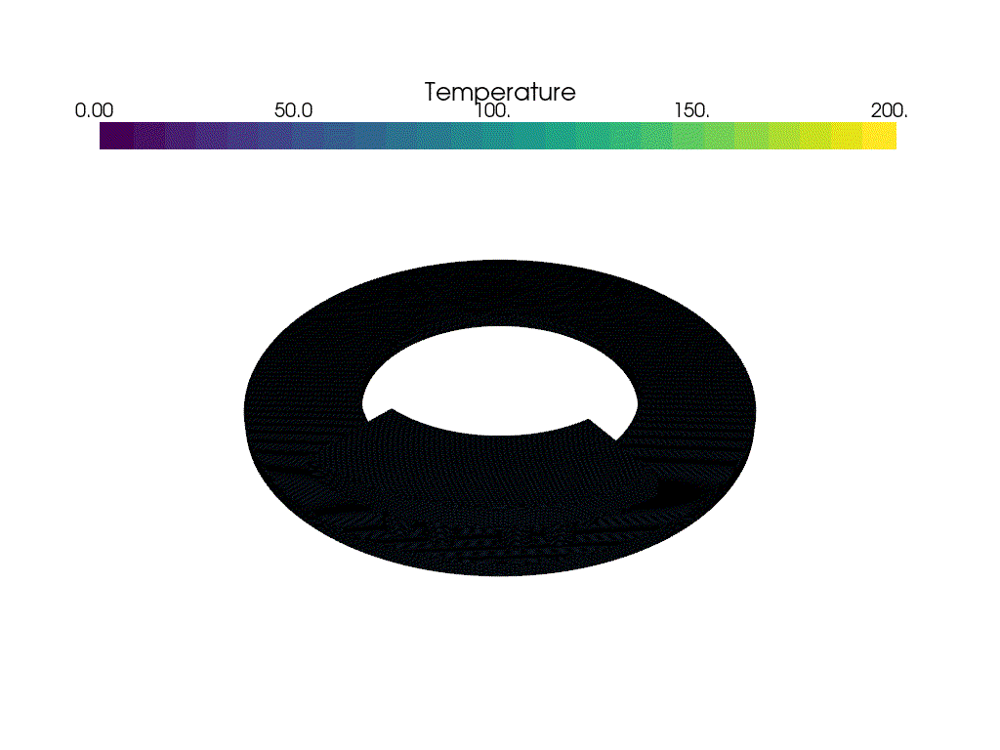

In [10]:
# Display the GIF
from IPython.display import display, Image
display( Image(gif_name) )

In [11]:
end_time = time.time()
elapsed_time = end_time - start_time
elapsed_time1 = round(elapsed_time, 0)

if elapsed_time1 >= 60:
   min = elapsed_time1/60
   print("Simulation time is",round(min),'min or',elapsed_time1,'second for', num_steps, 'steps')
else:
    print("Simulation time is",elapsed_time1,'second for', num_steps, 'steps')
    

Simulation time is 543 min or 32600.0 second for 1242 steps


In [13]:
print('1: First time step dt is ', round(dt[0],5),'s')
print()
print('2: Convection heat transfer coefficient is',h, ' W/mm2 K')
print()
print('3: Radiation is ', round(radiation,14), ' W/mm2 K-4')
print()
print('4: Each rotation degree is ', round(each_degree,1), ' per time step', 'or ', round(each_degree/360,1),' circle')
print()
print('5: The first rotation degree is ', round(v_angular[0] * r_disc * dt[0] *1000, 1) )
print()
print('6: The mid rotation degree is ', round(v_angular[ round(num_steps/2) ] * r_disc * dt[ round(len(dt)/2) ] *1000, 1) )
print()
print('7: The last rotation degree is ', round(v_angular[num_steps1-1] * r_disc * dt[-1] *1000, 1) )
print()
print('8: One contact area of rubbing element is ', round(S_contact/100,1), ' cm2')
print()
print('9: Total contact area of 18 rubbing element is', round(S_total/100,1), 'cm2')
print()
print('10: The mesh element size is between ',mesh_min, '-',mesh_max )
print()
print('11: Total elements number is ',total_elements )

1: First time step dt is  0.0215 s

2: Convection heat transfer coefficient is 7.75e-05  W/mm2 K

3: Radiation is  3.6e-13  W/mm2 K-4

4: Each rotation degree is  109.2  per time step or  0.3  circle

5: The first rotation degree is  519.2

6: The mid rotation degree is  468.0

7: The last rotation degree is  519.2

8: One contact area of rubbing element is  11.1  cm2

9: Total contact area of 18 rubbing element is 199.9 cm2

10: The mesh element size is between  1 - 2

11: Total elements number is  3852374


## 6: Simulation time  10 precossors


1: Simulation time is 41 min or 2480.0 second,  T-s-1000-m-3-10-c-1-e-43604.\
2: Simulation time is 9 min or 527.0 second , T-s-1000-m-3-12-c-1-e-25655. \
3:


## 7:Transfer files

In [14]:

# Define the source directory
source_dir = "/home/yanjun/Documents/FEniCSx/Tutorial/Calculation"

# Define the destination directory
destination_dir = "/home/yanjun/Documents/FEM_results"

# Create the new folder in the destination directory
new_folder_name = f"s-{num_steps}-d-{degree_rotation}-m-{mesh_min}-{mesh_max}-c-{c_contact}-e-{total_elements}"
destination_dir = os.path.join(destination_dir, new_folder_name)
os.makedirs(destination_dir, exist_ok=True)

# List of files to move
files_to_move = [
                 gif_name,
                 h5_name,
                 xdmf_name
                           ]

# Move each file to the destination directory
for filename in files_to_move:
    source_file_path = os.path.join(source_dir, filename)
    destination_file_path = os.path.join(destination_dir, filename)
    shutil.move(source_file_path, destination_file_path)
    print(f"Moved {filename} to {destination_file_path}")

Moved T-s-1242-d-119-m-1-2-c-1-e-3852374.gif to /home/yanjun/Documents/FEM_results/s-1242-d-119-m-1-2-c-1-e-3852374/T-s-1242-d-119-m-1-2-c-1-e-3852374.gif
Moved T-s-1242-d-119-m-1-2-c-1-e-3852374.h5 to /home/yanjun/Documents/FEM_results/s-1242-d-119-m-1-2-c-1-e-3852374/T-s-1242-d-119-m-1-2-c-1-e-3852374.h5
Moved T-s-1242-d-119-m-1-2-c-1-e-3852374.xdmf to /home/yanjun/Documents/FEM_results/s-1242-d-119-m-1-2-c-1-e-3852374/T-s-1242-d-119-m-1-2-c-1-e-3852374.xdmf
